# FORECAST SALE MODEL


## COLAB

In [1]:
#Mount Drive as our File System
import os
drive_loc = '/content/gdrive'
files_loc = os.path.join(drive_loc, 'MyDrive', 'Colab Notebooks', 'Kschool', 'TFM')

from google.colab import drive
drive.mount(drive_loc, force_remount= True)

#This helps us to import py files located in the Drive directory
import sys
sys.path.append(os.path.abspath(files_loc))

ModuleNotFoundError: No module named 'google.colab'

In [ ]:
pip install fitter

In [ ]:
pip install -U scikit-learn

In [ ]:
pip install "statsmodels==0.12.2"

## All Functions defined for this Project

In [3]:
#Module with all functions needed
from functions import *

In [2]:
%load_ext autoreload
%autoreload 2

## Constant Section

In [4]:
#File names

#Data set to train
my_train_file = "./data_v1.xlsx"

#Data set to validate
my_validate_file = "./data_validate_v1.xlsx"

#Pickle file name
pickle_file = 'object.pkl'

In [5]:
#Set all Visualization Parameters

#Parameters
visual_parameters = dict(
    {'figure.figsize': [20, 10], #Size of the plot
     'font.size': 15, #Font size
     'xtick.labelsize': 15, #Font size in X
     'ytick.labelsize': 15, #Font size in Y
     'xtick.direction': 'inout',
     'ytick.direction': 'inout',
})

#Apply all parameters
for parameter in visual_parameters:
    plt.rcParams[parameter] = visual_parameters[parameter]

#Apply Theme style
style = 'seaborn-darkgrid' #Theme style
plt.style.use(style)

In [6]:
#A list all Continuous Distributions available in Scipy

stats = [
    'alpha', 'anglit', 'arcsine', 'argus', 'beta',
    'betaprime', 'bradford', 'burr', 'burr12', 'cauchy',
    'chi', 'chi2', 'cosine', 'crystalball', 'dgamma',
    'dweibull', 'erlang', 'expon', 'exponnorm', 'exponweib',
    'exponpow', 'f', 'fatiguelife', 'fisk', 'foldcauchy',
    'foldnorm', 'genlogistic', 'gennorm', 'genpareto',
    'genexpon', 'genextreme', 'gausshyper', 'gamma', 'gengamma', 
    'genhalflogistic', 'geninvgauss', 'gilbrat', 'gompertz', 'gumbel_r',
    'gumbel_l', 'halfcauchy', 'halflogistic', 'halfnorm',
    'halfgennorm', 'hypsecant', 'invgamma', 'invgauss', 'invweibull',
    'johnsonsb', 'johnsonsu', 'kappa4', 'kappa3', 'ksone',
    'kstwo', 'kstwobign', 'laplace', 'laplace_asymmetric', 'levy',
    'levy_l', 'levy_stable', 'logistic', 'loggamma', 'loglaplace',
    'lognorm', 'loguniform', 'lomax', 'maxwell', 'mielke',
    'moyal', 'nakagami', 'ncx2', 'ncf', 'nct',
    'norm', 'norminvgauss', 'pareto', 'pearson3', 'powerlaw',
    'powerlognorm', 'powernorm', 'rdist', 'rayleigh', 'rice',
    'recipinvgauss', 'semicircular', 'kewnorm', 't', 'trapezoid',
    'triang', 'truncexpon', 'truncnorm', 'tukeylambda', 'uniform',
    'vonmises', 'vonmises_line', 'wald', 'weibull_min', 'weibull_max', 'wrapcauchy'
]

In [7]:
#Pandas Parameters

pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

## Exploratory Data Analysis

Let's analyze what is the size of our observations and columns. Is there any Nan or check the type of the data. This should be the starting point of any Data Science Project.

In [8]:
#Load the main data
data = pd.read_excel(my_train_file)
data

,Date,Program,Visits,Revenue
0,2015-01-01 23:59:59,SEO,0,2317.14
1,2015-01-01 23:59:59,SEO,0,903.10
2,2015-01-01 23:59:59,SEO,2844,0.00
3,2015-01-01 23:59:59,Direct,0,24.31
4,2015-01-01 23:59:59,Direct,937,0.00
...,...,...,...,...
106691,2021-05-09 23:59:59,::unspecified::,21,0.00
106692,2021-05-09 23:59:59,Paid Social,1050,0.00
106693,2021-05-09 23:59:59,Organic Social,19,0.00
106694,2021-05-09 23:59:59,Other,4,0.00


In [9]:
#Dimension of the Dataset
data.shape
#More than 106K records and 4 columns

(106696, 4)

In [10]:
#Let's check if there is any NaN
data.isna().sum()

Date       0
Program    0
Visits     0
Revenue    0
dtype: int64

In [11]:
data.dtypes

Date       datetime64[ns]
Program            object
Visits              int64
Revenue           float64
dtype: object

In [12]:
#Let's check if there is a zero value in Revenue
check = data.groupby(['Date'])['Revenue'].sum().reset_index()
check_zeros = check[check['Revenue'] == 0]
check_zeros

,Date,Revenue
66,2015-03-08 23:59:59,0.0
163,2015-06-13 23:59:59,0.0
387,2016-01-23 23:59:59,0.0
450,2016-03-26 23:59:59,0.0
924,2017-07-13 23:59:59,0.0
1930,2020-04-14 23:59:59,0.0


In [13]:
#There are some and we are going to estimate the Revenue, we are going to use the 
#Mean between Revenue day before and day after and we are going to apply that one to Direct Traffic
data = fill_zero_revenue(data)

In [14]:
#No Zero in Revenue
check = data.groupby(['Date'])['Revenue'].sum().reset_index()
check_zeros = check[check['Revenue'] == 0]
check_zeros

,Date,Revenue


In [15]:
#Validate Set
data_validate = pd.read_excel(my_validate_file)
data_validate

,Date,Program,Visits,Revenue
0,2021-05-10 23:59:59,Direct,1,4212.66
1,2021-05-10 23:59:59,Direct,1,3488.05
2,2021-05-10 23:59:59,Direct,1,2926.59
3,2021-05-10 23:59:59,Direct,1,2584.90
4,2021-05-10 23:59:59,Direct,1,1374.33
...,...,...,...,...
2740,2021-06-13 23:59:59,Paid Social,1247,0.00
2741,2021-06-13 23:59:59,Organic Social,17,0.00
2742,2021-06-13 23:59:59,::unspecified::,5,0.00
2743,2021-06-13 23:59:59,Other,0,0.00


## Distribution and briefly Statistical Analysis

It is important analyze the Revenue behave. We are going to exclude the Program Variable and just keep Year, Month, Day, Visits and Revenue.

In [15]:
data

,Date,Program,Visits,Revenue
0,2015-01-01 23:59:59,SEO,0,2317.14
1,2015-01-01 23:59:59,SEO,0,903.10
2,2015-01-01 23:59:59,SEO,2844,0.00
3,2015-01-01 23:59:59,Direct,0,24.31
4,2015-01-01 23:59:59,Direct,937,0.00
...,...,...,...,...
106691,2021-05-09 23:59:59,::unspecified::,21,0.00
106692,2021-05-09 23:59:59,Paid Social,1050,0.00
106693,2021-05-09 23:59:59,Organic Social,19,0.00
106694,2021-05-09 23:59:59,Other,4,0.00


In [16]:
#Manipulate the DataFrame a little bit. Modifying the Dates
data_small = split_dates_by_columns(data, 'Date')
#For this early stage I discard type of Traffic and just sum all of them and group by Index, Year, Month and Day
data_small = data_small.groupby(['Date', 'Year','Month','Day'])[['Visits','Revenue']].sum()
#Reset Index after having made a groupby
data_small = data_small.reset_index(['Year', 'Month', 'Day'])
#Resample to D and 00h00min00sec
data_small = data_small.resample('D', offset='00h00min00sec').sum()
data_small.tail(5)

,Year,Month,Day,Visits,Revenue
Date,,,,,
2021-05-05,2021,5,5,14373,37283.53
2021-05-06,2021,5,6,14025,39991.11
2021-05-07,2021,5,7,12399,24901.84
2021-05-08,2021,5,8,11018,15744.14
2021-05-09,2021,5,9,13924,19703.32


In [17]:
#Do the same for the Validation set
data_validation = split_dates_by_columns(data_validate, 'Date')
#For this early stage I discard type of Traffic and just sum all of them and group by Index, Year, Month and Day
data_validation = data_validation.groupby(['Date', 'Year','Month','Day'])[['Visits','Revenue']].sum()
#Reset Index after having made a groupby
data_validation = data_validation.reset_index(['Year', 'Month', 'Day'])
#Resample to D and 00h00min00sec
data_validation = data_validation.resample('D', offset='00h00min00sec').sum()
data_validation.head(5)

,Year,Month,Day,Visits,Revenue
Date,,,,,
2021-05-10,2021,5,10,14985,38859.97
2021-05-11,2021,5,11,15054,62814.95
2021-05-12,2021,5,12,15321,34882.23
2021-05-13,2021,5,13,14933,47518.14
2021-05-14,2021,5,14,15955,100651.00


In [26]:
#Lets check it out how this looks like and we can see that we have 2293 rows of data. Original one was 104793 rows
data_small.shape

(2321, 5)

In [22]:
#Let's see the main descriptive statistics
data_small.describe()

,Year,Month,Day,Visits,Revenue
count,2321.000000,2321.000000,2321.000000,2321.000000,2321.000000
mean,2017.694959,6.308057,15.680310,13433.658337,25825.089417
std,1.843913,3.479171,8.807686,8616.702674,38526.622896
min,2015.000000,1.000000,1.000000,245.000000,46.420000
25%,2016.000000,3.000000,8.000000,7858.000000,9739.620000
50%,2018.000000,6.000000,16.000000,10223.000000,18558.480000
75%,2019.000000,9.000000,23.000000,16581.000000,32819.390000
max,2021.000000,12.000000,31.000000,109148.000000,858333.560000


What we can see here, Revenue is much more scattered than Visits

In [20]:
#Outliners Analysis
#There are number way above 100.000. Those are some outliners
sorted(data_small['Revenue'], reverse=True)

[858333.5600000034,
 784321.290000003,
 590327.1899999998,
 563812.3999999989,
 529061.6699999995,
 334605.57000000076,
 311593.59999999957,
 304644.9999999996,
 206742.70999999996,
 192917.33000000007,
 191231.44000000012,
 187432.28999999983,
 186791.86000000004,
 171407.57999999987,
 169560.74000000005,
 167811.78999999986,
 153453.7500000001,
 139222.25999999998,
 132259.49000000002,
 132244.95,
 131383.15999999992,
 130645.76999999989,
 124783.69999999997,
 124024.70000000022,
 117069.57999999999,
 115680.39000000003,
 112899.65000000001,
 111940.03999999998,
 109272.9500000002,
 107702.02999999996,
 107599.70999999995,
 104098.95000000004,
 101380.1800000001,
 100517.25999999995,
 98058.94000000002,
 97243.22999999998,
 95266.08000000016,
 94826.27,
 93087.03000000006,
 92653.50999999995,
 92156.65000000002,
 91074.79,
 90887.97000000009,
 90056.15,
 89374.43000000004,
 88473.35000000008,
 87368.04000000008,
 86168.33999999995,
 84098.13000000002,
 83723.62,
 82678.79,
 81664.65,

In [21]:
#High Variability in Revenue
pearson_revenue = data_small['Revenue'].std() / data_small['Revenue'].mean()
#Visit Variability is less than Revenue but it is above 0.5
pearson_traffic = data_small['Visits'].std() / data_small['Visits'].mean()
print(f'Pearson\'s coefficient of variation - Revenue: {pearson_revenue:.2%}')
print(f'Pearson\'s coefficient of variation - Visits: {pearson_traffic:.2%}')

Pearson's coefficient of variation - Revenue: 150.37%
Pearson's coefficient of variation - Visits: 64.57%


We can see how the Revenue evolution across time. There are some big outliners due to the BlackFriday and Cyber Monday. Those exceptional days could affect in our model but we cannot remove them. However, maybe we can create a specific model for those ones and remove them for this model. Let's see

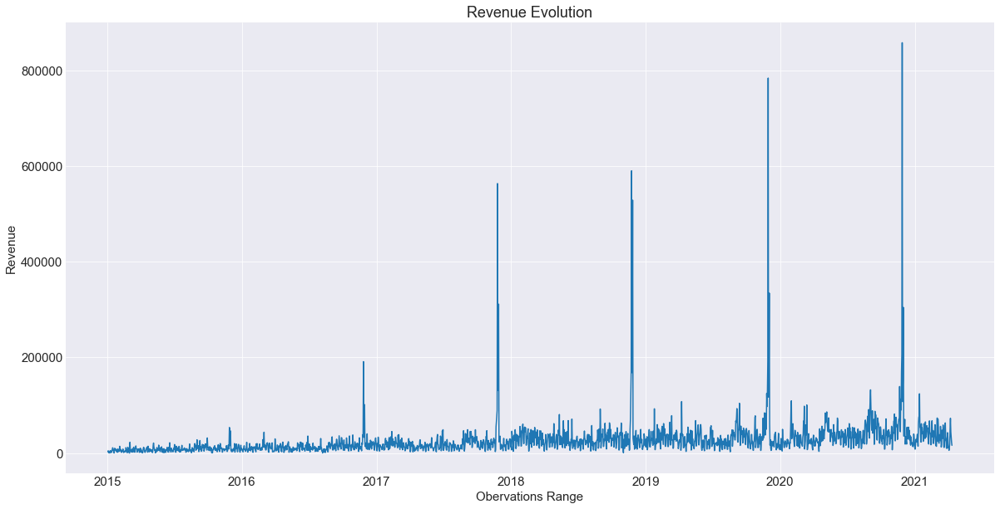

In [96]:
draw_plot(data_small, 'Revenue')

Let's see the behaviour of the Revenue and Visits and how good or bad they adjust with one polynomial.

Revenue: This daily granularity does not help to find a simple polynomial to adjust
Visits: Shows almost same issues as Revenue if we take data at daily basis

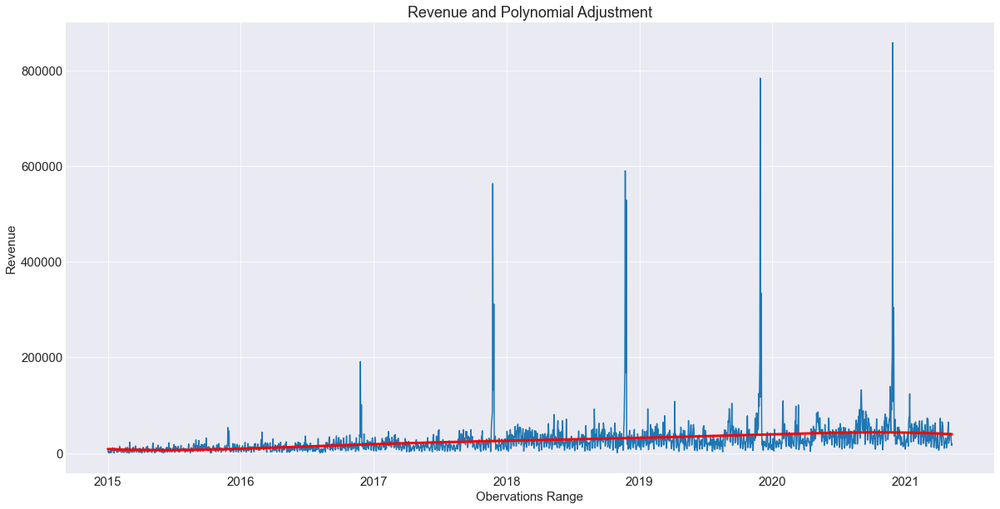

In [297]:
draw_least_squares_polynomial(data_small, data_small.columns[-1], 5)

Besides the target variable which is Revenue, Visits is another important variable which affects importantly the Revenue metric. Let's see how this looks like

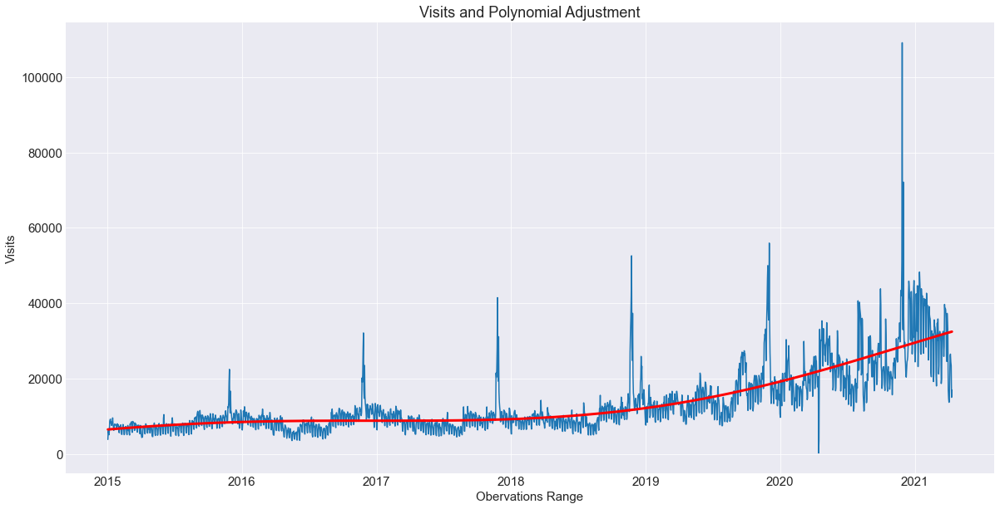

In [108]:
draw_least_squares_polynomial(data_small, data_small.columns[-2], 5)

We can see three different Distribution of our target variable, Revenue:
* Regular Distribution
* Logarithmic Distribution
* Square Transformation

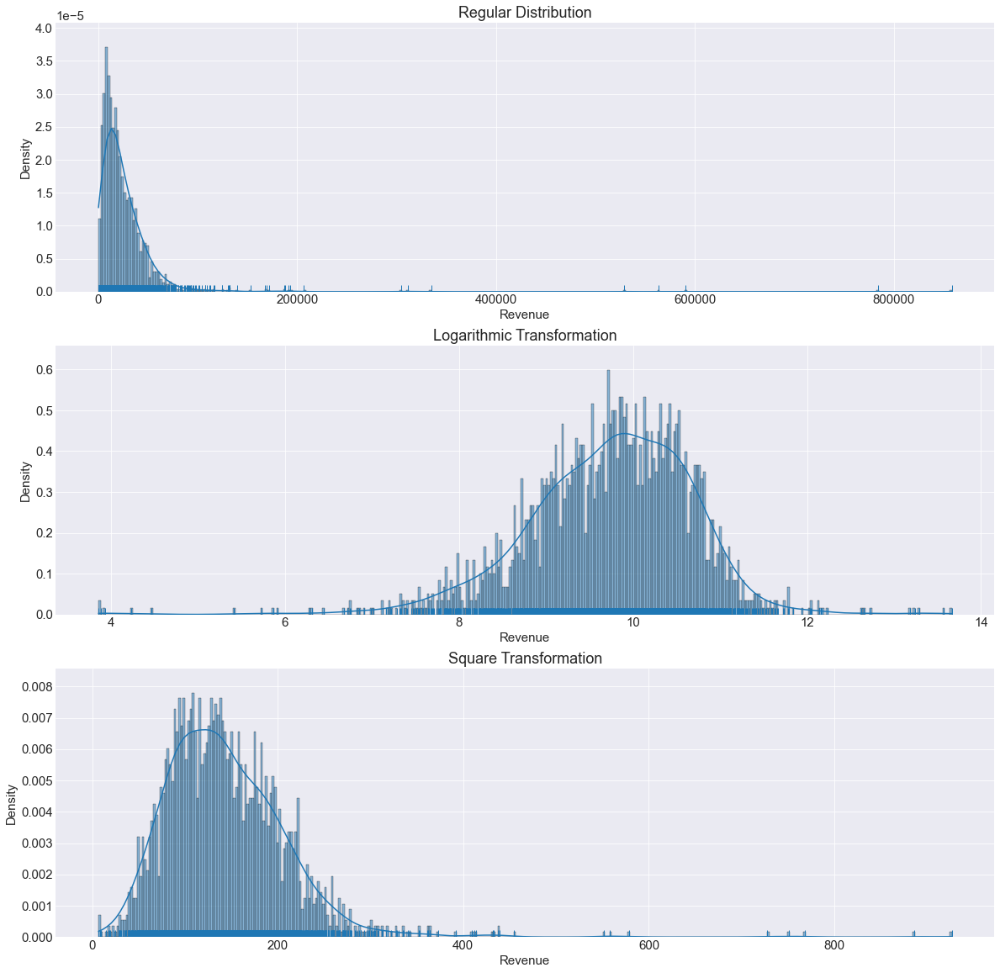

In [100]:
draw_set_of_distributions(data_small, 'Revenue');

Thanks to the Fitter library, we can test multiple Distributions with our target one and check what fits more. Here the results:
* Regular Distribution best fit with **Log-Normal**
* Logarithmic Distribution best fit with **Burr 12** is a subset of the log-logistic and quite similar like Log-Normal but heavier tails
* Square Transformation best fit with **Normal Inverse Gaussian**

{'burr12': (1.6550598046949772,
  1.9283154101132984,
  -124.38283102653897,
  30558.047377748087)}

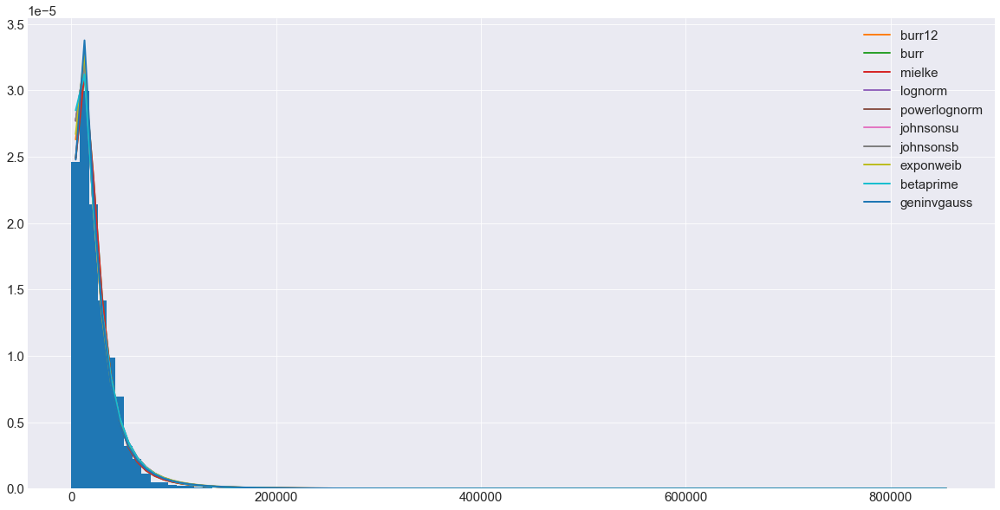

In [77]:
#Let's analyze what Distribution fits better with Revenue
fitter_norm = Fitter(data_small['Revenue'], distributions=stats)
fitter_norm.fit()
fitter_norm.summary(Nbest=10, plot=True)
fitter_norm.get_best(method='sumsquare_error')

,sumsquare_error,aic,bic,kl_div
burr12,0.036928,1282.717262,-25275.520096,inf
gengamma,0.048424,1452.675023,-24654.039674,inf
genlogistic,0.049086,1166.894543,-24630.655806,inf
johnsonsu,0.049183,1091.908553,-24618.408684,inf
loggamma,0.051255,1478.166938,-24531.516419,inf
powernorm,0.053807,1517.242742,-24420.109465,inf
johnsonsb,0.059600,1575.373658,-24177.905147,inf
exponweib,0.068584,1548.409773,-23855.958886,inf
pearson3,0.070857,1687.046627,-23788.917109,inf
beta,0.073096,1665.792612,-23709.862413,inf


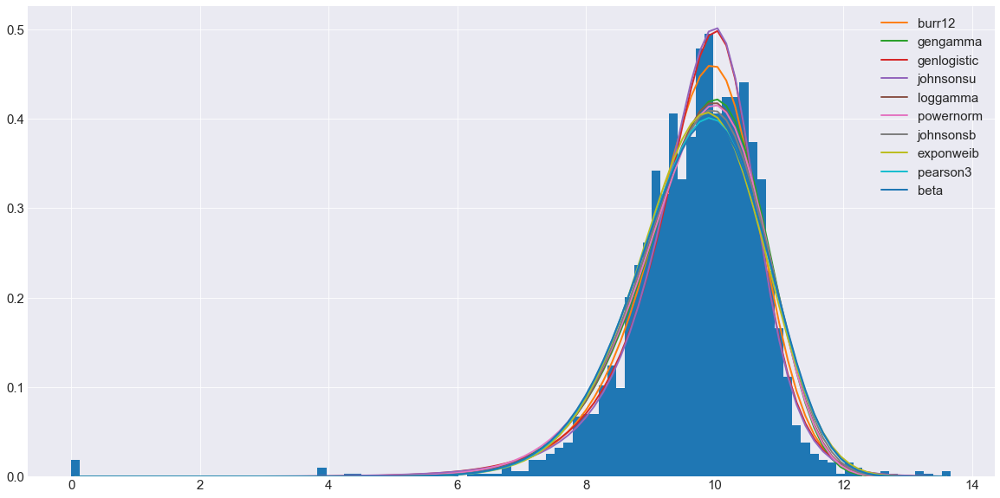

In [41]:
#Let's analyze what Distribution fits better with Revenue after a logarithmic transformation
fitter_log = Fitter(np.log1p(data_small['Revenue']), distributions=stats)
fitter_log.fit()
fitter_log.summary(Nbest=10, plot=True)
fitter_log.get_best(method='sumsquare_error')

/home/dsc/anaconda3/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:4523: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  intg = integrate.quad(f, -xi, np.pi/2, **intg_kwargs)[0]


,sumsquare_error,aic,bic,kl_div
norminvgauss,0.000007,2381.874828,-44929.295493,inf
invgamma,0.000007,2267.710491,-44934.851317,inf
betaprime,0.000007,2269.640814,-44926.874785,inf
johnsonsb,0.000007,2372.878995,-44893.139447,inf
fatiguelife,0.000007,2483.989779,-44851.046814,inf
genlogistic,0.000007,2316.157497,-44839.795466,inf
gamma,0.000008,2637.895009,-44679.914903,inf
pearson3,0.000008,2637.895209,-44679.912792,inf
chi2,0.000008,2637.894584,-44679.911836,inf
beta,0.000008,2632.894976,-44650.974480,inf


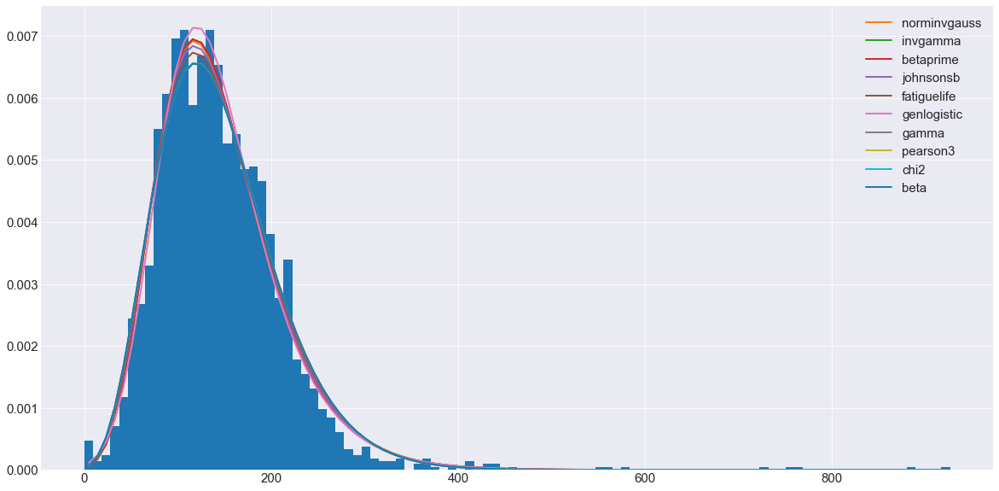

In [42]:
#Let's analyze what Distribution fits better with Revenue after a logarithmic transformation
fitter_sqr = Fitter(np.sqrt(data_small['Revenue']), distributions=stats)
fitter_sqr.fit()
fitter_sqr.summary(Nbest=10, plot=True)
fitter_sqr.get_best(method='sumsquare_error')

In [48]:
fitter.get_best(method='sumsquare_error')

{'norminvgauss': (12.950464878750978,
  10.848421324107541,
  -0.6789439577064692,
  94.51639112512959)}

Let's see how the target variable evolute across a period of time. For example, it could be a Year, Month or even a Day. We can see as long as the time goes by, it is being more and more right asymetric.

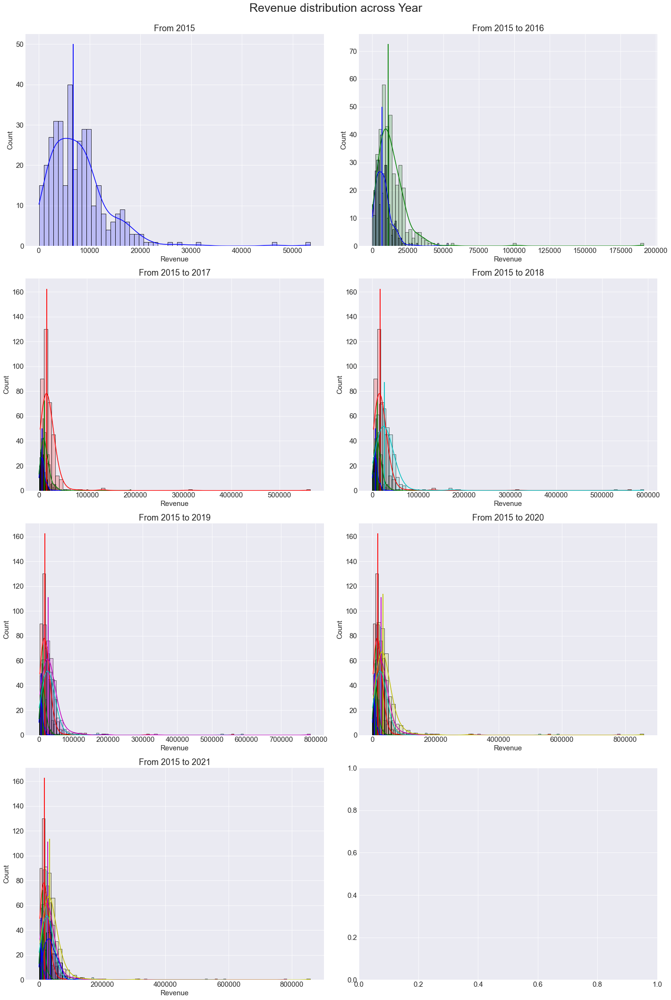

In [109]:
draw_distribution_evolution(data_small, 'Revenue', 'Year')

Now it is time for analyzing what is the distribution of the independent variables

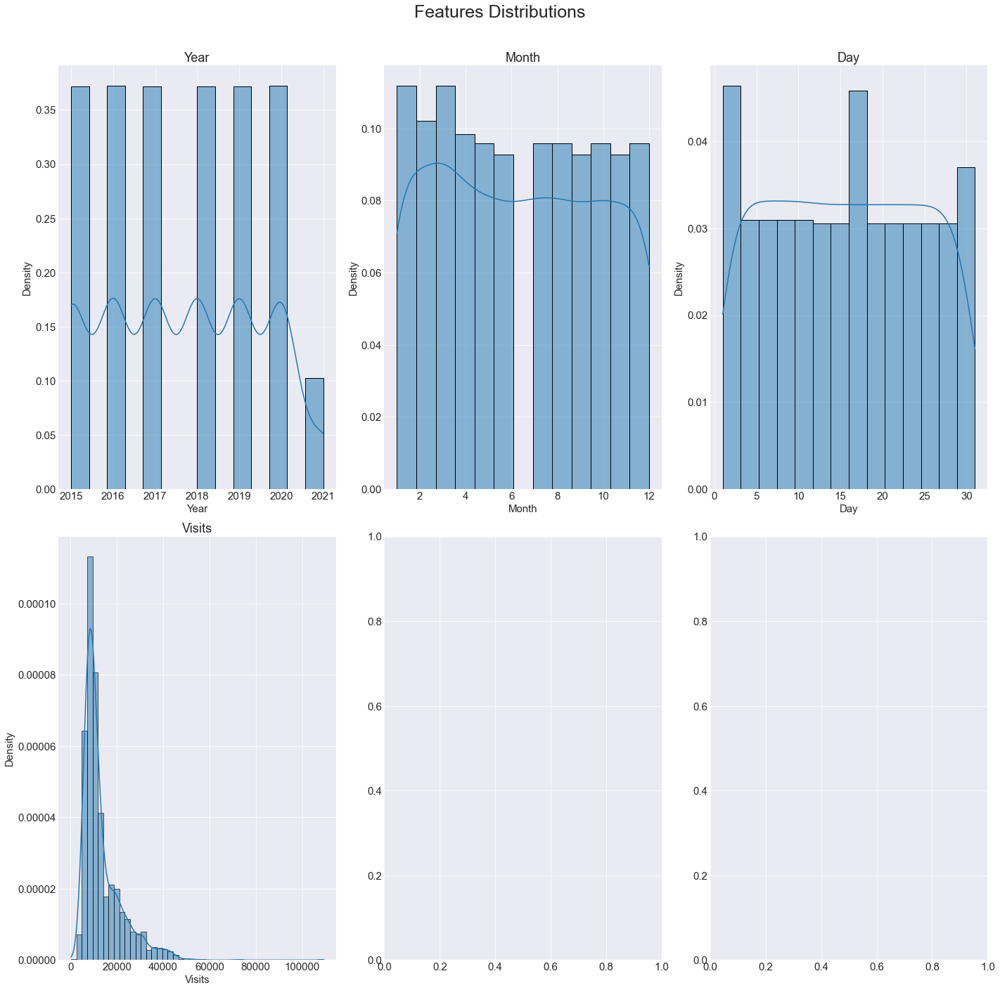

In [110]:
draw_distribution(data_small, data_small.columns[0:-1])

Let's see how the independent variables correlate with the dependant variable. As far as we can see, we cannot see a strong relationship between Year, Month and Day but we can see some correlation with Visits 

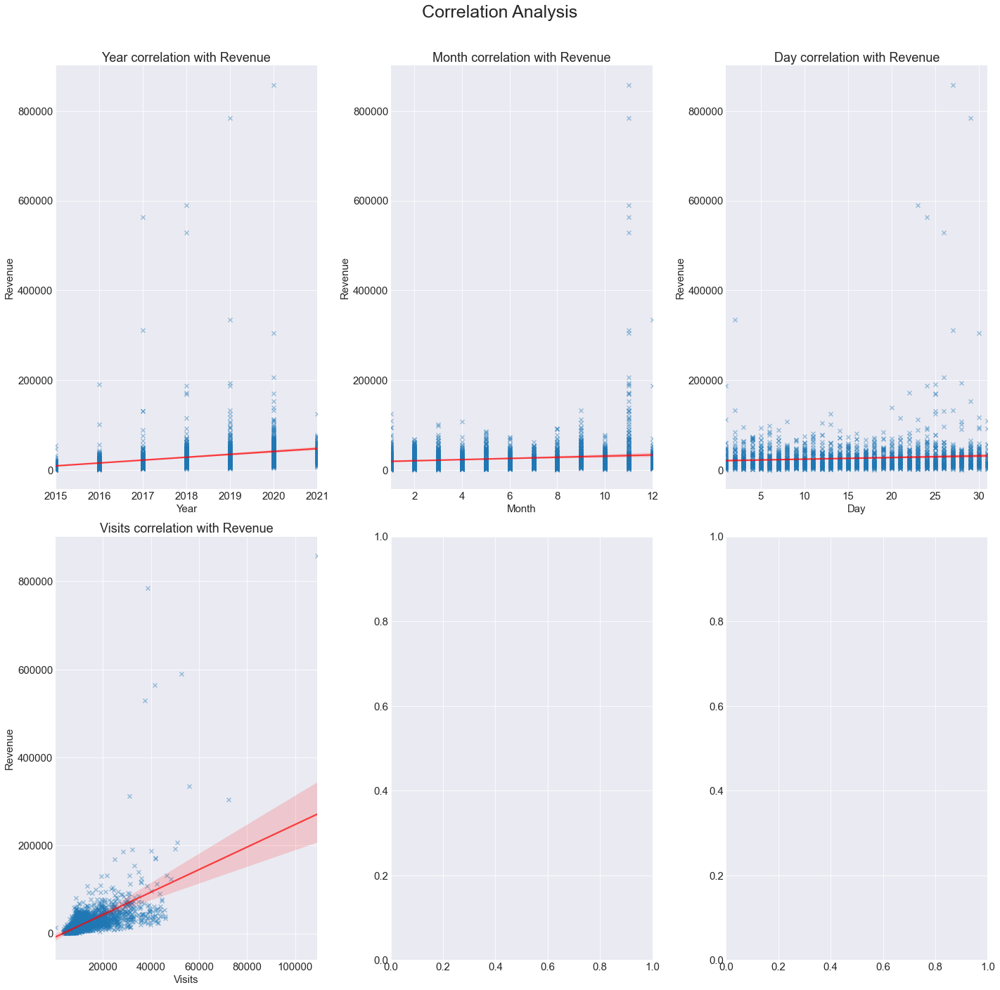

In [111]:
draw_correlation(data_small, data_small.columns[0:-1], data_small.columns[-1:])

Actually here, we can see that the correlation is quite remakable between Visits and Revenue but we can see also even stronger correlation between Year and Visits, so maybe there is collinearity between these two variable and in case we want to add them to a regression model, we should pick just one.

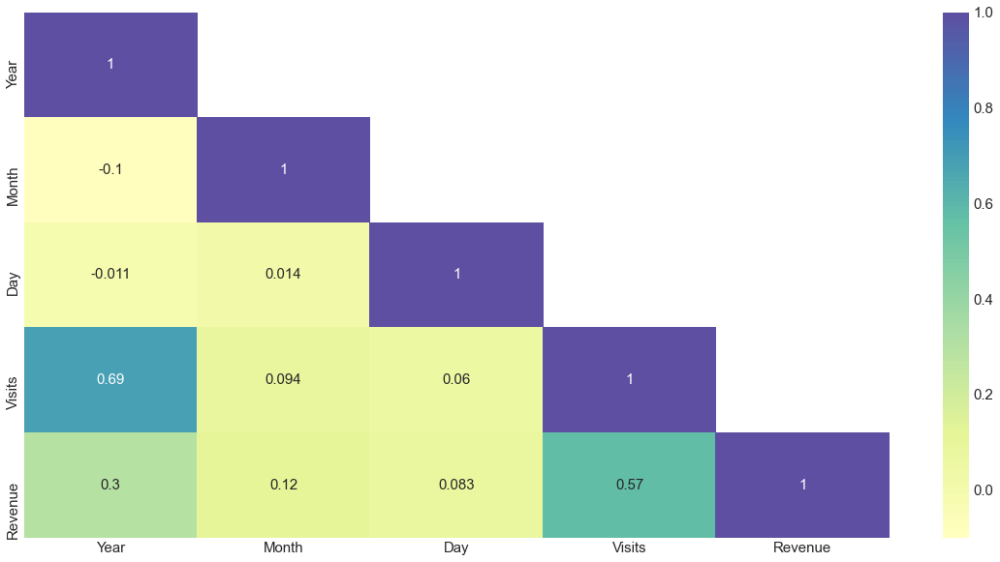

In [112]:
corr_matrix(data_small)

## Time Series

### Main Charasteristics

A Time Series could break down in four different features:
* Trend: It could go up or down acros the time
* Cyclic: Goes up or down without any specific reason
* Seasonality: Specific known pattern of one season
* Random or irregular movements: Noise size

We have two type of break down:
* Additive: yt = Tt + St + Ct + R
* Multiplicative = yt = Tt × St × Ct × R

### Aditive or Multiplative Analysis

/home/dsc/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


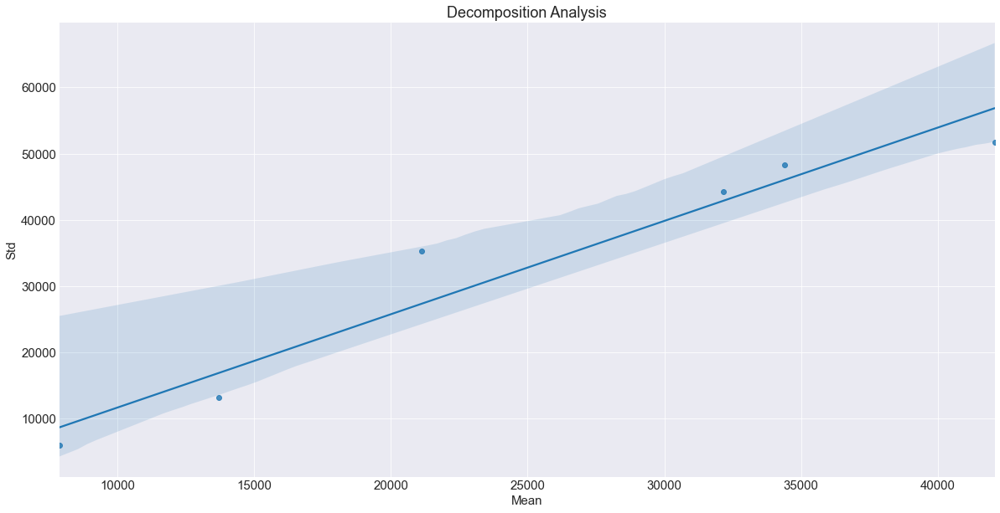

In [113]:
draw_decomposition(data_small);

It seems Multiplicative because the slope is not plain an around 45º

### Time Series Decomposition 

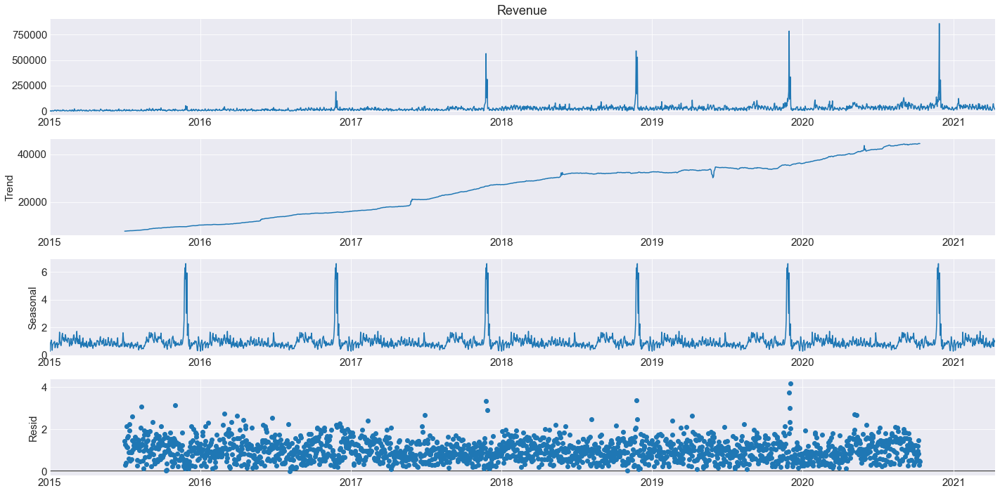

In [122]:
s_d_small = seasonal_decompose(data_small['Revenue'], period= 365, model= 'multiplicative')
s_d_small.plot();

### Stationary Analysis - Augmented Dickey-Fuller test 

In [117]:
test_adf(data_small, 'Revenue')

** Augmented Dickey-Fuller Test **

T-test: -7.000968604662691 < Confidence Interval[1%]: -3.43323655938138 - Result: Stationary
T-test: -7.000968604662691 < Confidence Interval[5%]: -2.86281520927122 - Result: Stationary
T-test: -7.000968604662691 < Confidence Interval[10%]: -2.567448852970086 - Result: Stationary

P-Value: 7.32383597947612e-10 < 0.05 - Result: Stationary


As far as we can see here, it seems this Time Series is Stationary. If we check same Time Series by Week, everything changes because it seems Non Stationary.

## White Noise

OJO TAL VEZ PONER WEEK PARA DEMOSTRAR QUE NO ES ESTACIONARIO

Random Walk - Dickey-Fuller test

H0: β = 0 (This is a random walk)

H1: β < 0 (This is not a random walk)

In [574]:
test_adf(data_small, 'Revenue')

** Augmented Dickey-Fuller Test **

T-test: -7.000968604662691 < Confidence Interval: -3.43323655938138 - Result: Stationary
T-test: -7.000968604662691 < Confidence Interval: -2.86281520927122 - Result: Stationary
T-test: -7.000968604662691 < Confidence Interval: -2.567448852970086 - Result: Stationary

P-Value: 7.32383597947612e-10 < 0.05 - Result: Stationary


In [575]:
test_adf(data_big, 'Revenue')

** Augmented Dickey-Fuller Test **

T-test: -2.3082165125000897 > Confidence Interval: -3.4512146067362317 - Result: No Stationary
T-test: -2.3082165125000897 > Confidence Interval: -2.870730188960711 - Result: No Stationary
T-test: -2.3082165125000897 > Confidence Interval: -2.5716664849383113 - Result: No Stationary

P-Value: 0.16933167517757752 > 0.05 - Result: No Stationary


### Residual Analysis 

Residuals are White Noise, it has passed the ADF Test and therefore it is not a Random Walk and we can also see visually that the mean is 'plain'

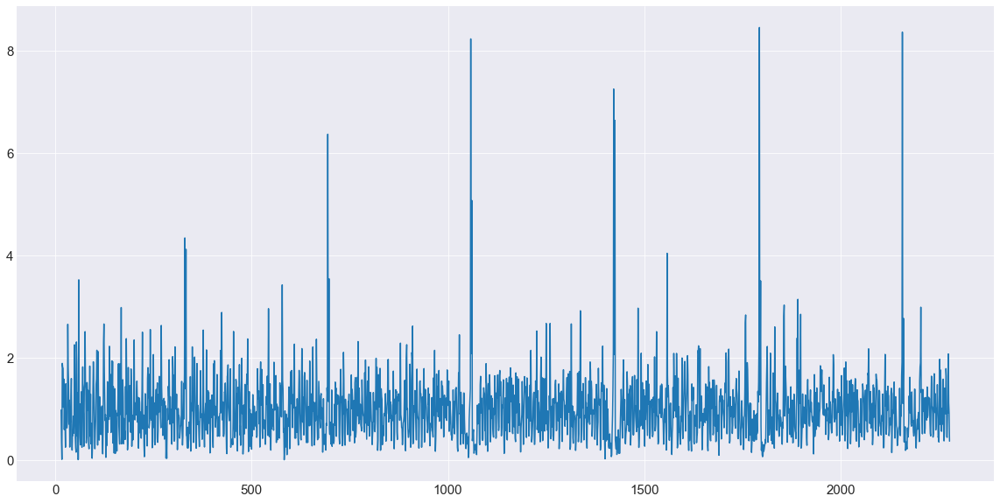

In [66]:
plt.plot(s_d_small.resid.index, s_d_small.resid)

In [67]:
#Augmented Dickey-Fuller test
residual = pd.DataFrame(s_d_small.resid)
residual.dropna(inplace= True)
test_adf(residual, residual.columns[0])

** Augmented Dickey-Fuller Test **

T-test: -13.76633709859893 < Confidence Interval[1%]: -3.4332792288216227 - Result: Stationary
T-test: -13.76633709859893 < Confidence Interval[5%]: -2.8628340503010357 - Result: Stationary
T-test: -13.76633709859893 < Confidence Interval[10%]: -2.567458884484683 - Result: Stationary

P-Value: 9.868725250454579e-26 < 0.05 - Result: Stationary


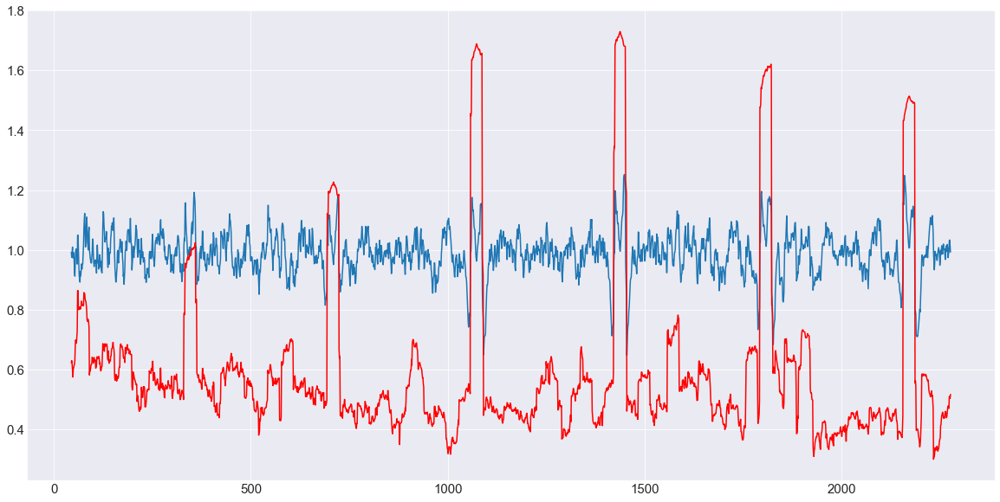

In [68]:
#Visual Analysis
#Let's calculate the rolling mean
rolling_mean = residual.rolling(window=30).mean()
rolling_mean.dropna(inplace= True)
#And the rolling std
rolling_std = residual.rolling(window=30).std()
rolling_std.dropna(inplace= True)

plt.plot(rolling_mean.index, rolling_mean)
plt.plot(rolling_std.index, rolling_std, c= 'r')

### Autocorrelation and Partial Autocorrelation

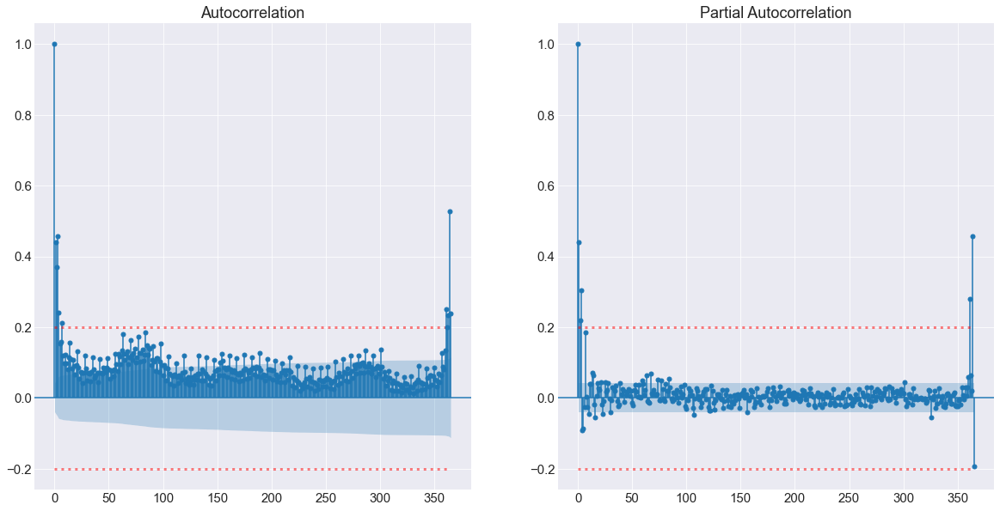

In [299]:
draw_autocorrelation(data_small, 365)

### Naïve Model 

We are going to use as baseline model, this one 'Last Naïve Value' Y(t+ 1) =Y(t)

In [123]:
column = 'Revenue'
data_s = data_small[[column]].copy()
data_s[f'{column}_predicted'] = data_s[column].shift(1)
data_s.dropna(inplace= True)

<AxesSubplot:xlabel='Date'>

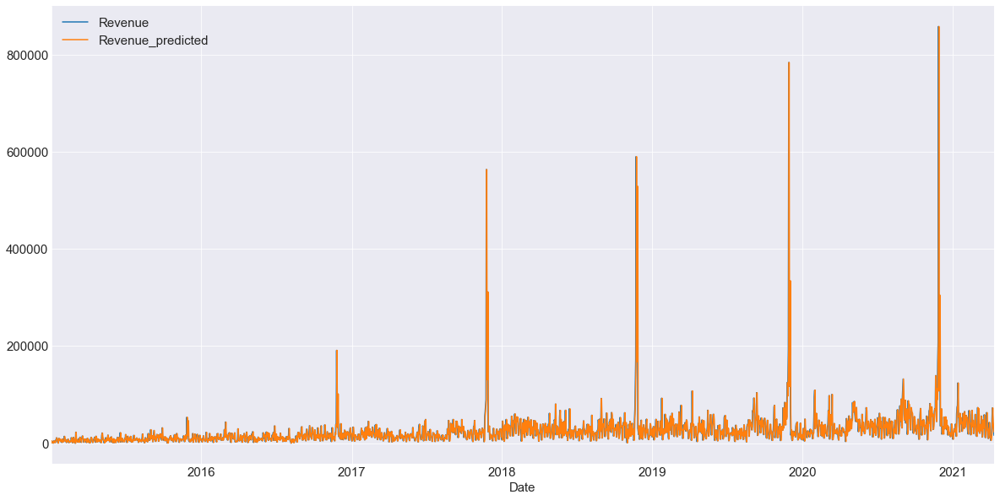

In [124]:
data_s.plot()

In [125]:
#Model RMSE
metric_rmse(data_s, 'Revenue')

40984.40412679773

In [128]:
data_full = pd.concat([data_small[[column]], data_validation[[column]]])
data_full[f'{column}_predicted'] = data_full[column].shift(1)
data_full.dropna(inplace= True)

<AxesSubplot:xlabel='Date'>

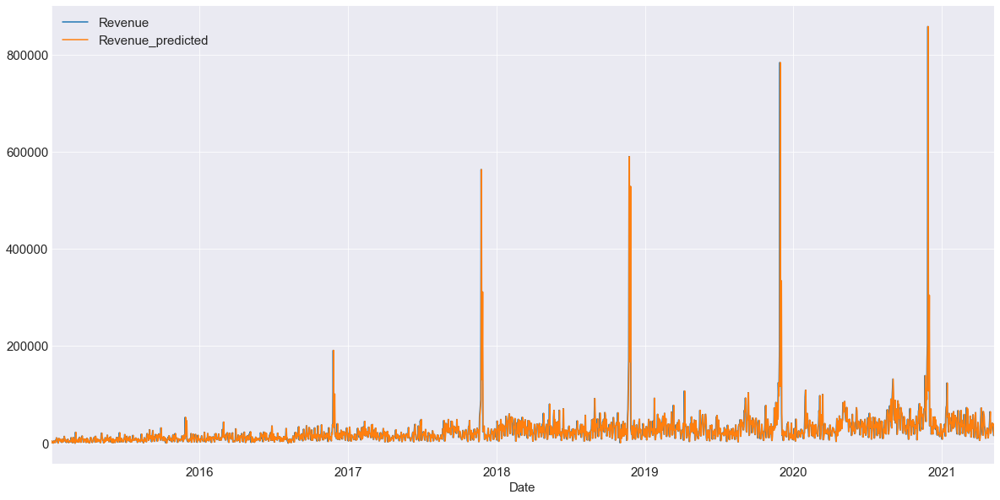

In [129]:
data_full.plot()

In [130]:
#Model Validation
#Model RMSE
metric_rmse(data_full, 'Revenue')

40772.74855191387

<AxesSubplot:xlabel='Date'>

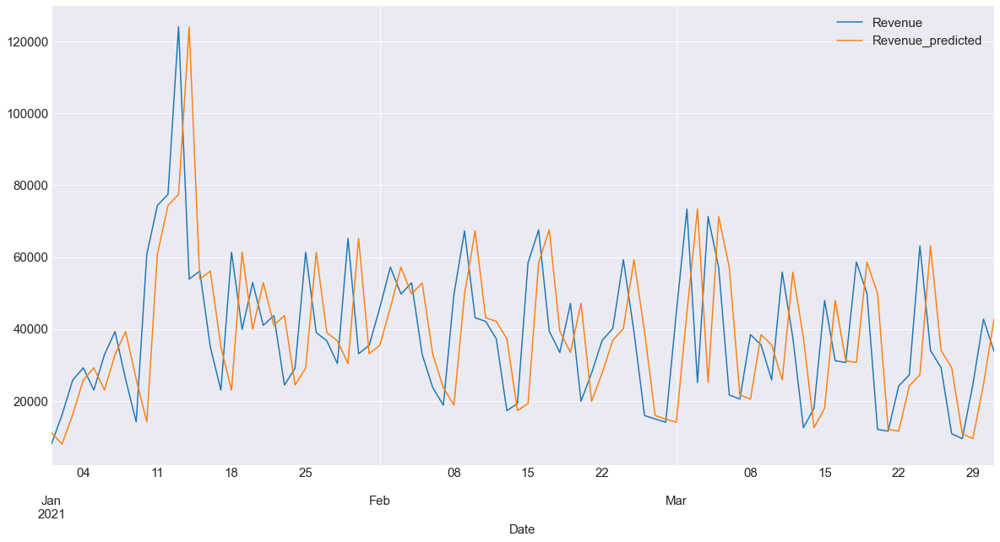

In [132]:
#Let's see it more in detail
data_full.loc['2021-01-01':'2021-03-31'].plot()

As we can see, this would be our starting point for comparing the error across the rest of the models

### SARIMAX 

We are going to apply a SARIMAX model for our Time Series. We are going to create three exogenous variables.
* Black Friday: This will consider from Black Friday to Cyber Monday. Four days in total
* Easter: This is another important period, from Monday to next Monday. Some Communities have slightly different Easter Weeks
* Covid: A new exceptional period. We are going to start with the full lockdown

In [18]:
#Let's create the new exogenous variables
data_exogenous = get_exogenous_features(data_small)

In [130]:
#We have create a GridSearch in order to chose the better hyperparameters
#IMPORTANT, this task is quite intensive so we are saving a pickle for multiple iterations.
#ASSUMPTIONS, we would like to test with 365 season but we do not have enough memory
arima_params = {'p': [5, 7],
                'd': [0, 2], #Up to 1
                'q': [5, 7]}

sarima_params = {'P': [5, 7],
                 'D': [0, 2], #Up to 1
                 'Q': [5, 7],
                 'S': [7]}

trend_params = ['t'] #We has test before and this is the best option always

In [34]:
#We have create a GridSearch in order to chose the better hyperparameters
#IMPORTANT, this task is quite intensive so we are saving a pickle for multiple iterations.
#ASSUMPTIONS, we would like to test with 365 season but we do not have enough memory
arima_params = {'p': [0, 2],
                'd': [0, 2], #Up to 1
                'q': [0, 1]}

sarima_params = {'P': [0, 1],
                 'D': [0, 2], #Up to 1
                 'Q': [0, 1],
                 'S': [2]}

trend_params = ['t'] #We has test before and this is the best option always

In [20]:
X_train, y_train, X_test, y_test = sarimax_preparation_split(data_exogenous)

In [35]:
test_aic = gridsearch_sarimax(y_train, X_train[['Black_Friday', 'Easter', 'Covid']], arima_params, 
                             sarima_params, trend_params)

In [20]:
sorted(test_aic.items(), key=lambda x: x[1])

[((3, 0, 0, '-', 1, 0, 1, 7, '-', 't'), 47898.60855109147),
 ((3, 0, 0, '-', 2, 0, 1, 7, '-', 't'), 47899.75870881471),
 ((3, 0, 0, '-', 1, 0, 2, 7, '-', 't'), 47900.13801876921),
 ((3, 0, 0, '-', 1, 0, 3, 7, '-', 't'), 47902.40845644389),
 ((3, 0, 0, '-', 2, 0, 2, 7, '-', 't'), 47902.85803318481),
 ((3, 0, 1, '-', 1, 0, 1, 7, '-', 't'), 47903.52229778633),
 ((3, 0, 0, '-', 3, 0, 2, 7, '-', 't'), 47903.723548246824),
 ((3, 0, 0, '-', 2, 0, 3, 7, '-', 't'), 47904.485667301924),
 ((2, 0, 3, '-', 1, 0, 1, 7, '-', 't'), 47904.873850624266),
 ((3, 0, 0, '-', 3, 0, 1, 7, '-', 't'), 47907.800261122626),
 ((3, 0, 0, '-', 3, 0, 3, 7, '-', 't'), 47907.87278512935),
 ((3, 0, 1, '-', 1, 0, 2, 7, '-', 't'), 47907.95030234906),
 ((1, 0, 3, '-', 1, 0, 1, 7, '-', 't'), 47908.593753361754),
 ((1, 0, 3, '-', 2, 0, 1, 7, '-', 't'), 47911.22732210987),
 ((1, 0, 3, '-', 1, 0, 2, 7, '-', 't'), 47912.146571199184),
 ((3, 0, 1, '-', 1, 0, 3, 7, '-', 't'), 47913.88543416833),
 ((3, 0, 3, '-', 0, 1, 1, 7, '-', 

In [129]:
sorted(test_aic.items(), key=lambda x: x[1])

[((4, 0, 4, '-', 4, 0, 4, 7, '-', 't'), 47982.72285554057),
 ((4, 0, 4, '-', 4, 1, 4, 7, '-', 't'), 48015.33809054071),
 ((4, 1, 4, '-', 4, 0, 4, 7, '-', 't'), 48034.47456622115),
 ((4, 1, 4, '-', 4, 1, 4, 7, '-', 't'), 48306.6430314474)]

In [132]:
sorted(test_aic.items(), key=lambda x: x[1])

[((6, 0, 5, '-', 5, 0, 5, 7, '-', 't'), 47932.131057390296),
 ((5, 0, 6, '-', 5, 0, 6, 7, '-', 't'), 47934.27837766443),
 ((6, 0, 5, '-', 6, 0, 5, 7, '-', 't'), 47936.178517190405),
 ((5, 0, 6, '-', 6, 0, 5, 7, '-', 't'), 47936.5629532279),
 ((6, 0, 5, '-', 5, 0, 6, 7, '-', 't'), 47938.67609038649),
 ((6, 0, 6, '-', 5, 0, 6, 7, '-', 't'), 47939.576789980885),
 ((6, 0, 6, '-', 6, 0, 6, 7, '-', 't'), 47940.09103830449),
 ((6, 0, 6, '-', 5, 0, 5, 7, '-', 't'), 47941.731750452425),
 ((6, 0, 6, '-', 6, 0, 5, 7, '-', 't'), 47941.94278978875),
 ((5, 0, 5, '-', 5, 0, 6, 7, '-', 't'), 47945.21216202574),
 ((5, 0, 6, '-', 5, 0, 5, 7, '-', 't'), 47945.30127016295),
 ((5, 0, 6, '-', 6, 0, 6, 7, '-', 't'), 47950.71264493723),
 ((6, 0, 5, '-', 6, 0, 6, 7, '-', 't'), 47954.29555960231),
 ((5, 0, 5, '-', 6, 0, 5, 7, '-', 't'), 47956.336323259784),
 ((6, 0, 6, '-', 5, 1, 5, 7, '-', 't'), 47959.46935074453),
 ((6, 0, 6, '-', 5, 1, 6, 7, '-', 't'), 47960.85814227002),
 ((6, 0, 6, '-', 6, 1, 5, 7, '-', 't

In [21]:
#Fit considering best hyperparameters
model = SARIMAX(endog= y_train, exog= X_train[['Black_Friday', 'Easter', 'Covid']],
                order= (3, 0, 0), seasonal_order= (1, 0, 1, 7), trend= 't')
result = model.fit()

In [50]:
#Predict taking full Train
forecast = result.get_prediction(start= '2015-01-01', end= '2020-09-18', 
                                 exog= X_train.loc['2015-01-01':'2020-09-18'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

Date
2015-01-01       48.261495
2015-01-02     1329.829374
2015-01-03     2070.849849
2015-01-04     1012.778703
2015-01-05     1511.628873
                  ...     
2020-09-14    48638.057794
2020-09-15    52858.167422
2020-09-16    45358.117886
2020-09-17    65179.810754
2020-09-18    50782.665643
Freq: D, Name: Revenue_predicted, Length: 2088, dtype: float64

<AxesSubplot:xlabel='Date'>

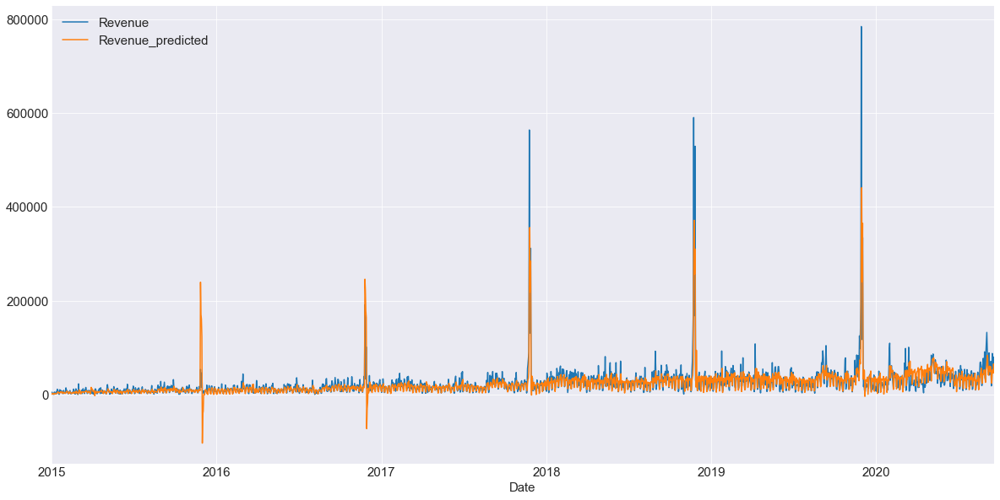

In [51]:
data_train_predict = pd.concat([y_train, mean_forecast], axis= 1)
data_train_predict.plot()

<AxesSubplot:xlabel='Date'>

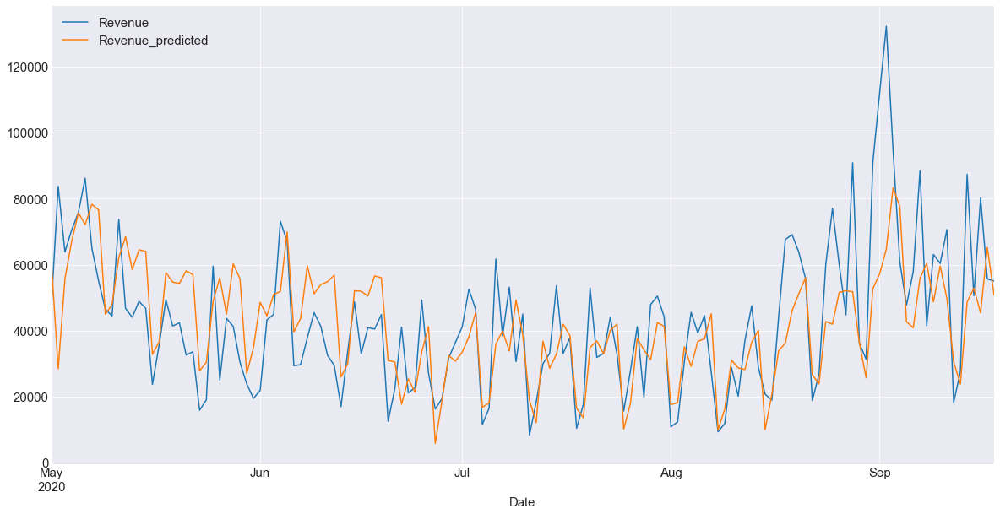

In [52]:
#Let's see a subset of the Time Series
data_train_predict.loc['2020-05-01':'2020-09-18'].plot()

In [53]:
metric_rmse(data_train_predict, 'Revenue')

22941.71458906555

,Residuals
count,2.088000e+03
mean,-3.827611e+07
std,1.000648e+09
min,-3.473672e+10
25%,-6.484333e+03
50%,3.172056e+02
75%,6.002982e+03
max,8.763761e+04


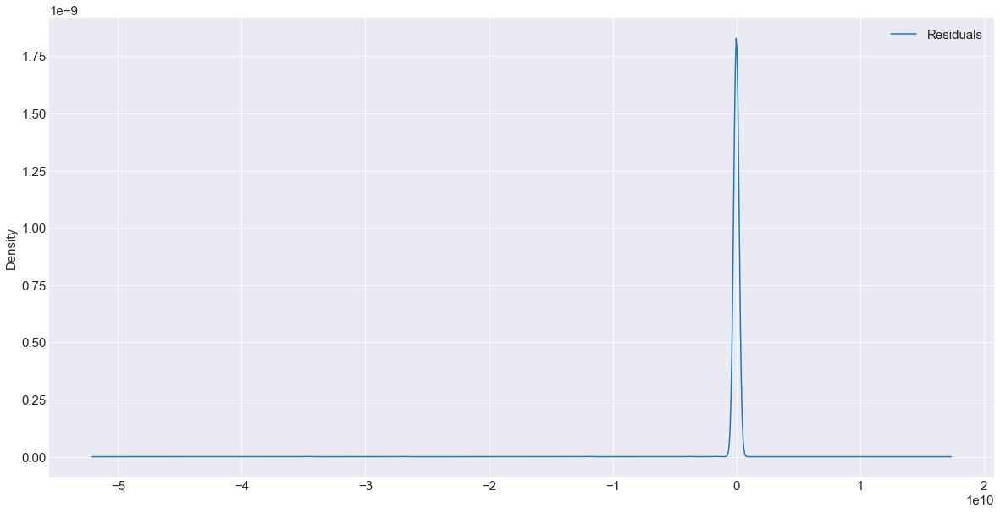

In [74]:
#Residual Analysis
data_residual = pd.DataFrame()
#Real - Predict
data_residual['Residuals'] = \
    data_train_predict[data_train_predict.columns[0]] - data_train_predict[data_train_predict.columns[1]]
data_residual.plot(kind='kde')

#Let's see the mean if it is in the center or show kind of skew
data_residual.describe()

In [300]:
draw_autocorrelation(pd.DataFrame(result.resid), 30)

NameError: name 'result' is not defined

In [56]:
#Forecast vs. Test

#Predict taking full Test
forecast = result.get_prediction(start= '2020-09-19', end= '2021-05-09', 
                                 exog= X_test.loc['2020-09-19':'2021-05-09'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

2020-09-19    28934.311255
2020-09-20    26444.037858
2020-09-21    45782.924854
2020-09-22    41327.546210
2020-09-23    42715.955671
                  ...     
2021-05-05    43752.538070
2021-05-06    45073.630018
2021-05-07    46842.039874
2021-05-08    21713.326417
2021-05-09    24541.436958
Freq: D, Name: Revenue_predicted, Length: 233, dtype: float64

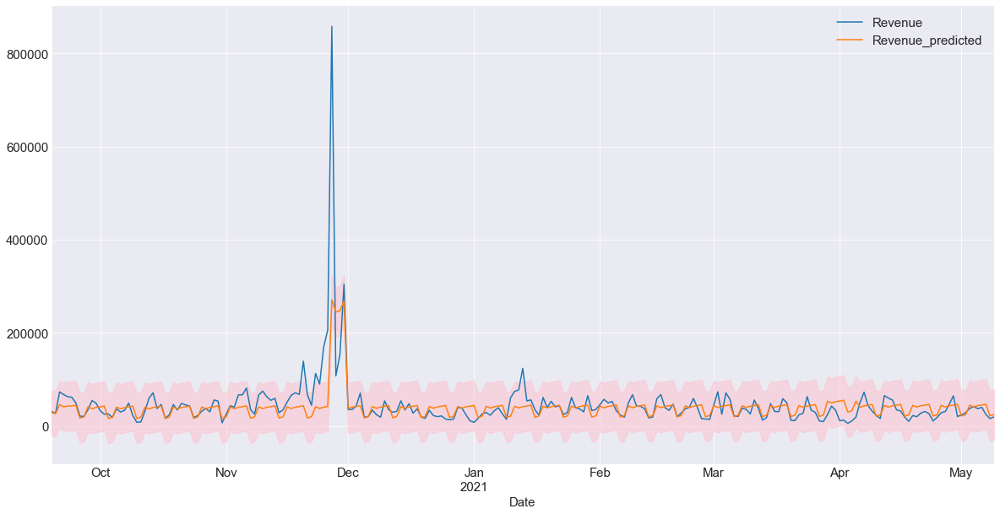

In [57]:
#Let's see how this model predict
data_test_predict = pd.concat([y_test, mean_forecast], axis= 1)
data_test_predict.plot()

confidence_intervals = forecast.conf_int()
plt.fill_between(confidence_intervals.index, confidence_intervals[confidence_intervals.columns[0]],
                 confidence_intervals[confidence_intervals.columns[1]], color='pink', alpha=0.5)

In [58]:
metric_rmse(data_test_predict, 'Revenue')

46211.325117016946

### Log Time Series Analysis

In [59]:
data_log = data_small.copy()
data_log['Revenue'] = np.log1p(data_log['Revenue'])

/home/dsc/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


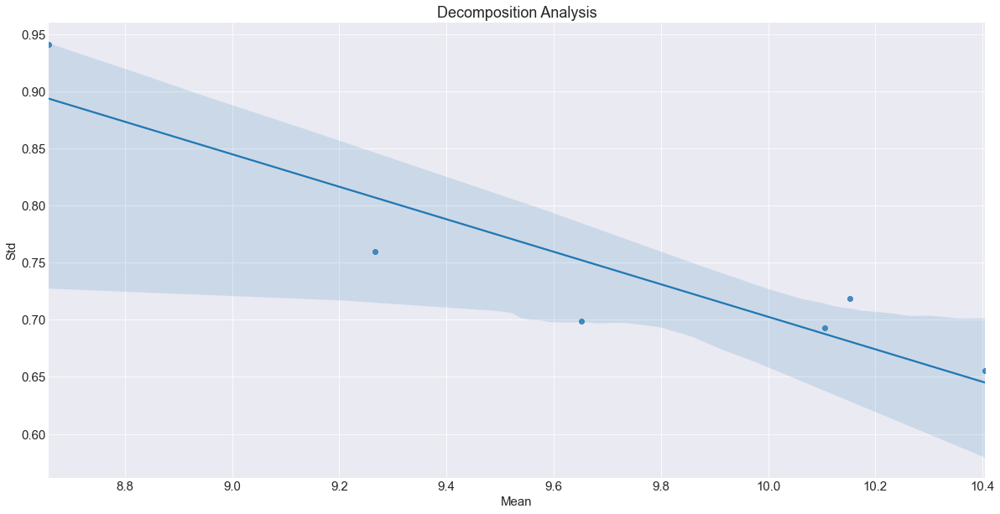

In [34]:
draw_decomposition(data_log);

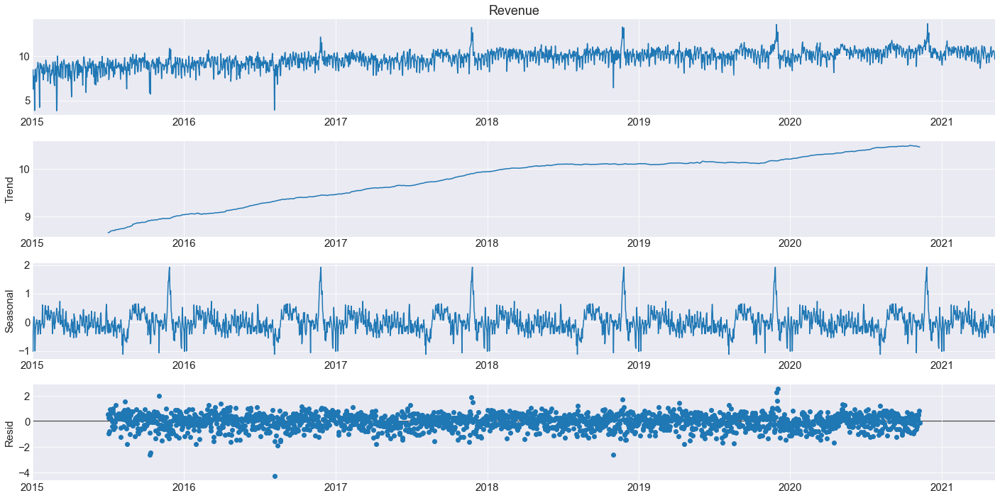

In [64]:
#A transformed data into Log makes Additivie model always
s_d_log = seasonal_decompose(data_log['Revenue'], period= 365, model= 'additive')
s_d_log.plot();

In [36]:
test_adf(data_log, 'Revenue')

** Augmented Dickey-Fuller Test **

T-test: -3.2629643223107463 > Confidence Interval[1%]: -3.4332403869849286 - Result: No Stationary
T-test: -3.2629643223107463 < Confidence Interval[5%]: -2.862816899390905 - Result: Stationary
T-test: -3.2629643223107463 < Confidence Interval[10%]: -2.567449752837351 - Result: Stationary

P-Value: 0.01661734589099667 < 0.05 - Result: Stationary


In [301]:
draw_autocorrelation(data_log, 30)

NameError: name 'data_log' is not defined

### Log Arima 

In [60]:
#Let's create the new exogenous variables
data_exogenous_log = get_exogenous_features(data_log)

In [133]:
#We have create a GridSearch in order to chose the better hyperparameters
#IMPORTANT, this task is quite intensive so we are saving a pickle for multiple iterations.
#ASSUMPTIONS, we would like to test with 365 season but we do not have enough memory
arima_params = {'p': [0, 4],
                'd': [0, 2], #Up to 1
                'q': [0, 4]}

sarima_params = {'P': [0, 4],
                 'D': [0, 2], #Up to 1
                 'Q': [0, 4],
                 'S': [7]}

#t = ['n','c','t','ct']
trend_params = ['c'] #We has test before and this is the best option always

In [134]:
X_train, y_train, X_test, y_test = sarimax_preparation_split(data_exogenous_log)

In [135]:
test_aic = gridsearch_sarimax(y_train, X_train[['Black_Friday', 'Easter', 'Covid']], arima_params, 
                             sarima_params, trend_params)

In [114]:
sorted(test_aic.items(), key=lambda x: x[1])

[((1, 0, 1, '-', 1, 1, 1, 7, '-', 'c'), 3320.406516444623),
 ((1, 0, 1, '-', 0, 1, 1, 7, '-', 'c'), 3323.3109745842253),
 ((1, 1, 1, '-', 1, 1, 1, 7, '-', 'n'), 3332.6859418947224),
 ((1, 1, 1, '-', 0, 1, 1, 7, '-', 'n'), 3332.8885650713582),
 ((1, 1, 1, '-', 1, 0, 1, 7, '-', 'n'), 3340.8814806513988),
 ((1, 0, 1, '-', 1, 1, 1, 7, '-', 'n'), 3342.179794025067),
 ((1, 0, 1, '-', 0, 1, 1, 7, '-', 'n'), 3346.1361716474744),
 ((1, 1, 1, '-', 1, 1, 1, 7, '-', 'c'), 3349.3833108654208),
 ((1, 1, 1, '-', 0, 1, 1, 7, '-', 'c'), 3355.038904194308),
 ((0, 1, 1, '-', 1, 1, 1, 7, '-', 'n'), 3383.677481856423),
 ((1, 0, 0, '-', 0, 1, 1, 7, '-', 'c'), 3390.0343341570524),
 ((1, 0, 0, '-', 1, 1, 1, 7, '-', 'c'), 3391.442454137199),
 ((0, 1, 1, '-', 0, 1, 1, 7, '-', 'n'), 3392.2567977852486),
 ((0, 1, 1, '-', 1, 1, 1, 7, '-', 'c'), 3394.0939876683497),
 ((0, 1, 1, '-', 1, 0, 1, 7, '-', 'n'), 3402.0663770164756),
 ((0, 1, 1, '-', 0, 1, 1, 7, '-', 'c'), 3406.341309546855),
 ((1, 0, 1, '-', 1, 0, 1, 7, '

In [136]:
sorted(test_aic.items(), key=lambda x: x[1])

[((2, 0, 3, '-', 3, 1, 1, 7, '-', 'c'), 3307.013646056871),
 ((2, 0, 3, '-', 2, 1, 1, 7, '-', 'c'), 3307.1207378884264),
 ((2, 0, 3, '-', 1, 1, 1, 7, '-', 'c'), 3309.531712114427),
 ((1, 0, 3, '-', 0, 1, 2, 7, '-', 'c'), 3309.9852863338347),
 ((2, 0, 3, '-', 0, 1, 2, 7, '-', 'c'), 3310.6594794164107),
 ((2, 0, 3, '-', 0, 1, 1, 7, '-', 'c'), 3311.984724136573),
 ((2, 0, 3, '-', 0, 1, 3, 7, '-', 'c'), 3312.7266018399405),
 ((1, 0, 2, '-', 1, 1, 2, 7, '-', 'c'), 3313.170741730653),
 ((2, 0, 2, '-', 1, 1, 1, 7, '-', 'c'), 3315.144119724566),
 ((2, 0, 2, '-', 0, 1, 2, 7, '-', 'c'), 3315.7912641921644),
 ((3, 0, 3, '-', 0, 1, 2, 7, '-', 'c'), 3316.1640697885414),
 ((2, 0, 2, '-', 2, 1, 1, 7, '-', 'c'), 3316.2674482811303),
 ((2, 0, 2, '-', 0, 1, 3, 7, '-', 'c'), 3316.4382111544846),
 ((2, 0, 2, '-', 0, 1, 1, 7, '-', 'c'), 3316.9075504999464),
 ((2, 0, 3, '-', 2, 1, 3, 7, '-', 'c'), 3317.0766373323645),
 ((3, 0, 2, '-', 0, 1, 2, 7, '-', 'c'), 3317.0780412184267),
 ((3, 0, 3, '-', 0, 1, 3, 7, 

In [62]:
#Fit considering best hyperparameters
model = SARIMAX(endog= y_train, exog= X_train[['Black_Friday', 'Easter', 'Covid']],
                order= (3, 0, 0), seasonal_order= (1, 0, 1, 7), trend= 'c')
result = model.fit()

In [63]:
#Predict taking full Train
forecast = result.get_prediction(start= '2015-01-01', end= '2020-09-18', 
                                 exog= X_train.loc['2015-01-01':'2020-09-18'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

Date
2015-01-01    -0.002295
2015-01-02     8.065705
2015-01-03     8.392369
2015-01-04     6.639420
2015-01-05     7.079218
                ...    
2020-09-14    10.911270
2020-09-15    11.043483
2020-09-16    11.031568
2020-09-17    11.146505
2020-09-18    10.930929
Freq: D, Name: Revenue_predicted, Length: 2088, dtype: float64

<AxesSubplot:xlabel='Date'>

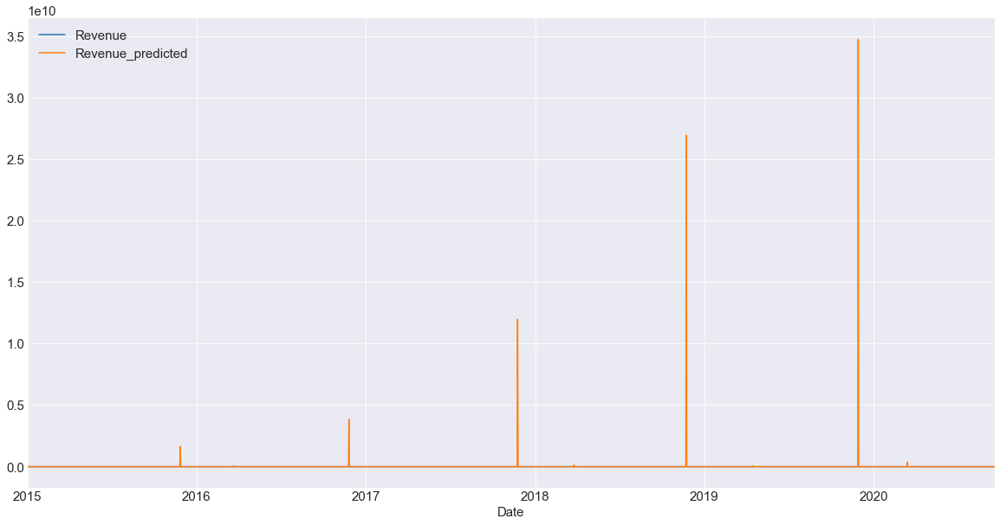

In [64]:
data_train_predict = pd.concat([np.expm1(y_train), np.expm1(mean_forecast)], axis= 1)
data_train_predict.plot()

<AxesSubplot:xlabel='Date'>

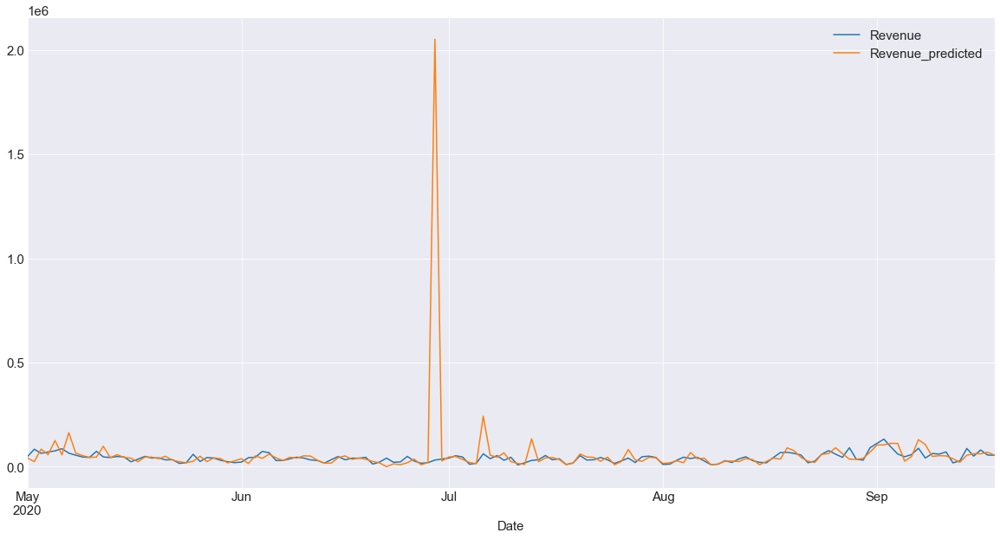

In [65]:
#Let's see a subset of the Time Series
data_train_predict.loc['2020-05-01':'2020-09-18'].plot()

In [66]:
metric_rmse(data_train_predict, 'Revenue')

1001140277.9398998

,Residuals
count,2.088000e+03
mean,-3.827611e+07
std,1.000648e+09
min,-3.473672e+10
25%,-6.484333e+03
50%,3.172056e+02
75%,6.002982e+03
max,8.763761e+04


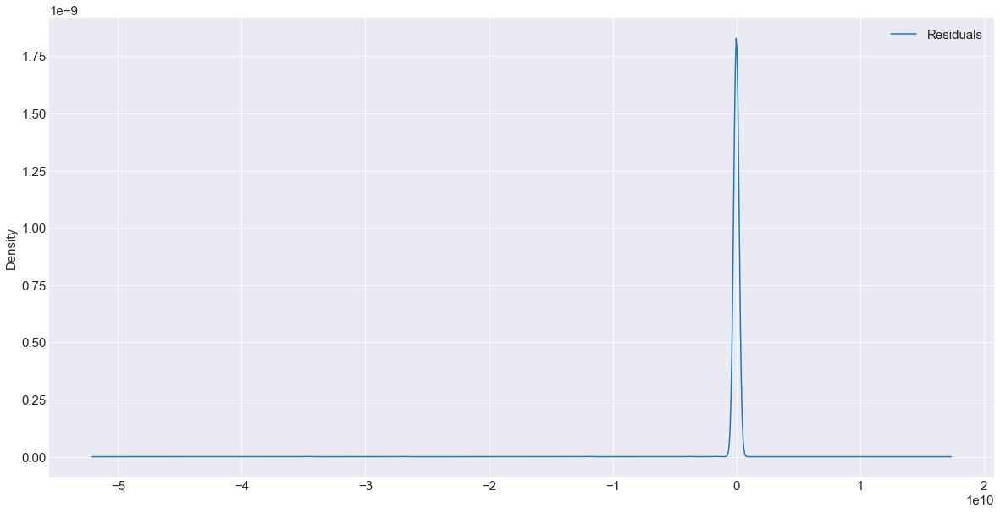

In [75]:
#Residual Analysis
data_residual = pd.DataFrame()
#Real - Predict
data_residual['Residuals'] = \
    data_train_predict[data_train_predict.columns[0]] - data_train_predict[data_train_predict.columns[1]]
data_residual.plot(kind='kde')

#Let's see the mean if it is in the center or show kind of skew
data_residual.describe()

In [302]:
draw_autocorrelation(pd.DataFrame(result.resid), 30)

NameError: name 'result' is not defined

In [70]:
#Augmented Dickey-Fuller test
residual = pd.DataFrame(result.resid)
residual.dropna(inplace= True)
test_adf(residual, residual.columns[0])

** Augmented Dickey-Fuller Test **

T-test: -12.141693292212285 < Confidence Interval[1%]: -3.433526838083527 - Result: Stationary
T-test: -12.141693292212285 < Confidence Interval[5%]: -2.8629433788300744 - Result: Stationary
T-test: -12.141693292212285 < Confidence Interval[10%]: -2.567517095065801 - Result: Stationary

P-Value: 1.6453953648076815e-22 < 0.05 - Result: Stationary


In [71]:
#Forecast vs. Test

#Predict taking full Test
forecast = result.get_prediction(start= '2020-09-19', end= '2021-05-09', 
                                 exog= X_test.loc['2020-09-19':'2021-05-09'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

2020-09-19    10.005896
2020-09-20    10.241901
2020-09-21    11.100572
2020-09-22    10.706082
2020-09-23    11.025286
                ...    
2021-05-05     3.345079
2021-05-06     3.211531
2021-05-07     3.191354
2021-05-08     2.748687
2021-05-09     2.839319
Freq: D, Name: Revenue_predicted, Length: 233, dtype: float64

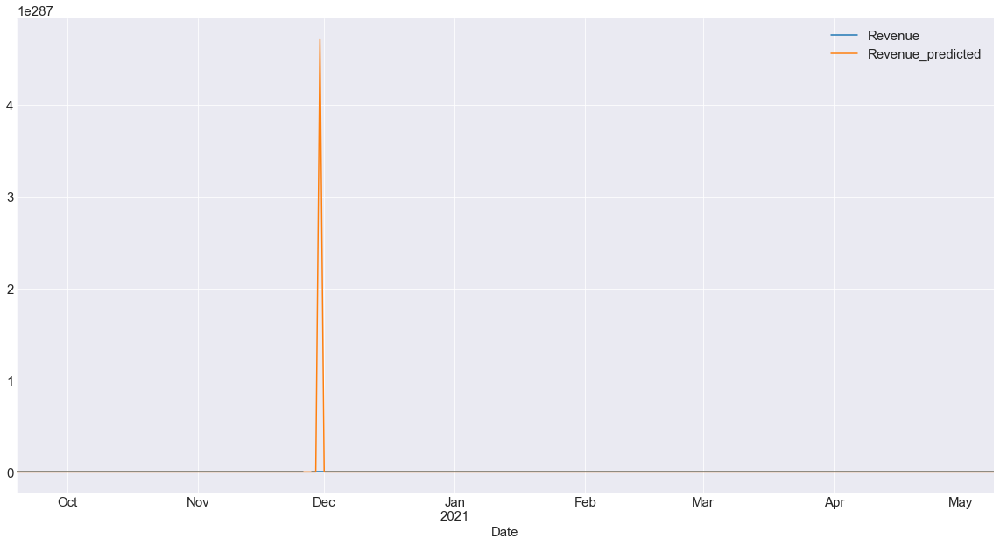

In [101]:
#Let's see how this model predict
data_test_predict = pd.concat([np.expm1(y_test), np.expm1(mean_forecast)], axis= 1)
data_test_predict.plot()

confidence_intervals = forecast.conf_int()
confidence_intervals = np.expm1(confidence_intervals)
plt.fill_between(confidence_intervals.index, confidence_intervals[confidence_intervals.columns[0]],
                 confidence_intervals[confidence_intervals.columns[1]], color='pink', alpha=0.5)

In [73]:
metric_rmse(data_test_predict, 'Revenue')

85033799.07349415

### Square Time Series Analysis

In [304]:
data_sqrt = data_small.copy()
data_sqrt['Revenue'] = np.sqrt(data_sqrt['Revenue'])

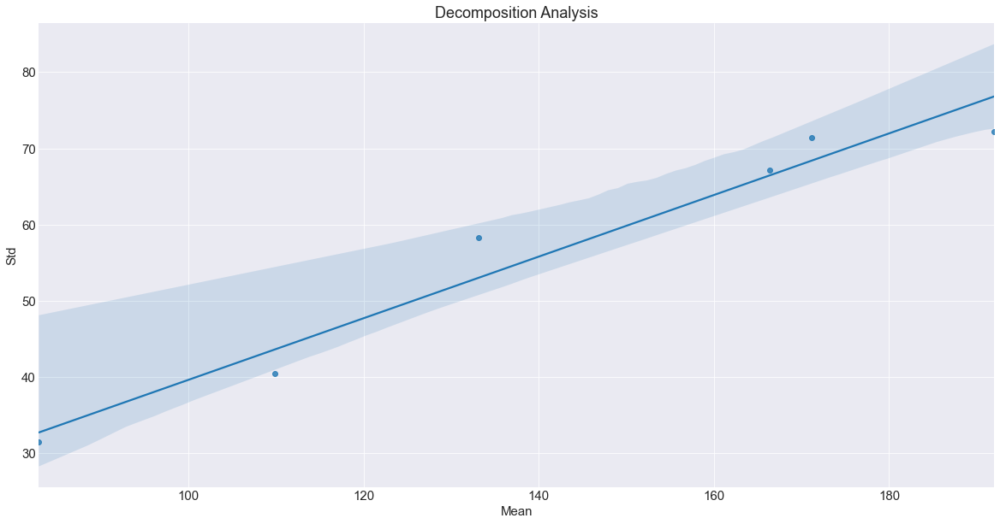

In [305]:
draw_decomposition(data_sqrt);

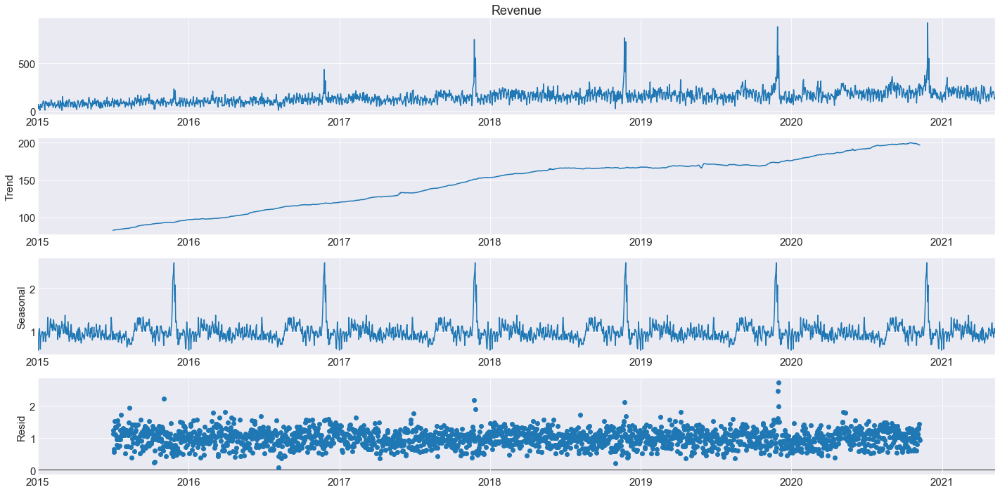

In [78]:
s_d_sqrt = seasonal_decompose(data_sqrt['Revenue'], period= 365, model= 'multiplicative')
s_d_sqrt.plot();

In [79]:
test_adf(data_sqrt, 'Revenue')

** Augmented Dickey-Fuller Test **

T-test: -4.1645727299394535 < Confidence Interval[1%]: -3.4332050526159112 - Result: Stationary
T-test: -4.1645727299394535 < Confidence Interval[5%]: -2.8628012970364574 - Result: Stationary
T-test: -4.1645727299394535 < Confidence Interval[10%]: -2.5674414457185817 - Result: Stationary

P-Value: 0.000756033819549469 < 0.05 - Result: Stationary


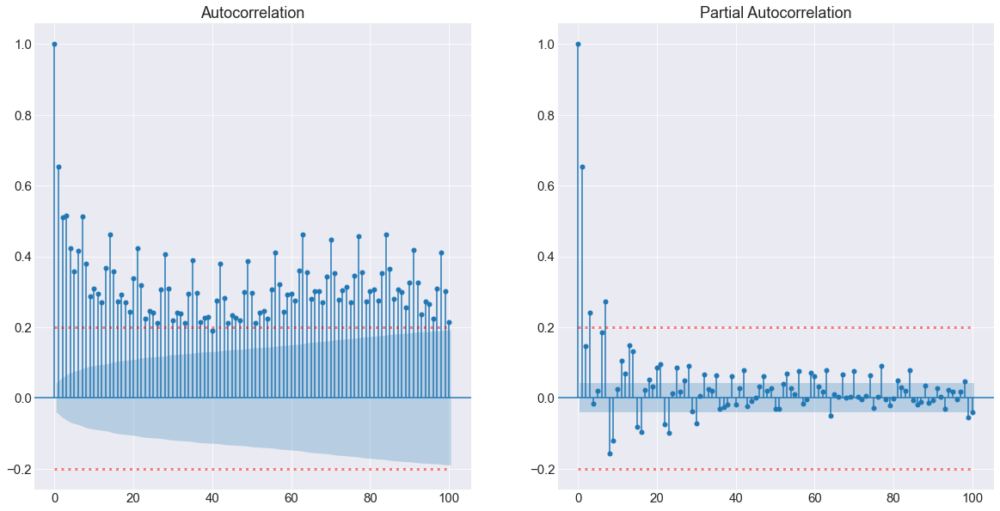

In [306]:
draw_autocorrelation(data_sqrt, 100)

### Sqrt Arima 

In [24]:
#Let's create the new exogenous variables
data_exogenous_sqrt = get_exogenous_features(data_sqrt)

In [138]:
#We have create a GridSearch in order to chose the better hyperparameters
#IMPORTANT, this task is quite intensive so we are saving a pickle for multiple iterations.
#ASSUMPTIONS, we would like to test with 365 season but we do not have enough memory
arima_params = {'p': [0, 4],
                'd': [0, 2], #Up to 1
                'q': [0, 4]}

sarima_params = {'P': [0, 4],
                 'D': [0, 2], #Up to 1
                 'Q': [0, 4],
                 'S': [7]}

#t = ['n','c','t','ct']
trend_params = ['c'] #We has test before and this is the best option always

In [25]:
X_train, y_train, X_test, y_test = sarimax_preparation_split(data_exogenous_sqrt)

In [ ]:
test_aic = gridsearch_sarimax(y_train, X_train[['Black_Friday', 'Easter', 'Covid']], arima_params, 
                             sarima_params, trend_params)

In [119]:
sorted(test_aic.items(), key=lambda x: x[1])

[((1, 0, 1, '-', 0, 1, 1, 7, '-', 'c'), 20716.71392250466),
 ((1, 0, 1, '-', 1, 1, 1, 7, '-', 'c'), 20716.92141933),
 ((1, 0, 1, '-', 0, 1, 1, 7, '-', 'n'), 20734.259905031497),
 ((1, 0, 1, '-', 1, 1, 1, 7, '-', 'n'), 20736.423939857275),
 ((1, 1, 1, '-', 0, 1, 1, 7, '-', 'n'), 20756.70747803355),
 ((1, 1, 1, '-', 1, 1, 1, 7, '-', 'n'), 20763.023790883817),
 ((1, 0, 0, '-', 0, 1, 1, 7, '-', 'c'), 20772.97049405372),
 ((1, 0, 0, '-', 1, 1, 1, 7, '-', 'n'), 20804.053614725108),
 ((1, 0, 0, '-', 0, 1, 1, 7, '-', 'n'), 20808.70342985497),
 ((1, 0, 0, '-', 1, 1, 1, 7, '-', 'c'), 20809.66505232566),
 ((0, 1, 1, '-', 1, 1, 1, 7, '-', 'n'), 20834.17159513651),
 ((0, 1, 1, '-', 0, 1, 1, 7, '-', 'n'), 20836.957638968266),
 ((1, 1, 1, '-', 1, 0, 1, 7, '-', 'n'), 20858.498377415446),
 ((1, 1, 1, '-', 1, 1, 1, 7, '-', 'c'), 20865.67815326595),
 ((1, 1, 1, '-', 0, 1, 1, 7, '-', 'c'), 20894.448387451026),
 ((0, 0, 1, '-', 1, 1, 1, 7, '-', 'c'), 20898.56875778031),
 ((0, 1, 1, '-', 1, 1, 1, 7, '-', 'c

In [20]:
test_aic = pickle_to_object(pickle_file)

In [21]:
sorted(test_aic.items(), key=lambda x: x[1])

[((0, 1, 2, '-', 2, 1, 1, 7, '-', 'c'), 129.7265275818368),
 ((1, 0, 2, '-', 1, 1, 2, 7, '-', 'c'), 20706.73600442587),
 ((1, 0, 3, '-', 2, 1, 2, 7, '-', 'c'), 20709.62117492332),
 ((1, 0, 3, '-', 3, 1, 2, 7, '-', 'c'), 20709.996951281373),
 ((1, 0, 3, '-', 1, 1, 3, 7, '-', 'c'), 20710.348807508264),
 ((1, 0, 3, '-', 3, 1, 3, 7, '-', 'c'), 20711.12423214681),
 ((1, 0, 3, '-', 2, 1, 3, 7, '-', 'c'), 20711.196785933415),
 ((1, 0, 3, '-', 1, 1, 2, 7, '-', 'c'), 20711.43590003671),
 ((1, 0, 1, '-', 0, 1, 1, 7, '-', 'c'), 20716.71392250466),
 ((1, 0, 1, '-', 1, 1, 1, 7, '-', 'c'), 20716.92141933),
 ((1, 0, 1, '-', 1, 1, 2, 7, '-', 'c'), 20717.133011600203),
 ((1, 0, 1, '-', 2, 1, 2, 7, '-', 'c'), 20717.54000169415),
 ((1, 0, 1, '-', 2, 1, 3, 7, '-', 'c'), 20718.61215734003),
 ((1, 0, 1, '-', 0, 1, 3, 7, '-', 'c'), 20719.691497262622),
 ((1, 0, 1, '-', 1, 1, 3, 7, '-', 'c'), 20720.11671068731),
 ((1, 0, 1, '-', 3, 1, 2, 7, '-', 'c'), 20720.45145494505),
 ((1, 0, 1, '-', 3, 1, 3, 7, '-', 'c')

In [26]:
#Fit considering best hyperparameters
model = SARIMAX(endog= y_train, exog= X_train[['Black_Friday', 'Easter', 'Covid']],
                order= (1, 0, 2), seasonal_order= (1, 1, 2, 7), trend= 'c')
result = model.fit()

In [27]:
#Predict taking full Train
forecast = result.get_prediction(start= '2015-01-01', end= '2020-09-18', 
                                 exog= X_train.loc['2015-01-01':'2020-09-18'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

Date
2015-01-01      0.383327
2015-01-02      0.439084
2015-01-03      0.479207
2015-01-04      0.459059
2015-01-05      0.456926
                 ...    
2020-09-14    229.957211
2020-09-15    245.924583
2020-09-16    230.615159
2020-09-17    258.166237
2020-09-18    234.922997
Freq: D, Name: Revenue_predicted, Length: 2088, dtype: float64

<AxesSubplot:xlabel='Date'>

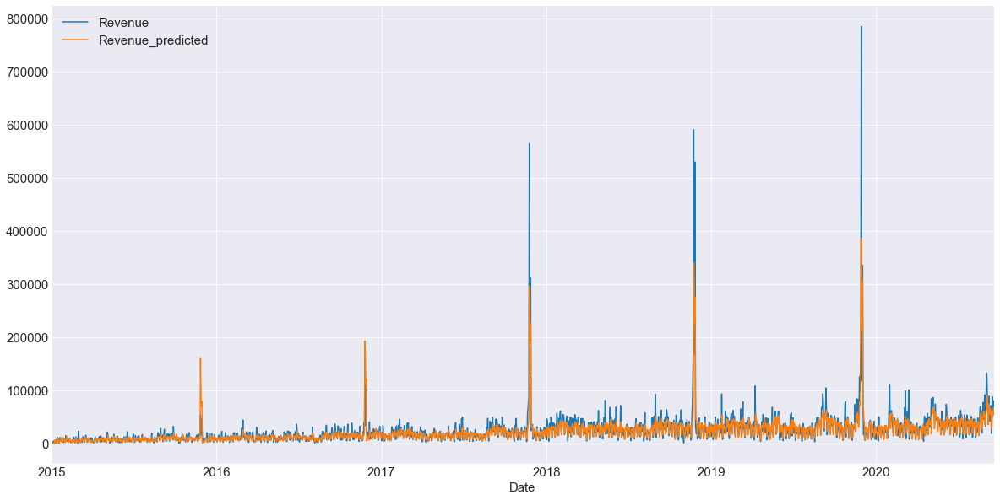

In [28]:
data_train_predict = pd.concat([pd.DataFrame(y_train).apply(lambda x: x ** 2), 
                                pd.DataFrame(mean_forecast).apply(lambda x: x ** 2)], axis= 1)
data_train_predict.plot()

<AxesSubplot:xlabel='Date'>

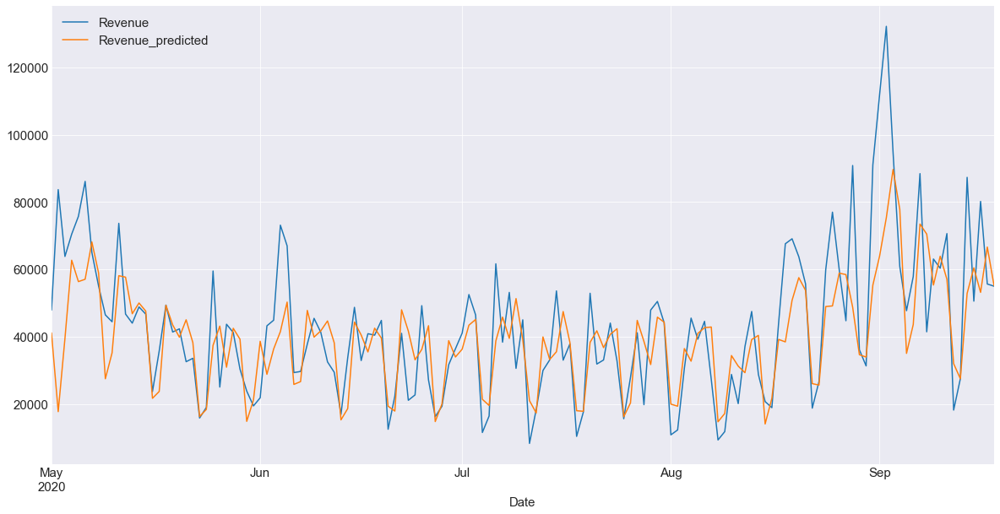

In [29]:
#Let's see a subset of the Time Series
data_train_predict.loc['2020-05-01':'2020-09-18'].plot()

In [30]:
metric_rmse(data_train_predict, 'Revenue')

19621.188643040987

,Residuals
count,2088.000000
mean,1232.522989
std,19587.130315
min,-269009.237043
25%,-4103.613928
50%,-71.370170
75%,4893.141589
max,404720.121675


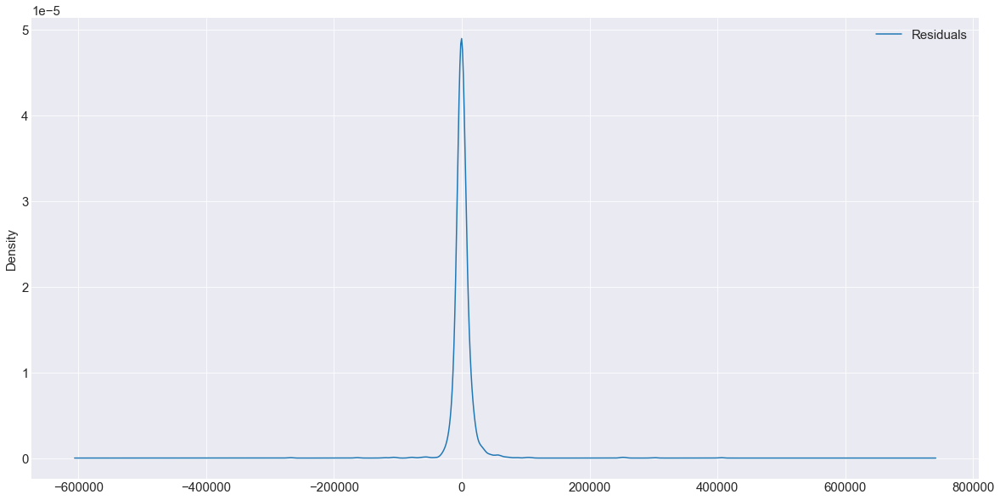

In [31]:
#Residual Analysis
data_residual = pd.DataFrame()
#Real - Predict
data_residual['Residuals'] = \
    data_train_predict[data_train_predict.columns[0]] - data_train_predict[data_train_predict.columns[1]]
data_residual.plot(kind='kde')

#Let's see the mean if it is in the center or show kind of skew
data_residual.describe()

In [307]:
draw_autocorrelation(pd.DataFrame(result.resid), 30)

NameError: name 'result' is not defined

In [34]:
#Augmented Dickey-Fuller test
residual = pd.DataFrame(result.resid)
residual.dropna(inplace= True)
test_adf(residual, residual.columns[0])

** Augmented Dickey-Fuller Test **

T-test: -45.69568884529083 < Confidence Interval[1%]: -3.4334872119603324 - Result: Stationary
T-test: -45.69568884529083 < Confidence Interval[5%]: -2.862925883058088 - Result: Stationary
T-test: -45.69568884529083 < Confidence Interval[10%]: -2.567507779564507 - Result: Stationary

P-Value: 0.0 < 0.05 - Result: Stationary


In [35]:
#Forecast vs. Test

#Predict taking full Test
forecast = result.get_prediction(start= '2020-09-19', end= '2021-05-09', 
                                 exog= X_test.loc['2020-09-19':'2021-05-09'][['Black_Friday', 'Easter', 'Covid']])
mean_forecast = forecast.predicted_mean
#Rename mean_forecast column name
mean_forecast.rename(f'{y_train.name}_predicted', inplace= True)

2020-09-19    164.428558
2020-09-20    174.045927
2020-09-21    234.360490
2020-09-22    223.314736
2020-09-23    228.726663
                 ...    
2021-05-05    230.972416
2021-05-06    235.562066
2021-05-07    231.545778
2021-05-08    160.948584
2021-05-09    172.645094
Freq: D, Name: Revenue_predicted, Length: 233, dtype: float64

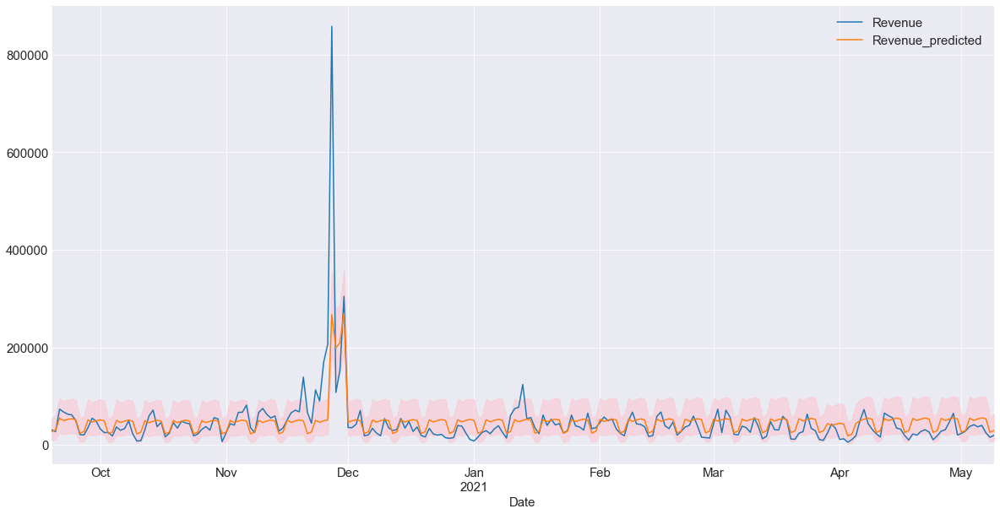

In [36]:
#Let's see how this model predict
data_test_predict = pd.concat([pd.DataFrame(y_test).apply(lambda x: x ** 2), 
                               pd.DataFrame(mean_forecast).apply(lambda x: x ** 2)], axis= 1)
data_test_predict.plot()

confidence_intervals = forecast.conf_int()
confidence_intervals = confidence_intervals.apply(lambda x: x ** 2)
plt.fill_between(confidence_intervals.index, confidence_intervals[confidence_intervals.columns[0]],
                 confidence_intervals[confidence_intervals.columns[1]], color='pink', alpha=0.5)

In [37]:
metric_rmse(data_test_predict, 'Revenue')

45356.557148849846

### Triple Exponential Smoothing

Now, we are going to apply another classical Time Series Forecast method called Triple Exponential Smoothing

In [68]:
#We have create a GridSearch in order to chose the better hyperparameters
#IMPORTANT, this task is quite intensive so we are saving a pickle for multiple iterations.

#Parameters for fit
trend_params = ['add','mul']
damped_params = [True, False]
seasonal_params = ['add','mul']
period_params = [49]
#Parameters for prediction
box_cox = [True, False]
bias_params = [True, False]

In [66]:
X_train, y_train, X_test, y_test = sarimax_preparation_split(data_small)

In [69]:
test_rmse = gridsearch_tes(y_train, trend_params, damped_params, seasonal_params, period_params, box_cox, bias_params)

In [153]:
sorted(test_rmse.items(), key=lambda x: x[1])

[(('mul', False, 'mul', 49, '-', True, True), 26318.88540473293),
 (('add', True, 'mul', 49, '-', True, True), 26319.98468729066),
 (('add', False, 'mul', 49, '-', True, True), 26324.22576135944),
 (('mul', True, 'mul', 49, '-', True, True), 26355.65336118144),
 (('add', False, 'mul', 49, '-', True, False), 26371.676168562444),
 (('add', True, 'mul', 49, '-', True, False), 26373.30689833187),
 (('mul', False, 'mul', 49, '-', True, False), 26382.213201091752),
 (('mul', True, 'mul', 49, '-', True, False), 26407.72175784717),
 (('mul', True, 'add', 49, '-', True, True), 26766.289881068253),
 (('mul', False, 'add', 49, '-', True, True), 26768.168970195256),
 (('add', False, 'add', 49, '-', True, True), 26771.566766244807),
 (('add', True, 'add', 49, '-', True, True), 26773.6037399587),
 (('mul', False, 'mul', 35, '-', True, True), 26784.826834092364),
 (('add', True, 'mul', 35, '-', True, True), 26808.374850540516),
 (('add', False, 'mul', 35, '-', True, True), 26809.621282793334),
 (('mu

In [70]:
#Fit considering best hyperparameters
model = ExponentialSmoothing(endog= y_train, trend= 'mul', damped= False, seasonal= 'mul', seasonal_periods= 49)
result = model.fit(optimized= True, use_boxcox= True, remove_bias= True)

In [71]:
#Predict taking full Train
forecast = result.predict(start= '2015-01-01', end= '2020-09-18')
forecast.rename(f'{y_train.name}_predicted', inplace= True)

Date
2015-01-01     5003.598206
2015-01-02     4676.751201
2015-01-03     3378.231495
2015-01-04     3094.066773
2015-01-05     4231.473709
                  ...     
2020-09-14    67871.585224
2020-09-15    65054.557271
2020-09-16    58179.091239
2020-09-17    74981.072375
2020-09-18    70012.312567
Freq: D, Name: Revenue_predicted, Length: 2088, dtype: float64

<AxesSubplot:xlabel='Date'>

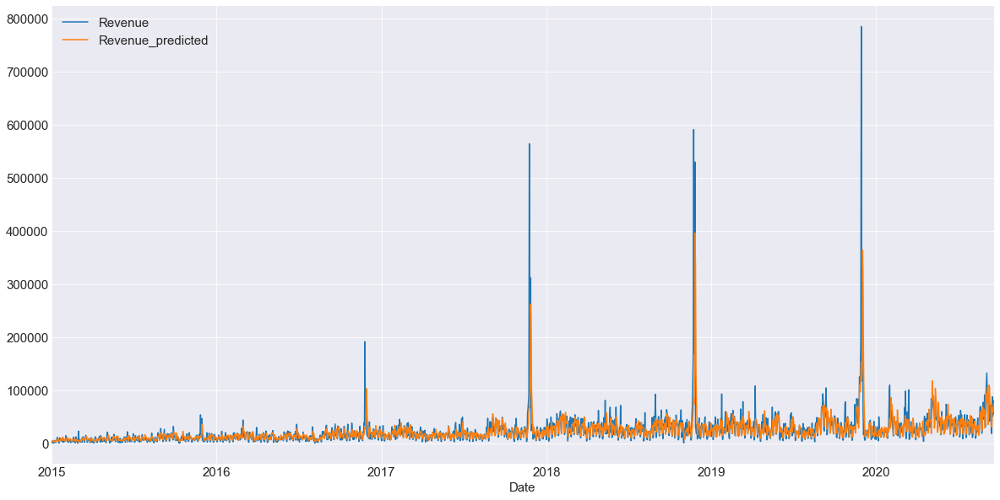

In [72]:
data_train_predict = pd.concat([y_train, forecast], axis= 1)
data_train_predict.plot()

<AxesSubplot:xlabel='Date'>

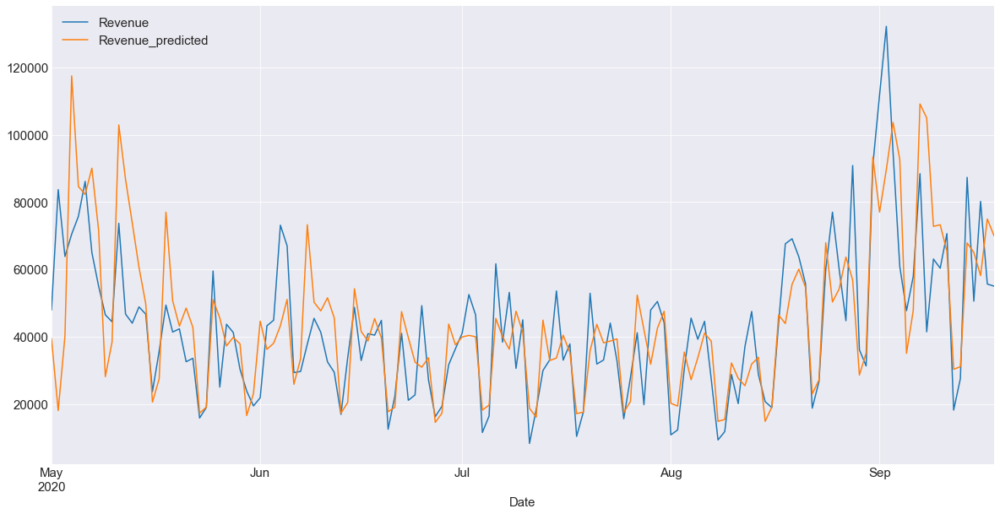

In [73]:
#Let's see a subset of the Time Series
data_train_predict.loc['2020-05-01':'2020-09-18'].plot()

In [74]:
metric_rmse(data_train_predict, 'Revenue')

26318.88540473293

,Residuals
count,2.088000e+03
mean,1.299776e-12
std,2.632519e+04
min,-3.023694e+05
25%,-5.560762e+03
50%,-1.477460e+03
75%,3.426474e+03
max,6.311469e+05


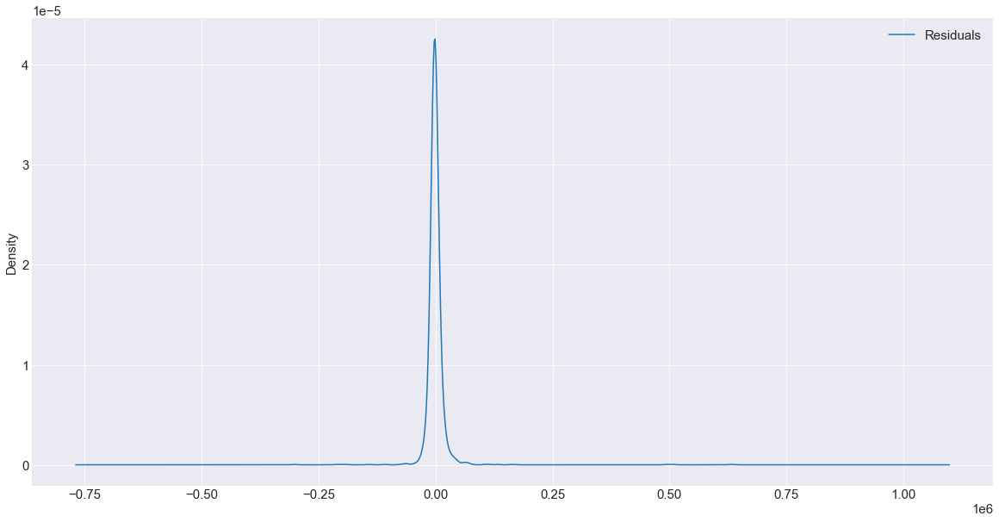

In [75]:
#Residual Analysis
data_residual = pd.DataFrame()
#Real - Predict
data_residual['Residuals'] = \
    data_train_predict[data_train_predict.columns[0]] - data_train_predict[data_train_predict.columns[1]]
data_residual.plot(kind='kde')

#Let's see the mean if it is in the center or show kind of skew
data_residual.describe()

In [308]:
draw_autocorrelation(pd.DataFrame(result.resid), 30)

NameError: name 'result' is not defined

In [76]:
#Augmented Dickey-Fuller test
residual = pd.DataFrame(result.resid)
residual.dropna(inplace= True)
test_adf(residual, residual.columns[0])

** Augmented Dickey-Fuller Test **

T-test: -19.180829942143056 < Confidence Interval[1%]: -3.433499298918619 - Result: Stationary
T-test: -19.180829942143056 < Confidence Interval[5%]: -2.8629312197305192 - Result: Stationary
T-test: -19.180829942143056 < Confidence Interval[10%]: -2.56751062103432 - Result: Stationary

P-Value: 0.0 < 0.05 - Result: Stationary


In [77]:
#Forecast vs. Test

#Predict taking full Test
forecast = result.predict(start= '2020-09-19', end= '2021-05-09')
forecast.rename(f'{y_train.name}_predicted', inplace= True)

2020-09-19    27131.535950
2020-09-20    31408.909655
2020-09-21    68021.872054
2020-09-22    53342.780134
2020-09-23    53206.552635
                  ...     
2021-05-05    30474.248053
2021-05-06    30119.693288
2021-05-07    27864.347976
2021-05-08    13316.307160
2021-05-09    15502.747089
Freq: D, Name: Revenue_predicted, Length: 233, dtype: float64

<AxesSubplot:xlabel='Date'>

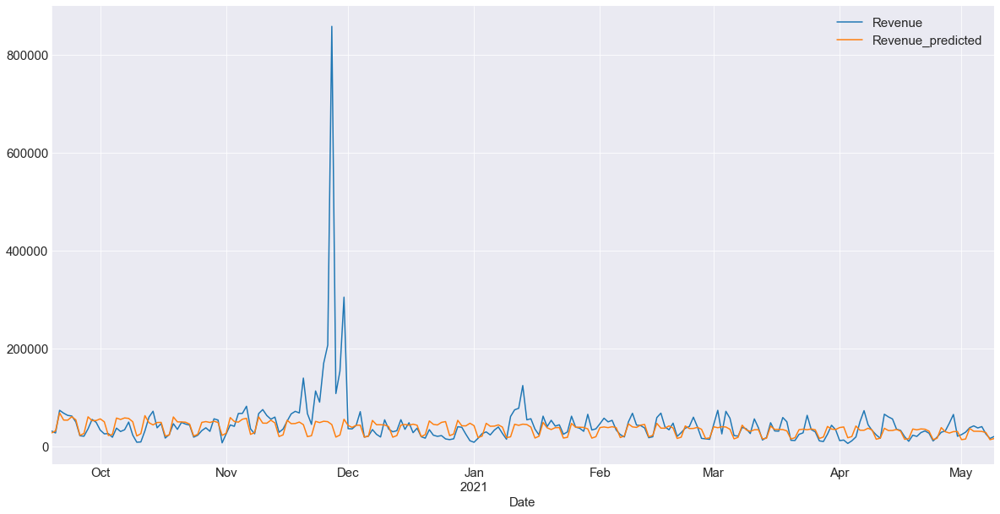

In [78]:
#Let's see how this model predict
data_test_predict = pd.concat([y_test, forecast], axis= 1)
data_test_predict.plot()

In [79]:
metric_rmse(data_test_predict, 'Revenue')

60830.33415477514

## Machine Learning Models for Time Series

In [125]:
#Create the lag features
lags = [1, 2, 3, 4, 5, 6, 7, 364]
data_lag = get_lag_features(data_small, 'Revenue', lags)

In [126]:
#Temporary DataFrame for checking correlation
data_temp = data_lag.copy()
data_temp['Revenue'] = data_small['Revenue']

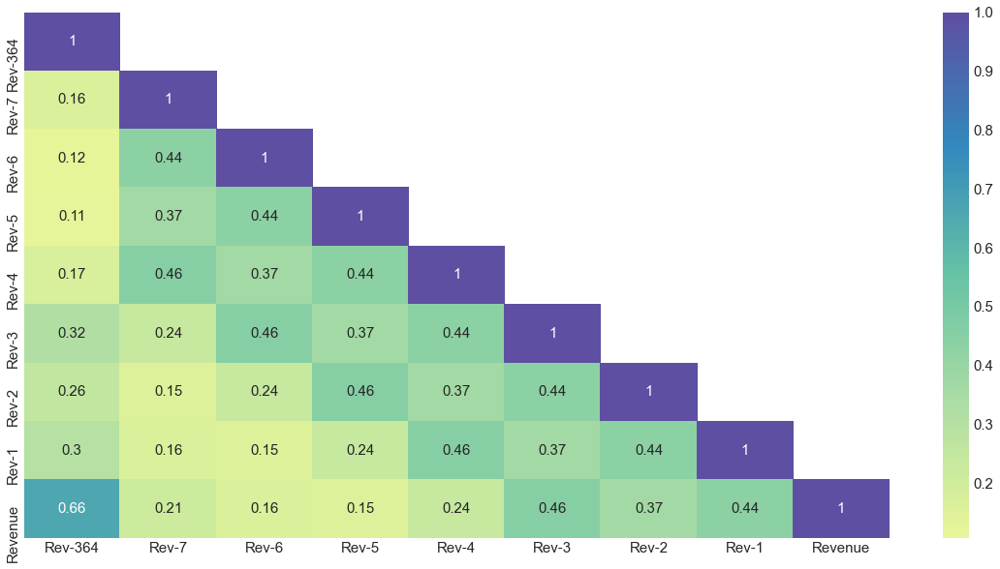

In [127]:
#Let's check the correlation
corr_matrix(data_temp)

In [128]:
#Create Seasonal Features - I am transforming as if they were non-numeric variables
data_seasonal = pd.get_dummies(data_small[['Year', 'Month', 'Day']].astype('str'))
#Create Exogenus Features
data_exogenous = get_exogenous_features(data_small)[['Black_Friday', 'Easter', 'Covid']]
#Create the model to Train and Test with the different Machine Learning models
data_model = pd.concat([data_seasonal, data_exogenous, data_lag, data_small['Revenue']], axis= 1)
data_model.dropna(inplace= True)

### Variance Analysis
It is important to see if we have features with variance close to 0 in that case, we should remove them. This only applies to quantitative variables.

In [22]:
non_zero_variance(data_model, data_model.iloc[:,0:-1])

Day_24 feature: has non-zero variance - Std:0.18
Month_2 feature: has non-zero variance - Std:0.28
Month_3 feature: has non-zero variance - Std:0.29
Day_30 feature: has non-zero variance - Std:0.17
Day_8 feature: has non-zero variance - Std:0.18
Rev-6 feature: has non-zero variance - Std:41024.65
Year_2019 feature: has non-zero variance - Std:0.39
Day_19 feature: has non-zero variance - Std:0.18
Day_1 feature: has non-zero variance - Std:0.18
Day_25 feature: has non-zero variance - Std:0.18
Day_31 feature: has non-zero variance - Std:0.14
Rev-2 feature: has non-zero variance - Std:41014.23
Day_3 feature: has non-zero variance - Std:0.18
Day_14 feature: has non-zero variance - Std:0.18
Year_2016 feature: has non-zero variance - Std:0.39
Day_22 feature: has non-zero variance - Std:0.18
Month_9 feature: has non-zero variance - Std:0.27
Year_2020 feature: has non-zero variance - Std:0.39
Rev-3 feature: has non-zero variance - Std:41015.14
Day_5 feature: has non-zero variance - Std:0.18
Day

### Train/Test Split
Let's prepare the X_train, X_test, y_train and y_test data and scale these features with Robust scaler

A prepare the full time series adding the validation data

In [23]:
#Train and Test Split
X_train, X_test, y_train, y_test = time_series_train_test_split(data_model, lags)

In [184]:
#Scale the features
X_train_scaled, X_test_scaled = data_normalization(X_train, X_test, 'robust')

### Data Validation and Data Forecasting
We are going to concatenate the current Time Series Data with a longer file with more reals values and use this bigger model for checking how good or bad is woking the model

Moreover, we are going to create the last Data Set for Forecasting purposes. The idea is forecasting up to 14 days in advance.
We are going to add to the Data Validation Data Set a new one with the lagged, seasonal and exogenous features in order to try to estimate what will be the sales.

Some important assumptions. We need to trained 14 models for each forecast:
* model_trained_1: This will forecast T+1
* model_trained_2: This will forecast T+2
* And so on...

In [46]:
data_full = pd.concat([data_small, data_validation])

In [47]:
#Create the lag features for data validation
lags = [1, 2, 3, 4, 5, 6, 7, 364]
data_lag_full = get_lag_features(data_full, 'Revenue', lags)

In [48]:
#Create Seasonal Features - I am transforming as if they were non-numeric variables
data_seasonal_full = pd.get_dummies(data_full[['Year', 'Month', 'Day']].astype('str'))
#Create Exogenus Features
data_exogenous_full = get_exogenous_features(data_full)[['Black_Friday', 'Easter', 'Covid']]
#Create the model to Train and Test with the different Machine Learning models
data_model_full = pd.concat([data_seasonal_full, data_exogenous_full, data_lag_full, 
                                   data_full['Revenue']], axis= 1)
data_model_full.dropna(inplace= True)

### Linear Regression Example

Let's check a simple Linear Regression for this data

In [98]:
#Train and Test Split
X_train, X_test, y_train, y_test = time_series_train_test_split(data_model, lags)

In [99]:
#Scale the features
X_train_scaled, X_test_scaled = data_normalization(X_train, X_test, 'robust')

In [100]:
#Linear Regression()
model = LinearRegression()
model.fit(X_train_scaled, y_train)

LinearRegression()

In [101]:
#Let's predict this model with Train Data
y_predict_train = model.predict(X_train_scaled)
y_predict_train = pd.Series(y_predict_train, index= y_train.index)
y_predict_train = y_predict_train.rename(f'{y_train.name}_predicted')
#Create the new DataFrame with the Train y values and Train predict values
forecast_train = pd.DataFrame([y_train, y_predict_train]).T

In [102]:
#Calculate the RMSE
metric_rmse(forecast_train, 'Revenue')

14578.265520365843

<AxesSubplot:xlabel='Date'>

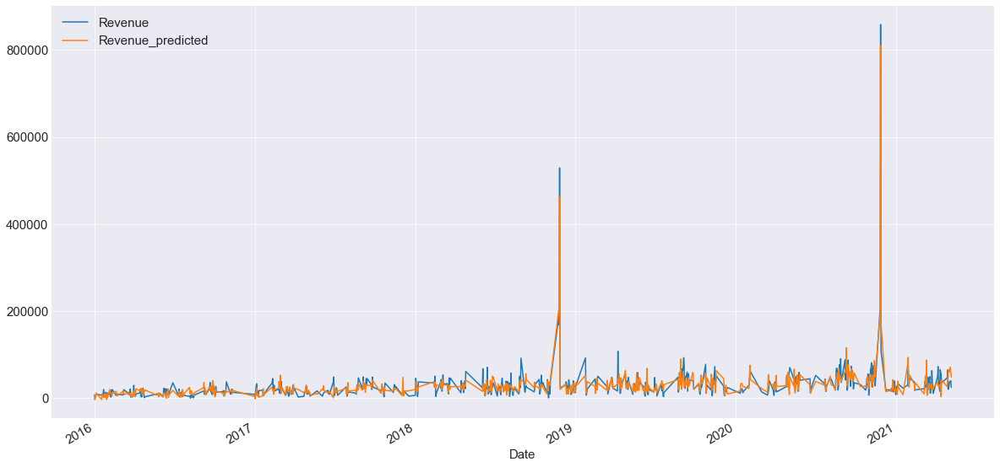

In [103]:
#Let's see the forecast
forecast_train.plot()

#### Residual Analysis 

In [104]:
forecast_train['Residuals'] = forecast_train['Revenue'] - forecast_train['Revenue_predicted']

<AxesSubplot:xlabel='Date'>

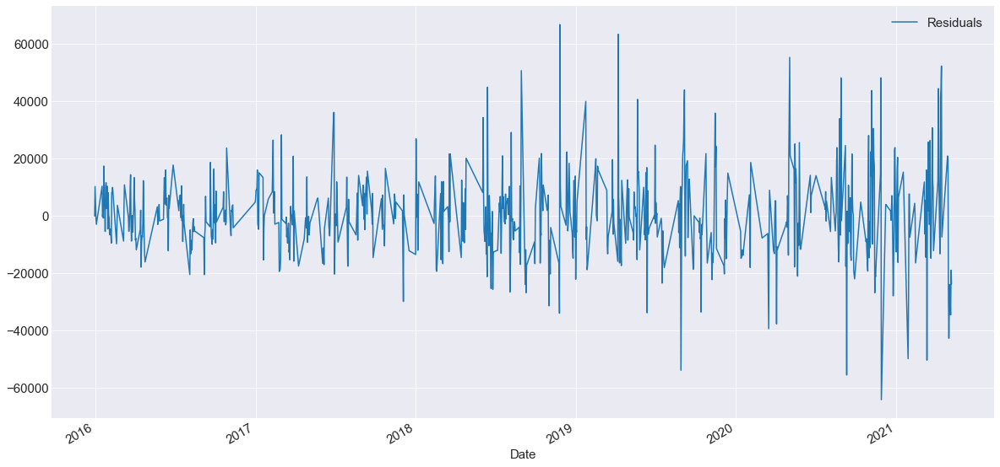

In [105]:
forecast_train[['Residuals']].plot()

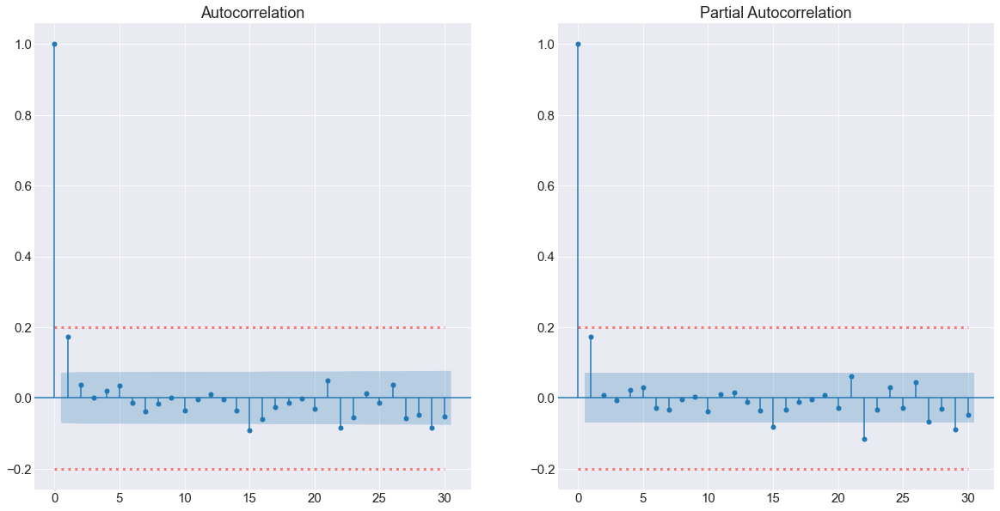

In [286]:
draw_autocorrelation(forecast_train[['Residuals']], 30)

In [108]:
test_adf(forecast_train, 'Residuals')

** Augmented Dickey-Fuller Test **

T-test: -23.105127741667594 < Confidence Interval[1%]: -3.4389722010249386 - Result: Stationary
T-test: -23.105127741667594 < Confidence Interval[5%]: -2.8653454308425705 - Result: Stationary
T-test: -23.105127741667594 < Confidence Interval[10%]: -2.5687964010457227 - Result: Stationary

P-Value: 0.0 < 0.05 - Result: Stationary


In [109]:
#R²
r2_score(forecast_train['Revenue'], forecast_train['Revenue_predicted'])

0.8716276577424926

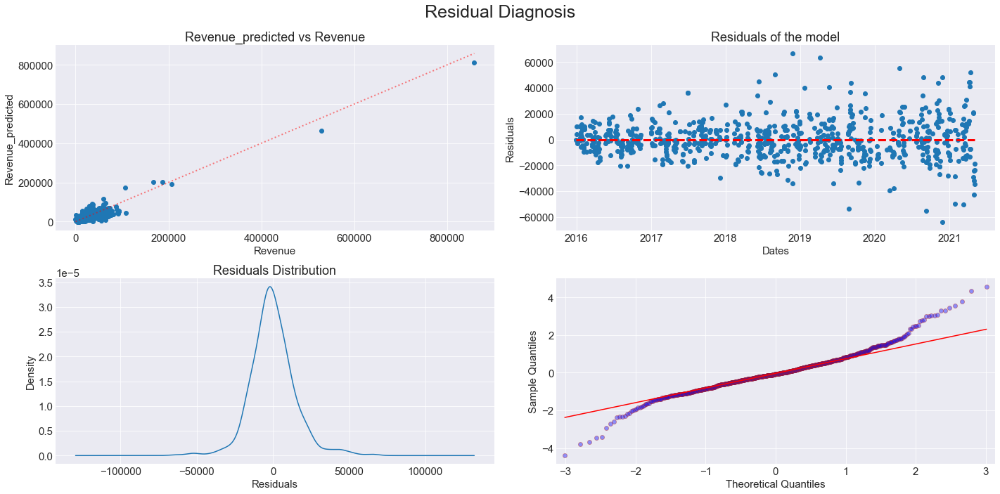

In [110]:
#Residual Analysis
draw_residuals_diagnosis(forecast_train, ['Revenue', 'Revenue_predicted', 'Residuals'])

#### Predict 

In [111]:
#Now how this perform with the Test Data
y_predict_test = model.predict(X_test_scaled)
y_predict_test = pd.Series(y_predict_test, index= y_test.index)
y_predict_test = y_predict_test.rename(f'{y_test.name}_predicted')
#Create the new DataFrame with the Test y values and Test predict values
forecast_test = pd.DataFrame([y_test, y_predict_test]).T

In [112]:
metric_rmse(forecast_test, 'Revenue')

29519.2466327241

<AxesSubplot:xlabel='Date'>

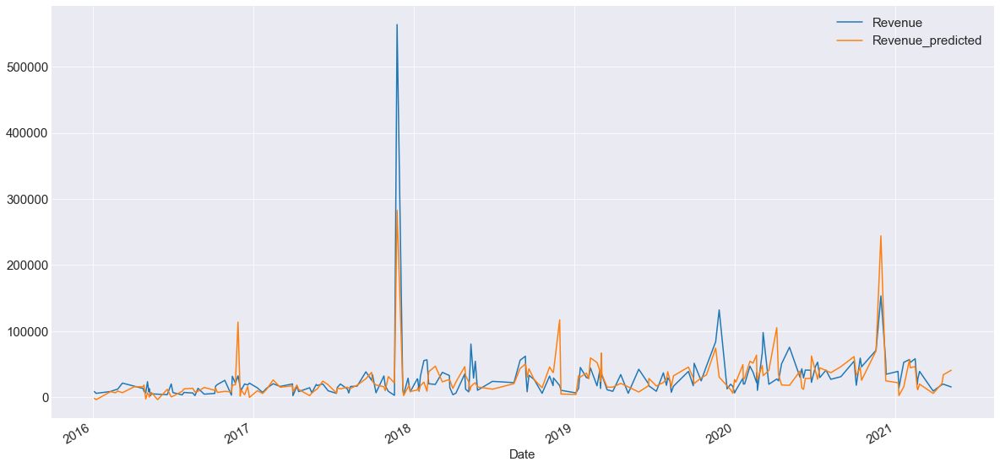

In [113]:
#Let's see the forecast
forecast_test.plot()

In [114]:
#R²
r2_score(forecast_test['Revenue'], forecast_test['Revenue_predicted'])

0.5450427846104638

<AxesSubplot:>

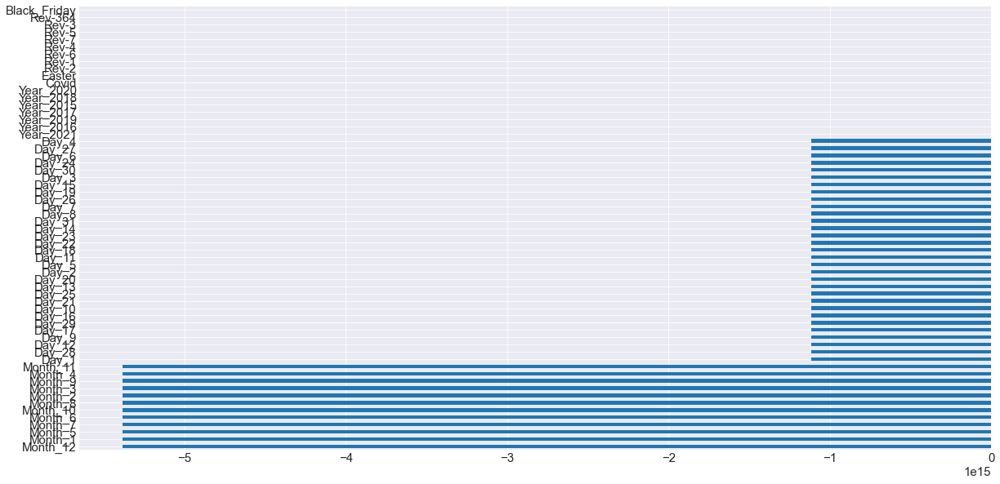

In [115]:
#Features Importance
pd.Series(model.coef_, data_model.columns[0:-1]).sort_values(ascending = True).plot(kind = 'barh')

### Test Machine Learning Models

Assumptions, we are going to fit and predict for forecasting just one day. Then we will chose the best model and create a new dataset for predicting the day after and so on. In total seven different Dataframes.

We are going to test different ML Regression models:
* Ridge
* Elastic Net
* KNeighborsRegressor
* RandomForestRegressor
* GradientBoostingRegressor
* XGBRegressor
* LGBMRegressor

First of all, get the right hyperparameters via GridSearch

##### Constants for GridSearch Time Series

In [34]:
ridge_params = {
    'alpha': [0.001, 0.01, 0.1, 1, 10],
    'fit_intercept': [True, False],
    'solver': ['svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
    }

elastic_net_params = {
    'alpha': [0.001, 0.01, 0.1, 0.5, 0.9, 0.99, 0.999],
    'l1_ratios': np.linspace(0, 1, 20),
    'fit_intercept': [True, False]
    }

k_neighbors_params = {
    'n_neighbors': np.linspace(5, 100, 20, dtype= int),
    'weights': ['uniform', 'distance'],
    'algorithm': ['ball_tree', 'kd_tree', 'brute']
    }

random_forest_params = {  
    'n_estimators': np.linspace(100, 1000, 3, dtype= int),
    'max_depth': [30, 40, 50],
    'min_samples_split': np.linspace(2, 10, 3, dtype= int),
    'min_samples_leaf': np.linspace(1, 10, 10, dtype= int),
    'max_features': ['auto', 'sqrt'],
    'bootstrap': [True, False],
    }

gradient_boosting_params = {
    'loss': ['ls', 'lad', 'huber', 'quantile'],
    'n_estimators': np.linspace(100, 1000, 3, dtype= int),
    'min_samples_split': np.linspace(2, 10, 3, dtype= int),
    'min_samples_leaf': np.linspace(1, 10, 10, dtype= int),
    'max_depth': [3, 4, 5],
    'max_features': ['auto', 'sqrt']
    }

xgb_params = {
    'n_estimators': np.linspace(100, 1000, 4, dtype= int),
    'max_depth': np.linspace(3, 20, 6, dtype= int),
    'booster': ['gbtree', 'gblinear', 'dart']
    }

lgbm_params = {
    'num_leaves': np.linspace(31, 2000, 6, dtype= int),
    'n_estimators': np.linspace(50, 1000, 6, dtype= int)
    }

#### Ridge 

In [80]:
#GridSearch Ridge
models_list_ridge, metrics_list_ridge, forecasts_list_ridge = \
    grid_search_times_series('ridge', ridge_params, data_model, 'Revenue', lags, 10, 'rmse')

In [106]:
best_model_metric(models_list_ridge, metrics_list_ridge)

(26847.66211027263, Ridge(alpha=0.001, fit_intercept=False, solver='sag'))

#### Elastic Net

In [81]:
#GridSearch Elastic Net
models_list_elastic, metrics_list_elastic, forecasts_list_elastic = \
    grid_search_times_series('elastic', elastic_net_params, data_model, 'Revenue', lags, 10, 'rmse')

In [108]:
best_model_metric(models_list_elastic, metrics_list_elastic)

(24270.631929236923, ElasticNet(alpha=0.9, l1_ratio=0.3684210526315789))

#### K-Neighbors 

In [91]:
#GridSearch K-neighbors
models_list_kn, metrics_list_kn, forecasts_list_kn = \
    grid_search_times_series('kneighbors', k_neighbors_params, data_model, 'Revenue', lags, 10, 'rmse')

In [109]:
best_model_metric(models_list_kn, metrics_list_kn)

(27118.266600226074,
 KNeighborsRegressor(algorithm='kd_tree', n_neighbors=10, weights='distance'))

#### Random Forest

In [26]:
#Random Forest
models_list_random, metrics_list_random, forecasts_list_random = \
    grid_search_times_series('random', random_forest_params, data_model, 'Revenue', lags, 10, 'rmse')

In [27]:
best_model_metric(models_list_random, metrics_list_random)

(25700.928861148837, RandomForestRegressor(max_depth=40))

#### Gradient Boost

In [102]:
#GridSearch Gradient Boost
models_list_gradient, metrics_list_gradient, forecasts_list_gradient = \
    grid_search_times_series('gradient', gradient_boosting_params, data_model, 'Revenue', lags, 10, 'rmse')

In [125]:
best_model_metric(models_list_gradient, metrics_list_gradient)

(22352.736923338736, GradientBoostingRegressor(max_features='auto'))

#### XGB

In [124]:
#XGB
models_list_xgb, metrics_list_xgb, forecasts_list_xgb = \
    grid_search_times_series('xgb', xgb_params, data_model, 'Revenue', lags, 10, 'rmse')

[10:46:56] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:46:56] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:46:56] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:47:06] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:47:06] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:47:06] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:47:26] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:47:26] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:47:38] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:48:13] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:48:13] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:48:13] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:49:29] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:49:29] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:49:29] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:51:57] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:51:57] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:51:57] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:54:00] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:54:00] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:54:01] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[10:57:31] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:59:52] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:59:52] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[11:08:07] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:08:08] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:08:08] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[11:12:03] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:12:04] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:12:04] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

[11:21:20] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:21:20] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:21:21] WARNING: /tmp/build/80754af9/xgboost-split_1619724447847/work/src/learner.cc:541: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down

In [126]:
best_model_metric(models_list_xgb, metrics_list_xgb)

(25635.222201310367,
 XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=13,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=1000, n_jobs=4, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None))

#### LGBM

In [36]:
#LGBMRegressor
models_list_lgbm, metrics_list_lgbm, forecasts_list_lgbm = \
    grid_search_times_series('lgbm', lgbm_params, data_model, 'Revenue', lags, 10, 'rmse')

In [37]:
best_model_metric(models_list_lgbm, metrics_list_lgbm)

(28423.544286052154, LGBMRegressor(n_estimators=50))

### Training and Validation 

#### Train/Test Split
Let's prepare the X_train, X_test, y_train and y_test data and scale these features with Robust scaler

A prepare the full time series adding the validation data

In [29]:
#Train and Test Split
X_train, X_test, y_train, y_test = time_series_train_test_split(data_model, lags)

In [30]:
#Scale the features
X_train_scaled, X_test_scaled = data_normalization(X_train, X_test, 'robust')

#### Ridge Model

In [31]:
#Ridge Model
model_ridge = Ridge(alpha=0.001, fit_intercept=False, solver='sag')

In [32]:
#Model
model_ridge.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_ridge = predict_model(model_ridge, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_ridge = metric_rmse(forecast_ridge, "Revenue")
r2_ridge = r2_score(forecast_ridge["Revenue"], forecast_ridge["Revenue_predicted"])
print(f'Ridge RMSE_train: {rmse_ridge}')
print(f'R²: {r2_ridge}')

Ridge RMSE_train: 14720.596503067534
R²: 0.7541295872692808


In [33]:
#Test Values
forecast_ridge_test = predict_model(model_ridge, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_ridge_test = metric_rmse(forecast_ridge_test, "Revenue")
r2_ridge_test = r2_score(forecast_ridge_test["Revenue"], forecast_ridge_test["Revenue_predicted"])
print(f'Ridge RMSE_test: {rmse_ridge_test}')
print(f'R²: {r2_ridge_test}')

Ridge RMSE_test: 29436.516417425722
R²: 0.8268722010639824


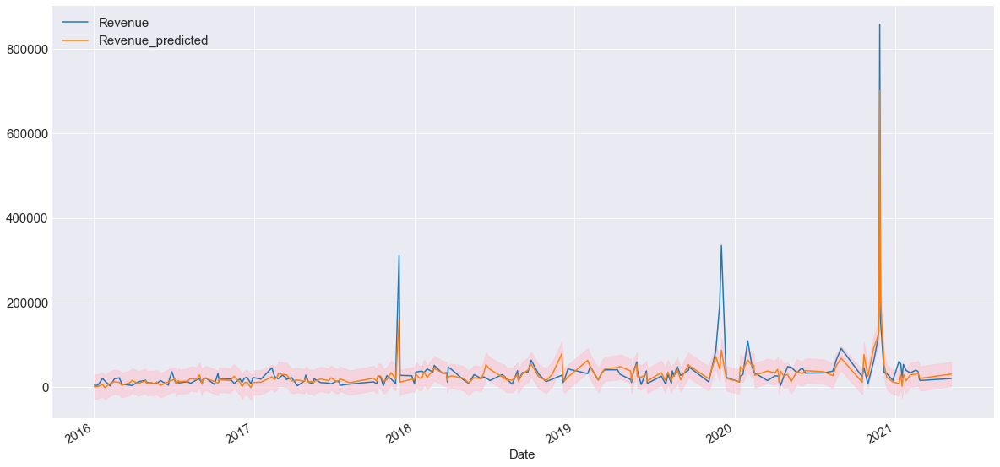

In [34]:
#Let's see the prediction
forecast_ridge_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_ridge, forecast_ridge_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

#### Elastic Net Model

In [35]:
#Elastic Net Model
model_elastic_net = ElasticNet(alpha=0.9, l1_ratio=0.3684210526315789)

In [36]:
#Model
model_elastic_net.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_elastic_net = predict_model(model_elastic_net, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_elastic_net = metric_rmse(forecast_elastic_net, "Revenue")
r2_elastic_net = r2_score(forecast_elastic_net["Revenue"], forecast_elastic_net["Revenue_predicted"])
print(f'Ridge Elastic Net_train: {rmse_elastic_net}')
print(f'R²: {r2_elastic_net}')

Ridge Elastic Net_train: 16820.60225934849
R²: 0.67897523549547


In [37]:
#Test Values
forecast_elastic_net_test = predict_model(model_elastic_net, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_elastic_net_test = metric_rmse(forecast_elastic_net_test, "Revenue")
r2_elastic_net_test = r2_score(forecast_elastic_net_test["Revenue"], forecast_elastic_net_test["Revenue_predicted"])
print(f'Ridge Elastic Net_test: {rmse_elastic_net_test}')
print(f'R²: {r2_elastic_net_test}')

Ridge Elastic Net_test: 35919.17638624443
R²: 0.7422214830568524


#### K-Neighbors Model

In [60]:
#K-Neighbors Model
model_kn = KNeighborsRegressor(algorithm='kd_tree', n_neighbors=10, weights='distance')

In [61]:
#Model
model_kn.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_kn = predict_model(model_kn, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_kn = metric_rmse(forecast_kn, "Revenue")
r2_kn = r2_score(forecast_kn["Revenue"], forecast_kn["Revenue_predicted"])
print(f'K-Neighbors_train: {rmse_kn}')
print(f'R²: {r2_kn}')

K-Neighbors_train: 0.0
R²: 1.0


In [ ]:
#Overfitting?

In [40]:
forecasts_kn = cross_val_time_series(model_kn, data_small, lags, 10, scaler= 'robust')

bias_kn = time_series_score(forecasts_kn, 'Revenue', 'bias')
variance_kn = time_series_score(forecasts_kn, 'Revenue', 'variance')
rmse_kn = time_series_score(forecasts_kn, 'Revenue', 'rmse')

error_kn = pd.DataFrame([rmse_kn, bias_kn, variance_kn], index= ['RMSE', 'Bias', 'Variance']).T

In [41]:
#Total Error
error_kn['Total Error'] = pd.DataFrame(error_kn['Bias'] ** 2 + error_kn['Variance'])

In [42]:
error_kn

,RMSE,Bias,Variance,Total Error
0,54177.365839,2830.074081,0.449455,8.009320e+06
1,22367.437858,1062.563893,0.625972,1.129043e+06
2,28420.439242,1285.969271,0.734848,1.653718e+06
3,46799.217478,2625.693085,0.565958,6.894265e+06
4,14924.865950,429.720041,0.737460,1.846601e+05
5,17145.983295,205.990733,0.807908,4.243299e+04
6,15074.429197,-146.079953,0.765343,2.134012e+04
7,29653.323264,430.489600,0.679080,1.853220e+05
8,21026.803454,1234.403828,0.709976,1.523754e+06
9,33476.364929,164.180788,0.611680,2.695594e+04


<AxesSubplot:>

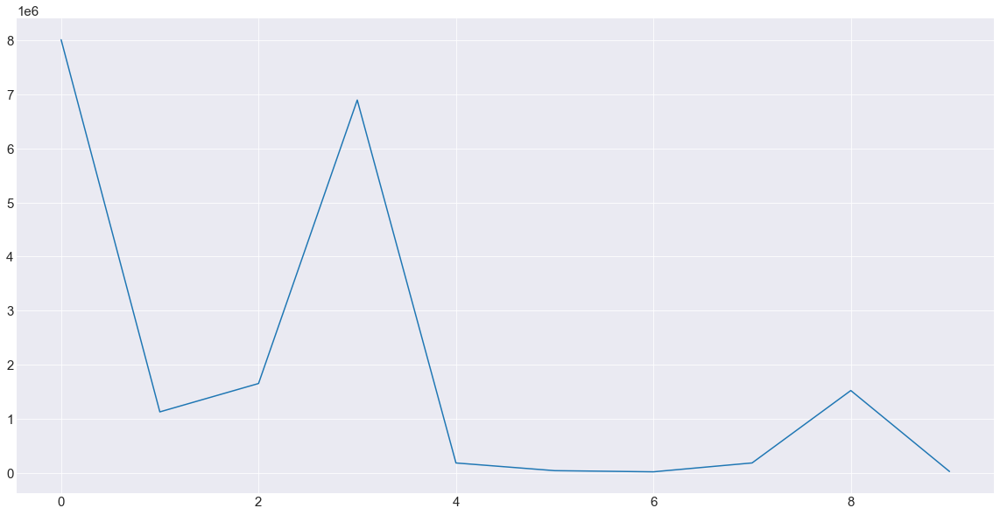

In [63]:
error_kn['Total Error'].plot()

In [82]:
#Model
model_kn.fit(X_train_scaled, y_train)

#Test Values
forecast_kn_test = predict_model(model_kn, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_kn_test = metric_rmse(forecast_kn_test, "Revenue")
r2_kn_test = r2_score(forecast_kn_test["Revenue"], forecast_kn_test["Revenue_predicted"])
print(f'K-Neighbors_test: {rmse_kn_test}')
print(f'R²: {r2_kn_test}')

K-Neighbors_test: 57961.23501768812
R²: 0.3287732708327781


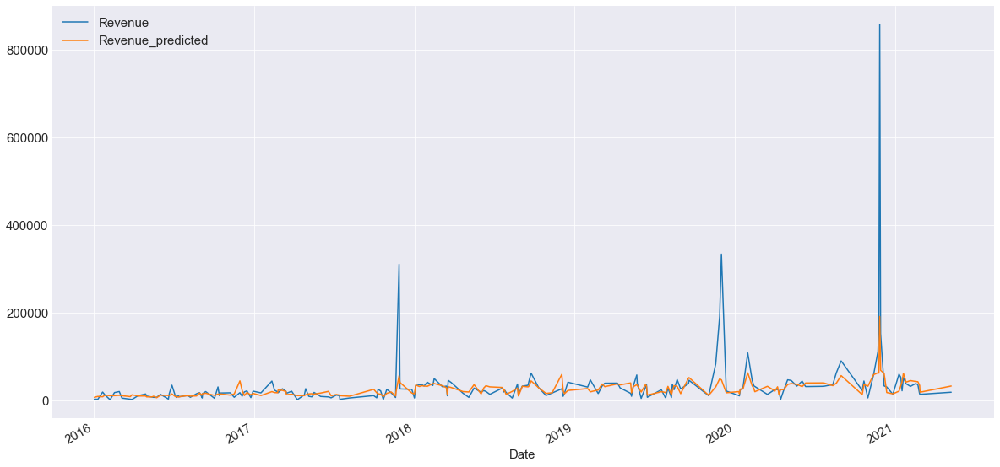

In [64]:
#Let's see the prediction
forecast_kn_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_kn, forecast_kn_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

#### Random Forest Model

In [301]:
#Random Fores Model
model_random = RandomForestRegressor(max_depth=40)

In [302]:
#Model
model_random.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_random = predict_model(model_random, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_random = metric_rmse(forecast_random, "Revenue")
r2_random = r2_score(forecast_random["Revenue"], forecast_random["Revenue_predicted"])
print(f'Random Forest_train: {rmse_random}')
print(f'R²: {r2_random}')

Random Forest_train: 10292.028878448988
R²: 0.9571382650185124


In [307]:
#Test Values
forecast_random_test = predict_model(model_random, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_random_test = metric_rmse(forecast_random_test, "Revenue")
r2_random_test = r2_score(forecast_random_test["Revenue"], forecast_random_test["Revenue_predicted"])
print(f'Random Forest_test: {rmse_random_test}')
print(f'R²: {r2_random_test}')

Random Forest_test: 24230.48015047871
R²: 0.09059919988384357


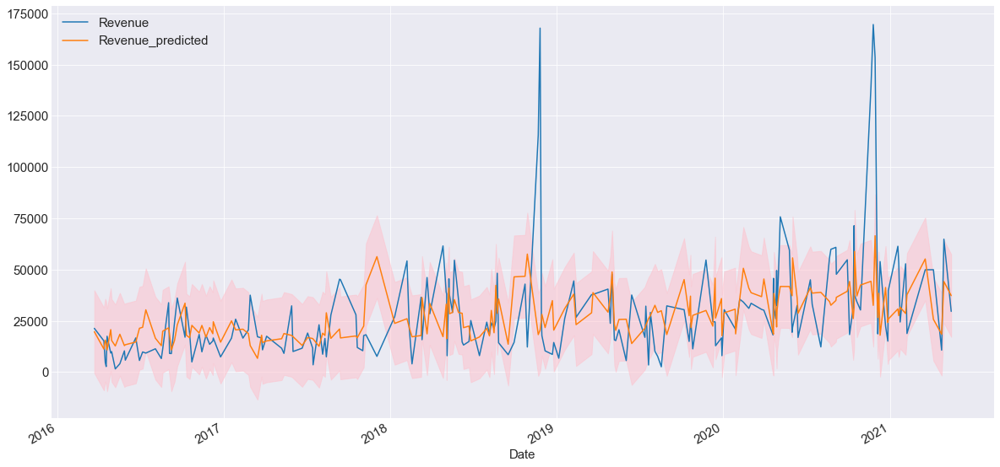

In [308]:
#Let's see the prediction
forecast_random_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_random, forecast_random_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

#### Gradient Boost

In [69]:
#Gradient Boost
model_boost = GradientBoostingRegressor(max_features='auto')

In [70]:
#Model
model_boost.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_boost = predict_model(model_boost, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_boost = metric_rmse(forecast_boost, "Revenue")
r2_boost = r2_score(forecast_boost["Revenue"], forecast_boost["Revenue_predicted"])
print(f'Gradient Boost_train: {rmse_boost}')
print(f'R²: {r2_boost}')

Gradient Boost_train: 8435.812013737082
R²: 0.9192561898113867


In [71]:
#Test Values
forecast_boost_test = predict_model(model_boost, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_boost_test = metric_rmse(forecast_boost_test, "Revenue")
r2_boost_test = r2_score(forecast_boost_test["Revenue"], forecast_boost_test["Revenue_predicted"])
print(f'Gradient Boost_test: {rmse_boost_test}')
print(f'R²: {r2_boost_test}')

Gradient Boost_test: 33586.51959809855
R²: 0.7746155310784273


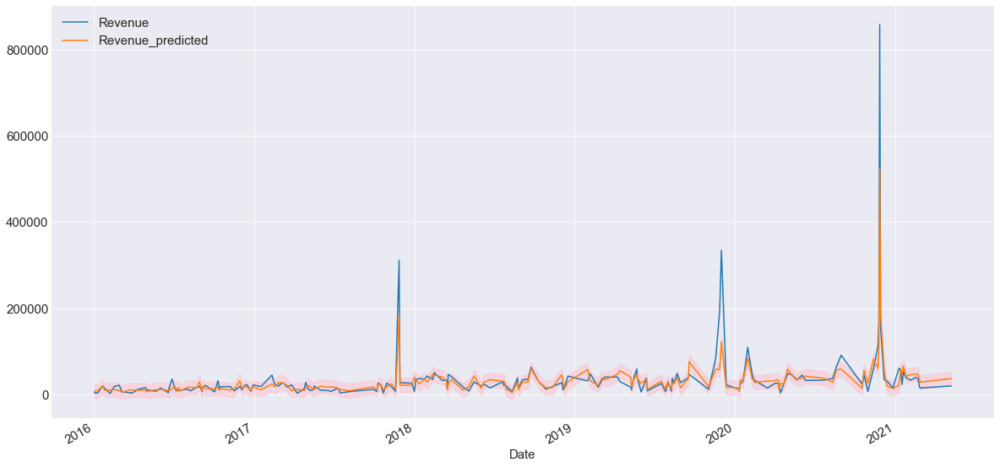

In [72]:
#Let's see the prediction
forecast_boost_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_boost, forecast_boost_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

#### XGB

In [73]:
#XGB
model_xgb = XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=13,
              min_child_weight=1, missing=np.nan, monotone_constraints='()',
              n_estimators=1000, n_jobs=4, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [80]:
#Model
model_xgb.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_xgb = predict_model(model_xgb, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_xgb = metric_rmse(forecast_xgb, "Revenue")
r2_xgb = r2_score(forecast_xgb["Revenue"], forecast_xgb["Revenue_predicted"])
print(f'XGB_train: {rmse_xgb}')
print(f'R²: {r2_xgb}')

XGB_train: 0.0038001915801838134
R²: 0.9999999999999836


In [ ]:
#Overfitting?

In [75]:
forecasts_xgb = cross_val_time_series(model_xgb, data_small, lags, 10, scaler= 'robust')

bias_xgb = time_series_score(forecasts_xgb, 'Revenue', 'bias')
variance_xgb = time_series_score(forecasts_xgb, 'Revenue', 'variance')
rmse_xgb = time_series_score(forecasts_xgb, 'Revenue', 'rmse')

error_xgb = pd.DataFrame([rmse_xgb, bias_xgb, variance_xgb], index= ['RMSE', 'Bias', 'Variance']).T

In [76]:
#Total Error
error_xgb['Total Error'] = pd.DataFrame(error_xgb['Bias'] ** 2 + error_xgb['Variance'])

In [77]:
error_xgb

,RMSE,Bias,Variance,Total Error
0,23757.879136,-2518.133685,0.744409,6.340998e+06
1,31411.396417,2146.013128,0.723188,4.605373e+06
2,21914.148002,-1435.760084,0.843634,2.061408e+06
3,53838.237165,4706.125384,0.659104,2.214762e+07
4,12093.203728,-7.116294,0.835837,5.147748e+01
5,15271.112785,1110.458804,0.768639,1.233120e+06
6,15401.898494,1767.715458,0.665280,3.124819e+06
7,45815.272325,-661.183241,0.656919,4.371639e+05
8,41485.339856,-4620.446098,0.441299,2.134852e+07
9,32964.076389,2680.086905,0.700906,7.182867e+06


<AxesSubplot:>

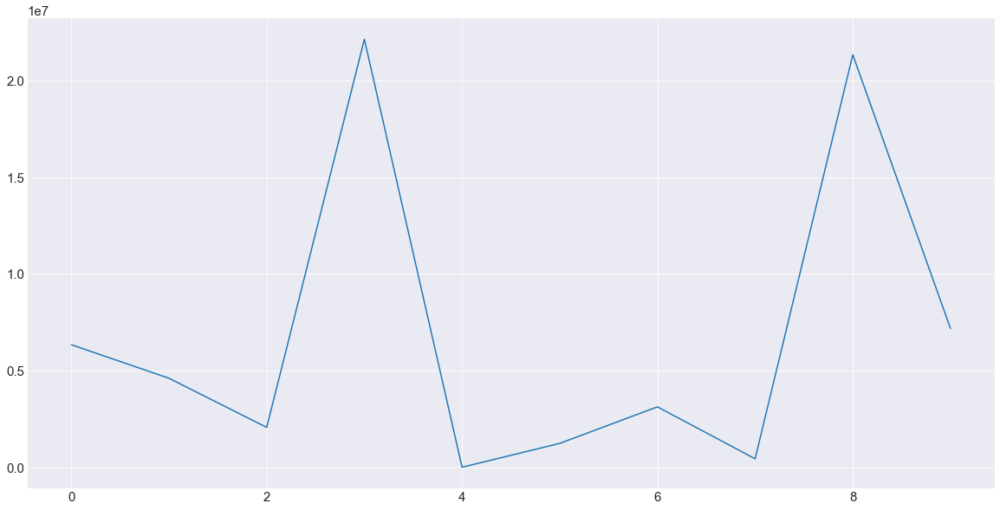

In [78]:
error_xgb['Total Error'].plot()

In [83]:
#Model
model_xgb.fit(X_train_scaled, y_train)

#Test Values
forecast_xgb_test = predict_model(model_xgb, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_xgb_test = metric_rmse(forecast_xgb_test, "Revenue")
r2_xgb_test = r2_score(forecast_xgb_test["Revenue"], forecast_xgb_test["Revenue_predicted"])
print(f'XGB_test: {rmse_xgb_test}')
print(f'R²: {r2_xgb_test}')

XGB_test: 34761.65358455191
R²: 0.7585679980206843


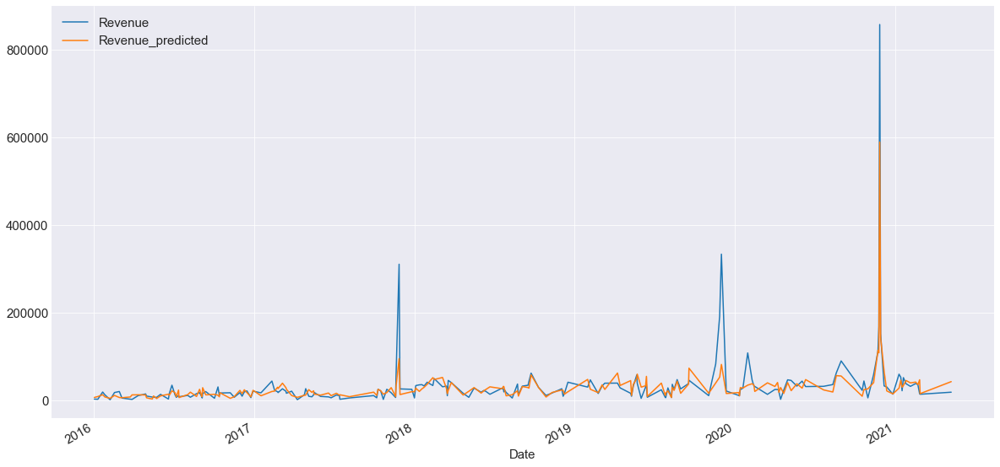

In [84]:
#Let's see the prediction
forecast_xgb_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_xgb, forecast_xgb_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

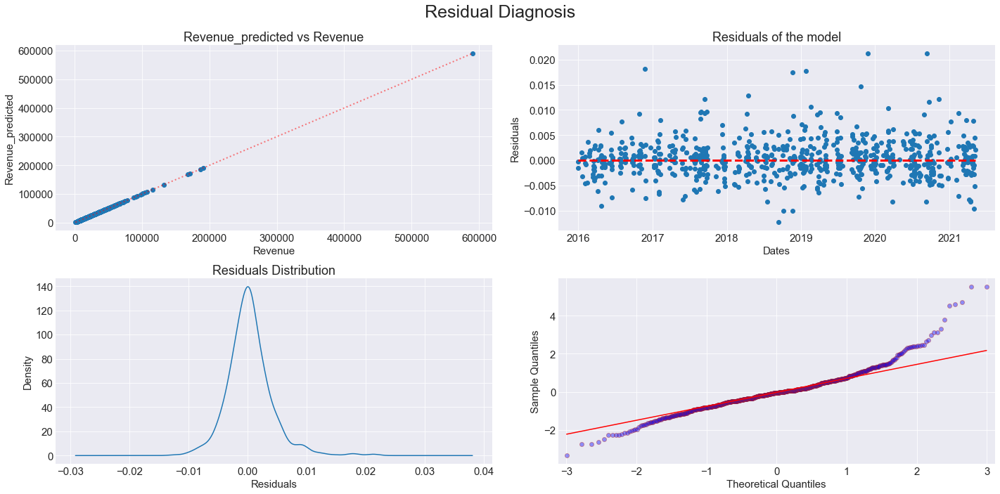

In [85]:
#Residual Analysis
draw_residuals_diagnosis(forecast_xgb, ['Revenue', 'Revenue_predicted', 'Residuals'])

#### LGBM

In [86]:
#LGBM
model_lgbm = LGBMRegressor(n_estimators=50)

In [87]:
#Model
model_lgbm.fit(X_train_scaled, y_train)

#Create the new DataFrame with the Train y values and Train predict values
forecast_lgbm = predict_model(model_lgbm, X_train_scaled, y_train)

#Calculate the RMSE and R²
rmse_lgbm = metric_rmse(forecast_lgbm, "Revenue")
r2_lgbm = r2_score(forecast_lgbm["Revenue"], forecast_lgbm["Revenue_predicted"])
print(f'LGBM_train: {rmse_lgbm}')
print(f'R²: {r2_lgbm}')

LGBM_train: 18327.00947729469
R²: 0.6189002518755717


In [88]:
#Test Values
forecast_lgbm_test = predict_model(model_lgbm, X_test_scaled, y_test)

#Calculate the RMSE and R²
rmse_lgbm_test = metric_rmse(forecast_lgbm_test, "Revenue")
r2_lgbm_test = r2_score(forecast_lgbm_test["Revenue"], forecast_lgbm_test["Revenue_predicted"])
print(f'LGBM_test: {rmse_lgbm_test}')
print(f'R²: {r2_lgbm_test}')

LGBM_test: 57043.87212273375
R²: 0.3498523812073646


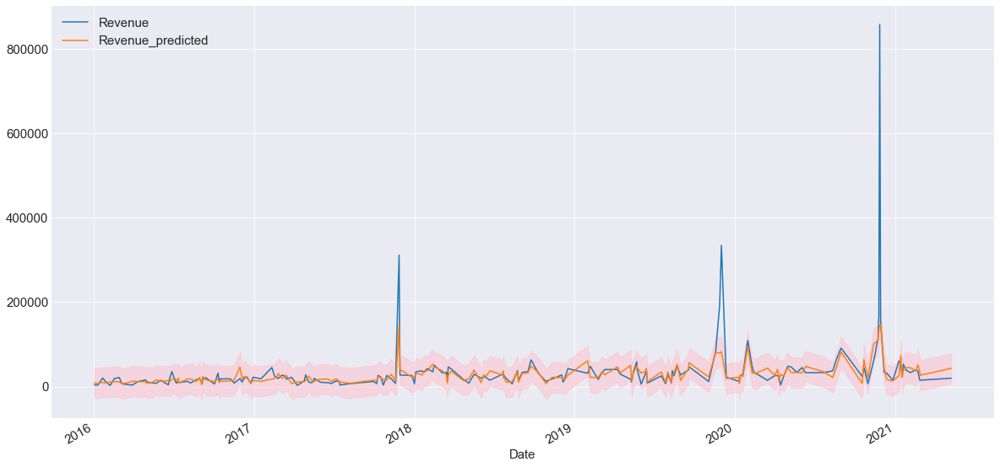

In [89]:
#Let's see the prediction
forecast_lgbm_test[['Revenue', 'Revenue_predicted']].plot()
#Get the confidence intervals
confidence_intervals = get_confidence_intervals(forecast_lgbm, forecast_lgbm_test, 'Revenue', '95%')
plt.fill_between(confidence_intervals.index, confidence_intervals['Revenue_lower'], 
                 confidence_intervals['Revenue_upper'], color= 'pink', alpha= 0.5)

### Models Comparison 

In [90]:
rmse_lgbm
rmse_xgb
rmse_random
rmse_boost
rmse_kn
rmse_elastic_net
rmse_ridge

14720.596503067534

In [194]:
rmse_models = {
    'Ridge': [rmse_ridge, rmse_ridge_test, r2_ridge],
    'Elastic Net': [rmse_elastic_net, rmse_elastic_net_test, r2_elastic_net],
    'K-Neighbors': [rmse_kn, rmse_kn_test, r2_kn],
    'Random Forest': [rmse_random, rmse_random_test, r2_random],
    'Gradient Boost': [rmse_boost, rmse_boost_test, r2_boost],
    'XGB': [rmse_xgb, rmse_xgb_test, r2_xgb],
    'LGBM': [rmse_lgbm, rmse_lgbm_test, r2_lgbm]
}

In [195]:
model_comparison = pd.DataFrame(rmse_models, index= ['RMSE', 'RMSE_Test', 'R2']).T

In [196]:
model_comparison

,RMSE,RMSE_Test,R2
Ridge,14720.596503,29436.516417,0.754130
Elastic Net,16820.602259,35919.176386,0.678975
K-Neighbors,0.000000,57961.235018,1.000000
Random Forest,8009.366720,39669.676748,0.927213
Gradient Boost,8435.812014,33586.519598,0.919256
XGB,0.003800,34761.653585,1.000000
LGBM,18327.009477,57043.872123,0.618900


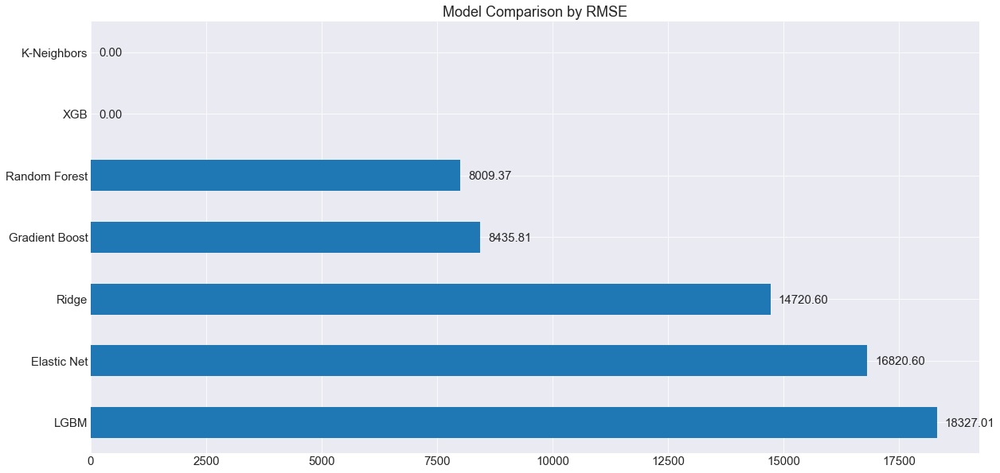

In [245]:
draw_barh(model_comparison, 'RMSE')

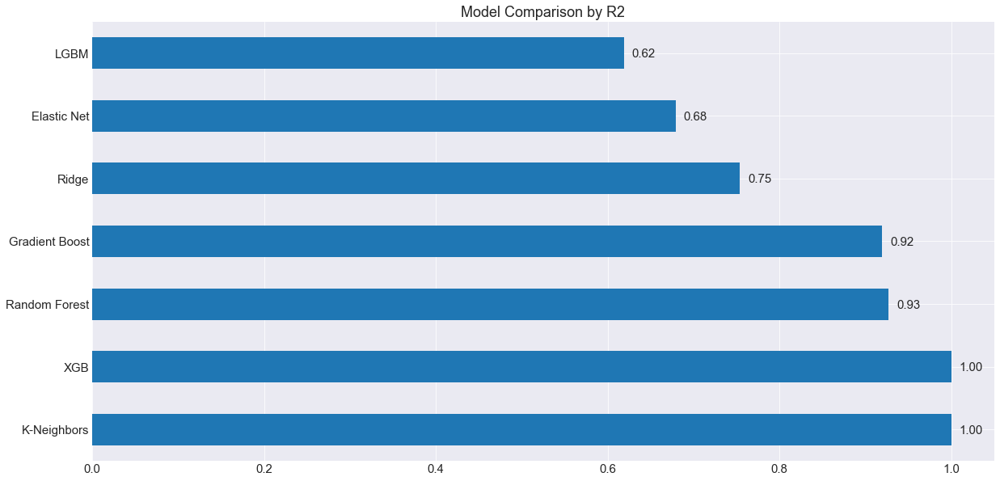

In [247]:
draw_barh(model_comparison, 'R2')

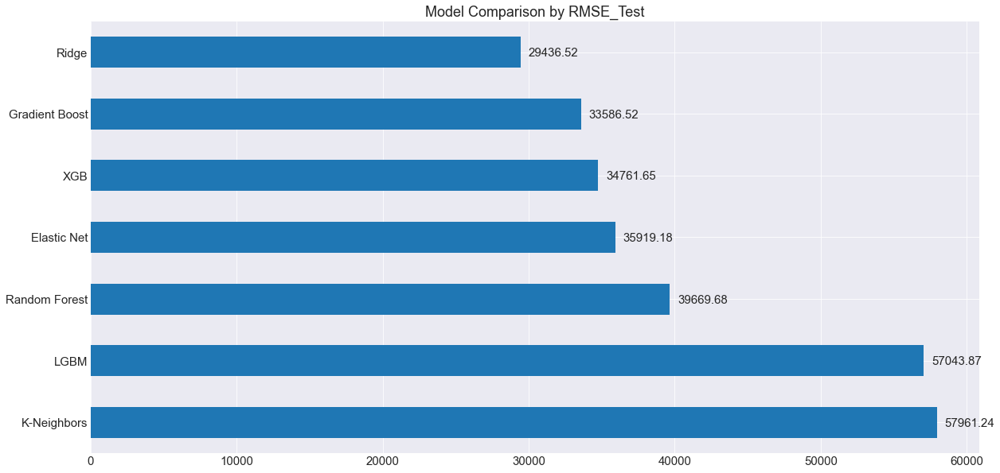

In [246]:
draw_barh(model_comparison, 'RMSE_Test')

In [ ]:
#Finally, let's predict T+1 using using the full set
#NO HAY QUE REVISAR TODOS LOS MODELOS

### Data Validation and Data Forecasting
We are going to concatenate the current Time Series Data with a longer file with more reals values and use this bigger model for checking how good or bad is woking the model

Moreover, we are going to create the last Data Set for Forecasting purposes. The idea is forecasting up to 7 days in advance.
We are going to add to the Data Validation Data Set a new one with the lagged, seasonal and exogenous features in order to try to estimate what will be the sales.

Some important assumptions. We need to trained 14 models for each forecast:
* model_trained_1: This will forecast T+1
* model_trained_2: This will forecast T+2
* And so on...

In [220]:
data_full = pd.concat([data_small, data_validation])

#All lagged features for forecasting - Period 7 days
lags = [1, 2, 3, 4, 5, 6, 7, 364]
data_full_forecast = prepare_data_forecast(data_full, 'Revenue', lags, 7)
data_full_forecast

,Year_2021,Month_6,Day_14,Day_15,Day_16,Day_17,Day_18,Day_19,Day_20,Black_Friday,Easter,Covid,Rev-364,Rev-7,Rev-6,Rev-5,Rev-4,Rev-3,Rev-2,Rev-1
2021-06-14,1,1,1,0,0,0,0,0,0,0,0,0,48735.52,44815.98,46716.35,47649.11,66938.46,53022.54,25079.69,27413.63
2021-06-15,1,1,0,1,0,0,0,0,0,0,0,0,33745.33,21760.66,44815.98,46716.35,47649.11,66938.46,53022.54,25079.69
2021-06-16,1,1,0,0,1,0,0,0,0,0,0,0,16913.21,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46,53022.54
2021-06-17,1,1,0,0,0,1,0,0,0,0,0,0,29435.16,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46
2021-06-18,1,1,0,0,0,0,1,0,0,0,0,0,32517.81,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11
2021-06-19,1,1,0,0,0,0,0,1,0,0,0,0,41321.59,44696.72,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35
2021-06-20,1,1,0,0,0,0,0,0,1,0,0,0,45465.30,55890.10,44696.72,38282.13,47467.41,74427.57,21760.66,44815.98


In [28]:
forecast_gradient = forecast_predict(data_full, 'Revenue', lags, 30, 'gradient', 'robust', '95%')
forecast_gradient

,Revenue_forecast,Revenue_lower,Revenue_upper
2021-06-14,38768.629115,20086.629513,57450.628717
2021-06-15,44662.305198,27527.460937,61797.149459
2021-06-16,34962.987523,15358.086463,54567.888583
2021-06-17,45773.163165,26287.350344,65258.975985
2021-06-18,30144.690852,10964.259296,49325.122409
2021-06-19,39611.395077,16642.682588,62580.107565
2021-06-20,37006.857117,15796.531339,58217.182896
2021-06-21,38446.030788,19816.043548,57076.018028
2021-06-22,46849.909300,27471.165002,66228.653599
2021-06-23,42086.676994,23115.403401,61057.950588


In [29]:
data_full_forecast_gradient = data_full[['Revenue']]
data_full_forecast_gradient = pd.concat([data_full_forecast_gradient, forecast_gradient])

In [30]:
data_full_forecast_gradient['Revenue_forecast'].loc[data_full.index[-1]] = \
data_full_forecast_gradient.loc[data_full.index[-1]]['Revenue']

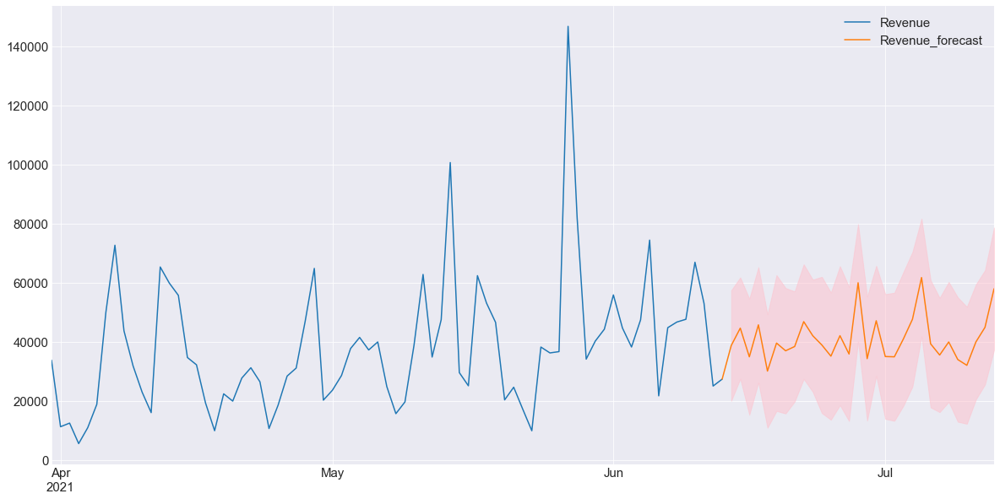

In [31]:
data_full_forecast_gradient.loc['2021-03-31':][['Revenue', 'Revenue_forecast']].plot()
plt.fill_between(data_full_forecast_gradient.index, data_full_forecast_gradient['Revenue_lower'],
                 data_full_forecast_gradient['Revenue_upper'], color='pink', alpha=0.5)

In [32]:
forecast_xgb = forecast_predict(data_full, 'Revenue', lags, 30, 'xgb', 'robust', '95%')
forecast_xgb

,Revenue_forecast,Revenue_lower,Revenue_upper
2021-06-14,53103.421875,53103.414062,53103.429688
2021-06-15,47325.089844,47325.082031,47325.097656
2021-06-16,33630.308594,33630.292969,33630.324219
2021-06-17,49961.859375,49961.847656,49961.871094
2021-06-18,37871.230469,37871.218750,37871.242188
2021-06-19,43827.214844,43827.207031,43827.222656
2021-06-20,44172.328125,44172.316406,44172.339844
2021-06-21,38280.394531,38280.386719,38280.402344
2021-06-22,43276.378906,43276.363281,43276.394531
2021-06-23,38548.808594,38548.800781,38548.816406


In [33]:
data_full_forecast_xgb = data_full[['Revenue']]
data_full_forecast_xgb = pd.concat([data_full_forecast_xgb, forecast_xgb])

In [34]:
data_full_forecast_xgb['Revenue_forecast'].loc[data_full.index[-1]] = \
data_full_forecast_xgb.loc[data_full.index[-1]]['Revenue']

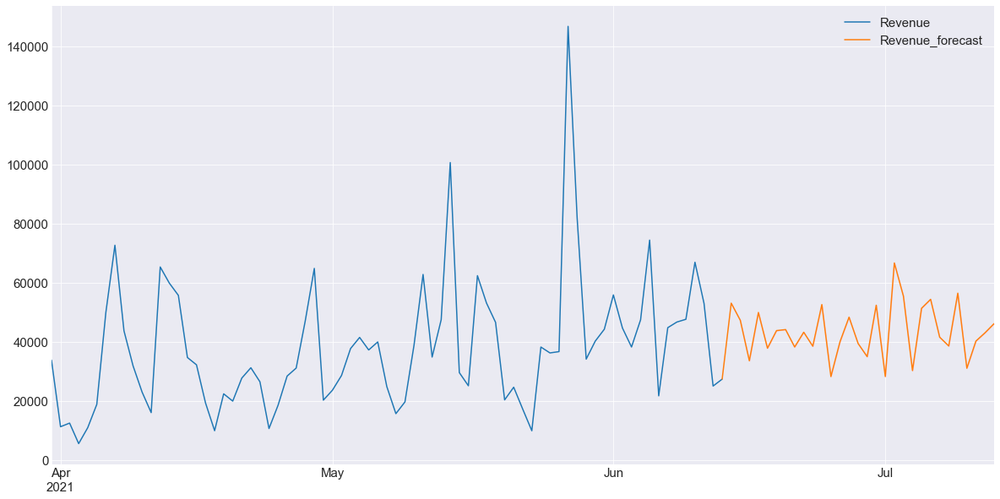

In [35]:
data_full_forecast_xgb.loc['2021-03-31':][['Revenue', 'Revenue_forecast']].plot()
plt.fill_between(data_full_forecast_xgb.index, data_full_forecast_xgb['Revenue_lower'],
                 data_full_forecast_xgb['Revenue_upper'], color='pink', alpha=0.5)

## Alternative Models 

### Prophet 

In [160]:
#Prophet requires a specific data format
data_prophet = pd.DataFrame()
#Prepare the data
data_temp = data.groupby(['Date'])[['Revenue']].sum()
data_temp = data_temp.resample('D', offset='00h00min00sec').sum()
data_temp.reset_index(inplace= True)
#Prophet requiered format
data_prophet['ds'] = data_temp['Date']
data_prophet['y'] = data_temp['Revenue']
data_prophet

,ds,y
0,2015-01-01,3244.55
1,2015-01-02,4791.64
2,2015-01-03,534.93
3,2015-01-04,848.43
4,2015-01-05,2393.52
...,...,...
2316,2021-05-05,37283.53
2317,2021-05-06,39991.11
2318,2021-05-07,24901.84
2319,2021-05-08,15744.14


In [161]:
#Model training
model = Prophet(seasonality_mode='multiplicative', interval_width= 0.95)
model_prophet = model.fit(data_prophet)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [163]:
#Forecast 30 days in advance
future_prophet = model_prophet.make_future_dataframe(freq= 'D', periods= 30)
#Get forecast
forecast_prophet = model_prophet.predict(future_prophet)

In [164]:
#Let's make a copy
forecast_prophet_model = forecast_prophet.copy()
#We are going to check how the model predict with the trained data
forecast_prophet['y'] = data_prophet['y']
forecast_prophet['residuals'] = forecast_prophet['y'] - forecast_prophet['yhat']
forecast_prophet.dropna(inplace= True)

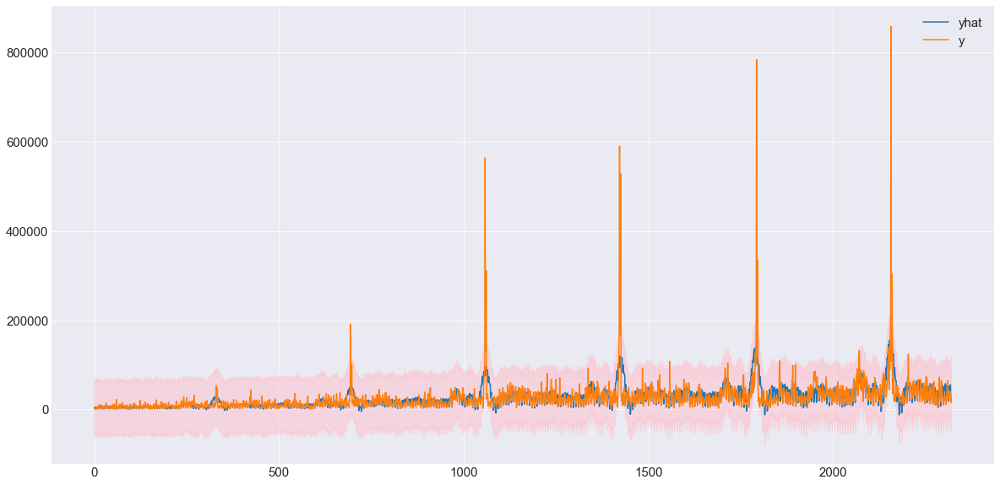

In [165]:
#Show the results and confidence intervals
forecast_prophet[['yhat', 'y']].plot()
plt.fill_between(forecast_prophet.index, forecast_prophet['yhat_lower'],
                 forecast_prophet['yhat_upper'], color='pink', alpha=0.5)

<AxesSubplot:>

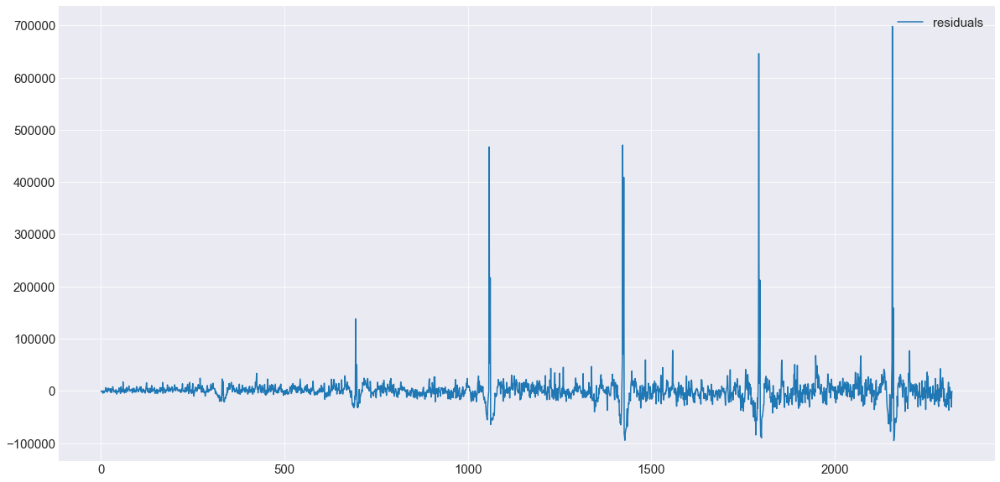

In [166]:
#Check residuals
forecast_prophet[['residuals']].plot()

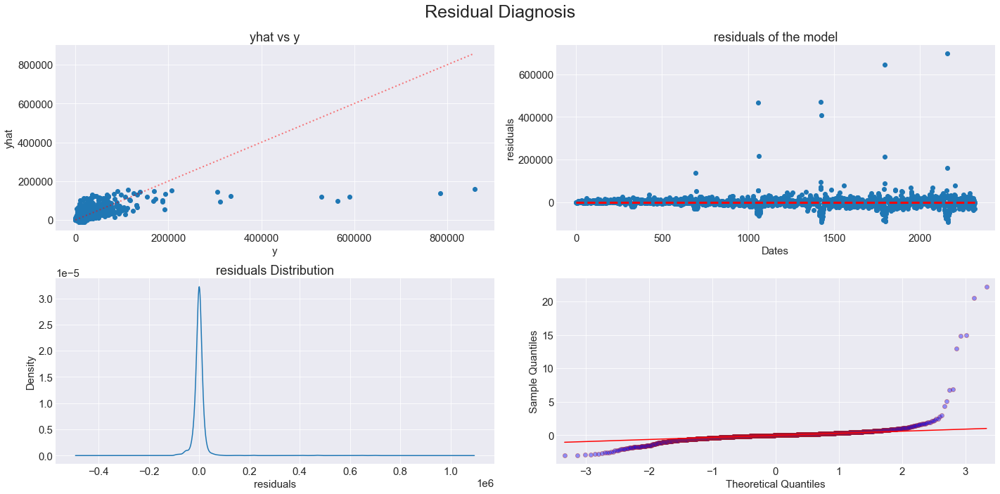

In [167]:
draw_residuals_diagnosis(forecast_prophet, ['y', 'yhat', 'residuals'])

In [168]:
#Check the RMSE
np.sqrt(mean_squared_error(forecast_prophet['y'], forecast_prophet['yhat']))

31429.799938130498

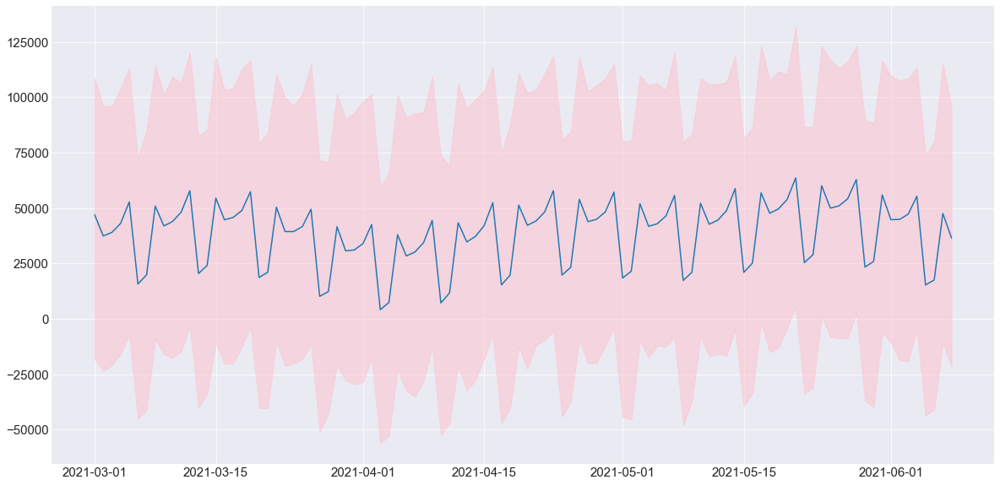

In [192]:
#Forecast
plt.plot(forecast_prophet_model.iloc[-100:]['ds'], forecast_prophet_model.iloc[-100:]['yhat'])
plt.fill_between(forecast_prophet_model.iloc[-100:]['ds'], forecast_prophet_model.iloc[-100:]['yhat_lower'],
                 forecast_prophet_model.iloc[-100:]['yhat_upper'], color='pink', alpha=0.5)

#### Adding Holidays or Seasonality features 

In [193]:
#Holidays
bf_date_list = ['2015-11-27', '2016-11-25', '2017-11-24', '2018-11-23', '2019-11-29', '2020-11-27']
easter_date_list = ['2015-03-30', '2016-03-21', '2017-04-10', '2018-03-26', '2019-04-15', '2020-04-06', '2021-03-29']
covid_date_list = ['2020-03-14']

bf_week_dates = create_date_range(bf_date_list, 'D', 4)
easter_week_dates = create_date_range(easter_date_list, 'D', 8)
covid_week_dates = create_date_range(covid_date_list, 'D', 100)

black_friday = pd.DataFrame({
  'holiday': 'black_friday',
  'ds': [j for i in bf_week_dates for j in i]
})


easter = pd.DataFrame({
  'holiday': 'easter',
  'ds': [j for i in easter_week_dates for j in i]
})

covid = pd.DataFrame({
  'holiday': 'covid',
  'ds': [j for i in covid_week_dates for j in i]
})

holidays = pd.concat((black_friday, easter, covid))
holidays

,holiday,ds
0,black_friday,2015-11-27
1,black_friday,2015-11-28
2,black_friday,2015-11-29
3,black_friday,2015-11-30
4,black_friday,2016-11-25
...,...,...
95,covid,2020-06-17
96,covid,2020-06-18
97,covid,2020-06-19
98,covid,2020-06-20


In [194]:
model = Prophet(seasonality_mode='multiplicative', holidays= holidays, interval_width= 0.95, mcmc_samples= 50)
model_prophet = model.fit(data_prophet)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
To run all diagnostics call pystan.check_hmc_diagnostics(fit)


In [195]:
#Forecast 30 days in advance
future_prophet = model_prophet.make_future_dataframe(freq= 'D', periods= 30)
#Get forecast
forecast_prophet = model_prophet.predict(future_prophet)

In [196]:
#Let's make a copy
forecast_prophet_model = forecast_prophet.copy()
#We are going to check how the model predict with the trained data
forecast_prophet['y'] = data_prophet['y']
forecast_prophet['residuals'] = forecast_prophet['y'] - forecast_prophet['yhat']
forecast_prophet.dropna(inplace= True)

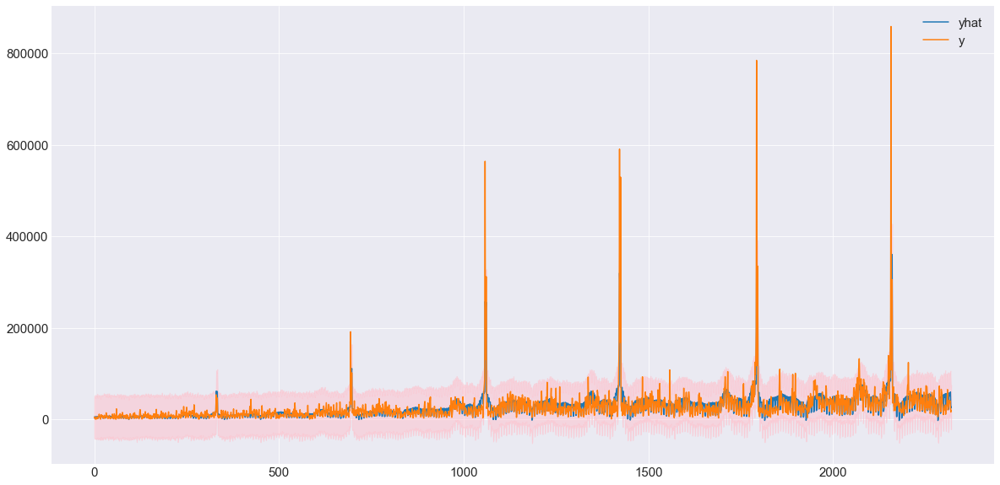

In [197]:
#Show the results and confidence intervals
forecast_prophet[['yhat', 'y']].plot()
plt.fill_between(forecast_prophet.index, forecast_prophet['yhat_lower'],
                 forecast_prophet['yhat_upper'], color='pink', alpha=0.5)

<AxesSubplot:>

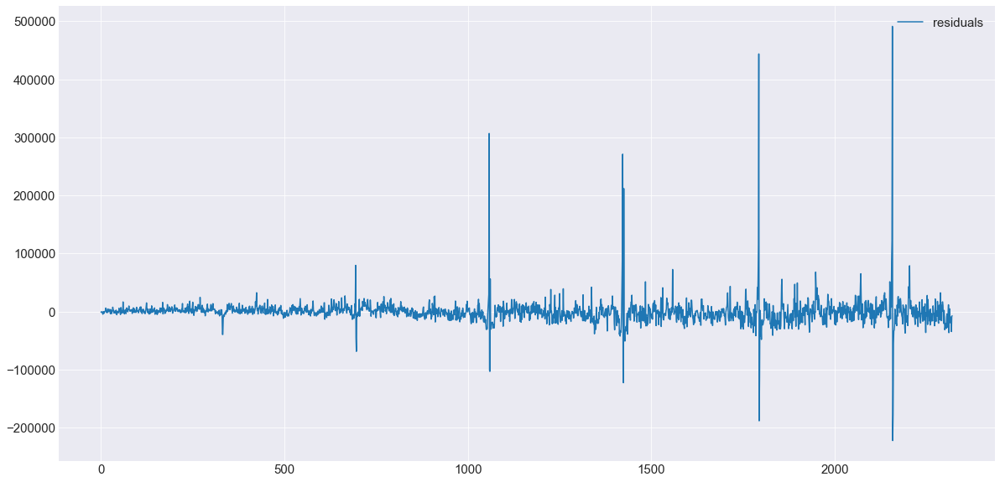

In [198]:
#Check residuals
forecast_prophet[['residuals']].plot()

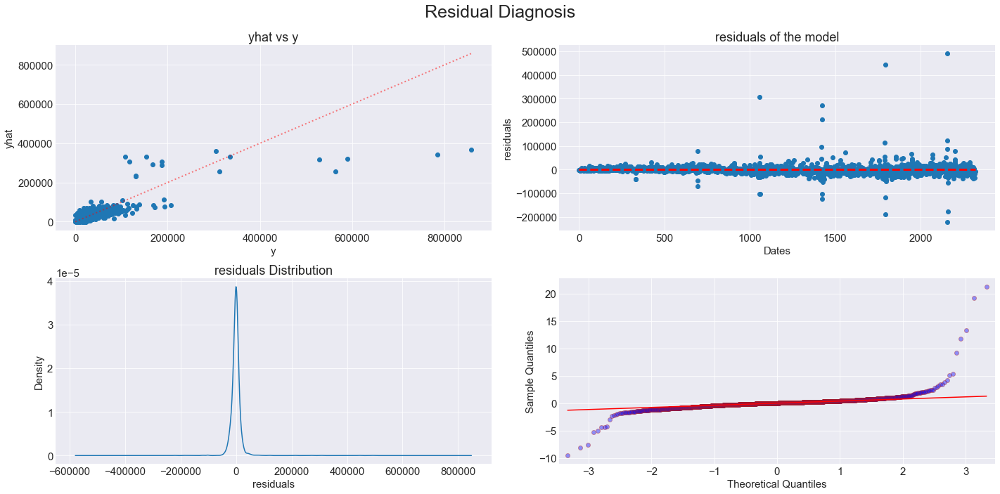

In [199]:
draw_residuals_diagnosis(forecast_prophet, ['y', 'yhat', 'residuals'])

In [200]:
#Check the RMSE
np.sqrt(mean_squared_error(forecast_prophet['y'], forecast_prophet['yhat']))

23171.855380031786

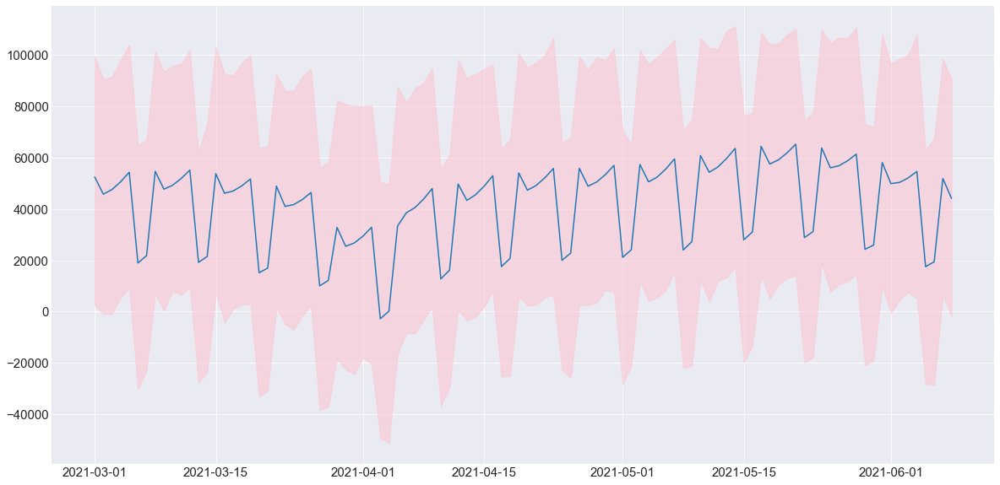

In [201]:
#Forecast
plt.plot(forecast_prophet_model.iloc[-100:]['ds'], forecast_prophet_model.iloc[-100:]['yhat'])
plt.fill_between(forecast_prophet_model.iloc[-100:]['ds'], forecast_prophet_model.iloc[-100:]['yhat_lower'],
                 forecast_prophet_model.iloc[-100:]['yhat_upper'], color='pink', alpha=0.5)

### Deep Learning

In [135]:
data_full = pd.concat([data_small, data_validation])

#All lagged features for forecasting - Period 7 days
lags = [1, 2, 3, 4, 5, 6, 7, 364]
data_full_model = prepare_data(data_full, 'Revenue', lags)
data_full_model

,Year_2015,Year_2016,Year_2017,Year_2018,Year_2019,Year_2020,Year_2021,Month_1,Month_10,Month_11,Month_12,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Day_1,Day_10,Day_11,Day_12,Day_13,Day_14,Day_15,Day_16,Day_17,Day_18,Day_19,Day_2,Day_20,Day_21,Day_22,Day_23,Day_24,Day_25,Day_26,Day_27,Day_28,Day_29,Day_3,Day_30,Day_31,Day_4,Day_5,Day_6,Day_7,Day_8,Day_9,Black_Friday,Easter,Covid,Rev-364,Rev-7,Rev-6,Rev-5,Rev-4,Rev-3,Rev-2,Rev-1,Revenue
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-12-31,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,3244.55,9436.11,3158.21,1825.62,8008.34,16351.42,6407.68,9870.95,7688.27
2016-01-01,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4791.64,3158.21,1825.62,8008.34,16351.42,6407.68,9870.95,7688.27,6785.55
2016-01-02,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,534.93,1825.62,8008.34,16351.42,6407.68,9870.95,7688.27,6785.55,4017.26
2016-01-03,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,848.43,8008.34,16351.42,6407.68,9870.95,7688.27,6785.55,4017.26,2398.62
2016-01-04,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,2393.52,16351.42,6407.68,9870.95,7688.27,6785.55,4017.26,2398.62,9147.71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-06-09,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,41321.59,44696.72,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11
2021-06-10,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,32517.81,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46
2021-06-11,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,29435.16,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46,53022.54


In [140]:
#Train and Test Split
X_train, X_test, y_train, y_test = time_series_train_test_split(data_model, lags)

In [141]:
#Scale the features
X_train_scaled, X_test_scaled = data_normalization(X_train, X_test, 'robust')

In [150]:
#RNN
rnn = models.Sequential()
#Three layers - Let's pick shape= 61 x 2, then 61 x1 and 30 and 7 nodes
rnn.add(layers.Dense(122, input_shape=(X_train_scaled.shape[1],), activation='relu')) 
rnn.add(layers.Dense(61, activation='relu'))
rnn.add(layers.Dense(30, activation='relu'))
rnn.add(layers.Dense(7, activation='relu'))
rnn.add(layers.Dense(1))
#Compile the RNN
rnn.compile(optimizer= optimizers.RMSprop(), loss= losses.mean_squared_error, metrics= [metrics.mean_squared_error]) 

In [153]:
#Train the RNN
rnn.fit(X_train_scaled, y_train, epochs= 1000)

Epoch 1/1000
25/25 [==============================] - 0s 2ms/step - loss: 44414480.0000 - mean_squared_error: 44414480.0000
Epoch 2/1000
25/25 [==============================] - 0s 1ms/step - loss: 44258856.0000 - mean_squared_error: 44258856.0000
Epoch 3/1000
25/25 [==============================] - 0s 1ms/step - loss: 44214120.0000 - mean_squared_error: 44214120.0000
Epoch 4/1000
25/25 [==============================] - 0s 2ms/step - loss: 43418832.0000 - mean_squared_error: 43418832.0000
Epoch 5/1000
25/25 [==============================] - 0s 2ms/step - loss: 42859728.0000 - mean_squared_error: 42859728.0000
Epoch 6/1000
25/25 [==============================] - 0s 1ms/step - loss: 43940980.0000 - mean_squared_error: 43940980.0000
Epoch 7/1000
25/25 [==============================] - 0s 1ms/step - loss: 42772560.0000 - mean_squared_error: 42772560.0000
Epoch 8/1000
25/25 [==============================] - 0s 1ms/step - loss: 42377588.0000 - mean_squared_error: 42377588.0000
Epoch 9/

25/25 [==============================] - 0s 2ms/step - loss: 15692654.0000 - mean_squared_error: 15692654.0000
Epoch 132/1000
25/25 [==============================] - 0s 1ms/step - loss: 15430255.0000 - mean_squared_error: 15430255.0000
Epoch 133/1000
25/25 [==============================] - 0s 1ms/step - loss: 15910148.0000 - mean_squared_error: 15910148.0000
Epoch 134/1000
25/25 [==============================] - 0s 1ms/step - loss: 16201041.0000 - mean_squared_error: 16201041.0000
Epoch 135/1000
25/25 [==============================] - 0s 1ms/step - loss: 15301004.0000 - mean_squared_error: 15301004.0000
Epoch 136/1000
25/25 [==============================] - 0s 1ms/step - loss: 16571868.0000 - mean_squared_error: 16571868.0000
Epoch 137/1000
25/25 [==============================] - 0s 1ms/step - loss: 14206330.0000 - mean_squared_error: 14206330.0000
Epoch 138/1000
25/25 [==============================] - 0s 1ms/step - loss: 14577393.0000 - mean_squared_error: 14577393.0000
Epoch 1

25/25 [==============================] - 0s 1ms/step - loss: 4836932.0000 - mean_squared_error: 4836932.0000
Epoch 263/1000
25/25 [==============================] - 0s 2ms/step - loss: 4760817.5000 - mean_squared_error: 4760817.5000
Epoch 264/1000
25/25 [==============================] - 0s 2ms/step - loss: 4157140.5000 - mean_squared_error: 4157140.5000
Epoch 265/1000
25/25 [==============================] - 0s 2ms/step - loss: 7847361.5000 - mean_squared_error: 7847361.5000
Epoch 266/1000
25/25 [==============================] - 0s 953us/step - loss: 5084292.0000 - mean_squared_error: 5084292.0000
Epoch 267/1000
25/25 [==============================] - 0s 1ms/step - loss: 4109254.7500 - mean_squared_error: 4109254.7500
Epoch 268/1000
25/25 [==============================] - 0s 1ms/step - loss: 6019469.0000 - mean_squared_error: 6019469.0000
Epoch 269/1000
25/25 [==============================] - 0s 2ms/step - loss: 3858055.7500 - mean_squared_error: 3858055.7500
Epoch 270/1000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 2080205.2500 - mean_squared_error: 2080205.2500
Epoch 394/1000
25/25 [==============================] - 0s 1ms/step - loss: 5472240.0000 - mean_squared_error: 5472240.0000
Epoch 395/1000
25/25 [==============================] - 0s 2ms/step - loss: 1838806.8750 - mean_squared_error: 1838806.8750
Epoch 396/1000
25/25 [==============================] - 0s 2ms/step - loss: 5078772.0000 - mean_squared_error: 5078772.0000
Epoch 397/1000
25/25 [==============================] - 0s 1ms/step - loss: 1337780.1250 - mean_squared_error: 1337780.1250
Epoch 398/1000
25/25 [==============================] - 0s 1ms/step - loss: 1478510.1250 - mean_squared_error: 1478510.1250
Epoch 399/1000
25/25 [==============================] - 0s 1ms/step - loss: 4284141.0000 - mean_squared_error: 4284141.0000
Epoch 400/1000
25/25 [==============================] - 0s 1ms/step - loss: 1766280.0000 - mean_squared_error: 1766280.0000
Epoch 401/1000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 2829052.7500 - mean_squared_error: 2829052.7500
Epoch 525/1000
25/25 [==============================] - 0s 2ms/step - loss: 3545403.5000 - mean_squared_error: 3545403.5000
Epoch 526/1000
25/25 [==============================] - 0s 2ms/step - loss: 1676517.5000 - mean_squared_error: 1676517.5000
Epoch 527/1000
25/25 [==============================] - 0s 2ms/step - loss: 5144138.5000 - mean_squared_error: 5144138.5000
Epoch 528/1000
25/25 [==============================] - 0s 2ms/step - loss: 1817429.7500 - mean_squared_error: 1817429.7500
Epoch 529/1000
25/25 [==============================] - 0s 1ms/step - loss: 1236742.5000 - mean_squared_error: 1236742.5000
Epoch 530/1000
25/25 [==============================] - 0s 1ms/step - loss: 4059515.7500 - mean_squared_error: 4059515.7500
Epoch 531/1000
25/25 [==============================] - 0s 1ms/step - loss: 2403441.0000 - mean_squared_error: 2403441.0000
Epoch 532/1000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 2743189.0000 - mean_squared_error: 2743189.0000
Epoch 657/1000
25/25 [==============================] - 0s 2ms/step - loss: 3290282.2500 - mean_squared_error: 3290282.2500
Epoch 658/1000
25/25 [==============================] - 0s 2ms/step - loss: 2609123.2500 - mean_squared_error: 2609123.2500
Epoch 659/1000
25/25 [==============================] - 0s 1ms/step - loss: 1329703.3750 - mean_squared_error: 1329703.3750
Epoch 660/1000
25/25 [==============================] - 0s 2ms/step - loss: 3050451.0000 - mean_squared_error: 3050451.0000
Epoch 661/1000
25/25 [==============================] - 0s 3ms/step - loss: 2886633.5000 - mean_squared_error: 2886633.5000
Epoch 662/1000
25/25 [==============================] - 0s 2ms/step - loss: 2468209.7500 - mean_squared_error: 2468209.7500
Epoch 663/1000
25/25 [==============================] - 0s 2ms/step - loss: 2616443.0000 - mean_squared_error: 2616443.0000
Epoch 664/1000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 3394884.7500 - mean_squared_error: 3394884.7500
Epoch 789/1000
25/25 [==============================] - 0s 3ms/step - loss: 1128189.8750 - mean_squared_error: 1128189.8750
Epoch 790/1000
25/25 [==============================] - 0s 2ms/step - loss: 2811418.0000 - mean_squared_error: 2811418.0000
Epoch 791/1000
25/25 [==============================] - 0s 2ms/step - loss: 1626621.7500 - mean_squared_error: 1626621.7500
Epoch 792/1000
25/25 [==============================] - 0s 2ms/step - loss: 1345799.0000 - mean_squared_error: 1345799.0000
Epoch 793/1000
25/25 [==============================] - 0s 2ms/step - loss: 1224222.5000 - mean_squared_error: 1224222.5000
Epoch 794/1000
25/25 [==============================] - 0s 1ms/step - loss: 3814039.0000 - mean_squared_error: 3814039.0000
Epoch 795/1000
25/25 [==============================] - 0s 1ms/step - loss: 1345762.8750 - mean_squared_error: 1345762.8750
Epoch 796/1000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 1039659.1250 - mean_squared_error: 1039659.1250
Epoch 921/1000
25/25 [==============================] - 0s 2ms/step - loss: 2222899.2500 - mean_squared_error: 2222899.2500
Epoch 922/1000
25/25 [==============================] - 0s 2ms/step - loss: 7144527.5000 - mean_squared_error: 7144527.5000
Epoch 923/1000
25/25 [==============================] - 0s 2ms/step - loss: 1300692.7500 - mean_squared_error: 1300692.7500
Epoch 924/1000
25/25 [==============================] - 0s 1ms/step - loss: 884134.3750 - mean_squared_error: 884134.3750
Epoch 925/1000
25/25 [==============================] - 0s 2ms/step - loss: 1687632.7500 - mean_squared_error: 1687632.7500
Epoch 926/1000
25/25 [==============================] - 0s 2ms/step - loss: 2539393.0000 - mean_squared_error: 2539393.0000
Epoch 927/1000
25/25 [==============================] - 0s 2ms/step - loss: 3451746.0000 - mean_squared_error: 3451746.0000
Epoch 928/1000
25/25 [===

In [154]:
#Let's predict this model with Train Data
y_predict_train = rnn.predict(X_train_scaled)
y_predict_train = pd.DataFrame(y_predict_train, index= y_train.index, columns= [f'{y_train.name}_predicted'])
#Create the new DataFrame with the Train y values and Train predict values
forecast_train = pd.concat([y_train.to_frame(), y_predict_train], axis= 1)

In [155]:
#Calculate the RMSE
metric_rmse(forecast_train, 'Revenue')

1188.95989131329

<AxesSubplot:xlabel='Date'>

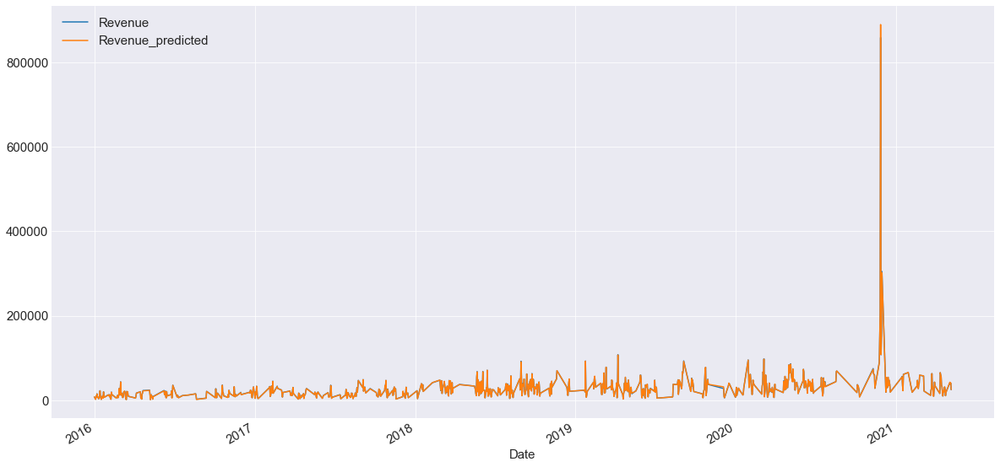

In [156]:
#Let's see the forecast
forecast_train.plot()

#### Residual Analysis 

In [157]:
forecast_train['Residuals'] = forecast_train['Revenue'] - forecast_train['Revenue_predicted']

<AxesSubplot:xlabel='Date'>

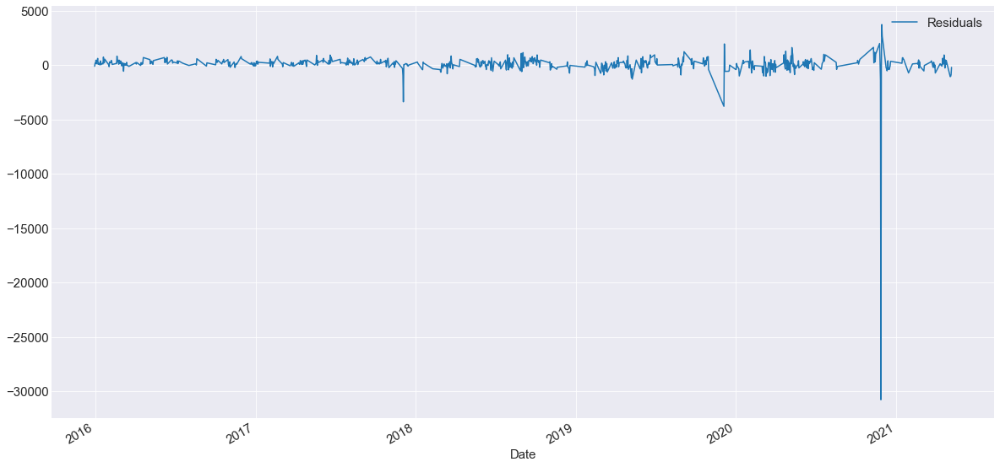

In [158]:
forecast_train[['Residuals']].plot()

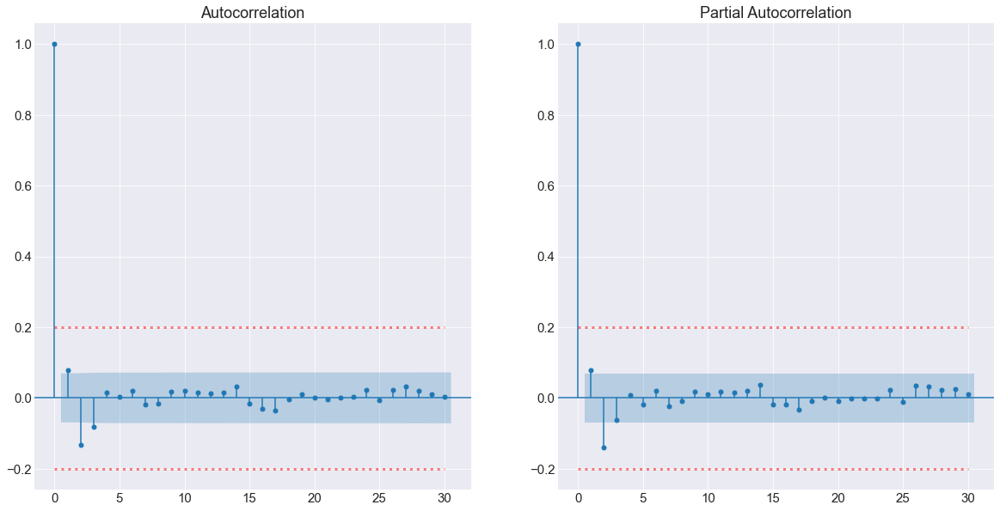

In [159]:
draw_autocorrelation(forecast_train[['Residuals']], 30)

In [160]:
test_adf(forecast_train, 'Residuals')

** Augmented Dickey-Fuller Test **

T-test: -18.450066207880916 < Confidence Interval[1%]: -3.438581476199162 - Result: Stationary
T-test: -18.450066207880916 < Confidence Interval[5%]: -2.865173218890781 - Result: Stationary
T-test: -18.450066207880916 < Confidence Interval[10%]: -2.56870466056054 - Result: Stationary

P-Value: 2.1544929440532933e-30 < 0.05 - Result: Stationary


In [161]:
#R²
r2_score(forecast_train['Revenue'], forecast_train['Revenue_predicted'])

0.9989374424084823

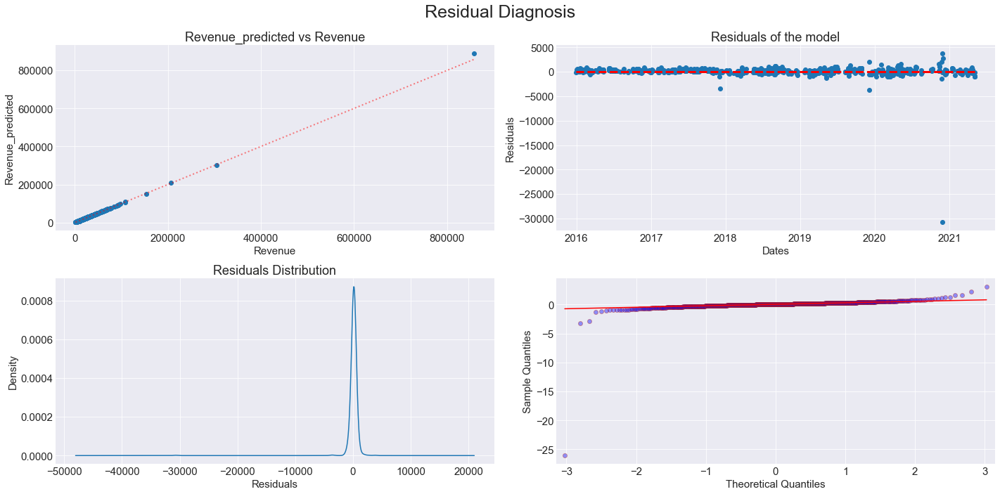

In [162]:
#Residual Analysis
draw_residuals_diagnosis(forecast_train, ['Revenue', 'Revenue_predicted', 'Residuals'])

#### Predict 

In [163]:
#Let's predict this model with Test Data
y_predict_test = rnn.predict(X_test_scaled)
y_predict_test = pd.DataFrame(y_predict_test, index= y_test.index, columns= [f'{y_test.name}_predicted'])
#Create the new DataFrame with the Test y values and Test predict values
forecast_test = pd.concat([y_test.to_frame(), y_predict_test], axis= 1)

In [164]:
metric_rmse(forecast_test, 'Revenue')

41695.8877966111

<AxesSubplot:xlabel='Date'>

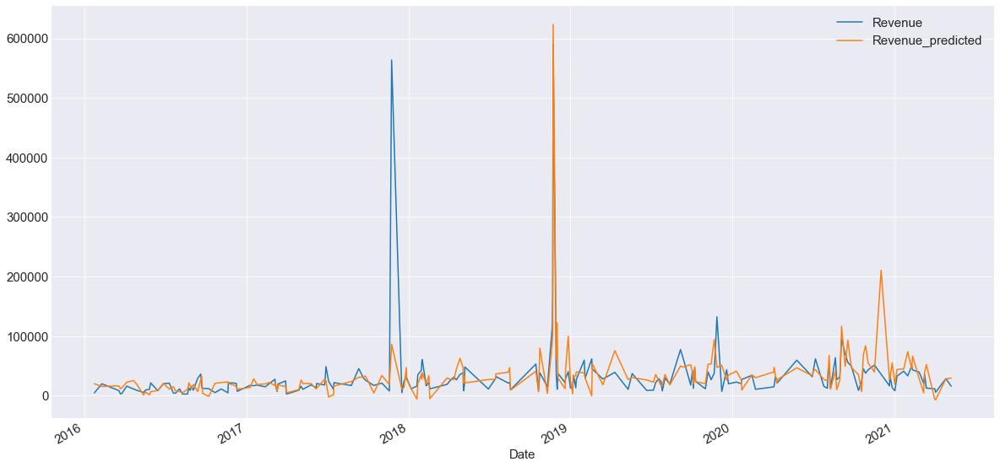

In [165]:
#Let's see the forecast
forecast_test.plot()

In [166]:
#R²
r2_score(forecast_test['Revenue'], forecast_test['Revenue_predicted'])

0.5068700160526799

### Data Forecasting 

In [167]:
data_full = pd.concat([data_small, data_validation])

#All lagged features for forecasting - Period 7 days
lags = [1, 2, 3, 4, 5, 6, 7, 364]
data_full_forecast = prepare_data_forecast(data_full, 'Revenue', lags, 7)
data_full_forecast

,Year_2021,Month_6,Day_14,Day_15,Day_16,Day_17,Day_18,Day_19,Day_20,Black_Friday,Easter,Covid,Rev-364,Rev-7,Rev-6,Rev-5,Rev-4,Rev-3,Rev-2,Rev-1
2021-06-14,1,1,1,0,0,0,0,0,0,0,0,0,48735.52,44815.98,46716.35,47649.11,66938.46,53022.54,25079.69,27413.63
2021-06-15,1,1,0,1,0,0,0,0,0,0,0,0,33745.33,21760.66,44815.98,46716.35,47649.11,66938.46,53022.54,25079.69
2021-06-16,1,1,0,0,1,0,0,0,0,0,0,0,16913.21,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46,53022.54
2021-06-17,1,1,0,0,0,1,0,0,0,0,0,0,29435.16,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11,66938.46
2021-06-18,1,1,0,0,0,0,1,0,0,0,0,0,32517.81,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35,47649.11
2021-06-19,1,1,0,0,0,0,0,1,0,0,0,0,41321.59,44696.72,38282.13,47467.41,74427.57,21760.66,44815.98,46716.35
2021-06-20,1,1,0,0,0,0,0,0,1,0,0,0,45465.30,55890.10,44696.72,38282.13,47467.41,74427.57,21760.66,44815.98


In [180]:
#Get one RNN per period because it is not the same the RNN of T+1 than RNN of T+2
period = 14
model = get_rnn_list(period)

In [192]:
#Training
epochs = 10000

In [193]:
forecast_rnn = forecast_predict_rnn(data_full, 'Revenue', lags, period, model, epochs, 'robust', '95%')
forecast_rnn

Epoch 1/10000
24/24 [==============================] - 0s 2ms/step - loss: 628480256.0000 - mean_squared_error: 628480256.0000
Epoch 2/10000
24/24 [==============================] - 0s 1ms/step - loss: 572131840.0000 - mean_squared_error: 572131840.0000
Epoch 3/10000
24/24 [==============================] - 0s 2ms/step - loss: 544678592.0000 - mean_squared_error: 544678592.0000
Epoch 4/10000
24/24 [==============================] - 0s 1ms/step - loss: 525989152.0000 - mean_squared_error: 525989152.0000
Epoch 5/10000
24/24 [==============================] - 0s 1ms/step - loss: 515636864.0000 - mean_squared_error: 515636864.0000
Epoch 6/10000
24/24 [==============================] - 0s 1ms/step - loss: 509631264.0000 - mean_squared_error: 509631264.0000
Epoch 7/10000
24/24 [==============================] - 0s 1ms/step - loss: 500868064.0000 - mean_squared_error: 500868064.0000
Epoch 8/10000
24/24 [==============================] - 0s 1ms/step - loss: 489549152.0000 - mean_squared_error:

24/24 [==============================] - 0s 1ms/step - loss: 405028032.0000 - mean_squared_error: 405028032.0000
Epoch 66/10000
24/24 [==============================] - 0s 2ms/step - loss: 404758592.0000 - mean_squared_error: 404758592.0000
Epoch 67/10000
24/24 [==============================] - 0s 2ms/step - loss: 407032512.0000 - mean_squared_error: 407032512.0000
Epoch 68/10000
24/24 [==============================] - 0s 2ms/step - loss: 400650848.0000 - mean_squared_error: 400650848.0000
Epoch 69/10000
24/24 [==============================] - 0s 2ms/step - loss: 399261568.0000 - mean_squared_error: 399261568.0000
Epoch 70/10000
24/24 [==============================] - 0s 1ms/step - loss: 402638208.0000 - mean_squared_error: 402638208.0000
Epoch 71/10000
24/24 [==============================] - 0s 1ms/step - loss: 398608352.0000 - mean_squared_error: 398608352.0000
Epoch 72/10000
24/24 [==============================] - 0s 2ms/step - loss: 395077504.0000 - mean_squared_error: 395077

24/24 [==============================] - 0s 2ms/step - loss: 284419200.0000 - mean_squared_error: 284419200.0000
Epoch 192/10000
24/24 [==============================] - 0s 2ms/step - loss: 283289408.0000 - mean_squared_error: 283289408.0000
Epoch 193/10000
24/24 [==============================] - 0s 3ms/step - loss: 277813600.0000 - mean_squared_error: 277813600.0000
Epoch 194/10000
24/24 [==============================] - 0s 3ms/step - loss: 280224992.0000 - mean_squared_error: 280224992.0000
Epoch 195/10000
24/24 [==============================] - 0s 2ms/step - loss: 276895936.0000 - mean_squared_error: 276895936.0000
Epoch 196/10000
24/24 [==============================] - 0s 3ms/step - loss: 275567104.0000 - mean_squared_error: 275567104.0000
Epoch 197/10000
24/24 [==============================] - 0s 2ms/step - loss: 275935008.0000 - mean_squared_error: 275935008.0000
Epoch 198/10000
24/24 [==============================] - 0s 1ms/step - loss: 275094816.0000 - mean_squared_error:

24/24 [==============================] - 0s 1ms/step - loss: 112137960.0000 - mean_squared_error: 112137960.0000
Epoch 318/10000
24/24 [==============================] - 0s 2ms/step - loss: 113412552.0000 - mean_squared_error: 113412552.0000
Epoch 319/10000
24/24 [==============================] - 0s 2ms/step - loss: 110218128.0000 - mean_squared_error: 110218128.0000
Epoch 320/10000
24/24 [==============================] - 0s 2ms/step - loss: 109970312.0000 - mean_squared_error: 109970312.0000
Epoch 321/10000
24/24 [==============================] - 0s 2ms/step - loss: 108219688.0000 - mean_squared_error: 108219688.0000
Epoch 322/10000
24/24 [==============================] - 0s 2ms/step - loss: 106245536.0000 - mean_squared_error: 106245536.0000
Epoch 323/10000
24/24 [==============================] - 0s 1ms/step - loss: 107502136.0000 - mean_squared_error: 107502136.0000
Epoch 324/10000
24/24 [==============================] - 0s 2ms/step - loss: 105237880.0000 - mean_squared_error:

24/24 [==============================] - 0s 2ms/step - loss: 21974896.0000 - mean_squared_error: 21974896.0000
Epoch 445/10000
24/24 [==============================] - 0s 2ms/step - loss: 21408672.0000 - mean_squared_error: 21408672.0000
Epoch 446/10000
24/24 [==============================] - 0s 3ms/step - loss: 21958732.0000 - mean_squared_error: 21958732.0000
Epoch 447/10000
24/24 [==============================] - 0s 1ms/step - loss: 20969542.0000 - mean_squared_error: 20969542.0000
Epoch 448/10000
24/24 [==============================] - 0s 2ms/step - loss: 20366324.0000 - mean_squared_error: 20366324.0000
Epoch 449/10000
24/24 [==============================] - 0s 2ms/step - loss: 20086490.0000 - mean_squared_error: 20086490.0000
Epoch 450/10000
24/24 [==============================] - 0s 2ms/step - loss: 20030334.0000 - mean_squared_error: 20030334.0000
Epoch 451/10000
24/24 [==============================] - 0s 2ms/step - loss: 20447922.0000 - mean_squared_error: 20447922.0000


24/24 [==============================] - 0s 2ms/step - loss: 2173952.2500 - mean_squared_error: 2173952.2500
Epoch 574/10000
24/24 [==============================] - 0s 2ms/step - loss: 2864859.0000 - mean_squared_error: 2864859.0000
Epoch 575/10000
24/24 [==============================] - 0s 2ms/step - loss: 2384129.7500 - mean_squared_error: 2384129.7500
Epoch 576/10000
24/24 [==============================] - 0s 2ms/step - loss: 2905887.0000 - mean_squared_error: 2905887.0000
Epoch 577/10000
24/24 [==============================] - 0s 2ms/step - loss: 2576419.2500 - mean_squared_error: 2576419.2500
Epoch 578/10000
24/24 [==============================] - 0s 2ms/step - loss: 2581209.2500 - mean_squared_error: 2581209.2500
Epoch 579/10000
24/24 [==============================] - 0s 4ms/step - loss: 2523798.0000 - mean_squared_error: 2523798.0000
Epoch 580/10000
24/24 [==============================] - 0s 3ms/step - loss: 2663246.0000 - mean_squared_error: 2663246.0000
Epoch 581/10000


24/24 [==============================] - 0s 2ms/step - loss: 960627.8125 - mean_squared_error: 960627.8125
Epoch 704/10000
24/24 [==============================] - 0s 2ms/step - loss: 1680560.6250 - mean_squared_error: 1680560.6250
Epoch 705/10000
24/24 [==============================] - 0s 2ms/step - loss: 1519647.8750 - mean_squared_error: 1519647.8750
Epoch 706/10000
24/24 [==============================] - 0s 2ms/step - loss: 1094181.2500 - mean_squared_error: 1094181.2500
Epoch 707/10000
24/24 [==============================] - 0s 2ms/step - loss: 1226580.3750 - mean_squared_error: 1226580.3750
Epoch 708/10000
24/24 [==============================] - 0s 2ms/step - loss: 914205.5000 - mean_squared_error: 914205.5000
Epoch 709/10000
24/24 [==============================] - 0s 2ms/step - loss: 1197205.0000 - mean_squared_error: 1197205.0000
Epoch 710/10000
24/24 [==============================] - 0s 2ms/step - loss: 1646125.8750 - mean_squared_error: 1646125.8750
Epoch 711/10000
24/2

24/24 [==============================] - 0s 3ms/step - loss: 1206312.2500 - mean_squared_error: 1206312.2500
Epoch 770/10000
24/24 [==============================] - 0s 2ms/step - loss: 1964429.1250 - mean_squared_error: 1964429.1250
Epoch 771/10000
24/24 [==============================] - 0s 2ms/step - loss: 1291848.2500 - mean_squared_error: 1291848.2500
Epoch 772/10000
24/24 [==============================] - 0s 2ms/step - loss: 733328.7500 - mean_squared_error: 733328.7500
Epoch 773/10000
24/24 [==============================] - 0s 2ms/step - loss: 1057195.0000 - mean_squared_error: 1057195.0000
Epoch 774/10000
24/24 [==============================] - 0s 2ms/step - loss: 1031346.1250 - mean_squared_error: 1031346.1250
Epoch 775/10000
24/24 [==============================] - 0s 2ms/step - loss: 1018414.5625 - mean_squared_error: 1018414.5625
Epoch 776/10000
24/24 [==============================] - 0s 2ms/step - loss: 791501.5625 - mean_squared_error: 791501.5625
Epoch 777/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 722236.0000 - mean_squared_error: 722236.0000
Epoch 836/10000
24/24 [==============================] - 0s 2ms/step - loss: 2952222.0000 - mean_squared_error: 2952222.0000
Epoch 837/10000
24/24 [==============================] - 0s 2ms/step - loss: 493522.4688 - mean_squared_error: 493522.4688
Epoch 838/10000
24/24 [==============================] - 0s 1ms/step - loss: 1579526.3750 - mean_squared_error: 1579526.3750
Epoch 839/10000
24/24 [==============================] - 0s 2ms/step - loss: 1384725.6250 - mean_squared_error: 1384725.6250
Epoch 840/10000
24/24 [==============================] - 0s 2ms/step - loss: 636012.3125 - mean_squared_error: 636012.3125
Epoch 841/10000
24/24 [==============================] - 0s 2ms/step - loss: 1145243.2500 - mean_squared_error: 1145243.2500
Epoch 842/10000
24/24 [==============================] - 0s 2ms/step - loss: 1058681.5000 - mean_squared_error: 1058681.5000
Epoch 843/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 1168666.6250 - mean_squared_error: 1168666.6250
Epoch 902/10000
24/24 [==============================] - 0s 2ms/step - loss: 1545423.5000 - mean_squared_error: 1545423.5000
Epoch 903/10000
24/24 [==============================] - 0s 1ms/step - loss: 695885.3750 - mean_squared_error: 695885.3750
Epoch 904/10000
24/24 [==============================] - 0s 1ms/step - loss: 972561.5000 - mean_squared_error: 972561.5000
Epoch 905/10000
24/24 [==============================] - 0s 1ms/step - loss: 1247088.7500 - mean_squared_error: 1247088.7500
Epoch 906/10000
24/24 [==============================] - 0s 1ms/step - loss: 1470427.1250 - mean_squared_error: 1470427.1250
Epoch 907/10000
24/24 [==============================] - 0s 1ms/step - loss: 1031286.7500 - mean_squared_error: 1031286.7500
Epoch 908/10000
24/24 [==============================] - 0s 1ms/step - loss: 993234.4375 - mean_squared_error: 993234.4375
Epoch 909/10000
24/24 

Epoch 1032/10000
24/24 [==============================] - 0s 1ms/step - loss: 1294732.8750 - mean_squared_error: 1294732.8750
Epoch 1033/10000
24/24 [==============================] - 0s 2ms/step - loss: 995951.1875 - mean_squared_error: 995951.1875
Epoch 1034/10000
24/24 [==============================] - 0s 1ms/step - loss: 1454769.0000 - mean_squared_error: 1454769.0000
Epoch 1035/10000
24/24 [==============================] - 0s 2ms/step - loss: 799678.0000 - mean_squared_error: 799678.0000
Epoch 1036/10000
24/24 [==============================] - 0s 2ms/step - loss: 1715354.2500 - mean_squared_error: 1715354.2500
Epoch 1037/10000
24/24 [==============================] - 0s 2ms/step - loss: 976981.6250 - mean_squared_error: 976981.6250
Epoch 1038/10000
24/24 [==============================] - 0s 2ms/step - loss: 1310944.1250 - mean_squared_error: 1310944.1250
Epoch 1039/10000
24/24 [==============================] - 0s 2ms/step - loss: 620689.1875 - mean_squared_error: 620689.1875


24/24 [==============================] - 0s 1ms/step - loss: 969220.5625 - mean_squared_error: 969220.5625
Epoch 1163/10000
24/24 [==============================] - 0s 2ms/step - loss: 992539.9375 - mean_squared_error: 992539.9375
Epoch 1164/10000
24/24 [==============================] - 0s 2ms/step - loss: 1719073.7500 - mean_squared_error: 1719073.7500
Epoch 1165/10000
24/24 [==============================] - 0s 2ms/step - loss: 443538.4062 - mean_squared_error: 443538.4062
Epoch 1166/10000
24/24 [==============================] - 0s 1ms/step - loss: 896496.1875 - mean_squared_error: 896496.1875
Epoch 1167/10000
24/24 [==============================] - 0s 2ms/step - loss: 907795.1250 - mean_squared_error: 907795.1250
Epoch 1168/10000
24/24 [==============================] - 0s 2ms/step - loss: 1207117.7500 - mean_squared_error: 1207117.7500
Epoch 1169/10000
24/24 [==============================] - 0s 1ms/step - loss: 793209.6250 - mean_squared_error: 793209.6250
Epoch 1170/10000
24/2

24/24 [==============================] - 0s 1ms/step - loss: 650495.8125 - mean_squared_error: 650495.8125
Epoch 1293/10000
24/24 [==============================] - 0s 1ms/step - loss: 1007715.8750 - mean_squared_error: 1007715.8750
Epoch 1294/10000
24/24 [==============================] - 0s 1ms/step - loss: 983722.0000 - mean_squared_error: 983722.0000
Epoch 1295/10000
24/24 [==============================] - 0s 2ms/step - loss: 796819.5625 - mean_squared_error: 796819.5625
Epoch 1296/10000
24/24 [==============================] - 0s 2ms/step - loss: 921415.3125 - mean_squared_error: 921415.3125
Epoch 1297/10000
24/24 [==============================] - 0s 2ms/step - loss: 1182208.3750 - mean_squared_error: 1182208.3750
Epoch 1298/10000
24/24 [==============================] - 0s 2ms/step - loss: 728877.1250 - mean_squared_error: 728877.1250
Epoch 1299/10000
24/24 [==============================] - 0s 2ms/step - loss: 564291.2500 - mean_squared_error: 564291.2500
Epoch 1300/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 575983.3750 - mean_squared_error: 575983.3750
Epoch 1423/10000
24/24 [==============================] - 0s 1ms/step - loss: 1015156.0000 - mean_squared_error: 1015156.0000
Epoch 1424/10000
24/24 [==============================] - ETA: 0s - loss: 380511.6250 - mean_squared_error: 380511.62 - 0s 1ms/step - loss: 2124542.0000 - mean_squared_error: 2124542.0000
Epoch 1425/10000
24/24 [==============================] - 0s 2ms/step - loss: 569815.4375 - mean_squared_error: 569815.4375
Epoch 1426/10000
24/24 [==============================] - 0s 2ms/step - loss: 594989.6250 - mean_squared_error: 594989.6250
Epoch 1427/10000
24/24 [==============================] - 0s 1ms/step - loss: 1053995.5000 - mean_squared_error: 1053995.5000
Epoch 1428/10000
24/24 [==============================] - 0s 2ms/step - loss: 1618222.6250 - mean_squared_error: 1618222.6250
Epoch 1429/10000
24/24 [==============================] - 0s 1ms/step - loss: 5

24/24 [==============================] - 0s 2ms/step - loss: 298423.1875 - mean_squared_error: 298423.1875
Epoch 1553/10000
24/24 [==============================] - 0s 2ms/step - loss: 807031.8750 - mean_squared_error: 807031.8750
Epoch 1554/10000
24/24 [==============================] - 0s 1ms/step - loss: 688255.5000 - mean_squared_error: 688255.5000
Epoch 1555/10000
24/24 [==============================] - 0s 2ms/step - loss: 1432063.5000 - mean_squared_error: 1432063.5000
Epoch 1556/10000
24/24 [==============================] - 0s 2ms/step - loss: 716666.2500 - mean_squared_error: 716666.2500
Epoch 1557/10000
24/24 [==============================] - 0s 2ms/step - loss: 1382981.5000 - mean_squared_error: 1382981.5000
Epoch 1558/10000
24/24 [==============================] - 0s 2ms/step - loss: 1474740.5000 - mean_squared_error: 1474740.5000
Epoch 1559/10000
24/24 [==============================] - 0s 2ms/step - loss: 714450.4375 - mean_squared_error: 714450.4375
Epoch 1560/10000
24

24/24 [==============================] - 0s 1ms/step - loss: 866644.8125 - mean_squared_error: 866644.8125
Epoch 1683/10000
24/24 [==============================] - 0s 2ms/step - loss: 649910.1875 - mean_squared_error: 649910.1875
Epoch 1684/10000
24/24 [==============================] - 0s 2ms/step - loss: 691443.6875 - mean_squared_error: 691443.6875
Epoch 1685/10000
24/24 [==============================] - 0s 2ms/step - loss: 2177105.0000 - mean_squared_error: 2177105.0000
Epoch 1686/10000
24/24 [==============================] - 0s 2ms/step - loss: 238538.8750 - mean_squared_error: 238538.8750
Epoch 1687/10000
24/24 [==============================] - 0s 2ms/step - loss: 395281.4688 - mean_squared_error: 395281.4688
Epoch 1688/10000
24/24 [==============================] - 0s 2ms/step - loss: 511505.1562 - mean_squared_error: 511505.1562
Epoch 1689/10000
24/24 [==============================] - 0s 1ms/step - loss: 739207.5625 - mean_squared_error: 739207.5625
Epoch 1690/10000
24/24 

Epoch 1813/10000
24/24 [==============================] - 0s 1ms/step - loss: 740410.3750 - mean_squared_error: 740410.3750
Epoch 1814/10000
24/24 [==============================] - 0s 1ms/step - loss: 608636.2500 - mean_squared_error: 608636.2500
Epoch 1815/10000
24/24 [==============================] - 0s 1ms/step - loss: 1142388.5000 - mean_squared_error: 1142388.5000
Epoch 1816/10000
24/24 [==============================] - 0s 1ms/step - loss: 517476.1250 - mean_squared_error: 517476.1250
Epoch 1817/10000
24/24 [==============================] - 0s 1ms/step - loss: 962071.0000 - mean_squared_error: 962071.0000
Epoch 1818/10000
24/24 [==============================] - 0s 1ms/step - loss: 493820.4688 - mean_squared_error: 493820.4688
Epoch 1819/10000
24/24 [==============================] - 0s 2ms/step - loss: 543998.6875 - mean_squared_error: 543998.6875
Epoch 1820/10000
24/24 [==============================] - 0s 1ms/step - loss: 1210476.5000 - mean_squared_error: 1210476.5000
Epoc

Epoch 1944/10000
24/24 [==============================] - 0s 3ms/step - loss: 1240760.1250 - mean_squared_error: 1240760.1250
Epoch 1945/10000
24/24 [==============================] - 0s 2ms/step - loss: 367560.4062 - mean_squared_error: 367560.4062
Epoch 1946/10000
24/24 [==============================] - 0s 2ms/step - loss: 550545.3750 - mean_squared_error: 550545.3750
Epoch 1947/10000
24/24 [==============================] - 0s 2ms/step - loss: 653260.1250 - mean_squared_error: 653260.1250
Epoch 1948/10000
24/24 [==============================] - 0s 2ms/step - loss: 827776.2500 - mean_squared_error: 827776.2500
Epoch 1949/10000
24/24 [==============================] - 0s 2ms/step - loss: 757461.1250 - mean_squared_error: 757461.1250
Epoch 1950/10000
24/24 [==============================] - 0s 3ms/step - loss: 994191.6875 - mean_squared_error: 994191.6875
Epoch 1951/10000
24/24 [==============================] - 0s 2ms/step - loss: 503008.1875 - mean_squared_error: 503008.1875
Epoch 

Epoch 2075/10000
24/24 [==============================] - 0s 2ms/step - loss: 646159.4375 - mean_squared_error: 646159.4375
Epoch 2076/10000
24/24 [==============================] - 0s 2ms/step - loss: 999366.3125 - mean_squared_error: 999366.3125
Epoch 2077/10000
24/24 [==============================] - 0s 2ms/step - loss: 632664.8750 - mean_squared_error: 632664.8750
Epoch 2078/10000
24/24 [==============================] - 0s 2ms/step - loss: 1022765.8750 - mean_squared_error: 1022765.8750
Epoch 2079/10000
24/24 [==============================] - 0s 2ms/step - loss: 846738.8125 - mean_squared_error: 846738.8125
Epoch 2080/10000
24/24 [==============================] - 0s 2ms/step - loss: 593335.7500 - mean_squared_error: 593335.7500
Epoch 2081/10000
24/24 [==============================] - 0s 3ms/step - loss: 1231596.3750 - mean_squared_error: 1231596.3750
Epoch 2082/10000
24/24 [==============================] - 0s 1ms/step - loss: 299171.5625 - mean_squared_error: 299171.5625
Epoc

24/24 [==============================] - 0s 2ms/step - loss: 827169.3125 - mean_squared_error: 827169.3125
Epoch 2207/10000
24/24 [==============================] - 0s 3ms/step - loss: 656917.0625 - mean_squared_error: 656917.0625
Epoch 2208/10000
24/24 [==============================] - 0s 2ms/step - loss: 757996.3125 - mean_squared_error: 757996.3125
Epoch 2209/10000
24/24 [==============================] - 0s 2ms/step - loss: 1721658.2500 - mean_squared_error: 1721658.2500
Epoch 2210/10000
24/24 [==============================] - 0s 2ms/step - loss: 348654.1875 - mean_squared_error: 348654.1875
Epoch 2211/10000
24/24 [==============================] - 0s 2ms/step - loss: 616849.3125 - mean_squared_error: 616849.3125
Epoch 2212/10000
24/24 [==============================] - 0s 2ms/step - loss: 804850.0000 - mean_squared_error: 804850.0000
Epoch 2213/10000
24/24 [==============================] - 0s 2ms/step - loss: 401048.0938 - mean_squared_error: 401048.0938
Epoch 2214/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 552744.1875 - mean_squared_error: 552744.1875
Epoch 2272/10000
24/24 [==============================] - 0s 2ms/step - loss: 1040929.7500 - mean_squared_error: 1040929.7500
Epoch 2273/10000
24/24 [==============================] - 0s 2ms/step - loss: 493810.4688 - mean_squared_error: 493810.4688
Epoch 2274/10000
24/24 [==============================] - 0s 1ms/step - loss: 764664.5625 - mean_squared_error: 764664.5625
Epoch 2275/10000
24/24 [==============================] - 0s 2ms/step - loss: 815244.1875 - mean_squared_error: 815244.1875
Epoch 2276/10000
24/24 [==============================] - 0s 2ms/step - loss: 667513.7500 - mean_squared_error: 667513.7500
Epoch 2277/10000
24/24 [==============================] - 0s 1ms/step - loss: 675115.1875 - mean_squared_error: 675115.1875
Epoch 2278/10000
24/24 [==============================] - 0s 2ms/step - loss: 972557.5625 - mean_squared_error: 972557.5625
Epoch 2279/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 1349449.7500 - mean_squared_error: 1349449.7500
Epoch 2404/10000
24/24 [==============================] - 0s 2ms/step - loss: 274603.2188 - mean_squared_error: 274603.2188
Epoch 2405/10000
24/24 [==============================] - 0s 2ms/step - loss: 814412.7500 - mean_squared_error: 814412.7500
Epoch 2406/10000
24/24 [==============================] - 0s 2ms/step - loss: 907346.5625 - mean_squared_error: 907346.5625
Epoch 2407/10000
24/24 [==============================] - 0s 2ms/step - loss: 648822.1875 - mean_squared_error: 648822.1875
Epoch 2408/10000
24/24 [==============================] - 0s 2ms/step - loss: 682797.3125 - mean_squared_error: 682797.3125
Epoch 2409/10000
24/24 [==============================] - 0s 2ms/step - loss: 879513.8750 - mean_squared_error: 879513.8750
Epoch 2410/10000
24/24 [==============================] - 0s 2ms/step - loss: 753897.2500 - mean_squared_error: 753897.2500
Epoch 2411/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 825218.3125 - mean_squared_error: 825218.3125
Epoch 2470/10000
24/24 [==============================] - 0s 2ms/step - loss: 496277.0312 - mean_squared_error: 496277.0312
Epoch 2471/10000
24/24 [==============================] - 0s 2ms/step - loss: 1153758.5000 - mean_squared_error: 1153758.5000
Epoch 2472/10000
24/24 [==============================] - 0s 2ms/step - loss: 626377.7500 - mean_squared_error: 626377.7500
Epoch 2473/10000
24/24 [==============================] - 0s 2ms/step - loss: 654656.8125 - mean_squared_error: 654656.8125
Epoch 2474/10000
24/24 [==============================] - 0s 2ms/step - loss: 565747.8125 - mean_squared_error: 565747.8125
Epoch 2475/10000
24/24 [==============================] - 0s 1ms/step - loss: 931262.2500 - mean_squared_error: 931262.2500
Epoch 2476/10000
24/24 [==============================] - 0s 2ms/step - loss: 348214.1875 - mean_squared_error: 348214.1875
Epoch 2477/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 619586.4375 - mean_squared_error: 619586.4375
Epoch 2536/10000
24/24 [==============================] - 0s 1ms/step - loss: 496941.9375 - mean_squared_error: 496941.9375
Epoch 2537/10000
24/24 [==============================] - 0s 1ms/step - loss: 758875.6250 - mean_squared_error: 758875.6250
Epoch 2538/10000
24/24 [==============================] - 0s 2ms/step - loss: 400515.9688 - mean_squared_error: 400515.9688
Epoch 2539/10000
24/24 [==============================] - 0s 2ms/step - loss: 666627.1875 - mean_squared_error: 666627.1875
Epoch 2540/10000
24/24 [==============================] - 0s 2ms/step - loss: 839432.1875 - mean_squared_error: 839432.1875
Epoch 2541/10000
24/24 [==============================] - 0s 2ms/step - loss: 396555.5000 - mean_squared_error: 396555.5000
Epoch 2542/10000
24/24 [==============================] - 0s 2ms/step - loss: 487886.5625 - mean_squared_error: 487886.5625
Epoch 2543/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 295625.2812 - mean_squared_error: 295625.2812
Epoch 2602/10000
24/24 [==============================] - 0s 2ms/step - loss: 494500.6875 - mean_squared_error: 494500.6875
Epoch 2603/10000
24/24 [==============================] - 0s 1ms/step - loss: 667388.0625 - mean_squared_error: 667388.0625
Epoch 2604/10000
24/24 [==============================] - 0s 2ms/step - loss: 632127.4375 - mean_squared_error: 632127.4375
Epoch 2605/10000
24/24 [==============================] - 0s 2ms/step - loss: 874551.3750 - mean_squared_error: 874551.3750
Epoch 2606/10000
24/24 [==============================] - 0s 2ms/step - loss: 739188.8750 - mean_squared_error: 739188.8750
Epoch 2607/10000
24/24 [==============================] - 0s 2ms/step - loss: 799145.2500 - mean_squared_error: 799145.2500
Epoch 2608/10000
24/24 [==============================] - 0s 2ms/step - loss: 935053.1250 - mean_squared_error: 935053.1250
Epoch 2609/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 536027.0625 - mean_squared_error: 536027.0625
Epoch 2668/10000
24/24 [==============================] - 0s 2ms/step - loss: 818954.1875 - mean_squared_error: 818954.1875
Epoch 2669/10000
24/24 [==============================] - 0s 2ms/step - loss: 726335.5625 - mean_squared_error: 726335.5625
Epoch 2670/10000
24/24 [==============================] - 0s 2ms/step - loss: 788512.6250 - mean_squared_error: 788512.6250
Epoch 2671/10000
24/24 [==============================] - 0s 2ms/step - loss: 713040.3750 - mean_squared_error: 713040.3750
Epoch 2672/10000
24/24 [==============================] - 0s 2ms/step - loss: 483359.1250 - mean_squared_error: 483359.1250
Epoch 2673/10000
24/24 [==============================] - 0s 2ms/step - loss: 1073805.6250 - mean_squared_error: 1073805.6250
Epoch 2674/10000
24/24 [==============================] - 0s 2ms/step - loss: 261970.1562 - mean_squared_error: 261970.1562
Epoch 2675/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 553882.3750 - mean_squared_error: 553882.3750
Epoch 2799/10000
24/24 [==============================] - 0s 2ms/step - loss: 689789.9375 - mean_squared_error: 689789.9375
Epoch 2800/10000
24/24 [==============================] - 0s 2ms/step - loss: 764224.7500 - mean_squared_error: 764224.7500
Epoch 2801/10000
24/24 [==============================] - 0s 2ms/step - loss: 665024.7500 - mean_squared_error: 665024.7500
Epoch 2802/10000
24/24 [==============================] - 0s 2ms/step - loss: 543506.0000 - mean_squared_error: 543506.0000
Epoch 2803/10000
24/24 [==============================] - 0s 2ms/step - loss: 461437.1562 - mean_squared_error: 461437.1562
Epoch 2804/10000
24/24 [==============================] - 0s 1ms/step - loss: 1315204.7500 - mean_squared_error: 1315204.7500
Epoch 2805/10000
24/24 [==============================] - 0s 1ms/step - loss: 302206.4062 - mean_squared_error: 302206.4062
Epoch 2806/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 426103.8125 - mean_squared_error: 426103.8125
Epoch 2865/10000
24/24 [==============================] - 0s 2ms/step - loss: 923746.7500 - mean_squared_error: 923746.7500
Epoch 2866/10000
24/24 [==============================] - 0s 2ms/step - loss: 336359.5625 - mean_squared_error: 336359.5625
Epoch 2867/10000
24/24 [==============================] - 0s 2ms/step - loss: 484136.5938 - mean_squared_error: 484136.5938
Epoch 2868/10000
24/24 [==============================] - 0s 2ms/step - loss: 757887.1250 - mean_squared_error: 757887.1250
Epoch 2869/10000
24/24 [==============================] - 0s 2ms/step - loss: 485516.7188 - mean_squared_error: 485516.7188
Epoch 2870/10000
24/24 [==============================] - 0s 2ms/step - loss: 996745.8125 - mean_squared_error: 996745.8125
Epoch 2871/10000
24/24 [==============================] - 0s 2ms/step - loss: 503749.5625 - mean_squared_error: 503749.5625
Epoch 2872/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 711209.6250 - mean_squared_error: 711209.6250
Epoch 2996/10000
24/24 [==============================] - 0s 1ms/step - loss: 644229.3125 - mean_squared_error: 644229.3125
Epoch 2997/10000
24/24 [==============================] - 0s 1ms/step - loss: 334303.9062 - mean_squared_error: 334303.9062
Epoch 2998/10000
24/24 [==============================] - 0s 2ms/step - loss: 926969.6875 - mean_squared_error: 926969.6875
Epoch 2999/10000
24/24 [==============================] - 0s 2ms/step - loss: 628048.0625 - mean_squared_error: 628048.0625
Epoch 3000/10000
24/24 [==============================] - 0s 2ms/step - loss: 359210.4688 - mean_squared_error: 359210.4688
Epoch 3001/10000
24/24 [==============================] - 0s 2ms/step - loss: 594378.6250 - mean_squared_error: 594378.6250
Epoch 3002/10000
24/24 [==============================] - 0s 2ms/step - loss: 559575.4375 - mean_squared_error: 559575.4375
Epoch 3003/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 1017790.2500 - mean_squared_error: 1017790.2500
Epoch 3128/10000
24/24 [==============================] - 0s 2ms/step - loss: 461345.5625 - mean_squared_error: 461345.5625
Epoch 3129/10000
24/24 [==============================] - 0s 2ms/step - loss: 1395208.6250 - mean_squared_error: 1395208.6250
Epoch 3130/10000
24/24 [==============================] - 0s 2ms/step - loss: 218474.6094 - mean_squared_error: 218474.6094
Epoch 3131/10000
24/24 [==============================] - 0s 2ms/step - loss: 333774.0938 - mean_squared_error: 333774.0938
Epoch 3132/10000
24/24 [==============================] - 0s 2ms/step - loss: 1094786.7500 - mean_squared_error: 1094786.7500
Epoch 3133/10000
24/24 [==============================] - 0s 1ms/step - loss: 178393.5156 - mean_squared_error: 178393.5156
Epoch 3134/10000
24/24 [==============================] - 0s 1ms/step - loss: 895483.4375 - mean_squared_error: 895483.4375
Epoch 3135/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 694513.5000 - mean_squared_error: 694513.5000
Epoch 3194/10000
24/24 [==============================] - 0s 2ms/step - loss: 792569.2500 - mean_squared_error: 792569.2500
Epoch 3195/10000
24/24 [==============================] - 0s 2ms/step - loss: 241537.9844 - mean_squared_error: 241537.9844
Epoch 3196/10000
24/24 [==============================] - 0s 1ms/step - loss: 599748.8125 - mean_squared_error: 599748.8125
Epoch 3197/10000
24/24 [==============================] - 0s 1ms/step - loss: 330572.4375 - mean_squared_error: 330572.4375
Epoch 3198/10000
24/24 [==============================] - 0s 1ms/step - loss: 593214.5625 - mean_squared_error: 593214.5625
Epoch 3199/10000
24/24 [==============================] - 0s 2ms/step - loss: 1298087.3750 - mean_squared_error: 1298087.3750
Epoch 3200/10000
24/24 [==============================] - 0s 2ms/step - loss: 413037.6562 - mean_squared_error: 413037.6562
Epoch 3201/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 268166.4375 - mean_squared_error: 268166.4375
Epoch 3326/10000
24/24 [==============================] - 0s 2ms/step - loss: 611321.0000 - mean_squared_error: 611321.0000
Epoch 3327/10000
24/24 [==============================] - 0s 2ms/step - loss: 506515.5938 - mean_squared_error: 506515.5938
Epoch 3328/10000
24/24 [==============================] - 0s 2ms/step - loss: 572221.3125 - mean_squared_error: 572221.3125
Epoch 3329/10000
24/24 [==============================] - 0s 2ms/step - loss: 574549.9375 - mean_squared_error: 574549.9375
Epoch 3330/10000
24/24 [==============================] - 0s 2ms/step - loss: 509205.4062 - mean_squared_error: 509205.4062
Epoch 3331/10000
24/24 [==============================] - 0s 2ms/step - loss: 341385.2188 - mean_squared_error: 341385.2188
Epoch 3332/10000
24/24 [==============================] - 0s 2ms/step - loss: 689823.0000 - mean_squared_error: 689823.0000
Epoch 3333/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 1086887.8750 - mean_squared_error: 1086887.8750
Epoch 3458/10000
24/24 [==============================] - 0s 2ms/step - loss: 384100.0625 - mean_squared_error: 384100.0625
Epoch 3459/10000
24/24 [==============================] - 0s 2ms/step - loss: 267260.1250 - mean_squared_error: 267260.1250
Epoch 3460/10000
24/24 [==============================] - 0s 2ms/step - loss: 784327.6875 - mean_squared_error: 784327.6875
Epoch 3461/10000
24/24 [==============================] - 0s 2ms/step - loss: 960278.8750 - mean_squared_error: 960278.8750
Epoch 3462/10000
24/24 [==============================] - 0s 2ms/step - loss: 237998.5156 - mean_squared_error: 237998.5156
Epoch 3463/10000
24/24 [==============================] - 0s 2ms/step - loss: 831537.0000 - mean_squared_error: 831537.0000
Epoch 3464/10000
24/24 [==============================] - 0s 2ms/step - loss: 301755.1875 - mean_squared_error: 301755.1875
Epoch 3465/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 872240.8125 - mean_squared_error: 872240.8125
Epoch 3590/10000
24/24 [==============================] - 0s 2ms/step - loss: 762798.2500 - mean_squared_error: 762798.2500
Epoch 3591/10000
24/24 [==============================] - 0s 2ms/step - loss: 448651.8125 - mean_squared_error: 448651.8125
Epoch 3592/10000
24/24 [==============================] - 0s 2ms/step - loss: 675348.9375 - mean_squared_error: 675348.9375
Epoch 3593/10000
24/24 [==============================] - 0s 2ms/step - loss: 245579.8750 - mean_squared_error: 245579.8750
Epoch 3594/10000
24/24 [==============================] - 0s 2ms/step - loss: 550117.0625 - mean_squared_error: 550117.0625
Epoch 3595/10000
24/24 [==============================] - 0s 2ms/step - loss: 757452.2500 - mean_squared_error: 757452.2500
Epoch 3596/10000
24/24 [==============================] - 0s 2ms/step - loss: 306778.3750 - mean_squared_error: 306778.3750
Epoch 3597/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 563540.6875 - mean_squared_error: 563540.6875
Epoch 3722/10000
24/24 [==============================] - 0s 2ms/step - loss: 392679.7188 - mean_squared_error: 392679.7188
Epoch 3723/10000
24/24 [==============================] - 0s 1ms/step - loss: 362894.0625 - mean_squared_error: 362894.0625
Epoch 3724/10000
24/24 [==============================] - 0s 2ms/step - loss: 557345.1250 - mean_squared_error: 557345.1250
Epoch 3725/10000
24/24 [==============================] - 0s 2ms/step - loss: 701468.0000 - mean_squared_error: 701468.0000
Epoch 3726/10000
24/24 [==============================] - 0s 2ms/step - loss: 266813.8438 - mean_squared_error: 266813.8438
Epoch 3727/10000
24/24 [==============================] - 0s 2ms/step - loss: 564496.1250 - mean_squared_error: 564496.1250
Epoch 3728/10000
24/24 [==============================] - 0s 2ms/step - loss: 320166.3125 - mean_squared_error: 320166.3125
Epoch 3729/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 270110.8438 - mean_squared_error: 270110.8438
Epoch 3854/10000
24/24 [==============================] - 0s 2ms/step - loss: 364407.0000 - mean_squared_error: 364407.0000
Epoch 3855/10000
24/24 [==============================] - 0s 2ms/step - loss: 754953.3125 - mean_squared_error: 754953.3125
Epoch 3856/10000
24/24 [==============================] - 0s 2ms/step - loss: 659968.4375 - mean_squared_error: 659968.4375
Epoch 3857/10000
24/24 [==============================] - 0s 2ms/step - loss: 510093.1875 - mean_squared_error: 510093.1875
Epoch 3858/10000
24/24 [==============================] - 0s 2ms/step - loss: 561262.3750 - mean_squared_error: 561262.3750
Epoch 3859/10000
24/24 [==============================] - 0s 2ms/step - loss: 444498.2812 - mean_squared_error: 444498.2812
Epoch 3860/10000
24/24 [==============================] - 0s 2ms/step - loss: 678056.6875 - mean_squared_error: 678056.6875
Epoch 3861/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 1480567.3750 - mean_squared_error: 1480567.3750
Epoch 3986/10000
24/24 [==============================] - 0s 2ms/step - loss: 146474.0000 - mean_squared_error: 146474.0000
Epoch 3987/10000
24/24 [==============================] - 0s 2ms/step - loss: 391534.7188 - mean_squared_error: 391534.7188
Epoch 3988/10000
24/24 [==============================] - 0s 2ms/step - loss: 495101.5312 - mean_squared_error: 495101.5312
Epoch 3989/10000
24/24 [==============================] - 0s 2ms/step - loss: 312652.0625 - mean_squared_error: 312652.0625
Epoch 3990/10000
24/24 [==============================] - 0s 2ms/step - loss: 402992.8750 - mean_squared_error: 402992.8750
Epoch 3991/10000
24/24 [==============================] - 0s 2ms/step - loss: 463318.6875 - mean_squared_error: 463318.6875
Epoch 3992/10000
24/24 [==============================] - 0s 1ms/step - loss: 782612.8750 - mean_squared_error: 782612.8750
Epoch 3993/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 527451.1875 - mean_squared_error: 527451.1875
Epoch 4052/10000
24/24 [==============================] - 0s 2ms/step - loss: 428378.9688 - mean_squared_error: 428378.9688
Epoch 4053/10000
24/24 [==============================] - 0s 2ms/step - loss: 386862.7812 - mean_squared_error: 386862.7812
Epoch 4054/10000
24/24 [==============================] - 0s 2ms/step - loss: 575004.0625 - mean_squared_error: 575004.0625
Epoch 4055/10000
24/24 [==============================] - 0s 2ms/step - loss: 224775.5938 - mean_squared_error: 224775.5938
Epoch 4056/10000
24/24 [==============================] - 0s 3ms/step - loss: 644495.9375 - mean_squared_error: 644495.9375
Epoch 4057/10000
24/24 [==============================] - 0s 2ms/step - loss: 499922.2812 - mean_squared_error: 499922.2812
Epoch 4058/10000
24/24 [==============================] - 0s 2ms/step - loss: 1012462.9375 - mean_squared_error: 1012462.9375
Epoch 4059/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 527383.3750 - mean_squared_error: 527383.3750
Epoch 4184/10000
24/24 [==============================] - 0s 2ms/step - loss: 502762.2500 - mean_squared_error: 502762.2500
Epoch 4185/10000
24/24 [==============================] - 0s 1ms/step - loss: 558962.8750 - mean_squared_error: 558962.8750
Epoch 4186/10000
24/24 [==============================] - 0s 2ms/step - loss: 439452.4688 - mean_squared_error: 439452.4688
Epoch 4187/10000
24/24 [==============================] - 0s 2ms/step - loss: 520667.1562 - mean_squared_error: 520667.1562
Epoch 4188/10000
24/24 [==============================] - 0s 2ms/step - loss: 602334.1250 - mean_squared_error: 602334.1250
Epoch 4189/10000
24/24 [==============================] - 0s 2ms/step - loss: 187047.8281 - mean_squared_error: 187047.8281
Epoch 4190/10000
24/24 [==============================] - 0s 3ms/step - loss: 596817.3125 - mean_squared_error: 596817.3125
Epoch 4191/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 927484.1250 - mean_squared_error: 927484.1250
Epoch 4316/10000
24/24 [==============================] - 0s 3ms/step - loss: 354238.5625 - mean_squared_error: 354238.5625
Epoch 4317/10000
24/24 [==============================] - 0s 3ms/step - loss: 302840.9688 - mean_squared_error: 302840.9688
Epoch 4318/10000
24/24 [==============================] - 0s 2ms/step - loss: 515441.1562 - mean_squared_error: 515441.1562
Epoch 4319/10000
24/24 [==============================] - 0s 2ms/step - loss: 364274.5938 - mean_squared_error: 364274.5938
Epoch 4320/10000
24/24 [==============================] - 0s 2ms/step - loss: 491981.7500 - mean_squared_error: 491981.7500
Epoch 4321/10000
24/24 [==============================] - 0s 2ms/step - loss: 763050.0000 - mean_squared_error: 763050.0000
Epoch 4322/10000
24/24 [==============================] - 0s 2ms/step - loss: 343543.0938 - mean_squared_error: 343543.0938
Epoch 4323/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 343131.9062 - mean_squared_error: 343131.9062
Epoch 4447/10000
24/24 [==============================] - 0s 2ms/step - loss: 871467.6250 - mean_squared_error: 871467.6250
Epoch 4448/10000
24/24 [==============================] - 0s 2ms/step - loss: 317321.2188 - mean_squared_error: 317321.2188
Epoch 4449/10000
24/24 [==============================] - 0s 2ms/step - loss: 298661.9062 - mean_squared_error: 298661.9062
Epoch 4450/10000
24/24 [==============================] - 0s 2ms/step - loss: 857769.0625 - mean_squared_error: 857769.0625
Epoch 4451/10000
24/24 [==============================] - 0s 2ms/step - loss: 205478.1875 - mean_squared_error: 205478.1875
Epoch 4452/10000
24/24 [==============================] - 0s 2ms/step - loss: 644024.8125 - mean_squared_error: 644024.8125
Epoch 4453/10000
24/24 [==============================] - 0s 2ms/step - loss: 399208.0938 - mean_squared_error: 399208.0938
Epoch 4454/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 1488695.5000 - mean_squared_error: 1488695.5000
Epoch 4579/10000
24/24 [==============================] - 0s 2ms/step - loss: 196461.3438 - mean_squared_error: 196461.3438
Epoch 4580/10000
24/24 [==============================] - 0s 3ms/step - loss: 256513.5938 - mean_squared_error: 256513.5938
Epoch 4581/10000
24/24 [==============================] - 0s 2ms/step - loss: 341088.2812 - mean_squared_error: 341088.2812
Epoch 4582/10000
24/24 [==============================] - 0s 2ms/step - loss: 477696.9062 - mean_squared_error: 477696.9062
Epoch 4583/10000
24/24 [==============================] - 0s 2ms/step - loss: 428052.3125 - mean_squared_error: 428052.3125
Epoch 4584/10000
24/24 [==============================] - 0s 2ms/step - loss: 614224.5000 - mean_squared_error: 614224.5000
Epoch 4585/10000
24/24 [==============================] - 0s 3ms/step - loss: 416857.1875 - mean_squared_error: 416857.1875
Epoch 4586/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 824838.5000 - mean_squared_error: 824838.5000
Epoch 4711/10000
24/24 [==============================] - 0s 2ms/step - loss: 416402.2500 - mean_squared_error: 416402.2500
Epoch 4712/10000
24/24 [==============================] - 0s 2ms/step - loss: 432697.0625 - mean_squared_error: 432697.0625
Epoch 4713/10000
24/24 [==============================] - 0s 2ms/step - loss: 245081.4844 - mean_squared_error: 245081.4844
Epoch 4714/10000
24/24 [==============================] - 0s 2ms/step - loss: 585389.7500 - mean_squared_error: 585389.7500
Epoch 4715/10000
24/24 [==============================] - 0s 2ms/step - loss: 200807.9531 - mean_squared_error: 200807.9531
Epoch 4716/10000
24/24 [==============================] - 0s 2ms/step - loss: 657228.3125 - mean_squared_error: 657228.3125
Epoch 4717/10000
24/24 [==============================] - 0s 2ms/step - loss: 532176.2500 - mean_squared_error: 532176.2500
Epoch 4718/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 481624.5938 - mean_squared_error: 481624.5938
Epoch 4842/10000
24/24 [==============================] - 0s 2ms/step - loss: 437531.4375 - mean_squared_error: 437531.4375
Epoch 4843/10000
24/24 [==============================] - 0s 3ms/step - loss: 515063.1562 - mean_squared_error: 515063.1562
Epoch 4844/10000
24/24 [==============================] - 0s 2ms/step - loss: 454359.7500 - mean_squared_error: 454359.7500
Epoch 4845/10000
24/24 [==============================] - 0s 3ms/step - loss: 385916.6250 - mean_squared_error: 385916.6250
Epoch 4846/10000
24/24 [==============================] - 0s 4ms/step - loss: 387039.2812 - mean_squared_error: 387039.2812
Epoch 4847/10000
24/24 [==============================] - 0s 2ms/step - loss: 907465.8125 - mean_squared_error: 907465.8125
Epoch 4848/10000
24/24 [==============================] - 0s 3ms/step - loss: 147281.5781 - mean_squared_error: 147281.5781
Epoch 4849/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 483101.6250 - mean_squared_error: 483101.6250
Epoch 4974/10000
24/24 [==============================] - 0s 2ms/step - loss: 1197075.2500 - mean_squared_error: 1197075.2500
Epoch 4975/10000
24/24 [==============================] - 0s 2ms/step - loss: 106355.9922 - mean_squared_error: 106355.9922
Epoch 4976/10000
24/24 [==============================] - 0s 2ms/step - loss: 406743.8438 - mean_squared_error: 406743.8438
Epoch 4977/10000
24/24 [==============================] - 0s 2ms/step - loss: 460594.4062 - mean_squared_error: 460594.4062
Epoch 4978/10000
24/24 [==============================] - 0s 2ms/step - loss: 252110.1875 - mean_squared_error: 252110.1875
Epoch 4979/10000
24/24 [==============================] - 0s 2ms/step - loss: 507727.1875 - mean_squared_error: 507727.1875
Epoch 4980/10000
24/24 [==============================] - 0s 2ms/step - loss: 650061.5000 - mean_squared_error: 650061.5000
Epoch 4981/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 415622.3750 - mean_squared_error: 415622.3750
Epoch 5106/10000
24/24 [==============================] - 0s 1ms/step - loss: 587965.7500 - mean_squared_error: 587965.7500
Epoch 5107/10000
24/24 [==============================] - 0s 1ms/step - loss: 326674.9688 - mean_squared_error: 326674.9688
Epoch 5108/10000
24/24 [==============================] - 0s 1ms/step - loss: 753540.8125 - mean_squared_error: 753540.8125
Epoch 5109/10000
24/24 [==============================] - 0s 2ms/step - loss: 499988.4062 - mean_squared_error: 499988.4062
Epoch 5110/10000
24/24 [==============================] - 0s 1ms/step - loss: 488216.0312 - mean_squared_error: 488216.0312
Epoch 5111/10000
24/24 [==============================] - 0s 1ms/step - loss: 566339.8125 - mean_squared_error: 566339.8125
Epoch 5112/10000
24/24 [==============================] - 0s 1ms/step - loss: 229253.6875 - mean_squared_error: 229253.6875
Epoch 5113/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 339195.7188 - mean_squared_error: 339195.7188
Epoch 5237/10000
24/24 [==============================] - 0s 2ms/step - loss: 543307.9375 - mean_squared_error: 543307.9375
Epoch 5238/10000
24/24 [==============================] - 0s 2ms/step - loss: 512208.8750 - mean_squared_error: 512208.8750
Epoch 5239/10000
24/24 [==============================] - 0s 2ms/step - loss: 791305.2500 - mean_squared_error: 791305.2500
Epoch 5240/10000
24/24 [==============================] - 0s 2ms/step - loss: 341872.0000 - mean_squared_error: 341872.0000
Epoch 5241/10000
24/24 [==============================] - 0s 2ms/step - loss: 348999.0938 - mean_squared_error: 348999.0938
Epoch 5242/10000
24/24 [==============================] - 0s 2ms/step - loss: 269171.1562 - mean_squared_error: 269171.1562
Epoch 5243/10000
24/24 [==============================] - 0s 2ms/step - loss: 366740.3438 - mean_squared_error: 366740.3438
Epoch 5244/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 534144.8750 - mean_squared_error: 534144.8750
Epoch 5369/10000
24/24 [==============================] - 0s 2ms/step - loss: 333823.6250 - mean_squared_error: 333823.6250
Epoch 5370/10000
24/24 [==============================] - 0s 2ms/step - loss: 219651.5625 - mean_squared_error: 219651.5625
Epoch 5371/10000
24/24 [==============================] - 0s 2ms/step - loss: 274100.3438 - mean_squared_error: 274100.3438
Epoch 5372/10000
24/24 [==============================] - 0s 2ms/step - loss: 430970.5938 - mean_squared_error: 430970.5938
Epoch 5373/10000
24/24 [==============================] - 0s 2ms/step - loss: 421383.5000 - mean_squared_error: 421383.5000
Epoch 5374/10000
24/24 [==============================] - 0s 2ms/step - loss: 456531.8750 - mean_squared_error: 456531.8750
Epoch 5375/10000
24/24 [==============================] - 0s 2ms/step - loss: 340156.2188 - mean_squared_error: 340156.2188
Epoch 5376/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 199655.7344 - mean_squared_error: 199655.7344
Epoch 5500/10000
24/24 [==============================] - 0s 2ms/step - loss: 449487.1875 - mean_squared_error: 449487.1875
Epoch 5501/10000
24/24 [==============================] - 0s 2ms/step - loss: 692555.4375 - mean_squared_error: 692555.4375
Epoch 5502/10000
24/24 [==============================] - 0s 3ms/step - loss: 119363.0156 - mean_squared_error: 119363.0156
Epoch 5503/10000
24/24 [==============================] - 0s 3ms/step - loss: 821920.9375 - mean_squared_error: 821920.9375
Epoch 5504/10000
24/24 [==============================] - 0s 2ms/step - loss: 143137.4062 - mean_squared_error: 143137.4062
Epoch 5505/10000
24/24 [==============================] - 0s 3ms/step - loss: 303061.8750 - mean_squared_error: 303061.8750
Epoch 5506/10000
24/24 [==============================] - 0s 2ms/step - loss: 350946.5312 - mean_squared_error: 350946.5312
Epoch 5507/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 406096.8125 - mean_squared_error: 406096.8125
Epoch 5632/10000
24/24 [==============================] - 0s 1ms/step - loss: 287273.2812 - mean_squared_error: 287273.2812
Epoch 5633/10000
24/24 [==============================] - 0s 2ms/step - loss: 287704.1562 - mean_squared_error: 287704.1562
Epoch 5634/10000
24/24 [==============================] - 0s 2ms/step - loss: 565861.1875 - mean_squared_error: 565861.1875
Epoch 5635/10000
24/24 [==============================] - 0s 2ms/step - loss: 343705.3438 - mean_squared_error: 343705.3438
Epoch 5636/10000
24/24 [==============================] - 0s 2ms/step - loss: 478207.8125 - mean_squared_error: 478207.8125
Epoch 5637/10000
24/24 [==============================] - 0s 2ms/step - loss: 729570.2500 - mean_squared_error: 729570.2500
Epoch 5638/10000
24/24 [==============================] - 0s 2ms/step - loss: 151936.9688 - mean_squared_error: 151936.9688
Epoch 5639/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 329108.1250 - mean_squared_error: 329108.1250
Epoch 5764/10000
24/24 [==============================] - 0s 2ms/step - loss: 567518.3750 - mean_squared_error: 567518.3750
Epoch 5765/10000
24/24 [==============================] - 0s 2ms/step - loss: 307790.2500 - mean_squared_error: 307790.2500
Epoch 5766/10000
24/24 [==============================] - 0s 2ms/step - loss: 413893.5312 - mean_squared_error: 413893.5312
Epoch 5767/10000
24/24 [==============================] - 0s 2ms/step - loss: 560533.8750 - mean_squared_error: 560533.8750
Epoch 5768/10000
24/24 [==============================] - 0s 2ms/step - loss: 270828.2188 - mean_squared_error: 270828.2188
Epoch 5769/10000
24/24 [==============================] - 0s 2ms/step - loss: 348991.7500 - mean_squared_error: 348991.7500
Epoch 5770/10000
24/24 [==============================] - 0s 2ms/step - loss: 523122.6250 - mean_squared_error: 523122.6250
Epoch 5771/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 219287.4844 - mean_squared_error: 219287.4844
Epoch 5896/10000
24/24 [==============================] - 0s 2ms/step - loss: 384492.9688 - mean_squared_error: 384492.9688
Epoch 5897/10000
24/24 [==============================] - 0s 2ms/step - loss: 1079287.2500 - mean_squared_error: 1079287.2500
Epoch 5898/10000
24/24 [==============================] - 0s 2ms/step - loss: 265664.9375 - mean_squared_error: 265664.9375
Epoch 5899/10000
24/24 [==============================] - 0s 3ms/step - loss: 271100.0625 - mean_squared_error: 271100.0625
Epoch 5900/10000
24/24 [==============================] - 0s 2ms/step - loss: 516242.5312 - mean_squared_error: 516242.5312
Epoch 5901/10000
24/24 [==============================] - 0s 2ms/step - loss: 658473.0000 - mean_squared_error: 658473.0000
Epoch 5902/10000
24/24 [==============================] - 0s 2ms/step - loss: 362740.4375 - mean_squared_error: 362740.4375
Epoch 5903/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 334507.3125 - mean_squared_error: 334507.3125
Epoch 6027/10000
24/24 [==============================] - 0s 2ms/step - loss: 652704.2500 - mean_squared_error: 652704.2500
Epoch 6028/10000
24/24 [==============================] - 0s 2ms/step - loss: 273339.4688 - mean_squared_error: 273339.4688
Epoch 6029/10000
24/24 [==============================] - 0s 2ms/step - loss: 568200.1250 - mean_squared_error: 568200.1250
Epoch 6030/10000
24/24 [==============================] - 0s 2ms/step - loss: 513900.4062 - mean_squared_error: 513900.4062
Epoch 6031/10000
24/24 [==============================] - 0s 2ms/step - loss: 488934.6875 - mean_squared_error: 488934.6875
Epoch 6032/10000
24/24 [==============================] - 0s 2ms/step - loss: 290475.8750 - mean_squared_error: 290475.8750
Epoch 6033/10000
24/24 [==============================] - 0s 3ms/step - loss: 186105.9375 - mean_squared_error: 186105.9375
Epoch 6034/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 325340.1875 - mean_squared_error: 325340.1875
Epoch 6159/10000
24/24 [==============================] - 0s 2ms/step - loss: 974796.9375 - mean_squared_error: 974796.9375
Epoch 6160/10000
24/24 [==============================] - 0s 3ms/step - loss: 93706.9219 - mean_squared_error: 93706.9219
Epoch 6161/10000
24/24 [==============================] - 0s 3ms/step - loss: 195627.5156 - mean_squared_error: 195627.5156
Epoch 6162/10000
24/24 [==============================] - 0s 2ms/step - loss: 358895.6562 - mean_squared_error: 358895.6562
Epoch 6163/10000
24/24 [==============================] - 0s 2ms/step - loss: 401294.8750 - mean_squared_error: 401294.8750
Epoch 6164/10000
24/24 [==============================] - 0s 2ms/step - loss: 394509.1875 - mean_squared_error: 394509.1875
Epoch 6165/10000
24/24 [==============================] - 0s 2ms/step - loss: 414148.3125 - mean_squared_error: 414148.3125
Epoch 6166/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 162553.8750 - mean_squared_error: 162553.8750
Epoch 6290/10000
24/24 [==============================] - 0s 3ms/step - loss: 295934.5625 - mean_squared_error: 295934.5625
Epoch 6291/10000
24/24 [==============================] - 0s 2ms/step - loss: 481835.1250 - mean_squared_error: 481835.1250
Epoch 6292/10000
24/24 [==============================] - 0s 2ms/step - loss: 669129.1250 - mean_squared_error: 669129.1250
Epoch 6293/10000
24/24 [==============================] - 0s 3ms/step - loss: 466856.3750 - mean_squared_error: 466856.3750
Epoch 6294/10000
24/24 [==============================] - 0s 2ms/step - loss: 370756.4375 - mean_squared_error: 370756.4375
Epoch 6295/10000
24/24 [==============================] - 0s 2ms/step - loss: 435288.1875 - mean_squared_error: 435288.1875
Epoch 6296/10000
24/24 [==============================] - 0s 2ms/step - loss: 283442.1250 - mean_squared_error: 283442.1250
Epoch 6297/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 763629.8750 - mean_squared_error: 763629.8750
Epoch 6422/10000
24/24 [==============================] - 0s 2ms/step - loss: 317924.1562 - mean_squared_error: 317924.1562
Epoch 6423/10000
24/24 [==============================] - 0s 2ms/step - loss: 314135.0000 - mean_squared_error: 314135.0000
Epoch 6424/10000
24/24 [==============================] - 0s 1ms/step - loss: 252607.4219 - mean_squared_error: 252607.4219
Epoch 6425/10000
24/24 [==============================] - 0s 2ms/step - loss: 774798.5000 - mean_squared_error: 774798.5000
Epoch 6426/10000
24/24 [==============================] - 0s 1ms/step - loss: 110361.3516 - mean_squared_error: 110361.3516
Epoch 6427/10000
24/24 [==============================] - 0s 2ms/step - loss: 422654.4375 - mean_squared_error: 422654.4375
Epoch 6428/10000
24/24 [==============================] - 0s 2ms/step - loss: 315605.1875 - mean_squared_error: 315605.1875
Epoch 6429/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 238453.8906 - mean_squared_error: 238453.8906
Epoch 6553/10000
24/24 [==============================] - 0s 2ms/step - loss: 708592.7500 - mean_squared_error: 708592.7500
Epoch 6554/10000
24/24 [==============================] - 0s 2ms/step - loss: 224636.1562 - mean_squared_error: 224636.1562
Epoch 6555/10000
24/24 [==============================] - 0s 2ms/step - loss: 358800.9062 - mean_squared_error: 358800.9062
Epoch 6556/10000
24/24 [==============================] - 0s 2ms/step - loss: 467996.5000 - mean_squared_error: 467996.5000
Epoch 6557/10000
24/24 [==============================] - 0s 2ms/step - loss: 198483.6719 - mean_squared_error: 198483.6719
Epoch 6558/10000
24/24 [==============================] - 0s 2ms/step - loss: 306856.1875 - mean_squared_error: 306856.1875
Epoch 6559/10000
24/24 [==============================] - 0s 2ms/step - loss: 597717.9375 - mean_squared_error: 597717.9375
Epoch 6560/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 459444.3125 - mean_squared_error: 459444.3125
Epoch 6685/10000
24/24 [==============================] - 0s 2ms/step - loss: 340571.7812 - mean_squared_error: 340571.7812
Epoch 6686/10000
24/24 [==============================] - 0s 2ms/step - loss: 630135.7500 - mean_squared_error: 630135.7500
Epoch 6687/10000
24/24 [==============================] - 0s 3ms/step - loss: 369192.5000 - mean_squared_error: 369192.5000
Epoch 6688/10000
24/24 [==============================] - 0s 2ms/step - loss: 538222.5000 - mean_squared_error: 538222.5000
Epoch 6689/10000
24/24 [==============================] - 0s 2ms/step - loss: 431504.3438 - mean_squared_error: 431504.3438
Epoch 6690/10000
24/24 [==============================] - 0s 2ms/step - loss: 331165.8750 - mean_squared_error: 331165.8750
Epoch 6691/10000
24/24 [==============================] - 0s 1ms/step - loss: 165322.5938 - mean_squared_error: 165322.5938
Epoch 6692/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 751002.1250 - mean_squared_error: 751002.1250
Epoch 6817/10000
24/24 [==============================] - 0s 2ms/step - loss: 255715.0781 - mean_squared_error: 255715.0781
Epoch 6818/10000
24/24 [==============================] - 0s 2ms/step - loss: 462204.5000 - mean_squared_error: 462204.5000
Epoch 6819/10000
24/24 [==============================] - 0s 2ms/step - loss: 211421.8281 - mean_squared_error: 211421.8281
Epoch 6820/10000
24/24 [==============================] - 0s 2ms/step - loss: 376423.1250 - mean_squared_error: 376423.1250
Epoch 6821/10000
24/24 [==============================] - 0s 3ms/step - loss: 611627.3125 - mean_squared_error: 611627.3125
Epoch 6822/10000
24/24 [==============================] - 0s 2ms/step - loss: 234886.7031 - mean_squared_error: 234886.7031
Epoch 6823/10000
24/24 [==============================] - 0s 2ms/step - loss: 437198.2812 - mean_squared_error: 437198.2812
Epoch 6824/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 250222.6406 - mean_squared_error: 250222.6406
Epoch 6949/10000
24/24 [==============================] - 0s 3ms/step - loss: 336980.2812 - mean_squared_error: 336980.2812
Epoch 6950/10000
24/24 [==============================] - 0s 3ms/step - loss: 438331.2500 - mean_squared_error: 438331.2500
Epoch 6951/10000
24/24 [==============================] - 0s 2ms/step - loss: 216243.5312 - mean_squared_error: 216243.5312
Epoch 6952/10000
24/24 [==============================] - 0s 2ms/step - loss: 308694.7500 - mean_squared_error: 308694.7500
Epoch 6953/10000
24/24 [==============================] - 0s 2ms/step - loss: 465057.8125 - mean_squared_error: 465057.8125
Epoch 6954/10000
24/24 [==============================] - 0s 2ms/step - loss: 736110.5000 - mean_squared_error: 736110.5000
Epoch 6955/10000
24/24 [==============================] - 0s 2ms/step - loss: 132670.7656 - mean_squared_error: 132670.7656
Epoch 6956/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 187007.0312 - mean_squared_error: 187007.0312
Epoch 7079/10000
24/24 [==============================] - 0s 2ms/step - loss: 220328.5781 - mean_squared_error: 220328.5781
Epoch 7080/10000
24/24 [==============================] - 0s 2ms/step - loss: 393128.0312 - mean_squared_error: 393128.0312
Epoch 7081/10000
24/24 [==============================] - 0s 2ms/step - loss: 245129.1250 - mean_squared_error: 245129.1250
Epoch 7082/10000
24/24 [==============================] - 0s 2ms/step - loss: 347497.3438 - mean_squared_error: 347497.3438
Epoch 7083/10000
24/24 [==============================] - 0s 2ms/step - loss: 562518.1250 - mean_squared_error: 562518.1250
Epoch 7084/10000
24/24 [==============================] - 0s 2ms/step - loss: 250082.4531 - mean_squared_error: 250082.4531
Epoch 7085/10000
24/24 [==============================] - 0s 2ms/step - loss: 363658.4062 - mean_squared_error: 363658.4062
Epoch 7086/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 273769.4375 - mean_squared_error: 273769.4375
Epoch 7211/10000
24/24 [==============================] - 0s 2ms/step - loss: 441640.0312 - mean_squared_error: 441640.0312
Epoch 7212/10000
24/24 [==============================] - 0s 2ms/step - loss: 336651.3750 - mean_squared_error: 336651.3750
Epoch 7213/10000
24/24 [==============================] - 0s 2ms/step - loss: 577376.3750 - mean_squared_error: 577376.3750
Epoch 7214/10000
24/24 [==============================] - 0s 2ms/step - loss: 255945.7969 - mean_squared_error: 255945.7969
Epoch 7215/10000
24/24 [==============================] - 0s 2ms/step - loss: 161583.9844 - mean_squared_error: 161583.9844
Epoch 7216/10000
24/24 [==============================] - 0s 2ms/step - loss: 381502.6562 - mean_squared_error: 381502.6562
Epoch 7217/10000
24/24 [==============================] - 0s 2ms/step - loss: 430495.0625 - mean_squared_error: 430495.0625
Epoch 7218/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 250188.7656 - mean_squared_error: 250188.7656
Epoch 7343/10000
24/24 [==============================] - 0s 2ms/step - loss: 214734.1406 - mean_squared_error: 214734.1406
Epoch 7344/10000
24/24 [==============================] - 0s 2ms/step - loss: 763200.0000 - mean_squared_error: 763200.0000
Epoch 7345/10000
24/24 [==============================] - 0s 2ms/step - loss: 279139.5938 - mean_squared_error: 279139.5938
Epoch 7346/10000
24/24 [==============================] - 0s 2ms/step - loss: 261306.5156 - mean_squared_error: 261306.5156
Epoch 7347/10000
24/24 [==============================] - 0s 2ms/step - loss: 281310.3125 - mean_squared_error: 281310.3125
Epoch 7348/10000
24/24 [==============================] - 0s 2ms/step - loss: 184283.3438 - mean_squared_error: 184283.3438
Epoch 7349/10000
24/24 [==============================] - 0s 2ms/step - loss: 406824.7500 - mean_squared_error: 406824.7500
Epoch 7350/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 276525.0938 - mean_squared_error: 276525.0938
Epoch 7475/10000
24/24 [==============================] - 0s 2ms/step - loss: 416505.4375 - mean_squared_error: 416505.4375
Epoch 7476/10000
24/24 [==============================] - 0s 2ms/step - loss: 292197.6562 - mean_squared_error: 292197.6562
Epoch 7477/10000
24/24 [==============================] - 0s 2ms/step - loss: 428356.5000 - mean_squared_error: 428356.5000
Epoch 7478/10000
24/24 [==============================] - 0s 2ms/step - loss: 105475.1484 - mean_squared_error: 105475.1484
Epoch 7479/10000
24/24 [==============================] - 0s 2ms/step - loss: 570961.0625 - mean_squared_error: 570961.0625
Epoch 7480/10000
24/24 [==============================] - 0s 2ms/step - loss: 161367.8438 - mean_squared_error: 161367.8438
Epoch 7481/10000
24/24 [==============================] - 0s 2ms/step - loss: 376517.4375 - mean_squared_error: 376517.4375
Epoch 7482/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 742035.4375 - mean_squared_error: 742035.4375
Epoch 7607/10000
24/24 [==============================] - 0s 2ms/step - loss: 132505.3594 - mean_squared_error: 132505.3594
Epoch 7608/10000
24/24 [==============================] - 0s 2ms/step - loss: 485474.9688 - mean_squared_error: 485474.9688
Epoch 7609/10000
24/24 [==============================] - 0s 2ms/step - loss: 277342.5312 - mean_squared_error: 277342.5312
Epoch 7610/10000
24/24 [==============================] - 0s 2ms/step - loss: 206878.0625 - mean_squared_error: 206878.0625
Epoch 7611/10000
24/24 [==============================] - 0s 2ms/step - loss: 308605.9688 - mean_squared_error: 308605.9688
Epoch 7612/10000
24/24 [==============================] - 0s 1ms/step - loss: 500840.3750 - mean_squared_error: 500840.3750
Epoch 7613/10000
24/24 [==============================] - 0s 2ms/step - loss: 230557.9688 - mean_squared_error: 230557.9688
Epoch 7614/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 361441.0312 - mean_squared_error: 361441.0312
Epoch 7739/10000
24/24 [==============================] - 0s 2ms/step - loss: 395786.5625 - mean_squared_error: 395786.5625
Epoch 7740/10000
24/24 [==============================] - 0s 2ms/step - loss: 359679.5312 - mean_squared_error: 359679.5312
Epoch 7741/10000
24/24 [==============================] - 0s 2ms/step - loss: 451675.3750 - mean_squared_error: 451675.3750
Epoch 7742/10000
24/24 [==============================] - 0s 2ms/step - loss: 258747.4219 - mean_squared_error: 258747.4219
Epoch 7743/10000
24/24 [==============================] - 0s 2ms/step - loss: 164114.1562 - mean_squared_error: 164114.1562
Epoch 7744/10000
24/24 [==============================] - 0s 2ms/step - loss: 381197.1875 - mean_squared_error: 381197.1875
Epoch 7745/10000
24/24 [==============================] - 0s 2ms/step - loss: 304819.9688 - mean_squared_error: 304819.9688
Epoch 7746/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 185830.7969 - mean_squared_error: 185830.7969
Epoch 7870/10000
24/24 [==============================] - 0s 2ms/step - loss: 723150.8750 - mean_squared_error: 723150.8750
Epoch 7871/10000
24/24 [==============================] - 0s 2ms/step - loss: 186444.0312 - mean_squared_error: 186444.0312
Epoch 7872/10000
24/24 [==============================] - 0s 2ms/step - loss: 423110.0312 - mean_squared_error: 423110.0312
Epoch 7873/10000
24/24 [==============================] - 0s 2ms/step - loss: 452014.6250 - mean_squared_error: 452014.6250
Epoch 7874/10000
24/24 [==============================] - 0s 2ms/step - loss: 83264.1875 - mean_squared_error: 83264.1875
Epoch 7875/10000
24/24 [==============================] - 0s 2ms/step - loss: 259795.5625 - mean_squared_error: 259795.5625
Epoch 7876/10000
24/24 [==============================] - 0s 2ms/step - loss: 206714.8281 - mean_squared_error: 206714.8281
Epoch 7877/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 398043.3438 - mean_squared_error: 398043.3438
Epoch 8002/10000
24/24 [==============================] - 0s 1ms/step - loss: 254384.1562 - mean_squared_error: 254384.1562
Epoch 8003/10000
24/24 [==============================] - 0s 2ms/step - loss: 551121.1875 - mean_squared_error: 551121.1875
Epoch 8004/10000
24/24 [==============================] - 0s 2ms/step - loss: 239187.1094 - mean_squared_error: 239187.1094
Epoch 8005/10000
24/24 [==============================] - 0s 2ms/step - loss: 210097.6562 - mean_squared_error: 210097.6562
Epoch 8006/10000
24/24 [==============================] - 0s 2ms/step - loss: 254913.4688 - mean_squared_error: 254913.4688
Epoch 8007/10000
24/24 [==============================] - 0s 2ms/step - loss: 285460.3750 - mean_squared_error: 285460.3750
Epoch 8008/10000
24/24 [==============================] - 0s 2ms/step - loss: 385046.9062 - mean_squared_error: 385046.9062
Epoch 8009/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 289857.2812 - mean_squared_error: 289857.2812
Epoch 8134/10000
24/24 [==============================] - 0s 3ms/step - loss: 384042.0938 - mean_squared_error: 384042.0938
Epoch 8135/10000
24/24 [==============================] - 0s 2ms/step - loss: 270387.7188 - mean_squared_error: 270387.7188
Epoch 8136/10000
24/24 [==============================] - 0s 2ms/step - loss: 214841.5938 - mean_squared_error: 214841.5938
Epoch 8137/10000
24/24 [==============================] - 0s 2ms/step - loss: 328975.2188 - mean_squared_error: 328975.2188
Epoch 8138/10000
24/24 [==============================] - 0s 2ms/step - loss: 368709.6875 - mean_squared_error: 368709.6875
Epoch 8139/10000
24/24 [==============================] - 0s 2ms/step - loss: 235029.1094 - mean_squared_error: 235029.1094
Epoch 8140/10000
24/24 [==============================] - 0s 2ms/step - loss: 397417.0000 - mean_squared_error: 397417.0000
Epoch 8141/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 290925.1250 - mean_squared_error: 290925.1250
Epoch 8266/10000
24/24 [==============================] - 0s 2ms/step - loss: 568051.8125 - mean_squared_error: 568051.8125
Epoch 8267/10000
24/24 [==============================] - 0s 3ms/step - loss: 328641.9375 - mean_squared_error: 328641.9375
Epoch 8268/10000
24/24 [==============================] - 0s 3ms/step - loss: 304737.9688 - mean_squared_error: 304737.9688
Epoch 8269/10000
24/24 [==============================] - 0s 2ms/step - loss: 256224.4688 - mean_squared_error: 256224.4688
Epoch 8270/10000
24/24 [==============================] - 0s 3ms/step - loss: 443626.0938 - mean_squared_error: 443626.0938
Epoch 8271/10000
24/24 [==============================] - 0s 2ms/step - loss: 145067.8438 - mean_squared_error: 145067.8438
Epoch 8272/10000
24/24 [==============================] - 0s 2ms/step - loss: 490217.7188 - mean_squared_error: 490217.7188
Epoch 8273/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 351010.7812 - mean_squared_error: 351010.7812
Epoch 8398/10000
24/24 [==============================] - 0s 2ms/step - loss: 153356.9688 - mean_squared_error: 153356.9688
Epoch 8399/10000
24/24 [==============================] - 0s 2ms/step - loss: 493415.7188 - mean_squared_error: 493415.7188
Epoch 8400/10000
24/24 [==============================] - 0s 2ms/step - loss: 399428.9688 - mean_squared_error: 399428.9688
Epoch 8401/10000
24/24 [==============================] - 0s 2ms/step - loss: 210888.8906 - mean_squared_error: 210888.8906
Epoch 8402/10000
24/24 [==============================] - 0s 2ms/step - loss: 405557.9062 - mean_squared_error: 405557.9062
Epoch 8403/10000
24/24 [==============================] - 0s 2ms/step - loss: 479804.2188 - mean_squared_error: 479804.2188
Epoch 8404/10000
24/24 [==============================] - 0s 3ms/step - loss: 197534.1250 - mean_squared_error: 197534.1250
Epoch 8405/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 288572.0000 - mean_squared_error: 288572.0000
Epoch 8529/10000
24/24 [==============================] - 0s 2ms/step - loss: 563164.8750 - mean_squared_error: 563164.8750
Epoch 8530/10000
24/24 [==============================] - 0s 2ms/step - loss: 271661.1875 - mean_squared_error: 271661.1875
Epoch 8531/10000
24/24 [==============================] - 0s 3ms/step - loss: 329608.2188 - mean_squared_error: 329608.2188
Epoch 8532/10000
24/24 [==============================] - 0s 2ms/step - loss: 381070.9688 - mean_squared_error: 381070.9688
Epoch 8533/10000
24/24 [==============================] - 0s 2ms/step - loss: 247585.7656 - mean_squared_error: 247585.7656
Epoch 8534/10000
24/24 [==============================] - 0s 2ms/step - loss: 276911.9688 - mean_squared_error: 276911.9688
Epoch 8535/10000
24/24 [==============================] - 0s 3ms/step - loss: 235348.9219 - mean_squared_error: 235348.9219
Epoch 8536/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 144434.9062 - mean_squared_error: 144434.9062
Epoch 8660/10000
24/24 [==============================] - 0s 2ms/step - loss: 588677.3750 - mean_squared_error: 588677.3750
Epoch 8661/10000
24/24 [==============================] - 0s 2ms/step - loss: 370672.6562 - mean_squared_error: 370672.6562
Epoch 8662/10000
24/24 [==============================] - 0s 2ms/step - loss: 168641.6250 - mean_squared_error: 168641.6250
Epoch 8663/10000
24/24 [==============================] - 0s 2ms/step - loss: 520875.3750 - mean_squared_error: 520875.3750
Epoch 8664/10000
24/24 [==============================] - 0s 2ms/step - loss: 744228.5000 - mean_squared_error: 744228.5000
Epoch 8665/10000
24/24 [==============================] - 0s 2ms/step - loss: 152862.8125 - mean_squared_error: 152862.8125
Epoch 8666/10000
24/24 [==============================] - 0s 3ms/step - loss: 337740.6250 - mean_squared_error: 337740.6250
Epoch 8667/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 266642.5938 - mean_squared_error: 266642.5938
Epoch 8792/10000
24/24 [==============================] - 0s 2ms/step - loss: 230586.8281 - mean_squared_error: 230586.8281
Epoch 8793/10000
24/24 [==============================] - 0s 2ms/step - loss: 270058.3750 - mean_squared_error: 270058.3750
Epoch 8794/10000
24/24 [==============================] - 0s 2ms/step - loss: 269547.2500 - mean_squared_error: 269547.2500
Epoch 8795/10000
24/24 [==============================] - 0s 2ms/step - loss: 308164.2812 - mean_squared_error: 308164.2812
Epoch 8796/10000
24/24 [==============================] - 0s 2ms/step - loss: 421948.4062 - mean_squared_error: 421948.4062
Epoch 8797/10000
24/24 [==============================] - 0s 2ms/step - loss: 141410.0156 - mean_squared_error: 141410.0156
Epoch 8798/10000
24/24 [==============================] - 0s 2ms/step - loss: 322659.7812 - mean_squared_error: 322659.7812
Epoch 8799/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 459905.5000 - mean_squared_error: 459905.5000
Epoch 8924/10000
24/24 [==============================] - 0s 2ms/step - loss: 350316.6875 - mean_squared_error: 350316.6875
Epoch 8925/10000
24/24 [==============================] - 0s 2ms/step - loss: 330737.8125 - mean_squared_error: 330737.8125
Epoch 8926/10000
24/24 [==============================] - 0s 2ms/step - loss: 383851.0312 - mean_squared_error: 383851.0312
Epoch 8927/10000
24/24 [==============================] - 0s 2ms/step - loss: 370834.8750 - mean_squared_error: 370834.8750
Epoch 8928/10000
24/24 [==============================] - 0s 2ms/step - loss: 268456.9375 - mean_squared_error: 268456.9375
Epoch 8929/10000
24/24 [==============================] - 0s 2ms/step - loss: 310830.5625 - mean_squared_error: 310830.5625
Epoch 8930/10000
24/24 [==============================] - 0s 2ms/step - loss: 415881.7500 - mean_squared_error: 415881.7500
Epoch 8931/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 328156.5312 - mean_squared_error: 328156.5312
Epoch 9056/10000
24/24 [==============================] - 0s 2ms/step - loss: 159730.7969 - mean_squared_error: 159730.7969
Epoch 9057/10000
24/24 [==============================] - 0s 2ms/step - loss: 760462.2500 - mean_squared_error: 760462.2500
Epoch 9058/10000
24/24 [==============================] - 0s 2ms/step - loss: 324551.5625 - mean_squared_error: 324551.5625
Epoch 9059/10000
24/24 [==============================] - 0s 3ms/step - loss: 355295.3438 - mean_squared_error: 355295.3438
Epoch 9060/10000
24/24 [==============================] - 0s 2ms/step - loss: 387742.6562 - mean_squared_error: 387742.6562
Epoch 9061/10000
24/24 [==============================] - 0s 2ms/step - loss: 489667.8438 - mean_squared_error: 489667.8438
Epoch 9062/10000
24/24 [==============================] - 0s 2ms/step - loss: 222142.4062 - mean_squared_error: 222142.4062
Epoch 9063/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 348594.0938 - mean_squared_error: 348594.0938
Epoch 9188/10000
24/24 [==============================] - 0s 2ms/step - loss: 541203.1250 - mean_squared_error: 541203.1250
Epoch 9189/10000
24/24 [==============================] - 0s 2ms/step - loss: 297556.6562 - mean_squared_error: 297556.6562
Epoch 9190/10000
24/24 [==============================] - 0s 2ms/step - loss: 284664.1562 - mean_squared_error: 284664.1562
Epoch 9191/10000
24/24 [==============================] - 0s 2ms/step - loss: 125340.2734 - mean_squared_error: 125340.2734
Epoch 9192/10000
24/24 [==============================] - 0s 2ms/step - loss: 230808.9688 - mean_squared_error: 230808.9688
Epoch 9193/10000
24/24 [==============================] - 0s 1ms/step - loss: 610873.9375 - mean_squared_error: 610873.9375
Epoch 9194/10000
24/24 [==============================] - 0s 2ms/step - loss: 157899.1406 - mean_squared_error: 157899.1406
Epoch 9195/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 559532.6250 - mean_squared_error: 559532.6250
Epoch 9319/10000
24/24 [==============================] - 0s 2ms/step - loss: 182352.9844 - mean_squared_error: 182352.9844
Epoch 9320/10000
24/24 [==============================] - 0s 3ms/step - loss: 367611.5938 - mean_squared_error: 367611.5938
Epoch 9321/10000
24/24 [==============================] - 0s 2ms/step - loss: 598069.5000 - mean_squared_error: 598069.5000
Epoch 9322/10000
24/24 [==============================] - 0s 2ms/step - loss: 147116.4375 - mean_squared_error: 147116.4375
Epoch 9323/10000
24/24 [==============================] - 0s 2ms/step - loss: 295300.9688 - mean_squared_error: 295300.9688
Epoch 9324/10000
24/24 [==============================] - 0s 2ms/step - loss: 724631.0000 - mean_squared_error: 724631.0000
Epoch 9325/10000
24/24 [==============================] - 0s 2ms/step - loss: 200195.2188 - mean_squared_error: 200195.2188
Epoch 9326/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 486012.9375 - mean_squared_error: 486012.9375
Epoch 9451/10000
24/24 [==============================] - 0s 2ms/step - loss: 273137.3125 - mean_squared_error: 273137.3125
Epoch 9452/10000
24/24 [==============================] - 0s 2ms/step - loss: 80024.7578 - mean_squared_error: 80024.7578
Epoch 9453/10000
24/24 [==============================] - 0s 2ms/step - loss: 242200.4375 - mean_squared_error: 242200.4375
Epoch 9454/10000
24/24 [==============================] - 0s 2ms/step - loss: 523182.0312 - mean_squared_error: 523182.0312
Epoch 9455/10000
24/24 [==============================] - 0s 2ms/step - loss: 208631.3125 - mean_squared_error: 208631.3125
Epoch 9456/10000
24/24 [==============================] - 0s 2ms/step - loss: 365156.0625 - mean_squared_error: 365156.0625
Epoch 9457/10000
24/24 [==============================] - 0s 2ms/step - loss: 393275.1562 - mean_squared_error: 393275.1562
Epoch 9458/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 514817.6875 - mean_squared_error: 514817.6875
Epoch 9583/10000
24/24 [==============================] - 0s 2ms/step - loss: 136417.2031 - mean_squared_error: 136417.2031
Epoch 9584/10000
24/24 [==============================] - 0s 2ms/step - loss: 339163.9375 - mean_squared_error: 339163.9375
Epoch 9585/10000
24/24 [==============================] - 0s 2ms/step - loss: 394316.4062 - mean_squared_error: 394316.4062
Epoch 9586/10000
24/24 [==============================] - 0s 2ms/step - loss: 193691.9688 - mean_squared_error: 193691.9688
Epoch 9587/10000
24/24 [==============================] - 0s 2ms/step - loss: 293913.0000 - mean_squared_error: 293913.0000
Epoch 9588/10000
24/24 [==============================] - 0s 2ms/step - loss: 210595.5000 - mean_squared_error: 210595.5000
Epoch 9589/10000
24/24 [==============================] - 0s 2ms/step - loss: 223454.5625 - mean_squared_error: 223454.5625
Epoch 9590/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 161458.5156 - mean_squared_error: 161458.5156
Epoch 9715/10000
24/24 [==============================] - 0s 2ms/step - loss: 397108.6250 - mean_squared_error: 397108.6250
Epoch 9716/10000
24/24 [==============================] - 0s 2ms/step - loss: 403263.6250 - mean_squared_error: 403263.6250
Epoch 9717/10000
24/24 [==============================] - 0s 1ms/step - loss: 262217.1875 - mean_squared_error: 262217.1875
Epoch 9718/10000
24/24 [==============================] - 0s 2ms/step - loss: 156231.7031 - mean_squared_error: 156231.7031
Epoch 9719/10000
24/24 [==============================] - 0s 2ms/step - loss: 350740.2812 - mean_squared_error: 350740.2812
Epoch 9720/10000
24/24 [==============================] - 0s 2ms/step - loss: 327951.5625 - mean_squared_error: 327951.5625
Epoch 9721/10000
24/24 [==============================] - 0s 2ms/step - loss: 301122.2812 - mean_squared_error: 301122.2812
Epoch 9722/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 350025.1562 - mean_squared_error: 350025.1562
Epoch 9847/10000
24/24 [==============================] - 0s 2ms/step - loss: 505690.5938 - mean_squared_error: 505690.5938
Epoch 9848/10000
24/24 [==============================] - 0s 2ms/step - loss: 178071.6250 - mean_squared_error: 178071.6250
Epoch 9849/10000
24/24 [==============================] - 0s 2ms/step - loss: 311176.3750 - mean_squared_error: 311176.3750
Epoch 9850/10000
24/24 [==============================] - 0s 2ms/step - loss: 317464.7188 - mean_squared_error: 317464.7188
Epoch 9851/10000
24/24 [==============================] - 0s 2ms/step - loss: 384894.0312 - mean_squared_error: 384894.0312
Epoch 9852/10000
24/24 [==============================] - 0s 2ms/step - loss: 226949.0000 - mean_squared_error: 226949.0000
Epoch 9853/10000
24/24 [==============================] - 0s 1ms/step - loss: 267935.8125 - mean_squared_error: 267935.8125
Epoch 9854/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 217729.2969 - mean_squared_error: 217729.2969
Epoch 9978/10000
24/24 [==============================] - 0s 2ms/step - loss: 166990.2812 - mean_squared_error: 166990.2812
Epoch 9979/10000
24/24 [==============================] - 0s 2ms/step - loss: 290483.3438 - mean_squared_error: 290483.3438
Epoch 9980/10000
24/24 [==============================] - 0s 2ms/step - loss: 549159.8125 - mean_squared_error: 549159.8125
Epoch 9981/10000
24/24 [==============================] - 0s 2ms/step - loss: 442351.6250 - mean_squared_error: 442351.6250
Epoch 9982/10000
24/24 [==============================] - 0s 2ms/step - loss: 217134.9062 - mean_squared_error: 217134.9062
Epoch 9983/10000
24/24 [==============================] - 0s 2ms/step - loss: 139987.7656 - mean_squared_error: 139987.7656
Epoch 9984/10000
24/24 [==============================] - 0s 2ms/step - loss: 474044.4688 - mean_squared_error: 474044.4688
Epoch 9985/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 603641856.0000 - mean_squared_error: 603641856.0000
Epoch 106/10000
24/24 [==============================] - 0s 2ms/step - loss: 601936832.0000 - mean_squared_error: 601936832.0000
Epoch 107/10000
24/24 [==============================] - 0s 2ms/step - loss: 594734080.0000 - mean_squared_error: 594734080.0000
Epoch 108/10000
24/24 [==============================] - 0s 2ms/step - loss: 582759680.0000 - mean_squared_error: 582759680.0000
Epoch 109/10000
24/24 [==============================] - 0s 2ms/step - loss: 586033792.0000 - mean_squared_error: 586033792.0000
Epoch 110/10000
24/24 [==============================] - 0s 2ms/step - loss: 579123392.0000 - mean_squared_error: 579123392.0000
Epoch 111/10000
24/24 [==============================] - 0s 2ms/step - loss: 578819840.0000 - mean_squared_error: 578819840.0000
Epoch 112/10000
24/24 [==============================] - 0s 1ms/step - loss: 571669440.0000 - mean_squared_error:

24/24 [==============================] - 0s 2ms/step - loss: 218046432.0000 - mean_squared_error: 218046432.0000
Epoch 232/10000
24/24 [==============================] - 0s 2ms/step - loss: 216036240.0000 - mean_squared_error: 216036240.0000
Epoch 233/10000
24/24 [==============================] - 0s 2ms/step - loss: 212591856.0000 - mean_squared_error: 212591856.0000
Epoch 234/10000
24/24 [==============================] - 0s 2ms/step - loss: 212047824.0000 - mean_squared_error: 212047824.0000
Epoch 235/10000
24/24 [==============================] - 0s 2ms/step - loss: 209710320.0000 - mean_squared_error: 209710320.0000
Epoch 236/10000
24/24 [==============================] - 0s 2ms/step - loss: 208812512.0000 - mean_squared_error: 208812512.0000
Epoch 237/10000
24/24 [==============================] - 0s 2ms/step - loss: 210588096.0000 - mean_squared_error: 210588096.0000
Epoch 238/10000
24/24 [==============================] - 0s 2ms/step - loss: 203182672.0000 - mean_squared_error:

24/24 [==============================] - 0s 2ms/step - loss: 36257868.0000 - mean_squared_error: 36257868.0000
Epoch 359/10000
24/24 [==============================] - 0s 2ms/step - loss: 37465564.0000 - mean_squared_error: 37465564.0000
Epoch 360/10000
24/24 [==============================] - 0s 2ms/step - loss: 35571876.0000 - mean_squared_error: 35571876.0000
Epoch 361/10000
24/24 [==============================] - 0s 3ms/step - loss: 35004848.0000 - mean_squared_error: 35004848.0000
Epoch 362/10000
24/24 [==============================] - 0s 3ms/step - loss: 34840420.0000 - mean_squared_error: 34840420.0000
Epoch 363/10000
24/24 [==============================] - 0s 2ms/step - loss: 33946520.0000 - mean_squared_error: 33946520.0000
Epoch 364/10000
24/24 [==============================] - 0s 3ms/step - loss: 33382012.0000 - mean_squared_error: 33382012.0000
Epoch 365/10000
24/24 [==============================] - 0s 2ms/step - loss: 33893364.0000 - mean_squared_error: 33893364.0000


24/24 [==============================] - 0s 2ms/step - loss: 14376093.0000 - mean_squared_error: 14376093.0000
Epoch 423/10000
24/24 [==============================] - 0s 2ms/step - loss: 12756163.0000 - mean_squared_error: 12756163.0000
Epoch 424/10000
24/24 [==============================] - 0s 2ms/step - loss: 13947109.0000 - mean_squared_error: 13947109.0000
Epoch 425/10000
24/24 [==============================] - 0s 3ms/step - loss: 12459129.0000 - mean_squared_error: 12459129.0000
Epoch 426/10000
24/24 [==============================] - 0s 2ms/step - loss: 12572914.0000 - mean_squared_error: 12572914.0000
Epoch 427/10000
24/24 [==============================] - 0s 2ms/step - loss: 12276005.0000 - mean_squared_error: 12276005.0000
Epoch 428/10000
24/24 [==============================] - 0s 2ms/step - loss: 14283113.0000 - mean_squared_error: 14283113.0000
Epoch 429/10000
24/24 [==============================] - 0s 2ms/step - loss: 11633939.0000 - mean_squared_error: 11633939.0000


24/24 [==============================] - 0s 2ms/step - loss: 4025023.0000 - mean_squared_error: 4025023.0000
Epoch 553/10000
24/24 [==============================] - 0s 2ms/step - loss: 5368525.0000 - mean_squared_error: 5368525.0000
Epoch 554/10000
24/24 [==============================] - 0s 2ms/step - loss: 4789832.0000 - mean_squared_error: 4789832.0000
Epoch 555/10000
24/24 [==============================] - 0s 2ms/step - loss: 4485456.5000 - mean_squared_error: 4485456.5000
Epoch 556/10000
24/24 [==============================] - 0s 2ms/step - loss: 4286390.5000 - mean_squared_error: 4286390.5000
Epoch 557/10000
24/24 [==============================] - 0s 2ms/step - loss: 5664501.5000 - mean_squared_error: 5664501.5000
Epoch 558/10000
24/24 [==============================] - 0s 2ms/step - loss: 6919869.0000 - mean_squared_error: 6919869.0000
Epoch 559/10000
24/24 [==============================] - 0s 2ms/step - loss: 3841664.2500 - mean_squared_error: 3841664.2500
Epoch 560/10000


24/24 [==============================] - 0s 2ms/step - loss: 6551690.5000 - mean_squared_error: 6551690.5000
Epoch 683/10000
24/24 [==============================] - 0s 2ms/step - loss: 3943412.0000 - mean_squared_error: 3943412.0000
Epoch 684/10000
24/24 [==============================] - 0s 2ms/step - loss: 5234095.0000 - mean_squared_error: 5234095.0000
Epoch 685/10000
24/24 [==============================] - 0s 2ms/step - loss: 3162820.7500 - mean_squared_error: 3162820.7500
Epoch 686/10000
24/24 [==============================] - 0s 2ms/step - loss: 3242939.7500 - mean_squared_error: 3242939.7500
Epoch 687/10000
24/24 [==============================] - 0s 2ms/step - loss: 4957753.5000 - mean_squared_error: 4957753.5000
Epoch 688/10000
24/24 [==============================] - 0s 2ms/step - loss: 4088855.5000 - mean_squared_error: 4088855.5000
Epoch 689/10000
24/24 [==============================] - 0s 2ms/step - loss: 4949152.0000 - mean_squared_error: 4949152.0000
Epoch 690/10000


24/24 [==============================] - 0s 3ms/step - loss: 4685659.0000 - mean_squared_error: 4685659.0000
Epoch 813/10000
24/24 [==============================] - 0s 2ms/step - loss: 3575155.5000 - mean_squared_error: 3575155.5000
Epoch 814/10000
24/24 [==============================] - 0s 2ms/step - loss: 2242974.5000 - mean_squared_error: 2242974.5000
Epoch 815/10000
24/24 [==============================] - 0s 2ms/step - loss: 6416171.5000 - mean_squared_error: 6416171.5000
Epoch 816/10000
24/24 [==============================] - 0s 2ms/step - loss: 2670435.2500 - mean_squared_error: 2670435.2500
Epoch 817/10000
24/24 [==============================] - 0s 2ms/step - loss: 4137669.7500 - mean_squared_error: 4137669.7500
Epoch 818/10000
24/24 [==============================] - 0s 2ms/step - loss: 2751599.2500 - mean_squared_error: 2751599.2500
Epoch 819/10000
24/24 [==============================] - 0s 2ms/step - loss: 4319483.5000 - mean_squared_error: 4319483.5000
Epoch 820/10000


24/24 [==============================] - 0s 2ms/step - loss: 3304008.2500 - mean_squared_error: 3304008.2500
Epoch 943/10000
24/24 [==============================] - 0s 1ms/step - loss: 4226000.0000 - mean_squared_error: 4226000.0000
Epoch 944/10000
24/24 [==============================] - 0s 3ms/step - loss: 3959906.2500 - mean_squared_error: 3959906.2500
Epoch 945/10000
24/24 [==============================] - 0s 2ms/step - loss: 3763896.2500 - mean_squared_error: 3763896.2500
Epoch 946/10000
24/24 [==============================] - 0s 2ms/step - loss: 2542414.2500 - mean_squared_error: 2542414.2500
Epoch 947/10000
24/24 [==============================] - 0s 2ms/step - loss: 4085835.7500 - mean_squared_error: 4085835.7500
Epoch 948/10000
24/24 [==============================] - 0s 2ms/step - loss: 2366206.2500 - mean_squared_error: 2366206.2500
Epoch 949/10000
24/24 [==============================] - 0s 2ms/step - loss: 5925805.0000 - mean_squared_error: 5925805.0000
Epoch 950/10000


24/24 [==============================] - 0s 2ms/step - loss: 2795353.2500 - mean_squared_error: 2795353.2500
Epoch 1073/10000
24/24 [==============================] - 0s 2ms/step - loss: 4750149.5000 - mean_squared_error: 4750149.5000
Epoch 1074/10000
24/24 [==============================] - 0s 3ms/step - loss: 3427952.0000 - mean_squared_error: 3427952.0000
Epoch 1075/10000
24/24 [==============================] - 0s 2ms/step - loss: 3551452.0000 - mean_squared_error: 3551452.0000
Epoch 1076/10000
24/24 [==============================] - 0s 2ms/step - loss: 2174135.7500 - mean_squared_error: 2174135.7500
Epoch 1077/10000
24/24 [==============================] - 0s 2ms/step - loss: 3514380.5000 - mean_squared_error: 3514380.5000
Epoch 1078/10000
24/24 [==============================] - 0s 2ms/step - loss: 4230572.5000 - mean_squared_error: 4230572.5000
Epoch 1079/10000
24/24 [==============================] - 0s 2ms/step - loss: 3418328.2500 - mean_squared_error: 3418328.2500
Epoch 108

24/24 [==============================] - 0s 2ms/step - loss: 2989438.2500 - mean_squared_error: 2989438.2500
Epoch 1202/10000
24/24 [==============================] - 0s 2ms/step - loss: 2506097.5000 - mean_squared_error: 2506097.5000
Epoch 1203/10000
24/24 [==============================] - 0s 2ms/step - loss: 2300743.7500 - mean_squared_error: 2300743.7500
Epoch 1204/10000
24/24 [==============================] - 0s 2ms/step - loss: 2959541.2500 - mean_squared_error: 2959541.2500
Epoch 1205/10000
24/24 [==============================] - 0s 2ms/step - loss: 3399895.2500 - mean_squared_error: 3399895.2500
Epoch 1206/10000
24/24 [==============================] - 0s 2ms/step - loss: 1517621.3750 - mean_squared_error: 1517621.3750
Epoch 1207/10000
24/24 [==============================] - 0s 2ms/step - loss: 2034278.6250 - mean_squared_error: 2034278.6250
Epoch 1208/10000
24/24 [==============================] - 0s 2ms/step - loss: 3203893.2500 - mean_squared_error: 3203893.2500
Epoch 120

24/24 [==============================] - 0s 2ms/step - loss: 1877739.6250 - mean_squared_error: 1877739.6250
Epoch 1332/10000
24/24 [==============================] - 0s 2ms/step - loss: 2160030.5000 - mean_squared_error: 2160030.5000
Epoch 1333/10000
24/24 [==============================] - 0s 2ms/step - loss: 3264494.5000 - mean_squared_error: 3264494.5000
Epoch 1334/10000
24/24 [==============================] - 0s 2ms/step - loss: 3166827.0000 - mean_squared_error: 3166827.0000
Epoch 1335/10000
24/24 [==============================] - 0s 2ms/step - loss: 1753162.6250 - mean_squared_error: 1753162.6250
Epoch 1336/10000
24/24 [==============================] - 0s 2ms/step - loss: 3422372.5000 - mean_squared_error: 3422372.5000
Epoch 1337/10000
24/24 [==============================] - 0s 2ms/step - loss: 2820093.5000 - mean_squared_error: 2820093.5000
Epoch 1338/10000
24/24 [==============================] - 0s 2ms/step - loss: 3601565.0000 - mean_squared_error: 3601565.0000
Epoch 133

24/24 [==============================] - 0s 2ms/step - loss: 1138963.7500 - mean_squared_error: 1138963.7500
Epoch 1461/10000
24/24 [==============================] - 0s 2ms/step - loss: 3608576.0000 - mean_squared_error: 3608576.0000
Epoch 1462/10000
24/24 [==============================] - 0s 2ms/step - loss: 2374115.0000 - mean_squared_error: 2374115.0000
Epoch 1463/10000
24/24 [==============================] - 0s 2ms/step - loss: 2966609.7500 - mean_squared_error: 2966609.7500
Epoch 1464/10000
24/24 [==============================] - 0s 2ms/step - loss: 1989411.5000 - mean_squared_error: 1989411.5000
Epoch 1465/10000
24/24 [==============================] - 0s 2ms/step - loss: 3568328.7500 - mean_squared_error: 3568328.7500
Epoch 1466/10000
24/24 [==============================] - 0s 2ms/step - loss: 1960194.3750 - mean_squared_error: 1960194.3750
Epoch 1467/10000
24/24 [==============================] - 0s 2ms/step - loss: 2291811.2500 - mean_squared_error: 2291811.2500
Epoch 146

24/24 [==============================] - 0s 2ms/step - loss: 4130321.5000 - mean_squared_error: 4130321.5000
Epoch 1590/10000
24/24 [==============================] - 0s 2ms/step - loss: 1652990.1250 - mean_squared_error: 1652990.1250
Epoch 1591/10000
24/24 [==============================] - 0s 2ms/step - loss: 1459217.1250 - mean_squared_error: 1459217.1250
Epoch 1592/10000
24/24 [==============================] - 0s 2ms/step - loss: 3385479.2500 - mean_squared_error: 3385479.2500
Epoch 1593/10000
24/24 [==============================] - 0s 2ms/step - loss: 2111012.2500 - mean_squared_error: 2111012.2500
Epoch 1594/10000
24/24 [==============================] - 0s 2ms/step - loss: 2662502.5000 - mean_squared_error: 2662502.5000
Epoch 1595/10000
24/24 [==============================] - 0s 2ms/step - loss: 2912032.2500 - mean_squared_error: 2912032.2500
Epoch 1596/10000
24/24 [==============================] - 0s 2ms/step - loss: 1534350.0000 - mean_squared_error: 1534350.0000
Epoch 159

24/24 [==============================] - 0s 2ms/step - loss: 2675017.2500 - mean_squared_error: 2675017.2500
Epoch 1720/10000
24/24 [==============================] - 0s 2ms/step - loss: 703416.0000 - mean_squared_error: 703416.0000
Epoch 1721/10000
24/24 [==============================] - 0s 2ms/step - loss: 2018462.0000 - mean_squared_error: 2018462.0000
Epoch 1722/10000
24/24 [==============================] - 0s 2ms/step - loss: 1992278.0000 - mean_squared_error: 1992278.0000
Epoch 1723/10000
24/24 [==============================] - 0s 2ms/step - loss: 2925277.2500 - mean_squared_error: 2925277.2500
Epoch 1724/10000
24/24 [==============================] - 0s 3ms/step - loss: 2099860.7500 - mean_squared_error: 2099860.7500
Epoch 1725/10000
24/24 [==============================] - 0s 2ms/step - loss: 1553153.8750 - mean_squared_error: 1553153.8750
Epoch 1726/10000
24/24 [==============================] - 0s 2ms/step - loss: 1921855.7500 - mean_squared_error: 1921855.7500
Epoch 1727/

24/24 [==============================] - 0s 2ms/step - loss: 1220613.0000 - mean_squared_error: 1220613.0000
Epoch 1850/10000
24/24 [==============================] - 0s 2ms/step - loss: 1359394.8750 - mean_squared_error: 1359394.8750
Epoch 1851/10000
24/24 [==============================] - 0s 2ms/step - loss: 2193800.5000 - mean_squared_error: 2193800.5000
Epoch 1852/10000
24/24 [==============================] - 0s 2ms/step - loss: 2527129.5000 - mean_squared_error: 2527129.5000
Epoch 1853/10000
24/24 [==============================] - 0s 2ms/step - loss: 2384573.5000 - mean_squared_error: 2384573.5000
Epoch 1854/10000
24/24 [==============================] - 0s 2ms/step - loss: 1198842.7500 - mean_squared_error: 1198842.7500
Epoch 1855/10000
24/24 [==============================] - 0s 2ms/step - loss: 2256325.7500 - mean_squared_error: 2256325.7500
Epoch 1856/10000
24/24 [==============================] - 0s 2ms/step - loss: 1788703.5000 - mean_squared_error: 1788703.5000
Epoch 185

24/24 [==============================] - 0s 1ms/step - loss: 1540731.2500 - mean_squared_error: 1540731.2500
Epoch 1980/10000
24/24 [==============================] - 0s 1ms/step - loss: 1387146.3750 - mean_squared_error: 1387146.3750
Epoch 1981/10000
24/24 [==============================] - 0s 3ms/step - loss: 2673170.7500 - mean_squared_error: 2673170.7500
Epoch 1982/10000
24/24 [==============================] - 0s 2ms/step - loss: 1339642.7500 - mean_squared_error: 1339642.7500
Epoch 1983/10000
24/24 [==============================] - 0s 2ms/step - loss: 1595810.6250 - mean_squared_error: 1595810.6250
Epoch 1984/10000
24/24 [==============================] - 0s 3ms/step - loss: 3562540.5000 - mean_squared_error: 3562540.5000
Epoch 1985/10000
24/24 [==============================] - 0s 2ms/step - loss: 1739931.3750 - mean_squared_error: 1739931.3750
Epoch 1986/10000
24/24 [==============================] - 0s 2ms/step - loss: 973048.0000 - mean_squared_error: 973048.0000
Epoch 1987/

24/24 [==============================] - 0s 2ms/step - loss: 2165631.7500 - mean_squared_error: 2165631.7500
Epoch 2110/10000
24/24 [==============================] - 0s 2ms/step - loss: 1258118.0000 - mean_squared_error: 1258118.0000
Epoch 2111/10000
24/24 [==============================] - 0s 2ms/step - loss: 1543763.7500 - mean_squared_error: 1543763.7500
Epoch 2112/10000
24/24 [==============================] - 0s 2ms/step - loss: 2247991.7500 - mean_squared_error: 2247991.7500
Epoch 2113/10000
24/24 [==============================] - 0s 2ms/step - loss: 1225551.2500 - mean_squared_error: 1225551.2500
Epoch 2114/10000
24/24 [==============================] - 0s 1ms/step - loss: 2929098.2500 - mean_squared_error: 2929098.2500
Epoch 2115/10000
24/24 [==============================] - 0s 2ms/step - loss: 1735131.0000 - mean_squared_error: 1735131.0000
Epoch 2116/10000
24/24 [==============================] - 0s 2ms/step - loss: 1808916.0000 - mean_squared_error: 1808916.0000
Epoch 211

24/24 [==============================] - 0s 3ms/step - loss: 1160768.7500 - mean_squared_error: 1160768.7500
Epoch 2239/10000
24/24 [==============================] - 0s 2ms/step - loss: 1813985.5000 - mean_squared_error: 1813985.5000
Epoch 2240/10000
24/24 [==============================] - 0s 2ms/step - loss: 1417880.2500 - mean_squared_error: 1417880.2500
Epoch 2241/10000
24/24 [==============================] - 0s 2ms/step - loss: 2703588.7500 - mean_squared_error: 2703588.7500
Epoch 2242/10000
24/24 [==============================] - 0s 2ms/step - loss: 1222827.6250 - mean_squared_error: 1222827.6250
Epoch 2243/10000
24/24 [==============================] - 0s 2ms/step - loss: 1681793.1250 - mean_squared_error: 1681793.1250
Epoch 2244/10000
24/24 [==============================] - 0s 2ms/step - loss: 2266284.0000 - mean_squared_error: 2266284.0000
Epoch 2245/10000
24/24 [==============================] - 0s 2ms/step - loss: 1531021.1250 - mean_squared_error: 1531021.1250
Epoch 224

24/24 [==============================] - 0s 2ms/step - loss: 1512281.1250 - mean_squared_error: 1512281.1250
Epoch 2369/10000
24/24 [==============================] - 0s 1ms/step - loss: 1640906.8750 - mean_squared_error: 1640906.8750
Epoch 2370/10000
24/24 [==============================] - 0s 2ms/step - loss: 1288828.0000 - mean_squared_error: 1288828.0000
Epoch 2371/10000
24/24 [==============================] - 0s 2ms/step - loss: 2457887.0000 - mean_squared_error: 2457887.0000
Epoch 2372/10000
24/24 [==============================] - 0s 2ms/step - loss: 2301719.7500 - mean_squared_error: 2301719.7500
Epoch 2373/10000
24/24 [==============================] - 0s 2ms/step - loss: 692408.8750 - mean_squared_error: 692408.8750
Epoch 2374/10000
24/24 [==============================] - 0s 2ms/step - loss: 1318785.8750 - mean_squared_error: 1318785.8750
Epoch 2375/10000
24/24 [==============================] - 0s 2ms/step - loss: 1742897.5000 - mean_squared_error: 1742897.5000
Epoch 2376/

24/24 [==============================] - 0s 2ms/step - loss: 1737575.6250 - mean_squared_error: 1737575.6250
Epoch 2499/10000
24/24 [==============================] - 0s 2ms/step - loss: 1894029.1250 - mean_squared_error: 1894029.1250
Epoch 2500/10000
24/24 [==============================] - 0s 2ms/step - loss: 1816110.2500 - mean_squared_error: 1816110.2500
Epoch 2501/10000
24/24 [==============================] - 0s 2ms/step - loss: 1126580.6250 - mean_squared_error: 1126580.6250
Epoch 2502/10000
24/24 [==============================] - 0s 2ms/step - loss: 1341949.0000 - mean_squared_error: 1341949.0000
Epoch 2503/10000
24/24 [==============================] - 0s 2ms/step - loss: 2760234.0000 - mean_squared_error: 2760234.0000
Epoch 2504/10000
24/24 [==============================] - 0s 2ms/step - loss: 2011201.3750 - mean_squared_error: 2011201.3750
Epoch 2505/10000
24/24 [==============================] - 0s 2ms/step - loss: 2586704.5000 - mean_squared_error: 2586704.5000
Epoch 250

24/24 [==============================] - 0s 2ms/step - loss: 2541496.2500 - mean_squared_error: 2541496.2500
Epoch 2629/10000
24/24 [==============================] - 0s 2ms/step - loss: 1315308.3750 - mean_squared_error: 1315308.3750
Epoch 2630/10000
24/24 [==============================] - 0s 2ms/step - loss: 1654299.8750 - mean_squared_error: 1654299.8750
Epoch 2631/10000
24/24 [==============================] - 0s 2ms/step - loss: 1688255.3750 - mean_squared_error: 1688255.3750
Epoch 2632/10000
24/24 [==============================] - 0s 2ms/step - loss: 2472207.2500 - mean_squared_error: 2472207.2500
Epoch 2633/10000
24/24 [==============================] - 0s 3ms/step - loss: 1786762.3750 - mean_squared_error: 1786762.3750
Epoch 2634/10000
24/24 [==============================] - 0s 2ms/step - loss: 1697509.6250 - mean_squared_error: 1697509.6250
Epoch 2635/10000
24/24 [==============================] - 0s 2ms/step - loss: 1576997.3750 - mean_squared_error: 1576997.3750
Epoch 263

24/24 [==============================] - 0s 2ms/step - loss: 867413.1250 - mean_squared_error: 867413.1250
Epoch 2759/10000
24/24 [==============================] - 0s 2ms/step - loss: 2183630.5000 - mean_squared_error: 2183630.5000
Epoch 2760/10000
24/24 [==============================] - 0s 2ms/step - loss: 1624498.6250 - mean_squared_error: 1624498.6250
Epoch 2761/10000
24/24 [==============================] - 0s 2ms/step - loss: 1573902.2500 - mean_squared_error: 1573902.2500
Epoch 2762/10000
24/24 [==============================] - 0s 2ms/step - loss: 1900203.8750 - mean_squared_error: 1900203.8750
Epoch 2763/10000
24/24 [==============================] - 0s 2ms/step - loss: 1289455.8750 - mean_squared_error: 1289455.8750
Epoch 2764/10000
24/24 [==============================] - 0s 2ms/step - loss: 1687117.7500 - mean_squared_error: 1687117.7500
Epoch 2765/10000
24/24 [==============================] - 0s 2ms/step - loss: 1143637.3750 - mean_squared_error: 1143637.3750
Epoch 2766/

24/24 [==============================] - 0s 2ms/step - loss: 1863553.5000 - mean_squared_error: 1863553.5000
Epoch 2889/10000
24/24 [==============================] - 0s 2ms/step - loss: 1296992.3750 - mean_squared_error: 1296992.3750
Epoch 2890/10000
24/24 [==============================] - 0s 2ms/step - loss: 1802359.3750 - mean_squared_error: 1802359.3750
Epoch 2891/10000
24/24 [==============================] - 0s 2ms/step - loss: 2358148.5000 - mean_squared_error: 2358148.5000
Epoch 2892/10000
24/24 [==============================] - 0s 2ms/step - loss: 1666752.7500 - mean_squared_error: 1666752.7500
Epoch 2893/10000
24/24 [==============================] - 0s 2ms/step - loss: 964442.0000 - mean_squared_error: 964442.0000
Epoch 2894/10000
24/24 [==============================] - 0s 2ms/step - loss: 2090553.8750 - mean_squared_error: 2090553.8750
Epoch 2895/10000
24/24 [==============================] - 0s 1ms/step - loss: 1270197.6250 - mean_squared_error: 1270197.6250
Epoch 2896/

24/24 [==============================] - 0s 2ms/step - loss: 1998669.3750 - mean_squared_error: 1998669.3750
Epoch 3018/10000
24/24 [==============================] - 0s 2ms/step - loss: 1698856.0000 - mean_squared_error: 1698856.0000
Epoch 3019/10000
24/24 [==============================] - 0s 2ms/step - loss: 1985717.5000 - mean_squared_error: 1985717.5000
Epoch 3020/10000
24/24 [==============================] - 0s 2ms/step - loss: 2466930.5000 - mean_squared_error: 2466930.5000
Epoch 3021/10000
24/24 [==============================] - 0s 2ms/step - loss: 2001513.6250 - mean_squared_error: 2001513.6250
Epoch 3022/10000
24/24 [==============================] - 0s 2ms/step - loss: 1310649.5000 - mean_squared_error: 1310649.5000
Epoch 3023/10000
24/24 [==============================] - 0s 2ms/step - loss: 1459127.1250 - mean_squared_error: 1459127.1250
Epoch 3024/10000
24/24 [==============================] - 0s 2ms/step - loss: 2153131.0000 - mean_squared_error: 2153131.0000
Epoch 302

24/24 [==============================] - 0s 2ms/step - loss: 1759295.1250 - mean_squared_error: 1759295.1250
Epoch 3148/10000
24/24 [==============================] - 0s 2ms/step - loss: 1554035.2500 - mean_squared_error: 1554035.2500
Epoch 3149/10000
24/24 [==============================] - 0s 2ms/step - loss: 1220457.5000 - mean_squared_error: 1220457.5000
Epoch 3150/10000
24/24 [==============================] - 0s 2ms/step - loss: 1503967.3750 - mean_squared_error: 1503967.3750
Epoch 3151/10000
24/24 [==============================] - 0s 2ms/step - loss: 1769755.7500 - mean_squared_error: 1769755.7500
Epoch 3152/10000
24/24 [==============================] - 0s 2ms/step - loss: 3088824.0000 - mean_squared_error: 3088824.0000
Epoch 3153/10000
24/24 [==============================] - 0s 2ms/step - loss: 808398.6250 - mean_squared_error: 808398.6250
Epoch 3154/10000
24/24 [==============================] - 0s 2ms/step - loss: 861906.0625 - mean_squared_error: 861906.0625
Epoch 3155/10

24/24 [==============================] - 0s 2ms/step - loss: 2146857.7500 - mean_squared_error: 2146857.7500
Epoch 3278/10000
24/24 [==============================] - 0s 2ms/step - loss: 760908.0000 - mean_squared_error: 760908.0000
Epoch 3279/10000
24/24 [==============================] - 0s 2ms/step - loss: 1612938.3750 - mean_squared_error: 1612938.3750
Epoch 3280/10000
24/24 [==============================] - 0s 2ms/step - loss: 1854810.6250 - mean_squared_error: 1854810.6250
Epoch 3281/10000
24/24 [==============================] - 0s 2ms/step - loss: 1594538.3750 - mean_squared_error: 1594538.3750
Epoch 3282/10000
24/24 [==============================] - 0s 3ms/step - loss: 1659774.1250 - mean_squared_error: 1659774.1250
Epoch 3283/10000
24/24 [==============================] - 0s 2ms/step - loss: 1714176.8750 - mean_squared_error: 1714176.8750
Epoch 3284/10000
24/24 [==============================] - 0s 2ms/step - loss: 1262967.6250 - mean_squared_error: 1262967.6250
Epoch 3285/

24/24 [==============================] - 0s 3ms/step - loss: 1211966.5000 - mean_squared_error: 1211966.5000
Epoch 3408/10000
24/24 [==============================] - 0s 2ms/step - loss: 2305327.0000 - mean_squared_error: 2305327.0000
Epoch 3409/10000
24/24 [==============================] - 0s 2ms/step - loss: 1218449.0000 - mean_squared_error: 1218449.0000
Epoch 3410/10000
24/24 [==============================] - 0s 2ms/step - loss: 826034.3750 - mean_squared_error: 826034.3750
Epoch 3411/10000
24/24 [==============================] - 0s 3ms/step - loss: 1501787.0000 - mean_squared_error: 1501787.0000
Epoch 3412/10000
24/24 [==============================] - 0s 2ms/step - loss: 1246305.7500 - mean_squared_error: 1246305.7500
Epoch 3413/10000
24/24 [==============================] - 0s 2ms/step - loss: 1322734.2500 - mean_squared_error: 1322734.2500
Epoch 3414/10000
24/24 [==============================] - 0s 2ms/step - loss: 2592913.5000 - mean_squared_error: 2592913.5000
Epoch 3415/

24/24 [==============================] - 0s 3ms/step - loss: 696539.6250 - mean_squared_error: 696539.6250
Epoch 3538/10000
24/24 [==============================] - 0s 2ms/step - loss: 2553781.2500 - mean_squared_error: 2553781.2500
Epoch 3539/10000
24/24 [==============================] - 0s 2ms/step - loss: 1163147.3750 - mean_squared_error: 1163147.3750
Epoch 3540/10000
24/24 [==============================] - 0s 2ms/step - loss: 1377066.6250 - mean_squared_error: 1377066.6250
Epoch 3541/10000
24/24 [==============================] - 0s 2ms/step - loss: 1353536.7500 - mean_squared_error: 1353536.7500
Epoch 3542/10000
24/24 [==============================] - 0s 2ms/step - loss: 1649402.5000 - mean_squared_error: 1649402.5000
Epoch 3543/10000
24/24 [==============================] - 0s 2ms/step - loss: 1215338.2500 - mean_squared_error: 1215338.2500
Epoch 3544/10000
24/24 [==============================] - 0s 1ms/step - loss: 1269831.5000 - mean_squared_error: 1269831.5000
Epoch 3545/

24/24 [==============================] - 0s 2ms/step - loss: 3604203.7500 - mean_squared_error: 3604203.7500
Epoch 3667/10000
24/24 [==============================] - 0s 2ms/step - loss: 773568.7500 - mean_squared_error: 773568.7500
Epoch 3668/10000
24/24 [==============================] - 0s 2ms/step - loss: 1315710.1250 - mean_squared_error: 1315710.1250
Epoch 3669/10000
24/24 [==============================] - 0s 2ms/step - loss: 1474176.1250 - mean_squared_error: 1474176.1250
Epoch 3670/10000
24/24 [==============================] - 0s 2ms/step - loss: 1269383.5000 - mean_squared_error: 1269383.5000
Epoch 3671/10000
24/24 [==============================] - 0s 2ms/step - loss: 1263465.7500 - mean_squared_error: 1263465.7500
Epoch 3672/10000
24/24 [==============================] - 0s 2ms/step - loss: 1417590.3750 - mean_squared_error: 1417590.3750
Epoch 3673/10000
24/24 [==============================] - 0s 2ms/step - loss: 917295.6250 - mean_squared_error: 917295.6250
Epoch 3674/10

24/24 [==============================] - 0s 2ms/step - loss: 1491338.1250 - mean_squared_error: 1491338.1250
Epoch 3797/10000
24/24 [==============================] - 0s 2ms/step - loss: 823390.9375 - mean_squared_error: 823390.9375
Epoch 3798/10000
24/24 [==============================] - 0s 2ms/step - loss: 1221367.6250 - mean_squared_error: 1221367.6250
Epoch 3799/10000
24/24 [==============================] - 0s 2ms/step - loss: 1892892.6250 - mean_squared_error: 1892892.6250
Epoch 3800/10000
24/24 [==============================] - 0s 2ms/step - loss: 1128438.3750 - mean_squared_error: 1128438.3750
Epoch 3801/10000
24/24 [==============================] - 0s 2ms/step - loss: 1147525.5000 - mean_squared_error: 1147525.5000
Epoch 3802/10000
24/24 [==============================] - 0s 3ms/step - loss: 1024796.5000 - mean_squared_error: 1024796.5000
Epoch 3803/10000
24/24 [==============================] - 0s 2ms/step - loss: 1271066.8750 - mean_squared_error: 1271066.8750
Epoch 3804/

24/24 [==============================] - 0s 2ms/step - loss: 1716386.8750 - mean_squared_error: 1716386.8750
Epoch 3925/10000
24/24 [==============================] - 0s 2ms/step - loss: 1954674.7500 - mean_squared_error: 1954674.7500
Epoch 3926/10000
24/24 [==============================] - 0s 3ms/step - loss: 1288705.3750 - mean_squared_error: 1288705.3750
Epoch 3927/10000
24/24 [==============================] - 0s 2ms/step - loss: 2338986.2500 - mean_squared_error: 2338986.2500
Epoch 3928/10000
24/24 [==============================] - 0s 2ms/step - loss: 849787.6875 - mean_squared_error: 849787.6875
Epoch 3929/10000
24/24 [==============================] - 0s 2ms/step - loss: 925631.3125 - mean_squared_error: 925631.3125
Epoch 3930/10000
24/24 [==============================] - 0s 2ms/step - loss: 886240.4375 - mean_squared_error: 886240.4375
Epoch 3931/10000
24/24 [==============================] - 0s 2ms/step - loss: 2146439.7500 - mean_squared_error: 2146439.7500
Epoch 3932/1000

24/24 [==============================] - 0s 2ms/step - loss: 1069990.0000 - mean_squared_error: 1069990.0000
Epoch 4055/10000
24/24 [==============================] - 0s 2ms/step - loss: 1372136.0000 - mean_squared_error: 1372136.0000
Epoch 4056/10000
24/24 [==============================] - 0s 2ms/step - loss: 2173944.7500 - mean_squared_error: 2173944.7500
Epoch 4057/10000
24/24 [==============================] - 0s 3ms/step - loss: 1417044.7500 - mean_squared_error: 1417044.7500
Epoch 4058/10000
24/24 [==============================] - 0s 2ms/step - loss: 1181551.0000 - mean_squared_error: 1181551.0000
Epoch 4059/10000
24/24 [==============================] - 0s 2ms/step - loss: 1558650.7500 - mean_squared_error: 1558650.7500
Epoch 4060/10000
24/24 [==============================] - 0s 3ms/step - loss: 893690.6250 - mean_squared_error: 893690.6250
Epoch 4061/10000
24/24 [==============================] - 0s 3ms/step - loss: 883058.9375 - mean_squared_error: 883058.9375
Epoch 4062/10

24/24 [==============================] - 0s 2ms/step - loss: 1500689.6250 - mean_squared_error: 1500689.6250
Epoch 4184/10000
24/24 [==============================] - 0s 2ms/step - loss: 1013655.1875 - mean_squared_error: 1013655.1875
Epoch 4185/10000
24/24 [==============================] - 0s 2ms/step - loss: 1077027.0000 - mean_squared_error: 1077027.0000
Epoch 4186/10000
24/24 [==============================] - 0s 2ms/step - loss: 1156540.5000 - mean_squared_error: 1156540.5000
Epoch 4187/10000
24/24 [==============================] - 0s 2ms/step - loss: 2364106.7500 - mean_squared_error: 2364106.7500
Epoch 4188/10000
24/24 [==============================] - 0s 2ms/step - loss: 332625.6875 - mean_squared_error: 332625.6875
Epoch 4189/10000
24/24 [==============================] - 0s 1ms/step - loss: 1552772.8750 - mean_squared_error: 1552772.8750
Epoch 4190/10000
24/24 [==============================] - 0s 2ms/step - loss: 1238203.0000 - mean_squared_error: 1238203.0000
Epoch 4191/

24/24 [==============================] - 0s 2ms/step - loss: 489705.0000 - mean_squared_error: 489705.0000
Epoch 4314/10000
24/24 [==============================] - 0s 1ms/step - loss: 1492563.8750 - mean_squared_error: 1492563.8750
Epoch 4315/10000
24/24 [==============================] - 0s 1ms/step - loss: 1113329.2500 - mean_squared_error: 1113329.2500
Epoch 4316/10000
24/24 [==============================] - 0s 2ms/step - loss: 1358883.1250 - mean_squared_error: 1358883.1250
Epoch 4317/10000
24/24 [==============================] - 0s 1ms/step - loss: 1291377.7500 - mean_squared_error: 1291377.7500
Epoch 4318/10000
24/24 [==============================] - 0s 2ms/step - loss: 1230089.1250 - mean_squared_error: 1230089.1250
Epoch 4319/10000
24/24 [==============================] - 0s 1ms/step - loss: 1238570.8750 - mean_squared_error: 1238570.8750
Epoch 4320/10000
24/24 [==============================] - 0s 1ms/step - loss: 1824165.6250 - mean_squared_error: 1824165.6250
Epoch 4321/

24/24 [==============================] - 0s 2ms/step - loss: 922838.5625 - mean_squared_error: 922838.5625
Epoch 4444/10000
24/24 [==============================] - 0s 2ms/step - loss: 1640042.1250 - mean_squared_error: 1640042.1250
Epoch 4445/10000
24/24 [==============================] - 0s 2ms/step - loss: 1085914.1250 - mean_squared_error: 1085914.1250
Epoch 4446/10000
24/24 [==============================] - 0s 3ms/step - loss: 844923.9375 - mean_squared_error: 844923.9375
Epoch 4447/10000
24/24 [==============================] - 0s 2ms/step - loss: 1605302.8750 - mean_squared_error: 1605302.8750
Epoch 4448/10000
24/24 [==============================] - 0s 3ms/step - loss: 828618.1875 - mean_squared_error: 828618.1875
Epoch 4449/10000
24/24 [==============================] - 0s 3ms/step - loss: 1462683.7500 - mean_squared_error: 1462683.7500
Epoch 4450/10000
24/24 [==============================] - 0s 2ms/step - loss: 1109925.7500 - mean_squared_error: 1109925.7500
Epoch 4451/1000

24/24 [==============================] - 0s 2ms/step - loss: 1947417.2500 - mean_squared_error: 1947417.2500
Epoch 4509/10000
24/24 [==============================] - 0s 2ms/step - loss: 665966.8125 - mean_squared_error: 665966.8125
Epoch 4510/10000
24/24 [==============================] - 0s 2ms/step - loss: 1396545.5000 - mean_squared_error: 1396545.5000
Epoch 4511/10000
24/24 [==============================] - 0s 3ms/step - loss: 739926.5625 - mean_squared_error: 739926.5625
Epoch 4512/10000
24/24 [==============================] - 0s 2ms/step - loss: 939340.0000 - mean_squared_error: 939340.0000
Epoch 4513/10000
24/24 [==============================] - 0s 2ms/step - loss: 2053275.2500 - mean_squared_error: 2053275.2500
Epoch 4514/10000
24/24 [==============================] - 0s 2ms/step - loss: 843227.3125 - mean_squared_error: 843227.3125
Epoch 4515/10000
24/24 [==============================] - 0s 2ms/step - loss: 1337199.1250 - mean_squared_error: 1337199.1250
Epoch 4516/10000


24/24 [==============================] - 0s 1ms/step - loss: 1714246.7500 - mean_squared_error: 1714246.7500
Epoch 4639/10000
24/24 [==============================] - 0s 1ms/step - loss: 1181865.2500 - mean_squared_error: 1181865.2500
Epoch 4640/10000
24/24 [==============================] - 0s 2ms/step - loss: 1260801.3750 - mean_squared_error: 1260801.3750
Epoch 4641/10000
24/24 [==============================] - 0s 2ms/step - loss: 774982.0625 - mean_squared_error: 774982.0625
Epoch 4642/10000
24/24 [==============================] - 0s 2ms/step - loss: 1693742.6250 - mean_squared_error: 1693742.6250
Epoch 4643/10000
24/24 [==============================] - 0s 3ms/step - loss: 995237.4375 - mean_squared_error: 995237.4375
Epoch 4644/10000
24/24 [==============================] - 0s 2ms/step - loss: 1258028.6250 - mean_squared_error: 1258028.6250
Epoch 4645/10000
24/24 [==============================] - 0s 2ms/step - loss: 1252421.2500 - mean_squared_error: 1252421.2500
Epoch 4646/10

24/24 [==============================] - 0s 2ms/step - loss: 1454925.7500 - mean_squared_error: 1454925.7500
Epoch 4769/10000
24/24 [==============================] - 0s 2ms/step - loss: 1112448.6250 - mean_squared_error: 1112448.6250
Epoch 4770/10000
24/24 [==============================] - 0s 2ms/step - loss: 765936.5000 - mean_squared_error: 765936.5000
Epoch 4771/10000
24/24 [==============================] - 0s 2ms/step - loss: 906601.3750 - mean_squared_error: 906601.3750
Epoch 4772/10000
24/24 [==============================] - 0s 2ms/step - loss: 1420742.6250 - mean_squared_error: 1420742.6250
Epoch 4773/10000
24/24 [==============================] - 0s 2ms/step - loss: 3102106.0000 - mean_squared_error: 3102106.0000
Epoch 4774/10000
24/24 [==============================] - 0s 2ms/step - loss: 777630.4375 - mean_squared_error: 777630.4375
Epoch 4775/10000
24/24 [==============================] - 0s 2ms/step - loss: 889820.6875 - mean_squared_error: 889820.6875
Epoch 4776/10000


24/24 [==============================] - 0s 2ms/step - loss: 1411582.6250 - mean_squared_error: 1411582.6250
Epoch 4899/10000
24/24 [==============================] - 0s 2ms/step - loss: 620076.8750 - mean_squared_error: 620076.8750
Epoch 4900/10000
24/24 [==============================] - 0s 2ms/step - loss: 1095976.5000 - mean_squared_error: 1095976.5000
Epoch 4901/10000
24/24 [==============================] - 0s 2ms/step - loss: 1222174.0000 - mean_squared_error: 1222174.0000
Epoch 4902/10000
24/24 [==============================] - 0s 2ms/step - loss: 1156035.0000 - mean_squared_error: 1156035.0000
Epoch 4903/10000
24/24 [==============================] - 0s 3ms/step - loss: 894898.8750 - mean_squared_error: 894898.8750
Epoch 4904/10000
24/24 [==============================] - 0s 3ms/step - loss: 1457886.8750 - mean_squared_error: 1457886.8750
Epoch 4905/10000
24/24 [==============================] - 0s 2ms/step - loss: 789698.9375 - mean_squared_error: 789698.9375
Epoch 4906/1000

24/24 [==============================] - 0s 2ms/step - loss: 1344964.0000 - mean_squared_error: 1344964.0000
Epoch 5029/10000
24/24 [==============================] - 0s 2ms/step - loss: 1502031.7500 - mean_squared_error: 1502031.7500
Epoch 5030/10000
24/24 [==============================] - 0s 2ms/step - loss: 791917.9375 - mean_squared_error: 791917.9375
Epoch 5031/10000
24/24 [==============================] - 0s 2ms/step - loss: 595785.9375 - mean_squared_error: 595785.9375
Epoch 5032/10000
24/24 [==============================] - 0s 2ms/step - loss: 1795366.5000 - mean_squared_error: 1795366.5000
Epoch 5033/10000
24/24 [==============================] - 0s 2ms/step - loss: 643960.0625 - mean_squared_error: 643960.0625
Epoch 5034/10000
24/24 [==============================] - 0s 2ms/step - loss: 1683630.6250 - mean_squared_error: 1683630.6250
Epoch 5035/10000
24/24 [==============================] - 0s 3ms/step - loss: 1067990.5000 - mean_squared_error: 1067990.5000
Epoch 5036/1000

24/24 [==============================] - 0s 2ms/step - loss: 1018233.6250 - mean_squared_error: 1018233.6250
Epoch 5159/10000
24/24 [==============================] - 0s 2ms/step - loss: 599620.1875 - mean_squared_error: 599620.1875
Epoch 5160/10000
24/24 [==============================] - 0s 2ms/step - loss: 2393054.2500 - mean_squared_error: 2393054.2500
Epoch 5161/10000
24/24 [==============================] - 0s 2ms/step - loss: 629939.8750 - mean_squared_error: 629939.8750
Epoch 5162/10000
24/24 [==============================] - 0s 2ms/step - loss: 795893.8125 - mean_squared_error: 795893.8125
Epoch 5163/10000
24/24 [==============================] - 0s 2ms/step - loss: 1916547.0000 - mean_squared_error: 1916547.0000
Epoch 5164/10000
24/24 [==============================] - 0s 2ms/step - loss: 414474.8438 - mean_squared_error: 414474.8438
Epoch 5165/10000
24/24 [==============================] - 0s 2ms/step - loss: 1192464.3750 - mean_squared_error: 1192464.3750
Epoch 5166/10000


24/24 [==============================] - 0s 2ms/step - loss: 1359633.2500 - mean_squared_error: 1359633.2500
Epoch 5289/10000
24/24 [==============================] - 0s 2ms/step - loss: 1128230.3750 - mean_squared_error: 1128230.3750
Epoch 5290/10000
24/24 [==============================] - 0s 2ms/step - loss: 1569346.2500 - mean_squared_error: 1569346.2500
Epoch 5291/10000
24/24 [==============================] - 0s 2ms/step - loss: 534214.1875 - mean_squared_error: 534214.1875
Epoch 5292/10000
24/24 [==============================] - 0s 2ms/step - loss: 1307255.2500 - mean_squared_error: 1307255.2500
Epoch 5293/10000
24/24 [==============================] - 0s 2ms/step - loss: 1132539.2500 - mean_squared_error: 1132539.2500
Epoch 5294/10000
24/24 [==============================] - 0s 2ms/step - loss: 1259185.0000 - mean_squared_error: 1259185.0000
Epoch 5295/10000
24/24 [==============================] - 0s 3ms/step - loss: 1230728.8750 - mean_squared_error: 1230728.8750
Epoch 5296/

24/24 [==============================] - 0s 3ms/step - loss: 819920.3125 - mean_squared_error: 819920.3125
Epoch 5354/10000
24/24 [==============================] - 0s 2ms/step - loss: 912860.2500 - mean_squared_error: 912860.2500
Epoch 5355/10000
24/24 [==============================] - 0s 2ms/step - loss: 570527.2500 - mean_squared_error: 570527.2500
Epoch 5356/10000
24/24 [==============================] - 0s 2ms/step - loss: 802905.5000 - mean_squared_error: 802905.5000
Epoch 5357/10000
24/24 [==============================] - 0s 3ms/step - loss: 1054321.1250 - mean_squared_error: 1054321.1250
Epoch 5358/10000
24/24 [==============================] - 0s 2ms/step - loss: 1283837.7500 - mean_squared_error: 1283837.7500
Epoch 5359/10000
24/24 [==============================] - 0s 3ms/step - loss: 1366049.0000 - mean_squared_error: 1366049.0000
Epoch 5360/10000
24/24 [==============================] - 0s 2ms/step - loss: 870495.6875 - mean_squared_error: 870495.6875
Epoch 5361/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 1909296.6250 - mean_squared_error: 1909296.6250
Epoch 5484/10000
24/24 [==============================] - 0s 2ms/step - loss: 455027.6875 - mean_squared_error: 455027.6875
Epoch 5485/10000
24/24 [==============================] - 0s 2ms/step - loss: 1269266.3750 - mean_squared_error: 1269266.3750
Epoch 5486/10000
24/24 [==============================] - 0s 2ms/step - loss: 792066.8750 - mean_squared_error: 792066.8750
Epoch 5487/10000
24/24 [==============================] - 0s 2ms/step - loss: 858784.1875 - mean_squared_error: 858784.1875
Epoch 5488/10000
24/24 [==============================] - 0s 2ms/step - loss: 1108633.6250 - mean_squared_error: 1108633.6250
Epoch 5489/10000
24/24 [==============================] - 0s 2ms/step - loss: 747932.1875 - mean_squared_error: 747932.1875
Epoch 5490/10000
24/24 [==============================] - 0s 3ms/step - loss: 945793.2500 - mean_squared_error: 945793.2500
Epoch 5491/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 1105502.7500 - mean_squared_error: 1105502.7500
Epoch 5614/10000
24/24 [==============================] - 0s 2ms/step - loss: 922444.2500 - mean_squared_error: 922444.2500
Epoch 5615/10000
24/24 [==============================] - 0s 2ms/step - loss: 1359771.1250 - mean_squared_error: 1359771.1250
Epoch 5616/10000
24/24 [==============================] - 0s 2ms/step - loss: 883594.0625 - mean_squared_error: 883594.0625
Epoch 5617/10000
24/24 [==============================] - 0s 2ms/step - loss: 1337148.2500 - mean_squared_error: 1337148.2500
Epoch 5618/10000
24/24 [==============================] - 0s 2ms/step - loss: 749979.3125 - mean_squared_error: 749979.3125
Epoch 5619/10000
24/24 [==============================] - 0s 2ms/step - loss: 1406577.5000 - mean_squared_error: 1406577.5000
Epoch 5620/10000
24/24 [==============================] - 0s 2ms/step - loss: 1058674.2500 - mean_squared_error: 1058674.2500
Epoch 5621/1000

24/24 [==============================] - 0s 2ms/step - loss: 1420116.2500 - mean_squared_error: 1420116.2500
Epoch 5744/10000
24/24 [==============================] - 0s 3ms/step - loss: 760998.6875 - mean_squared_error: 760998.6875
Epoch 5745/10000
24/24 [==============================] - 0s 2ms/step - loss: 571741.1250 - mean_squared_error: 571741.1250
Epoch 5746/10000
24/24 [==============================] - 0s 2ms/step - loss: 1136847.0000 - mean_squared_error: 1136847.0000
Epoch 5747/10000
24/24 [==============================] - 0s 2ms/step - loss: 1402491.7500 - mean_squared_error: 1402491.7500
Epoch 5748/10000
24/24 [==============================] - 0s 3ms/step - loss: 863305.1875 - mean_squared_error: 863305.1875
Epoch 5749/10000
24/24 [==============================] - 0s 2ms/step - loss: 1292621.5000 - mean_squared_error: 1292621.5000
Epoch 5750/10000
24/24 [==============================] - 0s 2ms/step - loss: 677960.4375 - mean_squared_error: 677960.4375
Epoch 5751/10000


24/24 [==============================] - 0s 2ms/step - loss: 977735.5000 - mean_squared_error: 977735.5000
Epoch 5874/10000
24/24 [==============================] - 0s 2ms/step - loss: 772150.0625 - mean_squared_error: 772150.0625
Epoch 5875/10000
24/24 [==============================] - 0s 2ms/step - loss: 813078.3125 - mean_squared_error: 813078.3125
Epoch 5876/10000
24/24 [==============================] - 0s 2ms/step - loss: 1659262.3750 - mean_squared_error: 1659262.3750
Epoch 5877/10000
24/24 [==============================] - 0s 2ms/step - loss: 715820.0625 - mean_squared_error: 715820.0625
Epoch 5878/10000
24/24 [==============================] - 0s 2ms/step - loss: 734335.2500 - mean_squared_error: 734335.2500
Epoch 5879/10000
24/24 [==============================] - 0s 1ms/step - loss: 1538411.8750 - mean_squared_error: 1538411.8750
Epoch 5880/10000
24/24 [==============================] - 0s 2ms/step - loss: 858047.0000 - mean_squared_error: 858047.0000
Epoch 5881/10000
24/2

24/24 [==============================] - 0s 3ms/step - loss: 403200.2812 - mean_squared_error: 403200.2812
Epoch 6004/10000
24/24 [==============================] - 0s 2ms/step - loss: 993128.3125 - mean_squared_error: 993128.3125
Epoch 6005/10000
24/24 [==============================] - 0s 3ms/step - loss: 1493485.3750 - mean_squared_error: 1493485.3750
Epoch 6006/10000
24/24 [==============================] - 0s 2ms/step - loss: 357625.4688 - mean_squared_error: 357625.4688
Epoch 6007/10000
24/24 [==============================] - 0s 2ms/step - loss: 889358.8750 - mean_squared_error: 889358.8750
Epoch 6008/10000
24/24 [==============================] - 0s 2ms/step - loss: 1532423.2500 - mean_squared_error: 1532423.2500
Epoch 6009/10000
24/24 [==============================] - 0s 2ms/step - loss: 695567.3125 - mean_squared_error: 695567.3125
Epoch 6010/10000
24/24 [==============================] - 0s 2ms/step - loss: 1025094.8750 - mean_squared_error: 1025094.8750
Epoch 6011/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 1110655.2500 - mean_squared_error: 1110655.2500
Epoch 6134/10000
24/24 [==============================] - 0s 2ms/step - loss: 1185400.6250 - mean_squared_error: 1185400.6250
Epoch 6135/10000
24/24 [==============================] - 0s 2ms/step - loss: 483497.2812 - mean_squared_error: 483497.2812
Epoch 6136/10000
24/24 [==============================] - 0s 2ms/step - loss: 1051397.2500 - mean_squared_error: 1051397.2500
Epoch 6137/10000
24/24 [==============================] - 0s 2ms/step - loss: 1102820.6250 - mean_squared_error: 1102820.6250
Epoch 6138/10000
24/24 [==============================] - 0s 2ms/step - loss: 605244.6250 - mean_squared_error: 605244.6250
Epoch 6139/10000
24/24 [==============================] - 0s 2ms/step - loss: 1729154.3750 - mean_squared_error: 1729154.3750
Epoch 6140/10000
24/24 [==============================] - 0s 2ms/step - loss: 763041.0625 - mean_squared_error: 763041.0625
Epoch 6141/1000

24/24 [==============================] - 0s 2ms/step - loss: 1674737.7500 - mean_squared_error: 1674737.7500
Epoch 6264/10000
24/24 [==============================] - 0s 3ms/step - loss: 465486.4375 - mean_squared_error: 465486.4375
Epoch 6265/10000
24/24 [==============================] - 0s 2ms/step - loss: 699877.2500 - mean_squared_error: 699877.2500
Epoch 6266/10000
24/24 [==============================] - 0s 2ms/step - loss: 872387.8750 - mean_squared_error: 872387.8750
Epoch 6267/10000
24/24 [==============================] - 0s 2ms/step - loss: 1561750.8750 - mean_squared_error: 1561750.8750
Epoch 6268/10000
24/24 [==============================] - 0s 2ms/step - loss: 894384.0000 - mean_squared_error: 894384.0000
Epoch 6269/10000
24/24 [==============================] - 0s 2ms/step - loss: 929750.1250 - mean_squared_error: 929750.1250
Epoch 6270/10000
24/24 [==============================] - 0s 2ms/step - loss: 800276.2500 - mean_squared_error: 800276.2500
Epoch 6271/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 1121267.7500 - mean_squared_error: 1121267.7500
Epoch 6394/10000
24/24 [==============================] - 0s 2ms/step - loss: 1307105.1250 - mean_squared_error: 1307105.1250
Epoch 6395/10000
24/24 [==============================] - 0s 2ms/step - loss: 798501.0000 - mean_squared_error: 798501.0000
Epoch 6396/10000
24/24 [==============================] - 0s 2ms/step - loss: 627637.9375 - mean_squared_error: 627637.9375
Epoch 6397/10000
24/24 [==============================] - 0s 2ms/step - loss: 1196750.2500 - mean_squared_error: 1196750.2500
Epoch 6398/10000
24/24 [==============================] - 0s 2ms/step - loss: 509882.8125 - mean_squared_error: 509882.8125
Epoch 6399/10000
24/24 [==============================] - 0s 2ms/step - loss: 645725.6250 - mean_squared_error: 645725.6250
Epoch 6400/10000
24/24 [==============================] - 0s 2ms/step - loss: 1539862.8750 - mean_squared_error: 1539862.8750
Epoch 6401/10000


24/24 [==============================] - 0s 2ms/step - loss: 583745.1875 - mean_squared_error: 583745.1875
Epoch 6524/10000
24/24 [==============================] - 0s 2ms/step - loss: 1253497.7500 - mean_squared_error: 1253497.7500
Epoch 6525/10000
24/24 [==============================] - 0s 2ms/step - loss: 253117.3906 - mean_squared_error: 253117.3906
Epoch 6526/10000
24/24 [==============================] - 0s 2ms/step - loss: 2119156.0000 - mean_squared_error: 2119156.0000
Epoch 6527/10000
24/24 [==============================] - 0s 2ms/step - loss: 409291.0938 - mean_squared_error: 409291.0938
Epoch 6528/10000
24/24 [==============================] - 0s 2ms/step - loss: 1277009.3750 - mean_squared_error: 1277009.3750
Epoch 6529/10000
24/24 [==============================] - 0s 2ms/step - loss: 1412260.6250 - mean_squared_error: 1412260.6250
Epoch 6530/10000
24/24 [==============================] - 0s 2ms/step - loss: 1055665.0000 - mean_squared_error: 1055665.0000
Epoch 6531/1000

24/24 [==============================] - 0s 2ms/step - loss: 1017304.5625 - mean_squared_error: 1017304.5625
Epoch 6654/10000
24/24 [==============================] - 0s 2ms/step - loss: 918591.5000 - mean_squared_error: 918591.5000
Epoch 6655/10000
24/24 [==============================] - 0s 2ms/step - loss: 875375.5000 - mean_squared_error: 875375.5000
Epoch 6656/10000
24/24 [==============================] - 0s 2ms/step - loss: 1527578.7500 - mean_squared_error: 1527578.7500
Epoch 6657/10000
24/24 [==============================] - 0s 1ms/step - loss: 392380.2500 - mean_squared_error: 392380.2500
Epoch 6658/10000
24/24 [==============================] - 0s 2ms/step - loss: 1595110.6250 - mean_squared_error: 1595110.6250
Epoch 6659/10000
24/24 [==============================] - 0s 2ms/step - loss: 385405.7188 - mean_squared_error: 385405.7188
Epoch 6660/10000
24/24 [==============================] - 0s 1ms/step - loss: 489982.3125 - mean_squared_error: 489982.3125
Epoch 6661/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 672575.4375 - mean_squared_error: 672575.4375
Epoch 6784/10000
24/24 [==============================] - 0s 3ms/step - loss: 1028483.6250 - mean_squared_error: 1028483.6250
Epoch 6785/10000
24/24 [==============================] - 0s 2ms/step - loss: 708082.8125 - mean_squared_error: 708082.8125
Epoch 6786/10000
24/24 [==============================] - 0s 2ms/step - loss: 1429422.8750 - mean_squared_error: 1429422.8750
Epoch 6787/10000
24/24 [==============================] - 0s 2ms/step - loss: 976326.3750 - mean_squared_error: 976326.3750
Epoch 6788/10000
24/24 [==============================] - 0s 3ms/step - loss: 1145097.1250 - mean_squared_error: 1145097.1250
Epoch 6789/10000
24/24 [==============================] - 0s 2ms/step - loss: 694850.8750 - mean_squared_error: 694850.8750
Epoch 6790/10000
24/24 [==============================] - 0s 2ms/step - loss: 609630.9375 - mean_squared_error: 609630.9375
Epoch 6791/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 1001194.0625 - mean_squared_error: 1001194.0625
Epoch 6914/10000
24/24 [==============================] - 0s 2ms/step - loss: 1310872.2500 - mean_squared_error: 1310872.2500
Epoch 6915/10000
24/24 [==============================] - 0s 2ms/step - loss: 805134.8125 - mean_squared_error: 805134.8125
Epoch 6916/10000
24/24 [==============================] - 0s 2ms/step - loss: 435123.5938 - mean_squared_error: 435123.5938
Epoch 6917/10000
24/24 [==============================] - 0s 2ms/step - loss: 1570463.5000 - mean_squared_error: 1570463.5000
Epoch 6918/10000
24/24 [==============================] - 0s 2ms/step - loss: 1158996.1250 - mean_squared_error: 1158996.1250
Epoch 6919/10000
24/24 [==============================] - 0s 2ms/step - loss: 733653.0000 - mean_squared_error: 733653.0000
Epoch 6920/10000
24/24 [==============================] - 0s 2ms/step - loss: 460319.6562 - mean_squared_error: 460319.6562
Epoch 6921/10000


24/24 [==============================] - 0s 2ms/step - loss: 495674.4375 - mean_squared_error: 495674.4375
Epoch 7044/10000
24/24 [==============================] - 0s 2ms/step - loss: 631336.9375 - mean_squared_error: 631336.9375
Epoch 7045/10000
24/24 [==============================] - 0s 2ms/step - loss: 850407.0000 - mean_squared_error: 850407.0000
Epoch 7046/10000
24/24 [==============================] - 0s 2ms/step - loss: 1069218.6250 - mean_squared_error: 1069218.6250
Epoch 7047/10000
24/24 [==============================] - 0s 2ms/step - loss: 1168643.2500 - mean_squared_error: 1168643.2500
Epoch 7048/10000
24/24 [==============================] - 0s 2ms/step - loss: 699108.5000 - mean_squared_error: 699108.5000
Epoch 7049/10000
24/24 [==============================] - 0s 2ms/step - loss: 1410518.1250 - mean_squared_error: 1410518.1250
Epoch 7050/10000
24/24 [==============================] - 0s 2ms/step - loss: 847629.8750 - mean_squared_error: 847629.8750
Epoch 7051/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 820297.4375 - mean_squared_error: 820297.4375
Epoch 7174/10000
24/24 [==============================] - 0s 2ms/step - loss: 827826.6250 - mean_squared_error: 827826.6250
Epoch 7175/10000
24/24 [==============================] - 0s 3ms/step - loss: 1145627.8750 - mean_squared_error: 1145627.8750
Epoch 7176/10000
24/24 [==============================] - 0s 2ms/step - loss: 596080.5625 - mean_squared_error: 596080.5625
Epoch 7177/10000
24/24 [==============================] - 0s 2ms/step - loss: 919404.0625 - mean_squared_error: 919404.0625
Epoch 7178/10000
24/24 [==============================] - 0s 2ms/step - loss: 1375944.1250 - mean_squared_error: 1375944.1250
Epoch 7179/10000
24/24 [==============================] - 0s 2ms/step - loss: 1172610.1250 - mean_squared_error: 1172610.1250
Epoch 7180/10000
24/24 [==============================] - 0s 2ms/step - loss: 737109.6875 - mean_squared_error: 737109.6875
Epoch 7181/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 816286.6875 - mean_squared_error: 816286.6875
Epoch 7304/10000
24/24 [==============================] - 0s 1ms/step - loss: 425330.4688 - mean_squared_error: 425330.4688
Epoch 7305/10000
24/24 [==============================] - 0s 2ms/step - loss: 1451307.8750 - mean_squared_error: 1451307.8750
Epoch 7306/10000
24/24 [==============================] - 0s 2ms/step - loss: 561858.8750 - mean_squared_error: 561858.8750
Epoch 7307/10000
24/24 [==============================] - 0s 2ms/step - loss: 549535.0000 - mean_squared_error: 549535.0000
Epoch 7308/10000
24/24 [==============================] - 0s 2ms/step - loss: 904997.8750 - mean_squared_error: 904997.8750
Epoch 7309/10000
24/24 [==============================] - 0s 2ms/step - loss: 596734.6875 - mean_squared_error: 596734.6875
Epoch 7310/10000
24/24 [==============================] - 0s 2ms/step - loss: 487996.5000 - mean_squared_error: 487996.5000
Epoch 7311/10000
24/24 

24/24 [==============================] - 0s 3ms/step - loss: 751525.5625 - mean_squared_error: 751525.5625
Epoch 7434/10000
24/24 [==============================] - 0s 2ms/step - loss: 884668.6250 - mean_squared_error: 884668.6250
Epoch 7435/10000
24/24 [==============================] - 0s 2ms/step - loss: 599521.6875 - mean_squared_error: 599521.6875
Epoch 7436/10000
24/24 [==============================] - 0s 2ms/step - loss: 984790.4375 - mean_squared_error: 984790.4375
Epoch 7437/10000
24/24 [==============================] - 0s 2ms/step - loss: 1000312.6875 - mean_squared_error: 1000312.6875
Epoch 7438/10000
24/24 [==============================] - 0s 2ms/step - loss: 803970.2500 - mean_squared_error: 803970.2500
Epoch 7439/10000
24/24 [==============================] - 0s 2ms/step - loss: 1140634.5000 - mean_squared_error: 1140634.5000
Epoch 7440/10000
24/24 [==============================] - 0s 2ms/step - loss: 438787.5625 - mean_squared_error: 438787.5625
Epoch 7441/10000
24/2

Epoch 7499/10000
24/24 [==============================] - 0s 2ms/step - loss: 1548014.6250 - mean_squared_error: 1548014.6250
Epoch 7500/10000
24/24 [==============================] - 0s 2ms/step - loss: 775652.9375 - mean_squared_error: 775652.9375
Epoch 7501/10000
24/24 [==============================] - 0s 2ms/step - loss: 643333.1875 - mean_squared_error: 643333.1875
Epoch 7502/10000
24/24 [==============================] - 0s 2ms/step - loss: 1301467.0000 - mean_squared_error: 1301467.0000
Epoch 7503/10000
24/24 [==============================] - 0s 2ms/step - loss: 398804.0938 - mean_squared_error: 398804.0938
Epoch 7504/10000
24/24 [==============================] - 0s 2ms/step - loss: 985245.2500 - mean_squared_error: 985245.2500
Epoch 7505/10000
24/24 [==============================] - 0s 2ms/step - loss: 682863.1250 - mean_squared_error: 682863.1250
Epoch 7506/10000
24/24 [==============================] - 0s 2ms/step - loss: 976147.8750 - mean_squared_error: 976147.8750
Epoc

24/24 [==============================] - 0s 2ms/step - loss: 519686.4375 - mean_squared_error: 519686.4375
Epoch 7630/10000
24/24 [==============================] - 0s 2ms/step - loss: 700175.1875 - mean_squared_error: 700175.1875
Epoch 7631/10000
24/24 [==============================] - 0s 2ms/step - loss: 806595.0000 - mean_squared_error: 806595.0000
Epoch 7632/10000
24/24 [==============================] - 0s 2ms/step - loss: 1012147.7500 - mean_squared_error: 1012147.7500
Epoch 7633/10000
24/24 [==============================] - 0s 2ms/step - loss: 944374.5000 - mean_squared_error: 944374.5000
Epoch 7634/10000
24/24 [==============================] - 0s 2ms/step - loss: 922083.7500 - mean_squared_error: 922083.7500
Epoch 7635/10000
24/24 [==============================] - 0s 2ms/step - loss: 717797.0625 - mean_squared_error: 717797.0625
Epoch 7636/10000
24/24 [==============================] - 0s 2ms/step - loss: 523135.7188 - mean_squared_error: 523135.7188
Epoch 7637/10000
24/24 

Epoch 7760/10000
24/24 [==============================] - 0s 2ms/step - loss: 855480.7500 - mean_squared_error: 855480.7500
Epoch 7761/10000
24/24 [==============================] - 0s 2ms/step - loss: 984041.8125 - mean_squared_error: 984041.8125
Epoch 7762/10000
24/24 [==============================] - 0s 2ms/step - loss: 576313.5625 - mean_squared_error: 576313.5625
Epoch 7763/10000
24/24 [==============================] - 0s 2ms/step - loss: 1072871.7500 - mean_squared_error: 1072871.7500
Epoch 7764/10000
24/24 [==============================] - 0s 3ms/step - loss: 485637.0312 - mean_squared_error: 485637.0312
Epoch 7765/10000
24/24 [==============================] - 0s 2ms/step - loss: 1459384.5000 - mean_squared_error: 1459384.5000
Epoch 7766/10000
24/24 [==============================] - 0s 2ms/step - loss: 645081.0000 - mean_squared_error: 645081.0000
Epoch 7767/10000
24/24 [==============================] - 0s 2ms/step - loss: 743725.5000 - mean_squared_error: 743725.5000
Epoc

24/24 [==============================] - 0s 2ms/step - loss: 386561.2188 - mean_squared_error: 386561.2188
Epoch 7891/10000
24/24 [==============================] - 0s 2ms/step - loss: 303506.6250 - mean_squared_error: 303506.6250
Epoch 7892/10000
24/24 [==============================] - 0s 2ms/step - loss: 1191701.0000 - mean_squared_error: 1191701.0000
Epoch 7893/10000
24/24 [==============================] - 0s 2ms/step - loss: 1025879.6875 - mean_squared_error: 1025879.6875
Epoch 7894/10000
24/24 [==============================] - 0s 2ms/step - loss: 619441.5625 - mean_squared_error: 619441.5625
Epoch 7895/10000
24/24 [==============================] - 0s 2ms/step - loss: 687686.8750 - mean_squared_error: 687686.8750
Epoch 7896/10000
24/24 [==============================] - 0s 2ms/step - loss: 990267.5625 - mean_squared_error: 990267.5625
Epoch 7897/10000
24/24 [==============================] - 0s 3ms/step - loss: 1197808.3750 - mean_squared_error: 1197808.3750
Epoch 7898/10000
24

Epoch 7956/10000
24/24 [==============================] - 0s 2ms/step - loss: 685816.6875 - mean_squared_error: 685816.6875
Epoch 7957/10000
24/24 [==============================] - 0s 2ms/step - loss: 604221.2500 - mean_squared_error: 604221.2500
Epoch 7958/10000
24/24 [==============================] - 0s 2ms/step - loss: 666614.4375 - mean_squared_error: 666614.4375
Epoch 7959/10000
24/24 [==============================] - 0s 2ms/step - loss: 1264292.8750 - mean_squared_error: 1264292.8750
Epoch 7960/10000
24/24 [==============================] - 0s 2ms/step - loss: 703442.6875 - mean_squared_error: 703442.6875
Epoch 7961/10000
24/24 [==============================] - 0s 2ms/step - loss: 724553.9375 - mean_squared_error: 724553.9375
Epoch 7962/10000
24/24 [==============================] - 0s 2ms/step - loss: 1198810.1250 - mean_squared_error: 1198810.1250
Epoch 7963/10000
24/24 [==============================] - 0s 2ms/step - loss: 830315.3750 - mean_squared_error: 830315.3750
Epoc

24/24 [==============================] - 0s 2ms/step - loss: 694067.8750 - mean_squared_error: 694067.8750
Epoch 8088/10000
24/24 [==============================] - 0s 2ms/step - loss: 900231.7500 - mean_squared_error: 900231.7500
Epoch 8089/10000
24/24 [==============================] - 0s 2ms/step - loss: 304189.5938 - mean_squared_error: 304189.5938
Epoch 8090/10000
24/24 [==============================] - 0s 2ms/step - loss: 968111.5000 - mean_squared_error: 968111.5000
Epoch 8091/10000
24/24 [==============================] - 0s 2ms/step - loss: 793772.2500 - mean_squared_error: 793772.2500
Epoch 8092/10000
24/24 [==============================] - 0s 1ms/step - loss: 880209.9375 - mean_squared_error: 880209.9375
Epoch 8093/10000
24/24 [==============================] - 0s 2ms/step - loss: 418668.8750 - mean_squared_error: 418668.8750
Epoch 8094/10000
24/24 [==============================] - 0s 2ms/step - loss: 1304930.8750 - mean_squared_error: 1304930.8750
Epoch 8095/10000
24/24 

Epoch 8153/10000
24/24 [==============================] - 0s 2ms/step - loss: 560807.2500 - mean_squared_error: 560807.2500
Epoch 8154/10000
24/24 [==============================] - 0s 2ms/step - loss: 556058.0625 - mean_squared_error: 556058.0625
Epoch 8155/10000
24/24 [==============================] - 0s 2ms/step - loss: 838431.4375 - mean_squared_error: 838431.4375
Epoch 8156/10000
24/24 [==============================] - 0s 2ms/step - loss: 954246.3125 - mean_squared_error: 954246.3125
Epoch 8157/10000
24/24 [==============================] - 0s 2ms/step - loss: 284984.4688 - mean_squared_error: 284984.4688
Epoch 8158/10000
24/24 [==============================] - 0s 2ms/step - loss: 1239722.5000 - mean_squared_error: 1239722.5000
Epoch 8159/10000
24/24 [==============================] - 0s 3ms/step - loss: 765613.8125 - mean_squared_error: 765613.8125
Epoch 8160/10000
24/24 [==============================] - 0s 2ms/step - loss: 731882.5625 - mean_squared_error: 731882.5625
Epoch 

Epoch 8284/10000
24/24 [==============================] - 0s 2ms/step - loss: 850756.3750 - mean_squared_error: 850756.3750
Epoch 8285/10000
24/24 [==============================] - ETA: 0s - loss: 556522.5625 - mean_squared_error: 556522.56 - 0s 2ms/step - loss: 525120.8125 - mean_squared_error: 525120.8125
Epoch 8286/10000
24/24 [==============================] - 0s 2ms/step - loss: 549026.0000 - mean_squared_error: 549026.0000
Epoch 8287/10000
24/24 [==============================] - 0s 2ms/step - loss: 675444.9375 - mean_squared_error: 675444.9375
Epoch 8288/10000
24/24 [==============================] - 0s 2ms/step - loss: 546683.7500 - mean_squared_error: 546683.7500
Epoch 8289/10000
24/24 [==============================] - 0s 1ms/step - loss: 661850.0000 - mean_squared_error: 661850.0000
Epoch 8290/10000
24/24 [==============================] - 0s 2ms/step - loss: 1342664.6250 - mean_squared_error: 1342664.6250
Epoch 8291/10000
24/24 [==============================] - 0s 2ms/ste

24/24 [==============================] - 0s 2ms/step - loss: 647742.9375 - mean_squared_error: 647742.9375
Epoch 8416/10000
24/24 [==============================] - 0s 2ms/step - loss: 1053182.2500 - mean_squared_error: 1053182.2500
Epoch 8417/10000
24/24 [==============================] - 0s 2ms/step - loss: 755031.9375 - mean_squared_error: 755031.9375
Epoch 8418/10000
24/24 [==============================] - 0s 2ms/step - loss: 871143.6875 - mean_squared_error: 871143.6875
Epoch 8419/10000
24/24 [==============================] - 0s 1ms/step - loss: 669957.8125 - mean_squared_error: 669957.8125
Epoch 8420/10000
24/24 [==============================] - 0s 2ms/step - loss: 494590.4062 - mean_squared_error: 494590.4062
Epoch 8421/10000
24/24 [==============================] - 0s 2ms/step - loss: 700511.0625 - mean_squared_error: 700511.0625
Epoch 8422/10000
24/24 [==============================] - 0s 2ms/step - loss: 441347.4375 - mean_squared_error: 441347.4375
Epoch 8423/10000
24/24 

Epoch 8546/10000
24/24 [==============================] - 0s 2ms/step - loss: 940714.1875 - mean_squared_error: 940714.1875
Epoch 8547/10000
24/24 [==============================] - 0s 3ms/step - loss: 552077.1875 - mean_squared_error: 552077.1875
Epoch 8548/10000
24/24 [==============================] - 0s 2ms/step - loss: 600989.5000 - mean_squared_error: 600989.5000
Epoch 8549/10000
24/24 [==============================] - 0s 2ms/step - loss: 1714584.0000 - mean_squared_error: 1714584.0000
Epoch 8550/10000
24/24 [==============================] - 0s 2ms/step - loss: 245055.1094 - mean_squared_error: 245055.1094
Epoch 8551/10000
24/24 [==============================] - 0s 2ms/step - loss: 629230.8125 - mean_squared_error: 629230.8125
Epoch 8552/10000
24/24 [==============================] - 0s 2ms/step - loss: 1057002.7500 - mean_squared_error: 1057002.7500
Epoch 8553/10000
24/24 [==============================] - 0s 2ms/step - loss: 355059.6875 - mean_squared_error: 355059.6875
Epoc

24/24 [==============================] - 0s 3ms/step - loss: 804470.6875 - mean_squared_error: 804470.6875
Epoch 8677/10000
24/24 [==============================] - 0s 2ms/step - loss: 685793.0625 - mean_squared_error: 685793.0625
Epoch 8678/10000
24/24 [==============================] - 0s 2ms/step - loss: 745734.5000 - mean_squared_error: 745734.5000
Epoch 8679/10000
24/24 [==============================] - 0s 2ms/step - loss: 566359.6250 - mean_squared_error: 566359.6250
Epoch 8680/10000
24/24 [==============================] - 0s 3ms/step - loss: 1359396.6250 - mean_squared_error: 1359396.6250
Epoch 8681/10000
24/24 [==============================] - 0s 3ms/step - loss: 374452.1562 - mean_squared_error: 374452.1562
Epoch 8682/10000
24/24 [==============================] - 0s 2ms/step - loss: 511530.3438 - mean_squared_error: 511530.3438
Epoch 8683/10000
24/24 [==============================] - 0s 2ms/step - loss: 1084553.8750 - mean_squared_error: 1084553.8750
Epoch 8684/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 987883.0625 - mean_squared_error: 987883.0625
Epoch 8743/10000
24/24 [==============================] - 0s 3ms/step - loss: 554945.5625 - mean_squared_error: 554945.5625
Epoch 8744/10000
24/24 [==============================] - 0s 2ms/step - loss: 615697.3125 - mean_squared_error: 615697.3125
Epoch 8745/10000
24/24 [==============================] - 0s 2ms/step - loss: 493284.6250 - mean_squared_error: 493284.6250
Epoch 8746/10000
24/24 [==============================] - 0s 2ms/step - loss: 837152.6875 - mean_squared_error: 837152.6875
Epoch 8747/10000
24/24 [==============================] - 0s 2ms/step - loss: 767184.7500 - mean_squared_error: 767184.7500
Epoch 8748/10000
24/24 [==============================] - 0s 2ms/step - loss: 984948.5625 - mean_squared_error: 984948.5625
Epoch 8749/10000
24/24 [==============================] - 0s 2ms/step - loss: 589614.6875 - mean_squared_error: 589614.6875
Epoch 8750/10000
24/24 [=

Epoch 8873/10000
24/24 [==============================] - 0s 2ms/step - loss: 454953.2500 - mean_squared_error: 454953.2500
Epoch 8874/10000
24/24 [==============================] - 0s 2ms/step - loss: 721205.3750 - mean_squared_error: 721205.3750
Epoch 8875/10000
24/24 [==============================] - 0s 1ms/step - loss: 871286.3125 - mean_squared_error: 871286.3125
Epoch 8876/10000
24/24 [==============================] - 0s 2ms/step - loss: 415754.9375 - mean_squared_error: 415754.9375
Epoch 8877/10000
24/24 [==============================] - 0s 2ms/step - loss: 1289294.7500 - mean_squared_error: 1289294.7500
Epoch 8878/10000
24/24 [==============================] - 0s 2ms/step - loss: 766416.0625 - mean_squared_error: 766416.0625
Epoch 8879/10000
24/24 [==============================] - 0s 2ms/step - loss: 364600.0938 - mean_squared_error: 364600.0938
Epoch 8880/10000
24/24 [==============================] - 0s 3ms/step - loss: 914194.1875 - mean_squared_error: 914194.1875
Epoch 

24/24 [==============================] - 0s 2ms/step - loss: 497768.7188 - mean_squared_error: 497768.7188
Epoch 9004/10000
24/24 [==============================] - 0s 2ms/step - loss: 526893.8125 - mean_squared_error: 526893.8125
Epoch 9005/10000
24/24 [==============================] - 0s 2ms/step - loss: 1590839.3750 - mean_squared_error: 1590839.3750
Epoch 9006/10000
24/24 [==============================] - 0s 2ms/step - loss: 756129.3125 - mean_squared_error: 756129.3125
Epoch 9007/10000
24/24 [==============================] - 0s 2ms/step - loss: 498834.2812 - mean_squared_error: 498834.2812
Epoch 9008/10000
24/24 [==============================] - 0s 2ms/step - loss: 606120.0625 - mean_squared_error: 606120.0625
Epoch 9009/10000
24/24 [==============================] - 0s 2ms/step - loss: 1571162.5000 - mean_squared_error: 1571162.5000
Epoch 9010/10000
24/24 [==============================] - 0s 1ms/step - loss: 319228.5625 - mean_squared_error: 319228.5625
Epoch 9011/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 917320.5625 - mean_squared_error: 917320.5625
Epoch 9135/10000
24/24 [==============================] - 0s 2ms/step - loss: 274337.5938 - mean_squared_error: 274337.5938
Epoch 9136/10000
24/24 [==============================] - 0s 2ms/step - loss: 744530.0000 - mean_squared_error: 744530.0000
Epoch 9137/10000
24/24 [==============================] - 0s 2ms/step - loss: 967177.5000 - mean_squared_error: 967177.5000
Epoch 9138/10000
24/24 [==============================] - 0s 2ms/step - loss: 783779.8125 - mean_squared_error: 783779.8125
Epoch 9139/10000
24/24 [==============================] - 0s 2ms/step - loss: 466002.2188 - mean_squared_error: 466002.2188
Epoch 9140/10000
24/24 [==============================] - 0s 2ms/step - loss: 1080036.0000 - mean_squared_error: 1080036.0000
Epoch 9141/10000
24/24 [==============================] - 0s 2ms/step - loss: 413317.2500 - mean_squared_error: 413317.2500
Epoch 9142/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 980719.1250 - mean_squared_error: 980719.1250
Epoch 9201/10000
24/24 [==============================] - 0s 2ms/step - loss: 376861.6562 - mean_squared_error: 376861.6562
Epoch 9202/10000
24/24 [==============================] - 0s 2ms/step - loss: 326134.9375 - mean_squared_error: 326134.9375
Epoch 9203/10000
24/24 [==============================] - 0s 2ms/step - loss: 994500.1875 - mean_squared_error: 994500.1875
Epoch 9204/10000
24/24 [==============================] - 0s 2ms/step - loss: 694984.4375 - mean_squared_error: 694984.4375
Epoch 9205/10000
24/24 [==============================] - 0s 2ms/step - loss: 524632.2500 - mean_squared_error: 524632.2500
Epoch 9206/10000
24/24 [==============================] - 0s 2ms/step - loss: 511938.4375 - mean_squared_error: 511938.4375
Epoch 9207/10000
24/24 [==============================] - 0s 2ms/step - loss: 855310.1250 - mean_squared_error: 855310.1250
Epoch 9208/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 692516.0000 - mean_squared_error: 692516.0000
Epoch 9267/10000
24/24 [==============================] - 0s 2ms/step - loss: 830747.7500 - mean_squared_error: 830747.7500
Epoch 9268/10000
24/24 [==============================] - 0s 2ms/step - loss: 978235.9375 - mean_squared_error: 978235.9375
Epoch 9269/10000
24/24 [==============================] - 0s 2ms/step - loss: 570693.1875 - mean_squared_error: 570693.1875
Epoch 9270/10000
24/24 [==============================] - 0s 2ms/step - loss: 358014.3125 - mean_squared_error: 358014.3125
Epoch 9271/10000
24/24 [==============================] - 0s 2ms/step - loss: 834997.5625 - mean_squared_error: 834997.5625
Epoch 9272/10000
24/24 [==============================] - 0s 1ms/step - loss: 888518.5000 - mean_squared_error: 888518.5000
Epoch 9273/10000
24/24 [==============================] - 0s 2ms/step - loss: 1040973.0625 - mean_squared_error: 1040973.0625
Epoch 9274/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 165654.4688 - mean_squared_error: 165654.4688
Epoch 9333/10000
24/24 [==============================] - 0s 2ms/step - loss: 1782365.8750 - mean_squared_error: 1782365.8750
Epoch 9334/10000
24/24 [==============================] - 0s 2ms/step - loss: 996412.1875 - mean_squared_error: 996412.1875
Epoch 9335/10000
24/24 [==============================] - 0s 2ms/step - loss: 488259.4062 - mean_squared_error: 488259.4062
Epoch 9336/10000
24/24 [==============================] - 0s 2ms/step - loss: 635335.1250 - mean_squared_error: 635335.1250
Epoch 9337/10000
24/24 [==============================] - 0s 2ms/step - loss: 742024.1875 - mean_squared_error: 742024.1875
Epoch 9338/10000
24/24 [==============================] - 0s 2ms/step - loss: 968045.5000 - mean_squared_error: 968045.5000
Epoch 9339/10000
24/24 [==============================] - 0s 1ms/step - loss: 566657.2500 - mean_squared_error: 566657.2500
Epoch 9340/10000
24/24 

Epoch 9398/10000
24/24 [==============================] - 0s 2ms/step - loss: 875098.0625 - mean_squared_error: 875098.0625
Epoch 9399/10000
24/24 [==============================] - 0s 2ms/step - loss: 803950.5000 - mean_squared_error: 803950.5000
Epoch 9400/10000
24/24 [==============================] - 0s 2ms/step - loss: 693260.0000 - mean_squared_error: 693260.0000
Epoch 9401/10000
24/24 [==============================] - 0s 2ms/step - loss: 809757.3750 - mean_squared_error: 809757.3750
Epoch 9402/10000
24/24 [==============================] - 0s 2ms/step - loss: 498481.3750 - mean_squared_error: 498481.3750
Epoch 9403/10000
24/24 [==============================] - 0s 2ms/step - loss: 1158674.3750 - mean_squared_error: 1158674.3750
Epoch 9404/10000
24/24 [==============================] - 0s 2ms/step - loss: 344719.7812 - mean_squared_error: 344719.7812
Epoch 9405/10000
24/24 [==============================] - 0s 2ms/step - loss: 375370.2188 - mean_squared_error: 375370.2188
Epoch 

24/24 [==============================] - 0s 2ms/step - loss: 261499.7500 - mean_squared_error: 261499.7812
Epoch 9530/10000
24/24 [==============================] - 0s 2ms/step - loss: 533418.1875 - mean_squared_error: 533418.1875
Epoch 9531/10000
24/24 [==============================] - 0s 2ms/step - loss: 952019.3125 - mean_squared_error: 952019.3125
Epoch 9532/10000
24/24 [==============================] - 0s 2ms/step - loss: 432830.4375 - mean_squared_error: 432830.4375
Epoch 9533/10000
24/24 [==============================] - 0s 2ms/step - loss: 1101457.3750 - mean_squared_error: 1101457.3750
Epoch 9534/10000
24/24 [==============================] - 0s 2ms/step - loss: 648207.2500 - mean_squared_error: 648207.2500
Epoch 9535/10000
24/24 [==============================] - 0s 2ms/step - loss: 962744.2500 - mean_squared_error: 962744.2500
Epoch 9536/10000
24/24 [==============================] - 0s 2ms/step - loss: 662845.5625 - mean_squared_error: 662845.5625
Epoch 9537/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 1044987.9375 - mean_squared_error: 1044987.9375
Epoch 9596/10000
24/24 [==============================] - 0s 2ms/step - loss: 228974.5312 - mean_squared_error: 228974.5312
Epoch 9597/10000
24/24 [==============================] - 0s 2ms/step - loss: 192982.0156 - mean_squared_error: 192982.0156
Epoch 9598/10000
24/24 [==============================] - 0s 2ms/step - loss: 643433.5000 - mean_squared_error: 643433.5000
Epoch 9599/10000
24/24 [==============================] - 0s 2ms/step - loss: 1123988.2500 - mean_squared_error: 1123988.2500
Epoch 9600/10000
24/24 [==============================] - 0s 2ms/step - loss: 622423.8125 - mean_squared_error: 622423.8125
Epoch 9601/10000
24/24 [==============================] - 0s 2ms/step - loss: 589979.3125 - mean_squared_error: 589979.3125
Epoch 9602/10000
24/24 [==============================] - 0s 2ms/step - loss: 895008.8750 - mean_squared_error: 895008.8750
Epoch 9603/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 633009.5625 - mean_squared_error: 633009.5625
Epoch 9662/10000
24/24 [==============================] - 0s 2ms/step - loss: 487477.1875 - mean_squared_error: 487477.1875
Epoch 9663/10000
24/24 [==============================] - 0s 2ms/step - loss: 632654.0625 - mean_squared_error: 632654.0625
Epoch 9664/10000
24/24 [==============================] - 0s 2ms/step - loss: 823339.3125 - mean_squared_error: 823339.3125
Epoch 9665/10000
24/24 [==============================] - 0s 2ms/step - loss: 1006339.2500 - mean_squared_error: 1006339.2500
Epoch 9666/10000
24/24 [==============================] - 0s 1ms/step - loss: 470267.9688 - mean_squared_error: 470267.9688
Epoch 9667/10000
24/24 [==============================] - 0s 2ms/step - loss: 588000.0625 - mean_squared_error: 588000.0625
Epoch 9668/10000
24/24 [==============================] - 0s 2ms/step - loss: 1146683.2500 - mean_squared_error: 1146683.2500
Epoch 9669/10000
24/2

24/24 [==============================] - 0s 2ms/step - loss: 891057.8750 - mean_squared_error: 891057.8750
Epoch 9793/10000
24/24 [==============================] - 0s 3ms/step - loss: 530430.1875 - mean_squared_error: 530430.1875
Epoch 9794/10000
24/24 [==============================] - 0s 2ms/step - loss: 897034.6875 - mean_squared_error: 897034.6875
Epoch 9795/10000
24/24 [==============================] - 0s 2ms/step - loss: 889756.1875 - mean_squared_error: 889756.1875
Epoch 9796/10000
24/24 [==============================] - 0s 2ms/step - loss: 380719.4375 - mean_squared_error: 380719.4375
Epoch 9797/10000
24/24 [==============================] - 0s 2ms/step - loss: 1313564.7500 - mean_squared_error: 1313564.7500
Epoch 9798/10000
24/24 [==============================] - 0s 2ms/step - loss: 427280.8125 - mean_squared_error: 427280.8125
Epoch 9799/10000
24/24 [==============================] - 0s 2ms/step - loss: 616048.3125 - mean_squared_error: 616048.3125
Epoch 9800/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 777020.6250 - mean_squared_error: 777020.6250
Epoch 9859/10000
24/24 [==============================] - 0s 1ms/step - loss: 801639.0000 - mean_squared_error: 801639.0000
Epoch 9860/10000
24/24 [==============================] - 0s 2ms/step - loss: 508385.0000 - mean_squared_error: 508385.0000
Epoch 9861/10000
24/24 [==============================] - 0s 2ms/step - loss: 645995.1250 - mean_squared_error: 645995.1250
Epoch 9862/10000
24/24 [==============================] - 0s 2ms/step - loss: 1172423.3750 - mean_squared_error: 1172423.3750
Epoch 9863/10000
24/24 [==============================] - 0s 2ms/step - loss: 365478.3438 - mean_squared_error: 365478.3438
Epoch 9864/10000
24/24 [==============================] - 0s 2ms/step - loss: 1139707.8750 - mean_squared_error: 1139707.8750
Epoch 9865/10000
24/24 [==============================] - 0s 2ms/step - loss: 847305.0000 - mean_squared_error: 847305.0000
Epoch 9866/10000
24/2

Epoch 9924/10000
24/24 [==============================] - 0s 2ms/step - loss: 584661.1875 - mean_squared_error: 584661.1875
Epoch 9925/10000
24/24 [==============================] - 0s 2ms/step - loss: 614555.7500 - mean_squared_error: 614555.7500
Epoch 9926/10000
24/24 [==============================] - 0s 2ms/step - loss: 473835.0938 - mean_squared_error: 473835.0938
Epoch 9927/10000
24/24 [==============================] - 0s 2ms/step - loss: 587092.3750 - mean_squared_error: 587092.3750
Epoch 9928/10000
24/24 [==============================] - 0s 3ms/step - loss: 902090.2500 - mean_squared_error: 902090.2500
Epoch 9929/10000
24/24 [==============================] - 0s 2ms/step - loss: 542751.9375 - mean_squared_error: 542751.9375
Epoch 9930/10000
24/24 [==============================] - 0s 2ms/step - loss: 613163.5625 - mean_squared_error: 613163.5625
Epoch 9931/10000
24/24 [==============================] - 0s 2ms/step - loss: 610596.3125 - mean_squared_error: 610596.3125
Epoch 99

25/25 [==============================] - 0s 1ms/step - loss: 1042664768.0000 - mean_squared_error: 1042664768.0000
Epoch 53/10000
25/25 [==============================] - 0s 2ms/step - loss: 1036064768.0000 - mean_squared_error: 1036064768.0000
Epoch 54/10000
25/25 [==============================] - 0s 1ms/step - loss: 1030358080.0000 - mean_squared_error: 1030358080.0000
Epoch 55/10000
25/25 [==============================] - 0s 2ms/step - loss: 1017464256.0000 - mean_squared_error: 1017464256.0000
Epoch 56/10000
25/25 [==============================] - 0s 1ms/step - loss: 1002637760.0000 - mean_squared_error: 1002637760.0000
Epoch 57/10000
25/25 [==============================] - 0s 2ms/step - loss: 1002134528.0000 - mean_squared_error: 1002134528.0000
Epoch 58/10000
25/25 [==============================] - 0s 2ms/step - loss: 991309312.0000 - mean_squared_error: 991309312.0000
Epoch 59/10000
25/25 [==============================] - 0s 2ms/step - loss: 978683520.0000 - mean_squared_e

25/25 [==============================] - 0s 2ms/step - loss: 185628704.0000 - mean_squared_error: 185628704.0000
Epoch 179/10000
25/25 [==============================] - 0s 2ms/step - loss: 179607152.0000 - mean_squared_error: 179607152.0000
Epoch 180/10000
25/25 [==============================] - 0s 2ms/step - loss: 180392032.0000 - mean_squared_error: 180392032.0000
Epoch 181/10000
25/25 [==============================] - 0s 2ms/step - loss: 176439248.0000 - mean_squared_error: 176439248.0000
Epoch 182/10000
25/25 [==============================] - 0s 2ms/step - loss: 172647872.0000 - mean_squared_error: 172647872.0000
Epoch 183/10000
25/25 [==============================] - 0s 2ms/step - loss: 168837280.0000 - mean_squared_error: 168837280.0000
Epoch 184/10000
25/25 [==============================] - 0s 2ms/step - loss: 168699712.0000 - mean_squared_error: 168699712.0000
Epoch 185/10000
25/25 [==============================] - 0s 1ms/step - loss: 166771104.0000 - mean_squared_error:

25/25 [==============================] - 0s 2ms/step - loss: 54742284.0000 - mean_squared_error: 54742284.0000
Epoch 243/10000
25/25 [==============================] - 0s 2ms/step - loss: 57020648.0000 - mean_squared_error: 57020648.0000
Epoch 244/10000
25/25 [==============================] - 0s 2ms/step - loss: 56139244.0000 - mean_squared_error: 56139244.0000
Epoch 245/10000
25/25 [==============================] - 0s 2ms/step - loss: 51910280.0000 - mean_squared_error: 51910280.0000
Epoch 246/10000
25/25 [==============================] - 0s 2ms/step - loss: 53433824.0000 - mean_squared_error: 53433824.0000
Epoch 247/10000
25/25 [==============================] - 0s 1ms/step - loss: 50608464.0000 - mean_squared_error: 50608464.0000
Epoch 248/10000
25/25 [==============================] - 0s 1ms/step - loss: 49869900.0000 - mean_squared_error: 49869900.0000
Epoch 249/10000
25/25 [==============================] - 0s 2ms/step - loss: 48650380.0000 - mean_squared_error: 48650380.0000


25/25 [==============================] - 0s 2ms/step - loss: 8787670.0000 - mean_squared_error: 8787670.0000
Epoch 372/10000
25/25 [==============================] - 0s 1ms/step - loss: 5693746.0000 - mean_squared_error: 5693746.0000
Epoch 373/10000
25/25 [==============================] - 0s 2ms/step - loss: 7624986.5000 - mean_squared_error: 7624986.5000
Epoch 374/10000
25/25 [==============================] - 0s 2ms/step - loss: 7375766.0000 - mean_squared_error: 7375766.0000
Epoch 375/10000
25/25 [==============================] - 0s 1ms/step - loss: 5922171.5000 - mean_squared_error: 5922171.5000
Epoch 376/10000
25/25 [==============================] - 0s 2ms/step - loss: 5537372.0000 - mean_squared_error: 5537372.0000
Epoch 377/10000
25/25 [==============================] - 0s 1ms/step - loss: 7021323.0000 - mean_squared_error: 7021323.0000
Epoch 378/10000
25/25 [==============================] - 0s 1ms/step - loss: 5436735.5000 - mean_squared_error: 5436735.5000
Epoch 379/10000


25/25 [==============================] - 0s 2ms/step - loss: 3578597.7500 - mean_squared_error: 3578597.7500
Epoch 502/10000
25/25 [==============================] - 0s 2ms/step - loss: 3114973.5000 - mean_squared_error: 3114973.5000
Epoch 503/10000
25/25 [==============================] - 0s 2ms/step - loss: 5128130.0000 - mean_squared_error: 5128130.0000
Epoch 504/10000
25/25 [==============================] - 0s 2ms/step - loss: 3659884.5000 - mean_squared_error: 3659884.5000
Epoch 505/10000
25/25 [==============================] - 0s 2ms/step - loss: 2909021.5000 - mean_squared_error: 2909021.5000
Epoch 506/10000
25/25 [==============================] - 0s 1ms/step - loss: 3152498.7500 - mean_squared_error: 3152498.7500
Epoch 507/10000
25/25 [==============================] - 0s 2ms/step - loss: 2568328.7500 - mean_squared_error: 2568328.7500
Epoch 508/10000
25/25 [==============================] - 0s 2ms/step - loss: 3835667.5000 - mean_squared_error: 3835667.5000
Epoch 509/10000


25/25 [==============================] - 0s 2ms/step - loss: 3586509.2500 - mean_squared_error: 3586509.2500
Epoch 632/10000
25/25 [==============================] - 0s 2ms/step - loss: 2638100.5000 - mean_squared_error: 2638100.5000
Epoch 633/10000
25/25 [==============================] - 0s 1ms/step - loss: 2107426.0000 - mean_squared_error: 2107426.0000
Epoch 634/10000
25/25 [==============================] - 0s 2ms/step - loss: 3845808.5000 - mean_squared_error: 3845808.5000
Epoch 635/10000
25/25 [==============================] - 0s 2ms/step - loss: 1596186.0000 - mean_squared_error: 1596186.0000
Epoch 636/10000
25/25 [==============================] - 0s 2ms/step - loss: 3047433.7500 - mean_squared_error: 3047433.7500
Epoch 637/10000
25/25 [==============================] - 0s 2ms/step - loss: 6509774.5000 - mean_squared_error: 6509774.5000
Epoch 638/10000
25/25 [==============================] - 0s 1ms/step - loss: 2764232.0000 - mean_squared_error: 2764232.0000
Epoch 639/10000


25/25 [==============================] - 0s 1ms/step - loss: 1483802.8750 - mean_squared_error: 1483802.8750
Epoch 762/10000
25/25 [==============================] - 0s 1ms/step - loss: 1839381.8750 - mean_squared_error: 1839381.8750
Epoch 763/10000
25/25 [==============================] - 0s 2ms/step - loss: 3417755.2500 - mean_squared_error: 3417755.2500
Epoch 764/10000
25/25 [==============================] - 0s 1ms/step - loss: 2482331.2500 - mean_squared_error: 2482331.2500
Epoch 765/10000
25/25 [==============================] - 0s 2ms/step - loss: 2293634.7500 - mean_squared_error: 2293634.7500
Epoch 766/10000
25/25 [==============================] - 0s 2ms/step - loss: 1404903.3750 - mean_squared_error: 1404903.3750
Epoch 767/10000
25/25 [==============================] - 0s 2ms/step - loss: 2194077.5000 - mean_squared_error: 2194077.5000
Epoch 768/10000
25/25 [==============================] - 0s 2ms/step - loss: 3009042.7500 - mean_squared_error: 3009042.7500
Epoch 769/10000


25/25 [==============================] - 0s 2ms/step - loss: 2107744.7500 - mean_squared_error: 2107744.7500
Epoch 892/10000
25/25 [==============================] - 0s 1ms/step - loss: 2456900.5000 - mean_squared_error: 2456900.5000
Epoch 893/10000
25/25 [==============================] - 0s 2ms/step - loss: 1525634.2500 - mean_squared_error: 1525634.2500
Epoch 894/10000
25/25 [==============================] - 0s 2ms/step - loss: 1593560.7500 - mean_squared_error: 1593560.7500
Epoch 895/10000
25/25 [==============================] - 0s 1ms/step - loss: 3691855.7500 - mean_squared_error: 3691855.7500
Epoch 896/10000
25/25 [==============================] - 0s 2ms/step - loss: 2764062.5000 - mean_squared_error: 2764062.5000
Epoch 897/10000
25/25 [==============================] - 0s 2ms/step - loss: 1647321.3750 - mean_squared_error: 1647321.3750
Epoch 898/10000
25/25 [==============================] - 0s 2ms/step - loss: 2568258.5000 - mean_squared_error: 2568258.5000
Epoch 899/10000


25/25 [==============================] - 0s 2ms/step - loss: 1304919.5000 - mean_squared_error: 1304919.5000
Epoch 1022/10000
25/25 [==============================] - 0s 2ms/step - loss: 3971821.2500 - mean_squared_error: 3971821.2500
Epoch 1023/10000
25/25 [==============================] - 0s 2ms/step - loss: 2267959.7500 - mean_squared_error: 2267959.7500
Epoch 1024/10000
25/25 [==============================] - 0s 2ms/step - loss: 2258755.0000 - mean_squared_error: 2258755.0000
Epoch 1025/10000
25/25 [==============================] - 0s 2ms/step - loss: 2849983.0000 - mean_squared_error: 2849983.0000
Epoch 1026/10000
25/25 [==============================] - 0s 2ms/step - loss: 1217170.6250 - mean_squared_error: 1217170.6250
Epoch 1027/10000
25/25 [==============================] - 0s 2ms/step - loss: 4158790.7500 - mean_squared_error: 4158790.7500
Epoch 1028/10000
25/25 [==============================] - 0s 2ms/step - loss: 2064084.6250 - mean_squared_error: 2064084.6250
Epoch 102

25/25 [==============================] - 0s 2ms/step - loss: 1293838.3750 - mean_squared_error: 1293838.3750
Epoch 1152/10000
25/25 [==============================] - 0s 2ms/step - loss: 2146390.7500 - mean_squared_error: 2146390.7500
Epoch 1153/10000
25/25 [==============================] - 0s 2ms/step - loss: 1242515.3750 - mean_squared_error: 1242515.3750
Epoch 1154/10000
25/25 [==============================] - 0s 2ms/step - loss: 2871454.0000 - mean_squared_error: 2871454.0000
Epoch 1155/10000
25/25 [==============================] - 0s 2ms/step - loss: 2053435.5000 - mean_squared_error: 2053435.5000
Epoch 1156/10000
25/25 [==============================] - 0s 2ms/step - loss: 1383983.0000 - mean_squared_error: 1383983.0000
Epoch 1157/10000
25/25 [==============================] - 0s 2ms/step - loss: 3876075.0000 - mean_squared_error: 3876075.0000
Epoch 1158/10000
25/25 [==============================] - 0s 1ms/step - loss: 1468438.5000 - mean_squared_error: 1468438.5000
Epoch 115

25/25 [==============================] - 0s 1ms/step - loss: 1615215.0000 - mean_squared_error: 1615215.0000
Epoch 1282/10000
25/25 [==============================] - 0s 1ms/step - loss: 2146762.0000 - mean_squared_error: 2146762.0000
Epoch 1283/10000
25/25 [==============================] - 0s 1ms/step - loss: 1388461.5000 - mean_squared_error: 1388461.5000
Epoch 1284/10000
25/25 [==============================] - 0s 1ms/step - loss: 1985587.7500 - mean_squared_error: 1985587.7500
Epoch 1285/10000
25/25 [==============================] - 0s 2ms/step - loss: 1751429.7500 - mean_squared_error: 1751429.7500
Epoch 1286/10000
25/25 [==============================] - 0s 2ms/step - loss: 2524453.7500 - mean_squared_error: 2524453.7500
Epoch 1287/10000
25/25 [==============================] - 0s 2ms/step - loss: 738937.8125 - mean_squared_error: 738937.8125
Epoch 1288/10000
25/25 [==============================] - 0s 2ms/step - loss: 2207175.7500 - mean_squared_error: 2207175.7500
Epoch 1289/

25/25 [==============================] - 0s 1ms/step - loss: 1460437.5000 - mean_squared_error: 1460437.5000
Epoch 1412/10000
25/25 [==============================] - 0s 1ms/step - loss: 2032808.8750 - mean_squared_error: 2032808.8750
Epoch 1413/10000
25/25 [==============================] - 0s 2ms/step - loss: 1553300.1250 - mean_squared_error: 1553300.1250
Epoch 1414/10000
25/25 [==============================] - 0s 2ms/step - loss: 1667525.6250 - mean_squared_error: 1667525.6250
Epoch 1415/10000
25/25 [==============================] - 0s 1ms/step - loss: 3099692.7500 - mean_squared_error: 3099692.7500
Epoch 1416/10000
25/25 [==============================] - 0s 1ms/step - loss: 1501699.3750 - mean_squared_error: 1501699.3750
Epoch 1417/10000
25/25 [==============================] - 0s 2ms/step - loss: 1183488.2500 - mean_squared_error: 1183488.2500
Epoch 1418/10000
25/25 [==============================] - 0s 2ms/step - loss: 3992589.7500 - mean_squared_error: 3992589.7500
Epoch 141

25/25 [==============================] - 0s 1ms/step - loss: 1202426.0000 - mean_squared_error: 1202426.0000
Epoch 1542/10000
25/25 [==============================] - 0s 2ms/step - loss: 3149362.2500 - mean_squared_error: 3149362.2500
Epoch 1543/10000
25/25 [==============================] - 0s 1ms/step - loss: 1939805.7500 - mean_squared_error: 1939805.7500
Epoch 1544/10000
25/25 [==============================] - 0s 2ms/step - loss: 2406221.0000 - mean_squared_error: 2406221.0000
Epoch 1545/10000
25/25 [==============================] - 0s 2ms/step - loss: 2349345.2500 - mean_squared_error: 2349345.2500
Epoch 1546/10000
25/25 [==============================] - 0s 2ms/step - loss: 1380333.6250 - mean_squared_error: 1380333.6250
Epoch 1547/10000
25/25 [==============================] - 0s 2ms/step - loss: 1179961.6250 - mean_squared_error: 1179961.6250
Epoch 1548/10000
25/25 [==============================] - 0s 2ms/step - loss: 4233271.5000 - mean_squared_error: 4233271.5000
Epoch 154

25/25 [==============================] - 0s 2ms/step - loss: 1886904.1250 - mean_squared_error: 1886904.1250
Epoch 1672/10000
25/25 [==============================] - 0s 2ms/step - loss: 1802146.6250 - mean_squared_error: 1802146.6250
Epoch 1673/10000
25/25 [==============================] - 0s 1ms/step - loss: 3432419.5000 - mean_squared_error: 3432419.5000
Epoch 1674/10000
25/25 [==============================] - 0s 2ms/step - loss: 1229953.8750 - mean_squared_error: 1229953.8750
Epoch 1675/10000
25/25 [==============================] - 0s 1ms/step - loss: 1363641.3750 - mean_squared_error: 1363641.3750
Epoch 1676/10000
25/25 [==============================] - 0s 2ms/step - loss: 764758.5625 - mean_squared_error: 764758.5625
Epoch 1677/10000
25/25 [==============================] - 0s 2ms/step - loss: 1951909.0000 - mean_squared_error: 1951909.0000
Epoch 1678/10000
25/25 [==============================] - 0s 2ms/step - loss: 3436128.2500 - mean_squared_error: 3436128.2500
Epoch 1679/

25/25 [==============================] - 0s 2ms/step - loss: 1306726.7500 - mean_squared_error: 1306726.7500
Epoch 1801/10000
25/25 [==============================] - 0s 2ms/step - loss: 1349322.2500 - mean_squared_error: 1349322.2500
Epoch 1802/10000
25/25 [==============================] - 0s 2ms/step - loss: 1975800.6250 - mean_squared_error: 1975800.6250
Epoch 1803/10000
25/25 [==============================] - 0s 2ms/step - loss: 2543479.0000 - mean_squared_error: 2543479.0000
Epoch 1804/10000
25/25 [==============================] - 0s 2ms/step - loss: 1277082.7500 - mean_squared_error: 1277082.7500
Epoch 1805/10000
25/25 [==============================] - 0s 2ms/step - loss: 1775188.1250 - mean_squared_error: 1775188.1250
Epoch 1806/10000
25/25 [==============================] - 0s 1ms/step - loss: 1768318.1250 - mean_squared_error: 1768318.1250
Epoch 1807/10000
25/25 [==============================] - 0s 1ms/step - loss: 1891031.7500 - mean_squared_error: 1891031.7500
Epoch 180

25/25 [==============================] - 0s 2ms/step - loss: 1853768.6250 - mean_squared_error: 1853768.6250
Epoch 1929/10000
25/25 [==============================] - 0s 2ms/step - loss: 1963535.7500 - mean_squared_error: 1963535.7500
Epoch 1930/10000
25/25 [==============================] - 0s 2ms/step - loss: 1343962.3750 - mean_squared_error: 1343962.3750
Epoch 1931/10000
25/25 [==============================] - 0s 2ms/step - loss: 735127.8750 - mean_squared_error: 735127.8750
Epoch 1932/10000
25/25 [==============================] - 0s 2ms/step - loss: 2977451.0000 - mean_squared_error: 2977451.0000
Epoch 1933/10000
25/25 [==============================] - 0s 2ms/step - loss: 1774635.2500 - mean_squared_error: 1774635.2500
Epoch 1934/10000
25/25 [==============================] - 0s 2ms/step - loss: 1596175.1250 - mean_squared_error: 1596175.1250
Epoch 1935/10000
25/25 [==============================] - 0s 2ms/step - loss: 1638569.5000 - mean_squared_error: 1638569.5000
Epoch 1936/

25/25 [==============================] - 0s 2ms/step - loss: 2220115.2500 - mean_squared_error: 2220115.2500
Epoch 2059/10000
25/25 [==============================] - 0s 2ms/step - loss: 3611771.5000 - mean_squared_error: 3611771.5000
Epoch 2060/10000
25/25 [==============================] - 0s 2ms/step - loss: 694549.3750 - mean_squared_error: 694549.3750
Epoch 2061/10000
25/25 [==============================] - 0s 2ms/step - loss: 1983390.7500 - mean_squared_error: 1983390.7500
Epoch 2062/10000
25/25 [==============================] - 0s 2ms/step - loss: 1724236.2500 - mean_squared_error: 1724236.2500
Epoch 2063/10000
25/25 [==============================] - 0s 2ms/step - loss: 1981329.8750 - mean_squared_error: 1981329.8750
Epoch 2064/10000
25/25 [==============================] - 0s 2ms/step - loss: 2210111.7500 - mean_squared_error: 2210111.7500
Epoch 2065/10000
25/25 [==============================] - 0s 2ms/step - loss: 2505528.2500 - mean_squared_error: 2505528.2500
Epoch 2066/

25/25 [==============================] - 0s 2ms/step - loss: 1006284.6875 - mean_squared_error: 1006284.6875
Epoch 2188/10000
25/25 [==============================] - 0s 2ms/step - loss: 2320569.5000 - mean_squared_error: 2320569.5000
Epoch 2189/10000
25/25 [==============================] - 0s 2ms/step - loss: 1984698.2500 - mean_squared_error: 1984698.2500
Epoch 2190/10000
25/25 [==============================] - 0s 2ms/step - loss: 1878543.7500 - mean_squared_error: 1878543.7500
Epoch 2191/10000
25/25 [==============================] - 0s 2ms/step - loss: 1976369.5000 - mean_squared_error: 1976369.5000
Epoch 2192/10000
25/25 [==============================] - 0s 2ms/step - loss: 2076935.8750 - mean_squared_error: 2076935.8750
Epoch 2193/10000
25/25 [==============================] - 0s 2ms/step - loss: 1347376.3750 - mean_squared_error: 1347376.3750
Epoch 2194/10000
25/25 [==============================] - 0s 2ms/step - loss: 2328498.2500 - mean_squared_error: 2328498.2500
Epoch 219

25/25 [==============================] - 0s 2ms/step - loss: 1072964.1250 - mean_squared_error: 1072964.1250
Epoch 2317/10000
25/25 [==============================] - 0s 2ms/step - loss: 2054479.7500 - mean_squared_error: 2054479.7500
Epoch 2318/10000
25/25 [==============================] - 0s 2ms/step - loss: 2704569.0000 - mean_squared_error: 2704569.0000
Epoch 2319/10000
25/25 [==============================] - 0s 2ms/step - loss: 2086177.8750 - mean_squared_error: 2086177.8750
Epoch 2320/10000
25/25 [==============================] - 0s 2ms/step - loss: 1083550.1250 - mean_squared_error: 1083550.1250
Epoch 2321/10000
25/25 [==============================] - 0s 2ms/step - loss: 3150122.2500 - mean_squared_error: 3150122.2500
Epoch 2322/10000
25/25 [==============================] - 0s 2ms/step - loss: 1249522.1250 - mean_squared_error: 1249522.1250
Epoch 2323/10000
25/25 [==============================] - 0s 2ms/step - loss: 817521.9375 - mean_squared_error: 817521.9375
Epoch 2324/

25/25 [==============================] - 0s 1ms/step - loss: 2355261.5000 - mean_squared_error: 2355261.5000
Epoch 2447/10000
25/25 [==============================] - 0s 2ms/step - loss: 1960544.5000 - mean_squared_error: 1960544.5000
Epoch 2448/10000
25/25 [==============================] - 0s 2ms/step - loss: 1159953.3750 - mean_squared_error: 1159953.3750
Epoch 2449/10000
25/25 [==============================] - 0s 2ms/step - loss: 1009196.6250 - mean_squared_error: 1009196.6250
Epoch 2450/10000
25/25 [==============================] - 0s 2ms/step - loss: 2068340.2500 - mean_squared_error: 2068340.2500
Epoch 2451/10000
25/25 [==============================] - 0s 2ms/step - loss: 1467152.3750 - mean_squared_error: 1467152.3750
Epoch 2452/10000
25/25 [==============================] - 0s 2ms/step - loss: 2540212.7500 - mean_squared_error: 2540212.7500
Epoch 2453/10000
25/25 [==============================] - 0s 2ms/step - loss: 1357286.0000 - mean_squared_error: 1357286.0000
Epoch 245

25/25 [==============================] - 0s 1ms/step - loss: 1778749.7500 - mean_squared_error: 1778749.7500
Epoch 2577/10000
25/25 [==============================] - 0s 2ms/step - loss: 1439410.3750 - mean_squared_error: 1439410.3750
Epoch 2578/10000
25/25 [==============================] - 0s 2ms/step - loss: 1474143.3750 - mean_squared_error: 1474143.3750
Epoch 2579/10000
25/25 [==============================] - 0s 1ms/step - loss: 1597496.8750 - mean_squared_error: 1597496.8750
Epoch 2580/10000
25/25 [==============================] - 0s 2ms/step - loss: 763438.8750 - mean_squared_error: 763438.8750
Epoch 2581/10000
25/25 [==============================] - 0s 2ms/step - loss: 2357701.7500 - mean_squared_error: 2357701.7500
Epoch 2582/10000
25/25 [==============================] - 0s 2ms/step - loss: 814101.3125 - mean_squared_error: 814101.3125
Epoch 2583/10000
25/25 [==============================] - 0s 2ms/step - loss: 1753085.6250 - mean_squared_error: 1753085.6250
Epoch 2584/10

25/25 [==============================] - 0s 2ms/step - loss: 1911106.7500 - mean_squared_error: 1911106.7500
Epoch 2707/10000
25/25 [==============================] - 0s 2ms/step - loss: 886078.0625 - mean_squared_error: 886078.0625
Epoch 2708/10000
25/25 [==============================] - 0s 2ms/step - loss: 1744416.5000 - mean_squared_error: 1744416.5000
Epoch 2709/10000
25/25 [==============================] - 0s 2ms/step - loss: 1193205.6250 - mean_squared_error: 1193205.6250
Epoch 2710/10000
25/25 [==============================] - 0s 3ms/step - loss: 3273757.2500 - mean_squared_error: 3273757.2500
Epoch 2711/10000
25/25 [==============================] - 0s 2ms/step - loss: 1034996.7500 - mean_squared_error: 1034996.7500
Epoch 2712/10000
25/25 [==============================] - 0s 2ms/step - loss: 630925.8125 - mean_squared_error: 630925.8125
Epoch 2713/10000
25/25 [==============================] - 0s 1ms/step - loss: 1390780.6250 - mean_squared_error: 1390780.6250
Epoch 2714/10

25/25 [==============================] - 0s 2ms/step - loss: 1138705.2500 - mean_squared_error: 1138705.2500
Epoch 2837/10000
25/25 [==============================] - 0s 1ms/step - loss: 1579524.6250 - mean_squared_error: 1579524.6250
Epoch 2838/10000
25/25 [==============================] - 0s 1ms/step - loss: 1616331.6250 - mean_squared_error: 1616331.6250
Epoch 2839/10000
25/25 [==============================] - 0s 1ms/step - loss: 1481080.1250 - mean_squared_error: 1481080.1250
Epoch 2840/10000
25/25 [==============================] - 0s 1ms/step - loss: 1174189.8750 - mean_squared_error: 1174189.8750
Epoch 2841/10000
25/25 [==============================] - 0s 1ms/step - loss: 1980289.5000 - mean_squared_error: 1980289.5000
Epoch 2842/10000
25/25 [==============================] - 0s 1ms/step - loss: 1804970.0000 - mean_squared_error: 1804970.0000
Epoch 2843/10000
25/25 [==============================] - 0s 1ms/step - loss: 1049676.8750 - mean_squared_error: 1049676.8750
Epoch 284

25/25 [==============================] - 0s 1ms/step - loss: 2047389.6250 - mean_squared_error: 2047389.6250
Epoch 2967/10000
25/25 [==============================] - 0s 2ms/step - loss: 773765.3125 - mean_squared_error: 773765.3125
Epoch 2968/10000
25/25 [==============================] - 0s 2ms/step - loss: 1755511.1250 - mean_squared_error: 1755511.1250
Epoch 2969/10000
25/25 [==============================] - 0s 2ms/step - loss: 1264217.5000 - mean_squared_error: 1264217.5000
Epoch 2970/10000
25/25 [==============================] - 0s 2ms/step - loss: 3246324.0000 - mean_squared_error: 3246324.0000
Epoch 2971/10000
25/25 [==============================] - 0s 2ms/step - loss: 1091700.1250 - mean_squared_error: 1091700.1250
Epoch 2972/10000
25/25 [==============================] - 0s 2ms/step - loss: 658893.3750 - mean_squared_error: 658893.3750
Epoch 2973/10000
25/25 [==============================] - 0s 1ms/step - loss: 1175948.1250 - mean_squared_error: 1175948.1250
Epoch 2974/10

25/25 [==============================] - 0s 2ms/step - loss: 3341953.2500 - mean_squared_error: 3341953.2500
Epoch 3097/10000
25/25 [==============================] - 0s 1ms/step - loss: 1460495.2500 - mean_squared_error: 1460495.2500
Epoch 3098/10000
25/25 [==============================] - 0s 2ms/step - loss: 739514.3750 - mean_squared_error: 739514.3750
Epoch 3099/10000
25/25 [==============================] - 0s 2ms/step - loss: 1166674.8750 - mean_squared_error: 1166674.8750
Epoch 3100/10000
25/25 [==============================] - 0s 2ms/step - loss: 2158657.2500 - mean_squared_error: 2158657.2500
Epoch 3101/10000
25/25 [==============================] - 0s 2ms/step - loss: 1659183.3750 - mean_squared_error: 1659183.3750
Epoch 3102/10000
25/25 [==============================] - 0s 2ms/step - loss: 1025261.0000 - mean_squared_error: 1025261.0000
Epoch 3103/10000
25/25 [==============================] - 0s 2ms/step - loss: 2008871.7500 - mean_squared_error: 2008871.7500
Epoch 3104/

25/25 [==============================] - 0s 2ms/step - loss: 1442500.1250 - mean_squared_error: 1442500.1250
Epoch 3227/10000
25/25 [==============================] - 0s 2ms/step - loss: 959060.6875 - mean_squared_error: 959060.6875
Epoch 3228/10000
25/25 [==============================] - 0s 2ms/step - loss: 1836524.8750 - mean_squared_error: 1836524.8750
Epoch 3229/10000
25/25 [==============================] - 0s 2ms/step - loss: 1741918.5000 - mean_squared_error: 1741918.5000
Epoch 3230/10000
25/25 [==============================] - 0s 2ms/step - loss: 984161.7500 - mean_squared_error: 984161.7500
Epoch 3231/10000
25/25 [==============================] - 0s 2ms/step - loss: 3336002.2500 - mean_squared_error: 3336002.2500
Epoch 3232/10000
25/25 [==============================] - 0s 2ms/step - loss: 646740.6875 - mean_squared_error: 646740.6875
Epoch 3233/10000
25/25 [==============================] - 0s 2ms/step - loss: 950197.3750 - mean_squared_error: 950197.3750
Epoch 3234/10000


25/25 [==============================] - 0s 2ms/step - loss: 1343366.8750 - mean_squared_error: 1343366.8750
Epoch 3357/10000
25/25 [==============================] - 0s 2ms/step - loss: 1447012.6250 - mean_squared_error: 1447012.6250
Epoch 3358/10000
25/25 [==============================] - 0s 2ms/step - loss: 1108385.3750 - mean_squared_error: 1108385.3750
Epoch 3359/10000
25/25 [==============================] - 0s 2ms/step - loss: 826176.5625 - mean_squared_error: 826176.5625
Epoch 3360/10000
25/25 [==============================] - 0s 2ms/step - loss: 3473010.2500 - mean_squared_error: 3473010.2500
Epoch 3361/10000
25/25 [==============================] - 0s 2ms/step - loss: 1002826.1250 - mean_squared_error: 1002826.1250
Epoch 3362/10000
25/25 [==============================] - 0s 3ms/step - loss: 1527868.0000 - mean_squared_error: 1527868.0000
Epoch 3363/10000
25/25 [==============================] - 0s 2ms/step - loss: 1684336.1250 - mean_squared_error: 1684336.1250
Epoch 3364/

25/25 [==============================] - 0s 2ms/step - loss: 457776.9688 - mean_squared_error: 457776.9688
Epoch 3487/10000
25/25 [==============================] - 0s 3ms/step - loss: 963422.5625 - mean_squared_error: 963422.5625
Epoch 3488/10000
25/25 [==============================] - 0s 3ms/step - loss: 2335454.5000 - mean_squared_error: 2335454.5000
Epoch 3489/10000
25/25 [==============================] - 0s 3ms/step - loss: 1402307.3750 - mean_squared_error: 1402307.3750
Epoch 3490/10000
25/25 [==============================] - 0s 2ms/step - loss: 1746258.8750 - mean_squared_error: 1746258.8750
Epoch 3491/10000
25/25 [==============================] - 0s 2ms/step - loss: 761027.3750 - mean_squared_error: 761027.3750
Epoch 3492/10000
25/25 [==============================] - 0s 2ms/step - loss: 1687173.5000 - mean_squared_error: 1687173.5000
Epoch 3493/10000
25/25 [==============================] - 0s 2ms/step - loss: 1996193.6250 - mean_squared_error: 1996193.6250
Epoch 3494/1000

25/25 [==============================] - 0s 2ms/step - loss: 1501486.5000 - mean_squared_error: 1501486.5000
Epoch 3617/10000
25/25 [==============================] - 0s 1ms/step - loss: 1437096.2500 - mean_squared_error: 1437096.2500
Epoch 3618/10000
25/25 [==============================] - 0s 2ms/step - loss: 1337803.3750 - mean_squared_error: 1337803.3750
Epoch 3619/10000
25/25 [==============================] - 0s 2ms/step - loss: 1958527.3750 - mean_squared_error: 1958527.3750
Epoch 3620/10000
25/25 [==============================] - 0s 2ms/step - loss: 887237.0000 - mean_squared_error: 887237.0000
Epoch 3621/10000
25/25 [==============================] - 0s 2ms/step - loss: 856911.6875 - mean_squared_error: 856911.6875
Epoch 3622/10000
25/25 [==============================] - 0s 2ms/step - loss: 2702195.5000 - mean_squared_error: 2702195.5000
Epoch 3623/10000
25/25 [==============================] - 0s 2ms/step - loss: 654888.0625 - mean_squared_error: 654888.0625
Epoch 3624/1000

25/25 [==============================] - 0s 2ms/step - loss: 2217651.2500 - mean_squared_error: 2217651.2500
Epoch 3747/10000
25/25 [==============================] - 0s 1ms/step - loss: 1147423.0000 - mean_squared_error: 1147423.0000
Epoch 3748/10000
25/25 [==============================] - 0s 2ms/step - loss: 939424.6250 - mean_squared_error: 939424.6250
Epoch 3749/10000
25/25 [==============================] - 0s 2ms/step - loss: 1145260.0000 - mean_squared_error: 1145260.0000
Epoch 3750/10000
25/25 [==============================] - 0s 2ms/step - loss: 1937544.0000 - mean_squared_error: 1937544.0000
Epoch 3751/10000
25/25 [==============================] - 0s 1ms/step - loss: 1108367.3750 - mean_squared_error: 1108367.3750
Epoch 3752/10000
25/25 [==============================] - 0s 3ms/step - loss: 636545.0625 - mean_squared_error: 636545.0625
Epoch 3753/10000
25/25 [==============================] - 0s 1ms/step - loss: 2026006.0000 - mean_squared_error: 2026006.0000
Epoch 3754/10

25/25 [==============================] - 0s 2ms/step - loss: 1502111.5000 - mean_squared_error: 1502111.5000
Epoch 3877/10000
25/25 [==============================] - 0s 2ms/step - loss: 2218541.7500 - mean_squared_error: 2218541.7500
Epoch 3878/10000
25/25 [==============================] - 0s 2ms/step - loss: 2254326.7500 - mean_squared_error: 2254326.7500
Epoch 3879/10000
25/25 [==============================] - 0s 2ms/step - loss: 973894.5625 - mean_squared_error: 973894.5625
Epoch 3880/10000
25/25 [==============================] - 0s 2ms/step - loss: 1698526.5000 - mean_squared_error: 1698526.5000
Epoch 3881/10000
25/25 [==============================] - 0s 2ms/step - loss: 831109.0625 - mean_squared_error: 831109.0625
Epoch 3882/10000
25/25 [==============================] - 0s 2ms/step - loss: 586012.5625 - mean_squared_error: 586012.5625
Epoch 3883/10000
25/25 [==============================] - 0s 2ms/step - loss: 1983260.2500 - mean_squared_error: 1983260.2500
Epoch 3884/1000

25/25 [==============================] - 0s 1ms/step - loss: 1627779.8750 - mean_squared_error: 1627779.8750
Epoch 4007/10000
25/25 [==============================] - 0s 1ms/step - loss: 1588328.3750 - mean_squared_error: 1588328.3750
Epoch 4008/10000
25/25 [==============================] - 0s 2ms/step - loss: 450373.8438 - mean_squared_error: 450373.8438
Epoch 4009/10000
25/25 [==============================] - 0s 3ms/step - loss: 2282231.2500 - mean_squared_error: 2282231.2500
Epoch 4010/10000
25/25 [==============================] - 0s 2ms/step - loss: 760452.0000 - mean_squared_error: 760452.0000
Epoch 4011/10000
25/25 [==============================] - 0s 2ms/step - loss: 1343287.2500 - mean_squared_error: 1343287.2500
Epoch 4012/10000
25/25 [==============================] - 0s 2ms/step - loss: 1193353.3750 - mean_squared_error: 1193353.3750
Epoch 4013/10000
25/25 [==============================] - 0s 3ms/step - loss: 1647630.2500 - mean_squared_error: 1647630.2500
Epoch 4014/10

25/25 [==============================] - 0s 1ms/step - loss: 1666951.7500 - mean_squared_error: 1666951.7500
Epoch 4137/10000
25/25 [==============================] - 0s 2ms/step - loss: 1254904.0000 - mean_squared_error: 1254904.0000
Epoch 4138/10000
25/25 [==============================] - 0s 2ms/step - loss: 1507771.8750 - mean_squared_error: 1507771.8750
Epoch 4139/10000
25/25 [==============================] - 0s 2ms/step - loss: 1717801.5000 - mean_squared_error: 1717801.5000
Epoch 4140/10000
25/25 [==============================] - 0s 2ms/step - loss: 652436.3125 - mean_squared_error: 652436.3125
Epoch 4141/10000
25/25 [==============================] - 0s 2ms/step - loss: 1238143.8750 - mean_squared_error: 1238143.8750
Epoch 4142/10000
25/25 [==============================] - 0s 1ms/step - loss: 1612694.0000 - mean_squared_error: 1612694.0000
Epoch 4143/10000
25/25 [==============================] - 0s 2ms/step - loss: 1339252.6250 - mean_squared_error: 1339252.6250
Epoch 4144/

25/25 [==============================] - 0s 2ms/step - loss: 2918126.0000 - mean_squared_error: 2918126.0000
Epoch 4267/10000
25/25 [==============================] - 0s 2ms/step - loss: 364171.4688 - mean_squared_error: 364171.4688
Epoch 4268/10000
25/25 [==============================] - 0s 2ms/step - loss: 574655.0000 - mean_squared_error: 574655.0000
Epoch 4269/10000
25/25 [==============================] - 0s 2ms/step - loss: 832358.3750 - mean_squared_error: 832358.3750
Epoch 4270/10000
25/25 [==============================] - 0s 2ms/step - loss: 1668018.1250 - mean_squared_error: 1668018.1250
Epoch 4271/10000
25/25 [==============================] - 0s 2ms/step - loss: 762014.2500 - mean_squared_error: 762014.2500
Epoch 4272/10000
25/25 [==============================] - 0s 1ms/step - loss: 1370116.0000 - mean_squared_error: 1370116.0000
Epoch 4273/10000
25/25 [==============================] - 0s 1ms/step - loss: 1269785.6250 - mean_squared_error: 1269785.6250
Epoch 4274/10000


25/25 [==============================] - 0s 2ms/step - loss: 1253210.7500 - mean_squared_error: 1253210.7500
Epoch 4397/10000
25/25 [==============================] - 0s 1ms/step - loss: 817883.2500 - mean_squared_error: 817883.2500
Epoch 4398/10000
25/25 [==============================] - 0s 1ms/step - loss: 1018022.2500 - mean_squared_error: 1018022.2500
Epoch 4399/10000
25/25 [==============================] - 0s 2ms/step - loss: 863574.7500 - mean_squared_error: 863574.7500
Epoch 4400/10000
25/25 [==============================] - 0s 2ms/step - loss: 954564.5625 - mean_squared_error: 954564.5625
Epoch 4401/10000
25/25 [==============================] - 0s 2ms/step - loss: 1940307.5000 - mean_squared_error: 1940307.5000
Epoch 4402/10000
25/25 [==============================] - 0s 2ms/step - loss: 562129.7500 - mean_squared_error: 562129.7500
Epoch 4403/10000
25/25 [==============================] - 0s 2ms/step - loss: 1944808.8750 - mean_squared_error: 1944808.8750
Epoch 4404/10000


25/25 [==============================] - 0s 2ms/step - loss: 1281561.2500 - mean_squared_error: 1281561.2500
Epoch 4527/10000
25/25 [==============================] - 0s 2ms/step - loss: 1011486.8125 - mean_squared_error: 1011486.8125
Epoch 4528/10000
25/25 [==============================] - 0s 2ms/step - loss: 895513.5000 - mean_squared_error: 895513.5000
Epoch 4529/10000
25/25 [==============================] - 0s 2ms/step - loss: 1514156.0000 - mean_squared_error: 1514156.0000
Epoch 4530/10000
25/25 [==============================] - 0s 2ms/step - loss: 1878042.0000 - mean_squared_error: 1878042.0000
Epoch 4531/10000
25/25 [==============================] - 0s 2ms/step - loss: 1390251.8750 - mean_squared_error: 1390251.8750
Epoch 4532/10000
25/25 [==============================] - 0s 2ms/step - loss: 876589.5625 - mean_squared_error: 876589.5625
Epoch 4533/10000
25/25 [==============================] - 0s 2ms/step - loss: 2136229.0000 - mean_squared_error: 2136229.0000
Epoch 4534/10

25/25 [==============================] - 0s 2ms/step - loss: 928053.6875 - mean_squared_error: 928053.6875
Epoch 4657/10000
25/25 [==============================] - 0s 2ms/step - loss: 590028.6875 - mean_squared_error: 590028.6875
Epoch 4658/10000
25/25 [==============================] - 0s 2ms/step - loss: 2553227.5000 - mean_squared_error: 2553227.5000
Epoch 4659/10000
25/25 [==============================] - 0s 2ms/step - loss: 488407.5625 - mean_squared_error: 488407.5625
Epoch 4660/10000
25/25 [==============================] - 0s 2ms/step - loss: 1249674.6250 - mean_squared_error: 1249674.6250
Epoch 4661/10000
25/25 [==============================] - 0s 2ms/step - loss: 1187360.1250 - mean_squared_error: 1187360.1250
Epoch 4662/10000
25/25 [==============================] - 0s 1ms/step - loss: 1446816.7500 - mean_squared_error: 1446816.7500
Epoch 4663/10000
25/25 [==============================] - 0s 2ms/step - loss: 1974262.6250 - mean_squared_error: 1974262.6250
Epoch 4664/1000

25/25 [==============================] - 0s 2ms/step - loss: 921614.2500 - mean_squared_error: 921614.2500
Epoch 4787/10000
25/25 [==============================] - 0s 2ms/step - loss: 1235127.1250 - mean_squared_error: 1235127.1250
Epoch 4788/10000
25/25 [==============================] - 0s 3ms/step - loss: 1062723.7500 - mean_squared_error: 1062723.7500
Epoch 4789/10000
25/25 [==============================] - 0s 2ms/step - loss: 1088768.3750 - mean_squared_error: 1088768.3750
Epoch 4790/10000
25/25 [==============================] - 0s 2ms/step - loss: 2386363.7500 - mean_squared_error: 2386363.7500
Epoch 4791/10000
25/25 [==============================] - 0s 3ms/step - loss: 677527.2500 - mean_squared_error: 677527.2500
Epoch 4792/10000
25/25 [==============================] - 0s 2ms/step - loss: 782657.6875 - mean_squared_error: 782657.6875
Epoch 4793/10000
25/25 [==============================] - 0s 2ms/step - loss: 2312399.0000 - mean_squared_error: 2312399.0000
Epoch 4794/1000

25/25 [==============================] - 0s 2ms/step - loss: 1058125.7500 - mean_squared_error: 1058125.7500
Epoch 4917/10000
25/25 [==============================] - 0s 2ms/step - loss: 1036956.6250 - mean_squared_error: 1036956.6250
Epoch 4918/10000
25/25 [==============================] - 0s 2ms/step - loss: 1135261.0000 - mean_squared_error: 1135261.0000
Epoch 4919/10000
25/25 [==============================] - 0s 2ms/step - loss: 801064.6875 - mean_squared_error: 801064.6875
Epoch 4920/10000
25/25 [==============================] - 0s 2ms/step - loss: 673372.1250 - mean_squared_error: 673372.1250
Epoch 4921/10000
25/25 [==============================] - 0s 2ms/step - loss: 1087221.7500 - mean_squared_error: 1087221.7500
Epoch 4922/10000
25/25 [==============================] - 0s 2ms/step - loss: 2301163.5000 - mean_squared_error: 2301163.5000
Epoch 4923/10000
25/25 [==============================] - 0s 2ms/step - loss: 476263.9688 - mean_squared_error: 476263.9688
Epoch 4924/1000

25/25 [==============================] - 0s 2ms/step - loss: 966982.1875 - mean_squared_error: 966982.1875
Epoch 5047/10000
25/25 [==============================] - 0s 2ms/step - loss: 1243343.0000 - mean_squared_error: 1243343.0000
Epoch 5048/10000
25/25 [==============================] - 0s 2ms/step - loss: 717794.4375 - mean_squared_error: 717794.4375
Epoch 5049/10000
25/25 [==============================] - 0s 2ms/step - loss: 2236607.7500 - mean_squared_error: 2236607.7500
Epoch 5050/10000
25/25 [==============================] - 0s 2ms/step - loss: 303497.3750 - mean_squared_error: 303497.3750
Epoch 5051/10000
25/25 [==============================] - 0s 2ms/step - loss: 1916533.1250 - mean_squared_error: 1916533.1250
Epoch 5052/10000
25/25 [==============================] - 0s 3ms/step - loss: 542902.6875 - mean_squared_error: 542902.6875
Epoch 5053/10000
25/25 [==============================] - 0s 2ms/step - loss: 921995.0000 - mean_squared_error: 921995.0000
Epoch 5054/10000
25

25/25 [==============================] - 0s 1ms/step - loss: 1074772.3750 - mean_squared_error: 1074772.3750
Epoch 5177/10000
25/25 [==============================] - 0s 3ms/step - loss: 1370333.1250 - mean_squared_error: 1370333.1250
Epoch 5178/10000
25/25 [==============================] - 0s 2ms/step - loss: 384367.1250 - mean_squared_error: 384367.1250
Epoch 5179/10000
25/25 [==============================] - 0s 2ms/step - loss: 1751630.0000 - mean_squared_error: 1751630.0000
Epoch 5180/10000
25/25 [==============================] - 0s 2ms/step - loss: 1081620.2500 - mean_squared_error: 1081620.2500
Epoch 5181/10000
25/25 [==============================] - 0s 2ms/step - loss: 969592.3750 - mean_squared_error: 969592.3750
Epoch 5182/10000
25/25 [==============================] - 0s 2ms/step - loss: 1733103.6250 - mean_squared_error: 1733103.6250
Epoch 5183/10000
25/25 [==============================] - 0s 2ms/step - loss: 608601.6250 - mean_squared_error: 608601.6250
Epoch 5184/1000

25/25 [==============================] - 0s 2ms/step - loss: 1020814.3750 - mean_squared_error: 1020814.3750
Epoch 5307/10000
25/25 [==============================] - 0s 2ms/step - loss: 834821.5625 - mean_squared_error: 834821.5625
Epoch 5308/10000
25/25 [==============================] - 0s 2ms/step - loss: 1231133.1250 - mean_squared_error: 1231133.1250
Epoch 5309/10000
25/25 [==============================] - 0s 2ms/step - loss: 1039785.3125 - mean_squared_error: 1039785.3125
Epoch 5310/10000
25/25 [==============================] - 0s 3ms/step - loss: 511089.3125 - mean_squared_error: 511089.3125
Epoch 5311/10000
25/25 [==============================] - 0s 2ms/step - loss: 691173.3750 - mean_squared_error: 691173.3750
Epoch 5312/10000
25/25 [==============================] - 0s 2ms/step - loss: 2014538.6250 - mean_squared_error: 2014538.6250
Epoch 5313/10000
25/25 [==============================] - 0s 1ms/step - loss: 795608.5000 - mean_squared_error: 795608.5000
Epoch 5314/10000


25/25 [==============================] - 0s 2ms/step - loss: 1361827.8750 - mean_squared_error: 1361827.8750
Epoch 5437/10000
25/25 [==============================] - 0s 2ms/step - loss: 722568.6250 - mean_squared_error: 722568.6250
Epoch 5438/10000
25/25 [==============================] - 0s 2ms/step - loss: 1711066.0000 - mean_squared_error: 1711066.0000
Epoch 5439/10000
25/25 [==============================] - 0s 2ms/step - loss: 456567.8125 - mean_squared_error: 456567.8125
Epoch 5440/10000
25/25 [==============================] - 0s 2ms/step - loss: 1573443.7500 - mean_squared_error: 1573443.7500
Epoch 5441/10000
25/25 [==============================] - 0s 2ms/step - loss: 902072.6250 - mean_squared_error: 902072.6250
Epoch 5442/10000
25/25 [==============================] - 0s 1ms/step - loss: 1022749.4375 - mean_squared_error: 1022749.4375
Epoch 5443/10000
25/25 [==============================] - 0s 2ms/step - loss: 931910.2500 - mean_squared_error: 931910.2500
Epoch 5444/10000


25/25 [==============================] - 0s 2ms/step - loss: 1097798.2500 - mean_squared_error: 1097798.2500
Epoch 5567/10000
25/25 [==============================] - 0s 2ms/step - loss: 1032116.4375 - mean_squared_error: 1032116.4375
Epoch 5568/10000
25/25 [==============================] - ETA: 0s - loss: 211531.3125 - mean_squared_error: 211531.31 - 0s 2ms/step - loss: 174808.6875 - mean_squared_error: 174808.6875
Epoch 5569/10000
25/25 [==============================] - 0s 2ms/step - loss: 1163932.0000 - mean_squared_error: 1163932.0000
Epoch 5570/10000
25/25 [==============================] - 0s 2ms/step - loss: 1638572.2500 - mean_squared_error: 1638572.2500
Epoch 5571/10000
25/25 [==============================] - 0s 2ms/step - loss: 882666.6250 - mean_squared_error: 882666.6250
Epoch 5572/10000
25/25 [==============================] - 0s 2ms/step - loss: 849322.8750 - mean_squared_error: 849322.8750
Epoch 5573/10000
25/25 [==============================] - 0s 2ms/step - loss: 1

25/25 [==============================] - 0s 2ms/step - loss: 966258.0000 - mean_squared_error: 966258.0000
Epoch 5697/10000
25/25 [==============================] - 0s 2ms/step - loss: 954572.5625 - mean_squared_error: 954572.5625
Epoch 5698/10000
25/25 [==============================] - 0s 2ms/step - loss: 793862.6875 - mean_squared_error: 793862.6875
Epoch 5699/10000
25/25 [==============================] - 0s 2ms/step - loss: 621863.9375 - mean_squared_error: 621863.9375
Epoch 5700/10000
25/25 [==============================] - 0s 2ms/step - loss: 655909.6250 - mean_squared_error: 655909.6250
Epoch 5701/10000
25/25 [==============================] - 0s 2ms/step - loss: 1708550.6250 - mean_squared_error: 1708550.6250
Epoch 5702/10000
25/25 [==============================] - 0s 2ms/step - loss: 274094.7500 - mean_squared_error: 274094.7500
Epoch 5703/10000
25/25 [==============================] - 0s 2ms/step - loss: 872590.8750 - mean_squared_error: 872590.8750
Epoch 5704/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 1740529.8750 - mean_squared_error: 1740529.8750
Epoch 5826/10000
25/25 [==============================] - 0s 2ms/step - loss: 737198.0625 - mean_squared_error: 737198.0625
Epoch 5827/10000
25/25 [==============================] - 0s 2ms/step - loss: 1053249.7500 - mean_squared_error: 1053249.7500
Epoch 5828/10000
25/25 [==============================] - 0s 2ms/step - loss: 291676.5938 - mean_squared_error: 291676.5938
Epoch 5829/10000
25/25 [==============================] - 0s 2ms/step - loss: 657593.0000 - mean_squared_error: 657593.0000
Epoch 5830/10000
25/25 [==============================] - 0s 2ms/step - loss: 847462.9375 - mean_squared_error: 847462.9375
Epoch 5831/10000
25/25 [==============================] - 0s 1ms/step - loss: 835322.0000 - mean_squared_error: 835322.0000
Epoch 5832/10000
25/25 [==============================] - 0s 2ms/step - loss: 1324976.6250 - mean_squared_error: 1324976.6250
Epoch 5833/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1380093.8750 - mean_squared_error: 1380093.8750
Epoch 5956/10000
25/25 [==============================] - 0s 2ms/step - loss: 1570913.0000 - mean_squared_error: 1570913.0000
Epoch 5957/10000
25/25 [==============================] - 0s 2ms/step - loss: 805436.3750 - mean_squared_error: 805436.3750
Epoch 5958/10000
25/25 [==============================] - 0s 2ms/step - loss: 666838.3750 - mean_squared_error: 666838.3750
Epoch 5959/10000
25/25 [==============================] - 0s 2ms/step - loss: 721822.8750 - mean_squared_error: 721822.8750
Epoch 5960/10000
25/25 [==============================] - 0s 2ms/step - loss: 1310438.3750 - mean_squared_error: 1310438.3750
Epoch 5961/10000
25/25 [==============================] - 0s 2ms/step - loss: 648113.5000 - mean_squared_error: 648113.5000
Epoch 5962/10000
25/25 [==============================] - 0s 2ms/step - loss: 1282400.0000 - mean_squared_error: 1282400.0000
Epoch 5963/10000


25/25 [==============================] - 0s 2ms/step - loss: 900156.0625 - mean_squared_error: 900156.0625
Epoch 6086/10000
25/25 [==============================] - 0s 2ms/step - loss: 1136444.0000 - mean_squared_error: 1136444.0000
Epoch 6087/10000
25/25 [==============================] - 0s 2ms/step - loss: 994742.4375 - mean_squared_error: 994742.4375
Epoch 6088/10000
25/25 [==============================] - 0s 1ms/step - loss: 824822.3750 - mean_squared_error: 824822.3750
Epoch 6089/10000
25/25 [==============================] - 0s 2ms/step - loss: 1529178.0000 - mean_squared_error: 1529178.0000
Epoch 6090/10000
25/25 [==============================] - 0s 2ms/step - loss: 860226.2500 - mean_squared_error: 860226.2500
Epoch 6091/10000
25/25 [==============================] - 0s 2ms/step - loss: 658120.1875 - mean_squared_error: 658120.1875
Epoch 6092/10000
25/25 [==============================] - 0s 2ms/step - loss: 1202379.7500 - mean_squared_error: 1202379.7500
Epoch 6093/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 561021.5625 - mean_squared_error: 561021.5625
Epoch 6216/10000
25/25 [==============================] - 0s 2ms/step - loss: 1109840.6250 - mean_squared_error: 1109840.6250
Epoch 6217/10000
25/25 [==============================] - 0s 2ms/step - loss: 566838.6875 - mean_squared_error: 566838.6875
Epoch 6218/10000
25/25 [==============================] - 0s 2ms/step - loss: 1104846.1250 - mean_squared_error: 1104846.1250
Epoch 6219/10000
25/25 [==============================] - 0s 2ms/step - loss: 1028205.6875 - mean_squared_error: 1028205.6875
Epoch 6220/10000
25/25 [==============================] - 0s 2ms/step - loss: 1619847.2500 - mean_squared_error: 1619847.2500
Epoch 6221/10000
25/25 [==============================] - 0s 2ms/step - loss: 427100.1875 - mean_squared_error: 427100.1875
Epoch 6222/10000
25/25 [==============================] - 0s 1ms/step - loss: 943557.6250 - mean_squared_error: 943557.6250
Epoch 6223/10000


25/25 [==============================] - 0s 2ms/step - loss: 786511.1250 - mean_squared_error: 786511.1250
Epoch 6346/10000
25/25 [==============================] - 0s 1ms/step - loss: 720925.9375 - mean_squared_error: 720925.9375
Epoch 6347/10000
25/25 [==============================] - 0s 2ms/step - loss: 1188461.7500 - mean_squared_error: 1188461.7500
Epoch 6348/10000
25/25 [==============================] - 0s 2ms/step - loss: 1048076.1250 - mean_squared_error: 1048076.1250
Epoch 6349/10000
25/25 [==============================] - 0s 2ms/step - loss: 721042.1875 - mean_squared_error: 721042.1875
Epoch 6350/10000
25/25 [==============================] - 0s 2ms/step - loss: 963517.0000 - mean_squared_error: 963517.0000
Epoch 6351/10000
25/25 [==============================] - 0s 1ms/step - loss: 792031.8125 - mean_squared_error: 792031.8125
Epoch 6352/10000
25/25 [==============================] - 0s 2ms/step - loss: 1299142.2500 - mean_squared_error: 1299142.2500
Epoch 6353/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 677215.7500 - mean_squared_error: 677215.7500
Epoch 6476/10000
25/25 [==============================] - 0s 1ms/step - loss: 869457.6875 - mean_squared_error: 869457.6875
Epoch 6477/10000
25/25 [==============================] - 0s 2ms/step - loss: 1386154.0000 - mean_squared_error: 1386154.0000
Epoch 6478/10000
25/25 [==============================] - 0s 2ms/step - loss: 658555.5625 - mean_squared_error: 658555.5625
Epoch 6479/10000
25/25 [==============================] - 0s 2ms/step - loss: 823951.3750 - mean_squared_error: 823951.3750
Epoch 6480/10000
25/25 [==============================] - 0s 2ms/step - loss: 968249.6250 - mean_squared_error: 968249.6250
Epoch 6481/10000
25/25 [==============================] - 0s 2ms/step - loss: 847919.4375 - mean_squared_error: 847919.4375
Epoch 6482/10000
25/25 [==============================] - 0s 2ms/step - loss: 779582.5000 - mean_squared_error: 779582.5000
Epoch 6483/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 671172.9375 - mean_squared_error: 671172.9375
Epoch 6606/10000
25/25 [==============================] - 0s 2ms/step - loss: 1700575.0000 - mean_squared_error: 1700575.0000
Epoch 6607/10000
25/25 [==============================] - 0s 2ms/step - loss: 757349.8125 - mean_squared_error: 757349.8125
Epoch 6608/10000
25/25 [==============================] - 0s 2ms/step - loss: 620606.0000 - mean_squared_error: 620606.0000
Epoch 6609/10000
25/25 [==============================] - 0s 2ms/step - loss: 998664.0625 - mean_squared_error: 998664.0625
Epoch 6610/10000
25/25 [==============================] - 0s 1ms/step - loss: 1010278.5000 - mean_squared_error: 1010278.5000
Epoch 6611/10000
25/25 [==============================] - 0s 1ms/step - loss: 783110.4375 - mean_squared_error: 783110.4375
Epoch 6612/10000
25/25 [==============================] - 0s 2ms/step - loss: 1398746.3750 - mean_squared_error: 1398746.3750
Epoch 6613/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 200625.9688 - mean_squared_error: 200625.9688
Epoch 6736/10000
25/25 [==============================] - 0s 2ms/step - loss: 1211098.0000 - mean_squared_error: 1211098.0000
Epoch 6737/10000
25/25 [==============================] - 0s 2ms/step - loss: 853955.4375 - mean_squared_error: 853955.4375
Epoch 6738/10000
25/25 [==============================] - 0s 2ms/step - loss: 1267409.8750 - mean_squared_error: 1267409.8750
Epoch 6739/10000
25/25 [==============================] - 0s 2ms/step - loss: 958215.0625 - mean_squared_error: 958215.0625
Epoch 6740/10000
25/25 [==============================] - 0s 2ms/step - loss: 1209744.7500 - mean_squared_error: 1209744.7500
Epoch 6741/10000
25/25 [==============================] - 0s 2ms/step - loss: 474841.6875 - mean_squared_error: 474841.6875
Epoch 6742/10000
25/25 [==============================] - 0s 2ms/step - loss: 752358.2500 - mean_squared_error: 752358.2500
Epoch 6743/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 405363.6562 - mean_squared_error: 405363.6562
Epoch 6866/10000
25/25 [==============================] - 0s 2ms/step - loss: 699029.1250 - mean_squared_error: 699029.1250
Epoch 6867/10000
25/25 [==============================] - 0s 2ms/step - loss: 679043.3125 - mean_squared_error: 679043.3125
Epoch 6868/10000
25/25 [==============================] - 0s 2ms/step - loss: 1402477.5000 - mean_squared_error: 1402477.5000
Epoch 6869/10000
25/25 [==============================] - 0s 2ms/step - loss: 1138058.1250 - mean_squared_error: 1138058.1250
Epoch 6870/10000
25/25 [==============================] - 0s 2ms/step - loss: 615093.5625 - mean_squared_error: 615093.5625
Epoch 6871/10000
25/25 [==============================] - 0s 2ms/step - loss: 1135009.1250 - mean_squared_error: 1135009.1250
Epoch 6872/10000
25/25 [==============================] - 0s 2ms/step - loss: 622701.8125 - mean_squared_error: 622701.8125
Epoch 6873/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 913944.5000 - mean_squared_error: 913944.5000
Epoch 6996/10000
25/25 [==============================] - 0s 2ms/step - loss: 353420.6562 - mean_squared_error: 353420.6562
Epoch 6997/10000
25/25 [==============================] - 0s 2ms/step - loss: 1049941.3750 - mean_squared_error: 1049941.3750
Epoch 6998/10000
25/25 [==============================] - 0s 2ms/step - loss: 915976.3125 - mean_squared_error: 915976.3125
Epoch 6999/10000
25/25 [==============================] - 0s 2ms/step - loss: 1069718.6250 - mean_squared_error: 1069718.6250
Epoch 7000/10000
25/25 [==============================] - 0s 2ms/step - loss: 1365137.0000 - mean_squared_error: 1365137.0000
Epoch 7001/10000
25/25 [==============================] - 0s 2ms/step - loss: 1151434.0000 - mean_squared_error: 1151434.0000
Epoch 7002/10000
25/25 [==============================] - 0s 2ms/step - loss: 522472.2812 - mean_squared_error: 522472.2812
Epoch 7003/10000


25/25 [==============================] - 0s 2ms/step - loss: 1154466.0000 - mean_squared_error: 1154466.0000
Epoch 7126/10000
25/25 [==============================] - 0s 2ms/step - loss: 628456.6875 - mean_squared_error: 628456.6875
Epoch 7127/10000
25/25 [==============================] - 0s 2ms/step - loss: 938117.6875 - mean_squared_error: 938117.6875
Epoch 7128/10000
25/25 [==============================] - 0s 2ms/step - loss: 628748.8125 - mean_squared_error: 628748.8125
Epoch 7129/10000
25/25 [==============================] - 0s 2ms/step - loss: 668174.8125 - mean_squared_error: 668174.8125
Epoch 7130/10000
25/25 [==============================] - 0s 2ms/step - loss: 748784.7500 - mean_squared_error: 748784.7500
Epoch 7131/10000
25/25 [==============================] - 0s 2ms/step - loss: 541434.5625 - mean_squared_error: 541434.5625
Epoch 7132/10000
25/25 [==============================] - 0s 2ms/step - loss: 1038220.3125 - mean_squared_error: 1038220.3125
Epoch 7133/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 1058817.2500 - mean_squared_error: 1058817.2500
Epoch 7256/10000
25/25 [==============================] - 0s 2ms/step - loss: 1083215.2500 - mean_squared_error: 1083215.2500
Epoch 7257/10000
25/25 [==============================] - 0s 2ms/step - loss: 285731.2500 - mean_squared_error: 285731.2500
Epoch 7258/10000
25/25 [==============================] - 0s 2ms/step - loss: 519820.6250 - mean_squared_error: 519820.6250
Epoch 7259/10000
25/25 [==============================] - 0s 2ms/step - loss: 811117.7500 - mean_squared_error: 811117.7500
Epoch 7260/10000
25/25 [==============================] - 0s 2ms/step - loss: 1553929.1250 - mean_squared_error: 1553929.1250
Epoch 7261/10000
25/25 [==============================] - 0s 2ms/step - loss: 573828.6875 - mean_squared_error: 573828.6875
Epoch 7262/10000
25/25 [==============================] - 0s 2ms/step - loss: 1321691.5000 - mean_squared_error: 1321691.5000
Epoch 7263/10000


25/25 [==============================] - 0s 2ms/step - loss: 603218.0000 - mean_squared_error: 603218.0000
Epoch 7386/10000
25/25 [==============================] - 0s 1ms/step - loss: 964506.6875 - mean_squared_error: 964506.6875
Epoch 7387/10000
25/25 [==============================] - 0s 2ms/step - loss: 1190842.0000 - mean_squared_error: 1190842.0000
Epoch 7388/10000
25/25 [==============================] - 0s 2ms/step - loss: 1244938.7500 - mean_squared_error: 1244938.7500
Epoch 7389/10000
25/25 [==============================] - 0s 1ms/step - loss: 346390.0000 - mean_squared_error: 346390.0000
Epoch 7390/10000
25/25 [==============================] - 0s 2ms/step - loss: 316204.4688 - mean_squared_error: 316204.4688
Epoch 7391/10000
25/25 [==============================] - 0s 2ms/step - loss: 1032673.9375 - mean_squared_error: 1032673.9375
Epoch 7392/10000
25/25 [==============================] - 0s 2ms/step - loss: 608954.9375 - mean_squared_error: 608954.9375
Epoch 7393/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1085071.1250 - mean_squared_error: 1085071.1250
Epoch 7516/10000
25/25 [==============================] - 0s 2ms/step - loss: 1025446.0000 - mean_squared_error: 1025446.0000
Epoch 7517/10000
25/25 [==============================] - 0s 2ms/step - loss: 839156.8125 - mean_squared_error: 839156.8125
Epoch 7518/10000
25/25 [==============================] - 0s 2ms/step - loss: 658435.3125 - mean_squared_error: 658435.3125
Epoch 7519/10000
25/25 [==============================] - 0s 2ms/step - loss: 624802.5000 - mean_squared_error: 624802.5000
Epoch 7520/10000
25/25 [==============================] - 0s 1ms/step - loss: 1041955.3125 - mean_squared_error: 1041955.3125
Epoch 7521/10000
25/25 [==============================] - 0s 2ms/step - loss: 1504025.7500 - mean_squared_error: 1504025.7500
Epoch 7522/10000
25/25 [==============================] - 0s 2ms/step - loss: 637087.1250 - mean_squared_error: 637087.1250
Epoch 7523/10000


Epoch 7646/10000
25/25 [==============================] - 0s 2ms/step - loss: 1254335.8750 - mean_squared_error: 1254335.8750
Epoch 7647/10000
25/25 [==============================] - 0s 2ms/step - loss: 457370.3438 - mean_squared_error: 457370.3438
Epoch 7648/10000
25/25 [==============================] - 0s 2ms/step - loss: 352072.6562 - mean_squared_error: 352072.6562
Epoch 7649/10000
25/25 [==============================] - 0s 2ms/step - loss: 776944.0625 - mean_squared_error: 776944.0625
Epoch 7650/10000
25/25 [==============================] - 0s 2ms/step - loss: 549254.4375 - mean_squared_error: 549254.4375
Epoch 7651/10000
25/25 [==============================] - 0s 2ms/step - loss: 888426.8750 - mean_squared_error: 888426.8750
Epoch 7652/10000
25/25 [==============================] - 0s 2ms/step - loss: 965362.5625 - mean_squared_error: 965362.5625
Epoch 7653/10000
25/25 [==============================] - 0s 2ms/step - loss: 613045.5000 - mean_squared_error: 613045.5000
Epoch 

25/25 [==============================] - 0s 1ms/step - loss: 1596379.8750 - mean_squared_error: 1596379.8750
Epoch 7777/10000
25/25 [==============================] - 0s 2ms/step - loss: 718528.5625 - mean_squared_error: 718528.5625
Epoch 7778/10000
25/25 [==============================] - 0s 2ms/step - loss: 1077597.2500 - mean_squared_error: 1077597.2500
Epoch 7779/10000
25/25 [==============================] - 0s 2ms/step - loss: 291776.3750 - mean_squared_error: 291776.3750
Epoch 7780/10000
25/25 [==============================] - 0s 2ms/step - loss: 919894.5000 - mean_squared_error: 919894.5000
Epoch 7781/10000
25/25 [==============================] - 0s 2ms/step - loss: 956878.8125 - mean_squared_error: 956878.8125
Epoch 7782/10000
25/25 [==============================] - 0s 2ms/step - loss: 836443.5000 - mean_squared_error: 836443.5000
Epoch 7783/10000
25/25 [==============================] - 0s 2ms/step - loss: 758617.6250 - mean_squared_error: 758617.6250
Epoch 7784/10000
25/2

Epoch 7907/10000
25/25 [==============================] - 0s 2ms/step - loss: 1031009.1250 - mean_squared_error: 1031009.1250
Epoch 7908/10000
25/25 [==============================] - 0s 2ms/step - loss: 1545365.8750 - mean_squared_error: 1545365.8750
Epoch 7909/10000
25/25 [==============================] - 0s 2ms/step - loss: 151109.6250 - mean_squared_error: 151109.6250
Epoch 7910/10000
25/25 [==============================] - 0s 2ms/step - loss: 962501.3125 - mean_squared_error: 962501.3125
Epoch 7911/10000
25/25 [==============================] - 0s 2ms/step - loss: 1115698.8750 - mean_squared_error: 1115698.8750
Epoch 7912/10000
25/25 [==============================] - 0s 2ms/step - loss: 583256.2500 - mean_squared_error: 583256.2500
Epoch 7913/10000
25/25 [==============================] - 0s 1ms/step - loss: 571935.2500 - mean_squared_error: 571935.2500
Epoch 7914/10000
25/25 [==============================] - 0s 2ms/step - loss: 875159.6250 - mean_squared_error: 875159.6250
Ep

Epoch 8038/10000
25/25 [==============================] - 0s 2ms/step - loss: 195866.6562 - mean_squared_error: 195866.6562
Epoch 8039/10000
25/25 [==============================] - 0s 2ms/step - loss: 440655.8125 - mean_squared_error: 440655.8125
Epoch 8040/10000
25/25 [==============================] - 0s 2ms/step - loss: 772024.8750 - mean_squared_error: 772024.8750
Epoch 8041/10000
25/25 [==============================] - 0s 2ms/step - loss: 1150331.6250 - mean_squared_error: 1150331.6250
Epoch 8042/10000
25/25 [==============================] - 0s 2ms/step - loss: 1311933.0000 - mean_squared_error: 1311933.0000
Epoch 8043/10000
25/25 [==============================] - 0s 2ms/step - loss: 556502.6875 - mean_squared_error: 556502.6875
Epoch 8044/10000
25/25 [==============================] - 0s 2ms/step - loss: 983173.8125 - mean_squared_error: 983173.8125
Epoch 8045/10000
25/25 [==============================] - 0s 2ms/step - loss: 1523895.5000 - mean_squared_error: 1523895.5000
Ep

Epoch 8169/10000
25/25 [==============================] - 0s 2ms/step - loss: 867250.8750 - mean_squared_error: 867250.8750
Epoch 8170/10000
25/25 [==============================] - 0s 2ms/step - loss: 997529.8750 - mean_squared_error: 997529.8750
Epoch 8171/10000
25/25 [==============================] - 0s 2ms/step - loss: 556392.5000 - mean_squared_error: 556392.5000
Epoch 8172/10000
25/25 [==============================] - 0s 2ms/step - loss: 748277.8125 - mean_squared_error: 748277.8125
Epoch 8173/10000
25/25 [==============================] - 0s 2ms/step - loss: 247780.1875 - mean_squared_error: 247780.1875
Epoch 8174/10000
25/25 [==============================] - 0s 2ms/step - loss: 790526.1250 - mean_squared_error: 790526.1250
Epoch 8175/10000
25/25 [==============================] - 0s 2ms/step - loss: 990708.8125 - mean_squared_error: 990708.8125
Epoch 8176/10000
25/25 [==============================] - 0s 2ms/step - loss: 842474.3750 - mean_squared_error: 842474.3750
Epoch 81

25/25 [==============================] - 0s 2ms/step - loss: 910410.1250 - mean_squared_error: 910410.1250
Epoch 8300/10000
25/25 [==============================] - 0s 3ms/step - loss: 678824.6250 - mean_squared_error: 678824.6250
Epoch 8301/10000
25/25 [==============================] - 0s 3ms/step - loss: 745113.1875 - mean_squared_error: 745113.1875
Epoch 8302/10000
25/25 [==============================] - 0s 2ms/step - loss: 832317.7500 - mean_squared_error: 832317.7500
Epoch 8303/10000
25/25 [==============================] - 0s 2ms/step - loss: 327941.6562 - mean_squared_error: 327941.6562
Epoch 8304/10000
25/25 [==============================] - 0s 2ms/step - loss: 879514.5625 - mean_squared_error: 879514.5625
Epoch 8305/10000
25/25 [==============================] - 0s 1ms/step - loss: 1187809.0000 - mean_squared_error: 1187809.0000
Epoch 8306/10000
25/25 [==============================] - 0s 2ms/step - loss: 1165700.3750 - mean_squared_error: 1165700.3750
Epoch 8307/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 292524.9375 - mean_squared_error: 292524.9375
Epoch 8366/10000
25/25 [==============================] - 0s 2ms/step - loss: 656445.7500 - mean_squared_error: 656445.7500
Epoch 8367/10000
25/25 [==============================] - 0s 2ms/step - loss: 1376784.6250 - mean_squared_error: 1376784.6250
Epoch 8368/10000
25/25 [==============================] - 0s 2ms/step - loss: 295517.8750 - mean_squared_error: 295517.8750
Epoch 8369/10000
25/25 [==============================] - 0s 2ms/step - loss: 760137.4375 - mean_squared_error: 760137.4375
Epoch 8370/10000
25/25 [==============================] - 0s 2ms/step - loss: 1424516.1250 - mean_squared_error: 1424516.1250
Epoch 8371/10000
25/25 [==============================] - 0s 2ms/step - loss: 453070.0625 - mean_squared_error: 453070.0625
Epoch 8372/10000
25/25 [==============================] - 0s 2ms/step - loss: 1076678.5000 - mean_squared_error: 1076678.5000
Epoch 8373/10000
25

Epoch 8431/10000
25/25 [==============================] - 0s 2ms/step - loss: 829133.5000 - mean_squared_error: 829133.5000
Epoch 8432/10000
25/25 [==============================] - 0s 2ms/step - loss: 484206.5625 - mean_squared_error: 484206.5625
Epoch 8433/10000
25/25 [==============================] - 0s 2ms/step - loss: 1133463.0000 - mean_squared_error: 1133463.0000
Epoch 8434/10000
25/25 [==============================] - 0s 2ms/step - loss: 416498.8438 - mean_squared_error: 416498.8438
Epoch 8435/10000
25/25 [==============================] - 0s 2ms/step - loss: 1136014.7500 - mean_squared_error: 1136014.7500
Epoch 8436/10000
25/25 [==============================] - 0s 2ms/step - loss: 344063.3438 - mean_squared_error: 344063.3438
Epoch 8437/10000
25/25 [==============================] - 0s 2ms/step - loss: 788902.4375 - mean_squared_error: 788902.4375
Epoch 8438/10000
25/25 [==============================] - 0s 2ms/step - loss: 691151.2500 - mean_squared_error: 691151.2500
Epoc

25/25 [==============================] - 0s 2ms/step - loss: 565543.5000 - mean_squared_error: 565543.5000
Epoch 8563/10000
25/25 [==============================] - 0s 1ms/step - loss: 1157517.6250 - mean_squared_error: 1157517.6250
Epoch 8564/10000
25/25 [==============================] - 0s 2ms/step - loss: 433067.3750 - mean_squared_error: 433067.3750
Epoch 8565/10000
25/25 [==============================] - 0s 2ms/step - loss: 460608.8438 - mean_squared_error: 460608.8438
Epoch 8566/10000
25/25 [==============================] - 0s 2ms/step - loss: 697112.3125 - mean_squared_error: 697112.3125
Epoch 8567/10000
25/25 [==============================] - 0s 2ms/step - loss: 1118573.3750 - mean_squared_error: 1118573.3750
Epoch 8568/10000
25/25 [==============================] - 0s 2ms/step - loss: 418572.5938 - mean_squared_error: 418572.5938
Epoch 8569/10000
25/25 [==============================] - 0s 2ms/step - loss: 859071.0625 - mean_squared_error: 859071.0625
Epoch 8570/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 1271490.5000 - mean_squared_error: 1271490.5000
Epoch 8629/10000
25/25 [==============================] - 0s 2ms/step - loss: 417706.9375 - mean_squared_error: 417706.9375
Epoch 8630/10000
25/25 [==============================] - 0s 2ms/step - loss: 403019.6250 - mean_squared_error: 403019.6250
Epoch 8631/10000
25/25 [==============================] - 0s 2ms/step - loss: 555644.6250 - mean_squared_error: 555644.6250
Epoch 8632/10000
25/25 [==============================] - 0s 2ms/step - loss: 784581.1250 - mean_squared_error: 784581.1250
Epoch 8633/10000
25/25 [==============================] - 0s 2ms/step - loss: 712773.1250 - mean_squared_error: 712773.1250
Epoch 8634/10000
25/25 [==============================] - 0s 2ms/step - loss: 687058.3125 - mean_squared_error: 687058.3125
Epoch 8635/10000
25/25 [==============================] - 0s 2ms/step - loss: 1173099.7500 - mean_squared_error: 1173099.7500
Epoch 8636/10000
25/2

Epoch 8759/10000
25/25 [==============================] - 0s 1ms/step - loss: 1306074.1250 - mean_squared_error: 1306074.1250
Epoch 8760/10000
25/25 [==============================] - 0s 2ms/step - loss: 764966.5000 - mean_squared_error: 764966.5000
Epoch 8761/10000
25/25 [==============================] - 0s 2ms/step - loss: 1023806.0000 - mean_squared_error: 1023806.0000
Epoch 8762/10000
25/25 [==============================] - 0s 2ms/step - loss: 423708.3750 - mean_squared_error: 423708.3750
Epoch 8763/10000
25/25 [==============================] - 0s 2ms/step - loss: 1182324.8750 - mean_squared_error: 1182324.8750
Epoch 8764/10000
25/25 [==============================] - 0s 2ms/step - loss: 1261092.1250 - mean_squared_error: 1261092.1250
Epoch 8765/10000
25/25 [==============================] - 0s 2ms/step - loss: 863099.8125 - mean_squared_error: 863099.8125
Epoch 8766/10000
25/25 [==============================] - 0s 2ms/step - loss: 376159.2500 - mean_squared_error: 376159.2500


25/25 [==============================] - 0s 2ms/step - loss: 833259.1875 - mean_squared_error: 833259.1875
Epoch 8891/10000
25/25 [==============================] - 0s 2ms/step - loss: 443355.4688 - mean_squared_error: 443355.4688
Epoch 8892/10000
25/25 [==============================] - 0s 2ms/step - loss: 705237.8750 - mean_squared_error: 705237.8750
Epoch 8893/10000
25/25 [==============================] - 0s 2ms/step - loss: 1789994.5000 - mean_squared_error: 1789994.5000
Epoch 8894/10000
25/25 [==============================] - 0s 2ms/step - loss: 493890.9375 - mean_squared_error: 493890.9375
Epoch 8895/10000
25/25 [==============================] - 0s 2ms/step - loss: 549427.6250 - mean_squared_error: 549427.6250
Epoch 8896/10000
25/25 [==============================] - 0s 2ms/step - loss: 638573.3750 - mean_squared_error: 638573.3750
Epoch 8897/10000
25/25 [==============================] - 0s 2ms/step - loss: 816393.2500 - mean_squared_error: 816393.2500
Epoch 8898/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 502861.3750 - mean_squared_error: 502861.3750
Epoch 8957/10000
25/25 [==============================] - 0s 1ms/step - loss: 519855.0000 - mean_squared_error: 519855.0000
Epoch 8958/10000
25/25 [==============================] - 0s 2ms/step - loss: 1344236.5000 - mean_squared_error: 1344236.5000
Epoch 8959/10000
25/25 [==============================] - 0s 2ms/step - loss: 730550.7500 - mean_squared_error: 730550.7500
Epoch 8960/10000
25/25 [==============================] - 0s 2ms/step - loss: 1026074.3125 - mean_squared_error: 1026074.3125
Epoch 8961/10000
25/25 [==============================] - 0s 2ms/step - loss: 553535.8750 - mean_squared_error: 553535.8750
Epoch 8962/10000
25/25 [==============================] - 0s 2ms/step - loss: 818973.4375 - mean_squared_error: 818973.4375
Epoch 8963/10000
25/25 [==============================] - 0s 2ms/step - loss: 541457.0625 - mean_squared_error: 541457.0625
Epoch 8964/10000
25/2

Epoch 9022/10000
25/25 [==============================] - 0s 3ms/step - loss: 517711.9062 - mean_squared_error: 517711.9062
Epoch 9023/10000
25/25 [==============================] - 0s 2ms/step - loss: 601067.1875 - mean_squared_error: 601067.1875
Epoch 9024/10000
25/25 [==============================] - 0s 2ms/step - loss: 754226.5000 - mean_squared_error: 754226.5000
Epoch 9025/10000
25/25 [==============================] - 0s 2ms/step - loss: 1312784.8750 - mean_squared_error: 1312784.8750
Epoch 9026/10000
25/25 [==============================] - 0s 1ms/step - loss: 395502.7188 - mean_squared_error: 395502.7188
Epoch 9027/10000
25/25 [==============================] - 0s 1ms/step - loss: 741758.1250 - mean_squared_error: 741758.1250
Epoch 9028/10000
25/25 [==============================] - 0s 2ms/step - loss: 493593.0000 - mean_squared_error: 493593.0000
Epoch 9029/10000
25/25 [==============================] - 0s 2ms/step - loss: 690205.3750 - mean_squared_error: 690205.3750
Epoch 

25/25 [==============================] - 0s 2ms/step - loss: 661805.8750 - mean_squared_error: 661805.8750
Epoch 9153/10000
25/25 [==============================] - 0s 2ms/step - loss: 444516.4375 - mean_squared_error: 444516.4375
Epoch 9154/10000
25/25 [==============================] - 0s 2ms/step - loss: 780888.7500 - mean_squared_error: 780888.7500
Epoch 9155/10000
25/25 [==============================] - 0s 2ms/step - loss: 914292.5000 - mean_squared_error: 914292.5000
Epoch 9156/10000
25/25 [==============================] - 0s 1ms/step - loss: 500805.9062 - mean_squared_error: 500805.9062
Epoch 9157/10000
25/25 [==============================] - 0s 2ms/step - loss: 1526333.7500 - mean_squared_error: 1526333.7500
Epoch 9158/10000
25/25 [==============================] - 0s 2ms/step - loss: 1144460.5000 - mean_squared_error: 1144460.5000
Epoch 9159/10000
25/25 [==============================] - 0s 2ms/step - loss: 171598.5000 - mean_squared_error: 171598.5000
Epoch 9160/10000
25/2

Epoch 9218/10000
25/25 [==============================] - 0s 2ms/step - loss: 650606.1875 - mean_squared_error: 650606.1875
Epoch 9219/10000
25/25 [==============================] - ETA: 0s - loss: 535400.2500 - mean_squared_error: 535400.25 - 0s 2ms/step - loss: 803788.1250 - mean_squared_error: 803788.1250
Epoch 9220/10000
25/25 [==============================] - 0s 2ms/step - loss: 930587.7500 - mean_squared_error: 930587.7500
Epoch 9221/10000
25/25 [==============================] - 0s 2ms/step - loss: 843822.0625 - mean_squared_error: 843822.0625
Epoch 9222/10000
25/25 [==============================] - 0s 2ms/step - loss: 825983.7500 - mean_squared_error: 825983.7500
Epoch 9223/10000
25/25 [==============================] - 0s 1ms/step - loss: 398354.9688 - mean_squared_error: 398354.9688
Epoch 9224/10000
25/25 [==============================] - 0s 2ms/step - loss: 1331212.0000 - mean_squared_error: 1331212.0000
Epoch 9225/10000
25/25 [==============================] - 0s 2ms/ste

Epoch 9349/10000
25/25 [==============================] - 0s 1ms/step - loss: 664904.7500 - mean_squared_error: 664904.7500
Epoch 9350/10000
25/25 [==============================] - 0s 2ms/step - loss: 800238.0000 - mean_squared_error: 800238.0000
Epoch 9351/10000
25/25 [==============================] - 0s 2ms/step - loss: 859592.6250 - mean_squared_error: 859592.6250
Epoch 9352/10000
25/25 [==============================] - 0s 2ms/step - loss: 937241.7500 - mean_squared_error: 937241.7500
Epoch 9353/10000
25/25 [==============================] - 0s 2ms/step - loss: 688955.0000 - mean_squared_error: 688955.0000
Epoch 9354/10000
25/25 [==============================] - 0s 2ms/step - loss: 869298.3125 - mean_squared_error: 869298.3125
Epoch 9355/10000
25/25 [==============================] - 0s 2ms/step - loss: 295350.0625 - mean_squared_error: 295350.0625
Epoch 9356/10000
25/25 [==============================] - 0s 2ms/step - loss: 1078688.2500 - mean_squared_error: 1078688.2500
Epoch 

Epoch 9480/10000
25/25 [==============================] - 0s 2ms/step - loss: 860803.5625 - mean_squared_error: 860803.5625
Epoch 9481/10000
25/25 [==============================] - 0s 2ms/step - loss: 874933.3750 - mean_squared_error: 874933.3750
Epoch 9482/10000
25/25 [==============================] - 0s 2ms/step - loss: 378029.7812 - mean_squared_error: 378029.7812
Epoch 9483/10000
25/25 [==============================] - 0s 2ms/step - loss: 635962.3750 - mean_squared_error: 635962.3750
Epoch 9484/10000
25/25 [==============================] - 0s 2ms/step - loss: 929386.9375 - mean_squared_error: 929386.9375
Epoch 9485/10000
25/25 [==============================] - 0s 1ms/step - loss: 806730.1875 - mean_squared_error: 806730.1875
Epoch 9486/10000
25/25 [==============================] - 0s 2ms/step - loss: 617019.6875 - mean_squared_error: 617019.6875
Epoch 9487/10000
25/25 [==============================] - 0s 2ms/step - loss: 1480134.1250 - mean_squared_error: 1480134.1250
Epoch 

25/25 [==============================] - 0s 2ms/step - loss: 945561.8125 - mean_squared_error: 945561.8125
Epoch 9612/10000
25/25 [==============================] - 0s 2ms/step - loss: 854520.0625 - mean_squared_error: 854520.0625
Epoch 9613/10000
25/25 [==============================] - 0s 2ms/step - loss: 605503.6250 - mean_squared_error: 605503.6250
Epoch 9614/10000
25/25 [==============================] - 0s 2ms/step - loss: 415120.5938 - mean_squared_error: 415120.5938
Epoch 9615/10000
25/25 [==============================] - 0s 2ms/step - loss: 1206949.2500 - mean_squared_error: 1206949.2500
Epoch 9616/10000
25/25 [==============================] - 0s 2ms/step - loss: 474072.8125 - mean_squared_error: 474072.8125
Epoch 9617/10000
25/25 [==============================] - 0s 2ms/step - loss: 627737.3750 - mean_squared_error: 627737.3750
Epoch 9618/10000
25/25 [==============================] - 0s 2ms/step - loss: 634950.8750 - mean_squared_error: 634950.8750
Epoch 9619/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 1111071.3750 - mean_squared_error: 1111071.3750
Epoch 9678/10000
25/25 [==============================] - 0s 2ms/step - loss: 343981.7500 - mean_squared_error: 343981.7500
Epoch 9679/10000
25/25 [==============================] - 0s 2ms/step - loss: 359866.9375 - mean_squared_error: 359866.9375
Epoch 9680/10000
25/25 [==============================] - 0s 2ms/step - loss: 566427.5000 - mean_squared_error: 566427.5000
Epoch 9681/10000
25/25 [==============================] - 0s 2ms/step - loss: 519821.6562 - mean_squared_error: 519821.6562
Epoch 9682/10000
25/25 [==============================] - 0s 2ms/step - loss: 973959.1250 - mean_squared_error: 973959.1250
Epoch 9683/10000
25/25 [==============================] - 0s 2ms/step - loss: 362209.5312 - mean_squared_error: 362209.5312
Epoch 9684/10000
25/25 [==============================] - 0s 2ms/step - loss: 538927.5000 - mean_squared_error: 538927.5000
Epoch 9685/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 447201.2188 - mean_squared_error: 447201.2188
Epoch 9744/10000
25/25 [==============================] - 0s 2ms/step - loss: 876903.0625 - mean_squared_error: 876903.0625
Epoch 9745/10000
25/25 [==============================] - 0s 2ms/step - loss: 1029327.1250 - mean_squared_error: 1029327.1250
Epoch 9746/10000
25/25 [==============================] - 0s 2ms/step - loss: 554179.5625 - mean_squared_error: 554179.5625
Epoch 9747/10000
25/25 [==============================] - 0s 2ms/step - loss: 613735.0625 - mean_squared_error: 613735.0625
Epoch 9748/10000
25/25 [==============================] - 0s 1ms/step - loss: 954899.8750 - mean_squared_error: 954899.8750
Epoch 9749/10000
25/25 [==============================] - 0s 2ms/step - loss: 491991.5312 - mean_squared_error: 491991.5312
Epoch 9750/10000
25/25 [==============================] - 0s 3ms/step - loss: 750832.5000 - mean_squared_error: 750832.5000
Epoch 9751/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 737943.9375 - mean_squared_error: 737943.9375
Epoch 9810/10000
25/25 [==============================] - 0s 2ms/step - loss: 531953.5000 - mean_squared_error: 531953.5000
Epoch 9811/10000
25/25 [==============================] - 0s 2ms/step - loss: 553331.5625 - mean_squared_error: 553331.5625
Epoch 9812/10000
25/25 [==============================] - 0s 2ms/step - loss: 814245.1250 - mean_squared_error: 814245.1250
Epoch 9813/10000
25/25 [==============================] - 0s 2ms/step - loss: 728373.0625 - mean_squared_error: 728373.0625
Epoch 9814/10000
25/25 [==============================] - 0s 2ms/step - loss: 1338646.3750 - mean_squared_error: 1338646.3750
Epoch 9815/10000
25/25 [==============================] - 0s 2ms/step - loss: 589590.1250 - mean_squared_error: 589590.1250
Epoch 9816/10000
25/25 [==============================] - 0s 2ms/step - loss: 416603.8438 - mean_squared_error: 416603.8438
Epoch 9817/10000
25/25 

Epoch 9940/10000
25/25 [==============================] - 0s 2ms/step - loss: 895218.3125 - mean_squared_error: 895218.3125
Epoch 9941/10000
25/25 [==============================] - 0s 2ms/step - loss: 672075.5000 - mean_squared_error: 672075.5000
Epoch 9942/10000
25/25 [==============================] - 0s 2ms/step - loss: 651350.8125 - mean_squared_error: 651350.8125
Epoch 9943/10000
25/25 [==============================] - 0s 2ms/step - loss: 851940.0000 - mean_squared_error: 851940.0000
Epoch 9944/10000
25/25 [==============================] - 0s 2ms/step - loss: 443516.4688 - mean_squared_error: 443516.4688
Epoch 9945/10000
25/25 [==============================] - 0s 2ms/step - loss: 1089984.6250 - mean_squared_error: 1089984.6250
Epoch 9946/10000
25/25 [==============================] - 0s 2ms/step - loss: 440954.6250 - mean_squared_error: 440954.6250
Epoch 9947/10000
25/25 [==============================] - 0s 2ms/step - loss: 791068.0000 - mean_squared_error: 791068.0000
Epoch 

26/26 [==============================] - 0s 1ms/step - loss: 481144288.0000 - mean_squared_error: 481144288.0000
Epoch 70/10000
26/26 [==============================] - 0s 2ms/step - loss: 485903712.0000 - mean_squared_error: 485903712.0000
Epoch 71/10000
26/26 [==============================] - 0s 2ms/step - loss: 477022944.0000 - mean_squared_error: 477022944.0000
Epoch 72/10000
26/26 [==============================] - 0s 2ms/step - loss: 474923328.0000 - mean_squared_error: 474923328.0000
Epoch 73/10000
26/26 [==============================] - 0s 2ms/step - loss: 474002560.0000 - mean_squared_error: 474002560.0000
Epoch 74/10000
26/26 [==============================] - 0s 2ms/step - loss: 475811072.0000 - mean_squared_error: 475811072.0000
Epoch 75/10000
26/26 [==============================] - 0s 2ms/step - loss: 467688672.0000 - mean_squared_error: 467688672.0000
Epoch 76/10000
26/26 [==============================] - 0s 2ms/step - loss: 468845152.0000 - mean_squared_error: 468845

26/26 [==============================] - 0s 2ms/step - loss: 179581808.0000 - mean_squared_error: 179581808.0000
Epoch 196/10000
26/26 [==============================] - 0s 2ms/step - loss: 179232000.0000 - mean_squared_error: 179232000.0000
Epoch 197/10000
26/26 [==============================] - 0s 1ms/step - loss: 175185312.0000 - mean_squared_error: 175185312.0000
Epoch 198/10000
26/26 [==============================] - 0s 2ms/step - loss: 175588496.0000 - mean_squared_error: 175588496.0000
Epoch 199/10000
26/26 [==============================] - 0s 2ms/step - loss: 175080768.0000 - mean_squared_error: 175080768.0000
Epoch 200/10000
26/26 [==============================] - 0s 2ms/step - loss: 171363776.0000 - mean_squared_error: 171363776.0000
Epoch 201/10000
26/26 [==============================] - 0s 2ms/step - loss: 170555856.0000 - mean_squared_error: 170555856.0000
Epoch 202/10000
26/26 [==============================] - 0s 1ms/step - loss: 169521600.0000 - mean_squared_error:

26/26 [==============================] - 0s 2ms/step - loss: 104187736.0000 - mean_squared_error: 104187736.0000
Epoch 259/10000
26/26 [==============================] - 0s 2ms/step - loss: 103366160.0000 - mean_squared_error: 103366160.0000
Epoch 260/10000
26/26 [==============================] - 0s 2ms/step - loss: 102397256.0000 - mean_squared_error: 102397256.0000
Epoch 261/10000
26/26 [==============================] - 0s 2ms/step - loss: 102533872.0000 - mean_squared_error: 102533872.0000
Epoch 262/10000
26/26 [==============================] - 0s 2ms/step - loss: 101261272.0000 - mean_squared_error: 101261272.0000
Epoch 263/10000
26/26 [==============================] - 0s 2ms/step - loss: 100659160.0000 - mean_squared_error: 100659160.0000
Epoch 264/10000
26/26 [==============================] - 0s 2ms/step - loss: 100457248.0000 - mean_squared_error: 100457248.0000
Epoch 265/10000
26/26 [==============================] - 0s 2ms/step - loss: 99058440.0000 - mean_squared_error: 

26/26 [==============================] - 0s 2ms/step - loss: 35278156.0000 - mean_squared_error: 35278156.0000
Epoch 387/10000
26/26 [==============================] - 0s 2ms/step - loss: 35445456.0000 - mean_squared_error: 35445456.0000
Epoch 388/10000
26/26 [==============================] - 0s 2ms/step - loss: 35330988.0000 - mean_squared_error: 35330988.0000
Epoch 389/10000
26/26 [==============================] - 0s 2ms/step - loss: 33966028.0000 - mean_squared_error: 33966028.0000
Epoch 390/10000
26/26 [==============================] - 0s 2ms/step - loss: 33882596.0000 - mean_squared_error: 33882596.0000
Epoch 391/10000
26/26 [==============================] - 0s 2ms/step - loss: 33612544.0000 - mean_squared_error: 33612544.0000
Epoch 392/10000
26/26 [==============================] - 0s 2ms/step - loss: 33163354.0000 - mean_squared_error: 33163354.0000
Epoch 393/10000
26/26 [==============================] - 0s 2ms/step - loss: 33690256.0000 - mean_squared_error: 33690256.0000


26/26 [==============================] - 0s 2ms/step - loss: 6973989.0000 - mean_squared_error: 6973989.0000
Epoch 516/10000
26/26 [==============================] - 0s 2ms/step - loss: 6975534.5000 - mean_squared_error: 6975534.5000
Epoch 517/10000
26/26 [==============================] - 0s 2ms/step - loss: 7336573.0000 - mean_squared_error: 7336573.0000
Epoch 518/10000
26/26 [==============================] - 0s 2ms/step - loss: 6232086.0000 - mean_squared_error: 6232086.0000
Epoch 519/10000
26/26 [==============================] - 0s 2ms/step - loss: 6117468.5000 - mean_squared_error: 6117468.5000
Epoch 520/10000
26/26 [==============================] - 0s 2ms/step - loss: 6962115.5000 - mean_squared_error: 6962115.5000
Epoch 521/10000
26/26 [==============================] - 0s 1ms/step - loss: 5922986.5000 - mean_squared_error: 5922986.5000
Epoch 522/10000
26/26 [==============================] - 0s 1ms/step - loss: 6417404.0000 - mean_squared_error: 6417404.0000
Epoch 523/10000


26/26 [==============================] - 0s 2ms/step - loss: 2032196.5000 - mean_squared_error: 2032196.5000
Epoch 646/10000
26/26 [==============================] - 0s 1ms/step - loss: 1769172.7500 - mean_squared_error: 1769172.7500
Epoch 647/10000
26/26 [==============================] - 0s 2ms/step - loss: 1602113.0000 - mean_squared_error: 1602113.0000
Epoch 648/10000
26/26 [==============================] - 0s 1ms/step - loss: 1553808.3750 - mean_squared_error: 1553808.3750
Epoch 649/10000
26/26 [==============================] - 0s 2ms/step - loss: 2835792.2500 - mean_squared_error: 2835792.2500
Epoch 650/10000
26/26 [==============================] - 0s 2ms/step - loss: 1568469.5000 - mean_squared_error: 1568469.5000
Epoch 651/10000
26/26 [==============================] - 0s 2ms/step - loss: 1610007.7500 - mean_squared_error: 1610007.7500
Epoch 652/10000
26/26 [==============================] - 0s 2ms/step - loss: 2151183.2500 - mean_squared_error: 2151183.2500
Epoch 653/10000


26/26 [==============================] - 0s 2ms/step - loss: 453284.2812 - mean_squared_error: 453284.2812
Epoch 776/10000
26/26 [==============================] - 0s 2ms/step - loss: 1040163.5625 - mean_squared_error: 1040163.5625
Epoch 777/10000
26/26 [==============================] - 0s 2ms/step - loss: 1522398.2500 - mean_squared_error: 1522398.2500
Epoch 778/10000
26/26 [==============================] - 0s 2ms/step - loss: 1192276.5000 - mean_squared_error: 1192276.5000
Epoch 779/10000
26/26 [==============================] - 0s 2ms/step - loss: 1642238.1250 - mean_squared_error: 1642238.1250
Epoch 780/10000
26/26 [==============================] - 0s 2ms/step - loss: 518234.6875 - mean_squared_error: 518234.6875
Epoch 781/10000
26/26 [==============================] - 0s 2ms/step - loss: 1929132.0000 - mean_squared_error: 1929132.0000
Epoch 782/10000
26/26 [==============================] - 0s 2ms/step - loss: 1374564.0000 - mean_squared_error: 1374564.0000
Epoch 783/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 1257448.3750 - mean_squared_error: 1257448.3750
Epoch 842/10000
26/26 [==============================] - 0s 2ms/step - loss: 1333352.7500 - mean_squared_error: 1333352.7500
Epoch 843/10000
26/26 [==============================] - 0s 2ms/step - loss: 770079.7500 - mean_squared_error: 770079.7500
Epoch 844/10000
26/26 [==============================] - 0s 1ms/step - loss: 946465.7500 - mean_squared_error: 946465.7500
Epoch 845/10000
26/26 [==============================] - 0s 1ms/step - loss: 1587573.6250 - mean_squared_error: 1587573.6250
Epoch 846/10000
26/26 [==============================] - 0s 1ms/step - loss: 522074.8750 - mean_squared_error: 522074.8750
Epoch 847/10000
26/26 [==============================] - 0s 2ms/step - loss: 1322506.5000 - mean_squared_error: 1322506.5000
Epoch 848/10000
26/26 [==============================] - 0s 2ms/step - loss: 1099533.6250 - mean_squared_error: 1099533.6250
Epoch 849/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 519424.6250 - mean_squared_error: 519424.6250
Epoch 908/10000
26/26 [==============================] - 0s 2ms/step - loss: 983211.3125 - mean_squared_error: 983211.3125
Epoch 909/10000
26/26 [==============================] - 0s 2ms/step - loss: 2411167.2500 - mean_squared_error: 2411167.2500
Epoch 910/10000
26/26 [==============================] - 0s 2ms/step - loss: 552972.1250 - mean_squared_error: 552972.1250
Epoch 911/10000
26/26 [==============================] - 0s 2ms/step - loss: 475392.9375 - mean_squared_error: 475392.9375
Epoch 912/10000
26/26 [==============================] - 0s 2ms/step - loss: 1367319.2500 - mean_squared_error: 1367319.2500
Epoch 913/10000
26/26 [==============================] - 0s 2ms/step - loss: 1174454.3750 - mean_squared_error: 1174454.3750
Epoch 914/10000
26/26 [==============================] - 0s 2ms/step - loss: 522218.6250 - mean_squared_error: 522218.6250
Epoch 915/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 1253176.1250 - mean_squared_error: 1253176.1250
Epoch 1039/10000
26/26 [==============================] - 0s 2ms/step - loss: 1289166.0000 - mean_squared_error: 1289166.0000
Epoch 1040/10000
26/26 [==============================] - 0s 3ms/step - loss: 1160589.2500 - mean_squared_error: 1160589.2500
Epoch 1041/10000
26/26 [==============================] - 0s 2ms/step - loss: 634308.8125 - mean_squared_error: 634308.8125
Epoch 1042/10000
26/26 [==============================] - 0s 2ms/step - loss: 1059876.1250 - mean_squared_error: 1059876.1250
Epoch 1043/10000
26/26 [==============================] - 0s 2ms/step - loss: 1103788.6250 - mean_squared_error: 1103788.6250
Epoch 1044/10000
26/26 [==============================] - 0s 2ms/step - loss: 1565397.3750 - mean_squared_error: 1565397.3750
Epoch 1045/10000
26/26 [==============================] - 0s 2ms/step - loss: 741889.5625 - mean_squared_error: 741889.5625
Epoch 1046/10

26/26 [==============================] - 0s 2ms/step - loss: 1032668.3125 - mean_squared_error: 1032668.3125
Epoch 1104/10000
26/26 [==============================] - 0s 2ms/step - loss: 951337.1875 - mean_squared_error: 951337.1875
Epoch 1105/10000
26/26 [==============================] - 0s 1ms/step - loss: 1334860.0000 - mean_squared_error: 1334860.0000
Epoch 1106/10000
26/26 [==============================] - 0s 2ms/step - loss: 649845.1875 - mean_squared_error: 649845.1875
Epoch 1107/10000
26/26 [==============================] - 0s 2ms/step - loss: 466420.7188 - mean_squared_error: 466420.7188
Epoch 1108/10000
26/26 [==============================] - 0s 2ms/step - loss: 1866007.1250 - mean_squared_error: 1866007.1250
Epoch 1109/10000
26/26 [==============================] - 0s 2ms/step - loss: 732448.8125 - mean_squared_error: 732448.8125
Epoch 1110/10000
26/26 [==============================] - 0s 2ms/step - loss: 1170351.8750 - mean_squared_error: 1170351.8750
Epoch 1111/10000


26/26 [==============================] - 0s 2ms/step - loss: 1285249.3750 - mean_squared_error: 1285249.3750
Epoch 1234/10000
26/26 [==============================] - 0s 1ms/step - loss: 534258.6875 - mean_squared_error: 534258.6875
Epoch 1235/10000
26/26 [==============================] - 0s 2ms/step - loss: 602035.8125 - mean_squared_error: 602035.8125
Epoch 1236/10000
26/26 [==============================] - 0s 2ms/step - loss: 1875325.6250 - mean_squared_error: 1875325.6250
Epoch 1237/10000
26/26 [==============================] - 0s 2ms/step - loss: 764983.5000 - mean_squared_error: 764983.5000
Epoch 1238/10000
26/26 [==============================] - 0s 2ms/step - loss: 1643974.7500 - mean_squared_error: 1643974.7500
Epoch 1239/10000
26/26 [==============================] - 0s 2ms/step - loss: 360718.1562 - mean_squared_error: 360718.1562
Epoch 1240/10000
26/26 [==============================] - 0s 2ms/step - loss: 997040.2500 - mean_squared_error: 997040.2500
Epoch 1241/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 348990.2188 - mean_squared_error: 348990.2188
Epoch 1364/10000
26/26 [==============================] - 0s 2ms/step - loss: 405284.9688 - mean_squared_error: 405284.9688
Epoch 1365/10000
26/26 [==============================] - 0s 2ms/step - loss: 821210.6250 - mean_squared_error: 821210.6250
Epoch 1366/10000
26/26 [==============================] - 0s 2ms/step - loss: 1110305.1250 - mean_squared_error: 1110305.1250
Epoch 1367/10000
26/26 [==============================] - 0s 2ms/step - loss: 1564039.7500 - mean_squared_error: 1564039.7500
Epoch 1368/10000
26/26 [==============================] - 0s 2ms/step - loss: 581143.5625 - mean_squared_error: 581143.5625
Epoch 1369/10000
26/26 [==============================] - 0s 2ms/step - loss: 1965920.5000 - mean_squared_error: 1965920.5000
Epoch 1370/10000
26/26 [==============================] - 0s 2ms/step - loss: 434097.8438 - mean_squared_error: 434097.8438
Epoch 1371/10000
26

26/26 [==============================] - 0s 1ms/step - loss: 1422704.2500 - mean_squared_error: 1422704.2500
Epoch 1494/10000
26/26 [==============================] - 0s 1ms/step - loss: 1052889.8750 - mean_squared_error: 1052889.8750
Epoch 1495/10000
26/26 [==============================] - 0s 2ms/step - loss: 442670.6250 - mean_squared_error: 442670.6250
Epoch 1496/10000
26/26 [==============================] - 0s 2ms/step - loss: 871693.0000 - mean_squared_error: 871693.0000
Epoch 1497/10000
26/26 [==============================] - 0s 1ms/step - loss: 1471079.5000 - mean_squared_error: 1471079.5000
Epoch 1498/10000
26/26 [==============================] - 0s 2ms/step - loss: 973018.5625 - mean_squared_error: 973018.5625
Epoch 1499/10000
26/26 [==============================] - 0s 2ms/step - loss: 453877.4375 - mean_squared_error: 453877.4375
Epoch 1500/10000
26/26 [==============================] - 0s 3ms/step - loss: 1593251.5000 - mean_squared_error: 1593251.5000
Epoch 1501/10000


26/26 [==============================] - 0s 2ms/step - loss: 544729.1250 - mean_squared_error: 544729.1250
Epoch 1624/10000
26/26 [==============================] - 0s 2ms/step - loss: 1805118.8750 - mean_squared_error: 1805118.8750
Epoch 1625/10000
26/26 [==============================] - 0s 2ms/step - loss: 1074058.8750 - mean_squared_error: 1074058.8750
Epoch 1626/10000
26/26 [==============================] - 0s 2ms/step - loss: 1015558.4375 - mean_squared_error: 1015558.4375
Epoch 1627/10000
26/26 [==============================] - 0s 1ms/step - loss: 522674.1875 - mean_squared_error: 522674.1875
Epoch 1628/10000
26/26 [==============================] - 0s 2ms/step - loss: 1929782.3750 - mean_squared_error: 1929782.3750
Epoch 1629/10000
26/26 [==============================] - 0s 1ms/step - loss: 627733.0625 - mean_squared_error: 627733.0625
Epoch 1630/10000
26/26 [==============================] - 0s 2ms/step - loss: 563179.1875 - mean_squared_error: 563179.1875
Epoch 1631/10000


26/26 [==============================] - 0s 2ms/step - loss: 1093398.3750 - mean_squared_error: 1093398.3750
Epoch 1754/10000
26/26 [==============================] - 0s 3ms/step - loss: 1292779.3750 - mean_squared_error: 1292779.3750
Epoch 1755/10000
26/26 [==============================] - 0s 2ms/step - loss: 850225.8750 - mean_squared_error: 850225.8750
Epoch 1756/10000
26/26 [==============================] - 0s 2ms/step - loss: 1355930.6250 - mean_squared_error: 1355930.6250
Epoch 1757/10000
26/26 [==============================] - 0s 2ms/step - loss: 682104.0000 - mean_squared_error: 682104.0000
Epoch 1758/10000
26/26 [==============================] - 0s 2ms/step - loss: 678679.5625 - mean_squared_error: 678679.5625
Epoch 1759/10000
26/26 [==============================] - 0s 2ms/step - loss: 870617.3750 - mean_squared_error: 870617.3750
Epoch 1760/10000
26/26 [==============================] - ETA: 0s - loss: 75108.1250 - mean_squared_error: 75108.12 - 0s 1ms/step - loss: 46304

Epoch 1818/10000
26/26 [==============================] - 0s 2ms/step - loss: 921810.2500 - mean_squared_error: 921810.2500
Epoch 1819/10000
26/26 [==============================] - 0s 2ms/step - loss: 209983.6406 - mean_squared_error: 209983.6406
Epoch 1820/10000
26/26 [==============================] - 0s 2ms/step - loss: 859748.8750 - mean_squared_error: 859748.8750
Epoch 1821/10000
26/26 [==============================] - 0s 1ms/step - loss: 832011.0625 - mean_squared_error: 832011.0625
Epoch 1822/10000
26/26 [==============================] - 0s 2ms/step - loss: 1234823.1250 - mean_squared_error: 1234823.1250
Epoch 1823/10000
26/26 [==============================] - 0s 2ms/step - loss: 568720.5000 - mean_squared_error: 568720.5000
Epoch 1824/10000
26/26 [==============================] - 0s 2ms/step - loss: 1137961.6250 - mean_squared_error: 1137961.6250
Epoch 1825/10000
26/26 [==============================] - 0s 2ms/step - loss: 844916.9375 - mean_squared_error: 844916.9375
Epoc

26/26 [==============================] - 0s 2ms/step - loss: 794709.6250 - mean_squared_error: 794709.6250
Epoch 1949/10000
26/26 [==============================] - 0s 2ms/step - loss: 925604.8750 - mean_squared_error: 925604.8750
Epoch 1950/10000
26/26 [==============================] - 0s 2ms/step - loss: 1201109.3750 - mean_squared_error: 1201109.3750
Epoch 1951/10000
26/26 [==============================] - 0s 2ms/step - loss: 584104.1875 - mean_squared_error: 584104.1875
Epoch 1952/10000
26/26 [==============================] - 0s 2ms/step - loss: 811070.1250 - mean_squared_error: 811070.1250
Epoch 1953/10000
26/26 [==============================] - 0s 2ms/step - loss: 322796.7812 - mean_squared_error: 322796.7812
Epoch 1954/10000
26/26 [==============================] - 0s 2ms/step - loss: 865119.5000 - mean_squared_error: 865119.5000
Epoch 1955/10000
26/26 [==============================] - 0s 2ms/step - loss: 893687.2500 - mean_squared_error: 893687.2500
Epoch 1956/10000
26/26 

26/26 [==============================] - 0s 3ms/step - loss: 1162935.8750 - mean_squared_error: 1162935.8750
Epoch 2079/10000
26/26 [==============================] - 0s 2ms/step - loss: 628810.5625 - mean_squared_error: 628810.5625
Epoch 2080/10000
26/26 [==============================] - 0s 2ms/step - loss: 478507.4062 - mean_squared_error: 478507.4062
Epoch 2081/10000
26/26 [==============================] - 0s 2ms/step - loss: 995345.8750 - mean_squared_error: 995345.8750
Epoch 2082/10000
26/26 [==============================] - 0s 2ms/step - loss: 778809.1875 - mean_squared_error: 778809.1875
Epoch 2083/10000
26/26 [==============================] - 0s 2ms/step - loss: 1086584.2500 - mean_squared_error: 1086584.2500
Epoch 2084/10000
26/26 [==============================] - 0s 1ms/step - loss: 427060.4062 - mean_squared_error: 427060.4062
Epoch 2085/10000
26/26 [==============================] - 0s 2ms/step - loss: 1620952.3750 - mean_squared_error: 1620952.3750
Epoch 2086/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 829965.6875 - mean_squared_error: 829965.6875
Epoch 2209/10000
26/26 [==============================] - 0s 2ms/step - loss: 539519.6250 - mean_squared_error: 539519.6250
Epoch 2210/10000
26/26 [==============================] - 0s 2ms/step - loss: 889874.2500 - mean_squared_error: 889874.2500
Epoch 2211/10000
26/26 [==============================] - 0s 2ms/step - loss: 543328.5000 - mean_squared_error: 543328.5000
Epoch 2212/10000
26/26 [==============================] - 0s 2ms/step - loss: 1060793.5000 - mean_squared_error: 1060793.5000
Epoch 2213/10000
26/26 [==============================] - 0s 2ms/step - loss: 805636.0000 - mean_squared_error: 805636.0000
Epoch 2214/10000
26/26 [==============================] - 0s 2ms/step - loss: 714133.4375 - mean_squared_error: 714133.4375
Epoch 2215/10000
26/26 [==============================] - 0s 2ms/step - loss: 777828.5000 - mean_squared_error: 777828.5000
Epoch 2216/10000
26/26 

Epoch 2274/10000
26/26 [==============================] - 0s 1ms/step - loss: 528913.7500 - mean_squared_error: 528913.7500
Epoch 2275/10000
26/26 [==============================] - 0s 2ms/step - loss: 1042582.3125 - mean_squared_error: 1042582.3125
Epoch 2276/10000
26/26 [==============================] - 0s 2ms/step - loss: 352587.4062 - mean_squared_error: 352587.4062
Epoch 2277/10000
26/26 [==============================] - 0s 2ms/step - loss: 839987.2500 - mean_squared_error: 839987.2500
Epoch 2278/10000
26/26 [==============================] - 0s 2ms/step - loss: 672993.4375 - mean_squared_error: 672993.4375
Epoch 2279/10000
26/26 [==============================] - 0s 1ms/step - loss: 1519121.1250 - mean_squared_error: 1519121.1250
Epoch 2280/10000
26/26 [==============================] - 0s 2ms/step - loss: 574795.5000 - mean_squared_error: 574795.5000
Epoch 2281/10000
26/26 [==============================] - 0s 2ms/step - loss: 497383.3125 - mean_squared_error: 497383.3125
Epoc

Epoch 2405/10000
26/26 [==============================] - 0s 2ms/step - loss: 996065.6250 - mean_squared_error: 996065.6250
Epoch 2406/10000
26/26 [==============================] - 0s 2ms/step - loss: 804742.6875 - mean_squared_error: 804742.6875
Epoch 2407/10000
26/26 [==============================] - 0s 2ms/step - loss: 758184.5625 - mean_squared_error: 758184.5625
Epoch 2408/10000
26/26 [==============================] - 0s 2ms/step - loss: 778226.6250 - mean_squared_error: 778226.6250
Epoch 2409/10000
26/26 [==============================] - 0s 1ms/step - loss: 1146422.8750 - mean_squared_error: 1146422.8750
Epoch 2410/10000
26/26 [==============================] - 0s 2ms/step - loss: 940927.8125 - mean_squared_error: 940927.8125
Epoch 2411/10000
26/26 [==============================] - 0s 2ms/step - loss: 629352.3750 - mean_squared_error: 629352.3750
Epoch 2412/10000
26/26 [==============================] - 0s 2ms/step - loss: 795463.1250 - mean_squared_error: 795463.1250
Epoch 

26/26 [==============================] - 0s 2ms/step - loss: 932551.1250 - mean_squared_error: 932551.1250
Epoch 2536/10000
26/26 [==============================] - 0s 2ms/step - loss: 766114.4375 - mean_squared_error: 766114.4375
Epoch 2537/10000
26/26 [==============================] - 0s 2ms/step - loss: 244330.4531 - mean_squared_error: 244330.4531
Epoch 2538/10000
26/26 [==============================] - 0s 2ms/step - loss: 778320.5625 - mean_squared_error: 778320.5625
Epoch 2539/10000
26/26 [==============================] - 0s 2ms/step - loss: 878510.8125 - mean_squared_error: 878510.8125
Epoch 2540/10000
26/26 [==============================] - 0s 2ms/step - loss: 480111.2500 - mean_squared_error: 480111.2500
Epoch 2541/10000
26/26 [==============================] - 0s 2ms/step - loss: 437870.8125 - mean_squared_error: 437870.8125
Epoch 2542/10000
26/26 [==============================] - 0s 2ms/step - loss: 829892.0000 - mean_squared_error: 829892.0000
Epoch 2543/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 310614.0625 - mean_squared_error: 310614.0625
Epoch 2602/10000
26/26 [==============================] - 0s 2ms/step - loss: 565654.4375 - mean_squared_error: 565654.4375
Epoch 2603/10000
26/26 [==============================] - 0s 2ms/step - loss: 1238337.0000 - mean_squared_error: 1238337.0000
Epoch 2604/10000
26/26 [==============================] - 0s 1ms/step - loss: 539736.4375 - mean_squared_error: 539736.4375
Epoch 2605/10000
26/26 [==============================] - 0s 1ms/step - loss: 464183.1562 - mean_squared_error: 464183.1562
Epoch 2606/10000
26/26 [==============================] - 0s 2ms/step - loss: 460297.4062 - mean_squared_error: 460297.4062
Epoch 2607/10000
26/26 [==============================] - 0s 3ms/step - loss: 476728.5000 - mean_squared_error: 476728.5000
Epoch 2608/10000
26/26 [==============================] - 0s 2ms/step - loss: 896150.2500 - mean_squared_error: 896150.2500
Epoch 2609/10000
26/26 

26/26 [==============================] - 0s 1ms/step - loss: 850011.1875 - mean_squared_error: 850011.1875
Epoch 2668/10000
26/26 [==============================] - 0s 2ms/step - loss: 562544.7500 - mean_squared_error: 562544.7500
Epoch 2669/10000
26/26 [==============================] - 0s 2ms/step - loss: 1154652.0000 - mean_squared_error: 1154652.0000
Epoch 2670/10000
26/26 [==============================] - 0s 2ms/step - loss: 611870.1875 - mean_squared_error: 611870.1875
Epoch 2671/10000
26/26 [==============================] - 0s 2ms/step - loss: 958932.6250 - mean_squared_error: 958932.6250
Epoch 2672/10000
26/26 [==============================] - 0s 2ms/step - loss: 415641.8125 - mean_squared_error: 415641.8125
Epoch 2673/10000
26/26 [==============================] - 0s 2ms/step - loss: 363690.0312 - mean_squared_error: 363690.0312
Epoch 2674/10000
26/26 [==============================] - 0s 2ms/step - loss: 1100612.1250 - mean_squared_error: 1100612.1250
Epoch 2675/10000
26/2

Epoch 2733/10000
26/26 [==============================] - 0s 2ms/step - loss: 1176999.7500 - mean_squared_error: 1176999.7500
Epoch 2734/10000
26/26 [==============================] - 0s 3ms/step - loss: 235934.1562 - mean_squared_error: 235934.1562
Epoch 2735/10000
26/26 [==============================] - 0s 2ms/step - loss: 860823.1250 - mean_squared_error: 860823.1250
Epoch 2736/10000
26/26 [==============================] - 0s 2ms/step - loss: 474029.2188 - mean_squared_error: 474029.2188
Epoch 2737/10000
26/26 [==============================] - 0s 2ms/step - loss: 810226.0625 - mean_squared_error: 810226.0625
Epoch 2738/10000
26/26 [==============================] - 0s 2ms/step - loss: 728803.0625 - mean_squared_error: 728803.0625
Epoch 2739/10000
26/26 [==============================] - 0s 2ms/step - loss: 679064.3125 - mean_squared_error: 679064.3125
Epoch 2740/10000
26/26 [==============================] - 0s 2ms/step - loss: 1194809.8750 - mean_squared_error: 1194809.8750
Epoc

26/26 [==============================] - 0s 2ms/step - loss: 784257.3125 - mean_squared_error: 784257.3125
Epoch 2865/10000
26/26 [==============================] - 0s 1ms/step - loss: 1048759.6250 - mean_squared_error: 1048759.6250
Epoch 2866/10000
26/26 [==============================] - 0s 1ms/step - loss: 425150.2188 - mean_squared_error: 425150.2188
Epoch 2867/10000
26/26 [==============================] - 0s 2ms/step - loss: 535703.7500 - mean_squared_error: 535703.7500
Epoch 2868/10000
26/26 [==============================] - 0s 2ms/step - loss: 854044.2500 - mean_squared_error: 854044.2500
Epoch 2869/10000
26/26 [==============================] - 0s 2ms/step - loss: 622632.8750 - mean_squared_error: 622632.8750
Epoch 2870/10000
26/26 [==============================] - 0s 1ms/step - loss: 713302.0625 - mean_squared_error: 713302.0625
Epoch 2871/10000
26/26 [==============================] - 0s 2ms/step - loss: 635792.1875 - mean_squared_error: 635792.1875
Epoch 2872/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 667974.3125 - mean_squared_error: 667974.3125
Epoch 2931/10000
26/26 [==============================] - 0s 2ms/step - loss: 687038.4375 - mean_squared_error: 687038.4375
Epoch 2932/10000
26/26 [==============================] - 0s 2ms/step - loss: 535455.1875 - mean_squared_error: 535455.1875
Epoch 2933/10000
26/26 [==============================] - 0s 2ms/step - loss: 394238.5312 - mean_squared_error: 394238.5312
Epoch 2934/10000
26/26 [==============================] - 0s 2ms/step - loss: 914269.8125 - mean_squared_error: 914269.8125
Epoch 2935/10000
26/26 [==============================] - 0s 2ms/step - loss: 870668.1875 - mean_squared_error: 870668.1875
Epoch 2936/10000
26/26 [==============================] - 0s 2ms/step - loss: 486013.4688 - mean_squared_error: 486013.4688
Epoch 2937/10000
26/26 [==============================] - 0s 3ms/step - loss: 882309.0625 - mean_squared_error: 882309.0625
Epoch 2938/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 505856.9062 - mean_squared_error: 505856.9062
Epoch 2997/10000
26/26 [==============================] - 0s 1ms/step - loss: 785523.1875 - mean_squared_error: 785523.1875
Epoch 2998/10000
26/26 [==============================] - 0s 2ms/step - loss: 873010.6250 - mean_squared_error: 873010.6250
Epoch 2999/10000
26/26 [==============================] - 0s 2ms/step - loss: 657794.2500 - mean_squared_error: 657794.2500
Epoch 3000/10000
26/26 [==============================] - 0s 2ms/step - loss: 1065813.5000 - mean_squared_error: 1065813.5000
Epoch 3001/10000
26/26 [==============================] - 0s 2ms/step - loss: 672018.3125 - mean_squared_error: 672018.3125
Epoch 3002/10000
26/26 [==============================] - 0s 1ms/step - loss: 463664.1875 - mean_squared_error: 463664.1875
Epoch 3003/10000
26/26 [==============================] - 0s 1ms/step - loss: 471127.3125 - mean_squared_error: 471127.3125
Epoch 3004/10000
26/26 

Epoch 3062/10000
26/26 [==============================] - 0s 1ms/step - loss: 295014.3750 - mean_squared_error: 295014.3750
Epoch 3063/10000
26/26 [==============================] - 0s 1ms/step - loss: 298005.9375 - mean_squared_error: 298005.9375
Epoch 3064/10000
26/26 [==============================] - 0s 2ms/step - loss: 1064691.0000 - mean_squared_error: 1064691.0000
Epoch 3065/10000
26/26 [==============================] - 0s 2ms/step - loss: 303525.6562 - mean_squared_error: 303525.6562
Epoch 3066/10000
26/26 [==============================] - 0s 1ms/step - loss: 625566.8125 - mean_squared_error: 625566.8125
Epoch 3067/10000
26/26 [==============================] - 0s 2ms/step - loss: 768645.8125 - mean_squared_error: 768645.8125
Epoch 3068/10000
26/26 [==============================] - 0s 2ms/step - loss: 487160.2812 - mean_squared_error: 487160.2812
Epoch 3069/10000
26/26 [==============================] - 0s 1ms/step - loss: 539246.8125 - mean_squared_error: 539246.8125
Epoch 

26/26 [==============================] - 0s 2ms/step - loss: 383416.4062 - mean_squared_error: 383416.4062
Epoch 3194/10000
26/26 [==============================] - 0s 1ms/step - loss: 592734.6250 - mean_squared_error: 592734.6250
Epoch 3195/10000
26/26 [==============================] - 0s 2ms/step - loss: 1202862.7500 - mean_squared_error: 1202862.7500
Epoch 3196/10000
26/26 [==============================] - 0s 2ms/step - loss: 352982.5625 - mean_squared_error: 352982.5625
Epoch 3197/10000
26/26 [==============================] - 0s 2ms/step - loss: 326970.4688 - mean_squared_error: 326970.4688
Epoch 3198/10000
26/26 [==============================] - 0s 2ms/step - loss: 771344.4375 - mean_squared_error: 771344.4375
Epoch 3199/10000
26/26 [==============================] - 0s 2ms/step - loss: 277916.8438 - mean_squared_error: 277916.8438
Epoch 3200/10000
26/26 [==============================] - 0s 2ms/step - loss: 1320296.3750 - mean_squared_error: 1320296.3750
Epoch 3201/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 675105.2500 - mean_squared_error: 675105.2500
Epoch 3260/10000
26/26 [==============================] - 0s 2ms/step - loss: 587330.0000 - mean_squared_error: 587330.0000
Epoch 3261/10000
26/26 [==============================] - 0s 2ms/step - loss: 389364.2500 - mean_squared_error: 389364.2500
Epoch 3262/10000
26/26 [==============================] - 0s 2ms/step - loss: 914826.3750 - mean_squared_error: 914826.3750
Epoch 3263/10000
26/26 [==============================] - 0s 1ms/step - loss: 384683.7500 - mean_squared_error: 384683.7500
Epoch 3264/10000
26/26 [==============================] - 0s 2ms/step - loss: 388707.3750 - mean_squared_error: 388707.3750
Epoch 3265/10000
26/26 [==============================] - 0s 2ms/step - loss: 2848520.7500 - mean_squared_error: 2848520.7500
Epoch 3266/10000
26/26 [==============================] - 0s 2ms/step - loss: 330077.6562 - mean_squared_error: 330077.6562
Epoch 3267/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 897902.0000 - mean_squared_error: 897902.0000
Epoch 3326/10000
26/26 [==============================] - 0s 2ms/step - loss: 808232.5000 - mean_squared_error: 808232.5000
Epoch 3327/10000
26/26 [==============================] - 0s 2ms/step - loss: 859182.1250 - mean_squared_error: 859182.1250
Epoch 3328/10000
26/26 [==============================] - 0s 1ms/step - loss: 805762.4375 - mean_squared_error: 805762.4375
Epoch 3329/10000
26/26 [==============================] - 0s 1ms/step - loss: 251210.3906 - mean_squared_error: 251210.3906
Epoch 3330/10000
26/26 [==============================] - 0s 1ms/step - loss: 536393.8750 - mean_squared_error: 536393.8750
Epoch 3331/10000
26/26 [==============================] - 0s 1ms/step - loss: 732703.5000 - mean_squared_error: 732703.5000
Epoch 3332/10000
26/26 [==============================] - 0s 2ms/step - loss: 656830.1250 - mean_squared_error: 656830.1250
Epoch 3333/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 374203.7188 - mean_squared_error: 374203.7188
Epoch 3392/10000
26/26 [==============================] - 0s 2ms/step - loss: 668577.0000 - mean_squared_error: 668577.0000
Epoch 3393/10000
26/26 [==============================] - 0s 2ms/step - loss: 523314.7500 - mean_squared_error: 523314.7500
Epoch 3394/10000
26/26 [==============================] - 0s 2ms/step - loss: 953644.7500 - mean_squared_error: 953644.7500
Epoch 3395/10000
26/26 [==============================] - 0s 2ms/step - loss: 1155980.2500 - mean_squared_error: 1155980.2500
Epoch 3396/10000
26/26 [==============================] - 0s 2ms/step - loss: 475420.1562 - mean_squared_error: 475420.1562
Epoch 3397/10000
26/26 [==============================] - 0s 3ms/step - loss: 234430.2188 - mean_squared_error: 234430.2188
Epoch 3398/10000
26/26 [==============================] - 0s 2ms/step - loss: 448080.1875 - mean_squared_error: 448080.1875
Epoch 3399/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 725254.1875 - mean_squared_error: 725254.1875
Epoch 3458/10000
26/26 [==============================] - 0s 2ms/step - loss: 1110851.8750 - mean_squared_error: 1110851.8750
Epoch 3459/10000
26/26 [==============================] - 0s 2ms/step - loss: 399578.8125 - mean_squared_error: 399578.8125
Epoch 3460/10000
26/26 [==============================] - 0s 2ms/step - loss: 566408.8750 - mean_squared_error: 566408.8750
Epoch 3461/10000
26/26 [==============================] - 0s 2ms/step - loss: 1406973.1250 - mean_squared_error: 1406973.1250
Epoch 3462/10000
26/26 [==============================] - 0s 2ms/step - loss: 611912.7500 - mean_squared_error: 611912.7500
Epoch 3463/10000
26/26 [==============================] - 0s 2ms/step - loss: 530176.5000 - mean_squared_error: 530176.5000
Epoch 3464/10000
26/26 [==============================] - 0s 2ms/step - loss: 1054185.1250 - mean_squared_error: 1054185.1250
Epoch 3465/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 752803.4375 - mean_squared_error: 752803.4375
Epoch 3524/10000
26/26 [==============================] - 0s 2ms/step - loss: 445365.4375 - mean_squared_error: 445365.4375
Epoch 3525/10000
26/26 [==============================] - 0s 2ms/step - loss: 674450.5625 - mean_squared_error: 674450.5625
Epoch 3526/10000
26/26 [==============================] - 0s 2ms/step - loss: 1150271.5000 - mean_squared_error: 1150271.5000
Epoch 3527/10000
26/26 [==============================] - 0s 2ms/step - loss: 345333.7812 - mean_squared_error: 345333.7812
Epoch 3528/10000
26/26 [==============================] - 0s 2ms/step - loss: 606333.0625 - mean_squared_error: 606333.0625
Epoch 3529/10000
26/26 [==============================] - 0s 2ms/step - loss: 394390.2188 - mean_squared_error: 394390.2188
Epoch 3530/10000
26/26 [==============================] - 0s 2ms/step - loss: 792198.7500 - mean_squared_error: 792198.7500
Epoch 3531/10000
26/26 

26/26 [==============================] - 0s 1ms/step - loss: 437077.9062 - mean_squared_error: 437077.9062
Epoch 3590/10000
26/26 [==============================] - 0s 2ms/step - loss: 442316.5000 - mean_squared_error: 442316.5000
Epoch 3591/10000
26/26 [==============================] - 0s 3ms/step - loss: 695583.0625 - mean_squared_error: 695583.0625
Epoch 3592/10000
26/26 [==============================] - 0s 2ms/step - loss: 1142697.8750 - mean_squared_error: 1142697.8750
Epoch 3593/10000
26/26 [==============================] - 0s 2ms/step - loss: 486736.9688 - mean_squared_error: 486736.9688
Epoch 3594/10000
26/26 [==============================] - 0s 2ms/step - loss: 884079.5625 - mean_squared_error: 884079.5625
Epoch 3595/10000
26/26 [==============================] - 0s 2ms/step - loss: 685188.3125 - mean_squared_error: 685188.3125
Epoch 3596/10000
26/26 [==============================] - 0s 2ms/step - loss: 408438.9688 - mean_squared_error: 408438.9688
Epoch 3597/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 698187.0625 - mean_squared_error: 698187.0625
Epoch 3721/10000
26/26 [==============================] - 0s 2ms/step - loss: 364489.6562 - mean_squared_error: 364489.6562
Epoch 3722/10000
26/26 [==============================] - 0s 2ms/step - loss: 860897.8750 - mean_squared_error: 860897.8750
Epoch 3723/10000
26/26 [==============================] - 0s 2ms/step - loss: 277600.0000 - mean_squared_error: 277600.0000
Epoch 3724/10000
26/26 [==============================] - 0s 2ms/step - loss: 756457.7500 - mean_squared_error: 756457.7500
Epoch 3725/10000
26/26 [==============================] - 0s 2ms/step - loss: 651646.5000 - mean_squared_error: 651646.5000
Epoch 3726/10000
26/26 [==============================] - 0s 2ms/step - loss: 232889.3750 - mean_squared_error: 232889.3750
Epoch 3727/10000
26/26 [==============================] - 0s 1ms/step - loss: 551379.7500 - mean_squared_error: 551379.7500
Epoch 3728/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 404781.6875 - mean_squared_error: 404781.6875
Epoch 3852/10000
26/26 [==============================] - 0s 2ms/step - loss: 548938.9375 - mean_squared_error: 548938.9375
Epoch 3853/10000
26/26 [==============================] - 0s 2ms/step - loss: 442399.0938 - mean_squared_error: 442399.0938
Epoch 3854/10000
26/26 [==============================] - 0s 1ms/step - loss: 1026902.3125 - mean_squared_error: 1026902.3125
Epoch 3855/10000
26/26 [==============================] - 0s 2ms/step - loss: 528199.8125 - mean_squared_error: 528199.8125
Epoch 3856/10000
26/26 [==============================] - 0s 2ms/step - loss: 579574.6250 - mean_squared_error: 579574.6250
Epoch 3857/10000
26/26 [==============================] - 0s 2ms/step - loss: 448326.6562 - mean_squared_error: 448326.6562
Epoch 3858/10000
26/26 [==============================] - 0s 2ms/step - loss: 866244.9375 - mean_squared_error: 866244.9375
Epoch 3859/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 528240.5625 - mean_squared_error: 528240.5625
Epoch 3918/10000
26/26 [==============================] - 0s 2ms/step - loss: 344017.5000 - mean_squared_error: 344017.5000
Epoch 3919/10000
26/26 [==============================] - 0s 1ms/step - loss: 546866.6875 - mean_squared_error: 546866.6875
Epoch 3920/10000
26/26 [==============================] - 0s 2ms/step - loss: 1083159.2500 - mean_squared_error: 1083159.2500
Epoch 3921/10000
26/26 [==============================] - 0s 2ms/step - loss: 574096.8125 - mean_squared_error: 574096.7500
Epoch 3922/10000
26/26 [==============================] - 0s 2ms/step - loss: 395529.4375 - mean_squared_error: 395529.4375
Epoch 3923/10000
26/26 [==============================] - 0s 1ms/step - loss: 1230324.3750 - mean_squared_error: 1230324.3750
Epoch 3924/10000
26/26 [==============================] - 0s 2ms/step - loss: 323286.9062 - mean_squared_error: 323286.9062
Epoch 3925/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 595170.6250 - mean_squared_error: 595170.6250
Epoch 3984/10000
26/26 [==============================] - 0s 2ms/step - loss: 597393.0000 - mean_squared_error: 597393.0000
Epoch 3985/10000
26/26 [==============================] - 0s 2ms/step - loss: 603907.9375 - mean_squared_error: 603907.9375
Epoch 3986/10000
26/26 [==============================] - 0s 2ms/step - loss: 590898.9375 - mean_squared_error: 590898.9375
Epoch 3987/10000
26/26 [==============================] - 0s 2ms/step - loss: 708738.2500 - mean_squared_error: 708738.2500
Epoch 3988/10000
26/26 [==============================] - 0s 2ms/step - loss: 444549.5938 - mean_squared_error: 444549.5938
Epoch 3989/10000
26/26 [==============================] - 0s 2ms/step - loss: 442788.3750 - mean_squared_error: 442788.3750
Epoch 3990/10000
26/26 [==============================] - 0s 1ms/step - loss: 1122774.6250 - mean_squared_error: 1122774.6250
Epoch 3991/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 165857.6875 - mean_squared_error: 165857.6875
Epoch 4050/10000
26/26 [==============================] - 0s 2ms/step - loss: 556768.3750 - mean_squared_error: 556768.3750
Epoch 4051/10000
26/26 [==============================] - 0s 2ms/step - loss: 905005.5000 - mean_squared_error: 905005.5000
Epoch 4052/10000
26/26 [==============================] - 0s 2ms/step - loss: 1038766.1250 - mean_squared_error: 1038766.1250
Epoch 4053/10000
26/26 [==============================] - 0s 2ms/step - loss: 166313.6875 - mean_squared_error: 166313.6875
Epoch 4054/10000
26/26 [==============================] - 0s 2ms/step - loss: 854906.5625 - mean_squared_error: 854906.5625
Epoch 4055/10000
26/26 [==============================] - 0s 2ms/step - loss: 352539.5625 - mean_squared_error: 352539.5625
Epoch 4056/10000
26/26 [==============================] - 0s 2ms/step - loss: 557719.6875 - mean_squared_error: 557719.6875
Epoch 4057/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 1719521.5000 - mean_squared_error: 1719521.5000
Epoch 4181/10000
26/26 [==============================] - 0s 2ms/step - loss: 204133.7969 - mean_squared_error: 204133.7969
Epoch 4182/10000
26/26 [==============================] - 0s 1ms/step - loss: 459060.0000 - mean_squared_error: 459060.0000
Epoch 4183/10000
26/26 [==============================] - 0s 2ms/step - loss: 1200228.0000 - mean_squared_error: 1200228.0000
Epoch 4184/10000
26/26 [==============================] - 0s 1ms/step - loss: 328023.4375 - mean_squared_error: 328023.4375
Epoch 4185/10000
26/26 [==============================] - 0s 2ms/step - loss: 722024.2500 - mean_squared_error: 722024.2500
Epoch 4186/10000
26/26 [==============================] - 0s 1ms/step - loss: 367857.2500 - mean_squared_error: 367857.2500
Epoch 4187/10000
26/26 [==============================] - 0s 1ms/step - loss: 161204.7969 - mean_squared_error: 161204.7969
Epoch 4188/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 444377.6250 - mean_squared_error: 444377.6250
Epoch 4247/10000
26/26 [==============================] - 0s 2ms/step - loss: 122651.2891 - mean_squared_error: 122651.2891
Epoch 4248/10000
26/26 [==============================] - 0s 1ms/step - loss: 536558.4375 - mean_squared_error: 536558.4375
Epoch 4249/10000
26/26 [==============================] - 0s 2ms/step - loss: 608809.4375 - mean_squared_error: 608809.4375
Epoch 4250/10000
26/26 [==============================] - 0s 2ms/step - loss: 536768.3750 - mean_squared_error: 536768.3750
Epoch 4251/10000
26/26 [==============================] - 0s 1ms/step - loss: 674230.0000 - mean_squared_error: 674230.0000
Epoch 4252/10000
26/26 [==============================] - 0s 2ms/step - loss: 250634.2656 - mean_squared_error: 250634.2656
Epoch 4253/10000
26/26 [==============================] - 0s 2ms/step - loss: 769474.4375 - mean_squared_error: 769474.4375
Epoch 4254/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 380395.0938 - mean_squared_error: 380395.0938
Epoch 4313/10000
26/26 [==============================] - 0s 2ms/step - loss: 449043.0000 - mean_squared_error: 449043.0000
Epoch 4314/10000
26/26 [==============================] - 0s 2ms/step - loss: 848023.8750 - mean_squared_error: 848023.8750
Epoch 4315/10000
26/26 [==============================] - 0s 2ms/step - loss: 564563.8750 - mean_squared_error: 564563.8750
Epoch 4316/10000
26/26 [==============================] - 0s 1ms/step - loss: 351243.1250 - mean_squared_error: 351243.1250
Epoch 4317/10000
26/26 [==============================] - 0s 2ms/step - loss: 886049.4375 - mean_squared_error: 886049.4375
Epoch 4318/10000
26/26 [==============================] - 0s 2ms/step - loss: 650431.1875 - mean_squared_error: 650431.1875
Epoch 4319/10000
26/26 [==============================] - 0s 2ms/step - loss: 963579.1875 - mean_squared_error: 963579.1875
Epoch 4320/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 319209.0938 - mean_squared_error: 319209.0938
Epoch 4379/10000
26/26 [==============================] - 0s 2ms/step - loss: 386808.6875 - mean_squared_error: 386808.6875
Epoch 4380/10000
26/26 [==============================] - 0s 1ms/step - loss: 387595.0312 - mean_squared_error: 387595.0312
Epoch 4381/10000
26/26 [==============================] - 0s 2ms/step - loss: 767725.5000 - mean_squared_error: 767725.5000
Epoch 4382/10000
26/26 [==============================] - 0s 2ms/step - loss: 762490.5625 - mean_squared_error: 762490.5625
Epoch 4383/10000
26/26 [==============================] - 0s 2ms/step - loss: 592050.0000 - mean_squared_error: 592050.0000
Epoch 4384/10000
26/26 [==============================] - 0s 2ms/step - loss: 896207.7500 - mean_squared_error: 896207.7500
Epoch 4385/10000
26/26 [==============================] - 0s 1ms/step - loss: 381402.0312 - mean_squared_error: 381402.0312
Epoch 4386/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 502261.1875 - mean_squared_error: 502261.1875
Epoch 4445/10000
26/26 [==============================] - 0s 2ms/step - loss: 228623.5938 - mean_squared_error: 228623.5938
Epoch 4446/10000
26/26 [==============================] - 0s 2ms/step - loss: 1003336.2500 - mean_squared_error: 1003336.2500
Epoch 4447/10000
26/26 [==============================] - 0s 3ms/step - loss: 531238.3125 - mean_squared_error: 531238.3125
Epoch 4448/10000
26/26 [==============================] - 0s 2ms/step - loss: 372955.3750 - mean_squared_error: 372955.3750
Epoch 4449/10000
26/26 [==============================] - 0s 2ms/step - loss: 896684.3750 - mean_squared_error: 896684.3750
Epoch 4450/10000
26/26 [==============================] - 0s 2ms/step - loss: 426435.5000 - mean_squared_error: 426435.5000
Epoch 4451/10000
26/26 [==============================] - 0s 2ms/step - loss: 504698.0625 - mean_squared_error: 504698.0625
Epoch 4452/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 193219.2656 - mean_squared_error: 193219.2656
Epoch 4511/10000
26/26 [==============================] - 0s 2ms/step - loss: 981571.4375 - mean_squared_error: 981571.4375
Epoch 4512/10000
26/26 [==============================] - 0s 2ms/step - loss: 345965.6875 - mean_squared_error: 345965.6875
Epoch 4513/10000
26/26 [==============================] - 0s 2ms/step - loss: 535193.5000 - mean_squared_error: 535193.5000
Epoch 4514/10000
26/26 [==============================] - 0s 2ms/step - loss: 807676.9375 - mean_squared_error: 807676.9375
Epoch 4515/10000
26/26 [==============================] - 0s 2ms/step - loss: 249608.0000 - mean_squared_error: 249608.0000
Epoch 4516/10000
26/26 [==============================] - 0s 1ms/step - loss: 699283.6250 - mean_squared_error: 699283.6250
Epoch 4517/10000
26/26 [==============================] - 0s 1ms/step - loss: 315734.3750 - mean_squared_error: 315734.3750
Epoch 4518/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 461125.7812 - mean_squared_error: 461125.7812
Epoch 4577/10000
26/26 [==============================] - 0s 2ms/step - loss: 1052415.6250 - mean_squared_error: 1052415.6250
Epoch 4578/10000
26/26 [==============================] - 0s 1ms/step - loss: 487462.7500 - mean_squared_error: 487462.7500
Epoch 4579/10000
26/26 [==============================] - 0s 2ms/step - loss: 648160.6875 - mean_squared_error: 648160.6875
Epoch 4580/10000
26/26 [==============================] - 0s 2ms/step - loss: 805213.9375 - mean_squared_error: 805213.9375
Epoch 4581/10000
26/26 [==============================] - 0s 2ms/step - loss: 363782.0938 - mean_squared_error: 363782.0938
Epoch 4582/10000
26/26 [==============================] - 0s 2ms/step - loss: 681223.6875 - mean_squared_error: 681223.6875
Epoch 4583/10000
26/26 [==============================] - 0s 2ms/step - loss: 974965.4375 - mean_squared_error: 974965.4375
Epoch 4584/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 239120.8906 - mean_squared_error: 239120.8906
Epoch 4708/10000
26/26 [==============================] - 0s 2ms/step - loss: 334303.3750 - mean_squared_error: 334303.3750
Epoch 4709/10000
26/26 [==============================] - 0s 2ms/step - loss: 699030.1875 - mean_squared_error: 699030.1875
Epoch 4710/10000
26/26 [==============================] - 0s 2ms/step - loss: 561357.7500 - mean_squared_error: 561357.7500
Epoch 4711/10000
26/26 [==============================] - 0s 2ms/step - loss: 620964.6250 - mean_squared_error: 620964.6250
Epoch 4712/10000
26/26 [==============================] - 0s 2ms/step - loss: 550729.6875 - mean_squared_error: 550729.6875
Epoch 4713/10000
26/26 [==============================] - 0s 2ms/step - loss: 465270.0000 - mean_squared_error: 465270.0000
Epoch 4714/10000
26/26 [==============================] - 0s 2ms/step - loss: 224291.9844 - mean_squared_error: 224291.9844
Epoch 4715/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 380391.2188 - mean_squared_error: 380391.2188
Epoch 4774/10000
26/26 [==============================] - 0s 2ms/step - loss: 263227.8750 - mean_squared_error: 263227.8750
Epoch 4775/10000
26/26 [==============================] - 0s 2ms/step - loss: 1988031.3750 - mean_squared_error: 1988031.3750
Epoch 4776/10000
26/26 [==============================] - 0s 2ms/step - loss: 252447.5625 - mean_squared_error: 252447.5625
Epoch 4777/10000
26/26 [==============================] - 0s 2ms/step - loss: 756929.4375 - mean_squared_error: 756929.4375
Epoch 4778/10000
26/26 [==============================] - 0s 2ms/step - loss: 533745.1250 - mean_squared_error: 533745.1250
Epoch 4779/10000
26/26 [==============================] - 0s 2ms/step - loss: 950031.9375 - mean_squared_error: 950031.9375
Epoch 4780/10000
26/26 [==============================] - 0s 2ms/step - loss: 438990.7500 - mean_squared_error: 438990.7500
Epoch 4781/10000
26/26 

26/26 [==============================] - 0s 1ms/step - loss: 192877.2656 - mean_squared_error: 192877.2656
Epoch 4840/10000
26/26 [==============================] - 0s 1ms/step - loss: 301220.7500 - mean_squared_error: 301220.7500
Epoch 4841/10000
26/26 [==============================] - 0s 1ms/step - loss: 671922.6875 - mean_squared_error: 671922.6875
Epoch 4842/10000
26/26 [==============================] - 0s 1ms/step - loss: 687764.7500 - mean_squared_error: 687764.7500
Epoch 4843/10000
26/26 [==============================] - 0s 1ms/step - loss: 238310.0938 - mean_squared_error: 238310.0938
Epoch 4844/10000
26/26 [==============================] - 0s 1ms/step - loss: 775862.5625 - mean_squared_error: 775862.5625
Epoch 4845/10000
26/26 [==============================] - 0s 1ms/step - loss: 607913.8125 - mean_squared_error: 607913.8125
Epoch 4846/10000
26/26 [==============================] - 0s 1ms/step - loss: 719360.1875 - mean_squared_error: 719360.1875
Epoch 4847/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 819318.5000 - mean_squared_error: 819318.5000
Epoch 4906/10000
26/26 [==============================] - 0s 1ms/step - loss: 573022.7500 - mean_squared_error: 573022.7500
Epoch 4907/10000
26/26 [==============================] - 0s 2ms/step - loss: 542484.5000 - mean_squared_error: 542484.5000
Epoch 4908/10000
26/26 [==============================] - 0s 2ms/step - loss: 597410.8750 - mean_squared_error: 597410.8750
Epoch 4909/10000
26/26 [==============================] - 0s 2ms/step - loss: 257153.7031 - mean_squared_error: 257153.7031
Epoch 4910/10000
26/26 [==============================] - 0s 2ms/step - loss: 765201.7500 - mean_squared_error: 765201.7500
Epoch 4911/10000
26/26 [==============================] - 0s 2ms/step - loss: 769556.1875 - mean_squared_error: 769556.1875
Epoch 4912/10000
26/26 [==============================] - 0s 2ms/step - loss: 589719.2500 - mean_squared_error: 589719.2500
Epoch 4913/10000
26/26 [=

Epoch 5037/10000
26/26 [==============================] - 0s 2ms/step - loss: 751600.5000 - mean_squared_error: 751600.5000
Epoch 5038/10000
26/26 [==============================] - 0s 2ms/step - loss: 256447.7031 - mean_squared_error: 256447.7031
Epoch 5039/10000
26/26 [==============================] - 0s 2ms/step - loss: 365738.4688 - mean_squared_error: 365738.4688
Epoch 5040/10000
26/26 [==============================] - 0s 2ms/step - loss: 1285830.8750 - mean_squared_error: 1285830.8750
Epoch 5041/10000
26/26 [==============================] - 0s 2ms/step - loss: 347227.7812 - mean_squared_error: 347227.7812
Epoch 5042/10000
26/26 [==============================] - 0s 2ms/step - loss: 842919.0625 - mean_squared_error: 842919.0625
Epoch 5043/10000
26/26 [==============================] - 0s 2ms/step - loss: 210834.0312 - mean_squared_error: 210834.0312
Epoch 5044/10000
26/26 [==============================] - 0s 3ms/step - loss: 577192.1250 - mean_squared_error: 577192.1250
Epoch 

Epoch 5103/10000
26/26 [==============================] - 0s 2ms/step - loss: 819831.7500 - mean_squared_error: 819831.7500
Epoch 5104/10000
26/26 [==============================] - 0s 2ms/step - loss: 349214.7812 - mean_squared_error: 349214.7812
Epoch 5105/10000
26/26 [==============================] - 0s 2ms/step - loss: 572062.9375 - mean_squared_error: 572062.9375
Epoch 5106/10000
26/26 [==============================] - 0s 2ms/step - loss: 527838.5625 - mean_squared_error: 527838.5625
Epoch 5107/10000
26/26 [==============================] - 0s 2ms/step - loss: 370481.6875 - mean_squared_error: 370481.6875
Epoch 5108/10000
26/26 [==============================] - 0s 2ms/step - loss: 565933.5000 - mean_squared_error: 565933.5000
Epoch 5109/10000
26/26 [==============================] - 0s 2ms/step - loss: 503086.9688 - mean_squared_error: 503086.9688
Epoch 5110/10000
26/26 [==============================] - 0s 2ms/step - loss: 358142.6250 - mean_squared_error: 358142.6250
Epoch 51

26/26 [==============================] - 0s 2ms/step - loss: 900413.6250 - mean_squared_error: 900413.6250
Epoch 5235/10000
26/26 [==============================] - 0s 1ms/step - loss: 525613.9375 - mean_squared_error: 525613.9375
Epoch 5236/10000
26/26 [==============================] - 0s 1ms/step - loss: 287869.8438 - mean_squared_error: 287869.8438
Epoch 5237/10000
26/26 [==============================] - 0s 2ms/step - loss: 503513.6250 - mean_squared_error: 503513.6250
Epoch 5238/10000
26/26 [==============================] - 0s 2ms/step - loss: 2003449.1250 - mean_squared_error: 2003449.1250
Epoch 5239/10000
26/26 [==============================] - 0s 2ms/step - loss: 220135.0312 - mean_squared_error: 220135.0312
Epoch 5240/10000
26/26 [==============================] - 0s 2ms/step - loss: 200744.1719 - mean_squared_error: 200744.1719
Epoch 5241/10000
26/26 [==============================] - 0s 2ms/step - loss: 359144.0938 - mean_squared_error: 359144.0938
Epoch 5242/10000
26/26 

26/26 [==============================] - 0s 1ms/step - loss: 424908.7812 - mean_squared_error: 424908.7812
Epoch 5301/10000
26/26 [==============================] - 0s 2ms/step - loss: 444685.5938 - mean_squared_error: 444685.5938
Epoch 5302/10000
26/26 [==============================] - 0s 2ms/step - loss: 493816.8750 - mean_squared_error: 493816.8750
Epoch 5303/10000
26/26 [==============================] - 0s 2ms/step - loss: 1342252.0000 - mean_squared_error: 1342252.0000
Epoch 5304/10000
26/26 [==============================] - 0s 2ms/step - loss: 130961.3672 - mean_squared_error: 130961.3672
Epoch 5305/10000
26/26 [==============================] - 0s 2ms/step - loss: 362801.8750 - mean_squared_error: 362801.8750
Epoch 5306/10000
26/26 [==============================] - 0s 2ms/step - loss: 627577.8750 - mean_squared_error: 627577.8750
Epoch 5307/10000
26/26 [==============================] - 0s 2ms/step - loss: 544628.0000 - mean_squared_error: 544628.0000
Epoch 5308/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 626178.9375 - mean_squared_error: 626178.9375
Epoch 5367/10000
26/26 [==============================] - 0s 2ms/step - loss: 529575.1250 - mean_squared_error: 529575.1250
Epoch 5368/10000
26/26 [==============================] - 0s 2ms/step - loss: 986310.7500 - mean_squared_error: 986310.7500
Epoch 5369/10000
26/26 [==============================] - 0s 3ms/step - loss: 347551.2500 - mean_squared_error: 347551.2500
Epoch 5370/10000
26/26 [==============================] - 0s 2ms/step - loss: 746433.8125 - mean_squared_error: 746433.8125
Epoch 5371/10000
26/26 [==============================] - 0s 2ms/step - loss: 776653.0625 - mean_squared_error: 776653.0625
Epoch 5372/10000
26/26 [==============================] - 0s 2ms/step - loss: 337045.1250 - mean_squared_error: 337045.1250
Epoch 5373/10000
26/26 [==============================] - 0s 2ms/step - loss: 545055.4375 - mean_squared_error: 545055.4375
Epoch 5374/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 955149.3125 - mean_squared_error: 955149.3125
Epoch 5499/10000
26/26 [==============================] - 0s 2ms/step - loss: 448348.5312 - mean_squared_error: 448348.5312
Epoch 5500/10000
26/26 [==============================] - 0s 2ms/step - loss: 674725.1875 - mean_squared_error: 674725.1875
Epoch 5501/10000
26/26 [==============================] - 0s 2ms/step - loss: 556272.6875 - mean_squared_error: 556272.6875
Epoch 5502/10000
26/26 [==============================] - 0s 2ms/step - loss: 697186.6875 - mean_squared_error: 697186.6875
Epoch 5503/10000
26/26 [==============================] - 0s 1ms/step - loss: 425885.1562 - mean_squared_error: 425885.1562
Epoch 5504/10000
26/26 [==============================] - 0s 2ms/step - loss: 1513211.1250 - mean_squared_error: 1513211.1250
Epoch 5505/10000
26/26 [==============================] - 0s 2ms/step - loss: 239093.1875 - mean_squared_error: 239093.1875
Epoch 5506/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 982453.6250 - mean_squared_error: 982453.6250
Epoch 5631/10000
26/26 [==============================] - 0s 1ms/step - loss: 811702.3125 - mean_squared_error: 811702.3125
Epoch 5632/10000
26/26 [==============================] - 0s 2ms/step - loss: 408012.7812 - mean_squared_error: 408012.7812
Epoch 5633/10000
26/26 [==============================] - 0s 1ms/step - loss: 383995.0938 - mean_squared_error: 383995.0938
Epoch 5634/10000
26/26 [==============================] - 0s 2ms/step - loss: 579558.7500 - mean_squared_error: 579558.7500
Epoch 5635/10000
26/26 [==============================] - 0s 2ms/step - loss: 605510.6875 - mean_squared_error: 605510.6875
Epoch 5636/10000
26/26 [==============================] - 0s 2ms/step - loss: 557248.8125 - mean_squared_error: 557248.8125
Epoch 5637/10000
26/26 [==============================] - 0s 2ms/step - loss: 459220.3125 - mean_squared_error: 459220.3125
Epoch 5638/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 836581.2500 - mean_squared_error: 836581.2500
Epoch 5763/10000
26/26 [==============================] - 0s 2ms/step - loss: 609461.8750 - mean_squared_error: 609461.8750
Epoch 5764/10000
26/26 [==============================] - 0s 2ms/step - loss: 400167.4375 - mean_squared_error: 400167.4375
Epoch 5765/10000
26/26 [==============================] - 0s 2ms/step - loss: 334713.1562 - mean_squared_error: 334713.1562
Epoch 5766/10000
26/26 [==============================] - 0s 1ms/step - loss: 493698.3125 - mean_squared_error: 493698.3125
Epoch 5767/10000
26/26 [==============================] - 0s 2ms/step - loss: 299389.0938 - mean_squared_error: 299389.0938
Epoch 5768/10000
26/26 [==============================] - 0s 2ms/step - loss: 854876.3750 - mean_squared_error: 854876.3750
Epoch 5769/10000
26/26 [==============================] - 0s 2ms/step - loss: 270181.7812 - mean_squared_error: 270181.7812
Epoch 5770/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 482919.4688 - mean_squared_error: 482919.4688
Epoch 5894/10000
26/26 [==============================] - 0s 2ms/step - loss: 272355.4688 - mean_squared_error: 272355.4688
Epoch 5895/10000
26/26 [==============================] - 0s 2ms/step - loss: 699505.7500 - mean_squared_error: 699505.7500
Epoch 5896/10000
26/26 [==============================] - 0s 2ms/step - loss: 469264.0938 - mean_squared_error: 469264.0938
Epoch 5897/10000
26/26 [==============================] - 0s 2ms/step - loss: 1172929.8750 - mean_squared_error: 1172929.8750
Epoch 5898/10000
26/26 [==============================] - 0s 2ms/step - loss: 289068.9062 - mean_squared_error: 289068.9062
Epoch 5899/10000
26/26 [==============================] - 0s 2ms/step - loss: 1201271.0000 - mean_squared_error: 1201271.0000
Epoch 5900/10000
26/26 [==============================] - 0s 2ms/step - loss: 306397.1250 - mean_squared_error: 306397.1250
Epoch 5901/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 421584.6250 - mean_squared_error: 421584.6250
Epoch 5960/10000
26/26 [==============================] - 0s 2ms/step - loss: 357326.6875 - mean_squared_error: 357326.6875
Epoch 5961/10000
26/26 [==============================] - 0s 2ms/step - loss: 1303981.5000 - mean_squared_error: 1303981.5000
Epoch 5962/10000
26/26 [==============================] - 0s 2ms/step - loss: 594201.6875 - mean_squared_error: 594201.6875
Epoch 5963/10000
26/26 [==============================] - 0s 2ms/step - loss: 392034.2500 - mean_squared_error: 392034.2500
Epoch 5964/10000
26/26 [==============================] - 0s 2ms/step - loss: 1583358.8750 - mean_squared_error: 1583358.8750
Epoch 5965/10000
26/26 [==============================] - 0s 2ms/step - loss: 128135.8984 - mean_squared_error: 128135.8984
Epoch 5966/10000
26/26 [==============================] - 0s 2ms/step - loss: 150943.8438 - mean_squared_error: 150943.8438
Epoch 5967/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 421617.6562 - mean_squared_error: 421617.6562
Epoch 6026/10000
26/26 [==============================] - 0s 2ms/step - loss: 655229.0000 - mean_squared_error: 655229.0000
Epoch 6027/10000
26/26 [==============================] - 0s 1ms/step - loss: 1090250.5000 - mean_squared_error: 1090250.5000
Epoch 6028/10000
26/26 [==============================] - 0s 2ms/step - loss: 288117.7812 - mean_squared_error: 288117.7812
Epoch 6029/10000
26/26 [==============================] - 0s 2ms/step - loss: 941879.6875 - mean_squared_error: 941879.6875
Epoch 6030/10000
26/26 [==============================] - 0s 2ms/step - loss: 295665.9375 - mean_squared_error: 295665.9375
Epoch 6031/10000
26/26 [==============================] - 0s 2ms/step - loss: 554270.0625 - mean_squared_error: 554270.0625
Epoch 6032/10000
26/26 [==============================] - 0s 2ms/step - loss: 1149177.3750 - mean_squared_error: 1149177.3750
Epoch 6033/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 507428.2188 - mean_squared_error: 507428.2188
Epoch 6092/10000
26/26 [==============================] - 0s 2ms/step - loss: 664538.8750 - mean_squared_error: 664538.8750
Epoch 6093/10000
26/26 [==============================] - 0s 2ms/step - loss: 532667.3125 - mean_squared_error: 532667.3125
Epoch 6094/10000
26/26 [==============================] - 0s 2ms/step - loss: 864182.6250 - mean_squared_error: 864182.6250
Epoch 6095/10000
26/26 [==============================] - 0s 2ms/step - loss: 278948.1875 - mean_squared_error: 278948.1875
Epoch 6096/10000
26/26 [==============================] - 0s 2ms/step - loss: 317937.0938 - mean_squared_error: 317937.0938
Epoch 6097/10000
26/26 [==============================] - 0s 2ms/step - loss: 907572.7500 - mean_squared_error: 907572.7500
Epoch 6098/10000
26/26 [==============================] - 0s 2ms/step - loss: 735982.8750 - mean_squared_error: 735982.8750
Epoch 6099/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 798292.0625 - mean_squared_error: 798292.0625
Epoch 6158/10000
26/26 [==============================] - 0s 2ms/step - loss: 494946.0000 - mean_squared_error: 494946.0000
Epoch 6159/10000
26/26 [==============================] - 0s 2ms/step - loss: 257561.6562 - mean_squared_error: 257561.6562
Epoch 6160/10000
26/26 [==============================] - 0s 2ms/step - loss: 216962.3750 - mean_squared_error: 216962.3750
Epoch 6161/10000
26/26 [==============================] - 0s 2ms/step - loss: 659434.2500 - mean_squared_error: 659434.2500
Epoch 6162/10000
26/26 [==============================] - 0s 2ms/step - loss: 588408.1875 - mean_squared_error: 588408.1875
Epoch 6163/10000
26/26 [==============================] - 0s 2ms/step - loss: 309587.9062 - mean_squared_error: 309587.9062
Epoch 6164/10000
26/26 [==============================] - 0s 2ms/step - loss: 868985.6250 - mean_squared_error: 868985.6250
Epoch 6165/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 307839.5000 - mean_squared_error: 307839.5000
Epoch 6224/10000
26/26 [==============================] - 0s 2ms/step - loss: 890538.9375 - mean_squared_error: 890538.9375
Epoch 6225/10000
26/26 [==============================] - 0s 2ms/step - loss: 117729.5859 - mean_squared_error: 117729.5859
Epoch 6226/10000
26/26 [==============================] - 0s 2ms/step - loss: 709340.0000 - mean_squared_error: 709340.0000
Epoch 6227/10000
26/26 [==============================] - 0s 2ms/step - loss: 549559.7500 - mean_squared_error: 549559.7500
Epoch 6228/10000
26/26 [==============================] - 0s 2ms/step - loss: 710060.6875 - mean_squared_error: 710060.6875
Epoch 6229/10000
26/26 [==============================] - 0s 2ms/step - loss: 156458.9844 - mean_squared_error: 156458.9844
Epoch 6230/10000
26/26 [==============================] - 0s 2ms/step - loss: 595556.1875 - mean_squared_error: 595556.1875
Epoch 6231/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 291933.4688 - mean_squared_error: 291933.4688
Epoch 6290/10000
26/26 [==============================] - 0s 2ms/step - loss: 441342.5938 - mean_squared_error: 441342.5938
Epoch 6291/10000
26/26 [==============================] - 0s 2ms/step - loss: 702236.4375 - mean_squared_error: 702236.4375
Epoch 6292/10000
26/26 [==============================] - 0s 2ms/step - loss: 631599.1250 - mean_squared_error: 631599.1250
Epoch 6293/10000
26/26 [==============================] - 0s 2ms/step - loss: 978847.7500 - mean_squared_error: 978847.7500
Epoch 6294/10000
26/26 [==============================] - 0s 2ms/step - loss: 319259.2188 - mean_squared_error: 319259.2188
Epoch 6295/10000
26/26 [==============================] - 0s 2ms/step - loss: 500562.5625 - mean_squared_error: 500562.5625
Epoch 6296/10000
26/26 [==============================] - 0s 2ms/step - loss: 666293.3125 - mean_squared_error: 666293.3125
Epoch 6297/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 494510.0000 - mean_squared_error: 494510.0000
Epoch 6356/10000
26/26 [==============================] - 0s 2ms/step - loss: 498269.5625 - mean_squared_error: 498269.5625
Epoch 6357/10000
26/26 [==============================] - 0s 2ms/step - loss: 1381796.7500 - mean_squared_error: 1381796.7500
Epoch 6358/10000
26/26 [==============================] - 0s 2ms/step - loss: 295210.0312 - mean_squared_error: 295210.0312
Epoch 6359/10000
26/26 [==============================] - 0s 2ms/step - loss: 337525.7500 - mean_squared_error: 337525.7500
Epoch 6360/10000
26/26 [==============================] - 0s 2ms/step - loss: 891300.5625 - mean_squared_error: 891300.5625
Epoch 6361/10000
26/26 [==============================] - 0s 2ms/step - loss: 385145.5625 - mean_squared_error: 385145.5625
Epoch 6362/10000
26/26 [==============================] - 0s 2ms/step - loss: 912200.5000 - mean_squared_error: 912200.5000
Epoch 6363/10000
26/26 

26/26 [==============================] - 0s 1ms/step - loss: 457142.6562 - mean_squared_error: 457142.6562
Epoch 6422/10000
26/26 [==============================] - 0s 1ms/step - loss: 1381189.5000 - mean_squared_error: 1381189.5000
Epoch 6423/10000
26/26 [==============================] - 0s 2ms/step - loss: 173119.2344 - mean_squared_error: 173119.2344
Epoch 6424/10000
26/26 [==============================] - 0s 1ms/step - loss: 590295.8125 - mean_squared_error: 590295.8125
Epoch 6425/10000
26/26 [==============================] - 0s 2ms/step - loss: 633689.0625 - mean_squared_error: 633689.0625
Epoch 6426/10000
26/26 [==============================] - 0s 2ms/step - loss: 282870.0625 - mean_squared_error: 282870.0625
Epoch 6427/10000
26/26 [==============================] - 0s 2ms/step - loss: 283833.8750 - mean_squared_error: 283833.8750
Epoch 6428/10000
26/26 [==============================] - 0s 2ms/step - loss: 449489.4062 - mean_squared_error: 449489.4062
Epoch 6429/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 507116.2500 - mean_squared_error: 507116.2500
Epoch 6554/10000
26/26 [==============================] - 0s 2ms/step - loss: 993422.6250 - mean_squared_error: 993422.6250
Epoch 6555/10000
26/26 [==============================] - 0s 3ms/step - loss: 281849.1562 - mean_squared_error: 281849.1562
Epoch 6556/10000
26/26 [==============================] - 0s 3ms/step - loss: 954900.3125 - mean_squared_error: 954900.3125
Epoch 6557/10000
26/26 [==============================] - 0s 3ms/step - loss: 656542.6875 - mean_squared_error: 656542.6875
Epoch 6558/10000
26/26 [==============================] - 0s 2ms/step - loss: 599445.1250 - mean_squared_error: 599445.1250
Epoch 6559/10000
26/26 [==============================] - 0s 2ms/step - loss: 465022.4688 - mean_squared_error: 465022.4688
Epoch 6560/10000
26/26 [==============================] - 0s 2ms/step - loss: 352196.0938 - mean_squared_error: 352196.0938
Epoch 6561/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 614736.0625 - mean_squared_error: 614736.0625
Epoch 6620/10000
26/26 [==============================] - 0s 1ms/step - loss: 259518.6562 - mean_squared_error: 259518.6562
Epoch 6621/10000
26/26 [==============================] - 0s 2ms/step - loss: 433132.7812 - mean_squared_error: 433132.7812
Epoch 6622/10000
26/26 [==============================] - 0s 2ms/step - loss: 835934.4375 - mean_squared_error: 835934.4375
Epoch 6623/10000
26/26 [==============================] - 0s 2ms/step - loss: 179444.5625 - mean_squared_error: 179444.5625
Epoch 6624/10000
26/26 [==============================] - 0s 2ms/step - loss: 759927.1875 - mean_squared_error: 759927.1875
Epoch 6625/10000
26/26 [==============================] - 0s 2ms/step - loss: 620734.0625 - mean_squared_error: 620734.0625
Epoch 6626/10000
26/26 [==============================] - 0s 2ms/step - loss: 1088184.8750 - mean_squared_error: 1088184.8750
Epoch 6627/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 952663.1250 - mean_squared_error: 952663.1250
Epoch 6686/10000
26/26 [==============================] - 0s 2ms/step - loss: 313021.4375 - mean_squared_error: 313021.4375
Epoch 6687/10000
26/26 [==============================] - 0s 2ms/step - loss: 406450.5938 - mean_squared_error: 406450.5938
Epoch 6688/10000
26/26 [==============================] - 0s 1ms/step - loss: 879839.0625 - mean_squared_error: 879839.0625
Epoch 6689/10000
26/26 [==============================] - 0s 1ms/step - loss: 369520.9688 - mean_squared_error: 369520.9688
Epoch 6690/10000
26/26 [==============================] - 0s 2ms/step - loss: 1388704.1250 - mean_squared_error: 1388704.1250
Epoch 6691/10000
26/26 [==============================] - 0s 2ms/step - loss: 121410.5547 - mean_squared_error: 121410.5547
Epoch 6692/10000
26/26 [==============================] - 0s 1ms/step - loss: 570021.1250 - mean_squared_error: 570021.1250
Epoch 6693/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 348152.5938 - mean_squared_error: 348152.5938
Epoch 6752/10000
26/26 [==============================] - 0s 2ms/step - loss: 207560.4375 - mean_squared_error: 207560.4375
Epoch 6753/10000
26/26 [==============================] - 0s 2ms/step - loss: 778472.5625 - mean_squared_error: 778472.5625
Epoch 6754/10000
26/26 [==============================] - 0s 2ms/step - loss: 954451.7500 - mean_squared_error: 954451.7500
Epoch 6755/10000
26/26 [==============================] - 0s 2ms/step - loss: 527917.1250 - mean_squared_error: 527917.1250
Epoch 6756/10000
26/26 [==============================] - 0s 3ms/step - loss: 587994.5000 - mean_squared_error: 587994.5000
Epoch 6757/10000
26/26 [==============================] - 0s 2ms/step - loss: 722501.6875 - mean_squared_error: 722501.6875
Epoch 6758/10000
26/26 [==============================] - 0s 3ms/step - loss: 219154.1094 - mean_squared_error: 219154.1094
Epoch 6759/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 472583.5938 - mean_squared_error: 472583.5938
Epoch 6883/10000
26/26 [==============================] - 0s 2ms/step - loss: 545697.9375 - mean_squared_error: 545697.9375
Epoch 6884/10000
26/26 [==============================] - 0s 3ms/step - loss: 264191.9688 - mean_squared_error: 264191.9688
Epoch 6885/10000
26/26 [==============================] - 0s 3ms/step - loss: 363922.4375 - mean_squared_error: 363922.4375
Epoch 6886/10000
26/26 [==============================] - 0s 2ms/step - loss: 782000.8750 - mean_squared_error: 782000.8750
Epoch 6887/10000
26/26 [==============================] - 0s 1ms/step - loss: 1207553.3750 - mean_squared_error: 1207553.3750
Epoch 6888/10000
26/26 [==============================] - 0s 2ms/step - loss: 362610.2812 - mean_squared_error: 362610.2812
Epoch 6889/10000
26/26 [==============================] - 0s 2ms/step - loss: 992682.7500 - mean_squared_error: 992682.7500
Epoch 6890/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 584511.1875 - mean_squared_error: 584511.1875
Epoch 6949/10000
26/26 [==============================] - 0s 3ms/step - loss: 562125.5625 - mean_squared_error: 562125.5625
Epoch 6950/10000
26/26 [==============================] - 0s 2ms/step - loss: 1424289.6250 - mean_squared_error: 1424289.6250
Epoch 6951/10000
26/26 [==============================] - 0s 2ms/step - loss: 244725.2812 - mean_squared_error: 244725.2812
Epoch 6952/10000
26/26 [==============================] - 0s 2ms/step - loss: 1154973.1250 - mean_squared_error: 1154973.1250
Epoch 6953/10000
26/26 [==============================] - 0s 2ms/step - loss: 306131.8438 - mean_squared_error: 306131.8438
Epoch 6954/10000
26/26 [==============================] - 0s 1ms/step - loss: 1062415.7500 - mean_squared_error: 1062415.7500
Epoch 6955/10000
26/26 [==============================] - 0s 2ms/step - loss: 263851.3125 - mean_squared_error: 263851.3125
Epoch 6956/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 965768.7500 - mean_squared_error: 965768.7500
Epoch 7015/10000
26/26 [==============================] - 0s 2ms/step - loss: 520819.3750 - mean_squared_error: 520819.3750
Epoch 7016/10000
26/26 [==============================] - 0s 2ms/step - loss: 560755.8125 - mean_squared_error: 560755.8125
Epoch 7017/10000
26/26 [==============================] - 0s 2ms/step - loss: 510736.8125 - mean_squared_error: 510736.8125
Epoch 7018/10000
26/26 [==============================] - 0s 3ms/step - loss: 661316.3750 - mean_squared_error: 661316.3750
Epoch 7019/10000
26/26 [==============================] - 0s 3ms/step - loss: 816403.8750 - mean_squared_error: 816403.8750
Epoch 7020/10000
26/26 [==============================] - 0s 2ms/step - loss: 486564.3125 - mean_squared_error: 486564.3125
Epoch 7021/10000
26/26 [==============================] - 0s 2ms/step - loss: 924445.3125 - mean_squared_error: 924445.3125
Epoch 7022/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 489608.2812 - mean_squared_error: 489608.2812
Epoch 7081/10000
26/26 [==============================] - 0s 2ms/step - loss: 582424.1250 - mean_squared_error: 582424.1250
Epoch 7082/10000
26/26 [==============================] - 0s 2ms/step - loss: 905161.7500 - mean_squared_error: 905161.7500
Epoch 7083/10000
26/26 [==============================] - 0s 2ms/step - loss: 227232.2031 - mean_squared_error: 227232.2031
Epoch 7084/10000
26/26 [==============================] - 0s 2ms/step - loss: 137413.1875 - mean_squared_error: 137413.1875
Epoch 7085/10000
26/26 [==============================] - 0s 2ms/step - loss: 253755.6406 - mean_squared_error: 253755.6406
Epoch 7086/10000
26/26 [==============================] - 0s 1ms/step - loss: 800363.8750 - mean_squared_error: 800363.8750
Epoch 7087/10000
26/26 [==============================] - 0s 2ms/step - loss: 501595.0312 - mean_squared_error: 501595.0312
Epoch 7088/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 355553.1875 - mean_squared_error: 355553.1875
Epoch 7213/10000
26/26 [==============================] - 0s 3ms/step - loss: 505467.5625 - mean_squared_error: 505467.5625
Epoch 7214/10000
26/26 [==============================] - 0s 2ms/step - loss: 744151.4375 - mean_squared_error: 744151.4375
Epoch 7215/10000
26/26 [==============================] - 0s 2ms/step - loss: 191858.4375 - mean_squared_error: 191858.4375
Epoch 7216/10000
26/26 [==============================] - 0s 2ms/step - loss: 252155.0469 - mean_squared_error: 252155.0469
Epoch 7217/10000
26/26 [==============================] - 0s 2ms/step - loss: 819865.5000 - mean_squared_error: 819865.5000
Epoch 7218/10000
26/26 [==============================] - 0s 4ms/step - loss: 676338.8750 - mean_squared_error: 676338.8750
Epoch 7219/10000
26/26 [==============================] - 0s 2ms/step - loss: 148995.2500 - mean_squared_error: 148995.2500
Epoch 7220/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 173030.5781 - mean_squared_error: 173030.5781
Epoch 7279/10000
26/26 [==============================] - 0s 2ms/step - loss: 956581.7500 - mean_squared_error: 956581.7500
Epoch 7280/10000
26/26 [==============================] - 0s 2ms/step - loss: 350786.5938 - mean_squared_error: 350786.5938
Epoch 7281/10000
26/26 [==============================] - 0s 2ms/step - loss: 390262.3438 - mean_squared_error: 390262.3438
Epoch 7282/10000
26/26 [==============================] - 0s 3ms/step - loss: 742816.6250 - mean_squared_error: 742816.6250
Epoch 7283/10000
26/26 [==============================] - 0s 2ms/step - loss: 640336.3750 - mean_squared_error: 640336.3750
Epoch 7284/10000
26/26 [==============================] - 0s 3ms/step - loss: 840841.6875 - mean_squared_error: 840841.6875
Epoch 7285/10000
26/26 [==============================] - 0s 2ms/step - loss: 595492.6250 - mean_squared_error: 595492.6250
Epoch 7286/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 922395.3125 - mean_squared_error: 922395.3125
Epoch 7410/10000
26/26 [==============================] - 0s 4ms/step - loss: 229802.1094 - mean_squared_error: 229802.1094
Epoch 7411/10000
26/26 [==============================] - 0s 3ms/step - loss: 653178.5625 - mean_squared_error: 653178.5625
Epoch 7412/10000
26/26 [==============================] - 0s 3ms/step - loss: 651252.4375 - mean_squared_error: 651252.4375
Epoch 7413/10000
26/26 [==============================] - 0s 3ms/step - loss: 807923.3125 - mean_squared_error: 807923.3125
Epoch 7414/10000
26/26 [==============================] - 0s 3ms/step - loss: 984657.1875 - mean_squared_error: 984657.1875
Epoch 7415/10000
26/26 [==============================] - 0s 3ms/step - loss: 291931.4375 - mean_squared_error: 291931.4375
Epoch 7416/10000
26/26 [==============================] - 0s 3ms/step - loss: 310606.8750 - mean_squared_error: 310606.8750
Epoch 7417/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 195996.5156 - mean_squared_error: 195996.5156
Epoch 7476/10000
26/26 [==============================] - 0s 2ms/step - loss: 1447074.2500 - mean_squared_error: 1447074.2500
Epoch 7477/10000
26/26 [==============================] - 0s 2ms/step - loss: 906897.6250 - mean_squared_error: 906897.6250
Epoch 7478/10000
26/26 [==============================] - 0s 3ms/step - loss: 158352.4844 - mean_squared_error: 158352.4844
Epoch 7479/10000
26/26 [==============================] - 0s 2ms/step - loss: 1181533.2500 - mean_squared_error: 1181533.2500
Epoch 7480/10000
26/26 [==============================] - 0s 2ms/step - loss: 167593.5312 - mean_squared_error: 167593.5312
Epoch 7481/10000
26/26 [==============================] - 0s 2ms/step - loss: 561429.2500 - mean_squared_error: 561429.2500
Epoch 7482/10000
26/26 [==============================] - 0s 2ms/step - loss: 438013.8438 - mean_squared_error: 438013.8438
Epoch 7483/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 1625534.6250 - mean_squared_error: 1625534.6250
Epoch 7608/10000
26/26 [==============================] - 0s 1ms/step - loss: 178733.5156 - mean_squared_error: 178733.5156
Epoch 7609/10000
26/26 [==============================] - 0s 2ms/step - loss: 224737.7656 - mean_squared_error: 224737.7656
Epoch 7610/10000
26/26 [==============================] - 0s 2ms/step - loss: 171345.9688 - mean_squared_error: 171345.9688
Epoch 7611/10000
26/26 [==============================] - 0s 2ms/step - loss: 1221593.2500 - mean_squared_error: 1221593.2500
Epoch 7612/10000
26/26 [==============================] - 0s 2ms/step - loss: 452050.2500 - mean_squared_error: 452050.2500
Epoch 7613/10000
26/26 [==============================] - 0s 2ms/step - loss: 880119.5625 - mean_squared_error: 880119.5625
Epoch 7614/10000
26/26 [==============================] - 0s 2ms/step - loss: 192100.7969 - mean_squared_error: 192100.7969
Epoch 7615/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 631673.0000 - mean_squared_error: 631673.0000
Epoch 7738/10000
26/26 [==============================] - 0s 2ms/step - loss: 147408.8438 - mean_squared_error: 147408.8438
Epoch 7739/10000
26/26 [==============================] - 0s 2ms/step - loss: 496035.6250 - mean_squared_error: 496035.6250
Epoch 7740/10000
26/26 [==============================] - 0s 2ms/step - loss: 1095507.6250 - mean_squared_error: 1095507.6250
Epoch 7741/10000
26/26 [==============================] - 0s 2ms/step - loss: 341934.4375 - mean_squared_error: 341934.4375
Epoch 7742/10000
26/26 [==============================] - 0s 2ms/step - loss: 515365.5000 - mean_squared_error: 515365.5000
Epoch 7743/10000
26/26 [==============================] - 0s 2ms/step - loss: 499363.7812 - mean_squared_error: 499363.7812
Epoch 7744/10000
26/26 [==============================] - 0s 2ms/step - loss: 749945.2500 - mean_squared_error: 749945.2500
Epoch 7745/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 445821.0938 - mean_squared_error: 445821.0938
Epoch 7868/10000
26/26 [==============================] - 0s 2ms/step - loss: 95373.0938 - mean_squared_error: 95373.0938
Epoch 7869/10000
26/26 [==============================] - 0s 2ms/step - loss: 1334321.8750 - mean_squared_error: 1334321.8750
Epoch 7870/10000
26/26 [==============================] - 0s 2ms/step - loss: 467232.0312 - mean_squared_error: 467232.0312
Epoch 7871/10000
26/26 [==============================] - 0s 2ms/step - loss: 283055.5000 - mean_squared_error: 283055.5000
Epoch 7872/10000
26/26 [==============================] - 0s 2ms/step - loss: 1457677.3750 - mean_squared_error: 1457677.3750
Epoch 7873/10000
26/26 [==============================] - 0s 2ms/step - loss: 805521.6875 - mean_squared_error: 805521.6875
Epoch 7874/10000
26/26 [==============================] - 0s 2ms/step - loss: 248833.2969 - mean_squared_error: 248833.2969
Epoch 7875/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 945594.1250 - mean_squared_error: 945594.1250
Epoch 7934/10000
26/26 [==============================] - 0s 1ms/step - loss: 729667.9375 - mean_squared_error: 729667.9375
Epoch 7935/10000
26/26 [==============================] - 0s 2ms/step - loss: 96172.4688 - mean_squared_error: 96172.4688
Epoch 7936/10000
26/26 [==============================] - 0s 2ms/step - loss: 1170503.2500 - mean_squared_error: 1170503.2500
Epoch 7937/10000
26/26 [==============================] - 0s 2ms/step - loss: 120230.9297 - mean_squared_error: 120230.9297
Epoch 7938/10000
26/26 [==============================] - 0s 2ms/step - loss: 543946.3125 - mean_squared_error: 543946.3125
Epoch 7939/10000
26/26 [==============================] - 0s 2ms/step - loss: 926956.7500 - mean_squared_error: 926956.7500
Epoch 7940/10000
26/26 [==============================] - 0s 2ms/step - loss: 673656.9375 - mean_squared_error: 673656.9375
Epoch 7941/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 897704.5625 - mean_squared_error: 897704.5625
Epoch 8000/10000
26/26 [==============================] - 0s 2ms/step - loss: 590531.2500 - mean_squared_error: 590531.2500
Epoch 8001/10000
26/26 [==============================] - 0s 2ms/step - loss: 185738.5625 - mean_squared_error: 185738.5625
Epoch 8002/10000
26/26 [==============================] - 0s 2ms/step - loss: 765940.4375 - mean_squared_error: 765940.4375
Epoch 8003/10000
26/26 [==============================] - 0s 1ms/step - loss: 672572.4375 - mean_squared_error: 672572.4375
Epoch 8004/10000
26/26 [==============================] - 0s 2ms/step - loss: 726857.3750 - mean_squared_error: 726857.3750
Epoch 8005/10000
26/26 [==============================] - 0s 2ms/step - loss: 289158.0625 - mean_squared_error: 289158.0625
Epoch 8006/10000
26/26 [==============================] - 0s 2ms/step - loss: 930304.5625 - mean_squared_error: 930304.5625
Epoch 8007/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 380727.9688 - mean_squared_error: 380727.9688
Epoch 8131/10000
26/26 [==============================] - 0s 2ms/step - loss: 373370.3750 - mean_squared_error: 373370.3750
Epoch 8132/10000
26/26 [==============================] - 0s 2ms/step - loss: 496745.5000 - mean_squared_error: 496745.5000
Epoch 8133/10000
26/26 [==============================] - 0s 2ms/step - loss: 509104.2812 - mean_squared_error: 509104.2812
Epoch 8134/10000
26/26 [==============================] - 0s 1ms/step - loss: 447259.9375 - mean_squared_error: 447259.9375
Epoch 8135/10000
26/26 [==============================] - 0s 2ms/step - loss: 360952.9688 - mean_squared_error: 360952.9688
Epoch 8136/10000
26/26 [==============================] - 0s 2ms/step - loss: 1495672.2500 - mean_squared_error: 1495672.2500
Epoch 8137/10000
26/26 [==============================] - 0s 2ms/step - loss: 161320.9375 - mean_squared_error: 161320.9375
Epoch 8138/10000
26/26 

26/26 [==============================] - 0s 3ms/step - loss: 536754.4375 - mean_squared_error: 536754.4375
Epoch 8263/10000
26/26 [==============================] - 0s 2ms/step - loss: 386050.7188 - mean_squared_error: 386050.7188
Epoch 8264/10000
26/26 [==============================] - 0s 2ms/step - loss: 982548.4375 - mean_squared_error: 982548.4375
Epoch 8265/10000
26/26 [==============================] - 0s 3ms/step - loss: 440643.9375 - mean_squared_error: 440643.9375
Epoch 8266/10000
26/26 [==============================] - 0s 3ms/step - loss: 445289.4062 - mean_squared_error: 445289.4062
Epoch 8267/10000
26/26 [==============================] - 0s 3ms/step - loss: 741522.5000 - mean_squared_error: 741522.5000
Epoch 8268/10000
26/26 [==============================] - 0s 4ms/step - loss: 792655.3125 - mean_squared_error: 792655.3125
Epoch 8269/10000
26/26 [==============================] - 0s 2ms/step - loss: 243400.4375 - mean_squared_error: 243400.4375
Epoch 8270/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 634568.4375 - mean_squared_error: 634568.4375
Epoch 8393/10000
26/26 [==============================] - 0s 2ms/step - loss: 729683.2500 - mean_squared_error: 729683.2500
Epoch 8394/10000
26/26 [==============================] - 0s 2ms/step - loss: 324178.5000 - mean_squared_error: 324178.5000
Epoch 8395/10000
26/26 [==============================] - 0s 2ms/step - loss: 450415.6875 - mean_squared_error: 450415.6875
Epoch 8396/10000
26/26 [==============================] - 0s 3ms/step - loss: 970540.8125 - mean_squared_error: 970540.8125
Epoch 8397/10000
26/26 [==============================] - 0s 2ms/step - loss: 409490.0938 - mean_squared_error: 409490.0938
Epoch 8398/10000
26/26 [==============================] - 0s 1ms/step - loss: 588938.3750 - mean_squared_error: 588938.3750
Epoch 8399/10000
26/26 [==============================] - 0s 2ms/step - loss: 319805.6875 - mean_squared_error: 319805.6875
Epoch 8400/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 539067.6875 - mean_squared_error: 539067.6875
Epoch 8525/10000
26/26 [==============================] - 0s 2ms/step - loss: 755773.7500 - mean_squared_error: 755773.7500
Epoch 8526/10000
26/26 [==============================] - 0s 2ms/step - loss: 243749.6250 - mean_squared_error: 243749.6250
Epoch 8527/10000
26/26 [==============================] - 0s 1ms/step - loss: 608745.5000 - mean_squared_error: 608745.5000
Epoch 8528/10000
26/26 [==============================] - 0s 2ms/step - loss: 252563.5625 - mean_squared_error: 252563.5625
Epoch 8529/10000
26/26 [==============================] - 0s 2ms/step - loss: 504061.4688 - mean_squared_error: 504061.4688
Epoch 8530/10000
26/26 [==============================] - 0s 2ms/step - loss: 1039724.5625 - mean_squared_error: 1039724.5625
Epoch 8531/10000
26/26 [==============================] - 0s 1ms/step - loss: 274503.3750 - mean_squared_error: 274503.3750
Epoch 8532/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 467947.4375 - mean_squared_error: 467947.4375
Epoch 8657/10000
26/26 [==============================] - 0s 2ms/step - loss: 959057.4375 - mean_squared_error: 959057.4375
Epoch 8658/10000
26/26 [==============================] - 0s 2ms/step - loss: 251328.9844 - mean_squared_error: 251328.9844
Epoch 8659/10000
26/26 [==============================] - 0s 2ms/step - loss: 691270.7500 - mean_squared_error: 691270.7500
Epoch 8660/10000
26/26 [==============================] - 0s 2ms/step - loss: 558067.5000 - mean_squared_error: 558067.5000
Epoch 8661/10000
26/26 [==============================] - 0s 2ms/step - loss: 167287.6719 - mean_squared_error: 167287.6719
Epoch 8662/10000
26/26 [==============================] - 0s 2ms/step - loss: 277345.1562 - mean_squared_error: 277345.1562
Epoch 8663/10000
26/26 [==============================] - 0s 2ms/step - loss: 710582.7500 - mean_squared_error: 710582.7500
Epoch 8664/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 1484273.0000 - mean_squared_error: 1484273.0000
Epoch 8789/10000
26/26 [==============================] - 0s 2ms/step - loss: 183424.8906 - mean_squared_error: 183424.8906
Epoch 8790/10000
26/26 [==============================] - 0s 2ms/step - loss: 91230.5156 - mean_squared_error: 91230.5156
Epoch 8791/10000
26/26 [==============================] - 0s 2ms/step - loss: 648777.9375 - mean_squared_error: 648777.9375
Epoch 8792/10000
26/26 [==============================] - 0s 2ms/step - loss: 293487.8438 - mean_squared_error: 293487.8438
Epoch 8793/10000
26/26 [==============================] - 0s 2ms/step - loss: 508781.0000 - mean_squared_error: 508781.0000
Epoch 8794/10000
26/26 [==============================] - 0s 2ms/step - loss: 693512.8750 - mean_squared_error: 693512.8750
Epoch 8795/10000
26/26 [==============================] - 0s 2ms/step - loss: 223354.0781 - mean_squared_error: 223354.0781
Epoch 8796/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 660370.0625 - mean_squared_error: 660370.0625
Epoch 8921/10000
26/26 [==============================] - 0s 2ms/step - loss: 711811.3750 - mean_squared_error: 711811.3750
Epoch 8922/10000
26/26 [==============================] - 0s 3ms/step - loss: 256109.7031 - mean_squared_error: 256109.7031
Epoch 8923/10000
26/26 [==============================] - 0s 3ms/step - loss: 279222.9688 - mean_squared_error: 279222.9688
Epoch 8924/10000
26/26 [==============================] - 0s 3ms/step - loss: 540926.4375 - mean_squared_error: 540926.5000
Epoch 8925/10000
26/26 [==============================] - 0s 4ms/step - loss: 500578.8438 - mean_squared_error: 500578.8438
Epoch 8926/10000
26/26 [==============================] - 0s 3ms/step - loss: 434009.1875 - mean_squared_error: 434009.1875
Epoch 8927/10000
26/26 [==============================] - 0s 3ms/step - loss: 328521.2812 - mean_squared_error: 328521.2812
Epoch 8928/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 289900.4375 - mean_squared_error: 289900.4375
Epoch 9052/10000
26/26 [==============================] - 0s 2ms/step - loss: 408142.1875 - mean_squared_error: 408142.1875
Epoch 9053/10000
26/26 [==============================] - 0s 2ms/step - loss: 383440.1875 - mean_squared_error: 383440.1875
Epoch 9054/10000
26/26 [==============================] - 0s 2ms/step - loss: 598386.2500 - mean_squared_error: 598386.2500
Epoch 9055/10000
26/26 [==============================] - 0s 2ms/step - loss: 112654.0703 - mean_squared_error: 112654.0703
Epoch 9056/10000
26/26 [==============================] - 0s 2ms/step - loss: 1137492.2500 - mean_squared_error: 1137492.2500
Epoch 9057/10000
26/26 [==============================] - 0s 2ms/step - loss: 106198.1328 - mean_squared_error: 106198.1328
Epoch 9058/10000
26/26 [==============================] - 0s 2ms/step - loss: 740251.5000 - mean_squared_error: 740251.5000
Epoch 9059/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 396317.9688 - mean_squared_error: 396317.9688
Epoch 9183/10000
26/26 [==============================] - 0s 2ms/step - loss: 437717.7500 - mean_squared_error: 437717.7500
Epoch 9184/10000
26/26 [==============================] - 0s 2ms/step - loss: 158446.1875 - mean_squared_error: 158446.1875
Epoch 9185/10000
26/26 [==============================] - 0s 2ms/step - loss: 560926.2500 - mean_squared_error: 560926.2500
Epoch 9186/10000
26/26 [==============================] - 0s 2ms/step - loss: 279124.4688 - mean_squared_error: 279124.4688
Epoch 9187/10000
26/26 [==============================] - 0s 2ms/step - loss: 942214.6875 - mean_squared_error: 942214.6875
Epoch 9188/10000
26/26 [==============================] - 0s 1ms/step - loss: 169372.8906 - mean_squared_error: 169372.8906
Epoch 9189/10000
26/26 [==============================] - 0s 1ms/step - loss: 343851.2500 - mean_squared_error: 343851.2500
Epoch 9190/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 480965.6250 - mean_squared_error: 480965.6250
Epoch 9315/10000
26/26 [==============================] - 0s 2ms/step - loss: 484014.2812 - mean_squared_error: 484014.2812
Epoch 9316/10000
26/26 [==============================] - 0s 2ms/step - loss: 715262.3750 - mean_squared_error: 715262.3750
Epoch 9317/10000
26/26 [==============================] - 0s 2ms/step - loss: 211414.1250 - mean_squared_error: 211414.1250
Epoch 9318/10000
26/26 [==============================] - 0s 2ms/step - loss: 602287.1875 - mean_squared_error: 602287.1875
Epoch 9319/10000
26/26 [==============================] - 0s 2ms/step - loss: 793438.1250 - mean_squared_error: 793438.1250
Epoch 9320/10000
26/26 [==============================] - 0s 2ms/step - loss: 149627.1562 - mean_squared_error: 149627.1562
Epoch 9321/10000
26/26 [==============================] - 0s 2ms/step - loss: 278730.6562 - mean_squared_error: 278730.6562
Epoch 9322/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 563976.0625 - mean_squared_error: 563976.0625
Epoch 9447/10000
26/26 [==============================] - 0s 2ms/step - loss: 167879.0625 - mean_squared_error: 167879.0625
Epoch 9448/10000
26/26 [==============================] - 0s 2ms/step - loss: 275760.7500 - mean_squared_error: 275760.7500
Epoch 9449/10000
26/26 [==============================] - 0s 3ms/step - loss: 685087.9375 - mean_squared_error: 685087.9375
Epoch 9450/10000
26/26 [==============================] - 0s 1ms/step - loss: 494271.2500 - mean_squared_error: 494271.2500
Epoch 9451/10000
26/26 [==============================] - 0s 2ms/step - loss: 607767.5625 - mean_squared_error: 607767.5625
Epoch 9452/10000
26/26 [==============================] - 0s 2ms/step - loss: 309354.6250 - mean_squared_error: 309354.6250
Epoch 9453/10000
26/26 [==============================] - 0s 1ms/step - loss: 582204.4375 - mean_squared_error: 582204.4375
Epoch 9454/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 700818.5000 - mean_squared_error: 700818.5000
Epoch 9578/10000
26/26 [==============================] - 0s 2ms/step - loss: 603151.4375 - mean_squared_error: 603151.4375
Epoch 9579/10000
26/26 [==============================] - 0s 2ms/step - loss: 452882.6875 - mean_squared_error: 452882.6875
Epoch 9580/10000
26/26 [==============================] - 0s 2ms/step - loss: 301064.7188 - mean_squared_error: 301064.7188
Epoch 9581/10000
26/26 [==============================] - 0s 2ms/step - loss: 1104514.8750 - mean_squared_error: 1104514.8750
Epoch 9582/10000
26/26 [==============================] - 0s 2ms/step - loss: 365858.9062 - mean_squared_error: 365858.9062
Epoch 9583/10000
26/26 [==============================] - 0s 2ms/step - loss: 592249.4375 - mean_squared_error: 592249.4375
Epoch 9584/10000
26/26 [==============================] - 0s 2ms/step - loss: 429625.9375 - mean_squared_error: 429625.9375
Epoch 9585/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 556686.3125 - mean_squared_error: 556686.3125
Epoch 9644/10000
26/26 [==============================] - 0s 1ms/step - loss: 306412.0938 - mean_squared_error: 306412.0938
Epoch 9645/10000
26/26 [==============================] - 0s 2ms/step - loss: 445874.8438 - mean_squared_error: 445874.8438
Epoch 9646/10000
26/26 [==============================] - 0s 2ms/step - loss: 381038.2188 - mean_squared_error: 381038.2188
Epoch 9647/10000
26/26 [==============================] - 0s 2ms/step - loss: 752823.8125 - mean_squared_error: 752823.8125
Epoch 9648/10000
26/26 [==============================] - 0s 2ms/step - loss: 185584.1562 - mean_squared_error: 185584.1562
Epoch 9649/10000
26/26 [==============================] - 0s 1ms/step - loss: 148442.7188 - mean_squared_error: 148442.7188
Epoch 9650/10000
26/26 [==============================] - 0s 1ms/step - loss: 1364766.6250 - mean_squared_error: 1364766.6250
Epoch 9651/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 441702.8125 - mean_squared_error: 441702.8125
Epoch 9776/10000
26/26 [==============================] - 0s 2ms/step - loss: 428803.3438 - mean_squared_error: 428803.3438
Epoch 9777/10000
26/26 [==============================] - 0s 2ms/step - loss: 851696.4375 - mean_squared_error: 851696.4375
Epoch 9778/10000
26/26 [==============================] - 0s 1ms/step - loss: 151983.7031 - mean_squared_error: 151983.7031
Epoch 9779/10000
26/26 [==============================] - 0s 2ms/step - loss: 585131.5625 - mean_squared_error: 585131.5625
Epoch 9780/10000
26/26 [==============================] - 0s 2ms/step - loss: 341728.1250 - mean_squared_error: 341728.1250
Epoch 9781/10000
26/26 [==============================] - 0s 2ms/step - loss: 190723.7188 - mean_squared_error: 190723.7188
Epoch 9782/10000
26/26 [==============================] - 0s 2ms/step - loss: 669730.7500 - mean_squared_error: 669730.7500
Epoch 9783/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 690518.9375 - mean_squared_error: 690518.9375
Epoch 9908/10000
26/26 [==============================] - 0s 1ms/step - loss: 219647.5625 - mean_squared_error: 219647.5625
Epoch 9909/10000
26/26 [==============================] - 0s 2ms/step - loss: 382767.0625 - mean_squared_error: 382767.0625
Epoch 9910/10000
26/26 [==============================] - 0s 2ms/step - loss: 696512.2500 - mean_squared_error: 696512.2500
Epoch 9911/10000
26/26 [==============================] - 0s 1ms/step - loss: 440879.3750 - mean_squared_error: 440879.3750
Epoch 9912/10000
26/26 [==============================] - 0s 1ms/step - loss: 466327.0312 - mean_squared_error: 466327.0312
Epoch 9913/10000
26/26 [==============================] - 0s 1ms/step - loss: 200070.4531 - mean_squared_error: 200070.4531
Epoch 9914/10000
26/26 [==============================] - 0s 1ms/step - loss: 291763.9062 - mean_squared_error: 291763.9062
Epoch 9915/10000
26/26 [=

24/24 [==============================] - 0s 2ms/step - loss: 817017536.0000 - mean_squared_error: 817017536.0000
Epoch 38/10000
24/24 [==============================] - 0s 2ms/step - loss: 811729408.0000 - mean_squared_error: 811729408.0000
Epoch 39/10000
24/24 [==============================] - 0s 2ms/step - loss: 803923584.0000 - mean_squared_error: 803923584.0000
Epoch 40/10000
24/24 [==============================] - 0s 2ms/step - loss: 795872128.0000 - mean_squared_error: 795872128.0000
Epoch 41/10000
24/24 [==============================] - 0s 2ms/step - loss: 789730240.0000 - mean_squared_error: 789730240.0000
Epoch 42/10000
24/24 [==============================] - 0s 2ms/step - loss: 791812224.0000 - mean_squared_error: 791812224.0000
Epoch 43/10000
24/24 [==============================] - 0s 2ms/step - loss: 783979840.0000 - mean_squared_error: 783979840.0000
Epoch 44/10000
24/24 [==============================] - 0s 2ms/step - loss: 778636672.0000 - mean_squared_error: 778636

24/24 [==============================] - 0s 2ms/step - loss: 500186304.0000 - mean_squared_error: 500186304.0000
Epoch 102/10000
24/24 [==============================] - 0s 2ms/step - loss: 495293344.0000 - mean_squared_error: 495293344.0000
Epoch 103/10000
24/24 [==============================] - 0s 2ms/step - loss: 494830848.0000 - mean_squared_error: 494830848.0000
Epoch 104/10000
24/24 [==============================] - 0s 2ms/step - loss: 490135488.0000 - mean_squared_error: 490135488.0000
Epoch 105/10000
24/24 [==============================] - 0s 2ms/step - loss: 490422368.0000 - mean_squared_error: 490422368.0000
Epoch 106/10000
24/24 [==============================] - 0s 2ms/step - loss: 481916000.0000 - mean_squared_error: 481916000.0000
Epoch 107/10000
24/24 [==============================] - 0s 3ms/step - loss: 479032416.0000 - mean_squared_error: 479032416.0000
Epoch 108/10000
24/24 [==============================] - 0s 3ms/step - loss: 480396800.0000 - mean_squared_error:

24/24 [==============================] - 0s 2ms/step - loss: 182347232.0000 - mean_squared_error: 182347232.0000
Epoch 228/10000
24/24 [==============================] - 0s 2ms/step - loss: 179555312.0000 - mean_squared_error: 179555312.0000
Epoch 229/10000
24/24 [==============================] - 0s 2ms/step - loss: 177580768.0000 - mean_squared_error: 177580768.0000
Epoch 230/10000
24/24 [==============================] - 0s 2ms/step - loss: 175731536.0000 - mean_squared_error: 175731536.0000
Epoch 231/10000
24/24 [==============================] - 0s 3ms/step - loss: 172288992.0000 - mean_squared_error: 172288992.0000
Epoch 232/10000
24/24 [==============================] - 0s 2ms/step - loss: 171480352.0000 - mean_squared_error: 171480352.0000
Epoch 233/10000
24/24 [==============================] - 0s 2ms/step - loss: 167276544.0000 - mean_squared_error: 167276544.0000
Epoch 234/10000
24/24 [==============================] - 0s 3ms/step - loss: 169604128.0000 - mean_squared_error:

24/24 [==============================] - 0s 2ms/step - loss: 33809728.0000 - mean_squared_error: 33809728.0000
Epoch 355/10000
24/24 [==============================] - 0s 2ms/step - loss: 33440944.0000 - mean_squared_error: 33440944.0000
Epoch 356/10000
24/24 [==============================] - 0s 2ms/step - loss: 32877780.0000 - mean_squared_error: 32877780.0000
Epoch 357/10000
24/24 [==============================] - 0s 2ms/step - loss: 32303488.0000 - mean_squared_error: 32303488.0000
Epoch 358/10000
24/24 [==============================] - 0s 1ms/step - loss: 31530664.0000 - mean_squared_error: 31530664.0000
Epoch 359/10000
24/24 [==============================] - 0s 1ms/step - loss: 31241074.0000 - mean_squared_error: 31241074.0000
Epoch 360/10000
24/24 [==============================] - 0s 2ms/step - loss: 30936276.0000 - mean_squared_error: 30936276.0000
Epoch 361/10000
24/24 [==============================] - 0s 2ms/step - loss: 29545142.0000 - mean_squared_error: 29545142.0000


24/24 [==============================] - 0s 2ms/step - loss: 4562300.0000 - mean_squared_error: 4562300.0000
Epoch 484/10000
24/24 [==============================] - 0s 2ms/step - loss: 3407299.7500 - mean_squared_error: 3407299.7500
Epoch 485/10000
24/24 [==============================] - 0s 1ms/step - loss: 3344575.7500 - mean_squared_error: 3344575.7500
Epoch 486/10000
24/24 [==============================] - 0s 2ms/step - loss: 3865854.2500 - mean_squared_error: 3865854.2500
Epoch 487/10000
24/24 [==============================] - 0s 2ms/step - loss: 3175189.2500 - mean_squared_error: 3175189.2500
Epoch 488/10000
24/24 [==============================] - 0s 2ms/step - loss: 3312562.0000 - mean_squared_error: 3312562.0000
Epoch 489/10000
24/24 [==============================] - 0s 2ms/step - loss: 3485995.7500 - mean_squared_error: 3485995.7500
Epoch 490/10000
24/24 [==============================] - 0s 3ms/step - loss: 4012750.2500 - mean_squared_error: 4012750.2500
Epoch 491/10000


24/24 [==============================] - 0s 2ms/step - loss: 1264277.0000 - mean_squared_error: 1264277.0000
Epoch 614/10000
24/24 [==============================] - 0s 2ms/step - loss: 1003268.9375 - mean_squared_error: 1003268.9375
Epoch 615/10000
24/24 [==============================] - 0s 2ms/step - loss: 1320526.5000 - mean_squared_error: 1320526.5000
Epoch 616/10000
24/24 [==============================] - 0s 2ms/step - loss: 1436724.0000 - mean_squared_error: 1436724.0000
Epoch 617/10000
24/24 [==============================] - 0s 2ms/step - loss: 976477.4375 - mean_squared_error: 976477.4375
Epoch 618/10000
24/24 [==============================] - 0s 2ms/step - loss: 1102536.5000 - mean_squared_error: 1102536.5000
Epoch 619/10000
24/24 [==============================] - 0s 2ms/step - loss: 1462842.2500 - mean_squared_error: 1462842.2500
Epoch 620/10000
24/24 [==============================] - 0s 2ms/step - loss: 1671244.0000 - mean_squared_error: 1671244.0000
Epoch 621/10000
24

24/24 [==============================] - 0s 2ms/step - loss: 963688.3125 - mean_squared_error: 963688.3125
Epoch 680/10000
24/24 [==============================] - 0s 2ms/step - loss: 634530.2500 - mean_squared_error: 634530.2500
Epoch 681/10000
24/24 [==============================] - 0s 2ms/step - loss: 1268233.8750 - mean_squared_error: 1268233.8750
Epoch 682/10000
24/24 [==============================] - 0s 2ms/step - loss: 924347.8750 - mean_squared_error: 924347.8750
Epoch 683/10000
24/24 [==============================] - 0s 1ms/step - loss: 562380.1875 - mean_squared_error: 562380.1875
Epoch 684/10000
24/24 [==============================] - 0s 1ms/step - loss: 832180.0000 - mean_squared_error: 832180.0000
Epoch 685/10000
24/24 [==============================] - 0s 2ms/step - loss: 1781979.8750 - mean_squared_error: 1781979.8750
Epoch 686/10000
24/24 [==============================] - 0s 2ms/step - loss: 872754.1875 - mean_squared_error: 872754.1875
Epoch 687/10000
24/24 [=====

Epoch 811/10000
24/24 [==============================] - 0s 2ms/step - loss: 549915.1250 - mean_squared_error: 549915.1250
Epoch 812/10000
24/24 [==============================] - 0s 2ms/step - loss: 931554.1250 - mean_squared_error: 931554.1250
Epoch 813/10000
24/24 [==============================] - 0s 2ms/step - loss: 597008.8750 - mean_squared_error: 597008.8750
Epoch 814/10000
24/24 [==============================] - 0s 2ms/step - loss: 990582.1875 - mean_squared_error: 990582.1875
Epoch 815/10000
24/24 [==============================] - 0s 2ms/step - loss: 960015.8750 - mean_squared_error: 960015.8750
Epoch 816/10000
24/24 [==============================] - 0s 1ms/step - loss: 884675.4375 - mean_squared_error: 884675.4375
Epoch 817/10000
24/24 [==============================] - 0s 2ms/step - loss: 737309.5000 - mean_squared_error: 737309.5000
Epoch 818/10000
24/24 [==============================] - 0s 3ms/step - loss: 1047405.5625 - mean_squared_error: 1047405.5625
Epoch 819/1000

24/24 [==============================] - 0s 3ms/step - loss: 1211452.0000 - mean_squared_error: 1211452.0000
Epoch 944/10000
24/24 [==============================] - 0s 3ms/step - loss: 450977.7188 - mean_squared_error: 450977.7188
Epoch 945/10000
24/24 [==============================] - 0s 2ms/step - loss: 609769.5625 - mean_squared_error: 609769.5625
Epoch 946/10000
24/24 [==============================] - 0s 2ms/step - loss: 456384.3750 - mean_squared_error: 456384.3750
Epoch 947/10000
24/24 [==============================] - 0s 2ms/step - loss: 458893.7812 - mean_squared_error: 458893.7812
Epoch 948/10000
24/24 [==============================] - 0s 2ms/step - loss: 947498.1250 - mean_squared_error: 947498.1250
Epoch 949/10000
24/24 [==============================] - 0s 2ms/step - loss: 836475.5625 - mean_squared_error: 836475.5625
Epoch 950/10000
24/24 [==============================] - 0s 2ms/step - loss: 391394.7188 - mean_squared_error: 391394.7188
Epoch 951/10000
24/24 [=======

24/24 [==============================] - 0s 2ms/step - loss: 1280177.7500 - mean_squared_error: 1280177.7500
Epoch 1076/10000
24/24 [==============================] - 0s 2ms/step - loss: 668828.8750 - mean_squared_error: 668828.8750
Epoch 1077/10000
24/24 [==============================] - 0s 2ms/step - loss: 475753.5312 - mean_squared_error: 475753.5312
Epoch 1078/10000
24/24 [==============================] - 0s 2ms/step - loss: 749564.4375 - mean_squared_error: 749564.4375
Epoch 1079/10000
24/24 [==============================] - 0s 2ms/step - loss: 742960.6875 - mean_squared_error: 742960.6875
Epoch 1080/10000
24/24 [==============================] - 0s 2ms/step - loss: 836150.8125 - mean_squared_error: 836150.8125
Epoch 1081/10000
24/24 [==============================] - 0s 2ms/step - loss: 410985.6562 - mean_squared_error: 410985.6562
Epoch 1082/10000
24/24 [==============================] - 0s 2ms/step - loss: 514742.4688 - mean_squared_error: 514742.4688
Epoch 1083/10000
24/24 

24/24 [==============================] - 0s 1ms/step - loss: 648994.8750 - mean_squared_error: 648994.8750
Epoch 1207/10000
24/24 [==============================] - 0s 2ms/step - loss: 929684.3750 - mean_squared_error: 929684.3750
Epoch 1208/10000
24/24 [==============================] - 0s 2ms/step - loss: 1170543.3750 - mean_squared_error: 1170543.3750
Epoch 1209/10000
24/24 [==============================] - 0s 2ms/step - loss: 338147.3125 - mean_squared_error: 338147.3125
Epoch 1210/10000
24/24 [==============================] - 0s 2ms/step - loss: 565194.9375 - mean_squared_error: 565194.9375
Epoch 1211/10000
24/24 [==============================] - 0s 2ms/step - loss: 974662.7500 - mean_squared_error: 974662.7500
Epoch 1212/10000
24/24 [==============================] - 0s 2ms/step - loss: 641465.1875 - mean_squared_error: 641465.1875
Epoch 1213/10000
24/24 [==============================] - 0s 1ms/step - loss: 396362.3750 - mean_squared_error: 396362.3750
Epoch 1214/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 939351.8750 - mean_squared_error: 939351.8750
Epoch 1273/10000
24/24 [==============================] - 0s 2ms/step - loss: 328391.2812 - mean_squared_error: 328391.2812
Epoch 1274/10000
24/24 [==============================] - 0s 1ms/step - loss: 470819.0000 - mean_squared_error: 470819.0000
Epoch 1275/10000
24/24 [==============================] - 0s 2ms/step - loss: 865469.5625 - mean_squared_error: 865469.5625
Epoch 1276/10000
24/24 [==============================] - 0s 2ms/step - loss: 921468.0625 - mean_squared_error: 921468.0625
Epoch 1277/10000
24/24 [==============================] - 0s 2ms/step - loss: 229782.9375 - mean_squared_error: 229782.9375
Epoch 1278/10000
24/24 [==============================] - 0s 1ms/step - loss: 401352.1875 - mean_squared_error: 401352.1875
Epoch 1279/10000
24/24 [==============================] - 0s 2ms/step - loss: 916778.7500 - mean_squared_error: 916778.7500
Epoch 1280/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 254624.4844 - mean_squared_error: 254624.4688
Epoch 1339/10000
24/24 [==============================] - 0s 3ms/step - loss: 575862.8125 - mean_squared_error: 575862.8125
Epoch 1340/10000
24/24 [==============================] - 0s 3ms/step - loss: 938684.3750 - mean_squared_error: 938684.3750
Epoch 1341/10000
24/24 [==============================] - 0s 2ms/step - loss: 326263.2812 - mean_squared_error: 326263.2812
Epoch 1342/10000
24/24 [==============================] - 0s 2ms/step - loss: 270448.7500 - mean_squared_error: 270448.7188
Epoch 1343/10000
24/24 [==============================] - 0s 2ms/step - loss: 1157472.6250 - mean_squared_error: 1157472.6250
Epoch 1344/10000
24/24 [==============================] - 0s 3ms/step - loss: 492867.7812 - mean_squared_error: 492867.7812
Epoch 1345/10000
24/24 [==============================] - 0s 3ms/step - loss: 845772.6250 - mean_squared_error: 845772.6250
Epoch 1346/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 568871.1875 - mean_squared_error: 568871.1875
Epoch 1405/10000
24/24 [==============================] - 0s 2ms/step - loss: 312144.9375 - mean_squared_error: 312144.9375
Epoch 1406/10000
24/24 [==============================] - 0s 2ms/step - loss: 742861.0625 - mean_squared_error: 742861.0625
Epoch 1407/10000
24/24 [==============================] - 0s 2ms/step - loss: 483955.8125 - mean_squared_error: 483955.8125
Epoch 1408/10000
24/24 [==============================] - 0s 1ms/step - loss: 590187.2500 - mean_squared_error: 590187.2500
Epoch 1409/10000
24/24 [==============================] - 0s 3ms/step - loss: 751378.6875 - mean_squared_error: 751378.6875
Epoch 1410/10000
24/24 [==============================] - 0s 3ms/step - loss: 427752.8438 - mean_squared_error: 427752.8438
Epoch 1411/10000
24/24 [==============================] - 0s 3ms/step - loss: 339457.1562 - mean_squared_error: 339457.1562
Epoch 1412/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 429668.4688 - mean_squared_error: 429668.4688
Epoch 1537/10000
24/24 [==============================] - 0s 1ms/step - loss: 665290.5625 - mean_squared_error: 665290.5625
Epoch 1538/10000
24/24 [==============================] - 0s 2ms/step - loss: 981189.5625 - mean_squared_error: 981189.5625
Epoch 1539/10000
24/24 [==============================] - 0s 2ms/step - loss: 458611.9375 - mean_squared_error: 458611.9375
Epoch 1540/10000
24/24 [==============================] - 0s 2ms/step - loss: 372125.4375 - mean_squared_error: 372125.4375
Epoch 1541/10000
24/24 [==============================] - 0s 3ms/step - loss: 357410.1562 - mean_squared_error: 357410.1562
Epoch 1542/10000
24/24 [==============================] - 0s 3ms/step - loss: 776984.6250 - mean_squared_error: 776984.6250
Epoch 1543/10000
24/24 [==============================] - 0s 3ms/step - loss: 368474.6562 - mean_squared_error: 368474.6562
Epoch 1544/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 274565.8438 - mean_squared_error: 274565.8438
Epoch 1669/10000
24/24 [==============================] - 0s 2ms/step - loss: 630119.8750 - mean_squared_error: 630119.8750
Epoch 1670/10000
24/24 [==============================] - 0s 2ms/step - loss: 490015.0000 - mean_squared_error: 490015.0000
Epoch 1671/10000
24/24 [==============================] - 0s 2ms/step - loss: 762304.5625 - mean_squared_error: 762304.5625
Epoch 1672/10000
24/24 [==============================] - 0s 2ms/step - loss: 467092.4062 - mean_squared_error: 467092.4062
Epoch 1673/10000
24/24 [==============================] - 0s 2ms/step - loss: 928587.1250 - mean_squared_error: 928587.1250
Epoch 1674/10000
24/24 [==============================] - 0s 2ms/step - loss: 553264.5000 - mean_squared_error: 553264.5000
Epoch 1675/10000
24/24 [==============================] - 0s 2ms/step - loss: 376256.3438 - mean_squared_error: 376256.3438
Epoch 1676/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 193627.2031 - mean_squared_error: 193627.2031
Epoch 1801/10000
24/24 [==============================] - 0s 2ms/step - loss: 583756.4375 - mean_squared_error: 583756.4375
Epoch 1802/10000
24/24 [==============================] - 0s 2ms/step - loss: 739182.9375 - mean_squared_error: 739182.9375
Epoch 1803/10000
24/24 [==============================] - 0s 1ms/step - loss: 248627.1562 - mean_squared_error: 248627.1562
Epoch 1804/10000
24/24 [==============================] - 0s 2ms/step - loss: 1440433.7500 - mean_squared_error: 1440433.7500
Epoch 1805/10000
24/24 [==============================] - 0s 2ms/step - loss: 204775.9531 - mean_squared_error: 204775.9531
Epoch 1806/10000
24/24 [==============================] - 0s 2ms/step - loss: 827552.6250 - mean_squared_error: 827552.6250
Epoch 1807/10000
24/24 [==============================] - 0s 3ms/step - loss: 670561.3750 - mean_squared_error: 670561.3750
Epoch 1808/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 769223.2500 - mean_squared_error: 769223.2500
Epoch 1867/10000
24/24 [==============================] - 0s 2ms/step - loss: 444472.6875 - mean_squared_error: 444472.6875
Epoch 1868/10000
24/24 [==============================] - 0s 2ms/step - loss: 240601.6562 - mean_squared_error: 240601.6562
Epoch 1869/10000
24/24 [==============================] - 0s 2ms/step - loss: 1212467.2500 - mean_squared_error: 1212467.2500
Epoch 1870/10000
24/24 [==============================] - 0s 2ms/step - loss: 298639.7188 - mean_squared_error: 298639.7188
Epoch 1871/10000
24/24 [==============================] - 0s 2ms/step - loss: 255061.4062 - mean_squared_error: 255061.4062
Epoch 1872/10000
24/24 [==============================] - 0s 2ms/step - loss: 924458.0625 - mean_squared_error: 924458.0625
Epoch 1873/10000
24/24 [==============================] - 0s 2ms/step - loss: 454359.5625 - mean_squared_error: 454359.5625
Epoch 1874/10000
24/24 

24/24 [==============================] - 0s 1ms/step - loss: 477413.3125 - mean_squared_error: 477413.3125
Epoch 1998/10000
24/24 [==============================] - 0s 2ms/step - loss: 776093.3750 - mean_squared_error: 776093.3750
Epoch 1999/10000
24/24 [==============================] - 0s 2ms/step - loss: 458936.9688 - mean_squared_error: 458936.9688
Epoch 2000/10000
24/24 [==============================] - 0s 2ms/step - loss: 426407.3438 - mean_squared_error: 426407.3438
Epoch 2001/10000
24/24 [==============================] - 0s 2ms/step - loss: 351232.4688 - mean_squared_error: 351232.4688
Epoch 2002/10000
24/24 [==============================] - 0s 2ms/step - loss: 421062.2188 - mean_squared_error: 421062.2188
Epoch 2003/10000
24/24 [==============================] - 0s 2ms/step - loss: 758601.3125 - mean_squared_error: 758601.3125
Epoch 2004/10000
24/24 [==============================] - 0s 2ms/step - loss: 615480.1875 - mean_squared_error: 615480.1875
Epoch 2005/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 386448.5312 - mean_squared_error: 386448.5312
Epoch 2130/10000
24/24 [==============================] - 0s 2ms/step - loss: 680658.5625 - mean_squared_error: 680658.5625
Epoch 2131/10000
24/24 [==============================] - 0s 2ms/step - loss: 834889.0000 - mean_squared_error: 834889.0000
Epoch 2132/10000
24/24 [==============================] - 0s 1ms/step - loss: 381242.4375 - mean_squared_error: 381242.4375
Epoch 2133/10000
24/24 [==============================] - 0s 1ms/step - loss: 861577.5000 - mean_squared_error: 861577.5000
Epoch 2134/10000
24/24 [==============================] - 0s 1ms/step - loss: 456675.9375 - mean_squared_error: 456675.9375
Epoch 2135/10000
24/24 [==============================] - 0s 2ms/step - loss: 224883.5469 - mean_squared_error: 224883.5469
Epoch 2136/10000
24/24 [==============================] - 0s 2ms/step - loss: 335349.5625 - mean_squared_error: 335349.5625
Epoch 2137/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 551008.8125 - mean_squared_error: 551008.8125
Epoch 2262/10000
24/24 [==============================] - 0s 2ms/step - loss: 527435.3125 - mean_squared_error: 527435.3125
Epoch 2263/10000
24/24 [==============================] - 0s 2ms/step - loss: 571507.4375 - mean_squared_error: 571507.4375
Epoch 2264/10000
24/24 [==============================] - 0s 2ms/step - loss: 791009.8750 - mean_squared_error: 791009.8750
Epoch 2265/10000
24/24 [==============================] - 0s 2ms/step - loss: 244743.9531 - mean_squared_error: 244743.9531
Epoch 2266/10000
24/24 [==============================] - 0s 2ms/step - loss: 334172.8750 - mean_squared_error: 334172.8750
Epoch 2267/10000
24/24 [==============================] - 0s 2ms/step - loss: 675261.4375 - mean_squared_error: 675261.4375
Epoch 2268/10000
24/24 [==============================] - 0s 2ms/step - loss: 429682.0938 - mean_squared_error: 429682.0938
Epoch 2269/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 673940.5625 - mean_squared_error: 673940.5625
Epoch 2394/10000
24/24 [==============================] - 0s 3ms/step - loss: 515452.3750 - mean_squared_error: 515452.3750
Epoch 2395/10000
24/24 [==============================] - 0s 2ms/step - loss: 1101356.3750 - mean_squared_error: 1101356.3750
Epoch 2396/10000
24/24 [==============================] - 0s 2ms/step - loss: 297454.7812 - mean_squared_error: 297454.7812
Epoch 2397/10000
24/24 [==============================] - 0s 2ms/step - loss: 413669.7500 - mean_squared_error: 413669.7500
Epoch 2398/10000
24/24 [==============================] - 0s 2ms/step - loss: 391650.3125 - mean_squared_error: 391650.3125
Epoch 2399/10000
24/24 [==============================] - 0s 2ms/step - loss: 402168.3438 - mean_squared_error: 402168.3438
Epoch 2400/10000
24/24 [==============================] - 0s 2ms/step - loss: 785886.2500 - mean_squared_error: 785886.2500
Epoch 2401/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 208305.8906 - mean_squared_error: 208305.8906
Epoch 2526/10000
24/24 [==============================] - 0s 2ms/step - loss: 616774.8750 - mean_squared_error: 616774.8750
Epoch 2527/10000
24/24 [==============================] - 0s 2ms/step - loss: 143739.6094 - mean_squared_error: 143739.6094
Epoch 2528/10000
24/24 [==============================] - 0s 2ms/step - loss: 629597.1250 - mean_squared_error: 629597.1250
Epoch 2529/10000
24/24 [==============================] - 0s 2ms/step - loss: 921250.0625 - mean_squared_error: 921250.0625
Epoch 2530/10000
24/24 [==============================] - 0s 2ms/step - loss: 345460.8438 - mean_squared_error: 345460.8438
Epoch 2531/10000
24/24 [==============================] - 0s 2ms/step - loss: 251081.6094 - mean_squared_error: 251081.6094
Epoch 2532/10000
24/24 [==============================] - 0s 2ms/step - loss: 531511.8125 - mean_squared_error: 531511.8125
Epoch 2533/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 400991.4688 - mean_squared_error: 400991.4688
Epoch 2592/10000
24/24 [==============================] - 0s 2ms/step - loss: 1114619.2500 - mean_squared_error: 1114619.2500
Epoch 2593/10000
24/24 [==============================] - 0s 3ms/step - loss: 517486.5000 - mean_squared_error: 517486.5000
Epoch 2594/10000
24/24 [==============================] - 0s 2ms/step - loss: 430672.3125 - mean_squared_error: 430672.3125
Epoch 2595/10000
24/24 [==============================] - 0s 2ms/step - loss: 304807.8125 - mean_squared_error: 304807.8125
Epoch 2596/10000
24/24 [==============================] - 0s 1ms/step - loss: 761831.4375 - mean_squared_error: 761831.4375
Epoch 2597/10000
24/24 [==============================] - 0s 2ms/step - loss: 763499.5000 - mean_squared_error: 763499.5000
Epoch 2598/10000
24/24 [==============================] - 0s 1ms/step - loss: 641538.3750 - mean_squared_error: 641538.3750
Epoch 2599/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 530060.3750 - mean_squared_error: 530060.3750
Epoch 2724/10000
24/24 [==============================] - 0s 2ms/step - loss: 619310.5625 - mean_squared_error: 619310.5625
Epoch 2725/10000
24/24 [==============================] - 0s 2ms/step - loss: 408356.9688 - mean_squared_error: 408356.9688
Epoch 2726/10000
24/24 [==============================] - 0s 2ms/step - loss: 725698.1250 - mean_squared_error: 725698.1250
Epoch 2727/10000
24/24 [==============================] - 0s 2ms/step - loss: 562959.3750 - mean_squared_error: 562959.3750
Epoch 2728/10000
24/24 [==============================] - 0s 2ms/step - loss: 394942.7500 - mean_squared_error: 394942.7500
Epoch 2729/10000
24/24 [==============================] - 0s 1ms/step - loss: 668129.6250 - mean_squared_error: 668129.6250
Epoch 2730/10000
24/24 [==============================] - 0s 2ms/step - loss: 938668.7500 - mean_squared_error: 938668.7500
Epoch 2731/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 299572.4688 - mean_squared_error: 299572.4688
Epoch 2856/10000
24/24 [==============================] - 0s 2ms/step - loss: 685626.0625 - mean_squared_error: 685626.0625
Epoch 2857/10000
24/24 [==============================] - 0s 2ms/step - loss: 280850.6875 - mean_squared_error: 280850.6875
Epoch 2858/10000
24/24 [==============================] - 0s 2ms/step - loss: 366887.2188 - mean_squared_error: 366887.2188
Epoch 2859/10000
24/24 [==============================] - 0s 2ms/step - loss: 806679.8125 - mean_squared_error: 806679.8125
Epoch 2860/10000
24/24 [==============================] - 0s 2ms/step - loss: 565670.3125 - mean_squared_error: 565670.3125
Epoch 2861/10000
24/24 [==============================] - 0s 2ms/step - loss: 310506.8750 - mean_squared_error: 310506.8750
Epoch 2862/10000
24/24 [==============================] - 0s 2ms/step - loss: 435344.4062 - mean_squared_error: 435344.4062
Epoch 2863/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 910364.5000 - mean_squared_error: 910364.5000
Epoch 2988/10000
24/24 [==============================] - 0s 2ms/step - loss: 418022.5938 - mean_squared_error: 418022.5938
Epoch 2989/10000
24/24 [==============================] - 0s 2ms/step - loss: 349245.0000 - mean_squared_error: 349245.0000
Epoch 2990/10000
24/24 [==============================] - 0s 2ms/step - loss: 489835.5938 - mean_squared_error: 489835.5938
Epoch 2991/10000
24/24 [==============================] - 0s 2ms/step - loss: 510305.6875 - mean_squared_error: 510305.6875
Epoch 2992/10000
24/24 [==============================] - 0s 2ms/step - loss: 522741.2500 - mean_squared_error: 522741.2500
Epoch 2993/10000
24/24 [==============================] - 0s 2ms/step - loss: 451569.3125 - mean_squared_error: 451569.3125
Epoch 2994/10000
24/24 [==============================] - 0s 2ms/step - loss: 1359917.2500 - mean_squared_error: 1359917.2500
Epoch 2995/10000
24/24 

24/24 [==============================] - 0s 1ms/step - loss: 433338.6875 - mean_squared_error: 433338.6875
Epoch 3119/10000
24/24 [==============================] - 0s 2ms/step - loss: 322742.4688 - mean_squared_error: 322742.4688
Epoch 3120/10000
24/24 [==============================] - 0s 2ms/step - loss: 776651.5000 - mean_squared_error: 776651.5000
Epoch 3121/10000
24/24 [==============================] - 0s 2ms/step - loss: 168232.9531 - mean_squared_error: 168232.9531
Epoch 3122/10000
24/24 [==============================] - 0s 2ms/step - loss: 391263.3125 - mean_squared_error: 391263.3125
Epoch 3123/10000
24/24 [==============================] - 0s 2ms/step - loss: 646792.0000 - mean_squared_error: 646792.0000
Epoch 3124/10000
24/24 [==============================] - 0s 2ms/step - loss: 647042.7500 - mean_squared_error: 647042.7500
Epoch 3125/10000
24/24 [==============================] - 0s 2ms/step - loss: 376811.0938 - mean_squared_error: 376811.0938
Epoch 3126/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 318959.4688 - mean_squared_error: 318959.4688
Epoch 3250/10000
24/24 [==============================] - 0s 2ms/step - loss: 413493.2812 - mean_squared_error: 413493.2812
Epoch 3251/10000
24/24 [==============================] - 0s 2ms/step - loss: 400378.7812 - mean_squared_error: 400378.7812
Epoch 3252/10000
24/24 [==============================] - 0s 1ms/step - loss: 461251.5625 - mean_squared_error: 461251.5625
Epoch 3253/10000
24/24 [==============================] - 0s 2ms/step - loss: 489775.2188 - mean_squared_error: 489775.2188
Epoch 3254/10000
24/24 [==============================] - 0s 2ms/step - loss: 514978.1562 - mean_squared_error: 514978.1875
Epoch 3255/10000
24/24 [==============================] - 0s 2ms/step - loss: 390397.8125 - mean_squared_error: 390397.8125
Epoch 3256/10000
24/24 [==============================] - 0s 2ms/step - loss: 658004.3750 - mean_squared_error: 658004.3750
Epoch 3257/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 344413.0625 - mean_squared_error: 344413.0625
Epoch 3381/10000
24/24 [==============================] - 0s 2ms/step - loss: 307817.0938 - mean_squared_error: 307817.0938
Epoch 3382/10000
24/24 [==============================] - 0s 2ms/step - loss: 328850.5312 - mean_squared_error: 328850.5312
Epoch 3383/10000
24/24 [==============================] - 0s 2ms/step - loss: 427513.0938 - mean_squared_error: 427513.0938
Epoch 3384/10000
24/24 [==============================] - 0s 2ms/step - loss: 431037.4375 - mean_squared_error: 431037.4375
Epoch 3385/10000
24/24 [==============================] - 0s 2ms/step - loss: 386458.1562 - mean_squared_error: 386458.1562
Epoch 3386/10000
24/24 [==============================] - 0s 2ms/step - loss: 727455.1250 - mean_squared_error: 727455.1250
Epoch 3387/10000
24/24 [==============================] - 0s 2ms/step - loss: 964835.3125 - mean_squared_error: 964835.3125
Epoch 3388/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 180812.2500 - mean_squared_error: 180812.2500
Epoch 3512/10000
24/24 [==============================] - 0s 2ms/step - loss: 402063.4375 - mean_squared_error: 402063.4375
Epoch 3513/10000
24/24 [==============================] - 0s 2ms/step - loss: 718416.1250 - mean_squared_error: 718416.1250
Epoch 3514/10000
24/24 [==============================] - 0s 1ms/step - loss: 133417.6250 - mean_squared_error: 133417.6250
Epoch 3515/10000
24/24 [==============================] - 0s 2ms/step - loss: 587041.1250 - mean_squared_error: 587041.1250
Epoch 3516/10000
24/24 [==============================] - 0s 2ms/step - loss: 440900.1562 - mean_squared_error: 440900.1562
Epoch 3517/10000
24/24 [==============================] - 0s 2ms/step - loss: 426885.8438 - mean_squared_error: 426885.8438
Epoch 3518/10000
24/24 [==============================] - 0s 2ms/step - loss: 355724.5625 - mean_squared_error: 355724.5625
Epoch 3519/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 256730.6562 - mean_squared_error: 256730.6562
Epoch 3644/10000
24/24 [==============================] - 0s 2ms/step - loss: 317996.8750 - mean_squared_error: 317996.8750
Epoch 3645/10000
24/24 [==============================] - 0s 2ms/step - loss: 802761.9375 - mean_squared_error: 802761.9375
Epoch 3646/10000
24/24 [==============================] - 0s 2ms/step - loss: 262193.5312 - mean_squared_error: 262193.5312
Epoch 3647/10000
24/24 [==============================] - 0s 2ms/step - loss: 401134.6875 - mean_squared_error: 401134.6875
Epoch 3648/10000
24/24 [==============================] - 0s 2ms/step - loss: 886627.3750 - mean_squared_error: 886627.3750
Epoch 3649/10000
24/24 [==============================] - 0s 2ms/step - loss: 207344.8594 - mean_squared_error: 207344.8594
Epoch 3650/10000
24/24 [==============================] - 0s 2ms/step - loss: 300065.2188 - mean_squared_error: 300065.2188
Epoch 3651/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 658465.5625 - mean_squared_error: 658465.5625
Epoch 3776/10000
24/24 [==============================] - 0s 1ms/step - loss: 621649.9375 - mean_squared_error: 621649.9375
Epoch 3777/10000
24/24 [==============================] - 0s 2ms/step - loss: 129705.7109 - mean_squared_error: 129705.7109
Epoch 3778/10000
24/24 [==============================] - 0s 2ms/step - loss: 887080.5625 - mean_squared_error: 887080.5625
Epoch 3779/10000
24/24 [==============================] - 0s 2ms/step - loss: 361609.5312 - mean_squared_error: 361609.5312
Epoch 3780/10000
24/24 [==============================] - 0s 2ms/step - loss: 575492.8750 - mean_squared_error: 575492.8750
Epoch 3781/10000
24/24 [==============================] - 0s 2ms/step - loss: 567327.6250 - mean_squared_error: 567327.6250
Epoch 3782/10000
24/24 [==============================] - 0s 2ms/step - loss: 234517.4219 - mean_squared_error: 234517.4219
Epoch 3783/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 1382223.2500 - mean_squared_error: 1382223.2500
Epoch 3908/10000
24/24 [==============================] - 0s 2ms/step - loss: 91520.9766 - mean_squared_error: 91520.9766
Epoch 3909/10000
24/24 [==============================] - 0s 2ms/step - loss: 246676.7500 - mean_squared_error: 246676.7500
Epoch 3910/10000
24/24 [==============================] - 0s 2ms/step - loss: 354136.0000 - mean_squared_error: 354136.0000
Epoch 3911/10000
24/24 [==============================] - 0s 2ms/step - loss: 503756.2812 - mean_squared_error: 503756.2812
Epoch 3912/10000
24/24 [==============================] - 0s 2ms/step - loss: 557413.2500 - mean_squared_error: 557413.2500
Epoch 3913/10000
24/24 [==============================] - 0s 2ms/step - loss: 112162.1250 - mean_squared_error: 112162.1250
Epoch 3914/10000
24/24 [==============================] - 0s 2ms/step - loss: 394073.6875 - mean_squared_error: 394073.6875
Epoch 3915/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 447599.0938 - mean_squared_error: 447599.0938
Epoch 4040/10000
24/24 [==============================] - 0s 1ms/step - loss: 740847.2500 - mean_squared_error: 740847.2500
Epoch 4041/10000
24/24 [==============================] - 0s 2ms/step - loss: 286305.3125 - mean_squared_error: 286305.3125
Epoch 4042/10000
24/24 [==============================] - 0s 2ms/step - loss: 1220595.1250 - mean_squared_error: 1220595.1250
Epoch 4043/10000
24/24 [==============================] - 0s 2ms/step - loss: 206984.1562 - mean_squared_error: 206984.1562
Epoch 4044/10000
24/24 [==============================] - 0s 2ms/step - loss: 135770.8750 - mean_squared_error: 135770.8750
Epoch 4045/10000
24/24 [==============================] - 0s 2ms/step - loss: 470149.2500 - mean_squared_error: 470149.2500
Epoch 4046/10000
24/24 [==============================] - 0s 2ms/step - loss: 760397.1875 - mean_squared_error: 760397.1875
Epoch 4047/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 262214.3438 - mean_squared_error: 262214.3438
Epoch 4172/10000
24/24 [==============================] - 0s 2ms/step - loss: 585281.5625 - mean_squared_error: 585281.5625
Epoch 4173/10000
24/24 [==============================] - 0s 2ms/step - loss: 258779.3594 - mean_squared_error: 258779.3594
Epoch 4174/10000
24/24 [==============================] - 0s 2ms/step - loss: 1003378.4375 - mean_squared_error: 1003378.4375
Epoch 4175/10000
24/24 [==============================] - 0s 2ms/step - loss: 264178.5312 - mean_squared_error: 264178.5312
Epoch 4176/10000
24/24 [==============================] - 0s 2ms/step - loss: 212692.6250 - mean_squared_error: 212692.6250
Epoch 4177/10000
24/24 [==============================] - 0s 2ms/step - loss: 559706.1875 - mean_squared_error: 559706.1875
Epoch 4178/10000
24/24 [==============================] - 0s 1ms/step - loss: 325216.4688 - mean_squared_error: 325216.4688
Epoch 4179/10000
24/24 

24/24 [==============================] - 0s 2ms/step - loss: 242887.4062 - mean_squared_error: 242887.4062
Epoch 4304/10000
24/24 [==============================] - 0s 1ms/step - loss: 408641.9375 - mean_squared_error: 408641.9375
Epoch 4305/10000
24/24 [==============================] - 0s 2ms/step - loss: 371483.3438 - mean_squared_error: 371483.3438
Epoch 4306/10000
24/24 [==============================] - 0s 2ms/step - loss: 286080.7500 - mean_squared_error: 286080.7500
Epoch 4307/10000
24/24 [==============================] - 0s 2ms/step - loss: 204099.5781 - mean_squared_error: 204099.5781
Epoch 4308/10000
24/24 [==============================] - 0s 2ms/step - loss: 918159.3750 - mean_squared_error: 918159.3750
Epoch 4309/10000
24/24 [==============================] - 0s 2ms/step - loss: 360980.3438 - mean_squared_error: 360980.3438
Epoch 4310/10000
24/24 [==============================] - 0s 2ms/step - loss: 313999.9688 - mean_squared_error: 313999.9688
Epoch 4311/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 481818.6562 - mean_squared_error: 481818.6562
Epoch 4436/10000
24/24 [==============================] - 0s 2ms/step - loss: 591980.6250 - mean_squared_error: 591980.6250
Epoch 4437/10000
24/24 [==============================] - 0s 2ms/step - loss: 220788.9844 - mean_squared_error: 220788.9844
Epoch 4438/10000
24/24 [==============================] - 0s 2ms/step - loss: 193090.0156 - mean_squared_error: 193090.0156
Epoch 4439/10000
24/24 [==============================] - 0s 2ms/step - loss: 587517.3125 - mean_squared_error: 587517.3125
Epoch 4440/10000
24/24 [==============================] - 0s 1ms/step - loss: 250489.2031 - mean_squared_error: 250489.2031
Epoch 4441/10000
24/24 [==============================] - 0s 1ms/step - loss: 138373.5625 - mean_squared_error: 138373.5625
Epoch 4442/10000
24/24 [==============================] - 0s 2ms/step - loss: 649864.3750 - mean_squared_error: 649864.3750
Epoch 4443/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 557911.6875 - mean_squared_error: 557911.6875
Epoch 4568/10000
24/24 [==============================] - 0s 2ms/step - loss: 440759.0938 - mean_squared_error: 440759.0938
Epoch 4569/10000
24/24 [==============================] - 0s 2ms/step - loss: 239980.5781 - mean_squared_error: 239980.5781
Epoch 4570/10000
24/24 [==============================] - 0s 2ms/step - loss: 384874.0938 - mean_squared_error: 384874.0938
Epoch 4571/10000
24/24 [==============================] - 0s 2ms/step - loss: 366458.2812 - mean_squared_error: 366458.2812
Epoch 4572/10000
24/24 [==============================] - 0s 2ms/step - loss: 321555.3125 - mean_squared_error: 321555.3125
Epoch 4573/10000
24/24 [==============================] - 0s 2ms/step - loss: 275298.7812 - mean_squared_error: 275298.7812
Epoch 4574/10000
24/24 [==============================] - 0s 2ms/step - loss: 264189.6250 - mean_squared_error: 264189.6250
Epoch 4575/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 388111.6562 - mean_squared_error: 388111.6562
Epoch 4700/10000
24/24 [==============================] - 0s 1ms/step - loss: 569674.0625 - mean_squared_error: 569674.0625
Epoch 4701/10000
24/24 [==============================] - 0s 2ms/step - loss: 435805.5312 - mean_squared_error: 435805.5312
Epoch 4702/10000
24/24 [==============================] - 0s 2ms/step - loss: 764186.3125 - mean_squared_error: 764186.3125
Epoch 4703/10000
24/24 [==============================] - 0s 2ms/step - loss: 136377.2188 - mean_squared_error: 136377.2188
Epoch 4704/10000
24/24 [==============================] - 0s 2ms/step - loss: 504581.1250 - mean_squared_error: 504581.1250
Epoch 4705/10000
24/24 [==============================] - 0s 2ms/step - loss: 380436.7188 - mean_squared_error: 380436.7188
Epoch 4706/10000
24/24 [==============================] - 0s 2ms/step - loss: 416921.5312 - mean_squared_error: 416921.5312
Epoch 4707/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 620349.5000 - mean_squared_error: 620349.5000
Epoch 4831/10000
24/24 [==============================] - 0s 2ms/step - loss: 467990.6250 - mean_squared_error: 467990.6250
Epoch 4832/10000
24/24 [==============================] - 0s 1ms/step - loss: 430551.1250 - mean_squared_error: 430551.1250
Epoch 4833/10000
24/24 [==============================] - 0s 1ms/step - loss: 343287.0312 - mean_squared_error: 343287.0312
Epoch 4834/10000
24/24 [==============================] - 0s 2ms/step - loss: 391711.2500 - mean_squared_error: 391711.2500
Epoch 4835/10000
24/24 [==============================] - 0s 2ms/step - loss: 541388.0625 - mean_squared_error: 541388.0625
Epoch 4836/10000
24/24 [==============================] - 0s 2ms/step - loss: 111175.5078 - mean_squared_error: 111175.5078
Epoch 4837/10000
24/24 [==============================] - 0s 2ms/step - loss: 537175.6250 - mean_squared_error: 537175.6250
Epoch 4838/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 309438.2500 - mean_squared_error: 309438.2500
Epoch 4961/10000
24/24 [==============================] - 0s 2ms/step - loss: 443609.9375 - mean_squared_error: 443609.9375
Epoch 4962/10000
24/24 [==============================] - 0s 2ms/step - loss: 426119.9375 - mean_squared_error: 426119.9375
Epoch 4963/10000
24/24 [==============================] - 0s 2ms/step - loss: 309610.7500 - mean_squared_error: 309610.7500
Epoch 4964/10000
24/24 [==============================] - 0s 1ms/step - loss: 232055.1250 - mean_squared_error: 232055.1250
Epoch 4965/10000
24/24 [==============================] - 0s 2ms/step - loss: 547113.6875 - mean_squared_error: 547113.6875
Epoch 4966/10000
24/24 [==============================] - 0s 2ms/step - loss: 313551.3750 - mean_squared_error: 313551.3750
Epoch 4967/10000
24/24 [==============================] - 0s 2ms/step - loss: 171970.8281 - mean_squared_error: 171970.8281
Epoch 4968/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 393750.5000 - mean_squared_error: 393750.5000
Epoch 5092/10000
24/24 [==============================] - 0s 2ms/step - loss: 297228.1250 - mean_squared_error: 297228.1250
Epoch 5093/10000
24/24 [==============================] - 0s 2ms/step - loss: 240642.3906 - mean_squared_error: 240642.3906
Epoch 5094/10000
24/24 [==============================] - 0s 2ms/step - loss: 471191.5938 - mean_squared_error: 471191.5938
Epoch 5095/10000
24/24 [==============================] - 0s 2ms/step - loss: 619807.4375 - mean_squared_error: 619807.4375
Epoch 5096/10000
24/24 [==============================] - 0s 2ms/step - loss: 210659.6094 - mean_squared_error: 210659.6094
Epoch 5097/10000
24/24 [==============================] - 0s 2ms/step - loss: 131704.0156 - mean_squared_error: 131704.0156
Epoch 5098/10000
24/24 [==============================] - 0s 2ms/step - loss: 208736.6562 - mean_squared_error: 208736.6562
Epoch 5099/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 231402.7656 - mean_squared_error: 231402.7656
Epoch 5224/10000
24/24 [==============================] - 0s 2ms/step - loss: 487035.2500 - mean_squared_error: 487035.2500
Epoch 5225/10000
24/24 [==============================] - 0s 2ms/step - loss: 256051.2188 - mean_squared_error: 256051.2188
Epoch 5226/10000
24/24 [==============================] - 0s 2ms/step - loss: 186305.2969 - mean_squared_error: 186305.2969
Epoch 5227/10000
24/24 [==============================] - 0s 2ms/step - loss: 373632.6250 - mean_squared_error: 373632.6250
Epoch 5228/10000
24/24 [==============================] - 0s 2ms/step - loss: 614207.0625 - mean_squared_error: 614207.0625
Epoch 5229/10000
24/24 [==============================] - 0s 2ms/step - loss: 381638.1875 - mean_squared_error: 381638.1875
Epoch 5230/10000
24/24 [==============================] - 0s 2ms/step - loss: 237943.4375 - mean_squared_error: 237943.4375
Epoch 5231/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 300196.7812 - mean_squared_error: 300196.7812
Epoch 5356/10000
24/24 [==============================] - 0s 2ms/step - loss: 382011.3750 - mean_squared_error: 382011.3750
Epoch 5357/10000
24/24 [==============================] - 0s 2ms/step - loss: 247731.7812 - mean_squared_error: 247731.7812
Epoch 5358/10000
24/24 [==============================] - 0s 2ms/step - loss: 327576.4375 - mean_squared_error: 327576.4375
Epoch 5359/10000
24/24 [==============================] - 0s 2ms/step - loss: 486710.3438 - mean_squared_error: 486710.3438
Epoch 5360/10000
24/24 [==============================] - 0s 2ms/step - loss: 203565.1406 - mean_squared_error: 203565.1406
Epoch 5361/10000
24/24 [==============================] - 0s 2ms/step - loss: 594898.3125 - mean_squared_error: 594898.3125
Epoch 5362/10000
24/24 [==============================] - 0s 2ms/step - loss: 530276.4375 - mean_squared_error: 530276.4375
Epoch 5363/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 308056.6250 - mean_squared_error: 308056.6250
Epoch 5488/10000
24/24 [==============================] - 0s 2ms/step - loss: 484504.1875 - mean_squared_error: 484504.1875
Epoch 5489/10000
24/24 [==============================] - 0s 2ms/step - loss: 234943.0469 - mean_squared_error: 234943.0469
Epoch 5490/10000
24/24 [==============================] - 0s 2ms/step - loss: 600858.5625 - mean_squared_error: 600858.5625
Epoch 5491/10000
24/24 [==============================] - 0s 2ms/step - loss: 261641.3125 - mean_squared_error: 261641.3125
Epoch 5492/10000
24/24 [==============================] - 0s 2ms/step - loss: 445879.2500 - mean_squared_error: 445879.2500
Epoch 5493/10000
24/24 [==============================] - 0s 2ms/step - loss: 218968.2656 - mean_squared_error: 218968.2656
Epoch 5494/10000
24/24 [==============================] - 0s 2ms/step - loss: 653866.4375 - mean_squared_error: 653866.4375
Epoch 5495/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 445594.0625 - mean_squared_error: 445594.0625
Epoch 5620/10000
24/24 [==============================] - 0s 2ms/step - loss: 364054.1875 - mean_squared_error: 364054.1875
Epoch 5621/10000
24/24 [==============================] - 0s 2ms/step - loss: 458024.6562 - mean_squared_error: 458024.6562
Epoch 5622/10000
24/24 [==============================] - 0s 2ms/step - loss: 349428.2500 - mean_squared_error: 349428.2500
Epoch 5623/10000
24/24 [==============================] - 0s 2ms/step - loss: 247622.6875 - mean_squared_error: 247622.6875
Epoch 5624/10000
24/24 [==============================] - 0s 2ms/step - loss: 576444.7500 - mean_squared_error: 576444.7500
Epoch 5625/10000
24/24 [==============================] - 0s 2ms/step - loss: 245633.7656 - mean_squared_error: 245633.7656
Epoch 5626/10000
24/24 [==============================] - 0s 2ms/step - loss: 451965.3438 - mean_squared_error: 451965.3438
Epoch 5627/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 414604.6562 - mean_squared_error: 414604.6562
Epoch 5751/10000
24/24 [==============================] - 0s 2ms/step - loss: 290731.4688 - mean_squared_error: 290731.4688
Epoch 5752/10000
24/24 [==============================] - 0s 2ms/step - loss: 345000.5938 - mean_squared_error: 345000.5938
Epoch 5753/10000
24/24 [==============================] - 0s 2ms/step - loss: 189924.8750 - mean_squared_error: 189924.8750
Epoch 5754/10000
24/24 [==============================] - 0s 2ms/step - loss: 296742.1250 - mean_squared_error: 296742.1250
Epoch 5755/10000
24/24 [==============================] - 0s 2ms/step - loss: 385629.4688 - mean_squared_error: 385629.4688
Epoch 5756/10000
24/24 [==============================] - 0s 2ms/step - loss: 297198.6250 - mean_squared_error: 297198.6250
Epoch 5757/10000
24/24 [==============================] - 0s 2ms/step - loss: 608370.1875 - mean_squared_error: 608370.1875
Epoch 5758/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 398536.0000 - mean_squared_error: 398536.0000
Epoch 5883/10000
24/24 [==============================] - 0s 1ms/step - loss: 258211.3281 - mean_squared_error: 258211.3281
Epoch 5884/10000
24/24 [==============================] - 0s 2ms/step - loss: 307469.4375 - mean_squared_error: 307469.4375
Epoch 5885/10000
24/24 [==============================] - 0s 2ms/step - loss: 452605.5938 - mean_squared_error: 452605.5938
Epoch 5886/10000
24/24 [==============================] - 0s 2ms/step - loss: 585858.4375 - mean_squared_error: 585858.4375
Epoch 5887/10000
24/24 [==============================] - 0s 2ms/step - loss: 420155.5312 - mean_squared_error: 420155.5312
Epoch 5888/10000
24/24 [==============================] - 0s 2ms/step - loss: 216855.8438 - mean_squared_error: 216855.8438
Epoch 5889/10000
24/24 [==============================] - 0s 2ms/step - loss: 783696.2500 - mean_squared_error: 783696.2500
Epoch 5890/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 402568.3750 - mean_squared_error: 402568.3750
Epoch 6015/10000
24/24 [==============================] - 0s 2ms/step - loss: 286383.0312 - mean_squared_error: 286383.0312
Epoch 6016/10000
24/24 [==============================] - 0s 2ms/step - loss: 343851.1562 - mean_squared_error: 343851.1562
Epoch 6017/10000
24/24 [==============================] - 0s 2ms/step - loss: 322314.5938 - mean_squared_error: 322314.5938
Epoch 6018/10000
24/24 [==============================] - 0s 2ms/step - loss: 865627.6875 - mean_squared_error: 865627.6875
Epoch 6019/10000
24/24 [==============================] - 0s 2ms/step - loss: 120429.4531 - mean_squared_error: 120429.4531
Epoch 6020/10000
24/24 [==============================] - 0s 2ms/step - loss: 164995.7344 - mean_squared_error: 164995.7344
Epoch 6021/10000
24/24 [==============================] - 0s 2ms/step - loss: 486660.2188 - mean_squared_error: 486660.2188
Epoch 6022/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 302739.8438 - mean_squared_error: 302739.8438
Epoch 6146/10000
24/24 [==============================] - 0s 2ms/step - loss: 365171.4688 - mean_squared_error: 365171.4688
Epoch 6147/10000
24/24 [==============================] - 0s 2ms/step - loss: 494872.0938 - mean_squared_error: 494872.0938
Epoch 6148/10000
24/24 [==============================] - 0s 2ms/step - loss: 136262.5625 - mean_squared_error: 136262.5625
Epoch 6149/10000
24/24 [==============================] - 0s 2ms/step - loss: 238788.8281 - mean_squared_error: 238788.8281
Epoch 6150/10000
24/24 [==============================] - 0s 2ms/step - loss: 393313.2188 - mean_squared_error: 393313.2188
Epoch 6151/10000
24/24 [==============================] - 0s 2ms/step - loss: 232109.8594 - mean_squared_error: 232109.8594
Epoch 6152/10000
24/24 [==============================] - 0s 2ms/step - loss: 595762.4375 - mean_squared_error: 595762.4375
Epoch 6153/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 223964.8906 - mean_squared_error: 223964.8906
Epoch 6278/10000
24/24 [==============================] - 0s 2ms/step - loss: 280006.1250 - mean_squared_error: 280006.1250
Epoch 6279/10000
24/24 [==============================] - 0s 2ms/step - loss: 470038.6250 - mean_squared_error: 470038.6250
Epoch 6280/10000
24/24 [==============================] - 0s 2ms/step - loss: 194277.8281 - mean_squared_error: 194277.8281
Epoch 6281/10000
24/24 [==============================] - 0s 2ms/step - loss: 319981.0938 - mean_squared_error: 319981.0938
Epoch 6282/10000
24/24 [==============================] - 0s 1ms/step - loss: 572782.6875 - mean_squared_error: 572782.6875
Epoch 6283/10000
24/24 [==============================] - 0s 2ms/step - loss: 256920.8906 - mean_squared_error: 256920.8906
Epoch 6284/10000
24/24 [==============================] - 0s 2ms/step - loss: 257338.5312 - mean_squared_error: 257338.5312
Epoch 6285/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 314833.5312 - mean_squared_error: 314833.5312
Epoch 6409/10000
24/24 [==============================] - 0s 2ms/step - loss: 265915.4688 - mean_squared_error: 265915.4688
Epoch 6410/10000
24/24 [==============================] - 0s 2ms/step - loss: 447020.1250 - mean_squared_error: 447020.1250
Epoch 6411/10000
24/24 [==============================] - 0s 2ms/step - loss: 278432.8438 - mean_squared_error: 278432.8438
Epoch 6412/10000
24/24 [==============================] - 0s 1ms/step - loss: 337868.0625 - mean_squared_error: 337868.0625
Epoch 6413/10000
24/24 [==============================] - 0s 2ms/step - loss: 517195.5312 - mean_squared_error: 517195.5312
Epoch 6414/10000
24/24 [==============================] - 0s 2ms/step - loss: 265955.0938 - mean_squared_error: 265955.0938
Epoch 6415/10000
24/24 [==============================] - 0s 2ms/step - loss: 211859.8281 - mean_squared_error: 211859.8281
Epoch 6416/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 148927.0781 - mean_squared_error: 148927.0781
Epoch 6541/10000
24/24 [==============================] - 0s 2ms/step - loss: 802476.7500 - mean_squared_error: 802476.7500
Epoch 6542/10000
24/24 [==============================] - 0s 2ms/step - loss: 217953.6250 - mean_squared_error: 217953.6250
Epoch 6543/10000
24/24 [==============================] - 0s 2ms/step - loss: 430234.6562 - mean_squared_error: 430234.6562
Epoch 6544/10000
24/24 [==============================] - 0s 2ms/step - loss: 403688.7812 - mean_squared_error: 403688.7812
Epoch 6545/10000
24/24 [==============================] - 0s 2ms/step - loss: 201734.1406 - mean_squared_error: 201734.1406
Epoch 6546/10000
24/24 [==============================] - 0s 2ms/step - loss: 419687.0625 - mean_squared_error: 419687.0625
Epoch 6547/10000
24/24 [==============================] - 0s 2ms/step - loss: 121447.2109 - mean_squared_error: 121447.2109
Epoch 6548/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 246731.1406 - mean_squared_error: 246731.1406
Epoch 6672/10000
24/24 [==============================] - 0s 2ms/step - loss: 633338.2500 - mean_squared_error: 633338.2500
Epoch 6673/10000
24/24 [==============================] - 0s 2ms/step - loss: 243028.8125 - mean_squared_error: 243028.8125
Epoch 6674/10000
24/24 [==============================] - 0s 2ms/step - loss: 787072.1875 - mean_squared_error: 787072.1875
Epoch 6675/10000
24/24 [==============================] - 0s 2ms/step - loss: 163264.8906 - mean_squared_error: 163264.8906
Epoch 6676/10000
24/24 [==============================] - 0s 1ms/step - loss: 372612.9062 - mean_squared_error: 372612.9062
Epoch 6677/10000
24/24 [==============================] - 0s 1ms/step - loss: 326431.7812 - mean_squared_error: 326431.7812
Epoch 6678/10000
24/24 [==============================] - 0s 2ms/step - loss: 218650.6250 - mean_squared_error: 218650.6250
Epoch 6679/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 507438.2500 - mean_squared_error: 507438.2500
Epoch 6804/10000
24/24 [==============================] - 0s 2ms/step - loss: 320472.0000 - mean_squared_error: 320472.0000
Epoch 6805/10000
24/24 [==============================] - 0s 2ms/step - loss: 522902.4062 - mean_squared_error: 522902.4062
Epoch 6806/10000
24/24 [==============================] - 0s 2ms/step - loss: 157832.6719 - mean_squared_error: 157832.6719
Epoch 6807/10000
24/24 [==============================] - 0s 2ms/step - loss: 528609.3750 - mean_squared_error: 528609.3750
Epoch 6808/10000
24/24 [==============================] - 0s 2ms/step - loss: 209378.9219 - mean_squared_error: 209378.9219
Epoch 6809/10000
24/24 [==============================] - 0s 2ms/step - loss: 448551.1875 - mean_squared_error: 448551.1875
Epoch 6810/10000
24/24 [==============================] - 0s 2ms/step - loss: 349652.0625 - mean_squared_error: 349652.0625
Epoch 6811/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 289594.5938 - mean_squared_error: 289594.5938
Epoch 6936/10000
24/24 [==============================] - 0s 2ms/step - loss: 292319.1250 - mean_squared_error: 292319.1250
Epoch 6937/10000
24/24 [==============================] - 0s 2ms/step - loss: 129994.6094 - mean_squared_error: 129994.6094
Epoch 6938/10000
24/24 [==============================] - 0s 2ms/step - loss: 521858.5312 - mean_squared_error: 521858.5312
Epoch 6939/10000
24/24 [==============================] - 0s 2ms/step - loss: 185479.0000 - mean_squared_error: 185479.0000
Epoch 6940/10000
24/24 [==============================] - 0s 2ms/step - loss: 228869.4531 - mean_squared_error: 228869.4531
Epoch 6941/10000
24/24 [==============================] - 0s 2ms/step - loss: 678910.3750 - mean_squared_error: 678910.3750
Epoch 6942/10000
24/24 [==============================] - 0s 2ms/step - loss: 195902.0938 - mean_squared_error: 195902.0938
Epoch 6943/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 555327.5625 - mean_squared_error: 555327.5625
Epoch 7068/10000
24/24 [==============================] - 0s 2ms/step - loss: 226439.5938 - mean_squared_error: 226439.5938
Epoch 7069/10000
24/24 [==============================] - 0s 1ms/step - loss: 485147.4688 - mean_squared_error: 485147.4688
Epoch 7070/10000
24/24 [==============================] - 0s 2ms/step - loss: 246711.6094 - mean_squared_error: 246711.6094
Epoch 7071/10000
24/24 [==============================] - 0s 2ms/step - loss: 526147.5000 - mean_squared_error: 526147.5000
Epoch 7072/10000
24/24 [==============================] - 0s 2ms/step - loss: 215142.2188 - mean_squared_error: 215142.2188
Epoch 7073/10000
24/24 [==============================] - 0s 2ms/step - loss: 301686.8750 - mean_squared_error: 301686.8750
Epoch 7074/10000
24/24 [==============================] - 0s 2ms/step - loss: 503917.0000 - mean_squared_error: 503917.0000
Epoch 7075/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 292382.9375 - mean_squared_error: 292382.9375
Epoch 7200/10000
24/24 [==============================] - 0s 2ms/step - loss: 577432.2500 - mean_squared_error: 577432.2500
Epoch 7201/10000
24/24 [==============================] - 0s 2ms/step - loss: 369414.5625 - mean_squared_error: 369414.5625
Epoch 7202/10000
24/24 [==============================] - 0s 2ms/step - loss: 518399.1562 - mean_squared_error: 518399.1562
Epoch 7203/10000
24/24 [==============================] - 0s 2ms/step - loss: 237499.0938 - mean_squared_error: 237499.0938
Epoch 7204/10000
24/24 [==============================] - 0s 1ms/step - loss: 295041.1875 - mean_squared_error: 295041.1875
Epoch 7205/10000
24/24 [==============================] - 0s 2ms/step - loss: 146362.3906 - mean_squared_error: 146362.3906
Epoch 7206/10000
24/24 [==============================] - 0s 3ms/step - loss: 510845.8125 - mean_squared_error: 510845.8125
Epoch 7207/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 545133.9375 - mean_squared_error: 545133.9375
Epoch 7332/10000
24/24 [==============================] - 0s 2ms/step - loss: 288527.8438 - mean_squared_error: 288527.8438
Epoch 7333/10000
24/24 [==============================] - 0s 2ms/step - loss: 145914.5156 - mean_squared_error: 145914.5156
Epoch 7334/10000
24/24 [==============================] - 0s 1ms/step - loss: 553138.5625 - mean_squared_error: 553138.5625
Epoch 7335/10000
24/24 [==============================] - 0s 2ms/step - loss: 182629.7344 - mean_squared_error: 182629.7344
Epoch 7336/10000
24/24 [==============================] - 0s 1ms/step - loss: 212161.9688 - mean_squared_error: 212161.9688
Epoch 7337/10000
24/24 [==============================] - 0s 2ms/step - loss: 393098.8438 - mean_squared_error: 393098.8438
Epoch 7338/10000
24/24 [==============================] - 0s 2ms/step - loss: 711655.0000 - mean_squared_error: 711655.0000
Epoch 7339/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 139670.3906 - mean_squared_error: 139670.3906
Epoch 7463/10000
24/24 [==============================] - 0s 1ms/step - loss: 704584.8750 - mean_squared_error: 704584.8750
Epoch 7464/10000
24/24 [==============================] - 0s 2ms/step - loss: 514533.0000 - mean_squared_error: 514533.0000
Epoch 7465/10000
24/24 [==============================] - 0s 3ms/step - loss: 90744.6094 - mean_squared_error: 90744.6094
Epoch 7466/10000
24/24 [==============================] - 0s 1ms/step - loss: 151560.9375 - mean_squared_error: 151560.9375
Epoch 7467/10000
24/24 [==============================] - 0s 2ms/step - loss: 576289.1250 - mean_squared_error: 576289.1250
Epoch 7468/10000
24/24 [==============================] - 0s 1ms/step - loss: 554297.1250 - mean_squared_error: 554297.1250
Epoch 7469/10000
24/24 [==============================] - 0s 2ms/step - loss: 94961.6328 - mean_squared_error: 94961.6328
Epoch 7470/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 307034.1250 - mean_squared_error: 307034.1250
Epoch 7594/10000
24/24 [==============================] - 0s 2ms/step - loss: 145636.5781 - mean_squared_error: 145636.5781
Epoch 7595/10000
24/24 [==============================] - 0s 3ms/step - loss: 655890.8125 - mean_squared_error: 655890.8125
Epoch 7596/10000
24/24 [==============================] - 0s 2ms/step - loss: 264553.9375 - mean_squared_error: 264553.9375
Epoch 7597/10000
24/24 [==============================] - 0s 2ms/step - loss: 335814.5938 - mean_squared_error: 335814.5938
Epoch 7598/10000
24/24 [==============================] - 0s 2ms/step - loss: 503095.9688 - mean_squared_error: 503095.9688
Epoch 7599/10000
24/24 [==============================] - 0s 2ms/step - loss: 215748.3594 - mean_squared_error: 215748.3594
Epoch 7600/10000
24/24 [==============================] - 0s 2ms/step - loss: 313519.3125 - mean_squared_error: 313519.3125
Epoch 7601/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 317105.0312 - mean_squared_error: 317105.0312
Epoch 7725/10000
24/24 [==============================] - 0s 2ms/step - loss: 340065.9688 - mean_squared_error: 340065.9688
Epoch 7726/10000
24/24 [==============================] - 0s 2ms/step - loss: 657044.7500 - mean_squared_error: 657044.7500
Epoch 7727/10000
24/24 [==============================] - 0s 2ms/step - loss: 269988.3438 - mean_squared_error: 269988.3438
Epoch 7728/10000
24/24 [==============================] - 0s 2ms/step - loss: 454135.8750 - mean_squared_error: 454135.8750
Epoch 7729/10000
24/24 [==============================] - 0s 2ms/step - loss: 275660.5000 - mean_squared_error: 275660.5000
Epoch 7730/10000
24/24 [==============================] - 0s 2ms/step - loss: 279539.8125 - mean_squared_error: 279539.8125
Epoch 7731/10000
24/24 [==============================] - ETA: 0s - loss: 223369.7812 - mean_squared_error: 223369.7812 - 0s 3ms/step - loss: 204448.

24/24 [==============================] - 0s 2ms/step - loss: 260422.5625 - mean_squared_error: 260422.5625
Epoch 7856/10000
24/24 [==============================] - 0s 2ms/step - loss: 269224.9062 - mean_squared_error: 269224.9062
Epoch 7857/10000
24/24 [==============================] - 0s 2ms/step - loss: 403220.0938 - mean_squared_error: 403220.0938
Epoch 7858/10000
24/24 [==============================] - 0s 2ms/step - loss: 376945.0625 - mean_squared_error: 376945.0625
Epoch 7859/10000
24/24 [==============================] - 0s 2ms/step - loss: 348103.2188 - mean_squared_error: 348103.2188
Epoch 7860/10000
24/24 [==============================] - 0s 2ms/step - loss: 257146.5312 - mean_squared_error: 257146.5312
Epoch 7861/10000
24/24 [==============================] - 0s 2ms/step - loss: 467497.1562 - mean_squared_error: 467497.1562
Epoch 7862/10000
24/24 [==============================] - 0s 3ms/step - loss: 151098.8281 - mean_squared_error: 151098.8281
Epoch 7863/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 353040.4062 - mean_squared_error: 353040.4062
Epoch 7987/10000
24/24 [==============================] - 0s 2ms/step - loss: 193910.3906 - mean_squared_error: 193910.3906
Epoch 7988/10000
24/24 [==============================] - 0s 2ms/step - loss: 440468.3125 - mean_squared_error: 440468.3125
Epoch 7989/10000
24/24 [==============================] - 0s 2ms/step - loss: 430311.4062 - mean_squared_error: 430311.4375
Epoch 7990/10000
24/24 [==============================] - 0s 2ms/step - loss: 323677.4062 - mean_squared_error: 323677.4062
Epoch 7991/10000
24/24 [==============================] - 0s 2ms/step - loss: 276235.7188 - mean_squared_error: 276235.7188
Epoch 7992/10000
24/24 [==============================] - 0s 2ms/step - loss: 386410.1250 - mean_squared_error: 386410.1250
Epoch 7993/10000
24/24 [==============================] - 0s 2ms/step - loss: 231388.7656 - mean_squared_error: 231388.7656
Epoch 7994/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 341273.3750 - mean_squared_error: 341273.3750
Epoch 8119/10000
24/24 [==============================] - 0s 2ms/step - loss: 482282.1250 - mean_squared_error: 482282.1250
Epoch 8120/10000
24/24 [==============================] - 0s 2ms/step - loss: 347581.4062 - mean_squared_error: 347581.4062
Epoch 8121/10000
24/24 [==============================] - 0s 2ms/step - loss: 551674.4375 - mean_squared_error: 551674.4375
Epoch 8122/10000
24/24 [==============================] - 0s 2ms/step - loss: 237843.2344 - mean_squared_error: 237843.2344
Epoch 8123/10000
24/24 [==============================] - 0s 2ms/step - loss: 321321.9375 - mean_squared_error: 321321.9375
Epoch 8124/10000
24/24 [==============================] - 0s 2ms/step - loss: 632110.7500 - mean_squared_error: 632110.7500
Epoch 8125/10000
24/24 [==============================] - 0s 2ms/step - loss: 218765.0312 - mean_squared_error: 218765.0312
Epoch 8126/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 273202.2500 - mean_squared_error: 273202.2500
Epoch 8250/10000
24/24 [==============================] - 0s 2ms/step - loss: 218906.2188 - mean_squared_error: 218906.2188
Epoch 8251/10000
24/24 [==============================] - 0s 2ms/step - loss: 550679.0625 - mean_squared_error: 550679.0625
Epoch 8252/10000
24/24 [==============================] - 0s 2ms/step - loss: 69059.4688 - mean_squared_error: 69059.4688
Epoch 8253/10000
24/24 [==============================] - 0s 2ms/step - loss: 190701.3125 - mean_squared_error: 190701.3125
Epoch 8254/10000
24/24 [==============================] - 0s 2ms/step - loss: 548275.7500 - mean_squared_error: 548275.7500
Epoch 8255/10000
24/24 [==============================] - 0s 2ms/step - loss: 226597.2188 - mean_squared_error: 226597.2188
Epoch 8256/10000
24/24 [==============================] - 0s 2ms/step - loss: 142990.4688 - mean_squared_error: 142990.4688
Epoch 8257/10000
24/24 [===

24/24 [==============================] - 0s 1ms/step - loss: 340135.0938 - mean_squared_error: 340135.0938
Epoch 8381/10000
24/24 [==============================] - 0s 2ms/step - loss: 338747.1250 - mean_squared_error: 338747.1250
Epoch 8382/10000
24/24 [==============================] - 0s 2ms/step - loss: 340128.6875 - mean_squared_error: 340128.6875
Epoch 8383/10000
24/24 [==============================] - 0s 1ms/step - loss: 222068.3906 - mean_squared_error: 222068.3906
Epoch 8384/10000
24/24 [==============================] - 0s 1ms/step - loss: 368520.0312 - mean_squared_error: 368520.0312
Epoch 8385/10000
24/24 [==============================] - 0s 1ms/step - loss: 421096.3125 - mean_squared_error: 421096.3125
Epoch 8386/10000
24/24 [==============================] - 0s 1ms/step - loss: 257680.4062 - mean_squared_error: 257680.4062
Epoch 8387/10000
24/24 [==============================] - 0s 1ms/step - loss: 414972.4688 - mean_squared_error: 414972.4688
Epoch 8388/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 375889.1250 - mean_squared_error: 375889.1250
Epoch 8513/10000
24/24 [==============================] - 0s 2ms/step - loss: 277266.2812 - mean_squared_error: 277266.2812
Epoch 8514/10000
24/24 [==============================] - 0s 2ms/step - loss: 285761.5938 - mean_squared_error: 285761.5938
Epoch 8515/10000
24/24 [==============================] - 0s 2ms/step - loss: 642143.3125 - mean_squared_error: 642143.3125
Epoch 8516/10000
24/24 [==============================] - 0s 1ms/step - loss: 87897.8438 - mean_squared_error: 87897.8438
Epoch 8517/10000
24/24 [==============================] - 0s 2ms/step - loss: 136521.2969 - mean_squared_error: 136521.2969
Epoch 8518/10000
24/24 [==============================] - 0s 2ms/step - loss: 174785.8594 - mean_squared_error: 174785.8594
Epoch 8519/10000
24/24 [==============================] - 0s 2ms/step - loss: 303945.7188 - mean_squared_error: 303945.7188
Epoch 8520/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 553364.0000 - mean_squared_error: 553364.0000
Epoch 8645/10000
24/24 [==============================] - 0s 2ms/step - loss: 333431.1250 - mean_squared_error: 333431.1250
Epoch 8646/10000
24/24 [==============================] - 0s 2ms/step - loss: 102975.8984 - mean_squared_error: 102975.8984
Epoch 8647/10000
24/24 [==============================] - 0s 2ms/step - loss: 248551.1875 - mean_squared_error: 248551.1875
Epoch 8648/10000
24/24 [==============================] - 0s 2ms/step - loss: 525944.8750 - mean_squared_error: 525944.8750
Epoch 8649/10000
24/24 [==============================] - 0s 2ms/step - loss: 186188.5781 - mean_squared_error: 186188.5781
Epoch 8650/10000
24/24 [==============================] - 0s 2ms/step - loss: 357210.6250 - mean_squared_error: 357210.6250
Epoch 8651/10000
24/24 [==============================] - 0s 2ms/step - loss: 358025.9688 - mean_squared_error: 358025.9688
Epoch 8652/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 241140.9688 - mean_squared_error: 241140.9688
Epoch 8777/10000
24/24 [==============================] - 0s 2ms/step - loss: 430174.8750 - mean_squared_error: 430174.8750
Epoch 8778/10000
24/24 [==============================] - 0s 2ms/step - loss: 596850.4375 - mean_squared_error: 596850.4375
Epoch 8779/10000
24/24 [==============================] - 0s 2ms/step - loss: 292038.8438 - mean_squared_error: 292038.8438
Epoch 8780/10000
24/24 [==============================] - 0s 2ms/step - loss: 426756.6250 - mean_squared_error: 426756.6250
Epoch 8781/10000
24/24 [==============================] - 0s 2ms/step - loss: 214933.7969 - mean_squared_error: 214933.7969
Epoch 8782/10000
24/24 [==============================] - 0s 2ms/step - loss: 264601.5312 - mean_squared_error: 264601.5312
Epoch 8783/10000
24/24 [==============================] - 0s 2ms/step - loss: 411029.8125 - mean_squared_error: 411029.8125
Epoch 8784/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 782120.5625 - mean_squared_error: 782120.5625
Epoch 8909/10000
24/24 [==============================] - 0s 1ms/step - loss: 172665.5312 - mean_squared_error: 172665.5312
Epoch 8910/10000
24/24 [==============================] - 0s 2ms/step - loss: 142162.3594 - mean_squared_error: 142162.3594
Epoch 8911/10000
24/24 [==============================] - 0s 2ms/step - loss: 160066.9375 - mean_squared_error: 160066.9375
Epoch 8912/10000
24/24 [==============================] - 0s 2ms/step - loss: 418806.0000 - mean_squared_error: 418806.0000
Epoch 8913/10000
24/24 [==============================] - 0s 2ms/step - loss: 218011.7969 - mean_squared_error: 218011.7969
Epoch 8914/10000
24/24 [==============================] - 0s 2ms/step - loss: 357855.6562 - mean_squared_error: 357855.6562
Epoch 8915/10000
24/24 [==============================] - 0s 2ms/step - loss: 522427.1250 - mean_squared_error: 522427.1250
Epoch 8916/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 255847.7188 - mean_squared_error: 255847.7188
Epoch 9041/10000
24/24 [==============================] - 0s 2ms/step - loss: 408799.5312 - mean_squared_error: 408799.5312
Epoch 9042/10000
24/24 [==============================] - 0s 2ms/step - loss: 247614.2812 - mean_squared_error: 247614.2812
Epoch 9043/10000
24/24 [==============================] - 0s 2ms/step - loss: 431915.3438 - mean_squared_error: 431915.3438
Epoch 9044/10000
24/24 [==============================] - 0s 2ms/step - loss: 178006.6719 - mean_squared_error: 178006.6719
Epoch 9045/10000
24/24 [==============================] - 0s 2ms/step - loss: 356381.5625 - mean_squared_error: 356381.5625
Epoch 9046/10000
24/24 [==============================] - 0s 2ms/step - loss: 574676.4375 - mean_squared_error: 574676.4375
Epoch 9047/10000
24/24 [==============================] - 0s 2ms/step - loss: 155382.5625 - mean_squared_error: 155382.5625
Epoch 9048/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 353468.8438 - mean_squared_error: 353468.8438
Epoch 9173/10000
24/24 [==============================] - 0s 1ms/step - loss: 261310.7656 - mean_squared_error: 261310.7656
Epoch 9174/10000
24/24 [==============================] - 0s 2ms/step - loss: 301060.4688 - mean_squared_error: 301060.4688
Epoch 9175/10000
24/24 [==============================] - 0s 2ms/step - loss: 310819.3125 - mean_squared_error: 310819.3125
Epoch 9176/10000
24/24 [==============================] - 0s 1ms/step - loss: 279066.3750 - mean_squared_error: 279066.3750
Epoch 9177/10000
24/24 [==============================] - 0s 1ms/step - loss: 158028.1094 - mean_squared_error: 158028.1094
Epoch 9178/10000
24/24 [==============================] - 0s 2ms/step - loss: 251252.0312 - mean_squared_error: 251252.0312
Epoch 9179/10000
24/24 [==============================] - 0s 2ms/step - loss: 276949.0625 - mean_squared_error: 276949.0625
Epoch 9180/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 177478.1406 - mean_squared_error: 177478.1406
Epoch 9304/10000
24/24 [==============================] - 0s 2ms/step - loss: 160519.2188 - mean_squared_error: 160519.2188
Epoch 9305/10000
24/24 [==============================] - 0s 2ms/step - loss: 456591.5625 - mean_squared_error: 456591.5625
Epoch 9306/10000
24/24 [==============================] - 0s 2ms/step - loss: 202272.3594 - mean_squared_error: 202272.3750
Epoch 9307/10000
24/24 [==============================] - 0s 2ms/step - loss: 212133.8438 - mean_squared_error: 212133.8438
Epoch 9308/10000
24/24 [==============================] - 0s 2ms/step - loss: 195394.3750 - mean_squared_error: 195394.3750
Epoch 9309/10000
24/24 [==============================] - 0s 2ms/step - loss: 778387.0625 - mean_squared_error: 778387.0625
Epoch 9310/10000
24/24 [==============================] - 0s 2ms/step - loss: 110671.6875 - mean_squared_error: 110671.6875
Epoch 9311/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 311376.8750 - mean_squared_error: 311376.8750
Epoch 9435/10000
24/24 [==============================] - 0s 2ms/step - loss: 140315.3125 - mean_squared_error: 140315.3125
Epoch 9436/10000
24/24 [==============================] - 0s 2ms/step - loss: 452404.7812 - mean_squared_error: 452404.7812
Epoch 9437/10000
24/24 [==============================] - 0s 2ms/step - loss: 350658.5938 - mean_squared_error: 350658.5938
Epoch 9438/10000
24/24 [==============================] - 0s 2ms/step - loss: 249803.0312 - mean_squared_error: 249803.0312
Epoch 9439/10000
24/24 [==============================] - 0s 2ms/step - loss: 331851.9062 - mean_squared_error: 331851.9062
Epoch 9440/10000
24/24 [==============================] - 0s 1ms/step - loss: 359753.8438 - mean_squared_error: 359753.8438
Epoch 9441/10000
24/24 [==============================] - 0s 2ms/step - loss: 212545.2812 - mean_squared_error: 212545.2812
Epoch 9442/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 155007.2344 - mean_squared_error: 155007.2344
Epoch 9565/10000
24/24 [==============================] - 0s 1ms/step - loss: 102294.1797 - mean_squared_error: 102294.1797
Epoch 9566/10000
24/24 [==============================] - 0s 2ms/step - loss: 328572.5625 - mean_squared_error: 328572.5625
Epoch 9567/10000
24/24 [==============================] - 0s 2ms/step - loss: 682463.3125 - mean_squared_error: 682463.3125
Epoch 9568/10000
24/24 [==============================] - 0s 2ms/step - loss: 132622.2344 - mean_squared_error: 132622.2344
Epoch 9569/10000
24/24 [==============================] - 0s 2ms/step - loss: 225652.1562 - mean_squared_error: 225652.1562
Epoch 9570/10000
24/24 [==============================] - 0s 2ms/step - loss: 408661.7812 - mean_squared_error: 408661.7812
Epoch 9571/10000
24/24 [==============================] - 0s 2ms/step - loss: 270659.5625 - mean_squared_error: 270659.5625
Epoch 9572/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 112355.2188 - mean_squared_error: 112355.2188
Epoch 9696/10000
24/24 [==============================] - 0s 2ms/step - loss: 652694.9375 - mean_squared_error: 652694.9375
Epoch 9697/10000
24/24 [==============================] - 0s 2ms/step - loss: 348136.5938 - mean_squared_error: 348136.5938
Epoch 9698/10000
24/24 [==============================] - 0s 2ms/step - loss: 284269.9375 - mean_squared_error: 284269.9375
Epoch 9699/10000
24/24 [==============================] - 0s 2ms/step - loss: 208741.1250 - mean_squared_error: 208741.1250
Epoch 9700/10000
24/24 [==============================] - 0s 2ms/step - loss: 213369.9688 - mean_squared_error: 213369.9688
Epoch 9701/10000
24/24 [==============================] - 0s 2ms/step - loss: 314832.4688 - mean_squared_error: 314832.4688
Epoch 9702/10000
24/24 [==============================] - 0s 2ms/step - loss: 417962.9375 - mean_squared_error: 417962.9375
Epoch 9703/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 288008.2500 - mean_squared_error: 288008.2500
Epoch 9828/10000
24/24 [==============================] - 0s 2ms/step - loss: 193245.3906 - mean_squared_error: 193245.3906
Epoch 9829/10000
24/24 [==============================] - 0s 2ms/step - loss: 817939.9375 - mean_squared_error: 817939.9375
Epoch 9830/10000
24/24 [==============================] - 0s 2ms/step - loss: 154765.4531 - mean_squared_error: 154765.4531
Epoch 9831/10000
24/24 [==============================] - 0s 1ms/step - loss: 246385.8750 - mean_squared_error: 246385.8750
Epoch 9832/10000
24/24 [==============================] - 0s 2ms/step - loss: 308922.6250 - mean_squared_error: 308922.6250
Epoch 9833/10000
24/24 [==============================] - 0s 2ms/step - loss: 249165.5469 - mean_squared_error: 249165.5469
Epoch 9834/10000
24/24 [==============================] - 0s 2ms/step - loss: 578671.3750 - mean_squared_error: 578671.3750
Epoch 9835/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 774972.3750 - mean_squared_error: 774972.3750
Epoch 9960/10000
24/24 [==============================] - 0s 2ms/step - loss: 76184.0234 - mean_squared_error: 76184.0234
Epoch 9961/10000
24/24 [==============================] - 0s 2ms/step - loss: 292810.1875 - mean_squared_error: 292810.1875
Epoch 9962/10000
24/24 [==============================] - 0s 2ms/step - loss: 341251.3438 - mean_squared_error: 341251.3438
Epoch 9963/10000
24/24 [==============================] - 0s 3ms/step - loss: 348915.3750 - mean_squared_error: 348915.3750
Epoch 9964/10000
24/24 [==============================] - 0s 2ms/step - loss: 347069.5312 - mean_squared_error: 347069.5312
Epoch 9965/10000
24/24 [==============================] - 0s 2ms/step - loss: 221278.2188 - mean_squared_error: 221278.2188
Epoch 9966/10000
24/24 [==============================] - 0s 2ms/step - loss: 342821.0000 - mean_squared_error: 342821.0000
Epoch 9967/10000
24/24 [===

26/26 [==============================] - 0s 2ms/step - loss: 401708608.0000 - mean_squared_error: 401708608.0000
Epoch 89/10000
26/26 [==============================] - 0s 2ms/step - loss: 399105472.0000 - mean_squared_error: 399105472.0000
Epoch 90/10000
26/26 [==============================] - 0s 2ms/step - loss: 398399712.0000 - mean_squared_error: 398399712.0000
Epoch 91/10000
26/26 [==============================] - 0s 1ms/step - loss: 395430464.0000 - mean_squared_error: 395430464.0000
Epoch 92/10000
26/26 [==============================] - 0s 2ms/step - loss: 396715456.0000 - mean_squared_error: 396715456.0000
Epoch 93/10000
26/26 [==============================] - 0s 2ms/step - loss: 393172640.0000 - mean_squared_error: 393172640.0000
Epoch 94/10000
26/26 [==============================] - 0s 1ms/step - loss: 393422144.0000 - mean_squared_error: 393422144.0000
Epoch 95/10000
26/26 [==============================] - 0s 1ms/step - loss: 391062336.0000 - mean_squared_error: 391062

26/26 [==============================] - 0s 2ms/step - loss: 238216000.0000 - mean_squared_error: 238216000.0000
Epoch 215/10000
26/26 [==============================] - 0s 2ms/step - loss: 236639232.0000 - mean_squared_error: 236639232.0000
Epoch 216/10000
26/26 [==============================] - 0s 2ms/step - loss: 237740272.0000 - mean_squared_error: 237740272.0000
Epoch 217/10000
26/26 [==============================] - 0s 2ms/step - loss: 235355504.0000 - mean_squared_error: 235355504.0000
Epoch 218/10000
26/26 [==============================] - 0s 2ms/step - loss: 236451648.0000 - mean_squared_error: 236451648.0000
Epoch 219/10000
26/26 [==============================] - 0s 2ms/step - loss: 234949920.0000 - mean_squared_error: 234949920.0000
Epoch 220/10000
26/26 [==============================] - 0s 2ms/step - loss: 233867168.0000 - mean_squared_error: 233867168.0000
Epoch 221/10000
26/26 [==============================] - 0s 2ms/step - loss: 233912672.0000 - mean_squared_error:

26/26 [==============================] - 0s 1ms/step - loss: 156904368.0000 - mean_squared_error: 156904368.0000
Epoch 341/10000
26/26 [==============================] - 0s 2ms/step - loss: 155653632.0000 - mean_squared_error: 155653632.0000
Epoch 342/10000
26/26 [==============================] - 0s 2ms/step - loss: 154681440.0000 - mean_squared_error: 154681440.0000
Epoch 343/10000
26/26 [==============================] - 0s 2ms/step - loss: 155488464.0000 - mean_squared_error: 155488464.0000
Epoch 344/10000
26/26 [==============================] - 0s 2ms/step - loss: 153876528.0000 - mean_squared_error: 153876528.0000
Epoch 345/10000
26/26 [==============================] - 0s 2ms/step - loss: 154952416.0000 - mean_squared_error: 154952416.0000
Epoch 346/10000
26/26 [==============================] - 0s 2ms/step - loss: 153328016.0000 - mean_squared_error: 153328016.0000
Epoch 347/10000
26/26 [==============================] - 0s 2ms/step - loss: 152304048.0000 - mean_squared_error:

26/26 [==============================] - 0s 2ms/step - loss: 76844648.0000 - mean_squared_error: 76844648.0000
Epoch 468/10000
26/26 [==============================] - 0s 2ms/step - loss: 76235272.0000 - mean_squared_error: 76235272.0000
Epoch 469/10000
26/26 [==============================] - 0s 2ms/step - loss: 74318552.0000 - mean_squared_error: 74318552.0000
Epoch 470/10000
26/26 [==============================] - 0s 2ms/step - loss: 74227584.0000 - mean_squared_error: 74227584.0000
Epoch 471/10000
26/26 [==============================] - 0s 2ms/step - loss: 75122064.0000 - mean_squared_error: 75122064.0000
Epoch 472/10000
26/26 [==============================] - 0s 2ms/step - loss: 73790920.0000 - mean_squared_error: 73790920.0000
Epoch 473/10000
26/26 [==============================] - 0s 2ms/step - loss: 72655504.0000 - mean_squared_error: 72655504.0000
Epoch 474/10000
26/26 [==============================] - 0s 2ms/step - loss: 72900848.0000 - mean_squared_error: 72900848.0000


26/26 [==============================] - 0s 2ms/step - loss: 5953738.5000 - mean_squared_error: 5953738.5000
Epoch 596/10000
26/26 [==============================] - 0s 2ms/step - loss: 5687811.5000 - mean_squared_error: 5687811.5000
Epoch 597/10000
26/26 [==============================] - 0s 1ms/step - loss: 5718971.0000 - mean_squared_error: 5718971.0000
Epoch 598/10000
26/26 [==============================] - 0s 1ms/step - loss: 5558518.0000 - mean_squared_error: 5558518.0000
Epoch 599/10000
26/26 [==============================] - 0s 2ms/step - loss: 5050526.0000 - mean_squared_error: 5050526.0000
Epoch 600/10000
26/26 [==============================] - 0s 2ms/step - loss: 4817207.5000 - mean_squared_error: 4817207.5000
Epoch 601/10000
26/26 [==============================] - 0s 2ms/step - loss: 4942044.5000 - mean_squared_error: 4942044.5000
Epoch 602/10000
26/26 [==============================] - 0s 2ms/step - loss: 4681900.5000 - mean_squared_error: 4681900.5000
Epoch 603/10000


26/26 [==============================] - 0s 2ms/step - loss: 443467.3438 - mean_squared_error: 443467.3438
Epoch 727/10000
26/26 [==============================] - 0s 1ms/step - loss: 937006.6250 - mean_squared_error: 937006.6250
Epoch 728/10000
26/26 [==============================] - 0s 1ms/step - loss: 567055.0000 - mean_squared_error: 567055.0000
Epoch 729/10000
26/26 [==============================] - 0s 2ms/step - loss: 921032.1250 - mean_squared_error: 921032.1250
Epoch 730/10000
26/26 [==============================] - 0s 2ms/step - loss: 530452.4375 - mean_squared_error: 530452.4375
Epoch 731/10000
26/26 [==============================] - 0s 2ms/step - loss: 482073.1562 - mean_squared_error: 482073.1562
Epoch 732/10000
26/26 [==============================] - 0s 2ms/step - loss: 647385.3125 - mean_squared_error: 647385.3125
Epoch 733/10000
26/26 [==============================] - 0s 2ms/step - loss: 1212376.8750 - mean_squared_error: 1212376.8750
Epoch 734/10000
26/26 [=======

26/26 [==============================] - 0s 1ms/step - loss: 429922.5938 - mean_squared_error: 429922.5938
Epoch 859/10000
26/26 [==============================] - 0s 2ms/step - loss: 739482.0000 - mean_squared_error: 739482.0000
Epoch 860/10000
26/26 [==============================] - 0s 2ms/step - loss: 514919.8125 - mean_squared_error: 514919.8125
Epoch 861/10000
26/26 [==============================] - 0s 2ms/step - loss: 421928.8438 - mean_squared_error: 421928.8438
Epoch 862/10000
26/26 [==============================] - 0s 2ms/step - loss: 565634.5625 - mean_squared_error: 565634.5625
Epoch 863/10000
26/26 [==============================] - 0s 2ms/step - loss: 741135.8750 - mean_squared_error: 741135.8750
Epoch 864/10000
26/26 [==============================] - 0s 2ms/step - loss: 416490.0000 - mean_squared_error: 416490.0000
Epoch 865/10000
26/26 [==============================] - 0s 1ms/step - loss: 795890.0000 - mean_squared_error: 795890.0000
Epoch 866/10000
26/26 [=========

26/26 [==============================] - 0s 2ms/step - loss: 748371.6250 - mean_squared_error: 748371.6250
Epoch 991/10000
26/26 [==============================] - 0s 2ms/step - loss: 442621.1875 - mean_squared_error: 442621.1875
Epoch 992/10000
26/26 [==============================] - 0s 2ms/step - loss: 569223.3125 - mean_squared_error: 569223.3125
Epoch 993/10000
26/26 [==============================] - 0s 2ms/step - loss: 710391.4375 - mean_squared_error: 710391.4375
Epoch 994/10000
26/26 [==============================] - 0s 2ms/step - loss: 525686.7500 - mean_squared_error: 525686.7500
Epoch 995/10000
26/26 [==============================] - 0s 1ms/step - loss: 665106.0000 - mean_squared_error: 665106.0000
Epoch 996/10000
26/26 [==============================] - 0s 2ms/step - loss: 533728.3125 - mean_squared_error: 533728.3125
Epoch 997/10000
26/26 [==============================] - 0s 2ms/step - loss: 830868.2500 - mean_squared_error: 830868.2500
Epoch 998/10000
26/26 [=========

26/26 [==============================] - 0s 1ms/step - loss: 374622.0625 - mean_squared_error: 374622.0625
Epoch 1123/10000
26/26 [==============================] - 0s 2ms/step - loss: 802929.6250 - mean_squared_error: 802929.6250
Epoch 1124/10000
26/26 [==============================] - 0s 2ms/step - loss: 415250.8125 - mean_squared_error: 415250.8125
Epoch 1125/10000
26/26 [==============================] - 0s 2ms/step - loss: 375068.8750 - mean_squared_error: 375068.8750
Epoch 1126/10000
26/26 [==============================] - 0s 2ms/step - loss: 656720.9375 - mean_squared_error: 656720.9375
Epoch 1127/10000
26/26 [==============================] - 0s 2ms/step - loss: 534650.8125 - mean_squared_error: 534650.8125
Epoch 1128/10000
26/26 [==============================] - 0s 1ms/step - loss: 400542.5000 - mean_squared_error: 400542.5000
Epoch 1129/10000
26/26 [==============================] - 0s 2ms/step - loss: 577647.6875 - mean_squared_error: 577647.6875
Epoch 1130/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 536933.7500 - mean_squared_error: 536933.7500
Epoch 1255/10000
26/26 [==============================] - 0s 2ms/step - loss: 747369.0000 - mean_squared_error: 747369.0000
Epoch 1256/10000
26/26 [==============================] - 0s 2ms/step - loss: 440573.0938 - mean_squared_error: 440573.0938
Epoch 1257/10000
26/26 [==============================] - 0s 2ms/step - loss: 749191.1250 - mean_squared_error: 749191.1250
Epoch 1258/10000
26/26 [==============================] - 0s 2ms/step - loss: 470917.5938 - mean_squared_error: 470917.5938
Epoch 1259/10000
26/26 [==============================] - 0s 2ms/step - loss: 608757.1875 - mean_squared_error: 608757.1875
Epoch 1260/10000
26/26 [==============================] - 0s 1ms/step - loss: 485004.5312 - mean_squared_error: 485004.5312
Epoch 1261/10000
26/26 [==============================] - 0s 2ms/step - loss: 451972.8750 - mean_squared_error: 451972.8750
Epoch 1262/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 479756.0312 - mean_squared_error: 479756.0312
Epoch 1387/10000
26/26 [==============================] - 0s 2ms/step - loss: 821683.4375 - mean_squared_error: 821683.4375
Epoch 1388/10000
26/26 [==============================] - 0s 2ms/step - loss: 435500.3125 - mean_squared_error: 435500.3125
Epoch 1389/10000
26/26 [==============================] - 0s 2ms/step - loss: 438155.1875 - mean_squared_error: 438155.1875
Epoch 1390/10000
26/26 [==============================] - 0s 2ms/step - loss: 317091.9062 - mean_squared_error: 317091.9062
Epoch 1391/10000
26/26 [==============================] - 0s 2ms/step - loss: 432928.1562 - mean_squared_error: 432928.1562
Epoch 1392/10000
26/26 [==============================] - 0s 3ms/step - loss: 841591.7500 - mean_squared_error: 841591.7500
Epoch 1393/10000
26/26 [==============================] - 0s 2ms/step - loss: 377812.5625 - mean_squared_error: 377812.5625
Epoch 1394/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 482964.3750 - mean_squared_error: 482964.3750
Epoch 1519/10000
26/26 [==============================] - 0s 2ms/step - loss: 496222.5625 - mean_squared_error: 496222.5625
Epoch 1520/10000
26/26 [==============================] - 0s 2ms/step - loss: 391758.0625 - mean_squared_error: 391758.0625
Epoch 1521/10000
26/26 [==============================] - 0s 2ms/step - loss: 703218.3125 - mean_squared_error: 703218.3125
Epoch 1522/10000
26/26 [==============================] - 0s 3ms/step - loss: 483894.1562 - mean_squared_error: 483894.1562
Epoch 1523/10000
26/26 [==============================] - 0s 2ms/step - loss: 296633.4375 - mean_squared_error: 296633.4375
Epoch 1524/10000
26/26 [==============================] - 0s 2ms/step - loss: 478368.6562 - mean_squared_error: 478368.6562
Epoch 1525/10000
26/26 [==============================] - 0s 2ms/step - loss: 709756.5000 - mean_squared_error: 709756.5000
Epoch 1526/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 477653.6562 - mean_squared_error: 477653.6562
Epoch 1651/10000
26/26 [==============================] - 0s 2ms/step - loss: 690039.8750 - mean_squared_error: 690039.8750
Epoch 1652/10000
26/26 [==============================] - 0s 2ms/step - loss: 361038.9375 - mean_squared_error: 361038.9375
Epoch 1653/10000
26/26 [==============================] - 0s 2ms/step - loss: 647507.2500 - mean_squared_error: 647507.2500
Epoch 1654/10000
26/26 [==============================] - 0s 1ms/step - loss: 228857.6875 - mean_squared_error: 228857.6875
Epoch 1655/10000
26/26 [==============================] - 0s 2ms/step - loss: 485634.7500 - mean_squared_error: 485634.7500
Epoch 1656/10000
26/26 [==============================] - 0s 2ms/step - loss: 385236.3125 - mean_squared_error: 385236.3125
Epoch 1657/10000
26/26 [==============================] - 0s 2ms/step - loss: 574971.5000 - mean_squared_error: 574971.5000
Epoch 1658/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 640165.6875 - mean_squared_error: 640165.6875
Epoch 1782/10000
26/26 [==============================] - 0s 2ms/step - loss: 273078.7500 - mean_squared_error: 273078.7500
Epoch 1783/10000
26/26 [==============================] - 0s 2ms/step - loss: 675218.3125 - mean_squared_error: 675218.3125
Epoch 1784/10000
26/26 [==============================] - 0s 2ms/step - loss: 346902.0000 - mean_squared_error: 346902.0000
Epoch 1785/10000
26/26 [==============================] - 0s 1ms/step - loss: 452501.6875 - mean_squared_error: 452501.6875
Epoch 1786/10000
26/26 [==============================] - 0s 2ms/step - loss: 424765.8125 - mean_squared_error: 424765.8125
Epoch 1787/10000
26/26 [==============================] - 0s 2ms/step - loss: 477132.3125 - mean_squared_error: 477132.3125
Epoch 1788/10000
26/26 [==============================] - 0s 2ms/step - loss: 545268.2500 - mean_squared_error: 545268.2500
Epoch 1789/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 285206.1562 - mean_squared_error: 285206.1562
Epoch 1914/10000
26/26 [==============================] - 0s 2ms/step - loss: 546804.7500 - mean_squared_error: 546804.7500
Epoch 1915/10000
26/26 [==============================] - 0s 2ms/step - loss: 580702.5625 - mean_squared_error: 580702.5625
Epoch 1916/10000
26/26 [==============================] - 0s 2ms/step - loss: 378915.2812 - mean_squared_error: 378915.2812
Epoch 1917/10000
26/26 [==============================] - 0s 2ms/step - loss: 302141.7188 - mean_squared_error: 302141.7188
Epoch 1918/10000
26/26 [==============================] - 0s 2ms/step - loss: 293477.7500 - mean_squared_error: 293477.7500
Epoch 1919/10000
26/26 [==============================] - 0s 2ms/step - loss: 502804.2188 - mean_squared_error: 502804.2188
Epoch 1920/10000
26/26 [==============================] - 0s 3ms/step - loss: 448314.8750 - mean_squared_error: 448314.8750
Epoch 1921/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 659315.5000 - mean_squared_error: 659315.5000
Epoch 2046/10000
26/26 [==============================] - 0s 2ms/step - loss: 286058.9688 - mean_squared_error: 286058.9688
Epoch 2047/10000
26/26 [==============================] - 0s 2ms/step - loss: 291031.4688 - mean_squared_error: 291031.4688
Epoch 2048/10000
26/26 [==============================] - 0s 2ms/step - loss: 473017.7500 - mean_squared_error: 473017.7500
Epoch 2049/10000
26/26 [==============================] - 0s 2ms/step - loss: 474041.2188 - mean_squared_error: 474041.2188
Epoch 2050/10000
26/26 [==============================] - 0s 2ms/step - loss: 277572.4375 - mean_squared_error: 277572.4375
Epoch 2051/10000
26/26 [==============================] - 0s 2ms/step - loss: 452073.5312 - mean_squared_error: 452073.5312
Epoch 2052/10000
26/26 [==============================] - 0s 2ms/step - loss: 547617.6250 - mean_squared_error: 547617.6250
Epoch 2053/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 372186.8750 - mean_squared_error: 372186.8750
Epoch 2176/10000
26/26 [==============================] - 0s 2ms/step - loss: 327151.7500 - mean_squared_error: 327151.7500
Epoch 2177/10000
26/26 [==============================] - 0s 2ms/step - loss: 534008.9375 - mean_squared_error: 534008.9375
Epoch 2178/10000
26/26 [==============================] - 0s 2ms/step - loss: 492015.6250 - mean_squared_error: 492015.6250
Epoch 2179/10000
26/26 [==============================] - 0s 1ms/step - loss: 350298.2188 - mean_squared_error: 350298.2188
Epoch 2180/10000
26/26 [==============================] - 0s 2ms/step - loss: 232644.8438 - mean_squared_error: 232644.8438
Epoch 2181/10000
26/26 [==============================] - 0s 2ms/step - loss: 589502.1250 - mean_squared_error: 589502.1250
Epoch 2182/10000
26/26 [==============================] - 0s 2ms/step - loss: 316459.0000 - mean_squared_error: 316459.0000
Epoch 2183/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 317315.9375 - mean_squared_error: 317315.9375
Epoch 2308/10000
26/26 [==============================] - 0s 2ms/step - loss: 496147.6562 - mean_squared_error: 496147.6562
Epoch 2309/10000
26/26 [==============================] - 0s 2ms/step - loss: 331725.8125 - mean_squared_error: 331725.8125
Epoch 2310/10000
26/26 [==============================] - 0s 2ms/step - loss: 534597.0000 - mean_squared_error: 534597.0000
Epoch 2311/10000
26/26 [==============================] - 0s 2ms/step - loss: 334329.0000 - mean_squared_error: 334329.0000
Epoch 2312/10000
26/26 [==============================] - 0s 2ms/step - loss: 475840.5000 - mean_squared_error: 475840.5000
Epoch 2313/10000
26/26 [==============================] - 0s 2ms/step - loss: 313756.0000 - mean_squared_error: 313756.0000
Epoch 2314/10000
26/26 [==============================] - 0s 2ms/step - loss: 575724.3750 - mean_squared_error: 575724.3750
Epoch 2315/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 435713.0312 - mean_squared_error: 435713.0312
Epoch 2439/10000
26/26 [==============================] - 0s 1ms/step - loss: 478988.6250 - mean_squared_error: 478988.6250
Epoch 2440/10000
26/26 [==============================] - 0s 2ms/step - loss: 445408.2812 - mean_squared_error: 445408.2812
Epoch 2441/10000
26/26 [==============================] - 0s 2ms/step - loss: 372542.1562 - mean_squared_error: 372542.1562
Epoch 2442/10000
26/26 [==============================] - 0s 3ms/step - loss: 389959.3438 - mean_squared_error: 389959.3438
Epoch 2443/10000
26/26 [==============================] - 0s 2ms/step - loss: 436886.1250 - mean_squared_error: 436886.1250
Epoch 2444/10000
26/26 [==============================] - 0s 2ms/step - loss: 222324.5312 - mean_squared_error: 222324.5312
Epoch 2445/10000
26/26 [==============================] - 0s 2ms/step - loss: 357361.8750 - mean_squared_error: 357361.8750
Epoch 2446/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 390162.2812 - mean_squared_error: 390162.2812
Epoch 2571/10000
26/26 [==============================] - 0s 2ms/step - loss: 334014.7500 - mean_squared_error: 334014.7500
Epoch 2572/10000
26/26 [==============================] - 0s 2ms/step - loss: 323898.9062 - mean_squared_error: 323898.9062
Epoch 2573/10000
26/26 [==============================] - 0s 1ms/step - loss: 382206.9062 - mean_squared_error: 382206.9062
Epoch 2574/10000
26/26 [==============================] - 0s 2ms/step - loss: 384353.7500 - mean_squared_error: 384353.7500
Epoch 2575/10000
26/26 [==============================] - 0s 2ms/step - loss: 418005.6562 - mean_squared_error: 418005.6562
Epoch 2576/10000
26/26 [==============================] - 0s 2ms/step - loss: 441928.2500 - mean_squared_error: 441928.2500
Epoch 2577/10000
26/26 [==============================] - 0s 3ms/step - loss: 359776.0000 - mean_squared_error: 359776.0000
Epoch 2578/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 360747.7500 - mean_squared_error: 360747.7500
Epoch 2703/10000
26/26 [==============================] - 0s 2ms/step - loss: 316657.4375 - mean_squared_error: 316657.4375
Epoch 2704/10000
26/26 [==============================] - 0s 2ms/step - loss: 372342.4375 - mean_squared_error: 372342.4375
Epoch 2705/10000
26/26 [==============================] - 0s 2ms/step - loss: 254500.0312 - mean_squared_error: 254500.0312
Epoch 2706/10000
26/26 [==============================] - 0s 2ms/step - loss: 419843.9375 - mean_squared_error: 419843.9375
Epoch 2707/10000
26/26 [==============================] - 0s 2ms/step - loss: 356814.9062 - mean_squared_error: 356814.9062
Epoch 2708/10000
26/26 [==============================] - 0s 2ms/step - loss: 463084.4062 - mean_squared_error: 463084.4062
Epoch 2709/10000
26/26 [==============================] - 0s 2ms/step - loss: 340050.5938 - mean_squared_error: 340050.5938
Epoch 2710/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 278858.8125 - mean_squared_error: 278858.8125
Epoch 2835/10000
26/26 [==============================] - 0s 2ms/step - loss: 420594.2188 - mean_squared_error: 420594.2188
Epoch 2836/10000
26/26 [==============================] - 0s 2ms/step - loss: 325938.7500 - mean_squared_error: 325938.7500
Epoch 2837/10000
26/26 [==============================] - 0s 2ms/step - loss: 362870.7500 - mean_squared_error: 362870.7500
Epoch 2838/10000
26/26 [==============================] - 0s 1ms/step - loss: 405125.2500 - mean_squared_error: 405125.2500
Epoch 2839/10000
26/26 [==============================] - 0s 2ms/step - loss: 290566.4375 - mean_squared_error: 290566.4375
Epoch 2840/10000
26/26 [==============================] - 0s 2ms/step - loss: 404985.6250 - mean_squared_error: 404985.6250
Epoch 2841/10000
26/26 [==============================] - 0s 1ms/step - loss: 285262.7812 - mean_squared_error: 285262.7812
Epoch 2842/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 312717.5938 - mean_squared_error: 312717.5938
Epoch 2966/10000
26/26 [==============================] - 0s 2ms/step - loss: 306735.5312 - mean_squared_error: 306735.5312
Epoch 2967/10000
26/26 [==============================] - 0s 2ms/step - loss: 442334.4062 - mean_squared_error: 442334.4062
Epoch 2968/10000
26/26 [==============================] - 0s 2ms/step - loss: 368386.5625 - mean_squared_error: 368386.5625
Epoch 2969/10000
26/26 [==============================] - 0s 2ms/step - loss: 362713.5000 - mean_squared_error: 362713.5000
Epoch 2970/10000
26/26 [==============================] - 0s 1ms/step - loss: 375528.8125 - mean_squared_error: 375528.8125
Epoch 2971/10000
26/26 [==============================] - 0s 2ms/step - loss: 295933.5938 - mean_squared_error: 295933.5938
Epoch 2972/10000
26/26 [==============================] - 0s 2ms/step - loss: 313142.6250 - mean_squared_error: 313142.6250
Epoch 2973/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 337142.2188 - mean_squared_error: 337142.2188
Epoch 3098/10000
26/26 [==============================] - 0s 2ms/step - loss: 369574.6250 - mean_squared_error: 369574.6250
Epoch 3099/10000
26/26 [==============================] - 0s 2ms/step - loss: 456113.5000 - mean_squared_error: 456113.5000
Epoch 3100/10000
26/26 [==============================] - 0s 2ms/step - loss: 257860.7031 - mean_squared_error: 257860.7031
Epoch 3101/10000
26/26 [==============================] - 0s 2ms/step - loss: 266867.5000 - mean_squared_error: 266867.5000
Epoch 3102/10000
26/26 [==============================] - 0s 2ms/step - loss: 358266.2500 - mean_squared_error: 358266.2500
Epoch 3103/10000
26/26 [==============================] - 0s 2ms/step - loss: 350928.0312 - mean_squared_error: 350928.0312
Epoch 3104/10000
26/26 [==============================] - 0s 2ms/step - loss: 401193.1562 - mean_squared_error: 401193.1562
Epoch 3105/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 277654.4062 - mean_squared_error: 277654.4062
Epoch 3229/10000
26/26 [==============================] - 0s 2ms/step - loss: 495379.8125 - mean_squared_error: 495379.8125
Epoch 3230/10000
26/26 [==============================] - 0s 2ms/step - loss: 227378.1875 - mean_squared_error: 227378.1875
Epoch 3231/10000
26/26 [==============================] - 0s 2ms/step - loss: 387122.7188 - mean_squared_error: 387122.7188
Epoch 3232/10000
26/26 [==============================] - 0s 2ms/step - loss: 295058.4375 - mean_squared_error: 295058.4375
Epoch 3233/10000
26/26 [==============================] - 0s 1ms/step - loss: 321541.0312 - mean_squared_error: 321541.0312
Epoch 3234/10000
26/26 [==============================] - 0s 2ms/step - loss: 263152.5312 - mean_squared_error: 263152.5312
Epoch 3235/10000
26/26 [==============================] - 0s 2ms/step - loss: 298360.4062 - mean_squared_error: 298360.4062
Epoch 3236/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 316083.5000 - mean_squared_error: 316083.5000
Epoch 3361/10000
26/26 [==============================] - 0s 2ms/step - loss: 489377.8125 - mean_squared_error: 489377.8125
Epoch 3362/10000
26/26 [==============================] - 0s 2ms/step - loss: 258616.1406 - mean_squared_error: 258616.1406
Epoch 3363/10000
26/26 [==============================] - 0s 2ms/step - loss: 265071.5312 - mean_squared_error: 265071.5312
Epoch 3364/10000
26/26 [==============================] - 0s 2ms/step - loss: 375339.3125 - mean_squared_error: 375339.3125
Epoch 3365/10000
26/26 [==============================] - 0s 2ms/step - loss: 337782.1250 - mean_squared_error: 337782.1250
Epoch 3366/10000
26/26 [==============================] - 0s 2ms/step - loss: 200068.8281 - mean_squared_error: 200068.8281
Epoch 3367/10000
26/26 [==============================] - 0s 2ms/step - loss: 428841.5625 - mean_squared_error: 428841.5625
Epoch 3368/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 279029.6875 - mean_squared_error: 279029.6875
Epoch 3493/10000
26/26 [==============================] - 0s 2ms/step - loss: 350651.0312 - mean_squared_error: 350651.0312
Epoch 3494/10000
26/26 [==============================] - 0s 1ms/step - loss: 199846.6250 - mean_squared_error: 199846.6250
Epoch 3495/10000
26/26 [==============================] - 0s 2ms/step - loss: 484170.5000 - mean_squared_error: 484170.5000
Epoch 3496/10000
26/26 [==============================] - 0s 2ms/step - loss: 323639.7500 - mean_squared_error: 323639.7500
Epoch 3497/10000
26/26 [==============================] - 0s 2ms/step - loss: 334386.7188 - mean_squared_error: 334386.7188
Epoch 3498/10000
26/26 [==============================] - 0s 2ms/step - loss: 222880.0312 - mean_squared_error: 222880.0312
Epoch 3499/10000
26/26 [==============================] - 0s 2ms/step - loss: 324328.5000 - mean_squared_error: 324328.5000
Epoch 3500/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 444518.5625 - mean_squared_error: 444518.5625
Epoch 3625/10000
26/26 [==============================] - 0s 2ms/step - loss: 295545.6562 - mean_squared_error: 295545.6562
Epoch 3626/10000
26/26 [==============================] - 0s 3ms/step - loss: 187534.1094 - mean_squared_error: 187534.1094
Epoch 3627/10000
26/26 [==============================] - 0s 2ms/step - loss: 247056.3281 - mean_squared_error: 247056.3281
Epoch 3628/10000
26/26 [==============================] - 0s 2ms/step - loss: 251152.5625 - mean_squared_error: 251152.5625
Epoch 3629/10000
26/26 [==============================] - 0s 2ms/step - loss: 397008.5625 - mean_squared_error: 397008.5625
Epoch 3630/10000
26/26 [==============================] - 0s 2ms/step - loss: 257633.6250 - mean_squared_error: 257633.6250
Epoch 3631/10000
26/26 [==============================] - 0s 2ms/step - loss: 442541.6562 - mean_squared_error: 442541.6562
Epoch 3632/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 244842.1719 - mean_squared_error: 244842.1719
Epoch 3757/10000
26/26 [==============================] - 0s 1ms/step - loss: 285591.0000 - mean_squared_error: 285591.0000
Epoch 3758/10000
26/26 [==============================] - 0s 2ms/step - loss: 341004.8438 - mean_squared_error: 341004.8438
Epoch 3759/10000
26/26 [==============================] - 0s 2ms/step - loss: 320281.5625 - mean_squared_error: 320281.5625
Epoch 3760/10000
26/26 [==============================] - 0s 2ms/step - loss: 188228.0469 - mean_squared_error: 188228.0469
Epoch 3761/10000
26/26 [==============================] - 0s 1ms/step - loss: 268694.0938 - mean_squared_error: 268694.0938
Epoch 3762/10000
26/26 [==============================] - 0s 2ms/step - loss: 352768.1875 - mean_squared_error: 352768.1875
Epoch 3763/10000
26/26 [==============================] - 0s 2ms/step - loss: 169680.7656 - mean_squared_error: 169680.7656
Epoch 3764/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 412703.3750 - mean_squared_error: 412703.3750
Epoch 3889/10000
26/26 [==============================] - 0s 2ms/step - loss: 188159.4844 - mean_squared_error: 188159.4844
Epoch 3890/10000
26/26 [==============================] - 0s 2ms/step - loss: 382660.8125 - mean_squared_error: 382660.8125
Epoch 3891/10000
26/26 [==============================] - 0s 2ms/step - loss: 334446.5938 - mean_squared_error: 334446.5938
Epoch 3892/10000
26/26 [==============================] - 0s 2ms/step - loss: 315930.8438 - mean_squared_error: 315930.8438
Epoch 3893/10000
26/26 [==============================] - 0s 2ms/step - loss: 259715.1094 - mean_squared_error: 259715.1094
Epoch 3894/10000
26/26 [==============================] - 0s 3ms/step - loss: 291366.9375 - mean_squared_error: 291366.9375
Epoch 3895/10000
26/26 [==============================] - 0s 2ms/step - loss: 329941.8438 - mean_squared_error: 329941.8438
Epoch 3896/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 184947.2812 - mean_squared_error: 184947.2812
Epoch 4020/10000
26/26 [==============================] - 0s 1ms/step - loss: 249365.2344 - mean_squared_error: 249365.2344
Epoch 4021/10000
26/26 [==============================] - 0s 2ms/step - loss: 357300.2188 - mean_squared_error: 357300.2188
Epoch 4022/10000
26/26 [==============================] - 0s 2ms/step - loss: 326232.9688 - mean_squared_error: 326232.9688
Epoch 4023/10000
26/26 [==============================] - 0s 2ms/step - loss: 247677.7188 - mean_squared_error: 247677.7188
Epoch 4024/10000
26/26 [==============================] - 0s 1ms/step - loss: 215326.0938 - mean_squared_error: 215326.0938
Epoch 4025/10000
26/26 [==============================] - 0s 2ms/step - loss: 244282.4062 - mean_squared_error: 244282.4062
Epoch 4026/10000
26/26 [==============================] - 0s 2ms/step - loss: 304147.4062 - mean_squared_error: 304147.4062
Epoch 4027/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 267258.3750 - mean_squared_error: 267258.3750
Epoch 4152/10000
26/26 [==============================] - 0s 1ms/step - loss: 264376.7188 - mean_squared_error: 264376.7188
Epoch 4153/10000
26/26 [==============================] - 0s 2ms/step - loss: 240451.2812 - mean_squared_error: 240451.2812
Epoch 4154/10000
26/26 [==============================] - 0s 2ms/step - loss: 277600.3125 - mean_squared_error: 277600.3125
Epoch 4155/10000
26/26 [==============================] - 0s 2ms/step - loss: 312890.0625 - mean_squared_error: 312890.0625
Epoch 4156/10000
26/26 [==============================] - 0s 2ms/step - loss: 241949.4531 - mean_squared_error: 241949.4531
Epoch 4157/10000
26/26 [==============================] - 0s 2ms/step - loss: 232254.5781 - mean_squared_error: 232254.5781
Epoch 4158/10000
26/26 [==============================] - 0s 1ms/step - loss: 228400.9844 - mean_squared_error: 228400.9844
Epoch 4159/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 247233.7500 - mean_squared_error: 247233.7500
Epoch 4282/10000
26/26 [==============================] - 0s 2ms/step - loss: 243168.5625 - mean_squared_error: 243168.5625
Epoch 4283/10000
26/26 [==============================] - 0s 2ms/step - loss: 215250.3281 - mean_squared_error: 215250.3281
Epoch 4284/10000
26/26 [==============================] - 0s 1ms/step - loss: 237774.0156 - mean_squared_error: 237774.0156
Epoch 4285/10000
26/26 [==============================] - 0s 2ms/step - loss: 271865.2500 - mean_squared_error: 271865.2500
Epoch 4286/10000
26/26 [==============================] - 0s 2ms/step - loss: 214983.2500 - mean_squared_error: 214983.2500
Epoch 4287/10000
26/26 [==============================] - 0s 2ms/step - loss: 298994.5625 - mean_squared_error: 298994.5625
Epoch 4288/10000
26/26 [==============================] - 0s 2ms/step - loss: 276133.9375 - mean_squared_error: 276133.9375
Epoch 4289/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 241462.5625 - mean_squared_error: 241462.5625
Epoch 4413/10000
26/26 [==============================] - 0s 2ms/step - loss: 322406.7812 - mean_squared_error: 322406.7812
Epoch 4414/10000
26/26 [==============================] - 0s 1ms/step - loss: 242445.5156 - mean_squared_error: 242445.5156
Epoch 4415/10000
26/26 [==============================] - 0s 2ms/step - loss: 250433.3750 - mean_squared_error: 250433.3750
Epoch 4416/10000
26/26 [==============================] - 0s 2ms/step - loss: 232574.2656 - mean_squared_error: 232574.2656
Epoch 4417/10000
26/26 [==============================] - 0s 2ms/step - loss: 304813.2500 - mean_squared_error: 304813.2500
Epoch 4418/10000
26/26 [==============================] - 0s 2ms/step - loss: 188702.5469 - mean_squared_error: 188702.5469
Epoch 4419/10000
26/26 [==============================] - 0s 2ms/step - loss: 275473.1562 - mean_squared_error: 275473.1562
Epoch 4420/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 282705.0625 - mean_squared_error: 282705.0625
Epoch 4543/10000
26/26 [==============================] - 0s 2ms/step - loss: 306547.8125 - mean_squared_error: 306547.8125
Epoch 4544/10000
26/26 [==============================] - 0s 3ms/step - loss: 256484.1719 - mean_squared_error: 256484.1719
Epoch 4545/10000
26/26 [==============================] - 0s 2ms/step - loss: 158576.9531 - mean_squared_error: 158576.9531
Epoch 4546/10000
26/26 [==============================] - 0s 2ms/step - loss: 316528.0625 - mean_squared_error: 316528.0625
Epoch 4547/10000
26/26 [==============================] - 0s 1ms/step - loss: 287452.5312 - mean_squared_error: 287452.5312
Epoch 4548/10000
26/26 [==============================] - 0s 2ms/step - loss: 265301.8438 - mean_squared_error: 265301.8438
Epoch 4549/10000
26/26 [==============================] - 0s 2ms/step - loss: 210493.6875 - mean_squared_error: 210493.6875
Epoch 4550/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 251568.4844 - mean_squared_error: 251568.4844
Epoch 4675/10000
26/26 [==============================] - 0s 2ms/step - loss: 320436.6562 - mean_squared_error: 320436.6562
Epoch 4676/10000
26/26 [==============================] - 0s 2ms/step - loss: 106316.8828 - mean_squared_error: 106316.8828
Epoch 4677/10000
26/26 [==============================] - 0s 2ms/step - loss: 249969.0625 - mean_squared_error: 249969.0625
Epoch 4678/10000
26/26 [==============================] - 0s 2ms/step - loss: 428796.2812 - mean_squared_error: 428796.2812
Epoch 4679/10000
26/26 [==============================] - 0s 2ms/step - loss: 174948.4375 - mean_squared_error: 174948.4375
Epoch 4680/10000
26/26 [==============================] - 0s 2ms/step - loss: 284325.5625 - mean_squared_error: 284325.5625
Epoch 4681/10000
26/26 [==============================] - 0s 2ms/step - loss: 166261.6406 - mean_squared_error: 166261.6406
Epoch 4682/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 119166.1875 - mean_squared_error: 119166.1875
Epoch 4807/10000
26/26 [==============================] - 0s 2ms/step - loss: 412757.7188 - mean_squared_error: 412757.7188
Epoch 4808/10000
26/26 [==============================] - 0s 2ms/step - loss: 233993.2031 - mean_squared_error: 233993.2031
Epoch 4809/10000
26/26 [==============================] - 0s 2ms/step - loss: 250852.5938 - mean_squared_error: 250852.5938
Epoch 4810/10000
26/26 [==============================] - 0s 2ms/step - loss: 221928.9219 - mean_squared_error: 221928.9219
Epoch 4811/10000
26/26 [==============================] - 0s 2ms/step - loss: 239703.1875 - mean_squared_error: 239703.1875
Epoch 4812/10000
26/26 [==============================] - 0s 2ms/step - loss: 179311.1719 - mean_squared_error: 179311.1719
Epoch 4813/10000
26/26 [==============================] - 0s 2ms/step - loss: 238918.5000 - mean_squared_error: 238918.5000
Epoch 4814/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 361400.7188 - mean_squared_error: 361400.7188
Epoch 4938/10000
26/26 [==============================] - 0s 2ms/step - loss: 305772.0938 - mean_squared_error: 305772.0938
Epoch 4939/10000
26/26 [==============================] - 0s 2ms/step - loss: 243572.3438 - mean_squared_error: 243572.3438
Epoch 4940/10000
26/26 [==============================] - 0s 2ms/step - loss: 180195.3750 - mean_squared_error: 180195.3750
Epoch 4941/10000
26/26 [==============================] - 0s 2ms/step - loss: 342111.1250 - mean_squared_error: 342111.1250
Epoch 4942/10000
26/26 [==============================] - 0s 2ms/step - loss: 159160.4375 - mean_squared_error: 159160.4375
Epoch 4943/10000
26/26 [==============================] - 0s 2ms/step - loss: 219660.1719 - mean_squared_error: 219660.1719
Epoch 4944/10000
26/26 [==============================] - 0s 2ms/step - loss: 341539.8125 - mean_squared_error: 341539.8125
Epoch 4945/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 311871.0625 - mean_squared_error: 311871.0625
Epoch 5070/10000
26/26 [==============================] - 0s 2ms/step - loss: 225715.0938 - mean_squared_error: 225715.0938
Epoch 5071/10000
26/26 [==============================] - 0s 2ms/step - loss: 197622.6406 - mean_squared_error: 197622.6406
Epoch 5072/10000
26/26 [==============================] - 0s 2ms/step - loss: 207996.6406 - mean_squared_error: 207996.6406
Epoch 5073/10000
26/26 [==============================] - 0s 2ms/step - loss: 319355.9062 - mean_squared_error: 319355.9062
Epoch 5074/10000
26/26 [==============================] - 0s 2ms/step - loss: 176613.7969 - mean_squared_error: 176613.7969
Epoch 5075/10000
26/26 [==============================] - 0s 2ms/step - loss: 169332.4062 - mean_squared_error: 169332.4062
Epoch 5076/10000
26/26 [==============================] - 0s 2ms/step - loss: 232449.2031 - mean_squared_error: 232449.2031
Epoch 5077/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 256158.2969 - mean_squared_error: 256158.2969
Epoch 5201/10000
26/26 [==============================] - 0s 2ms/step - loss: 212436.1719 - mean_squared_error: 212436.1719
Epoch 5202/10000
26/26 [==============================] - 0s 2ms/step - loss: 255995.3906 - mean_squared_error: 255995.3906
Epoch 5203/10000
26/26 [==============================] - 0s 3ms/step - loss: 194927.7031 - mean_squared_error: 194927.7031
Epoch 5204/10000
26/26 [==============================] - 0s 2ms/step - loss: 274891.5938 - mean_squared_error: 274891.5938
Epoch 5205/10000
26/26 [==============================] - 0s 2ms/step - loss: 247438.3438 - mean_squared_error: 247438.3438
Epoch 5206/10000
26/26 [==============================] - 0s 2ms/step - loss: 204936.1250 - mean_squared_error: 204936.1250
Epoch 5207/10000
26/26 [==============================] - 0s 2ms/step - loss: 152935.6875 - mean_squared_error: 152935.6875
Epoch 5208/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 176822.3906 - mean_squared_error: 176822.3906
Epoch 5332/10000
26/26 [==============================] - ETA: 0s - loss: 262449.3438 - mean_squared_error: 262449.34 - 0s 2ms/step - loss: 243184.3594 - mean_squared_error: 243184.3594
Epoch 5333/10000
26/26 [==============================] - 0s 2ms/step - loss: 214052.1562 - mean_squared_error: 214052.1562
Epoch 5334/10000
26/26 [==============================] - 0s 2ms/step - loss: 226140.3750 - mean_squared_error: 226140.3750
Epoch 5335/10000
26/26 [==============================] - 0s 2ms/step - loss: 207683.6719 - mean_squared_error: 207683.6719
Epoch 5336/10000
26/26 [==============================] - 0s 2ms/step - loss: 199491.2031 - mean_squared_error: 199491.2031
Epoch 5337/10000
26/26 [==============================] - 0s 2ms/step - loss: 168896.8125 - mean_squared_error: 168896.8125
Epoch 5338/10000
26/26 [==============================] - 0s 2ms/step - loss: 302806.18

26/26 [==============================] - 0s 1ms/step - loss: 221317.1719 - mean_squared_error: 221317.1719
Epoch 5463/10000
26/26 [==============================] - 0s 1ms/step - loss: 267481.0625 - mean_squared_error: 267481.0625
Epoch 5464/10000
26/26 [==============================] - 0s 1ms/step - loss: 219955.7031 - mean_squared_error: 219955.7031
Epoch 5465/10000
26/26 [==============================] - 0s 1ms/step - loss: 216326.3906 - mean_squared_error: 216326.3906
Epoch 5466/10000
26/26 [==============================] - 0s 1ms/step - loss: 244270.4375 - mean_squared_error: 244270.4375
Epoch 5467/10000
26/26 [==============================] - 0s 1ms/step - loss: 189570.8594 - mean_squared_error: 189570.8594
Epoch 5468/10000
26/26 [==============================] - 0s 1ms/step - loss: 302130.8125 - mean_squared_error: 302130.8125
Epoch 5469/10000
26/26 [==============================] - 0s 1ms/step - loss: 187078.2188 - mean_squared_error: 187078.2188
Epoch 5470/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 266011.7812 - mean_squared_error: 266011.7812
Epoch 5595/10000
26/26 [==============================] - 0s 2ms/step - loss: 140134.3281 - mean_squared_error: 140134.3281
Epoch 5596/10000
26/26 [==============================] - 0s 2ms/step - loss: 263288.7500 - mean_squared_error: 263288.7500
Epoch 5597/10000
26/26 [==============================] - 0s 1ms/step - loss: 158090.0312 - mean_squared_error: 158090.0312
Epoch 5598/10000
26/26 [==============================] - 0s 1ms/step - loss: 317410.4375 - mean_squared_error: 317410.4375
Epoch 5599/10000
26/26 [==============================] - 0s 2ms/step - loss: 147029.6875 - mean_squared_error: 147029.6875
Epoch 5600/10000
26/26 [==============================] - 0s 2ms/step - loss: 161599.6562 - mean_squared_error: 161599.6562
Epoch 5601/10000
26/26 [==============================] - 0s 2ms/step - loss: 227827.7969 - mean_squared_error: 227827.7969
Epoch 5602/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 254906.6094 - mean_squared_error: 254906.6094
Epoch 5726/10000
26/26 [==============================] - 0s 2ms/step - loss: 192982.2500 - mean_squared_error: 192982.2500
Epoch 5727/10000
26/26 [==============================] - 0s 2ms/step - loss: 218986.1719 - mean_squared_error: 218986.1719
Epoch 5728/10000
26/26 [==============================] - 0s 2ms/step - loss: 241754.4531 - mean_squared_error: 241754.4531
Epoch 5729/10000
26/26 [==============================] - 0s 2ms/step - loss: 188750.1875 - mean_squared_error: 188750.1875
Epoch 5730/10000
26/26 [==============================] - 0s 2ms/step - loss: 363104.9375 - mean_squared_error: 363104.9375
Epoch 5731/10000
26/26 [==============================] - 0s 2ms/step - loss: 120130.4297 - mean_squared_error: 120130.4297
Epoch 5732/10000
26/26 [==============================] - 0s 2ms/step - loss: 242737.6562 - mean_squared_error: 242737.6562
Epoch 5733/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 234097.4062 - mean_squared_error: 234097.4062
Epoch 5858/10000
26/26 [==============================] - 0s 1ms/step - loss: 215468.1250 - mean_squared_error: 215468.1250
Epoch 5859/10000
26/26 [==============================] - 0s 2ms/step - loss: 193028.0000 - mean_squared_error: 193028.0000
Epoch 5860/10000
26/26 [==============================] - 0s 2ms/step - loss: 121465.7266 - mean_squared_error: 121465.7266
Epoch 5861/10000
26/26 [==============================] - 0s 2ms/step - loss: 365924.0625 - mean_squared_error: 365924.0625
Epoch 5862/10000
26/26 [==============================] - 0s 2ms/step - loss: 182018.5938 - mean_squared_error: 182018.5938
Epoch 5863/10000
26/26 [==============================] - 0s 2ms/step - loss: 212304.0781 - mean_squared_error: 212304.0781
Epoch 5864/10000
26/26 [==============================] - 0s 2ms/step - loss: 206194.7188 - mean_squared_error: 206194.7188
Epoch 5865/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 144592.1562 - mean_squared_error: 144592.1562
Epoch 5988/10000
26/26 [==============================] - 0s 2ms/step - loss: 161897.9844 - mean_squared_error: 161897.9844
Epoch 5989/10000
26/26 [==============================] - 0s 2ms/step - loss: 211492.6719 - mean_squared_error: 211492.6719
Epoch 5990/10000
26/26 [==============================] - 0s 2ms/step - loss: 192370.7031 - mean_squared_error: 192370.7031
Epoch 5991/10000
26/26 [==============================] - 0s 2ms/step - loss: 290487.9375 - mean_squared_error: 290487.9375
Epoch 5992/10000
26/26 [==============================] - 0s 2ms/step - loss: 119532.9297 - mean_squared_error: 119532.9297
Epoch 5993/10000
26/26 [==============================] - 0s 2ms/step - loss: 218243.7500 - mean_squared_error: 218243.7500
Epoch 5994/10000
26/26 [==============================] - 0s 2ms/step - loss: 198684.1719 - mean_squared_error: 198684.1719
Epoch 5995/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 291670.3125 - mean_squared_error: 291670.3125
Epoch 6120/10000
26/26 [==============================] - 0s 2ms/step - loss: 179149.9531 - mean_squared_error: 179149.9531
Epoch 6121/10000
26/26 [==============================] - 0s 1ms/step - loss: 181586.0000 - mean_squared_error: 181586.0000
Epoch 6122/10000
26/26 [==============================] - 0s 2ms/step - loss: 206254.3750 - mean_squared_error: 206254.3750
Epoch 6123/10000
26/26 [==============================] - 0s 2ms/step - loss: 140408.3125 - mean_squared_error: 140408.3125
Epoch 6124/10000
26/26 [==============================] - 0s 1ms/step - loss: 162787.5156 - mean_squared_error: 162787.5156
Epoch 6125/10000
26/26 [==============================] - 0s 1ms/step - loss: 196070.4062 - mean_squared_error: 196070.4062
Epoch 6126/10000
26/26 [==============================] - 0s 1ms/step - loss: 178912.0000 - mean_squared_error: 178912.0000
Epoch 6127/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 226773.0938 - mean_squared_error: 226773.0938
Epoch 6251/10000
26/26 [==============================] - 0s 1ms/step - loss: 249219.5312 - mean_squared_error: 249219.5312
Epoch 6252/10000
26/26 [==============================] - 0s 2ms/step - loss: 123015.5078 - mean_squared_error: 123015.5078
Epoch 6253/10000
26/26 [==============================] - 0s 2ms/step - loss: 149536.2188 - mean_squared_error: 149536.2188
Epoch 6254/10000
26/26 [==============================] - 0s 2ms/step - loss: 216778.5938 - mean_squared_error: 216778.5938
Epoch 6255/10000
26/26 [==============================] - 0s 1ms/step - loss: 227082.9375 - mean_squared_error: 227082.9375
Epoch 6256/10000
26/26 [==============================] - 0s 2ms/step - loss: 220785.5625 - mean_squared_error: 220785.5625
Epoch 6257/10000
26/26 [==============================] - 0s 1ms/step - loss: 130126.9844 - mean_squared_error: 130126.9844
Epoch 6258/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 244058.8125 - mean_squared_error: 244058.8125
Epoch 6383/10000
26/26 [==============================] - 0s 2ms/step - loss: 175124.1094 - mean_squared_error: 175124.1094
Epoch 6384/10000
26/26 [==============================] - 0s 1ms/step - loss: 267354.6250 - mean_squared_error: 267354.6250
Epoch 6385/10000
26/26 [==============================] - 0s 2ms/step - loss: 169265.0000 - mean_squared_error: 169265.0000
Epoch 6386/10000
26/26 [==============================] - 0s 2ms/step - loss: 196475.6250 - mean_squared_error: 196475.6250
Epoch 6387/10000
26/26 [==============================] - 0s 2ms/step - loss: 222706.8906 - mean_squared_error: 222706.8906
Epoch 6388/10000
26/26 [==============================] - 0s 2ms/step - loss: 200389.9375 - mean_squared_error: 200389.9375
Epoch 6389/10000
26/26 [==============================] - 0s 2ms/step - loss: 190542.9844 - mean_squared_error: 190542.9844
Epoch 6390/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 159681.9375 - mean_squared_error: 159681.9375
Epoch 6515/10000
26/26 [==============================] - 0s 2ms/step - loss: 156187.7656 - mean_squared_error: 156187.7656
Epoch 6516/10000
26/26 [==============================] - 0s 2ms/step - loss: 153660.9062 - mean_squared_error: 153660.9062
Epoch 6517/10000
26/26 [==============================] - 0s 3ms/step - loss: 317151.6875 - mean_squared_error: 317151.6875
Epoch 6518/10000
26/26 [==============================] - 0s 2ms/step - loss: 168878.3281 - mean_squared_error: 168878.3281
Epoch 6519/10000
26/26 [==============================] - 0s 1ms/step - loss: 199451.7188 - mean_squared_error: 199451.7188
Epoch 6520/10000
26/26 [==============================] - 0s 3ms/step - loss: 184140.8750 - mean_squared_error: 184140.8750
Epoch 6521/10000
26/26 [==============================] - 0s 2ms/step - loss: 159596.8125 - mean_squared_error: 159596.8125
Epoch 6522/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 247654.2656 - mean_squared_error: 247654.2656
Epoch 6647/10000
26/26 [==============================] - 0s 2ms/step - loss: 124856.9922 - mean_squared_error: 124856.9922
Epoch 6648/10000
26/26 [==============================] - 0s 2ms/step - loss: 231429.1094 - mean_squared_error: 231429.1094
Epoch 6649/10000
26/26 [==============================] - 0s 2ms/step - loss: 154632.4219 - mean_squared_error: 154632.4219
Epoch 6650/10000
26/26 [==============================] - 0s 2ms/step - loss: 315989.8750 - mean_squared_error: 315989.8750
Epoch 6651/10000
26/26 [==============================] - 0s 2ms/step - loss: 124153.2969 - mean_squared_error: 124153.2969
Epoch 6652/10000
26/26 [==============================] - 0s 2ms/step - loss: 164085.7500 - mean_squared_error: 164085.7500
Epoch 6653/10000
26/26 [==============================] - 0s 1ms/step - loss: 198303.2344 - mean_squared_error: 198303.2344
Epoch 6654/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 177434.6875 - mean_squared_error: 177434.6875
Epoch 6779/10000
26/26 [==============================] - 0s 2ms/step - loss: 180379.4375 - mean_squared_error: 180379.4375
Epoch 6780/10000
26/26 [==============================] - 0s 2ms/step - loss: 188536.0938 - mean_squared_error: 188536.0938
Epoch 6781/10000
26/26 [==============================] - 0s 1ms/step - loss: 195901.3750 - mean_squared_error: 195901.3750
Epoch 6782/10000
26/26 [==============================] - 0s 3ms/step - loss: 161066.9062 - mean_squared_error: 161066.9062
Epoch 6783/10000
26/26 [==============================] - 0s 2ms/step - loss: 219002.6094 - mean_squared_error: 219002.6094
Epoch 6784/10000
26/26 [==============================] - 0s 2ms/step - loss: 186193.0156 - mean_squared_error: 186193.0156
Epoch 6785/10000
26/26 [==============================] - 0s 2ms/step - loss: 191379.9062 - mean_squared_error: 191379.9062
Epoch 6786/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 109713.2188 - mean_squared_error: 109713.2188
Epoch 6911/10000
26/26 [==============================] - 0s 2ms/step - loss: 170615.1875 - mean_squared_error: 170615.1875
Epoch 6912/10000
26/26 [==============================] - 0s 2ms/step - loss: 185314.4844 - mean_squared_error: 185314.4844
Epoch 6913/10000
26/26 [==============================] - 0s 2ms/step - loss: 128871.3984 - mean_squared_error: 128871.3984
Epoch 6914/10000
26/26 [==============================] - 0s 2ms/step - loss: 339492.5625 - mean_squared_error: 339492.5625
Epoch 6915/10000
26/26 [==============================] - 0s 2ms/step - loss: 136535.5625 - mean_squared_error: 136535.5625
Epoch 6916/10000
26/26 [==============================] - 0s 1ms/step - loss: 142452.1719 - mean_squared_error: 142452.1719
Epoch 6917/10000
26/26 [==============================] - 0s 2ms/step - loss: 308536.8438 - mean_squared_error: 308536.8438
Epoch 6918/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 165248.5938 - mean_squared_error: 165248.5938
Epoch 7043/10000
26/26 [==============================] - 0s 2ms/step - loss: 173019.5938 - mean_squared_error: 173019.5938
Epoch 7044/10000
26/26 [==============================] - 0s 2ms/step - loss: 172021.9062 - mean_squared_error: 172021.9062
Epoch 7045/10000
26/26 [==============================] - 0s 2ms/step - loss: 132534.8438 - mean_squared_error: 132534.8438
Epoch 7046/10000
26/26 [==============================] - 0s 3ms/step - loss: 164268.8125 - mean_squared_error: 164268.8125
Epoch 7047/10000
26/26 [==============================] - 0s 2ms/step - loss: 174369.4531 - mean_squared_error: 174369.4531
Epoch 7048/10000
26/26 [==============================] - 0s 2ms/step - loss: 184934.0938 - mean_squared_error: 184934.0938
Epoch 7049/10000
26/26 [==============================] - 0s 3ms/step - loss: 181713.1562 - mean_squared_error: 181713.1562
Epoch 7050/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 130467.1172 - mean_squared_error: 130467.1172
Epoch 7174/10000
26/26 [==============================] - 0s 2ms/step - loss: 157229.4375 - mean_squared_error: 157229.4375
Epoch 7175/10000
26/26 [==============================] - 0s 2ms/step - loss: 202890.2344 - mean_squared_error: 202890.2344
Epoch 7176/10000
26/26 [==============================] - ETA: 0s - loss: 90922.1797 - mean_squared_error: 90922.1797 - 0s 2ms/step - loss: 90922.1797 - mean_squared_error: 90922.1797
Epoch 7177/10000
26/26 [==============================] - 0s 2ms/step - loss: 155325.6562 - mean_squared_error: 155325.6562
Epoch 7178/10000
26/26 [==============================] - 0s 1ms/step - loss: 205265.8750 - mean_squared_error: 205265.8750
Epoch 7179/10000
26/26 [==============================] - 0s 2ms/step - loss: 223522.6250 - mean_squared_error: 223522.6250
Epoch 7180/10000
26/26 [==============================] - 0s 2ms/step - loss: 193261.0156

26/26 [==============================] - 0s 2ms/step - loss: 278336.2812 - mean_squared_error: 278336.2812
Epoch 7305/10000
26/26 [==============================] - 0s 1ms/step - loss: 105427.2500 - mean_squared_error: 105427.2500
Epoch 7306/10000
26/26 [==============================] - 0s 2ms/step - loss: 244147.0469 - mean_squared_error: 244147.0469
Epoch 7307/10000
26/26 [==============================] - 0s 2ms/step - loss: 139881.0938 - mean_squared_error: 139881.0938
Epoch 7308/10000
26/26 [==============================] - 0s 2ms/step - loss: 187930.2500 - mean_squared_error: 187930.2500
Epoch 7309/10000
26/26 [==============================] - 0s 2ms/step - loss: 220862.2656 - mean_squared_error: 220862.2656
Epoch 7310/10000
26/26 [==============================] - 0s 2ms/step - loss: 157912.2969 - mean_squared_error: 157912.2969
Epoch 7311/10000
26/26 [==============================] - 0s 2ms/step - loss: 106150.5703 - mean_squared_error: 106150.5703
Epoch 7312/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 131478.5469 - mean_squared_error: 131478.5469
Epoch 7437/10000
26/26 [==============================] - 0s 2ms/step - loss: 135143.2031 - mean_squared_error: 135143.2031
Epoch 7438/10000
26/26 [==============================] - 0s 2ms/step - loss: 304865.7500 - mean_squared_error: 304865.7500
Epoch 7439/10000
26/26 [==============================] - 0s 2ms/step - loss: 82339.8047 - mean_squared_error: 82339.8047
Epoch 7440/10000
26/26 [==============================] - 0s 2ms/step - loss: 126948.2812 - mean_squared_error: 126948.2812
Epoch 7441/10000
26/26 [==============================] - 0s 3ms/step - loss: 227829.8906 - mean_squared_error: 227829.8906
Epoch 7442/10000
26/26 [==============================] - 0s 2ms/step - loss: 174687.7344 - mean_squared_error: 174687.7344
Epoch 7443/10000
26/26 [==============================] - 0s 2ms/step - loss: 108207.9141 - mean_squared_error: 108207.9141
Epoch 7444/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 173980.5781 - mean_squared_error: 173980.5781
Epoch 7569/10000
26/26 [==============================] - 0s 2ms/step - loss: 184893.7656 - mean_squared_error: 184893.7656
Epoch 7570/10000
26/26 [==============================] - 0s 2ms/step - loss: 126211.1641 - mean_squared_error: 126211.1641
Epoch 7571/10000
26/26 [==============================] - 0s 2ms/step - loss: 157246.5625 - mean_squared_error: 157246.5625
Epoch 7572/10000
26/26 [==============================] - 0s 2ms/step - loss: 199984.7188 - mean_squared_error: 199984.7188
Epoch 7573/10000
26/26 [==============================] - 0s 1ms/step - loss: 117838.2422 - mean_squared_error: 117838.2422
Epoch 7574/10000
26/26 [==============================] - 0s 2ms/step - loss: 135405.6250 - mean_squared_error: 135405.6250
Epoch 7575/10000
26/26 [==============================] - 0s 2ms/step - loss: 150533.4375 - mean_squared_error: 150533.4375
Epoch 7576/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 193622.9531 - mean_squared_error: 193622.9531
Epoch 7701/10000
26/26 [==============================] - 0s 2ms/step - loss: 124537.6953 - mean_squared_error: 124537.6953
Epoch 7702/10000
26/26 [==============================] - 0s 2ms/step - loss: 154394.8281 - mean_squared_error: 154394.8281
Epoch 7703/10000
26/26 [==============================] - 0s 2ms/step - loss: 171914.5781 - mean_squared_error: 171914.5781
Epoch 7704/10000
26/26 [==============================] - 0s 2ms/step - loss: 114628.0625 - mean_squared_error: 114628.0625
Epoch 7705/10000
26/26 [==============================] - 0s 2ms/step - loss: 204030.1875 - mean_squared_error: 204030.1875
Epoch 7706/10000
26/26 [==============================] - 0s 2ms/step - loss: 137342.9844 - mean_squared_error: 137342.9844
Epoch 7707/10000
26/26 [==============================] - 0s 2ms/step - loss: 123589.9141 - mean_squared_error: 123589.9141
Epoch 7708/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 168849.0000 - mean_squared_error: 168849.0000
Epoch 7833/10000
26/26 [==============================] - 0s 2ms/step - loss: 121520.8984 - mean_squared_error: 121520.8984
Epoch 7834/10000
26/26 [==============================] - 0s 1ms/step - loss: 136941.6875 - mean_squared_error: 136941.6875
Epoch 7835/10000
26/26 [==============================] - 0s 2ms/step - loss: 200006.7812 - mean_squared_error: 200006.7812
Epoch 7836/10000
26/26 [==============================] - 0s 1ms/step - loss: 164138.9062 - mean_squared_error: 164138.9062
Epoch 7837/10000
26/26 [==============================] - 0s 2ms/step - loss: 90805.7344 - mean_squared_error: 90805.7344
Epoch 7838/10000
26/26 [==============================] - 0s 2ms/step - loss: 272160.0625 - mean_squared_error: 272160.0625
Epoch 7839/10000
26/26 [==============================] - 0s 2ms/step - loss: 107807.1250 - mean_squared_error: 107807.1250
Epoch 7840/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 119056.1797 - mean_squared_error: 119056.1797
Epoch 7964/10000
26/26 [==============================] - 0s 2ms/step - loss: 122740.5156 - mean_squared_error: 122740.5156
Epoch 7965/10000
26/26 [==============================] - 0s 2ms/step - loss: 119458.4297 - mean_squared_error: 119458.4297
Epoch 7966/10000
26/26 [==============================] - 0s 2ms/step - loss: 165364.4531 - mean_squared_error: 165364.4531
Epoch 7967/10000
26/26 [==============================] - 0s 1ms/step - loss: 116043.6172 - mean_squared_error: 116043.6172
Epoch 7968/10000
26/26 [==============================] - ETA: 0s - loss: 33993.8516 - mean_squared_error: 33993.85 - 0s 2ms/step - loss: 108546.5000 - mean_squared_error: 108546.5000
Epoch 7969/10000
26/26 [==============================] - 0s 2ms/step - loss: 206070.4062 - mean_squared_error: 206070.4062
Epoch 7970/10000
26/26 [==============================] - 0s 1ms/step - loss: 182199.3906

26/26 [==============================] - 0s 2ms/step - loss: 185215.1719 - mean_squared_error: 185215.1719
Epoch 8095/10000
26/26 [==============================] - 0s 2ms/step - loss: 185066.5781 - mean_squared_error: 185066.5781
Epoch 8096/10000
26/26 [==============================] - 0s 2ms/step - loss: 146339.3125 - mean_squared_error: 146339.3125
Epoch 8097/10000
26/26 [==============================] - 0s 1ms/step - loss: 156916.0625 - mean_squared_error: 156916.0625
Epoch 8098/10000
26/26 [==============================] - 0s 2ms/step - loss: 112210.1406 - mean_squared_error: 112210.1406
Epoch 8099/10000
26/26 [==============================] - 0s 2ms/step - loss: 112207.2344 - mean_squared_error: 112207.2344
Epoch 8100/10000
26/26 [==============================] - 0s 2ms/step - loss: 142812.7812 - mean_squared_error: 142812.7812
Epoch 8101/10000
26/26 [==============================] - 0s 2ms/step - loss: 162715.5469 - mean_squared_error: 162715.5469
Epoch 8102/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 147229.7969 - mean_squared_error: 147229.7969
Epoch 8227/10000
26/26 [==============================] - 0s 2ms/step - loss: 191944.6094 - mean_squared_error: 191944.6094
Epoch 8228/10000
26/26 [==============================] - 0s 2ms/step - loss: 137016.7969 - mean_squared_error: 137016.7969
Epoch 8229/10000
26/26 [==============================] - 0s 3ms/step - loss: 154979.6562 - mean_squared_error: 154979.6562
Epoch 8230/10000
26/26 [==============================] - 0s 2ms/step - loss: 138390.2500 - mean_squared_error: 138390.2500
Epoch 8231/10000
26/26 [==============================] - 0s 2ms/step - loss: 125119.7578 - mean_squared_error: 125119.7578
Epoch 8232/10000
26/26 [==============================] - 0s 2ms/step - loss: 135591.6250 - mean_squared_error: 135591.6250
Epoch 8233/10000
26/26 [==============================] - 0s 2ms/step - loss: 129412.5391 - mean_squared_error: 129412.5391
Epoch 8234/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 119145.7500 - mean_squared_error: 119145.7500
Epoch 8359/10000
26/26 [==============================] - 0s 2ms/step - loss: 145758.1250 - mean_squared_error: 145758.1250
Epoch 8360/10000
26/26 [==============================] - 0s 2ms/step - loss: 128175.0000 - mean_squared_error: 128175.0000
Epoch 8361/10000
26/26 [==============================] - 0s 2ms/step - loss: 235740.4062 - mean_squared_error: 235740.4062
Epoch 8362/10000
26/26 [==============================] - 0s 2ms/step - loss: 89786.7578 - mean_squared_error: 89786.7578
Epoch 8363/10000
26/26 [==============================] - 0s 2ms/step - loss: 131756.8594 - mean_squared_error: 131756.8594
Epoch 8364/10000
26/26 [==============================] - 0s 2ms/step - loss: 120525.5312 - mean_squared_error: 120525.5312
Epoch 8365/10000
26/26 [==============================] - 0s 2ms/step - loss: 125125.0938 - mean_squared_error: 125125.0938
Epoch 8366/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 153035.2500 - mean_squared_error: 153035.2500
Epoch 8490/10000
26/26 [==============================] - 0s 1ms/step - loss: 135136.1875 - mean_squared_error: 135136.1875
Epoch 8491/10000
26/26 [==============================] - 0s 2ms/step - loss: 159677.1094 - mean_squared_error: 159677.1094
Epoch 8492/10000
26/26 [==============================] - 0s 2ms/step - loss: 120061.5391 - mean_squared_error: 120061.5391
Epoch 8493/10000
26/26 [==============================] - 0s 3ms/step - loss: 117985.7891 - mean_squared_error: 117985.7891
Epoch 8494/10000
26/26 [==============================] - 0s 2ms/step - loss: 166767.9688 - mean_squared_error: 166767.9688
Epoch 8495/10000
26/26 [==============================] - 0s 3ms/step - loss: 120949.6172 - mean_squared_error: 120949.6172
Epoch 8496/10000
26/26 [==============================] - 0s 2ms/step - loss: 175251.1875 - mean_squared_error: 175251.1875
Epoch 8497/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 167888.5781 - mean_squared_error: 167888.5781
Epoch 8622/10000
26/26 [==============================] - 0s 2ms/step - loss: 138369.8750 - mean_squared_error: 138369.8750
Epoch 8623/10000
26/26 [==============================] - 0s 2ms/step - loss: 142046.2500 - mean_squared_error: 142046.2500
Epoch 8624/10000
26/26 [==============================] - 0s 2ms/step - loss: 94698.8359 - mean_squared_error: 94698.8359
Epoch 8625/10000
26/26 [==============================] - 0s 2ms/step - loss: 170750.9844 - mean_squared_error: 170750.9844
Epoch 8626/10000
26/26 [==============================] - 0s 2ms/step - loss: 251546.0625 - mean_squared_error: 251546.0625
Epoch 8627/10000
26/26 [==============================] - 0s 2ms/step - loss: 86857.6094 - mean_squared_error: 86857.6094
Epoch 8628/10000
26/26 [==============================] - 0s 2ms/step - loss: 123225.5469 - mean_squared_error: 123225.5469
Epoch 8629/10000
26/26 [=====

26/26 [==============================] - 0s 1ms/step - loss: 208913.4219 - mean_squared_error: 208913.4219
Epoch 8754/10000
26/26 [==============================] - 0s 2ms/step - loss: 110223.2656 - mean_squared_error: 110223.2656
Epoch 8755/10000
26/26 [==============================] - 0s 2ms/step - loss: 117445.7969 - mean_squared_error: 117445.7969
Epoch 8756/10000
26/26 [==============================] - 0s 2ms/step - loss: 149276.1250 - mean_squared_error: 149276.1250
Epoch 8757/10000
26/26 [==============================] - 0s 2ms/step - loss: 174475.9688 - mean_squared_error: 174475.9688
Epoch 8758/10000
26/26 [==============================] - 0s 1ms/step - loss: 106953.0938 - mean_squared_error: 106953.0938
Epoch 8759/10000
26/26 [==============================] - 0s 2ms/step - loss: 104124.7266 - mean_squared_error: 104124.7266
Epoch 8760/10000
26/26 [==============================] - 0s 2ms/step - loss: 175464.4844 - mean_squared_error: 175464.4844
Epoch 8761/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 90413.8750 - mean_squared_error: 90413.8750
Epoch 8885/10000
26/26 [==============================] - 0s 1ms/step - loss: 181134.7188 - mean_squared_error: 181134.7188
Epoch 8886/10000
26/26 [==============================] - 0s 2ms/step - loss: 99410.5547 - mean_squared_error: 99410.5547
Epoch 8887/10000
26/26 [==============================] - 0s 2ms/step - loss: 152811.4531 - mean_squared_error: 152811.4531
Epoch 8888/10000
26/26 [==============================] - 0s 2ms/step - loss: 113595.6562 - mean_squared_error: 113595.6562
Epoch 8889/10000
26/26 [==============================] - 0s 2ms/step - loss: 181543.4531 - mean_squared_error: 181543.4531
Epoch 8890/10000
26/26 [==============================] - 0s 1ms/step - loss: 147544.8906 - mean_squared_error: 147544.8906
Epoch 8891/10000
26/26 [==============================] - 0s 2ms/step - loss: 94184.0469 - mean_squared_error: 94184.0469
Epoch 8892/10000
26/26 [=======

26/26 [==============================] - 0s 2ms/step - loss: 155419.9688 - mean_squared_error: 155419.9688
Epoch 9017/10000
26/26 [==============================] - 0s 2ms/step - loss: 101822.3203 - mean_squared_error: 101822.3203
Epoch 9018/10000
26/26 [==============================] - 0s 2ms/step - loss: 178041.7031 - mean_squared_error: 178041.7031
Epoch 9019/10000
26/26 [==============================] - 0s 1ms/step - loss: 141753.4062 - mean_squared_error: 141753.4062
Epoch 9020/10000
26/26 [==============================] - 0s 2ms/step - loss: 150444.8750 - mean_squared_error: 150444.8750
Epoch 9021/10000
26/26 [==============================] - 0s 2ms/step - loss: 84391.9688 - mean_squared_error: 84391.9688
Epoch 9022/10000
26/26 [==============================] - 0s 2ms/step - loss: 144389.6250 - mean_squared_error: 144389.6250
Epoch 9023/10000
26/26 [==============================] - 0s 1ms/step - loss: 132898.9062 - mean_squared_error: 132898.9062
Epoch 9024/10000
26/26 [===

Epoch 9148/10000
26/26 [==============================] - 0s 2ms/step - loss: 136524.7031 - mean_squared_error: 136524.7031
Epoch 9149/10000
26/26 [==============================] - 0s 2ms/step - loss: 77534.8516 - mean_squared_error: 77534.8516
Epoch 9150/10000
26/26 [==============================] - 0s 2ms/step - loss: 179840.5938 - mean_squared_error: 179840.5938
Epoch 9151/10000
26/26 [==============================] - 0s 1ms/step - loss: 77250.0312 - mean_squared_error: 77250.0312
Epoch 9152/10000
26/26 [==============================] - 0s 2ms/step - loss: 133560.0469 - mean_squared_error: 133560.0469
Epoch 9153/10000
26/26 [==============================] - 0s 2ms/step - loss: 129310.3750 - mean_squared_error: 129310.3750
Epoch 9154/10000
26/26 [==============================] - 0s 2ms/step - loss: 115440.9922 - mean_squared_error: 115440.9922
Epoch 9155/10000
26/26 [==============================] - 0s 2ms/step - loss: 196371.4688 - mean_squared_error: 196371.4688
Epoch 9156/1

26/26 [==============================] - 0s 2ms/step - loss: 97991.1641 - mean_squared_error: 97991.1641
Epoch 9280/10000
26/26 [==============================] - 0s 2ms/step - loss: 116140.8828 - mean_squared_error: 116140.8828
Epoch 9281/10000
26/26 [==============================] - 0s 2ms/step - loss: 160085.6875 - mean_squared_error: 160085.6875
Epoch 9282/10000
26/26 [==============================] - 0s 2ms/step - loss: 71646.2812 - mean_squared_error: 71646.2812
Epoch 9283/10000
26/26 [==============================] - 0s 2ms/step - loss: 180773.9375 - mean_squared_error: 180773.9375
Epoch 9284/10000
26/26 [==============================] - 0s 2ms/step - loss: 150762.8438 - mean_squared_error: 150762.8438
Epoch 9285/10000
26/26 [==============================] - 0s 2ms/step - loss: 107923.1953 - mean_squared_error: 107923.1953
Epoch 9286/10000
26/26 [==============================] - 0s 2ms/step - loss: 74993.4219 - mean_squared_error: 74993.4219
Epoch 9287/10000
26/26 [=======

26/26 [==============================] - 0s 2ms/step - loss: 97660.8906 - mean_squared_error: 97660.8906
Epoch 9412/10000
26/26 [==============================] - 0s 2ms/step - loss: 133746.0312 - mean_squared_error: 133746.0312
Epoch 9413/10000
26/26 [==============================] - 0s 2ms/step - loss: 82955.6875 - mean_squared_error: 82955.6875
Epoch 9414/10000
26/26 [==============================] - 0s 2ms/step - loss: 93186.3438 - mean_squared_error: 93186.3438
Epoch 9415/10000
26/26 [==============================] - 0s 2ms/step - loss: 106246.4297 - mean_squared_error: 106246.4297
Epoch 9416/10000
26/26 [==============================] - 0s 1ms/step - loss: 168796.3906 - mean_squared_error: 168796.3906
Epoch 9417/10000
26/26 [==============================] - 0s 2ms/step - loss: 113824.7266 - mean_squared_error: 113824.7266
Epoch 9418/10000
26/26 [==============================] - 0s 2ms/step - loss: 130622.8906 - mean_squared_error: 130622.8906
Epoch 9419/10000
26/26 [=======

26/26 [==============================] - 0s 2ms/step - loss: 181469.3750 - mean_squared_error: 181469.3750
Epoch 9543/10000
26/26 [==============================] - 0s 2ms/step - loss: 132635.9219 - mean_squared_error: 132635.9219
Epoch 9544/10000
26/26 [==============================] - 0s 2ms/step - loss: 114239.0703 - mean_squared_error: 114239.0703
Epoch 9545/10000
26/26 [==============================] - 0s 2ms/step - loss: 83735.8359 - mean_squared_error: 83735.8359
Epoch 9546/10000
26/26 [==============================] - 0s 2ms/step - loss: 177400.7812 - mean_squared_error: 177400.7812
Epoch 9547/10000
26/26 [==============================] - 0s 2ms/step - loss: 121992.4766 - mean_squared_error: 121992.4766
Epoch 9548/10000
26/26 [==============================] - 0s 2ms/step - loss: 140922.2344 - mean_squared_error: 140922.2344
Epoch 9549/10000
26/26 [==============================] - 0s 2ms/step - loss: 123013.7578 - mean_squared_error: 123013.7578
Epoch 9550/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 140933.1719 - mean_squared_error: 140933.1719
Epoch 9675/10000
26/26 [==============================] - 0s 1ms/step - loss: 80322.5156 - mean_squared_error: 80322.5156
Epoch 9676/10000
26/26 [==============================] - 0s 2ms/step - loss: 139235.0469 - mean_squared_error: 139235.0469
Epoch 9677/10000
26/26 [==============================] - 0s 2ms/step - loss: 134094.6719 - mean_squared_error: 134094.6719
Epoch 9678/10000
26/26 [==============================] - 0s 2ms/step - loss: 141890.6875 - mean_squared_error: 141890.6875
Epoch 9679/10000
26/26 [==============================] - 0s 2ms/step - loss: 137190.2656 - mean_squared_error: 137190.2656
Epoch 9680/10000
26/26 [==============================] - 0s 2ms/step - loss: 72715.1875 - mean_squared_error: 72715.1875
Epoch 9681/10000
26/26 [==============================] - 0s 2ms/step - loss: 129211.3281 - mean_squared_error: 129211.3281
Epoch 9682/10000
26/26 [=====

Epoch 9806/10000
26/26 [==============================] - 0s 2ms/step - loss: 102075.4844 - mean_squared_error: 102075.4844
Epoch 9807/10000
26/26 [==============================] - 0s 2ms/step - loss: 167904.9688 - mean_squared_error: 167904.9688
Epoch 9808/10000
26/26 [==============================] - 0s 2ms/step - loss: 72756.3984 - mean_squared_error: 72756.3984
Epoch 9809/10000
26/26 [==============================] - 0s 2ms/step - loss: 173658.3594 - mean_squared_error: 173658.3594
Epoch 9810/10000
26/26 [==============================] - 0s 2ms/step - loss: 94447.1641 - mean_squared_error: 94447.1641
Epoch 9811/10000
26/26 [==============================] - 0s 1ms/step - loss: 122581.5312 - mean_squared_error: 122581.5312
Epoch 9812/10000
26/26 [==============================] - 0s 2ms/step - loss: 129858.3906 - mean_squared_error: 129858.3906
Epoch 9813/10000
26/26 [==============================] - 0s 3ms/step - loss: 85926.0000 - mean_squared_error: 85926.0000
Epoch 9814/100

26/26 [==============================] - 0s 2ms/step - loss: 121356.4766 - mean_squared_error: 121356.4766
Epoch 9939/10000
26/26 [==============================] - 0s 1ms/step - loss: 175014.2656 - mean_squared_error: 175014.2656
Epoch 9940/10000
26/26 [==============================] - 0s 2ms/step - loss: 116211.2500 - mean_squared_error: 116211.2500
Epoch 9941/10000
26/26 [==============================] - 0s 2ms/step - loss: 128827.7344 - mean_squared_error: 128827.7344
Epoch 9942/10000
26/26 [==============================] - 0s 2ms/step - loss: 96651.7188 - mean_squared_error: 96651.7188
Epoch 9943/10000
26/26 [==============================] - 0s 2ms/step - loss: 171230.0938 - mean_squared_error: 171230.0938
Epoch 9944/10000
26/26 [==============================] - 0s 2ms/step - loss: 86562.0000 - mean_squared_error: 86562.0000
Epoch 9945/10000
26/26 [==============================] - 0s 2ms/step - loss: 169933.7188 - mean_squared_error: 169933.7188
Epoch 9946/10000
26/26 [=====

25/25 [==============================] - 0s 2ms/step - loss: 525401952.0000 - mean_squared_error: 525401952.0000
Epoch 67/10000
25/25 [==============================] - 0s 1ms/step - loss: 522050464.0000 - mean_squared_error: 522050464.0000
Epoch 68/10000
25/25 [==============================] - 0s 1ms/step - loss: 521036096.0000 - mean_squared_error: 521036096.0000
Epoch 69/10000
25/25 [==============================] - 0s 2ms/step - loss: 513840896.0000 - mean_squared_error: 513840896.0000
Epoch 70/10000
25/25 [==============================] - 0s 2ms/step - loss: 503005312.0000 - mean_squared_error: 503005312.0000
Epoch 71/10000
25/25 [==============================] - 0s 2ms/step - loss: 496569920.0000 - mean_squared_error: 496569920.0000
Epoch 72/10000
25/25 [==============================] - 0s 2ms/step - loss: 483171616.0000 - mean_squared_error: 483171616.0000
Epoch 73/10000
25/25 [==============================] - 0s 2ms/step - loss: 479498880.0000 - mean_squared_error: 479498

25/25 [==============================] - 0s 2ms/step - loss: 35580796.0000 - mean_squared_error: 35580796.0000
Epoch 193/10000
25/25 [==============================] - 0s 1ms/step - loss: 35379776.0000 - mean_squared_error: 35379776.0000
Epoch 194/10000
25/25 [==============================] - 0s 2ms/step - loss: 33128798.0000 - mean_squared_error: 33128798.0000
Epoch 195/10000
25/25 [==============================] - 0s 2ms/step - loss: 32757730.0000 - mean_squared_error: 32757730.0000
Epoch 196/10000
25/25 [==============================] - 0s 2ms/step - loss: 32303976.0000 - mean_squared_error: 32303976.0000
Epoch 197/10000
25/25 [==============================] - 0s 2ms/step - loss: 31526030.0000 - mean_squared_error: 31526030.0000
Epoch 198/10000
25/25 [==============================] - 0s 2ms/step - loss: 30735898.0000 - mean_squared_error: 30735898.0000
Epoch 199/10000
25/25 [==============================] - 0s 1ms/step - loss: 30194346.0000 - mean_squared_error: 30194346.0000


25/25 [==============================] - 0s 2ms/step - loss: 4486678.0000 - mean_squared_error: 4486678.0000
Epoch 322/10000
25/25 [==============================] - 0s 2ms/step - loss: 3561943.2500 - mean_squared_error: 3561943.2500
Epoch 323/10000
25/25 [==============================] - 0s 2ms/step - loss: 2990143.7500 - mean_squared_error: 2990143.7500
Epoch 324/10000
25/25 [==============================] - 0s 2ms/step - loss: 3342768.5000 - mean_squared_error: 3342768.5000
Epoch 325/10000
25/25 [==============================] - 0s 2ms/step - loss: 4491739.5000 - mean_squared_error: 4491739.5000
Epoch 326/10000
25/25 [==============================] - 0s 2ms/step - loss: 2972912.2500 - mean_squared_error: 2972912.2500
Epoch 327/10000
25/25 [==============================] - ETA: 0s - loss: 2984813.0000 - mean_squared_error: 2984813.00 - 0s 2ms/step - loss: 3176992.7500 - mean_squared_error: 3176992.7500
Epoch 328/10000
25/25 [==============================] - 0s 2ms/step - loss: 

25/25 [==============================] - 0s 2ms/step - loss: 1533886.1250 - mean_squared_error: 1533886.1250
Epoch 452/10000
25/25 [==============================] - 0s 2ms/step - loss: 2217746.7500 - mean_squared_error: 2217746.7500
Epoch 453/10000
25/25 [==============================] - 0s 2ms/step - loss: 2759710.7500 - mean_squared_error: 2759710.7500
Epoch 454/10000
25/25 [==============================] - 0s 2ms/step - loss: 2252890.5000 - mean_squared_error: 2252890.5000
Epoch 455/10000
25/25 [==============================] - 0s 2ms/step - loss: 2177679.2500 - mean_squared_error: 2177679.2500
Epoch 456/10000
25/25 [==============================] - 0s 1ms/step - loss: 2964011.5000 - mean_squared_error: 2964011.5000
Epoch 457/10000
25/25 [==============================] - 0s 2ms/step - loss: 1211035.6250 - mean_squared_error: 1211035.6250
Epoch 458/10000
25/25 [==============================] - 0s 2ms/step - loss: 1631111.2500 - mean_squared_error: 1631111.2500
Epoch 459/10000


25/25 [==============================] - 0s 2ms/step - loss: 853525.6250 - mean_squared_error: 853525.6250
Epoch 582/10000
25/25 [==============================] - 0s 2ms/step - loss: 1460761.2500 - mean_squared_error: 1460761.2500
Epoch 583/10000
25/25 [==============================] - 0s 1ms/step - loss: 2470831.2500 - mean_squared_error: 2470831.2500
Epoch 584/10000
25/25 [==============================] - 0s 2ms/step - loss: 1065422.1250 - mean_squared_error: 1065422.1250
Epoch 585/10000
25/25 [==============================] - 0s 2ms/step - loss: 1059492.3750 - mean_squared_error: 1059492.3750
Epoch 586/10000
25/25 [==============================] - 0s 2ms/step - loss: 2156814.0000 - mean_squared_error: 2156814.0000
Epoch 587/10000
25/25 [==============================] - 0s 2ms/step - loss: 1619327.6250 - mean_squared_error: 1619327.6250
Epoch 588/10000
25/25 [==============================] - 0s 2ms/step - loss: 1674434.3750 - mean_squared_error: 1674434.3750
Epoch 589/10000
25

25/25 [==============================] - 0s 1ms/step - loss: 1549774.1250 - mean_squared_error: 1549774.1250
Epoch 712/10000
25/25 [==============================] - 0s 2ms/step - loss: 1766094.7500 - mean_squared_error: 1766094.7500
Epoch 713/10000
25/25 [==============================] - 0s 2ms/step - loss: 2014703.3750 - mean_squared_error: 2014703.3750
Epoch 714/10000
25/25 [==============================] - 0s 2ms/step - loss: 1500265.0000 - mean_squared_error: 1500265.0000
Epoch 715/10000
25/25 [==============================] - 0s 2ms/step - loss: 1615610.2500 - mean_squared_error: 1615610.2500
Epoch 716/10000
25/25 [==============================] - 0s 2ms/step - loss: 1154732.1250 - mean_squared_error: 1154732.1250
Epoch 717/10000
25/25 [==============================] - 0s 2ms/step - loss: 1351201.1250 - mean_squared_error: 1351201.1250
Epoch 718/10000
25/25 [==============================] - 0s 2ms/step - loss: 1710652.5000 - mean_squared_error: 1710652.5000
Epoch 719/10000


25/25 [==============================] - 0s 2ms/step - loss: 1879827.0000 - mean_squared_error: 1879827.0000
Epoch 842/10000
25/25 [==============================] - 0s 2ms/step - loss: 1749967.2500 - mean_squared_error: 1749967.2500
Epoch 843/10000
25/25 [==============================] - 0s 2ms/step - loss: 1070014.2500 - mean_squared_error: 1070014.2500
Epoch 844/10000
25/25 [==============================] - 0s 2ms/step - loss: 1688782.6250 - mean_squared_error: 1688782.6250
Epoch 845/10000
25/25 [==============================] - 0s 2ms/step - loss: 1253728.2500 - mean_squared_error: 1253728.2500
Epoch 846/10000
25/25 [==============================] - 0s 2ms/step - loss: 2466216.7500 - mean_squared_error: 2466216.7500
Epoch 847/10000
25/25 [==============================] - 0s 2ms/step - loss: 1524389.1250 - mean_squared_error: 1524389.1250
Epoch 848/10000
25/25 [==============================] - 0s 2ms/step - loss: 968063.9375 - mean_squared_error: 968063.9375
Epoch 849/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1218561.8750 - mean_squared_error: 1218561.8750
Epoch 972/10000
25/25 [==============================] - 0s 2ms/step - loss: 3321325.2500 - mean_squared_error: 3321325.2500
Epoch 973/10000
25/25 [==============================] - 0s 2ms/step - loss: 862043.6875 - mean_squared_error: 862043.6875
Epoch 974/10000
25/25 [==============================] - 0s 2ms/step - loss: 1254931.7500 - mean_squared_error: 1254931.7500
Epoch 975/10000
25/25 [==============================] - 0s 2ms/step - loss: 1908589.0000 - mean_squared_error: 1908589.0000
Epoch 976/10000
25/25 [==============================] - 0s 2ms/step - loss: 2642331.7500 - mean_squared_error: 2642331.7500
Epoch 977/10000
25/25 [==============================] - 0s 2ms/step - loss: 1109592.6250 - mean_squared_error: 1109592.6250
Epoch 978/10000
25/25 [==============================] - 0s 2ms/step - loss: 1663169.6250 - mean_squared_error: 1663169.6250
Epoch 979/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1483386.2500 - mean_squared_error: 1483386.2500
Epoch 1101/10000
25/25 [==============================] - 0s 2ms/step - loss: 841219.5625 - mean_squared_error: 841219.5625
Epoch 1102/10000
25/25 [==============================] - 0s 2ms/step - loss: 2242944.0000 - mean_squared_error: 2242944.0000
Epoch 1103/10000
25/25 [==============================] - 0s 2ms/step - loss: 556125.9375 - mean_squared_error: 556125.9375
Epoch 1104/10000
25/25 [==============================] - 0s 1ms/step - loss: 1177934.2500 - mean_squared_error: 1177934.2500
Epoch 1105/10000
25/25 [==============================] - 0s 2ms/step - loss: 1700863.3750 - mean_squared_error: 1700863.3750
Epoch 1106/10000
25/25 [==============================] - 0s 2ms/step - loss: 1568486.2500 - mean_squared_error: 1568486.2500
Epoch 1107/10000
25/25 [==============================] - 0s 2ms/step - loss: 904350.0000 - mean_squared_error: 904350.0000
Epoch 1108/1000

25/25 [==============================] - 0s 2ms/step - loss: 658219.1875 - mean_squared_error: 658219.1875
Epoch 1231/10000
25/25 [==============================] - 0s 1ms/step - loss: 1330477.0000 - mean_squared_error: 1330477.0000
Epoch 1232/10000
25/25 [==============================] - 0s 2ms/step - loss: 2258051.5000 - mean_squared_error: 2258051.5000
Epoch 1233/10000
25/25 [==============================] - 0s 2ms/step - loss: 402342.3438 - mean_squared_error: 402342.3438
Epoch 1234/10000
25/25 [==============================] - 0s 2ms/step - loss: 884681.0000 - mean_squared_error: 884681.0000
Epoch 1235/10000
25/25 [==============================] - 0s 1ms/step - loss: 966681.8750 - mean_squared_error: 966681.8750
Epoch 1236/10000
25/25 [==============================] - 0s 2ms/step - loss: 2027892.8750 - mean_squared_error: 2027892.8750
Epoch 1237/10000
25/25 [==============================] - 0s 2ms/step - loss: 1081016.8750 - mean_squared_error: 1081016.8750
Epoch 1238/10000


25/25 [==============================] - 0s 2ms/step - loss: 1183901.5000 - mean_squared_error: 1183901.5000
Epoch 1361/10000
25/25 [==============================] - 0s 2ms/step - loss: 1523880.6250 - mean_squared_error: 1523880.6250
Epoch 1362/10000
25/25 [==============================] - 0s 2ms/step - loss: 1501700.0000 - mean_squared_error: 1501700.0000
Epoch 1363/10000
25/25 [==============================] - 0s 2ms/step - loss: 1185182.5000 - mean_squared_error: 1185182.5000
Epoch 1364/10000
25/25 [==============================] - 0s 2ms/step - loss: 1705994.2500 - mean_squared_error: 1705994.2500
Epoch 1365/10000
25/25 [==============================] - 0s 2ms/step - loss: 663045.7500 - mean_squared_error: 663045.7500
Epoch 1366/10000
25/25 [==============================] - 0s 2ms/step - loss: 1450485.1250 - mean_squared_error: 1450485.1250
Epoch 1367/10000
25/25 [==============================] - 0s 2ms/step - loss: 1835852.8750 - mean_squared_error: 1835852.8750
Epoch 1368/

25/25 [==============================] - 0s 2ms/step - loss: 940432.3125 - mean_squared_error: 940432.3125
Epoch 1491/10000
25/25 [==============================] - 0s 3ms/step - loss: 1840360.0000 - mean_squared_error: 1840360.0000
Epoch 1492/10000
25/25 [==============================] - 0s 2ms/step - loss: 1036807.9375 - mean_squared_error: 1036807.9375
Epoch 1493/10000
25/25 [==============================] - 0s 2ms/step - loss: 783898.6875 - mean_squared_error: 783898.6875
Epoch 1494/10000
25/25 [==============================] - 0s 2ms/step - loss: 1354172.2500 - mean_squared_error: 1354172.2500
Epoch 1495/10000
25/25 [==============================] - 0s 2ms/step - loss: 1255908.0000 - mean_squared_error: 1255908.0000
Epoch 1496/10000
25/25 [==============================] - 0s 2ms/step - loss: 1078292.2500 - mean_squared_error: 1078292.2500
Epoch 1497/10000
25/25 [==============================] - 0s 2ms/step - loss: 931320.3125 - mean_squared_error: 931320.3125
Epoch 1498/1000

25/25 [==============================] - 0s 2ms/step - loss: 504898.2500 - mean_squared_error: 504898.2500
Epoch 1621/10000
25/25 [==============================] - 0s 2ms/step - loss: 1175397.7500 - mean_squared_error: 1175397.7500
Epoch 1622/10000
25/25 [==============================] - 0s 2ms/step - loss: 913971.0625 - mean_squared_error: 913971.0625
Epoch 1623/10000
25/25 [==============================] - 0s 2ms/step - loss: 882691.7500 - mean_squared_error: 882691.7500
Epoch 1624/10000
25/25 [==============================] - 0s 2ms/step - loss: 1947791.6250 - mean_squared_error: 1947791.6250
Epoch 1625/10000
25/25 [==============================] - 0s 2ms/step - loss: 1115010.1250 - mean_squared_error: 1115010.1250
Epoch 1626/10000
25/25 [==============================] - 0s 2ms/step - loss: 1147635.1250 - mean_squared_error: 1147635.1250
Epoch 1627/10000
25/25 [==============================] - 0s 2ms/step - loss: 884721.1250 - mean_squared_error: 884721.1250
Epoch 1628/10000


25/25 [==============================] - 0s 2ms/step - loss: 1402158.5000 - mean_squared_error: 1402158.5000
Epoch 1751/10000
25/25 [==============================] - 0s 2ms/step - loss: 933409.3750 - mean_squared_error: 933409.3750
Epoch 1752/10000
25/25 [==============================] - 0s 2ms/step - loss: 1004286.3750 - mean_squared_error: 1004286.3750
Epoch 1753/10000
25/25 [==============================] - 0s 1ms/step - loss: 916726.8125 - mean_squared_error: 916726.8125
Epoch 1754/10000
25/25 [==============================] - 0s 2ms/step - loss: 747747.6250 - mean_squared_error: 747747.6250
Epoch 1755/10000
25/25 [==============================] - 0s 2ms/step - loss: 1713662.2500 - mean_squared_error: 1713662.2500
Epoch 1756/10000
25/25 [==============================] - 0s 2ms/step - loss: 486693.6562 - mean_squared_error: 486693.6562
Epoch 1757/10000
25/25 [==============================] - 0s 2ms/step - loss: 1380087.7500 - mean_squared_error: 1380087.7500
Epoch 1758/10000


25/25 [==============================] - 0s 2ms/step - loss: 972961.6250 - mean_squared_error: 972961.6250
Epoch 1881/10000
25/25 [==============================] - 0s 2ms/step - loss: 900558.3125 - mean_squared_error: 900558.3125
Epoch 1882/10000
25/25 [==============================] - 0s 1ms/step - loss: 929632.3125 - mean_squared_error: 929632.3125
Epoch 1883/10000
25/25 [==============================] - 0s 2ms/step - loss: 1435912.6250 - mean_squared_error: 1435912.6250
Epoch 1884/10000
25/25 [==============================] - 0s 2ms/step - loss: 753306.3125 - mean_squared_error: 753306.3125
Epoch 1885/10000
25/25 [==============================] - 0s 2ms/step - loss: 1136206.1250 - mean_squared_error: 1136206.1250
Epoch 1886/10000
25/25 [==============================] - 0s 2ms/step - loss: 1726573.5000 - mean_squared_error: 1726573.5000
Epoch 1887/10000
25/25 [==============================] - 0s 2ms/step - loss: 547651.5625 - mean_squared_error: 547651.5625
Epoch 1888/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1492846.0000 - mean_squared_error: 1492846.0000
Epoch 2011/10000
25/25 [==============================] - 0s 2ms/step - loss: 1328576.7500 - mean_squared_error: 1328576.7500
Epoch 2012/10000
25/25 [==============================] - 0s 2ms/step - loss: 1310939.0000 - mean_squared_error: 1310939.0000
Epoch 2013/10000
25/25 [==============================] - 0s 2ms/step - loss: 662976.9375 - mean_squared_error: 662976.9375
Epoch 2014/10000
25/25 [==============================] - 0s 2ms/step - loss: 1183892.6250 - mean_squared_error: 1183892.6250
Epoch 2015/10000
25/25 [==============================] - 0s 2ms/step - loss: 604915.0625 - mean_squared_error: 604915.0625
Epoch 2016/10000
25/25 [==============================] - 0s 2ms/step - loss: 1671554.3750 - mean_squared_error: 1671554.3750
Epoch 2017/10000
25/25 [==============================] - 0s 2ms/step - loss: 847802.6875 - mean_squared_error: 847802.6875
Epoch 2018/1000

25/25 [==============================] - 0s 2ms/step - loss: 1481020.2500 - mean_squared_error: 1481020.2500
Epoch 2141/10000
25/25 [==============================] - 0s 2ms/step - loss: 528799.1250 - mean_squared_error: 528799.1250
Epoch 2142/10000
25/25 [==============================] - 0s 3ms/step - loss: 1067775.2500 - mean_squared_error: 1067775.2500
Epoch 2143/10000
25/25 [==============================] - 0s 2ms/step - loss: 2897385.5000 - mean_squared_error: 2897385.5000
Epoch 2144/10000
25/25 [==============================] - 0s 2ms/step - loss: 856098.0625 - mean_squared_error: 856098.0625
Epoch 2145/10000
25/25 [==============================] - 0s 2ms/step - loss: 660325.6250 - mean_squared_error: 660325.6250
Epoch 2146/10000
25/25 [==============================] - 0s 2ms/step - loss: 1358140.7500 - mean_squared_error: 1358140.7500
Epoch 2147/10000
25/25 [==============================] - 0s 2ms/step - loss: 1333762.5000 - mean_squared_error: 1333762.5000
Epoch 2148/1000

25/25 [==============================] - 0s 1ms/step - loss: 2107830.2500 - mean_squared_error: 2107830.2500
Epoch 2271/10000
25/25 [==============================] - 0s 2ms/step - loss: 686339.7500 - mean_squared_error: 686339.7500
Epoch 2272/10000
25/25 [==============================] - 0s 1ms/step - loss: 967330.5000 - mean_squared_error: 967330.5000
Epoch 2273/10000
25/25 [==============================] - 0s 1ms/step - loss: 1169098.1250 - mean_squared_error: 1169098.1250
Epoch 2274/10000
25/25 [==============================] - 0s 2ms/step - loss: 1831786.2500 - mean_squared_error: 1831786.2500
Epoch 2275/10000
25/25 [==============================] - 0s 2ms/step - loss: 1080285.8750 - mean_squared_error: 1080285.8750
Epoch 2276/10000
25/25 [==============================] - 0s 2ms/step - loss: 1228537.3750 - mean_squared_error: 1228537.3750
Epoch 2277/10000
25/25 [==============================] - 0s 2ms/step - loss: 1473001.0000 - mean_squared_error: 1473001.0000
Epoch 2278/10

25/25 [==============================] - 0s 2ms/step - loss: 614201.8750 - mean_squared_error: 614201.8750
Epoch 2401/10000
25/25 [==============================] - 0s 2ms/step - loss: 1553605.6250 - mean_squared_error: 1553605.6250
Epoch 2402/10000
25/25 [==============================] - 0s 2ms/step - loss: 1806644.1250 - mean_squared_error: 1806644.1250
Epoch 2403/10000
25/25 [==============================] - 0s 2ms/step - loss: 429336.9375 - mean_squared_error: 429336.9375
Epoch 2404/10000
25/25 [==============================] - 0s 2ms/step - loss: 2436248.0000 - mean_squared_error: 2436248.0000
Epoch 2405/10000
25/25 [==============================] - 0s 2ms/step - loss: 791676.5625 - mean_squared_error: 791676.5625
Epoch 2406/10000
25/25 [==============================] - 0s 2ms/step - loss: 957995.7500 - mean_squared_error: 957995.7500
Epoch 2407/10000
25/25 [==============================] - 0s 2ms/step - loss: 1000566.7500 - mean_squared_error: 1000566.7500
Epoch 2408/10000


25/25 [==============================] - 0s 2ms/step - loss: 1498589.8750 - mean_squared_error: 1498589.8750
Epoch 2531/10000
25/25 [==============================] - 0s 2ms/step - loss: 1084393.0000 - mean_squared_error: 1084393.0000
Epoch 2532/10000
25/25 [==============================] - 0s 2ms/step - loss: 1331030.2500 - mean_squared_error: 1331030.2500
Epoch 2533/10000
25/25 [==============================] - 0s 1ms/step - loss: 950468.8750 - mean_squared_error: 950468.8750
Epoch 2534/10000
25/25 [==============================] - 0s 2ms/step - loss: 1232270.7500 - mean_squared_error: 1232270.7500
Epoch 2535/10000
25/25 [==============================] - 0s 2ms/step - loss: 1472579.2500 - mean_squared_error: 1472579.2500
Epoch 2536/10000
25/25 [==============================] - 0s 2ms/step - loss: 1479385.6250 - mean_squared_error: 1479385.6250
Epoch 2537/10000
25/25 [==============================] - 0s 2ms/step - loss: 833000.9375 - mean_squared_error: 833000.9375
Epoch 2538/10

25/25 [==============================] - 0s 2ms/step - loss: 1971697.0000 - mean_squared_error: 1971697.0000
Epoch 2661/10000
25/25 [==============================] - 0s 1ms/step - loss: 1073226.0000 - mean_squared_error: 1073226.0000
Epoch 2662/10000
25/25 [==============================] - 0s 1ms/step - loss: 887566.3750 - mean_squared_error: 887566.3750
Epoch 2663/10000
25/25 [==============================] - 0s 2ms/step - loss: 664211.2500 - mean_squared_error: 664211.2500
Epoch 2664/10000
25/25 [==============================] - 0s 2ms/step - loss: 1917238.8750 - mean_squared_error: 1917238.8750
Epoch 2665/10000
25/25 [==============================] - 0s 2ms/step - loss: 803408.6250 - mean_squared_error: 803408.6250
Epoch 2666/10000
25/25 [==============================] - 0s 1ms/step - loss: 1824903.2500 - mean_squared_error: 1824903.2500
Epoch 2667/10000
25/25 [==============================] - 0s 2ms/step - loss: 1057398.0000 - mean_squared_error: 1057398.0000
Epoch 2668/1000

25/25 [==============================] - 0s 2ms/step - loss: 1489902.1250 - mean_squared_error: 1489902.1250
Epoch 2791/10000
25/25 [==============================] - 0s 2ms/step - loss: 850096.5625 - mean_squared_error: 850096.5625
Epoch 2792/10000
25/25 [==============================] - 0s 2ms/step - loss: 1024294.9375 - mean_squared_error: 1024294.9375
Epoch 2793/10000
25/25 [==============================] - 0s 2ms/step - loss: 645584.3750 - mean_squared_error: 645584.3750
Epoch 2794/10000
25/25 [==============================] - 0s 2ms/step - loss: 1576756.0000 - mean_squared_error: 1576756.0000
Epoch 2795/10000
25/25 [==============================] - 0s 1ms/step - loss: 909690.1875 - mean_squared_error: 909690.1875
Epoch 2796/10000
25/25 [==============================] - 0s 2ms/step - loss: 1912856.5000 - mean_squared_error: 1912856.5000
Epoch 2797/10000
25/25 [==============================] - 0s 2ms/step - loss: 853125.8750 - mean_squared_error: 853125.8750
Epoch 2798/10000


25/25 [==============================] - 0s 2ms/step - loss: 1517435.8750 - mean_squared_error: 1517435.8750
Epoch 2921/10000
25/25 [==============================] - 0s 2ms/step - loss: 1146832.8750 - mean_squared_error: 1146832.8750
Epoch 2922/10000
25/25 [==============================] - 0s 2ms/step - loss: 1720555.1250 - mean_squared_error: 1720555.1250
Epoch 2923/10000
25/25 [==============================] - 0s 2ms/step - loss: 604148.3125 - mean_squared_error: 604148.3125
Epoch 2924/10000
25/25 [==============================] - 0s 2ms/step - loss: 1551127.1250 - mean_squared_error: 1551127.1250
Epoch 2925/10000
25/25 [==============================] - 0s 2ms/step - loss: 1564128.3750 - mean_squared_error: 1564128.3750
Epoch 2926/10000
25/25 [==============================] - 0s 1ms/step - loss: 893517.2500 - mean_squared_error: 893517.2500
Epoch 2927/10000
25/25 [==============================] - 0s 2ms/step - loss: 1479977.7500 - mean_squared_error: 1479977.7500
Epoch 2928/10

25/25 [==============================] - 0s 2ms/step - loss: 1202070.6250 - mean_squared_error: 1202070.6250
Epoch 3051/10000
25/25 [==============================] - 0s 2ms/step - loss: 1275717.5000 - mean_squared_error: 1275717.5000
Epoch 3052/10000
25/25 [==============================] - 0s 2ms/step - loss: 1484212.3750 - mean_squared_error: 1484212.3750
Epoch 3053/10000
25/25 [==============================] - 0s 2ms/step - loss: 692386.0625 - mean_squared_error: 692386.0625
Epoch 3054/10000
25/25 [==============================] - 0s 2ms/step - loss: 589725.6875 - mean_squared_error: 589725.6875
Epoch 3055/10000
25/25 [==============================] - 0s 2ms/step - loss: 1847388.1250 - mean_squared_error: 1847388.1250
Epoch 3056/10000
25/25 [==============================] - 0s 2ms/step - loss: 736932.1875 - mean_squared_error: 736932.1875
Epoch 3057/10000
25/25 [==============================] - 0s 2ms/step - loss: 1167012.5000 - mean_squared_error: 1167012.5000
Epoch 3058/1000

25/25 [==============================] - 0s 2ms/step - loss: 861172.5000 - mean_squared_error: 861172.5000
Epoch 3181/10000
25/25 [==============================] - 0s 2ms/step - loss: 1040612.6875 - mean_squared_error: 1040612.6875
Epoch 3182/10000
25/25 [==============================] - 0s 2ms/step - loss: 692479.9375 - mean_squared_error: 692479.9375
Epoch 3183/10000
25/25 [==============================] - 0s 2ms/step - loss: 1705306.7500 - mean_squared_error: 1705306.7500
Epoch 3184/10000
25/25 [==============================] - 0s 2ms/step - loss: 926896.5000 - mean_squared_error: 926896.5000
Epoch 3185/10000
25/25 [==============================] - 0s 2ms/step - loss: 1592490.0000 - mean_squared_error: 1592490.0000
Epoch 3186/10000
25/25 [==============================] - 0s 1ms/step - loss: 1162145.7500 - mean_squared_error: 1162145.7500
Epoch 3187/10000
25/25 [==============================] - 0s 2ms/step - loss: 831278.6875 - mean_squared_error: 831278.6875
Epoch 3188/10000


Epoch 3310/10000
25/25 [==============================] - 0s 1ms/step - loss: 846328.8750 - mean_squared_error: 846328.8750
Epoch 3311/10000
25/25 [==============================] - 0s 2ms/step - loss: 1099734.0000 - mean_squared_error: 1099734.0000
Epoch 3312/10000
25/25 [==============================] - 0s 2ms/step - loss: 1565804.5000 - mean_squared_error: 1565804.5000
Epoch 3313/10000
25/25 [==============================] - 0s 1ms/step - loss: 1063985.0000 - mean_squared_error: 1063985.0000
Epoch 3314/10000
25/25 [==============================] - 0s 2ms/step - loss: 1460140.0000 - mean_squared_error: 1460140.0000
Epoch 3315/10000
25/25 [==============================] - 0s 2ms/step - loss: 1296806.7500 - mean_squared_error: 1296806.7500
Epoch 3316/10000
25/25 [==============================] - 0s 2ms/step - loss: 1452267.8750 - mean_squared_error: 1452267.8750
Epoch 3317/10000
25/25 [==============================] - 0s 2ms/step - loss: 1248291.7500 - mean_squared_error: 1248291

25/25 [==============================] - 0s 2ms/step - loss: 1163014.2500 - mean_squared_error: 1163014.2500
Epoch 3441/10000
25/25 [==============================] - 0s 1ms/step - loss: 1322791.2500 - mean_squared_error: 1322791.2500
Epoch 3442/10000
25/25 [==============================] - 0s 2ms/step - loss: 877909.3125 - mean_squared_error: 877909.3125
Epoch 3443/10000
25/25 [==============================] - 0s 2ms/step - loss: 1343449.1250 - mean_squared_error: 1343449.1250
Epoch 3444/10000
25/25 [==============================] - 0s 1ms/step - loss: 1181923.3750 - mean_squared_error: 1181923.3750
Epoch 3445/10000
25/25 [==============================] - 0s 2ms/step - loss: 1757415.2500 - mean_squared_error: 1757415.2500
Epoch 3446/10000
25/25 [==============================] - 0s 1ms/step - loss: 1317467.3750 - mean_squared_error: 1317467.3750
Epoch 3447/10000
25/25 [==============================] - 0s 2ms/step - loss: 403792.0938 - mean_squared_error: 403792.0938
Epoch 3448/10

25/25 [==============================] - 0s 2ms/step - loss: 767073.7500 - mean_squared_error: 767073.7500
Epoch 3571/10000
25/25 [==============================] - 0s 2ms/step - loss: 1558252.5000 - mean_squared_error: 1558252.5000
Epoch 3572/10000
25/25 [==============================] - 0s 2ms/step - loss: 1197385.8750 - mean_squared_error: 1197385.8750
Epoch 3573/10000
25/25 [==============================] - 0s 2ms/step - loss: 732264.3125 - mean_squared_error: 732264.3125
Epoch 3574/10000
25/25 [==============================] - 0s 2ms/step - loss: 940565.6250 - mean_squared_error: 940565.6250
Epoch 3575/10000
25/25 [==============================] - 0s 2ms/step - loss: 1200086.0000 - mean_squared_error: 1200086.0000
Epoch 3576/10000
25/25 [==============================] - 0s 2ms/step - loss: 1048805.8750 - mean_squared_error: 1048805.8750
Epoch 3577/10000
25/25 [==============================] - 0s 2ms/step - loss: 1705066.7500 - mean_squared_error: 1705066.7500
Epoch 3578/1000

25/25 [==============================] - 0s 2ms/step - loss: 491974.4688 - mean_squared_error: 491974.4688
Epoch 3701/10000
25/25 [==============================] - 0s 2ms/step - loss: 802355.0625 - mean_squared_error: 802355.0625
Epoch 3702/10000
25/25 [==============================] - 0s 2ms/step - loss: 1779783.2500 - mean_squared_error: 1779783.2500
Epoch 3703/10000
25/25 [==============================] - 0s 2ms/step - loss: 1114384.7500 - mean_squared_error: 1114384.7500
Epoch 3704/10000
25/25 [==============================] - 0s 2ms/step - loss: 1166445.3750 - mean_squared_error: 1166445.3750
Epoch 3705/10000
25/25 [==============================] - 0s 1ms/step - loss: 2166309.2500 - mean_squared_error: 2166309.2500
Epoch 3706/10000
25/25 [==============================] - 0s 2ms/step - loss: 1002307.3125 - mean_squared_error: 1002307.3125
Epoch 3707/10000
25/25 [==============================] - 0s 2ms/step - loss: 429507.3750 - mean_squared_error: 429507.3750
Epoch 3708/1000

25/25 [==============================] - 0s 3ms/step - loss: 963750.1875 - mean_squared_error: 963750.1875
Epoch 3831/10000
25/25 [==============================] - 0s 2ms/step - loss: 1341078.5000 - mean_squared_error: 1341078.5000
Epoch 3832/10000
25/25 [==============================] - 0s 2ms/step - loss: 1579412.2500 - mean_squared_error: 1579412.2500
Epoch 3833/10000
25/25 [==============================] - 0s 2ms/step - loss: 1617162.7500 - mean_squared_error: 1617162.7500
Epoch 3834/10000
25/25 [==============================] - 0s 2ms/step - loss: 1205798.8750 - mean_squared_error: 1205798.8750
Epoch 3835/10000
25/25 [==============================] - 0s 2ms/step - loss: 1430510.7500 - mean_squared_error: 1430510.7500
Epoch 3836/10000
25/25 [==============================] - 0s 2ms/step - loss: 520779.7812 - mean_squared_error: 520779.7812
Epoch 3837/10000
25/25 [==============================] - 0s 3ms/step - loss: 709935.0625 - mean_squared_error: 709935.0625
Epoch 3838/1000

25/25 [==============================] - 0s 2ms/step - loss: 1368258.6250 - mean_squared_error: 1368258.6250
Epoch 3961/10000
25/25 [==============================] - 0s 2ms/step - loss: 727577.0625 - mean_squared_error: 727577.0625
Epoch 3962/10000
25/25 [==============================] - 0s 2ms/step - loss: 918131.7500 - mean_squared_error: 918131.7500
Epoch 3963/10000
25/25 [==============================] - 0s 2ms/step - loss: 1517748.6250 - mean_squared_error: 1517748.6250
Epoch 3964/10000
25/25 [==============================] - 0s 2ms/step - loss: 818665.5000 - mean_squared_error: 818665.5000
Epoch 3965/10000
25/25 [==============================] - 0s 2ms/step - loss: 572283.5625 - mean_squared_error: 572283.5625
Epoch 3966/10000
25/25 [==============================] - 0s 1ms/step - loss: 1593684.6250 - mean_squared_error: 1593684.6250
Epoch 3967/10000
25/25 [==============================] - 0s 2ms/step - loss: 1850067.1250 - mean_squared_error: 1850067.1250
Epoch 3968/10000


25/25 [==============================] - 0s 2ms/step - loss: 2296273.5000 - mean_squared_error: 2296273.5000
Epoch 4091/10000
25/25 [==============================] - 0s 1ms/step - loss: 1267314.8750 - mean_squared_error: 1267314.8750
Epoch 4092/10000
25/25 [==============================] - 0s 2ms/step - loss: 813949.4375 - mean_squared_error: 813949.4375
Epoch 4093/10000
25/25 [==============================] - 0s 2ms/step - loss: 562911.5625 - mean_squared_error: 562911.5625
Epoch 4094/10000
25/25 [==============================] - 0s 2ms/step - loss: 1660596.6250 - mean_squared_error: 1660596.6250
Epoch 4095/10000
25/25 [==============================] - 0s 2ms/step - loss: 463916.0312 - mean_squared_error: 463916.0312
Epoch 4096/10000
25/25 [==============================] - 0s 2ms/step - loss: 1211110.6250 - mean_squared_error: 1211110.6250
Epoch 4097/10000
25/25 [==============================] - 0s 2ms/step - loss: 922567.9375 - mean_squared_error: 922567.9375
Epoch 4098/10000


25/25 [==============================] - 0s 2ms/step - loss: 1116843.0000 - mean_squared_error: 1116843.0000
Epoch 4221/10000
25/25 [==============================] - 0s 1ms/step - loss: 866770.6250 - mean_squared_error: 866770.6250
Epoch 4222/10000
25/25 [==============================] - 0s 2ms/step - loss: 802764.0625 - mean_squared_error: 802764.0625
Epoch 4223/10000
25/25 [==============================] - 0s 2ms/step - loss: 1105777.0000 - mean_squared_error: 1105777.0000
Epoch 4224/10000
25/25 [==============================] - 0s 2ms/step - loss: 693280.3125 - mean_squared_error: 693280.3125
Epoch 4225/10000
25/25 [==============================] - 0s 2ms/step - loss: 1184526.7500 - mean_squared_error: 1184526.7500
Epoch 4226/10000
25/25 [==============================] - 0s 2ms/step - loss: 1243513.1250 - mean_squared_error: 1243513.1250
Epoch 4227/10000
25/25 [==============================] - 0s 2ms/step - loss: 1350063.7500 - mean_squared_error: 1350063.7500
Epoch 4228/1000

25/25 [==============================] - 0s 2ms/step - loss: 1298220.5000 - mean_squared_error: 1298220.5000
Epoch 4351/10000
25/25 [==============================] - 0s 2ms/step - loss: 756298.1875 - mean_squared_error: 756298.1875
Epoch 4352/10000
25/25 [==============================] - 0s 2ms/step - loss: 1270698.7500 - mean_squared_error: 1270698.7500
Epoch 4353/10000
25/25 [==============================] - 0s 2ms/step - loss: 512021.8750 - mean_squared_error: 512021.8750
Epoch 4354/10000
25/25 [==============================] - 0s 2ms/step - loss: 1236501.2500 - mean_squared_error: 1236501.2500
Epoch 4355/10000
25/25 [==============================] - 0s 2ms/step - loss: 425424.0312 - mean_squared_error: 425424.0312
Epoch 4356/10000
25/25 [==============================] - 0s 2ms/step - loss: 1003588.5000 - mean_squared_error: 1003588.5000
Epoch 4357/10000
25/25 [==============================] - 0s 2ms/step - loss: 867024.2500 - mean_squared_error: 867024.2500
Epoch 4358/10000


25/25 [==============================] - 0s 2ms/step - loss: 909707.8750 - mean_squared_error: 909707.8750
Epoch 4481/10000
25/25 [==============================] - 0s 1ms/step - loss: 763853.4375 - mean_squared_error: 763853.4375
Epoch 4482/10000
25/25 [==============================] - 0s 2ms/step - loss: 1597406.2500 - mean_squared_error: 1597406.2500
Epoch 4483/10000
25/25 [==============================] - 0s 2ms/step - loss: 662055.3750 - mean_squared_error: 662055.3750
Epoch 4484/10000
25/25 [==============================] - 0s 2ms/step - loss: 473179.9375 - mean_squared_error: 473179.9375
Epoch 4485/10000
25/25 [==============================] - 0s 2ms/step - loss: 886570.1250 - mean_squared_error: 886570.1250
Epoch 4486/10000
25/25 [==============================] - 0s 2ms/step - loss: 2236913.2500 - mean_squared_error: 2236913.2500
Epoch 4487/10000
25/25 [==============================] - 0s 2ms/step - loss: 299473.2812 - mean_squared_error: 299473.2812
Epoch 4488/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 1128456.0000 - mean_squared_error: 1128456.0000
Epoch 4611/10000
25/25 [==============================] - 0s 1ms/step - loss: 2316034.5000 - mean_squared_error: 2316034.5000
Epoch 4612/10000
25/25 [==============================] - 0s 2ms/step - loss: 441116.3438 - mean_squared_error: 441116.3438
Epoch 4613/10000
25/25 [==============================] - 0s 2ms/step - loss: 704853.4375 - mean_squared_error: 704853.4375
Epoch 4614/10000
25/25 [==============================] - 0s 2ms/step - loss: 944422.2500 - mean_squared_error: 944422.2500
Epoch 4615/10000
25/25 [==============================] - 0s 2ms/step - loss: 1406506.5000 - mean_squared_error: 1406506.5000
Epoch 4616/10000
25/25 [==============================] - 0s 2ms/step - loss: 1209025.2500 - mean_squared_error: 1209025.2500
Epoch 4617/10000
25/25 [==============================] - 0s 2ms/step - loss: 1862879.2500 - mean_squared_error: 1862879.2500
Epoch 4618/1000

25/25 [==============================] - 0s 2ms/step - loss: 1035946.6250 - mean_squared_error: 1035946.6250
Epoch 4741/10000
25/25 [==============================] - 0s 2ms/step - loss: 577346.6875 - mean_squared_error: 577346.6875
Epoch 4742/10000
25/25 [==============================] - 0s 2ms/step - loss: 811612.2500 - mean_squared_error: 811612.2500
Epoch 4743/10000
25/25 [==============================] - 0s 2ms/step - loss: 1359839.3750 - mean_squared_error: 1359839.3750
Epoch 4744/10000
25/25 [==============================] - 0s 1ms/step - loss: 1113359.0000 - mean_squared_error: 1113359.0000
Epoch 4745/10000
25/25 [==============================] - 0s 2ms/step - loss: 716437.5625 - mean_squared_error: 716437.5625
Epoch 4746/10000
25/25 [==============================] - 0s 2ms/step - loss: 783593.5625 - mean_squared_error: 783593.5625
Epoch 4747/10000
25/25 [==============================] - 0s 2ms/step - loss: 2207847.5000 - mean_squared_error: 2207847.5000
Epoch 4748/10000


25/25 [==============================] - 0s 1ms/step - loss: 1176879.2500 - mean_squared_error: 1176879.2500
Epoch 4871/10000
25/25 [==============================] - 0s 2ms/step - loss: 1278423.8750 - mean_squared_error: 1278423.8750
Epoch 4872/10000
25/25 [==============================] - 0s 2ms/step - loss: 849330.0625 - mean_squared_error: 849330.0625
Epoch 4873/10000
25/25 [==============================] - 0s 2ms/step - loss: 683807.8125 - mean_squared_error: 683807.8125
Epoch 4874/10000
25/25 [==============================] - 0s 2ms/step - loss: 1370748.7500 - mean_squared_error: 1370748.7500
Epoch 4875/10000
25/25 [==============================] - 0s 2ms/step - loss: 768911.1875 - mean_squared_error: 768911.1875
Epoch 4876/10000
25/25 [==============================] - 0s 2ms/step - loss: 613965.9375 - mean_squared_error: 613965.9375
Epoch 4877/10000
25/25 [==============================] - 0s 2ms/step - loss: 690832.2500 - mean_squared_error: 690832.2500
Epoch 4878/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1676582.7500 - mean_squared_error: 1676582.7500
Epoch 5001/10000
25/25 [==============================] - 0s 1ms/step - loss: 509014.7812 - mean_squared_error: 509014.7812
Epoch 5002/10000
25/25 [==============================] - 0s 2ms/step - loss: 970858.4375 - mean_squared_error: 970858.4375
Epoch 5003/10000
25/25 [==============================] - 0s 2ms/step - loss: 1624176.8750 - mean_squared_error: 1624176.8750
Epoch 5004/10000
25/25 [==============================] - 0s 2ms/step - loss: 860685.3750 - mean_squared_error: 860685.3750
Epoch 5005/10000
25/25 [==============================] - 0s 2ms/step - loss: 1144872.2500 - mean_squared_error: 1144872.2500
Epoch 5006/10000
25/25 [==============================] - 0s 2ms/step - loss: 709863.5000 - mean_squared_error: 709863.5000
Epoch 5007/10000
25/25 [==============================] - 0s 2ms/step - loss: 565356.1250 - mean_squared_error: 565356.1250
Epoch 5008/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 559663.8125 - mean_squared_error: 559663.8125
Epoch 5131/10000
25/25 [==============================] - 0s 2ms/step - loss: 889010.6250 - mean_squared_error: 889010.6250
Epoch 5132/10000
25/25 [==============================] - 0s 2ms/step - loss: 969159.2500 - mean_squared_error: 969159.2500
Epoch 5133/10000
25/25 [==============================] - 0s 2ms/step - loss: 1065016.8750 - mean_squared_error: 1065016.8750
Epoch 5134/10000
25/25 [==============================] - 0s 2ms/step - loss: 658679.9375 - mean_squared_error: 658679.9375
Epoch 5135/10000
25/25 [==============================] - 0s 2ms/step - loss: 1454082.7500 - mean_squared_error: 1454082.7500
Epoch 5136/10000
25/25 [==============================] - 0s 2ms/step - loss: 753857.1250 - mean_squared_error: 753857.1250
Epoch 5137/10000
25/25 [==============================] - 0s 2ms/step - loss: 837372.8125 - mean_squared_error: 837372.8125
Epoch 5138/10000
25/2

25/25 [==============================] - 0s 3ms/step - loss: 1620487.5000 - mean_squared_error: 1620487.5000
Epoch 5261/10000
25/25 [==============================] - 0s 3ms/step - loss: 230133.3281 - mean_squared_error: 230133.3281
Epoch 5262/10000
25/25 [==============================] - 0s 2ms/step - loss: 693958.4375 - mean_squared_error: 693958.4375
Epoch 5263/10000
25/25 [==============================] - 0s 2ms/step - loss: 1340755.5000 - mean_squared_error: 1340755.5000
Epoch 5264/10000
25/25 [==============================] - 0s 1ms/step - loss: 827914.3125 - mean_squared_error: 827914.3125
Epoch 5265/10000
25/25 [==============================] - 0s 2ms/step - loss: 611151.6250 - mean_squared_error: 611151.6250
Epoch 5266/10000
25/25 [==============================] - 0s 2ms/step - loss: 545235.0000 - mean_squared_error: 545235.0000
Epoch 5267/10000
25/25 [==============================] - 0s 2ms/step - loss: 1270203.8750 - mean_squared_error: 1270203.8750
Epoch 5268/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1108434.3750 - mean_squared_error: 1108434.3750
Epoch 5391/10000
25/25 [==============================] - 0s 1ms/step - loss: 1222775.3750 - mean_squared_error: 1222775.3750
Epoch 5392/10000
25/25 [==============================] - 0s 3ms/step - loss: 1583234.8750 - mean_squared_error: 1583234.8750
Epoch 5393/10000
25/25 [==============================] - 0s 2ms/step - loss: 335820.2188 - mean_squared_error: 335820.2188
Epoch 5394/10000
25/25 [==============================] - 0s 2ms/step - loss: 1112105.3750 - mean_squared_error: 1112105.3750
Epoch 5395/10000
25/25 [==============================] - 0s 2ms/step - loss: 1173312.8750 - mean_squared_error: 1173312.8750
Epoch 5396/10000
25/25 [==============================] - 0s 2ms/step - loss: 966074.1250 - mean_squared_error: 966074.1250
Epoch 5397/10000
25/25 [==============================] - 0s 2ms/step - loss: 1112615.1250 - mean_squared_error: 1112615.1250
Epoch 5398/10

25/25 [==============================] - 0s 3ms/step - loss: 466609.9688 - mean_squared_error: 466609.9688
Epoch 5521/10000
25/25 [==============================] - 0s 2ms/step - loss: 1416285.8750 - mean_squared_error: 1416285.8750
Epoch 5522/10000
25/25 [==============================] - 0s 2ms/step - loss: 495260.0312 - mean_squared_error: 495260.0312
Epoch 5523/10000
25/25 [==============================] - 0s 2ms/step - loss: 1428015.8750 - mean_squared_error: 1428015.8750
Epoch 5524/10000
25/25 [==============================] - 0s 2ms/step - loss: 649883.1250 - mean_squared_error: 649883.1250
Epoch 5525/10000
25/25 [==============================] - 0s 2ms/step - loss: 1140691.2500 - mean_squared_error: 1140691.2500
Epoch 5526/10000
25/25 [==============================] - 0s 2ms/step - loss: 795082.9375 - mean_squared_error: 795082.9375
Epoch 5527/10000
25/25 [==============================] - 0s 2ms/step - loss: 655181.0000 - mean_squared_error: 655181.0000
Epoch 5528/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1262405.8750 - mean_squared_error: 1262405.8750
Epoch 5651/10000
25/25 [==============================] - 0s 2ms/step - loss: 682934.4375 - mean_squared_error: 682934.4375
Epoch 5652/10000
25/25 [==============================] - 0s 2ms/step - loss: 1044289.8750 - mean_squared_error: 1044289.8750
Epoch 5653/10000
25/25 [==============================] - 0s 2ms/step - loss: 1739365.6250 - mean_squared_error: 1739365.6250
Epoch 5654/10000
25/25 [==============================] - 0s 2ms/step - loss: 755010.6250 - mean_squared_error: 755010.6250
Epoch 5655/10000
25/25 [==============================] - 0s 2ms/step - loss: 1311881.7500 - mean_squared_error: 1311881.7500
Epoch 5656/10000
25/25 [==============================] - 0s 2ms/step - loss: 694772.1875 - mean_squared_error: 694772.1875
Epoch 5657/10000
25/25 [==============================] - 0s 2ms/step - loss: 1015555.6250 - mean_squared_error: 1015555.6250
Epoch 5658/1000

25/25 [==============================] - 0s 2ms/step - loss: 449279.1875 - mean_squared_error: 449279.1875
Epoch 5781/10000
25/25 [==============================] - 0s 2ms/step - loss: 1356743.2500 - mean_squared_error: 1356743.2500
Epoch 5782/10000
25/25 [==============================] - 0s 2ms/step - loss: 929161.8125 - mean_squared_error: 929161.8125
Epoch 5783/10000
25/25 [==============================] - 0s 2ms/step - loss: 818281.8750 - mean_squared_error: 818281.8750
Epoch 5784/10000
25/25 [==============================] - 0s 2ms/step - loss: 907923.6875 - mean_squared_error: 907923.6875
Epoch 5785/10000
25/25 [==============================] - 0s 2ms/step - loss: 1908356.6250 - mean_squared_error: 1908356.6250
Epoch 5786/10000
25/25 [==============================] - 0s 2ms/step - loss: 237960.5625 - mean_squared_error: 237960.5625
Epoch 5787/10000
25/25 [==============================] - 0s 2ms/step - loss: 1354112.0000 - mean_squared_error: 1354112.0000
Epoch 5788/10000
25

25/25 [==============================] - 0s 1ms/step - loss: 608384.7500 - mean_squared_error: 608384.7500
Epoch 5911/10000
25/25 [==============================] - 0s 2ms/step - loss: 779383.1250 - mean_squared_error: 779383.1250
Epoch 5912/10000
25/25 [==============================] - 0s 2ms/step - loss: 839935.0625 - mean_squared_error: 839935.0625
Epoch 5913/10000
25/25 [==============================] - 0s 2ms/step - loss: 1461717.2500 - mean_squared_error: 1461717.2500
Epoch 5914/10000
25/25 [==============================] - 0s 1ms/step - loss: 493989.6250 - mean_squared_error: 493989.6250
Epoch 5915/10000
25/25 [==============================] - 0s 2ms/step - loss: 721742.8125 - mean_squared_error: 721742.8125
Epoch 5916/10000
25/25 [==============================] - 0s 2ms/step - loss: 967129.5625 - mean_squared_error: 967129.5625
Epoch 5917/10000
25/25 [==============================] - 0s 2ms/step - loss: 1166277.6250 - mean_squared_error: 1166277.6250
Epoch 5918/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 1221863.0000 - mean_squared_error: 1221863.0000
Epoch 6041/10000
25/25 [==============================] - 0s 2ms/step - loss: 679185.0625 - mean_squared_error: 679185.0625
Epoch 6042/10000
25/25 [==============================] - 0s 2ms/step - loss: 895930.1875 - mean_squared_error: 895930.1875
Epoch 6043/10000
25/25 [==============================] - 0s 2ms/step - loss: 577404.2500 - mean_squared_error: 577404.2500
Epoch 6044/10000
25/25 [==============================] - 0s 3ms/step - loss: 1206090.7500 - mean_squared_error: 1206090.7500
Epoch 6045/10000
25/25 [==============================] - 0s 2ms/step - loss: 802428.0000 - mean_squared_error: 802428.0000
Epoch 6046/10000
25/25 [==============================] - 0s 2ms/step - loss: 1458775.1250 - mean_squared_error: 1458775.1250
Epoch 6047/10000
25/25 [==============================] - 0s 2ms/step - loss: 595818.1875 - mean_squared_error: 595818.1875
Epoch 6048/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 691404.4375 - mean_squared_error: 691404.4375
Epoch 6171/10000
25/25 [==============================] - 0s 2ms/step - loss: 540312.9375 - mean_squared_error: 540312.9375
Epoch 6172/10000
25/25 [==============================] - 0s 2ms/step - loss: 839543.5625 - mean_squared_error: 839543.5625
Epoch 6173/10000
25/25 [==============================] - 0s 2ms/step - loss: 867723.7500 - mean_squared_error: 867723.7500
Epoch 6174/10000
25/25 [==============================] - 0s 2ms/step - loss: 739797.5625 - mean_squared_error: 739797.5625
Epoch 6175/10000
25/25 [==============================] - 0s 2ms/step - loss: 873072.0000 - mean_squared_error: 873072.0000
Epoch 6176/10000
25/25 [==============================] - 0s 2ms/step - loss: 877172.8750 - mean_squared_error: 877172.8750
Epoch 6177/10000
25/25 [==============================] - 0s 2ms/step - loss: 1076136.1250 - mean_squared_error: 1076136.1250
Epoch 6178/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 1967730.5000 - mean_squared_error: 1967730.5000
Epoch 6301/10000
25/25 [==============================] - 0s 2ms/step - loss: 614042.3125 - mean_squared_error: 614042.3125
Epoch 6302/10000
25/25 [==============================] - 0s 2ms/step - loss: 467369.0938 - mean_squared_error: 467369.0312
Epoch 6303/10000
25/25 [==============================] - 0s 2ms/step - loss: 688582.4375 - mean_squared_error: 688582.4375
Epoch 6304/10000
25/25 [==============================] - 0s 3ms/step - loss: 2040631.5000 - mean_squared_error: 2040631.5000
Epoch 6305/10000
25/25 [==============================] - 0s 2ms/step - loss: 759652.5625 - mean_squared_error: 759652.5625
Epoch 6306/10000
25/25 [==============================] - 0s 3ms/step - loss: 966484.1250 - mean_squared_error: 966484.1250
Epoch 6307/10000
25/25 [==============================] - 0s 2ms/step - loss: 730869.8750 - mean_squared_error: 730869.8750
Epoch 6308/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 524861.0625 - mean_squared_error: 524861.0625
Epoch 6431/10000
25/25 [==============================] - 0s 2ms/step - loss: 1194197.8750 - mean_squared_error: 1194197.8750
Epoch 6432/10000
25/25 [==============================] - 0s 2ms/step - loss: 736737.4375 - mean_squared_error: 736737.4375
Epoch 6433/10000
25/25 [==============================] - 0s 2ms/step - loss: 570550.6250 - mean_squared_error: 570550.6250
Epoch 6434/10000
25/25 [==============================] - 0s 2ms/step - loss: 1642029.8750 - mean_squared_error: 1642029.8750
Epoch 6435/10000
25/25 [==============================] - 0s 2ms/step - loss: 831638.9375 - mean_squared_error: 831638.9375
Epoch 6436/10000
25/25 [==============================] - 0s 2ms/step - loss: 1032899.3125 - mean_squared_error: 1032899.3125
Epoch 6437/10000
25/25 [==============================] - 0s 2ms/step - loss: 826533.9375 - mean_squared_error: 826533.9375
Epoch 6438/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 720241.4375 - mean_squared_error: 720241.4375
Epoch 6561/10000
25/25 [==============================] - 0s 1ms/step - loss: 864358.0000 - mean_squared_error: 864358.0000
Epoch 6562/10000
25/25 [==============================] - 0s 2ms/step - loss: 577403.4375 - mean_squared_error: 577403.4375
Epoch 6563/10000
25/25 [==============================] - 0s 2ms/step - loss: 800555.1250 - mean_squared_error: 800555.1250
Epoch 6564/10000
25/25 [==============================] - 0s 2ms/step - loss: 871290.3125 - mean_squared_error: 871290.3125
Epoch 6565/10000
25/25 [==============================] - 0s 2ms/step - loss: 609947.6875 - mean_squared_error: 609947.6875
Epoch 6566/10000
25/25 [==============================] - 0s 2ms/step - loss: 1033808.3750 - mean_squared_error: 1033808.3750
Epoch 6567/10000
25/25 [==============================] - 0s 3ms/step - loss: 1276852.0000 - mean_squared_error: 1276852.0000
Epoch 6568/10000
25/2

25/25 [==============================] - 0s 1ms/step - loss: 896987.6875 - mean_squared_error: 896987.6875
Epoch 6691/10000
25/25 [==============================] - 0s 2ms/step - loss: 1230150.8750 - mean_squared_error: 1230150.8750
Epoch 6692/10000
25/25 [==============================] - 0s 2ms/step - loss: 525684.8750 - mean_squared_error: 525684.8750
Epoch 6693/10000
25/25 [==============================] - 0s 2ms/step - loss: 823030.1875 - mean_squared_error: 823030.1875
Epoch 6694/10000
25/25 [==============================] - 0s 2ms/step - loss: 317327.8438 - mean_squared_error: 317327.8438
Epoch 6695/10000
25/25 [==============================] - 0s 2ms/step - loss: 705802.1875 - mean_squared_error: 705802.1875
Epoch 6696/10000
25/25 [==============================] - 0s 3ms/step - loss: 551717.1875 - mean_squared_error: 551717.1875
Epoch 6697/10000
25/25 [==============================] - 0s 3ms/step - loss: 1236969.7500 - mean_squared_error: 1236969.7500
Epoch 6698/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 685160.0625 - mean_squared_error: 685160.0625
Epoch 6821/10000
25/25 [==============================] - 0s 2ms/step - loss: 1180731.1250 - mean_squared_error: 1180731.1250
Epoch 6822/10000
25/25 [==============================] - 0s 2ms/step - loss: 954046.6875 - mean_squared_error: 954046.6875
Epoch 6823/10000
25/25 [==============================] - 0s 2ms/step - loss: 663989.9375 - mean_squared_error: 663989.9375
Epoch 6824/10000
25/25 [==============================] - 0s 2ms/step - loss: 660226.6875 - mean_squared_error: 660226.6875
Epoch 6825/10000
25/25 [==============================] - 0s 1ms/step - loss: 1077953.7500 - mean_squared_error: 1077953.7500
Epoch 6826/10000
25/25 [==============================] - 0s 3ms/step - loss: 735276.3750 - mean_squared_error: 735276.3750
Epoch 6827/10000
25/25 [==============================] - 0s 2ms/step - loss: 819175.3125 - mean_squared_error: 819175.3125
Epoch 6828/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 1007031.6250 - mean_squared_error: 1007031.6250
Epoch 6951/10000
25/25 [==============================] - 0s 2ms/step - loss: 781669.5625 - mean_squared_error: 781669.5625
Epoch 6952/10000
25/25 [==============================] - 0s 2ms/step - loss: 727745.7500 - mean_squared_error: 727745.7500
Epoch 6953/10000
25/25 [==============================] - 0s 2ms/step - loss: 471108.0312 - mean_squared_error: 471108.0312
Epoch 6954/10000
25/25 [==============================] - 0s 2ms/step - loss: 1460524.8750 - mean_squared_error: 1460524.8750
Epoch 6955/10000
25/25 [==============================] - 0s 2ms/step - loss: 935191.6250 - mean_squared_error: 935191.6250
Epoch 6956/10000
25/25 [==============================] - 0s 2ms/step - loss: 731018.7500 - mean_squared_error: 731018.7500
Epoch 6957/10000
25/25 [==============================] - 0s 2ms/step - loss: 517441.0000 - mean_squared_error: 517441.0000
Epoch 6958/10000
25/2

Epoch 7081/10000
25/25 [==============================] - 0s 2ms/step - loss: 1070090.7500 - mean_squared_error: 1070090.7500
Epoch 7082/10000
25/25 [==============================] - 0s 2ms/step - loss: 616103.3750 - mean_squared_error: 616103.3750
Epoch 7083/10000
25/25 [==============================] - 0s 2ms/step - loss: 1213279.5000 - mean_squared_error: 1213279.5000
Epoch 7084/10000
25/25 [==============================] - 0s 2ms/step - loss: 590580.4375 - mean_squared_error: 590580.4375
Epoch 7085/10000
25/25 [==============================] - 0s 2ms/step - loss: 339263.0312 - mean_squared_error: 339263.0312
Epoch 7086/10000
25/25 [==============================] - 0s 2ms/step - loss: 1290696.7500 - mean_squared_error: 1290696.7500
Epoch 7087/10000
25/25 [==============================] - 0s 2ms/step - loss: 1063790.7500 - mean_squared_error: 1063790.7500
Epoch 7088/10000
25/25 [==============================] - 0s 2ms/step - loss: 289422.6250 - mean_squared_error: 289422.6250


25/25 [==============================] - 0s 2ms/step - loss: 552400.4375 - mean_squared_error: 552400.4375
Epoch 7212/10000
25/25 [==============================] - 0s 2ms/step - loss: 719645.5625 - mean_squared_error: 719645.5625
Epoch 7213/10000
25/25 [==============================] - 0s 2ms/step - loss: 482653.0625 - mean_squared_error: 482653.0625
Epoch 7214/10000
25/25 [==============================] - 0s 2ms/step - loss: 1368581.0000 - mean_squared_error: 1368581.0000
Epoch 7215/10000
25/25 [==============================] - 0s 2ms/step - loss: 610881.6250 - mean_squared_error: 610881.6250
Epoch 7216/10000
25/25 [==============================] - 0s 2ms/step - loss: 546737.8750 - mean_squared_error: 546737.8750
Epoch 7217/10000
25/25 [==============================] - 0s 2ms/step - loss: 632872.1875 - mean_squared_error: 632872.1875
Epoch 7218/10000
25/25 [==============================] - 0s 2ms/step - loss: 890246.0000 - mean_squared_error: 890246.0000
Epoch 7219/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 922224.0625 - mean_squared_error: 922224.0625
Epoch 7342/10000
25/25 [==============================] - 0s 2ms/step - loss: 355003.5000 - mean_squared_error: 355003.5000
Epoch 7343/10000
25/25 [==============================] - 0s 2ms/step - loss: 1005519.5000 - mean_squared_error: 1005519.5000
Epoch 7344/10000
25/25 [==============================] - 0s 2ms/step - loss: 1184051.8750 - mean_squared_error: 1184051.8750
Epoch 7345/10000
25/25 [==============================] - 0s 2ms/step - loss: 537622.9375 - mean_squared_error: 537622.9375
Epoch 7346/10000
25/25 [==============================] - 0s 2ms/step - loss: 457216.2500 - mean_squared_error: 457216.2500
Epoch 7347/10000
25/25 [==============================] - 0s 2ms/step - loss: 887258.6875 - mean_squared_error: 887258.6875
Epoch 7348/10000
25/25 [==============================] - 0s 2ms/step - loss: 1481263.8750 - mean_squared_error: 1481263.8750
Epoch 7349/10000
25

Epoch 7407/10000
25/25 [==============================] - 0s 1ms/step - loss: 384478.6875 - mean_squared_error: 384478.6875
Epoch 7408/10000
25/25 [==============================] - 0s 1ms/step - loss: 738746.8750 - mean_squared_error: 738746.8750
Epoch 7409/10000
25/25 [==============================] - 0s 1ms/step - loss: 520344.5625 - mean_squared_error: 520344.5625
Epoch 7410/10000
25/25 [==============================] - 0s 1ms/step - loss: 918388.7500 - mean_squared_error: 918388.7500
Epoch 7411/10000
25/25 [==============================] - 0s 1ms/step - loss: 181713.2031 - mean_squared_error: 181713.2031
Epoch 7412/10000
25/25 [==============================] - 0s 2ms/step - loss: 1030606.0625 - mean_squared_error: 1030606.0625
Epoch 7413/10000
25/25 [==============================] - 0s 1ms/step - loss: 701639.8125 - mean_squared_error: 701639.8125
Epoch 7414/10000
25/25 [==============================] - 0s 1ms/step - loss: 849044.4375 - mean_squared_error: 849044.4375
Epoch 

25/25 [==============================] - 0s 2ms/step - loss: 866755.5625 - mean_squared_error: 866755.5625
Epoch 7539/10000
25/25 [==============================] - 0s 2ms/step - loss: 1399942.1250 - mean_squared_error: 1399942.1250
Epoch 7540/10000
25/25 [==============================] - 0s 2ms/step - loss: 633541.3125 - mean_squared_error: 633541.3125
Epoch 7541/10000
25/25 [==============================] - 0s 2ms/step - loss: 550440.7500 - mean_squared_error: 550440.7500
Epoch 7542/10000
25/25 [==============================] - 0s 2ms/step - loss: 1185791.0000 - mean_squared_error: 1185791.0000
Epoch 7543/10000
25/25 [==============================] - 0s 2ms/step - loss: 809008.8125 - mean_squared_error: 809008.8125
Epoch 7544/10000
25/25 [==============================] - 0s 2ms/step - loss: 879208.3125 - mean_squared_error: 879208.3125
Epoch 7545/10000
25/25 [==============================] - 0s 1ms/step - loss: 523386.2812 - mean_squared_error: 523386.2812
Epoch 7546/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 661756.1875 - mean_squared_error: 661756.1875
Epoch 7605/10000
25/25 [==============================] - 0s 2ms/step - loss: 1005992.6250 - mean_squared_error: 1005992.6250
Epoch 7606/10000
25/25 [==============================] - 0s 2ms/step - loss: 507057.0312 - mean_squared_error: 507057.0312
Epoch 7607/10000
25/25 [==============================] - 0s 1ms/step - loss: 473508.1875 - mean_squared_error: 473508.1875
Epoch 7608/10000
25/25 [==============================] - 0s 2ms/step - loss: 750216.1875 - mean_squared_error: 750216.1875
Epoch 7609/10000
25/25 [==============================] - 0s 1ms/step - loss: 948649.1875 - mean_squared_error: 948649.1875
Epoch 7610/10000
25/25 [==============================] - 0s 2ms/step - loss: 1198593.5000 - mean_squared_error: 1198593.5000
Epoch 7611/10000
25/25 [==============================] - 0s 2ms/step - loss: 407849.3750 - mean_squared_error: 407849.3750
Epoch 7612/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 694002.8125 - mean_squared_error: 694002.8125
Epoch 7671/10000
25/25 [==============================] - 0s 2ms/step - loss: 477707.9062 - mean_squared_error: 477707.9062
Epoch 7672/10000
25/25 [==============================] - 0s 2ms/step - loss: 830883.4375 - mean_squared_error: 830883.4375
Epoch 7673/10000
25/25 [==============================] - 0s 1ms/step - loss: 401724.3438 - mean_squared_error: 401724.3438
Epoch 7674/10000
25/25 [==============================] - 0s 2ms/step - loss: 513481.9375 - mean_squared_error: 513481.9375
Epoch 7675/10000
25/25 [==============================] - 0s 2ms/step - loss: 1142734.5000 - mean_squared_error: 1142734.5000
Epoch 7676/10000
25/25 [==============================] - 0s 2ms/step - loss: 1202633.3750 - mean_squared_error: 1202633.3750
Epoch 7677/10000
25/25 [==============================] - 0s 2ms/step - loss: 298883.7812 - mean_squared_error: 298883.7812
Epoch 7678/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 389959.9688 - mean_squared_error: 389959.9688
Epoch 7737/10000
25/25 [==============================] - 0s 2ms/step - loss: 572605.9375 - mean_squared_error: 572605.9375
Epoch 7738/10000
25/25 [==============================] - 0s 2ms/step - loss: 618763.2500 - mean_squared_error: 618763.2500
Epoch 7739/10000
25/25 [==============================] - 0s 1ms/step - loss: 554129.7500 - mean_squared_error: 554129.7500
Epoch 7740/10000
25/25 [==============================] - 0s 1ms/step - loss: 813243.2500 - mean_squared_error: 813243.2500
Epoch 7741/10000
25/25 [==============================] - 0s 2ms/step - loss: 614651.3125 - mean_squared_error: 614651.3125
Epoch 7742/10000
25/25 [==============================] - 0s 2ms/step - loss: 486772.5000 - mean_squared_error: 486772.5000
Epoch 7743/10000
25/25 [==============================] - 0s 2ms/step - loss: 938307.0000 - mean_squared_error: 938307.0000
Epoch 7744/10000
25/25 [=

Epoch 7802/10000
25/25 [==============================] - 0s 1ms/step - loss: 1194036.0000 - mean_squared_error: 1194036.0000
Epoch 7803/10000
25/25 [==============================] - 0s 2ms/step - loss: 505923.9375 - mean_squared_error: 505923.9375
Epoch 7804/10000
25/25 [==============================] - 0s 2ms/step - loss: 725908.4375 - mean_squared_error: 725908.4375
Epoch 7805/10000
25/25 [==============================] - 0s 2ms/step - loss: 366906.9375 - mean_squared_error: 366906.9375
Epoch 7806/10000
25/25 [==============================] - 0s 2ms/step - loss: 1400074.2500 - mean_squared_error: 1400074.2500
Epoch 7807/10000
25/25 [==============================] - 0s 2ms/step - loss: 360814.8438 - mean_squared_error: 360814.8438
Epoch 7808/10000
25/25 [==============================] - 0s 2ms/step - loss: 482658.1250 - mean_squared_error: 482658.1250
Epoch 7809/10000
25/25 [==============================] - 0s 2ms/step - loss: 822004.8125 - mean_squared_error: 822004.8125
Epoc

25/25 [==============================] - 0s 4ms/step - loss: 393562.8125 - mean_squared_error: 393562.8125
Epoch 7934/10000
25/25 [==============================] - 0s 4ms/step - loss: 423760.9688 - mean_squared_error: 423760.9688
Epoch 7935/10000
25/25 [==============================] - 0s 3ms/step - loss: 1178620.3750 - mean_squared_error: 1178620.3750
Epoch 7936/10000
25/25 [==============================] - 0s 4ms/step - loss: 786905.4375 - mean_squared_error: 786905.4375
Epoch 7937/10000
25/25 [==============================] - 0s 4ms/step - loss: 632515.1250 - mean_squared_error: 632515.1250
Epoch 7938/10000
25/25 [==============================] - 0s 4ms/step - loss: 646781.8750 - mean_squared_error: 646781.8750
Epoch 7939/10000
25/25 [==============================] - 0s 4ms/step - loss: 821157.1250 - mean_squared_error: 821157.1250
Epoch 7940/10000
25/25 [==============================] - 0s 4ms/step - loss: 863270.0000 - mean_squared_error: 863270.0000
Epoch 7941/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 598791.8125 - mean_squared_error: 598791.8125
Epoch 8065/10000
25/25 [==============================] - 0s 3ms/step - loss: 534189.3750 - mean_squared_error: 534189.3750
Epoch 8066/10000
25/25 [==============================] - 0s 1ms/step - loss: 882012.2500 - mean_squared_error: 882012.2500
Epoch 8067/10000
25/25 [==============================] - 0s 2ms/step - loss: 333671.2188 - mean_squared_error: 333671.2188
Epoch 8068/10000
25/25 [==============================] - 0s 2ms/step - loss: 259632.6406 - mean_squared_error: 259632.6406
Epoch 8069/10000
25/25 [==============================] - 0s 3ms/step - loss: 1479599.2500 - mean_squared_error: 1479599.2500
Epoch 8070/10000
25/25 [==============================] - 0s 3ms/step - loss: 362693.3750 - mean_squared_error: 362693.3750
Epoch 8071/10000
25/25 [==============================] - 0s 2ms/step - loss: 665372.4375 - mean_squared_error: 665372.4375
Epoch 8072/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 527537.3125 - mean_squared_error: 527537.3125
Epoch 8196/10000
25/25 [==============================] - 0s 2ms/step - loss: 553245.8125 - mean_squared_error: 553245.8125
Epoch 8197/10000
25/25 [==============================] - 0s 1ms/step - loss: 1041022.9375 - mean_squared_error: 1041022.9375
Epoch 8198/10000
25/25 [==============================] - 0s 2ms/step - loss: 610745.0625 - mean_squared_error: 610745.0625
Epoch 8199/10000
25/25 [==============================] - 0s 2ms/step - loss: 473055.3125 - mean_squared_error: 473055.3125
Epoch 8200/10000
25/25 [==============================] - 0s 2ms/step - loss: 815026.5625 - mean_squared_error: 815026.5625
Epoch 8201/10000
25/25 [==============================] - 0s 2ms/step - loss: 579699.4375 - mean_squared_error: 579699.4375
Epoch 8202/10000
25/25 [==============================] - 0s 2ms/step - loss: 570663.3125 - mean_squared_error: 570663.3125
Epoch 8203/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 524069.7500 - mean_squared_error: 524069.7500
Epoch 8327/10000
25/25 [==============================] - 0s 2ms/step - loss: 730731.8750 - mean_squared_error: 730731.8750
Epoch 8328/10000
25/25 [==============================] - 0s 3ms/step - loss: 776601.5625 - mean_squared_error: 776601.5625
Epoch 8329/10000
25/25 [==============================] - 0s 3ms/step - loss: 539375.0000 - mean_squared_error: 539375.0000
Epoch 8330/10000
25/25 [==============================] - 0s 3ms/step - loss: 1206833.2500 - mean_squared_error: 1206833.2500
Epoch 8331/10000
25/25 [==============================] - 0s 2ms/step - loss: 938594.4375 - mean_squared_error: 938594.4375
Epoch 8332/10000
25/25 [==============================] - 0s 2ms/step - loss: 842541.2500 - mean_squared_error: 842541.2500
Epoch 8333/10000
25/25 [==============================] - 0s 2ms/step - loss: 246825.6719 - mean_squared_error: 246825.6719
Epoch 8334/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 411663.5938 - mean_squared_error: 411663.5938
Epoch 8457/10000
25/25 [==============================] - 0s 2ms/step - loss: 1309142.8750 - mean_squared_error: 1309142.8750
Epoch 8458/10000
25/25 [==============================] - 0s 2ms/step - loss: 664941.3125 - mean_squared_error: 664941.3125
Epoch 8459/10000
25/25 [==============================] - 0s 3ms/step - loss: 269371.2812 - mean_squared_error: 269371.2812
Epoch 8460/10000
25/25 [==============================] - 0s 3ms/step - loss: 393116.5938 - mean_squared_error: 393116.5938
Epoch 8461/10000
25/25 [==============================] - 0s 3ms/step - loss: 686013.6875 - mean_squared_error: 686013.6875
Epoch 8462/10000
25/25 [==============================] - 0s 3ms/step - loss: 741628.6250 - mean_squared_error: 741628.6250
Epoch 8463/10000
25/25 [==============================] - 0s 2ms/step - loss: 874516.5625 - mean_squared_error: 874516.5625
Epoch 8464/10000
25/25 

25/25 [==============================] - 0s 4ms/step - loss: 886770.8125 - mean_squared_error: 886770.8125
Epoch 8587/10000
25/25 [==============================] - 0s 4ms/step - loss: 917653.9375 - mean_squared_error: 917653.9375
Epoch 8588/10000
25/25 [==============================] - 0s 4ms/step - loss: 363326.9688 - mean_squared_error: 363326.9688
Epoch 8589/10000
25/25 [==============================] - 0s 4ms/step - loss: 1185611.3750 - mean_squared_error: 1185611.3750
Epoch 8590/10000
25/25 [==============================] - 0s 4ms/step - loss: 553786.2500 - mean_squared_error: 553786.2500
Epoch 8591/10000
25/25 [==============================] - 0s 4ms/step - loss: 1029160.4375 - mean_squared_error: 1029160.4375
Epoch 8592/10000
25/25 [==============================] - 0s 4ms/step - loss: 674229.3750 - mean_squared_error: 674229.3750
Epoch 8593/10000
25/25 [==============================] - 0s 4ms/step - loss: 241167.1406 - mean_squared_error: 241167.1406
Epoch 8594/10000
25/2

25/25 [==============================] - 0s 3ms/step - loss: 1014357.8125 - mean_squared_error: 1014357.8125
Epoch 8653/10000
25/25 [==============================] - 0s 3ms/step - loss: 482302.2812 - mean_squared_error: 482302.2812
Epoch 8654/10000
25/25 [==============================] - 0s 3ms/step - loss: 706186.6250 - mean_squared_error: 706186.6250
Epoch 8655/10000
25/25 [==============================] - 0s 3ms/step - loss: 633384.5000 - mean_squared_error: 633384.5000
Epoch 8656/10000
25/25 [==============================] - 0s 3ms/step - loss: 893012.6875 - mean_squared_error: 893012.6875
Epoch 8657/10000
25/25 [==============================] - 0s 4ms/step - loss: 597815.4375 - mean_squared_error: 597815.4375
Epoch 8658/10000
25/25 [==============================] - 0s 4ms/step - loss: 554620.6250 - mean_squared_error: 554620.6250
Epoch 8659/10000
25/25 [==============================] - 0s 3ms/step - loss: 617542.1250 - mean_squared_error: 617542.0625
Epoch 8660/10000
25/25 

25/25 [==============================] - 0s 3ms/step - loss: 1410024.0000 - mean_squared_error: 1410024.0000
Epoch 8784/10000
25/25 [==============================] - 0s 3ms/step - loss: 325406.2500 - mean_squared_error: 325406.2500
Epoch 8785/10000
25/25 [==============================] - 0s 3ms/step - loss: 419596.3438 - mean_squared_error: 419596.3438
Epoch 8786/10000
25/25 [==============================] - 0s 3ms/step - loss: 1136659.7500 - mean_squared_error: 1136659.7500
Epoch 8787/10000
25/25 [==============================] - 0s 3ms/step - loss: 491830.7188 - mean_squared_error: 491830.7188
Epoch 8788/10000
25/25 [==============================] - 0s 4ms/step - loss: 475628.4375 - mean_squared_error: 475628.4375
Epoch 8789/10000
25/25 [==============================] - 0s 3ms/step - loss: 745133.1875 - mean_squared_error: 745133.1875
Epoch 8790/10000
25/25 [==============================] - 0s 3ms/step - loss: 597323.0625 - mean_squared_error: 597323.0625
Epoch 8791/10000
25/2

25/25 [==============================] - 0s 4ms/step - loss: 437405.5938 - mean_squared_error: 437405.5938
Epoch 8850/10000
25/25 [==============================] - 0s 2ms/step - loss: 571606.1250 - mean_squared_error: 571606.1250
Epoch 8851/10000
25/25 [==============================] - 0s 2ms/step - loss: 600459.7500 - mean_squared_error: 600459.7500
Epoch 8852/10000
25/25 [==============================] - 0s 2ms/step - loss: 590232.1250 - mean_squared_error: 590232.1250
Epoch 8853/10000
25/25 [==============================] - 0s 2ms/step - loss: 888096.8125 - mean_squared_error: 888096.8125
Epoch 8854/10000
25/25 [==============================] - 0s 2ms/step - loss: 514963.6250 - mean_squared_error: 514963.6250
Epoch 8855/10000
25/25 [==============================] - 0s 3ms/step - loss: 228318.7188 - mean_squared_error: 228318.7188
Epoch 8856/10000
25/25 [==============================] - 0s 2ms/step - loss: 956406.7500 - mean_squared_error: 956406.7500
Epoch 8857/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 266382.7500 - mean_squared_error: 266382.7500
Epoch 8981/10000
25/25 [==============================] - 0s 4ms/step - loss: 1075840.5000 - mean_squared_error: 1075840.5000
Epoch 8982/10000
25/25 [==============================] - 0s 4ms/step - loss: 391099.0625 - mean_squared_error: 391099.0625
Epoch 8983/10000
25/25 [==============================] - 0s 5ms/step - loss: 310728.8125 - mean_squared_error: 310728.8125
Epoch 8984/10000
25/25 [==============================] - 0s 4ms/step - loss: 1310604.7500 - mean_squared_error: 1310604.7500
Epoch 8985/10000
25/25 [==============================] - 0s 4ms/step - loss: 523085.0312 - mean_squared_error: 523085.0312
Epoch 8986/10000
25/25 [==============================] - 0s 4ms/step - loss: 416488.3750 - mean_squared_error: 416488.3750
Epoch 8987/10000
25/25 [==============================] - 0s 3ms/step - loss: 1116822.6250 - mean_squared_error: 1116822.6250
Epoch 8988/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1053948.3750 - mean_squared_error: 1053948.3750
Epoch 9047/10000
25/25 [==============================] - 0s 1ms/step - loss: 413579.7812 - mean_squared_error: 413579.7812
Epoch 9048/10000
25/25 [==============================] - 0s 2ms/step - loss: 412927.8438 - mean_squared_error: 412927.8438
Epoch 9049/10000
25/25 [==============================] - 0s 1ms/step - loss: 1117802.5000 - mean_squared_error: 1117802.5000
Epoch 9050/10000
25/25 [==============================] - 0s 1ms/step - loss: 152640.4219 - mean_squared_error: 152640.4219
Epoch 9051/10000
25/25 [==============================] - 0s 1ms/step - loss: 910941.5000 - mean_squared_error: 910941.5000
Epoch 9052/10000
25/25 [==============================] - 0s 1ms/step - loss: 658636.4375 - mean_squared_error: 658636.4375
Epoch 9053/10000
25/25 [==============================] - 0s 2ms/step - loss: 431634.5000 - mean_squared_error: 431634.5000
Epoch 9054/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 296544.5312 - mean_squared_error: 296544.5312
Epoch 9113/10000
25/25 [==============================] - 0s 2ms/step - loss: 563745.1875 - mean_squared_error: 563745.1875
Epoch 9114/10000
25/25 [==============================] - 0s 2ms/step - loss: 705496.0625 - mean_squared_error: 705496.0625
Epoch 9115/10000
25/25 [==============================] - 0s 2ms/step - loss: 171805.2812 - mean_squared_error: 171805.2812
Epoch 9116/10000
25/25 [==============================] - 0s 2ms/step - loss: 772878.9375 - mean_squared_error: 772878.9375
Epoch 9117/10000
25/25 [==============================] - 0s 2ms/step - loss: 469418.7812 - mean_squared_error: 469418.7812
Epoch 9118/10000
25/25 [==============================] - 0s 2ms/step - loss: 302131.7500 - mean_squared_error: 302131.7500
Epoch 9119/10000
25/25 [==============================] - 0s 1ms/step - loss: 595423.0625 - mean_squared_error: 595423.0625
Epoch 9120/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 483474.3750 - mean_squared_error: 483474.3750
Epoch 9244/10000
25/25 [==============================] - 0s 2ms/step - loss: 356575.3438 - mean_squared_error: 356575.3438
Epoch 9245/10000
25/25 [==============================] - 0s 2ms/step - loss: 1522350.1250 - mean_squared_error: 1522350.1250
Epoch 9246/10000
25/25 [==============================] - 0s 1ms/step - loss: 346395.6562 - mean_squared_error: 346395.6562
Epoch 9247/10000
25/25 [==============================] - 0s 1ms/step - loss: 395528.9375 - mean_squared_error: 395528.9375
Epoch 9248/10000
25/25 [==============================] - 0s 2ms/step - loss: 422766.7188 - mean_squared_error: 422766.7188
Epoch 9249/10000
25/25 [==============================] - 0s 2ms/step - loss: 438003.0000 - mean_squared_error: 438003.0000
Epoch 9250/10000
25/25 [==============================] - 0s 3ms/step - loss: 1564636.0000 - mean_squared_error: 1564636.0000
Epoch 9251/10000
25/2

25/25 [==============================] - 0s 5ms/step - loss: 417736.6875 - mean_squared_error: 417736.6875
Epoch 9310/10000
25/25 [==============================] - 0s 4ms/step - loss: 617850.7500 - mean_squared_error: 617850.7500
Epoch 9311/10000
25/25 [==============================] - 0s 5ms/step - loss: 459463.1250 - mean_squared_error: 459463.1250
Epoch 9312/10000
25/25 [==============================] - 0s 4ms/step - loss: 757014.8125 - mean_squared_error: 757014.8125
Epoch 9313/10000
25/25 [==============================] - 0s 6ms/step - loss: 341940.2188 - mean_squared_error: 341940.2188
Epoch 9314/10000
25/25 [==============================] - 0s 4ms/step - loss: 536814.3125 - mean_squared_error: 536814.3125
Epoch 9315/10000
25/25 [==============================] - 0s 4ms/step - loss: 1004963.6250 - mean_squared_error: 1004963.6250
Epoch 9316/10000
25/25 [==============================] - 0s 5ms/step - loss: 297687.3438 - mean_squared_error: 297687.3438
Epoch 9317/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 568046.1875 - mean_squared_error: 568046.1875
Epoch 9376/10000
25/25 [==============================] - 0s 2ms/step - loss: 647026.3750 - mean_squared_error: 647026.3750
Epoch 9377/10000
25/25 [==============================] - 0s 2ms/step - loss: 820897.3750 - mean_squared_error: 820897.3750
Epoch 9378/10000
25/25 [==============================] - 0s 2ms/step - loss: 329521.1250 - mean_squared_error: 329521.1250
Epoch 9379/10000
25/25 [==============================] - 0s 2ms/step - loss: 554534.5625 - mean_squared_error: 554534.5625
Epoch 9380/10000
25/25 [==============================] - 0s 3ms/step - loss: 852613.1250 - mean_squared_error: 852613.1250
Epoch 9381/10000
25/25 [==============================] - 0s 2ms/step - loss: 419391.3125 - mean_squared_error: 419391.3125
Epoch 9382/10000
25/25 [==============================] - 0s 2ms/step - loss: 432854.5625 - mean_squared_error: 432854.5625
Epoch 9383/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 358035.6250 - mean_squared_error: 358035.6250
Epoch 9508/10000
25/25 [==============================] - 0s 2ms/step - loss: 521130.1562 - mean_squared_error: 521130.1562
Epoch 9509/10000
25/25 [==============================] - 0s 2ms/step - loss: 1023761.4375 - mean_squared_error: 1023761.4375
Epoch 9510/10000
25/25 [==============================] - 0s 2ms/step - loss: 403364.0938 - mean_squared_error: 403364.0938
Epoch 9511/10000
25/25 [==============================] - 0s 2ms/step - loss: 497378.3438 - mean_squared_error: 497378.3438
Epoch 9512/10000
25/25 [==============================] - 0s 2ms/step - loss: 653557.8125 - mean_squared_error: 653557.8125
Epoch 9513/10000
25/25 [==============================] - 0s 2ms/step - loss: 718552.3125 - mean_squared_error: 718552.3125
Epoch 9514/10000
25/25 [==============================] - 0s 2ms/step - loss: 814104.6875 - mean_squared_error: 814104.6875
Epoch 9515/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 723193.1875 - mean_squared_error: 723193.1875
Epoch 9574/10000
25/25 [==============================] - 0s 2ms/step - loss: 534382.3125 - mean_squared_error: 534382.3125
Epoch 9575/10000
25/25 [==============================] - 0s 2ms/step - loss: 853423.1875 - mean_squared_error: 853423.1875
Epoch 9576/10000
25/25 [==============================] - 0s 2ms/step - loss: 348283.1875 - mean_squared_error: 348283.1875
Epoch 9577/10000
25/25 [==============================] - 0s 3ms/step - loss: 1059142.0000 - mean_squared_error: 1059142.0000
Epoch 9578/10000
25/25 [==============================] - 0s 4ms/step - loss: 316200.0312 - mean_squared_error: 316200.0312
Epoch 9579/10000
25/25 [==============================] - 0s 3ms/step - loss: 637677.5625 - mean_squared_error: 637677.5625
Epoch 9580/10000
25/25 [==============================] - 0s 4ms/step - loss: 899634.5625 - mean_squared_error: 899634.5625
Epoch 9581/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 542851.4375 - mean_squared_error: 542851.4375
Epoch 9640/10000
25/25 [==============================] - 0s 2ms/step - loss: 831731.4375 - mean_squared_error: 831731.4375
Epoch 9641/10000
25/25 [==============================] - 0s 2ms/step - loss: 432887.8438 - mean_squared_error: 432887.8438
Epoch 9642/10000
25/25 [==============================] - 0s 2ms/step - loss: 475359.1875 - mean_squared_error: 475359.1875
Epoch 9643/10000
25/25 [==============================] - 0s 2ms/step - loss: 749226.1875 - mean_squared_error: 749226.1875
Epoch 9644/10000
25/25 [==============================] - 0s 1ms/step - loss: 441151.7500 - mean_squared_error: 441151.7500
Epoch 9645/10000
25/25 [==============================] - 0s 2ms/step - loss: 453515.6250 - mean_squared_error: 453515.6250
Epoch 9646/10000
25/25 [==============================] - 0s 2ms/step - loss: 492456.0312 - mean_squared_error: 492456.0312
Epoch 9647/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 580959.2500 - mean_squared_error: 580959.2500
Epoch 9772/10000
25/25 [==============================] - 0s 2ms/step - loss: 683886.5000 - mean_squared_error: 683886.5000
Epoch 9773/10000
25/25 [==============================] - 0s 2ms/step - loss: 431628.8750 - mean_squared_error: 431628.8750
Epoch 9774/10000
25/25 [==============================] - 0s 2ms/step - loss: 606530.6250 - mean_squared_error: 606530.6250
Epoch 9775/10000
25/25 [==============================] - 0s 2ms/step - loss: 459937.8750 - mean_squared_error: 459937.8750
Epoch 9776/10000
25/25 [==============================] - 0s 1ms/step - loss: 489103.5312 - mean_squared_error: 489103.5312
Epoch 9777/10000
25/25 [==============================] - 0s 2ms/step - loss: 615940.6250 - mean_squared_error: 615940.6250
Epoch 9778/10000
25/25 [==============================] - 0s 2ms/step - loss: 409673.7188 - mean_squared_error: 409673.7188
Epoch 9779/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 360131.9375 - mean_squared_error: 360131.9375
Epoch 9904/10000
25/25 [==============================] - 0s 1ms/step - loss: 977244.3125 - mean_squared_error: 977244.3125
Epoch 9905/10000
25/25 [==============================] - 0s 1ms/step - loss: 218560.3594 - mean_squared_error: 218560.3594
Epoch 9906/10000
25/25 [==============================] - 0s 2ms/step - loss: 466359.0000 - mean_squared_error: 466359.0000
Epoch 9907/10000
25/25 [==============================] - 0s 2ms/step - loss: 456768.1250 - mean_squared_error: 456768.1250
Epoch 9908/10000
25/25 [==============================] - 0s 2ms/step - loss: 427632.4688 - mean_squared_error: 427632.4688
Epoch 9909/10000
25/25 [==============================] - 0s 2ms/step - loss: 838734.8125 - mean_squared_error: 838734.8125
Epoch 9910/10000
25/25 [==============================] - 0s 2ms/step - loss: 348054.4688 - mean_squared_error: 348054.4688
Epoch 9911/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 604995328.0000 - mean_squared_error: 604995328.0000
Epoch 35/10000
25/25 [==============================] - 0s 2ms/step - loss: 603793856.0000 - mean_squared_error: 603793856.0000
Epoch 36/10000
25/25 [==============================] - 0s 2ms/step - loss: 599282240.0000 - mean_squared_error: 599282240.0000
Epoch 37/10000
25/25 [==============================] - 0s 1ms/step - loss: 594835648.0000 - mean_squared_error: 594835648.0000
Epoch 38/10000
25/25 [==============================] - 0s 2ms/step - loss: 594457280.0000 - mean_squared_error: 594457280.0000
Epoch 39/10000
25/25 [==============================] - 0s 2ms/step - loss: 590875584.0000 - mean_squared_error: 590875584.0000
Epoch 40/10000
25/25 [==============================] - 0s 2ms/step - loss: 592300736.0000 - mean_squared_error: 592300736.0000
Epoch 41/10000
25/25 [==============================] - 0s 2ms/step - loss: 588863808.0000 - mean_squared_error: 588863

25/25 [==============================] - 0s 2ms/step - loss: 346233696.0000 - mean_squared_error: 346233696.0000
Epoch 162/10000
25/25 [==============================] - 0s 2ms/step - loss: 344606016.0000 - mean_squared_error: 344606016.0000
Epoch 163/10000
25/25 [==============================] - 0s 2ms/step - loss: 341074912.0000 - mean_squared_error: 341074912.0000
Epoch 164/10000
25/25 [==============================] - 0s 2ms/step - loss: 338922656.0000 - mean_squared_error: 338922656.0000
Epoch 165/10000
25/25 [==============================] - 0s 2ms/step - loss: 334457280.0000 - mean_squared_error: 334457280.0000
Epoch 166/10000
25/25 [==============================] - 0s 2ms/step - loss: 334054880.0000 - mean_squared_error: 334054880.0000
Epoch 167/10000
25/25 [==============================] - 0s 2ms/step - loss: 332689920.0000 - mean_squared_error: 332689920.0000
Epoch 168/10000
25/25 [==============================] - 0s 2ms/step - loss: 331022944.0000 - mean_squared_error:

25/25 [==============================] - 0s 2ms/step - loss: 148847872.0000 - mean_squared_error: 148847872.0000
Epoch 288/10000
25/25 [==============================] - 0s 2ms/step - loss: 148216208.0000 - mean_squared_error: 148216208.0000
Epoch 289/10000
25/25 [==============================] - 0s 2ms/step - loss: 146216672.0000 - mean_squared_error: 146216672.0000
Epoch 290/10000
25/25 [==============================] - 0s 2ms/step - loss: 145722336.0000 - mean_squared_error: 145722336.0000
Epoch 291/10000
25/25 [==============================] - ETA: 0s - loss: 408441984.0000 - mean_squared_error: 408441984.00 - 0s 2ms/step - loss: 144597728.0000 - mean_squared_error: 144597728.0000
Epoch 292/10000
25/25 [==============================] - 0s 2ms/step - loss: 144050416.0000 - mean_squared_error: 144050416.0000
Epoch 293/10000
25/25 [==============================] - 0s 1ms/step - loss: 141601824.0000 - mean_squared_error: 141601824.0000
Epoch 294/10000
25/25 [======================

25/25 [==============================] - 0s 3ms/step - loss: 53691396.0000 - mean_squared_error: 53691396.0000
Epoch 415/10000
25/25 [==============================] - 0s 2ms/step - loss: 51387696.0000 - mean_squared_error: 51387696.0000
Epoch 416/10000
25/25 [==============================] - 0s 2ms/step - loss: 51655732.0000 - mean_squared_error: 51655732.0000
Epoch 417/10000
25/25 [==============================] - 0s 2ms/step - loss: 50790984.0000 - mean_squared_error: 50790984.0000
Epoch 418/10000
25/25 [==============================] - 0s 2ms/step - loss: 50619408.0000 - mean_squared_error: 50619408.0000
Epoch 419/10000
25/25 [==============================] - 0s 1ms/step - loss: 48421368.0000 - mean_squared_error: 48421368.0000
Epoch 420/10000
25/25 [==============================] - 0s 2ms/step - loss: 49732492.0000 - mean_squared_error: 49732492.0000
Epoch 421/10000
25/25 [==============================] - 0s 1ms/step - loss: 50064480.0000 - mean_squared_error: 50064480.0000


25/25 [==============================] - 0s 1ms/step - loss: 6023120.0000 - mean_squared_error: 6023120.0000
Epoch 544/10000
25/25 [==============================] - 0s 2ms/step - loss: 6225863.5000 - mean_squared_error: 6225863.5000
Epoch 545/10000
25/25 [==============================] - 0s 2ms/step - loss: 6066054.0000 - mean_squared_error: 6066054.0000
Epoch 546/10000
25/25 [==============================] - 0s 2ms/step - loss: 5190077.5000 - mean_squared_error: 5190077.5000
Epoch 547/10000
25/25 [==============================] - 0s 1ms/step - loss: 5465944.0000 - mean_squared_error: 5465944.0000
Epoch 548/10000
25/25 [==============================] - 0s 1ms/step - loss: 5328234.5000 - mean_squared_error: 5328234.5000
Epoch 549/10000
25/25 [==============================] - 0s 1ms/step - loss: 5190287.0000 - mean_squared_error: 5190287.0000
Epoch 550/10000
25/25 [==============================] - 0s 1ms/step - loss: 5808844.0000 - mean_squared_error: 5808844.0000
Epoch 551/10000


25/25 [==============================] - 0s 2ms/step - loss: 906615.6875 - mean_squared_error: 906615.6875
Epoch 674/10000
25/25 [==============================] - 0s 2ms/step - loss: 1410058.0000 - mean_squared_error: 1410058.0000
Epoch 675/10000
25/25 [==============================] - 0s 2ms/step - loss: 1117234.2500 - mean_squared_error: 1117234.2500
Epoch 676/10000
25/25 [==============================] - 0s 2ms/step - loss: 876699.0000 - mean_squared_error: 876699.0000
Epoch 677/10000
25/25 [==============================] - 0s 2ms/step - loss: 1369620.7500 - mean_squared_error: 1369620.7500
Epoch 678/10000
25/25 [==============================] - 0s 3ms/step - loss: 1918850.2500 - mean_squared_error: 1918850.2500
Epoch 679/10000
25/25 [==============================] - 0s 2ms/step - loss: 789556.6250 - mean_squared_error: 789556.6250
Epoch 680/10000
25/25 [==============================] - 0s 2ms/step - loss: 915040.5625 - mean_squared_error: 915040.5625
Epoch 681/10000
25/25 [=

Epoch 738/10000
25/25 [==============================] - 0s 2ms/step - loss: 1171824.6250 - mean_squared_error: 1171824.6250
Epoch 739/10000
25/25 [==============================] - 0s 2ms/step - loss: 1458445.7500 - mean_squared_error: 1458445.7500
Epoch 740/10000
25/25 [==============================] - 0s 2ms/step - loss: 1495657.3750 - mean_squared_error: 1495657.3750
Epoch 741/10000
25/25 [==============================] - 0s 2ms/step - loss: 834029.0000 - mean_squared_error: 834029.0000
Epoch 742/10000
25/25 [==============================] - 0s 2ms/step - loss: 1093013.0000 - mean_squared_error: 1093013.0000
Epoch 743/10000
25/25 [==============================] - 0s 2ms/step - loss: 1340914.5000 - mean_squared_error: 1340914.5000
Epoch 744/10000
25/25 [==============================] - 0s 2ms/step - loss: 814924.8125 - mean_squared_error: 814924.8125
Epoch 745/10000
25/25 [==============================] - 0s 2ms/step - loss: 979411.2500 - mean_squared_error: 979411.2500
Epoch 

25/25 [==============================] - 0s 2ms/step - loss: 1158705.5000 - mean_squared_error: 1158705.5000
Epoch 869/10000
25/25 [==============================] - 0s 2ms/step - loss: 970292.8750 - mean_squared_error: 970292.8750
Epoch 870/10000
25/25 [==============================] - 0s 2ms/step - loss: 1805794.7500 - mean_squared_error: 1805794.7500
Epoch 871/10000
25/25 [==============================] - 0s 2ms/step - loss: 818866.1875 - mean_squared_error: 818866.1875
Epoch 872/10000
25/25 [==============================] - 0s 1ms/step - loss: 1480430.2500 - mean_squared_error: 1480430.2500
Epoch 873/10000
25/25 [==============================] - 0s 2ms/step - loss: 969044.8750 - mean_squared_error: 969044.8750
Epoch 874/10000
25/25 [==============================] - 0s 1ms/step - loss: 791900.8750 - mean_squared_error: 791900.8750
Epoch 875/10000
25/25 [==============================] - 0s 2ms/step - loss: 1324949.6250 - mean_squared_error: 1324949.6250
Epoch 876/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 1436627.6250 - mean_squared_error: 1436627.6250
Epoch 935/10000
25/25 [==============================] - 0s 2ms/step - loss: 923148.8125 - mean_squared_error: 923148.8125
Epoch 936/10000
25/25 [==============================] - 0s 2ms/step - loss: 866461.0625 - mean_squared_error: 866461.0625
Epoch 937/10000
25/25 [==============================] - 0s 3ms/step - loss: 1308397.5000 - mean_squared_error: 1308397.5000
Epoch 938/10000
25/25 [==============================] - 0s 2ms/step - loss: 1219970.1250 - mean_squared_error: 1219970.1250
Epoch 939/10000
25/25 [==============================] - 0s 2ms/step - loss: 928813.8750 - mean_squared_error: 928813.8750
Epoch 940/10000
25/25 [==============================] - 0s 2ms/step - loss: 931123.0000 - mean_squared_error: 931123.0000
Epoch 941/10000
25/25 [==============================] - 0s 2ms/step - loss: 1094045.6250 - mean_squared_error: 1094045.6250
Epoch 942/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 1146354.2500 - mean_squared_error: 1146354.2500
Epoch 1001/10000
25/25 [==============================] - 0s 2ms/step - loss: 942506.8125 - mean_squared_error: 942506.8125
Epoch 1002/10000
25/25 [==============================] - 0s 2ms/step - loss: 1149531.3750 - mean_squared_error: 1149531.3750
Epoch 1003/10000
25/25 [==============================] - 0s 2ms/step - loss: 770792.8125 - mean_squared_error: 770792.8125
Epoch 1004/10000
25/25 [==============================] - 0s 2ms/step - loss: 1715509.2500 - mean_squared_error: 1715509.2500
Epoch 1005/10000
25/25 [==============================] - 0s 2ms/step - loss: 1098328.0000 - mean_squared_error: 1098328.0000
Epoch 1006/10000
25/25 [==============================] - 0s 1ms/step - loss: 937012.0625 - mean_squared_error: 937012.0625
Epoch 1007/10000
25/25 [==============================] - 0s 1ms/step - loss: 921970.0625 - mean_squared_error: 921970.0625
Epoch 1008/10000


25/25 [==============================] - 0s 1ms/step - loss: 975264.7500 - mean_squared_error: 975264.7500
Epoch 1131/10000
25/25 [==============================] - 0s 2ms/step - loss: 1244546.2500 - mean_squared_error: 1244546.2500
Epoch 1132/10000
25/25 [==============================] - 0s 1ms/step - loss: 980910.1250 - mean_squared_error: 980910.1250
Epoch 1133/10000
25/25 [==============================] - 0s 2ms/step - loss: 852510.8750 - mean_squared_error: 852510.8750
Epoch 1134/10000
25/25 [==============================] - 0s 2ms/step - loss: 910953.3750 - mean_squared_error: 910953.3750
Epoch 1135/10000
25/25 [==============================] - 0s 2ms/step - loss: 1024907.8125 - mean_squared_error: 1024907.8125
Epoch 1136/10000
25/25 [==============================] - 0s 1ms/step - loss: 1471856.1250 - mean_squared_error: 1471856.1250
Epoch 1137/10000
25/25 [==============================] - 0s 2ms/step - loss: 601706.1250 - mean_squared_error: 601706.1250
Epoch 1138/10000
25

25/25 [==============================] - 0s 2ms/step - loss: 1461038.0000 - mean_squared_error: 1461038.0000
Epoch 1261/10000
25/25 [==============================] - 0s 1ms/step - loss: 922568.5625 - mean_squared_error: 922568.5625
Epoch 1262/10000
25/25 [==============================] - 0s 2ms/step - loss: 554449.1250 - mean_squared_error: 554449.1250
Epoch 1263/10000
25/25 [==============================] - 0s 2ms/step - loss: 916080.1875 - mean_squared_error: 916080.1875
Epoch 1264/10000
25/25 [==============================] - 0s 2ms/step - loss: 928769.1250 - mean_squared_error: 928769.1250
Epoch 1265/10000
25/25 [==============================] - 0s 1ms/step - loss: 415681.2500 - mean_squared_error: 415681.2500
Epoch 1266/10000
25/25 [==============================] - 0s 2ms/step - loss: 1109889.2500 - mean_squared_error: 1109889.2500
Epoch 1267/10000
25/25 [==============================] - 0s 2ms/step - loss: 929968.7500 - mean_squared_error: 929968.7500
Epoch 1268/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 866826.1875 - mean_squared_error: 866826.1875
Epoch 1391/10000
25/25 [==============================] - 0s 1ms/step - loss: 713111.5000 - mean_squared_error: 713111.5000
Epoch 1392/10000
25/25 [==============================] - 0s 2ms/step - loss: 531992.0625 - mean_squared_error: 531992.0625
Epoch 1393/10000
25/25 [==============================] - 0s 2ms/step - loss: 1180502.8750 - mean_squared_error: 1180502.8750
Epoch 1394/10000
25/25 [==============================] - 0s 2ms/step - loss: 618772.0625 - mean_squared_error: 618772.0625
Epoch 1395/10000
25/25 [==============================] - 0s 1ms/step - loss: 1019594.7500 - mean_squared_error: 1019594.7500
Epoch 1396/10000
25/25 [==============================] - 0s 1ms/step - loss: 593220.3125 - mean_squared_error: 593220.3125
Epoch 1397/10000
25/25 [==============================] - 0s 2ms/step - loss: 888856.8125 - mean_squared_error: 888856.8125
Epoch 1398/10000
25/2

Epoch 1521/10000
25/25 [==============================] - 0s 2ms/step - loss: 842266.0000 - mean_squared_error: 842266.0000
Epoch 1522/10000
25/25 [==============================] - 0s 1ms/step - loss: 780898.6250 - mean_squared_error: 780898.6250
Epoch 1523/10000
25/25 [==============================] - 0s 2ms/step - loss: 1123318.7500 - mean_squared_error: 1123318.7500
Epoch 1524/10000
25/25 [==============================] - 0s 1ms/step - loss: 1282377.1250 - mean_squared_error: 1282377.1250
Epoch 1525/10000
25/25 [==============================] - 0s 2ms/step - loss: 409915.3125 - mean_squared_error: 409915.3125
Epoch 1526/10000
25/25 [==============================] - 0s 1ms/step - loss: 972295.0000 - mean_squared_error: 972295.0000
Epoch 1527/10000
25/25 [==============================] - 0s 1ms/step - loss: 963250.3125 - mean_squared_error: 963250.3125
Epoch 1528/10000
25/25 [==============================] - 0s 1ms/step - loss: 719622.8125 - mean_squared_error: 719622.8125
Epoc

Epoch 1652/10000
25/25 [==============================] - 0s 1ms/step - loss: 917579.3125 - mean_squared_error: 917579.3125
Epoch 1653/10000
25/25 [==============================] - 0s 2ms/step - loss: 1100969.6250 - mean_squared_error: 1100969.6250
Epoch 1654/10000
25/25 [==============================] - 0s 2ms/step - loss: 583427.8750 - mean_squared_error: 583427.8750
Epoch 1655/10000
25/25 [==============================] - 0s 2ms/step - loss: 622112.4375 - mean_squared_error: 622112.4375
Epoch 1656/10000
25/25 [==============================] - 0s 2ms/step - loss: 1191281.3750 - mean_squared_error: 1191281.3750
Epoch 1657/10000
25/25 [==============================] - 0s 1ms/step - loss: 908946.4375 - mean_squared_error: 908946.4375
Epoch 1658/10000
25/25 [==============================] - 0s 1ms/step - loss: 906609.0625 - mean_squared_error: 906609.0625
Epoch 1659/10000
25/25 [==============================] - 0s 2ms/step - loss: 505702.0625 - mean_squared_error: 505702.0625
Epoc

25/25 [==============================] - 0s 2ms/step - loss: 1078296.3750 - mean_squared_error: 1078296.3750
Epoch 1783/10000
25/25 [==============================] - 0s 1ms/step - loss: 708405.1875 - mean_squared_error: 708405.1875
Epoch 1784/10000
25/25 [==============================] - 0s 2ms/step - loss: 866696.4375 - mean_squared_error: 866696.4375
Epoch 1785/10000
25/25 [==============================] - 0s 2ms/step - loss: 439011.7188 - mean_squared_error: 439011.7188
Epoch 1786/10000
25/25 [==============================] - 0s 3ms/step - loss: 1235049.1250 - mean_squared_error: 1235049.1250
Epoch 1787/10000
25/25 [==============================] - 0s 2ms/step - loss: 439151.9688 - mean_squared_error: 439151.9688
Epoch 1788/10000
25/25 [==============================] - 0s 2ms/step - loss: 956823.7500 - mean_squared_error: 956823.7500
Epoch 1789/10000
25/25 [==============================] - 0s 2ms/step - loss: 864352.7500 - mean_squared_error: 864352.7500
Epoch 1790/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 677008.8125 - mean_squared_error: 677008.8125
Epoch 1849/10000
25/25 [==============================] - 0s 2ms/step - loss: 849824.8750 - mean_squared_error: 849824.8750
Epoch 1850/10000
25/25 [==============================] - 0s 2ms/step - loss: 460345.4375 - mean_squared_error: 460345.4375
Epoch 1851/10000
25/25 [==============================] - 0s 2ms/step - loss: 383432.6250 - mean_squared_error: 383432.6250
Epoch 1852/10000
25/25 [==============================] - 0s 2ms/step - loss: 734108.6250 - mean_squared_error: 734108.6250
Epoch 1853/10000
25/25 [==============================] - 0s 2ms/step - loss: 1434272.2500 - mean_squared_error: 1434272.2500
Epoch 1854/10000
25/25 [==============================] - 0s 2ms/step - loss: 307137.1562 - mean_squared_error: 307137.1562
Epoch 1855/10000
25/25 [==============================] - 0s 2ms/step - loss: 497427.4062 - mean_squared_error: 497427.4062
Epoch 1856/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 893316.0625 - mean_squared_error: 893316.0625
Epoch 1915/10000
25/25 [==============================] - 0s 2ms/step - loss: 380697.8125 - mean_squared_error: 380697.8125
Epoch 1916/10000
25/25 [==============================] - 0s 2ms/step - loss: 708382.1250 - mean_squared_error: 708382.1250
Epoch 1917/10000
25/25 [==============================] - 0s 2ms/step - loss: 649329.6250 - mean_squared_error: 649329.6250
Epoch 1918/10000
25/25 [==============================] - 0s 2ms/step - loss: 684263.7500 - mean_squared_error: 684263.7500
Epoch 1919/10000
25/25 [==============================] - 0s 2ms/step - loss: 700918.3125 - mean_squared_error: 700918.3125
Epoch 1920/10000
25/25 [==============================] - 0s 1ms/step - loss: 821183.9375 - mean_squared_error: 821183.9375
Epoch 1921/10000
25/25 [==============================] - 0s 2ms/step - loss: 822043.8125 - mean_squared_error: 822043.8125
Epoch 1922/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 1139439.3750 - mean_squared_error: 1139439.3750
Epoch 1981/10000
25/25 [==============================] - 0s 1ms/step - loss: 677168.3750 - mean_squared_error: 677168.3750
Epoch 1982/10000
25/25 [==============================] - 0s 2ms/step - loss: 933145.2500 - mean_squared_error: 933145.2500
Epoch 1983/10000
25/25 [==============================] - 0s 2ms/step - loss: 670958.2500 - mean_squared_error: 670958.2500
Epoch 1984/10000
25/25 [==============================] - 0s 2ms/step - loss: 576526.3125 - mean_squared_error: 576526.3125
Epoch 1985/10000
25/25 [==============================] - 0s 2ms/step - loss: 911024.1250 - mean_squared_error: 911024.1250
Epoch 1986/10000
25/25 [==============================] - 0s 1ms/step - loss: 470769.4688 - mean_squared_error: 470769.4688
Epoch 1987/10000
25/25 [==============================] - 0s 1ms/step - loss: 1015976.5625 - mean_squared_error: 1015976.5625
Epoch 1988/10000
25/2

25/25 [==============================] - 0s 1ms/step - loss: 463835.9375 - mean_squared_error: 463835.9375
Epoch 2112/10000
25/25 [==============================] - 0s 2ms/step - loss: 513822.1562 - mean_squared_error: 513822.1562
Epoch 2113/10000
25/25 [==============================] - 0s 2ms/step - loss: 808625.0000 - mean_squared_error: 808625.0000
Epoch 2114/10000
25/25 [==============================] - 0s 2ms/step - loss: 869929.0000 - mean_squared_error: 869929.0000
Epoch 2115/10000
25/25 [==============================] - 0s 2ms/step - loss: 442312.7812 - mean_squared_error: 442312.7812
Epoch 2116/10000
25/25 [==============================] - 0s 2ms/step - loss: 321507.9688 - mean_squared_error: 321507.9688
Epoch 2117/10000
25/25 [==============================] - 0s 2ms/step - loss: 900109.0000 - mean_squared_error: 900109.0000
Epoch 2118/10000
25/25 [==============================] - 0s 1ms/step - loss: 876389.4375 - mean_squared_error: 876389.4375
Epoch 2119/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 549960.6250 - mean_squared_error: 549960.6250
Epoch 2178/10000
25/25 [==============================] - 0s 1ms/step - loss: 511485.3438 - mean_squared_error: 511485.3438
Epoch 2179/10000
25/25 [==============================] - 0s 1ms/step - loss: 776893.2500 - mean_squared_error: 776893.2500
Epoch 2180/10000
25/25 [==============================] - 0s 2ms/step - loss: 728151.1250 - mean_squared_error: 728151.1250
Epoch 2181/10000
25/25 [==============================] - 0s 1ms/step - loss: 1354320.3750 - mean_squared_error: 1354320.3750
Epoch 2182/10000
25/25 [==============================] - 0s 2ms/step - loss: 446946.1562 - mean_squared_error: 446946.1562
Epoch 2183/10000
25/25 [==============================] - 0s 1ms/step - loss: 515039.4062 - mean_squared_error: 515039.4062
Epoch 2184/10000
25/25 [==============================] - 0s 3ms/step - loss: 1172304.5000 - mean_squared_error: 1172304.5000
Epoch 2185/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 603795.1875 - mean_squared_error: 603795.1875
Epoch 2244/10000
25/25 [==============================] - 0s 2ms/step - loss: 672507.6250 - mean_squared_error: 672507.6250
Epoch 2245/10000
25/25 [==============================] - 0s 1ms/step - loss: 1057842.6250 - mean_squared_error: 1057842.6250
Epoch 2246/10000
25/25 [==============================] - 0s 2ms/step - loss: 334053.7500 - mean_squared_error: 334053.7500
Epoch 2247/10000
25/25 [==============================] - 0s 3ms/step - loss: 835537.5000 - mean_squared_error: 835537.5000
Epoch 2248/10000
25/25 [==============================] - 0s 3ms/step - loss: 825676.6875 - mean_squared_error: 825676.6875
Epoch 2249/10000
25/25 [==============================] - 0s 2ms/step - loss: 462478.3438 - mean_squared_error: 462478.3438
Epoch 2250/10000
25/25 [==============================] - 0s 2ms/step - loss: 716800.3750 - mean_squared_error: 716800.3750
Epoch 2251/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 876846.4375 - mean_squared_error: 876846.4375
Epoch 2375/10000
25/25 [==============================] - 0s 2ms/step - loss: 470105.9375 - mean_squared_error: 470105.9375
Epoch 2376/10000
25/25 [==============================] - 0s 2ms/step - loss: 527698.5000 - mean_squared_error: 527698.5000
Epoch 2377/10000
25/25 [==============================] - 0s 1ms/step - loss: 1020095.1250 - mean_squared_error: 1020095.1250
Epoch 2378/10000
25/25 [==============================] - 0s 1ms/step - loss: 566414.0625 - mean_squared_error: 566414.0625
Epoch 2379/10000
25/25 [==============================] - 0s 2ms/step - loss: 325543.9062 - mean_squared_error: 325543.9062
Epoch 2380/10000
25/25 [==============================] - 0s 2ms/step - loss: 1351662.2500 - mean_squared_error: 1351662.2500
Epoch 2381/10000
25/25 [==============================] - 0s 2ms/step - loss: 495865.5000 - mean_squared_error: 495865.5000
Epoch 2382/10000
25/2

25/25 [==============================] - 0s 2ms/step - loss: 508094.3438 - mean_squared_error: 508094.3438
Epoch 2441/10000
25/25 [==============================] - 0s 2ms/step - loss: 572125.0625 - mean_squared_error: 572125.0625
Epoch 2442/10000
25/25 [==============================] - 0s 2ms/step - loss: 599122.4375 - mean_squared_error: 599122.4375
Epoch 2443/10000
25/25 [==============================] - 0s 1ms/step - loss: 1203798.6250 - mean_squared_error: 1203798.6250
Epoch 2444/10000
25/25 [==============================] - 0s 2ms/step - loss: 560689.0000 - mean_squared_error: 560689.0000
Epoch 2445/10000
25/25 [==============================] - 0s 2ms/step - loss: 881662.8125 - mean_squared_error: 881662.8125
Epoch 2446/10000
25/25 [==============================] - 0s 2ms/step - loss: 469206.8125 - mean_squared_error: 469206.8125
Epoch 2447/10000
25/25 [==============================] - 0s 2ms/step - loss: 321041.1875 - mean_squared_error: 321041.1875
Epoch 2448/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 1293651.7500 - mean_squared_error: 1293651.7500
Epoch 2507/10000
25/25 [==============================] - 0s 2ms/step - loss: 469605.1250 - mean_squared_error: 469605.1250
Epoch 2508/10000
25/25 [==============================] - 0s 2ms/step - loss: 675278.3750 - mean_squared_error: 675278.3750
Epoch 2509/10000
25/25 [==============================] - 0s 2ms/step - loss: 916746.1250 - mean_squared_error: 916746.1250
Epoch 2510/10000
25/25 [==============================] - 0s 2ms/step - loss: 330396.9375 - mean_squared_error: 330396.9375
Epoch 2511/10000
25/25 [==============================] - 0s 2ms/step - loss: 624749.6250 - mean_squared_error: 624749.6250
Epoch 2512/10000
25/25 [==============================] - 0s 2ms/step - loss: 869130.2500 - mean_squared_error: 869130.2500
Epoch 2513/10000
25/25 [==============================] - 0s 2ms/step - loss: 705612.1250 - mean_squared_error: 705612.1250
Epoch 2514/10000
25/25 

25/25 [==============================] - 0s 3ms/step - loss: 776423.9375 - mean_squared_error: 776423.9375
Epoch 2573/10000
25/25 [==============================] - 0s 3ms/step - loss: 824668.2500 - mean_squared_error: 824668.2500
Epoch 2574/10000
25/25 [==============================] - 0s 3ms/step - loss: 905134.9375 - mean_squared_error: 905134.9375
Epoch 2575/10000
25/25 [==============================] - 0s 3ms/step - loss: 841901.5625 - mean_squared_error: 841901.5625
Epoch 2576/10000
25/25 [==============================] - 0s 3ms/step - loss: 701746.4375 - mean_squared_error: 701746.4375
Epoch 2577/10000
25/25 [==============================] - 0s 3ms/step - loss: 581149.3125 - mean_squared_error: 581149.3125
Epoch 2578/10000
25/25 [==============================] - 0s 2ms/step - loss: 496280.6562 - mean_squared_error: 496280.6562
Epoch 2579/10000
25/25 [==============================] - 0s 2ms/step - loss: 592007.8750 - mean_squared_error: 592007.8750
Epoch 2580/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 949814.1250 - mean_squared_error: 949814.1250
Epoch 2705/10000
25/25 [==============================] - 0s 2ms/step - loss: 646529.5000 - mean_squared_error: 646529.5000
Epoch 2706/10000
25/25 [==============================] - 0s 2ms/step - loss: 338567.9688 - mean_squared_error: 338567.9688
Epoch 2707/10000
25/25 [==============================] - 0s 2ms/step - loss: 877447.4375 - mean_squared_error: 877447.4375
Epoch 2708/10000
25/25 [==============================] - 0s 2ms/step - loss: 452610.2812 - mean_squared_error: 452610.2812
Epoch 2709/10000
25/25 [==============================] - 0s 2ms/step - loss: 1050993.2500 - mean_squared_error: 1050993.2500
Epoch 2710/10000
25/25 [==============================] - 0s 2ms/step - loss: 683064.8750 - mean_squared_error: 683064.8750
Epoch 2711/10000
25/25 [==============================] - 0s 2ms/step - loss: 656384.4375 - mean_squared_error: 656384.4375
Epoch 2712/10000
25/25 

25/25 [==============================] - 0s 1ms/step - loss: 500727.6875 - mean_squared_error: 500727.6875
Epoch 2771/10000
25/25 [==============================] - 0s 2ms/step - loss: 499877.1250 - mean_squared_error: 499877.1250
Epoch 2772/10000
25/25 [==============================] - 0s 2ms/step - loss: 904606.3125 - mean_squared_error: 904606.3125
Epoch 2773/10000
25/25 [==============================] - 0s 2ms/step - loss: 359671.6250 - mean_squared_error: 359671.6250
Epoch 2774/10000
25/25 [==============================] - 0s 1ms/step - loss: 705673.9375 - mean_squared_error: 705673.9375
Epoch 2775/10000
25/25 [==============================] - 0s 2ms/step - loss: 1060804.8750 - mean_squared_error: 1060804.8750
Epoch 2776/10000
25/25 [==============================] - 0s 1ms/step - loss: 518120.9688 - mean_squared_error: 518120.9688
Epoch 2777/10000
25/25 [==============================] - 0s 2ms/step - loss: 488115.8438 - mean_squared_error: 488115.8438
Epoch 2778/10000
25/25 

25/25 [==============================] - 0s 3ms/step - loss: 447562.3438 - mean_squared_error: 447562.3438
Epoch 2837/10000
25/25 [==============================] - 0s 3ms/step - loss: 815944.1250 - mean_squared_error: 815944.1250
Epoch 2838/10000
25/25 [==============================] - 0s 3ms/step - loss: 530007.1875 - mean_squared_error: 530007.1875
Epoch 2839/10000
25/25 [==============================] - 0s 3ms/step - loss: 730475.6875 - mean_squared_error: 730475.6875
Epoch 2840/10000
25/25 [==============================] - 0s 3ms/step - loss: 484246.9688 - mean_squared_error: 484246.9688
Epoch 2841/10000
25/25 [==============================] - 0s 3ms/step - loss: 522093.1875 - mean_squared_error: 522093.1875
Epoch 2842/10000
25/25 [==============================] - 0s 2ms/step - loss: 367324.0625 - mean_squared_error: 367324.0625
Epoch 2843/10000
25/25 [==============================] - 0s 3ms/step - loss: 1129124.1250 - mean_squared_error: 1129124.1250
Epoch 2844/10000
25/25 

25/25 [==============================] - 0s 6ms/step - loss: 562997.6250 - mean_squared_error: 562997.6250
Epoch 2903/10000
25/25 [==============================] - 0s 6ms/step - loss: 372457.5312 - mean_squared_error: 372457.5312
Epoch 2904/10000
25/25 [==============================] - 0s 6ms/step - loss: 691627.9375 - mean_squared_error: 691627.9375
Epoch 2905/10000
25/25 [==============================] - 0s 5ms/step - loss: 852588.0000 - mean_squared_error: 852588.0000
Epoch 2906/10000
25/25 [==============================] - 0s 5ms/step - loss: 557833.3125 - mean_squared_error: 557833.3125
Epoch 2907/10000
25/25 [==============================] - 0s 5ms/step - loss: 475053.3438 - mean_squared_error: 475053.3438
Epoch 2908/10000
25/25 [==============================] - 0s 5ms/step - loss: 735589.1875 - mean_squared_error: 735589.1875
Epoch 2909/10000
25/25 [==============================] - 0s 5ms/step - loss: 755507.5625 - mean_squared_error: 755507.5625
Epoch 2910/10000
25/25 [=

25/25 [==============================] - 0s 4ms/step - loss: 752740.2500 - mean_squared_error: 752740.2500
Epoch 3035/10000
25/25 [==============================] - 0s 3ms/step - loss: 349539.1250 - mean_squared_error: 349539.1250
Epoch 3036/10000
25/25 [==============================] - 0s 4ms/step - loss: 1004711.3125 - mean_squared_error: 1004711.3125
Epoch 3037/10000
25/25 [==============================] - 0s 4ms/step - loss: 692595.3125 - mean_squared_error: 692595.3125
Epoch 3038/10000
25/25 [==============================] - 0s 5ms/step - loss: 623598.8125 - mean_squared_error: 623598.8125
Epoch 3039/10000
25/25 [==============================] - 0s 4ms/step - loss: 284418.0000 - mean_squared_error: 284418.0000
Epoch 3040/10000
25/25 [==============================] - 0s 3ms/step - loss: 919014.5625 - mean_squared_error: 919014.5625
Epoch 3041/10000
25/25 [==============================] - 0s 3ms/step - loss: 399345.2500 - mean_squared_error: 399345.2500
Epoch 3042/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 595141.5000 - mean_squared_error: 595141.5000
Epoch 3167/10000
25/25 [==============================] - 0s 3ms/step - loss: 491237.1250 - mean_squared_error: 491237.1250
Epoch 3168/10000
25/25 [==============================] - 0s 2ms/step - loss: 1014144.7500 - mean_squared_error: 1014144.7500
Epoch 3169/10000
25/25 [==============================] - 0s 2ms/step - loss: 732225.1875 - mean_squared_error: 732225.1875
Epoch 3170/10000
25/25 [==============================] - 0s 2ms/step - loss: 642621.0625 - mean_squared_error: 642621.0625
Epoch 3171/10000
25/25 [==============================] - 0s 3ms/step - loss: 863358.3750 - mean_squared_error: 863358.3750
Epoch 3172/10000
25/25 [==============================] - 0s 2ms/step - loss: 387102.8125 - mean_squared_error: 387102.8125
Epoch 3173/10000
25/25 [==============================] - 0s 3ms/step - loss: 731705.8125 - mean_squared_error: 731705.8125
Epoch 3174/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 721888.9375 - mean_squared_error: 721888.9375
Epoch 3297/10000
25/25 [==============================] - 0s 3ms/step - loss: 1085098.6250 - mean_squared_error: 1085098.6250
Epoch 3298/10000
25/25 [==============================] - 0s 2ms/step - loss: 308477.8750 - mean_squared_error: 308477.8750
Epoch 3299/10000
25/25 [==============================] - 0s 3ms/step - loss: 340277.7812 - mean_squared_error: 340277.7812
Epoch 3300/10000
25/25 [==============================] - 0s 3ms/step - loss: 814991.0000 - mean_squared_error: 814991.0000
Epoch 3301/10000
25/25 [==============================] - 0s 3ms/step - loss: 377021.3438 - mean_squared_error: 377021.3438
Epoch 3302/10000
25/25 [==============================] - 0s 2ms/step - loss: 459978.2188 - mean_squared_error: 459978.2188
Epoch 3303/10000
25/25 [==============================] - 0s 3ms/step - loss: 956691.6250 - mean_squared_error: 956691.6250
Epoch 3304/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 269663.5000 - mean_squared_error: 269663.5000
Epoch 3429/10000
25/25 [==============================] - 0s 2ms/step - loss: 818171.9375 - mean_squared_error: 818171.9375
Epoch 3430/10000
25/25 [==============================] - 0s 2ms/step - loss: 1083548.5000 - mean_squared_error: 1083548.5000
Epoch 3431/10000
25/25 [==============================] - 0s 2ms/step - loss: 195454.5781 - mean_squared_error: 195454.5781
Epoch 3432/10000
25/25 [==============================] - 0s 2ms/step - loss: 548083.9375 - mean_squared_error: 548083.9375
Epoch 3433/10000
25/25 [==============================] - 0s 2ms/step - loss: 376140.0000 - mean_squared_error: 376140.0000
Epoch 3434/10000
25/25 [==============================] - 0s 4ms/step - loss: 490527.8438 - mean_squared_error: 490527.8438
Epoch 3435/10000
25/25 [==============================] - 0s 3ms/step - loss: 467624.9375 - mean_squared_error: 467624.9375
Epoch 3436/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 554360.0000 - mean_squared_error: 554360.0000
Epoch 3561/10000
25/25 [==============================] - 0s 2ms/step - loss: 587924.8125 - mean_squared_error: 587924.8125
Epoch 3562/10000
25/25 [==============================] - 0s 2ms/step - loss: 458815.7500 - mean_squared_error: 458815.7500
Epoch 3563/10000
25/25 [==============================] - 0s 2ms/step - loss: 675592.2500 - mean_squared_error: 675592.2500
Epoch 3564/10000
25/25 [==============================] - 0s 2ms/step - loss: 451555.6875 - mean_squared_error: 451555.6875
Epoch 3565/10000
25/25 [==============================] - 0s 1ms/step - loss: 740087.8125 - mean_squared_error: 740087.8125
Epoch 3566/10000
25/25 [==============================] - 0s 2ms/step - loss: 374813.6250 - mean_squared_error: 374813.6250
Epoch 3567/10000
25/25 [==============================] - 0s 2ms/step - loss: 798453.0625 - mean_squared_error: 798453.0625
Epoch 3568/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 715969.1250 - mean_squared_error: 715969.1250
Epoch 3693/10000
25/25 [==============================] - 0s 2ms/step - loss: 357868.7188 - mean_squared_error: 357868.7188
Epoch 3694/10000
25/25 [==============================] - 0s 2ms/step - loss: 669759.1875 - mean_squared_error: 669759.1875
Epoch 3695/10000
25/25 [==============================] - 0s 2ms/step - loss: 561746.2500 - mean_squared_error: 561746.2500
Epoch 3696/10000
25/25 [==============================] - 0s 2ms/step - loss: 644447.0625 - mean_squared_error: 644447.0625
Epoch 3697/10000
25/25 [==============================] - 0s 2ms/step - loss: 352065.9375 - mean_squared_error: 352065.9375
Epoch 3698/10000
25/25 [==============================] - 0s 2ms/step - loss: 598804.5625 - mean_squared_error: 598804.5625
Epoch 3699/10000
25/25 [==============================] - 0s 2ms/step - loss: 280810.9688 - mean_squared_error: 280810.9688
Epoch 3700/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 216285.6562 - mean_squared_error: 216285.6562
Epoch 3825/10000
25/25 [==============================] - 0s 2ms/step - loss: 402857.7188 - mean_squared_error: 402857.7188
Epoch 3826/10000
25/25 [==============================] - 0s 2ms/step - loss: 770359.6875 - mean_squared_error: 770359.6875
Epoch 3827/10000
25/25 [==============================] - 0s 2ms/step - loss: 654779.6875 - mean_squared_error: 654779.6875
Epoch 3828/10000
25/25 [==============================] - 0s 2ms/step - loss: 476310.3438 - mean_squared_error: 476310.3438
Epoch 3829/10000
25/25 [==============================] - 0s 2ms/step - loss: 638212.1875 - mean_squared_error: 638212.1875
Epoch 3830/10000
25/25 [==============================] - 0s 2ms/step - loss: 694379.3750 - mean_squared_error: 694379.3750
Epoch 3831/10000
25/25 [==============================] - 0s 2ms/step - loss: 405105.6875 - mean_squared_error: 405105.6875
Epoch 3832/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 403903.7500 - mean_squared_error: 403903.7500
Epoch 3957/10000
25/25 [==============================] - 0s 2ms/step - loss: 683409.0625 - mean_squared_error: 683409.0625
Epoch 3958/10000
25/25 [==============================] - 0s 2ms/step - loss: 320631.6562 - mean_squared_error: 320631.6562
Epoch 3959/10000
25/25 [==============================] - 0s 2ms/step - loss: 486711.9375 - mean_squared_error: 486711.9375
Epoch 3960/10000
25/25 [==============================] - 0s 2ms/step - loss: 332595.7500 - mean_squared_error: 332595.7500
Epoch 3961/10000
25/25 [==============================] - 0s 2ms/step - loss: 644257.8125 - mean_squared_error: 644257.8125
Epoch 3962/10000
25/25 [==============================] - 0s 2ms/step - loss: 463099.8438 - mean_squared_error: 463099.8438
Epoch 3963/10000
25/25 [==============================] - 0s 2ms/step - loss: 730865.7500 - mean_squared_error: 730865.7500
Epoch 3964/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 425090.8438 - mean_squared_error: 425090.8438
Epoch 4088/10000
25/25 [==============================] - 0s 1ms/step - loss: 608408.6250 - mean_squared_error: 608408.6250
Epoch 4089/10000
25/25 [==============================] - 0s 2ms/step - loss: 608358.9375 - mean_squared_error: 608358.9375
Epoch 4090/10000
25/25 [==============================] - 0s 2ms/step - loss: 247519.6250 - mean_squared_error: 247519.6250
Epoch 4091/10000
25/25 [==============================] - 0s 2ms/step - loss: 482664.1250 - mean_squared_error: 482664.1250
Epoch 4092/10000
25/25 [==============================] - 0s 1ms/step - loss: 551594.6250 - mean_squared_error: 551594.6250
Epoch 4093/10000
25/25 [==============================] - 0s 2ms/step - loss: 511210.7812 - mean_squared_error: 511210.7812
Epoch 4094/10000
25/25 [==============================] - 0s 2ms/step - loss: 786199.5000 - mean_squared_error: 786199.5000
Epoch 4095/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 406146.7188 - mean_squared_error: 406146.7188
Epoch 4220/10000
25/25 [==============================] - 0s 2ms/step - loss: 439170.8438 - mean_squared_error: 439170.8438
Epoch 4221/10000
25/25 [==============================] - 0s 2ms/step - loss: 827895.6875 - mean_squared_error: 827895.6875
Epoch 4222/10000
25/25 [==============================] - 0s 2ms/step - loss: 131969.7656 - mean_squared_error: 131969.7656
Epoch 4223/10000
25/25 [==============================] - 0s 2ms/step - loss: 690274.5000 - mean_squared_error: 690274.5000
Epoch 4224/10000
25/25 [==============================] - 0s 2ms/step - loss: 403120.5625 - mean_squared_error: 403120.5625
Epoch 4225/10000
25/25 [==============================] - 0s 2ms/step - loss: 515240.9688 - mean_squared_error: 515240.9688
Epoch 4226/10000
25/25 [==============================] - 0s 2ms/step - loss: 246306.1250 - mean_squared_error: 246306.1250
Epoch 4227/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 476439.6562 - mean_squared_error: 476439.6562
Epoch 4352/10000
25/25 [==============================] - 0s 1ms/step - loss: 637146.1250 - mean_squared_error: 637146.1250
Epoch 4353/10000
25/25 [==============================] - 0s 2ms/step - loss: 470636.9062 - mean_squared_error: 470636.9062
Epoch 4354/10000
25/25 [==============================] - 0s 2ms/step - loss: 763852.7500 - mean_squared_error: 763852.7500
Epoch 4355/10000
25/25 [==============================] - 0s 1ms/step - loss: 497612.7812 - mean_squared_error: 497612.7812
Epoch 4356/10000
25/25 [==============================] - 0s 2ms/step - loss: 319386.0312 - mean_squared_error: 319386.0312
Epoch 4357/10000
25/25 [==============================] - 0s 2ms/step - loss: 413212.1875 - mean_squared_error: 413212.1875
Epoch 4358/10000
25/25 [==============================] - 0s 2ms/step - loss: 800858.0625 - mean_squared_error: 800858.0625
Epoch 4359/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 280763.6562 - mean_squared_error: 280763.6562
Epoch 4484/10000
25/25 [==============================] - 0s 2ms/step - loss: 426826.0000 - mean_squared_error: 426826.0000
Epoch 4485/10000
25/25 [==============================] - 0s 2ms/step - loss: 600752.6875 - mean_squared_error: 600752.6875
Epoch 4486/10000
25/25 [==============================] - 0s 1ms/step - loss: 883399.0000 - mean_squared_error: 883399.0000
Epoch 4487/10000
25/25 [==============================] - 0s 1ms/step - loss: 341559.4688 - mean_squared_error: 341559.4688
Epoch 4488/10000
25/25 [==============================] - 0s 1ms/step - loss: 351966.9062 - mean_squared_error: 351966.9062
Epoch 4489/10000
25/25 [==============================] - 0s 2ms/step - loss: 780039.1875 - mean_squared_error: 780039.1875
Epoch 4490/10000
25/25 [==============================] - 0s 2ms/step - loss: 293292.5625 - mean_squared_error: 293292.5625
Epoch 4491/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 293806.7812 - mean_squared_error: 293806.7812
Epoch 4616/10000
25/25 [==============================] - 0s 3ms/step - loss: 443556.5000 - mean_squared_error: 443556.5000
Epoch 4617/10000
25/25 [==============================] - 0s 2ms/step - loss: 508296.3125 - mean_squared_error: 508296.3125
Epoch 4618/10000
25/25 [==============================] - 0s 2ms/step - loss: 637177.1875 - mean_squared_error: 637177.1875
Epoch 4619/10000
25/25 [==============================] - 0s 2ms/step - loss: 323383.6562 - mean_squared_error: 323383.6562
Epoch 4620/10000
25/25 [==============================] - 0s 2ms/step - loss: 423267.9375 - mean_squared_error: 423267.9375
Epoch 4621/10000
25/25 [==============================] - 0s 2ms/step - loss: 702416.3750 - mean_squared_error: 702416.3750
Epoch 4622/10000
25/25 [==============================] - 0s 2ms/step - loss: 337716.4375 - mean_squared_error: 337716.4375
Epoch 4623/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 352569.3438 - mean_squared_error: 352569.3438
Epoch 4748/10000
25/25 [==============================] - 0s 2ms/step - loss: 806235.7500 - mean_squared_error: 806235.7500
Epoch 4749/10000
25/25 [==============================] - 0s 2ms/step - loss: 378672.4688 - mean_squared_error: 378672.4688
Epoch 4750/10000
25/25 [==============================] - 0s 2ms/step - loss: 598100.6250 - mean_squared_error: 598100.6250
Epoch 4751/10000
25/25 [==============================] - 0s 2ms/step - loss: 441185.5312 - mean_squared_error: 441185.5312
Epoch 4752/10000
25/25 [==============================] - 0s 2ms/step - loss: 455201.7500 - mean_squared_error: 455201.7500
Epoch 4753/10000
25/25 [==============================] - 0s 1ms/step - loss: 885855.2500 - mean_squared_error: 885855.2500
Epoch 4754/10000
25/25 [==============================] - 0s 2ms/step - loss: 321497.3125 - mean_squared_error: 321497.3125
Epoch 4755/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 479369.3125 - mean_squared_error: 479369.3125
Epoch 4879/10000
25/25 [==============================] - 0s 2ms/step - loss: 322958.2812 - mean_squared_error: 322958.2812
Epoch 4880/10000
25/25 [==============================] - 0s 3ms/step - loss: 480995.2500 - mean_squared_error: 480995.2500
Epoch 4881/10000
25/25 [==============================] - 0s 3ms/step - loss: 247992.8281 - mean_squared_error: 247992.8281
Epoch 4882/10000
25/25 [==============================] - 0s 2ms/step - loss: 406144.8438 - mean_squared_error: 406144.8438
Epoch 4883/10000
25/25 [==============================] - 0s 4ms/step - loss: 716545.1875 - mean_squared_error: 716545.1875
Epoch 4884/10000
25/25 [==============================] - 0s 3ms/step - loss: 416192.4688 - mean_squared_error: 416192.4688
Epoch 4885/10000
25/25 [==============================] - 0s 2ms/step - loss: 506883.2812 - mean_squared_error: 506883.2812
Epoch 4886/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 564855.4375 - mean_squared_error: 564855.4375
Epoch 5009/10000
25/25 [==============================] - 0s 3ms/step - loss: 714414.7500 - mean_squared_error: 714414.7500
Epoch 5010/10000
25/25 [==============================] - 0s 3ms/step - loss: 131338.6562 - mean_squared_error: 131338.6562
Epoch 5011/10000
25/25 [==============================] - 0s 3ms/step - loss: 742030.0625 - mean_squared_error: 742030.0625
Epoch 5012/10000
25/25 [==============================] - 0s 3ms/step - loss: 460463.0312 - mean_squared_error: 460463.0312
Epoch 5013/10000
25/25 [==============================] - 0s 4ms/step - loss: 298112.3125 - mean_squared_error: 298112.3125
Epoch 5014/10000
25/25 [==============================] - 0s 3ms/step - loss: 467886.6250 - mean_squared_error: 467886.6250
Epoch 5015/10000
25/25 [==============================] - 0s 3ms/step - loss: 367540.2812 - mean_squared_error: 367540.2812
Epoch 5016/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 233846.2344 - mean_squared_error: 233846.2344
Epoch 5140/10000
25/25 [==============================] - 0s 2ms/step - loss: 255378.0469 - mean_squared_error: 255378.0469
Epoch 5141/10000
25/25 [==============================] - 0s 2ms/step - loss: 541816.2500 - mean_squared_error: 541816.2500
Epoch 5142/10000
25/25 [==============================] - 0s 2ms/step - loss: 269984.7500 - mean_squared_error: 269984.7500
Epoch 5143/10000
25/25 [==============================] - 0s 2ms/step - loss: 663626.6875 - mean_squared_error: 663626.6875
Epoch 5144/10000
25/25 [==============================] - 0s 2ms/step - loss: 436533.8438 - mean_squared_error: 436533.8438
Epoch 5145/10000
25/25 [==============================] - 0s 3ms/step - loss: 379657.8750 - mean_squared_error: 379657.8750
Epoch 5146/10000
25/25 [==============================] - ETA: 0s - loss: 308600.8125 - mean_squared_error: 308600.81 - 0s 3ms/step - loss: 291082.34

25/25 [==============================] - 0s 2ms/step - loss: 479884.8750 - mean_squared_error: 479884.8750
Epoch 5271/10000
25/25 [==============================] - 0s 3ms/step - loss: 282372.3438 - mean_squared_error: 282372.3438
Epoch 5272/10000
25/25 [==============================] - 0s 4ms/step - loss: 424692.4062 - mean_squared_error: 424692.4062
Epoch 5273/10000
25/25 [==============================] - 0s 2ms/step - loss: 702782.3125 - mean_squared_error: 702782.3125
Epoch 5274/10000
25/25 [==============================] - 0s 2ms/step - loss: 360052.4062 - mean_squared_error: 360052.4062
Epoch 5275/10000
25/25 [==============================] - 0s 2ms/step - loss: 696294.2500 - mean_squared_error: 696294.2500
Epoch 5276/10000
25/25 [==============================] - 0s 3ms/step - loss: 306282.8125 - mean_squared_error: 306282.8125
Epoch 5277/10000
25/25 [==============================] - 0s 3ms/step - loss: 379762.8125 - mean_squared_error: 379762.8125
Epoch 5278/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 622474.3750 - mean_squared_error: 622474.3750
Epoch 5402/10000
25/25 [==============================] - 0s 3ms/step - loss: 579589.5000 - mean_squared_error: 579589.5000
Epoch 5403/10000
25/25 [==============================] - 0s 4ms/step - loss: 404236.6250 - mean_squared_error: 404236.6250
Epoch 5404/10000
25/25 [==============================] - 0s 3ms/step - loss: 409443.7188 - mean_squared_error: 409443.7188
Epoch 5405/10000
25/25 [==============================] - 0s 4ms/step - loss: 648261.9375 - mean_squared_error: 648261.9375
Epoch 5406/10000
25/25 [==============================] - 0s 3ms/step - loss: 431866.0938 - mean_squared_error: 431866.0938
Epoch 5407/10000
25/25 [==============================] - 0s 3ms/step - loss: 416766.6875 - mean_squared_error: 416766.6875
Epoch 5408/10000
25/25 [==============================] - 0s 3ms/step - loss: 473941.1875 - mean_squared_error: 473941.1875
Epoch 5409/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 330299.8438 - mean_squared_error: 330299.8438
Epoch 5534/10000
25/25 [==============================] - 0s 3ms/step - loss: 447602.4375 - mean_squared_error: 447602.4375
Epoch 5535/10000
25/25 [==============================] - 0s 3ms/step - loss: 467320.9375 - mean_squared_error: 467320.9375
Epoch 5536/10000
25/25 [==============================] - 0s 3ms/step - loss: 501058.6562 - mean_squared_error: 501058.6562
Epoch 5537/10000
25/25 [==============================] - 0s 2ms/step - loss: 369049.8750 - mean_squared_error: 369049.8750
Epoch 5538/10000
25/25 [==============================] - 0s 2ms/step - loss: 286128.0625 - mean_squared_error: 286128.0625
Epoch 5539/10000
25/25 [==============================] - 0s 2ms/step - loss: 707887.8125 - mean_squared_error: 707887.8125
Epoch 5540/10000
25/25 [==============================] - 0s 2ms/step - loss: 319050.6250 - mean_squared_error: 319050.6250
Epoch 5541/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 389817.3125 - mean_squared_error: 389817.3125
Epoch 5666/10000
25/25 [==============================] - 0s 3ms/step - loss: 329949.7188 - mean_squared_error: 329949.7188
Epoch 5667/10000
25/25 [==============================] - 0s 4ms/step - loss: 579034.4375 - mean_squared_error: 579034.4375
Epoch 5668/10000
25/25 [==============================] - 0s 2ms/step - loss: 581924.3125 - mean_squared_error: 581924.3125
Epoch 5669/10000
25/25 [==============================] - 0s 2ms/step - loss: 463035.5000 - mean_squared_error: 463035.5000
Epoch 5670/10000
25/25 [==============================] - 0s 2ms/step - loss: 490474.0938 - mean_squared_error: 490474.0938
Epoch 5671/10000
25/25 [==============================] - 0s 3ms/step - loss: 273348.1875 - mean_squared_error: 273348.1875
Epoch 5672/10000
25/25 [==============================] - 0s 3ms/step - loss: 394064.4375 - mean_squared_error: 394064.4375
Epoch 5673/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 374302.9688 - mean_squared_error: 374302.9688
Epoch 5798/10000
25/25 [==============================] - 0s 3ms/step - loss: 323169.2500 - mean_squared_error: 323169.2500
Epoch 5799/10000
25/25 [==============================] - 0s 3ms/step - loss: 278405.9375 - mean_squared_error: 278405.9375
Epoch 5800/10000
25/25 [==============================] - 0s 3ms/step - loss: 747681.6875 - mean_squared_error: 747681.6875
Epoch 5801/10000
25/25 [==============================] - 0s 2ms/step - loss: 411420.7500 - mean_squared_error: 411420.7500
Epoch 5802/10000
25/25 [==============================] - 0s 2ms/step - loss: 570802.9375 - mean_squared_error: 570802.9375
Epoch 5803/10000
25/25 [==============================] - 0s 2ms/step - loss: 287070.2188 - mean_squared_error: 287070.2188
Epoch 5804/10000
25/25 [==============================] - 0s 2ms/step - loss: 491806.2812 - mean_squared_error: 491806.2812
Epoch 5805/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 483045.7812 - mean_squared_error: 483045.7812
Epoch 5928/10000
25/25 [==============================] - 0s 2ms/step - loss: 594420.3125 - mean_squared_error: 594420.3125
Epoch 5929/10000
25/25 [==============================] - 0s 2ms/step - loss: 260216.2812 - mean_squared_error: 260216.2812
Epoch 5930/10000
25/25 [==============================] - 0s 2ms/step - loss: 247288.5781 - mean_squared_error: 247288.5781
Epoch 5931/10000
25/25 [==============================] - 0s 2ms/step - loss: 536914.6875 - mean_squared_error: 536914.6875
Epoch 5932/10000
25/25 [==============================] - 0s 2ms/step - loss: 427765.0625 - mean_squared_error: 427765.0625
Epoch 5933/10000
25/25 [==============================] - 0s 2ms/step - loss: 403572.1562 - mean_squared_error: 403572.1562
Epoch 5934/10000
25/25 [==============================] - 0s 5ms/step - loss: 278744.7500 - mean_squared_error: 278744.7500
Epoch 5935/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 617967.3125 - mean_squared_error: 617967.3125
Epoch 6060/10000
25/25 [==============================] - 0s 3ms/step - loss: 253570.9219 - mean_squared_error: 253570.9219
Epoch 6061/10000
25/25 [==============================] - 0s 3ms/step - loss: 519712.4062 - mean_squared_error: 519712.4062
Epoch 6062/10000
25/25 [==============================] - 0s 3ms/step - loss: 198565.4375 - mean_squared_error: 198565.4375
Epoch 6063/10000
25/25 [==============================] - 0s 4ms/step - loss: 310157.2500 - mean_squared_error: 310157.2500
Epoch 6064/10000
25/25 [==============================] - 0s 4ms/step - loss: 272090.4375 - mean_squared_error: 272090.4375
Epoch 6065/10000
25/25 [==============================] - 0s 3ms/step - loss: 438141.1250 - mean_squared_error: 438141.1250
Epoch 6066/10000
25/25 [==============================] - 0s 3ms/step - loss: 587275.2500 - mean_squared_error: 587275.2500
Epoch 6067/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 302523.9375 - mean_squared_error: 302523.9375
Epoch 6192/10000
25/25 [==============================] - 0s 2ms/step - loss: 426378.6250 - mean_squared_error: 426378.6250
Epoch 6193/10000
25/25 [==============================] - 0s 2ms/step - loss: 378024.7812 - mean_squared_error: 378024.7812
Epoch 6194/10000
25/25 [==============================] - 0s 2ms/step - loss: 322172.4062 - mean_squared_error: 322172.4062
Epoch 6195/10000
25/25 [==============================] - 0s 2ms/step - loss: 295857.0625 - mean_squared_error: 295857.0625
Epoch 6196/10000
25/25 [==============================] - 0s 4ms/step - loss: 307213.9062 - mean_squared_error: 307213.9062
Epoch 6197/10000
25/25 [==============================] - 0s 4ms/step - loss: 765628.2500 - mean_squared_error: 765628.2500
Epoch 6198/10000
25/25 [==============================] - 0s 3ms/step - loss: 145209.5156 - mean_squared_error: 145209.5156
Epoch 6199/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 323052.5938 - mean_squared_error: 323052.5938
Epoch 6324/10000
25/25 [==============================] - 0s 3ms/step - loss: 222290.7344 - mean_squared_error: 222290.7344
Epoch 6325/10000
25/25 [==============================] - 0s 3ms/step - loss: 707280.5000 - mean_squared_error: 707280.5000
Epoch 6326/10000
25/25 [==============================] - 0s 4ms/step - loss: 275770.0312 - mean_squared_error: 275770.0312
Epoch 6327/10000
25/25 [==============================] - 0s 3ms/step - loss: 229998.2500 - mean_squared_error: 229998.2500
Epoch 6328/10000
25/25 [==============================] - 0s 3ms/step - loss: 541901.5000 - mean_squared_error: 541901.5000
Epoch 6329/10000
25/25 [==============================] - 0s 3ms/step - loss: 594883.3125 - mean_squared_error: 594883.3125
Epoch 6330/10000
25/25 [==============================] - 0s 4ms/step - loss: 201860.4844 - mean_squared_error: 201860.4844
Epoch 6331/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 330096.3750 - mean_squared_error: 330096.3750
Epoch 6456/10000
25/25 [==============================] - 0s 2ms/step - loss: 386417.4062 - mean_squared_error: 386417.4062
Epoch 6457/10000
25/25 [==============================] - 0s 2ms/step - loss: 321134.5000 - mean_squared_error: 321134.5000
Epoch 6458/10000
25/25 [==============================] - 0s 3ms/step - loss: 436102.8125 - mean_squared_error: 436102.8125
Epoch 6459/10000
25/25 [==============================] - 0s 3ms/step - loss: 349351.3750 - mean_squared_error: 349351.3750
Epoch 6460/10000
25/25 [==============================] - 0s 2ms/step - loss: 582349.0000 - mean_squared_error: 582349.0000
Epoch 6461/10000
25/25 [==============================] - 0s 2ms/step - loss: 311390.9375 - mean_squared_error: 311390.9375
Epoch 6462/10000
25/25 [==============================] - 0s 2ms/step - loss: 255543.1406 - mean_squared_error: 255543.1406
Epoch 6463/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 368495.8750 - mean_squared_error: 368495.8750
Epoch 6588/10000
25/25 [==============================] - 0s 3ms/step - loss: 430296.2188 - mean_squared_error: 430296.2188
Epoch 6589/10000
25/25 [==============================] - 0s 2ms/step - loss: 456819.8438 - mean_squared_error: 456819.8438
Epoch 6590/10000
25/25 [==============================] - 0s 2ms/step - loss: 433348.1562 - mean_squared_error: 433348.1562
Epoch 6591/10000
25/25 [==============================] - 0s 2ms/step - loss: 506452.7188 - mean_squared_error: 506452.7188
Epoch 6592/10000
25/25 [==============================] - 0s 2ms/step - loss: 325115.2812 - mean_squared_error: 325115.2812
Epoch 6593/10000
25/25 [==============================] - 0s 2ms/step - loss: 599020.6250 - mean_squared_error: 599020.6250
Epoch 6594/10000
25/25 [==============================] - 0s 2ms/step - loss: 405261.3125 - mean_squared_error: 405261.3125
Epoch 6595/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 271561.3125 - mean_squared_error: 271561.3125
Epoch 6719/10000
25/25 [==============================] - 0s 4ms/step - loss: 380566.9375 - mean_squared_error: 380566.9375
Epoch 6720/10000
25/25 [==============================] - 0s 3ms/step - loss: 343305.0625 - mean_squared_error: 343305.0625
Epoch 6721/10000
25/25 [==============================] - 0s 4ms/step - loss: 381750.5312 - mean_squared_error: 381750.5312
Epoch 6722/10000
25/25 [==============================] - 0s 4ms/step - loss: 441841.1562 - mean_squared_error: 441841.1562
Epoch 6723/10000
25/25 [==============================] - 0s 3ms/step - loss: 372752.3125 - mean_squared_error: 372752.3125
Epoch 6724/10000
25/25 [==============================] - 0s 2ms/step - loss: 738814.8750 - mean_squared_error: 738814.8750
Epoch 6725/10000
25/25 [==============================] - 0s 2ms/step - loss: 253090.7656 - mean_squared_error: 253090.7656
Epoch 6726/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 186791.7031 - mean_squared_error: 186791.7031
Epoch 6850/10000
25/25 [==============================] - 0s 2ms/step - loss: 593880.2500 - mean_squared_error: 593880.2500
Epoch 6851/10000
25/25 [==============================] - 0s 2ms/step - loss: 759642.9375 - mean_squared_error: 759642.9375
Epoch 6852/10000
25/25 [==============================] - 0s 2ms/step - loss: 208720.2031 - mean_squared_error: 208720.2031
Epoch 6853/10000
25/25 [==============================] - 0s 2ms/step - loss: 261305.0156 - mean_squared_error: 261305.0156
Epoch 6854/10000
25/25 [==============================] - 0s 2ms/step - loss: 342507.7812 - mean_squared_error: 342507.7812
Epoch 6855/10000
25/25 [==============================] - 0s 2ms/step - loss: 441355.0625 - mean_squared_error: 441355.0625
Epoch 6856/10000
25/25 [==============================] - 0s 2ms/step - loss: 564310.4375 - mean_squared_error: 564310.4375
Epoch 6857/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 444633.3438 - mean_squared_error: 444633.3438
Epoch 6982/10000
25/25 [==============================] - 0s 2ms/step - loss: 130152.0078 - mean_squared_error: 130152.0078
Epoch 6983/10000
25/25 [==============================] - 0s 3ms/step - loss: 292512.8438 - mean_squared_error: 292512.8438
Epoch 6984/10000
25/25 [==============================] - 0s 4ms/step - loss: 501721.9062 - mean_squared_error: 501721.9062
Epoch 6985/10000
25/25 [==============================] - 0s 4ms/step - loss: 258646.0000 - mean_squared_error: 258646.0000
Epoch 6986/10000
25/25 [==============================] - 0s 3ms/step - loss: 314047.6250 - mean_squared_error: 314047.6250
Epoch 6987/10000
25/25 [==============================] - 0s 2ms/step - loss: 663694.6875 - mean_squared_error: 663694.6875
Epoch 6988/10000
25/25 [==============================] - 0s 3ms/step - loss: 202558.1719 - mean_squared_error: 202558.1719
Epoch 6989/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 519287.3750 - mean_squared_error: 519287.3750
Epoch 7114/10000
25/25 [==============================] - 0s 2ms/step - loss: 316635.5938 - mean_squared_error: 316635.5938
Epoch 7115/10000
25/25 [==============================] - 0s 2ms/step - loss: 232753.4219 - mean_squared_error: 232753.4219
Epoch 7116/10000
25/25 [==============================] - 0s 2ms/step - loss: 467225.1562 - mean_squared_error: 467225.1562
Epoch 7117/10000
25/25 [==============================] - 0s 2ms/step - loss: 175823.3750 - mean_squared_error: 175823.3750
Epoch 7118/10000
25/25 [==============================] - 0s 2ms/step - loss: 519535.4062 - mean_squared_error: 519535.4062
Epoch 7119/10000
25/25 [==============================] - 0s 2ms/step - loss: 221304.5156 - mean_squared_error: 221304.5156
Epoch 7120/10000
25/25 [==============================] - 0s 2ms/step - loss: 302998.6250 - mean_squared_error: 302998.6250
Epoch 7121/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 290502.9062 - mean_squared_error: 290502.9062
Epoch 7246/10000
25/25 [==============================] - 0s 2ms/step - loss: 257196.4375 - mean_squared_error: 257196.4375
Epoch 7247/10000
25/25 [==============================] - 0s 3ms/step - loss: 257416.4375 - mean_squared_error: 257416.4375
Epoch 7248/10000
25/25 [==============================] - 0s 2ms/step - loss: 203901.4688 - mean_squared_error: 203901.4688
Epoch 7249/10000
25/25 [==============================] - 0s 2ms/step - loss: 256863.2656 - mean_squared_error: 256863.2656
Epoch 7250/10000
25/25 [==============================] - 0s 2ms/step - loss: 351483.3750 - mean_squared_error: 351483.3750
Epoch 7251/10000
25/25 [==============================] - 0s 2ms/step - loss: 404367.4688 - mean_squared_error: 404367.4688
Epoch 7252/10000
25/25 [==============================] - 0s 2ms/step - loss: 408345.9375 - mean_squared_error: 408345.9375
Epoch 7253/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 129547.6875 - mean_squared_error: 129547.6875
Epoch 7378/10000
25/25 [==============================] - 0s 2ms/step - loss: 343977.7188 - mean_squared_error: 343977.7188
Epoch 7379/10000
25/25 [==============================] - 0s 2ms/step - loss: 296922.6562 - mean_squared_error: 296922.6562
Epoch 7380/10000
25/25 [==============================] - 0s 2ms/step - loss: 532298.7500 - mean_squared_error: 532298.7500
Epoch 7381/10000
25/25 [==============================] - 0s 2ms/step - loss: 213681.9688 - mean_squared_error: 213681.9688
Epoch 7382/10000
25/25 [==============================] - 0s 3ms/step - loss: 405521.6875 - mean_squared_error: 405521.6875
Epoch 7383/10000
25/25 [==============================] - 0s 2ms/step - loss: 441739.1875 - mean_squared_error: 441739.1875
Epoch 7384/10000
25/25 [==============================] - 0s 2ms/step - loss: 267688.9375 - mean_squared_error: 267688.9375
Epoch 7385/10000
25/25 [=

25/25 [==============================] - 0s 4ms/step - loss: 377082.7812 - mean_squared_error: 377082.7812
Epoch 7510/10000
25/25 [==============================] - 0s 4ms/step - loss: 233687.3438 - mean_squared_error: 233687.3438
Epoch 7511/10000
25/25 [==============================] - 0s 4ms/step - loss: 337985.4062 - mean_squared_error: 337985.4062
Epoch 7512/10000
25/25 [==============================] - 0s 5ms/step - loss: 334925.5938 - mean_squared_error: 334925.5938
Epoch 7513/10000
25/25 [==============================] - 0s 4ms/step - loss: 210017.0156 - mean_squared_error: 210017.0156
Epoch 7514/10000
25/25 [==============================] - 0s 4ms/step - loss: 314248.5000 - mean_squared_error: 314248.5000
Epoch 7515/10000
25/25 [==============================] - 0s 5ms/step - loss: 361946.7188 - mean_squared_error: 361946.7188
Epoch 7516/10000
25/25 [==============================] - 0s 7ms/step - loss: 240203.6875 - mean_squared_error: 240203.6875
Epoch 7517/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 398013.6875 - mean_squared_error: 398013.6875
Epoch 7641/10000
25/25 [==============================] - 0s 2ms/step - loss: 403563.7188 - mean_squared_error: 403563.7188
Epoch 7642/10000
25/25 [==============================] - 0s 2ms/step - loss: 368890.3438 - mean_squared_error: 368890.3438
Epoch 7643/10000
25/25 [==============================] - 0s 2ms/step - loss: 250138.7031 - mean_squared_error: 250138.7031
Epoch 7644/10000
25/25 [==============================] - 0s 2ms/step - loss: 570209.5000 - mean_squared_error: 570209.5000
Epoch 7645/10000
25/25 [==============================] - 0s 3ms/step - loss: 206074.6406 - mean_squared_error: 206074.6406
Epoch 7646/10000
25/25 [==============================] - 0s 2ms/step - loss: 448832.9688 - mean_squared_error: 448832.9688
Epoch 7647/10000
25/25 [==============================] - 0s 2ms/step - loss: 296979.2500 - mean_squared_error: 296979.2500
Epoch 7648/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 357751.1875 - mean_squared_error: 357751.1875
Epoch 7773/10000
25/25 [==============================] - 0s 2ms/step - loss: 338605.1250 - mean_squared_error: 338605.1250
Epoch 7774/10000
25/25 [==============================] - 0s 2ms/step - loss: 303717.5312 - mean_squared_error: 303717.5312
Epoch 7775/10000
25/25 [==============================] - 0s 2ms/step - loss: 227996.0625 - mean_squared_error: 227996.0625
Epoch 7776/10000
25/25 [==============================] - 0s 2ms/step - loss: 574688.1875 - mean_squared_error: 574688.1875
Epoch 7777/10000
25/25 [==============================] - 0s 1ms/step - loss: 168551.8750 - mean_squared_error: 168551.8750
Epoch 7778/10000
25/25 [==============================] - 0s 2ms/step - loss: 310693.4688 - mean_squared_error: 310693.4688
Epoch 7779/10000
25/25 [==============================] - 0s 2ms/step - loss: 454613.7188 - mean_squared_error: 454613.7188
Epoch 7780/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 177863.3125 - mean_squared_error: 177863.3125
Epoch 7904/10000
25/25 [==============================] - 0s 2ms/step - loss: 400175.5312 - mean_squared_error: 400175.5312
Epoch 7905/10000
25/25 [==============================] - 0s 1ms/step - loss: 471128.1875 - mean_squared_error: 471128.1875
Epoch 7906/10000
25/25 [==============================] - 0s 2ms/step - loss: 253218.4062 - mean_squared_error: 253218.4062
Epoch 7907/10000
25/25 [==============================] - 0s 2ms/step - loss: 494611.1562 - mean_squared_error: 494611.1562
Epoch 7908/10000
25/25 [==============================] - 0s 2ms/step - loss: 248084.0938 - mean_squared_error: 248084.0938
Epoch 7909/10000
25/25 [==============================] - 0s 2ms/step - loss: 613070.5000 - mean_squared_error: 613070.5000
Epoch 7910/10000
25/25 [==============================] - 0s 2ms/step - loss: 221577.9062 - mean_squared_error: 221577.9062
Epoch 7911/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 482205.9062 - mean_squared_error: 482205.9062
Epoch 8036/10000
25/25 [==============================] - 0s 2ms/step - loss: 244842.9062 - mean_squared_error: 244842.9062
Epoch 8037/10000
25/25 [==============================] - 0s 2ms/step - loss: 353266.4062 - mean_squared_error: 353266.4062
Epoch 8038/10000
25/25 [==============================] - 0s 2ms/step - loss: 398317.7500 - mean_squared_error: 398317.7500
Epoch 8039/10000
25/25 [==============================] - 0s 2ms/step - loss: 323873.1562 - mean_squared_error: 323873.1562
Epoch 8040/10000
25/25 [==============================] - 0s 2ms/step - loss: 438480.6562 - mean_squared_error: 438480.6562
Epoch 8041/10000
25/25 [==============================] - 0s 2ms/step - loss: 277194.2500 - mean_squared_error: 277194.2500
Epoch 8042/10000
25/25 [==============================] - 0s 3ms/step - loss: 250182.5156 - mean_squared_error: 250182.5156
Epoch 8043/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 370837.7188 - mean_squared_error: 370837.7188
Epoch 8168/10000
25/25 [==============================] - 0s 1ms/step - loss: 291537.9062 - mean_squared_error: 291537.9062
Epoch 8169/10000
25/25 [==============================] - ETA: 0s - loss: 345475.2500 - mean_squared_error: 345475.25 - 0s 2ms/step - loss: 345475.2500 - mean_squared_error: 345475.2500
Epoch 8170/10000
25/25 [==============================] - 0s 2ms/step - loss: 554933.8750 - mean_squared_error: 554933.8750
Epoch 8171/10000
25/25 [==============================] - 0s 2ms/step - loss: 163307.2500 - mean_squared_error: 163307.2500
Epoch 8172/10000
25/25 [==============================] - 0s 2ms/step - loss: 270752.0938 - mean_squared_error: 270752.0938
Epoch 8173/10000
25/25 [==============================] - 0s 3ms/step - loss: 257207.2188 - mean_squared_error: 257207.2188
Epoch 8174/10000
25/25 [==============================] - 0s 2ms/step - loss: 296056.21

25/25 [==============================] - 0s 2ms/step - loss: 408087.9062 - mean_squared_error: 408087.9062
Epoch 8299/10000
25/25 [==============================] - 0s 1ms/step - loss: 121594.4453 - mean_squared_error: 121594.4453
Epoch 8300/10000
25/25 [==============================] - 0s 1ms/step - loss: 345828.2500 - mean_squared_error: 345828.2500
Epoch 8301/10000
25/25 [==============================] - 0s 1ms/step - loss: 373321.3438 - mean_squared_error: 373321.3438
Epoch 8302/10000
25/25 [==============================] - 0s 2ms/step - loss: 258379.0312 - mean_squared_error: 258379.0312
Epoch 8303/10000
25/25 [==============================] - 0s 2ms/step - loss: 309366.8438 - mean_squared_error: 309366.8438
Epoch 8304/10000
25/25 [==============================] - 0s 2ms/step - loss: 242532.2500 - mean_squared_error: 242532.2500
Epoch 8305/10000
25/25 [==============================] - 0s 2ms/step - loss: 366089.0625 - mean_squared_error: 366089.0625
Epoch 8306/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 266757.3750 - mean_squared_error: 266757.3750
Epoch 8431/10000
25/25 [==============================] - 0s 2ms/step - loss: 300531.4375 - mean_squared_error: 300531.4375
Epoch 8432/10000
25/25 [==============================] - 0s 2ms/step - loss: 197949.1406 - mean_squared_error: 197949.1406
Epoch 8433/10000
25/25 [==============================] - 0s 2ms/step - loss: 406291.5000 - mean_squared_error: 406291.5000
Epoch 8434/10000
25/25 [==============================] - 0s 2ms/step - loss: 404754.7812 - mean_squared_error: 404754.7812
Epoch 8435/10000
25/25 [==============================] - 0s 2ms/step - loss: 331973.7500 - mean_squared_error: 331973.7500
Epoch 8436/10000
25/25 [==============================] - 0s 2ms/step - loss: 264151.0938 - mean_squared_error: 264151.0938
Epoch 8437/10000
25/25 [==============================] - 0s 2ms/step - loss: 253443.0000 - mean_squared_error: 253443.0000
Epoch 8438/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 311175.3438 - mean_squared_error: 311175.3438
Epoch 8563/10000
25/25 [==============================] - 0s 2ms/step - loss: 150499.6250 - mean_squared_error: 150499.6250
Epoch 8564/10000
25/25 [==============================] - 0s 1ms/step - loss: 293734.5312 - mean_squared_error: 293734.5312
Epoch 8565/10000
25/25 [==============================] - 0s 2ms/step - loss: 467163.2812 - mean_squared_error: 467163.2812
Epoch 8566/10000
25/25 [==============================] - 0s 2ms/step - loss: 292827.8438 - mean_squared_error: 292827.8438
Epoch 8567/10000
25/25 [==============================] - 0s 2ms/step - loss: 393333.3750 - mean_squared_error: 393333.3750
Epoch 8568/10000
25/25 [==============================] - 0s 2ms/step - loss: 232315.2812 - mean_squared_error: 232315.2812
Epoch 8569/10000
25/25 [==============================] - 0s 2ms/step - loss: 370795.0312 - mean_squared_error: 370795.0312
Epoch 8570/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 279434.6562 - mean_squared_error: 279434.6562
Epoch 8695/10000
25/25 [==============================] - 0s 2ms/step - loss: 581637.0000 - mean_squared_error: 581637.0000
Epoch 8696/10000
25/25 [==============================] - 0s 2ms/step - loss: 121618.1172 - mean_squared_error: 121618.1172
Epoch 8697/10000
25/25 [==============================] - 0s 2ms/step - loss: 468045.5938 - mean_squared_error: 468045.5938
Epoch 8698/10000
25/25 [==============================] - 0s 2ms/step - loss: 328137.4375 - mean_squared_error: 328137.4375
Epoch 8699/10000
25/25 [==============================] - 0s 2ms/step - loss: 258985.7031 - mean_squared_error: 258985.7031
Epoch 8700/10000
25/25 [==============================] - 0s 2ms/step - loss: 372935.9375 - mean_squared_error: 372935.9375
Epoch 8701/10000
25/25 [==============================] - 0s 2ms/step - loss: 217753.5312 - mean_squared_error: 217753.5312
Epoch 8702/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 383769.7812 - mean_squared_error: 383769.7812
Epoch 8827/10000
25/25 [==============================] - 0s 2ms/step - loss: 257883.1406 - mean_squared_error: 257883.1406
Epoch 8828/10000
25/25 [==============================] - 0s 2ms/step - loss: 161410.1094 - mean_squared_error: 161410.1094
Epoch 8829/10000
25/25 [==============================] - 0s 2ms/step - loss: 261006.1719 - mean_squared_error: 261006.1719
Epoch 8830/10000
25/25 [==============================] - 0s 2ms/step - loss: 234654.7031 - mean_squared_error: 234654.7031
Epoch 8831/10000
25/25 [==============================] - 0s 2ms/step - loss: 484941.1875 - mean_squared_error: 484941.1875
Epoch 8832/10000
25/25 [==============================] - 0s 2ms/step - loss: 230843.7344 - mean_squared_error: 230843.7344
Epoch 8833/10000
25/25 [==============================] - 0s 2ms/step - loss: 349626.7188 - mean_squared_error: 349626.7188
Epoch 8834/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 212751.2969 - mean_squared_error: 212751.2969
Epoch 8959/10000
25/25 [==============================] - 0s 2ms/step - loss: 385075.5000 - mean_squared_error: 385075.5000
Epoch 8960/10000
25/25 [==============================] - 0s 2ms/step - loss: 454080.2500 - mean_squared_error: 454080.2500
Epoch 8961/10000
25/25 [==============================] - 0s 3ms/step - loss: 117566.2266 - mean_squared_error: 117566.2266
Epoch 8962/10000
25/25 [==============================] - 0s 2ms/step - loss: 556419.5625 - mean_squared_error: 556419.5625
Epoch 8963/10000
25/25 [==============================] - 0s 2ms/step - loss: 413451.5000 - mean_squared_error: 413451.5000
Epoch 8964/10000
25/25 [==============================] - 0s 2ms/step - loss: 435930.4375 - mean_squared_error: 435930.4375
Epoch 8965/10000
25/25 [==============================] - 0s 3ms/step - loss: 459787.5000 - mean_squared_error: 459787.5000
Epoch 8966/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 357716.5625 - mean_squared_error: 357716.5625
Epoch 9090/10000
25/25 [==============================] - 0s 1ms/step - loss: 281017.3125 - mean_squared_error: 281017.3125
Epoch 9091/10000
25/25 [==============================] - 0s 2ms/step - loss: 279035.8750 - mean_squared_error: 279035.8750
Epoch 9092/10000
25/25 [==============================] - 0s 3ms/step - loss: 583615.6875 - mean_squared_error: 583615.6875
Epoch 9093/10000
25/25 [==============================] - 0s 4ms/step - loss: 265759.6562 - mean_squared_error: 265759.6562
Epoch 9094/10000
25/25 [==============================] - 0s 3ms/step - loss: 157857.7188 - mean_squared_error: 157857.7188
Epoch 9095/10000
25/25 [==============================] - 0s 4ms/step - loss: 396630.0938 - mean_squared_error: 396630.0938
Epoch 9096/10000
25/25 [==============================] - 0s 5ms/step - loss: 253833.9688 - mean_squared_error: 253833.9688
Epoch 9097/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 169339.8438 - mean_squared_error: 169339.8438
Epoch 9221/10000
25/25 [==============================] - 0s 2ms/step - loss: 382545.8125 - mean_squared_error: 382545.8125
Epoch 9222/10000
25/25 [==============================] - 0s 2ms/step - loss: 122773.0234 - mean_squared_error: 122773.0234
Epoch 9223/10000
25/25 [==============================] - 0s 3ms/step - loss: 914756.5625 - mean_squared_error: 914756.5625
Epoch 9224/10000
25/25 [==============================] - 0s 2ms/step - loss: 140359.5938 - mean_squared_error: 140359.5938
Epoch 9225/10000
25/25 [==============================] - 0s 2ms/step - loss: 209569.5000 - mean_squared_error: 209569.5000
Epoch 9226/10000
25/25 [==============================] - 0s 2ms/step - loss: 255593.1406 - mean_squared_error: 255593.1406
Epoch 9227/10000
25/25 [==============================] - 0s 2ms/step - loss: 665821.3750 - mean_squared_error: 665821.3750
Epoch 9228/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 274542.5625 - mean_squared_error: 274542.5625
Epoch 9353/10000
25/25 [==============================] - 0s 2ms/step - loss: 199492.8906 - mean_squared_error: 199492.8906
Epoch 9354/10000
25/25 [==============================] - 0s 2ms/step - loss: 370998.5312 - mean_squared_error: 370998.5312
Epoch 9355/10000
25/25 [==============================] - 0s 3ms/step - loss: 235681.4844 - mean_squared_error: 235681.4844
Epoch 9356/10000
25/25 [==============================] - 0s 3ms/step - loss: 375052.7812 - mean_squared_error: 375052.7812
Epoch 9357/10000
25/25 [==============================] - 0s 3ms/step - loss: 349394.2500 - mean_squared_error: 349394.2500
Epoch 9358/10000
25/25 [==============================] - 0s 2ms/step - loss: 265655.2500 - mean_squared_error: 265655.2500
Epoch 9359/10000
25/25 [==============================] - 0s 2ms/step - loss: 641916.8125 - mean_squared_error: 641916.8125
Epoch 9360/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 240508.0625 - mean_squared_error: 240508.0625
Epoch 9484/10000
25/25 [==============================] - 0s 2ms/step - loss: 326507.0000 - mean_squared_error: 326507.0000
Epoch 9485/10000
25/25 [==============================] - 0s 2ms/step - loss: 131534.4219 - mean_squared_error: 131534.4219
Epoch 9486/10000
25/25 [==============================] - 0s 2ms/step - loss: 745115.0000 - mean_squared_error: 745115.0000
Epoch 9487/10000
25/25 [==============================] - 0s 1ms/step - loss: 84704.5703 - mean_squared_error: 84704.5703
Epoch 9488/10000
25/25 [==============================] - 0s 1ms/step - loss: 253340.6719 - mean_squared_error: 253340.6719
Epoch 9489/10000
25/25 [==============================] - 0s 2ms/step - loss: 311763.6250 - mean_squared_error: 311763.6250
Epoch 9490/10000
25/25 [==============================] - 0s 2ms/step - loss: 232413.2969 - mean_squared_error: 232413.2969
Epoch 9491/10000
25/25 [===

25/25 [==============================] - 0s 2ms/step - loss: 482508.7188 - mean_squared_error: 482508.7188
Epoch 9616/10000
25/25 [==============================] - 0s 4ms/step - loss: 153980.0469 - mean_squared_error: 153980.0469
Epoch 9617/10000
25/25 [==============================] - 0s 2ms/step - loss: 514593.4688 - mean_squared_error: 514593.4688
Epoch 9618/10000
25/25 [==============================] - 0s 2ms/step - loss: 254961.4062 - mean_squared_error: 254961.4062
Epoch 9619/10000
25/25 [==============================] - 0s 3ms/step - loss: 424997.7812 - mean_squared_error: 424997.7812
Epoch 9620/10000
25/25 [==============================] - 0s 3ms/step - loss: 338559.4062 - mean_squared_error: 338559.4062
Epoch 9621/10000
25/25 [==============================] - 0s 4ms/step - loss: 234502.8594 - mean_squared_error: 234502.8594
Epoch 9622/10000
25/25 [==============================] - 0s 2ms/step - loss: 337993.9062 - mean_squared_error: 337993.9062
Epoch 9623/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 314093.2812 - mean_squared_error: 314093.2812
Epoch 9748/10000
25/25 [==============================] - 0s 1ms/step - loss: 278962.3125 - mean_squared_error: 278962.3125
Epoch 9749/10000
25/25 [==============================] - 0s 2ms/step - loss: 119707.7266 - mean_squared_error: 119707.7266
Epoch 9750/10000
25/25 [==============================] - 0s 2ms/step - loss: 302868.6562 - mean_squared_error: 302868.6562
Epoch 9751/10000
25/25 [==============================] - 0s 2ms/step - loss: 271946.5938 - mean_squared_error: 271946.5938
Epoch 9752/10000
25/25 [==============================] - 0s 2ms/step - loss: 465535.3438 - mean_squared_error: 465535.3438
Epoch 9753/10000
25/25 [==============================] - 0s 2ms/step - loss: 236828.4062 - mean_squared_error: 236828.4062
Epoch 9754/10000
25/25 [==============================] - 0s 3ms/step - loss: 340676.7188 - mean_squared_error: 340676.7188
Epoch 9755/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 278005.8750 - mean_squared_error: 278005.8750
Epoch 9880/10000
25/25 [==============================] - 0s 1ms/step - loss: 255401.0469 - mean_squared_error: 255401.0469
Epoch 9881/10000
25/25 [==============================] - 0s 2ms/step - loss: 245508.8750 - mean_squared_error: 245508.8750
Epoch 9882/10000
25/25 [==============================] - 0s 2ms/step - loss: 182687.9844 - mean_squared_error: 182687.9844
Epoch 9883/10000
25/25 [==============================] - 0s 2ms/step - loss: 652871.0000 - mean_squared_error: 652871.0000
Epoch 9884/10000
25/25 [==============================] - 0s 2ms/step - loss: 137225.0000 - mean_squared_error: 137225.0000
Epoch 9885/10000
25/25 [==============================] - 0s 2ms/step - loss: 233645.3281 - mean_squared_error: 233645.3281
Epoch 9886/10000
25/25 [==============================] - 0s 2ms/step - loss: 358518.1875 - mean_squared_error: 358518.1875
Epoch 9887/10000
25/25 [=

24/24 [==============================] - 0s 4ms/step - loss: 198995296.0000 - mean_squared_error: 198995296.0000
Epoch 11/10000
24/24 [==============================] - 0s 4ms/step - loss: 193077440.0000 - mean_squared_error: 193077440.0000
Epoch 12/10000
24/24 [==============================] - 0s 4ms/step - loss: 189690192.0000 - mean_squared_error: 189690192.0000
Epoch 13/10000
24/24 [==============================] - 0s 4ms/step - loss: 184820784.0000 - mean_squared_error: 184820784.0000
Epoch 14/10000
24/24 [==============================] - 0s 4ms/step - loss: 181225536.0000 - mean_squared_error: 181225536.0000
Epoch 15/10000
24/24 [==============================] - 0s 6ms/step - loss: 177157232.0000 - mean_squared_error: 177157232.0000
Epoch 16/10000
24/24 [==============================] - 0s 4ms/step - loss: 174478848.0000 - mean_squared_error: 174478848.0000
Epoch 17/10000
24/24 [==============================] - 0s 3ms/step - loss: 171101808.0000 - mean_squared_error: 171101

24/24 [==============================] - 0s 3ms/step - loss: 26939018.0000 - mean_squared_error: 26939018.0000
Epoch 139/10000
24/24 [==============================] - 0s 3ms/step - loss: 25968466.0000 - mean_squared_error: 25968466.0000
Epoch 140/10000
24/24 [==============================] - 0s 3ms/step - loss: 25200200.0000 - mean_squared_error: 25200200.0000
Epoch 141/10000
24/24 [==============================] - 0s 3ms/step - loss: 24742800.0000 - mean_squared_error: 24742800.0000
Epoch 142/10000
24/24 [==============================] - 0s 2ms/step - loss: 24018524.0000 - mean_squared_error: 24018524.0000
Epoch 143/10000
24/24 [==============================] - 0s 3ms/step - loss: 23375834.0000 - mean_squared_error: 23375834.0000
Epoch 144/10000
24/24 [==============================] - 0s 3ms/step - loss: 22743202.0000 - mean_squared_error: 22743202.0000
Epoch 145/10000
24/24 [==============================] - 0s 3ms/step - loss: 22712986.0000 - mean_squared_error: 22712986.0000


24/24 [==============================] - 0s 3ms/step - loss: 833293.9375 - mean_squared_error: 833293.9375
Epoch 269/10000
24/24 [==============================] - 0s 3ms/step - loss: 943010.5625 - mean_squared_error: 943010.5625
Epoch 270/10000
24/24 [==============================] - 0s 2ms/step - loss: 917244.8125 - mean_squared_error: 917244.8125
Epoch 271/10000
24/24 [==============================] - 0s 2ms/step - loss: 846287.1875 - mean_squared_error: 846287.1875
Epoch 272/10000
24/24 [==============================] - 0s 2ms/step - loss: 934659.0625 - mean_squared_error: 934659.0625
Epoch 273/10000
24/24 [==============================] - 0s 2ms/step - loss: 1193555.2500 - mean_squared_error: 1193555.2500
Epoch 274/10000
24/24 [==============================] - 0s 2ms/step - loss: 579056.8750 - mean_squared_error: 579056.8750
Epoch 275/10000
24/24 [==============================] - 0s 4ms/step - loss: 1558990.3750 - mean_squared_error: 1558990.3750
Epoch 276/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 796604.8125 - mean_squared_error: 796604.8125
Epoch 401/10000
24/24 [==============================] - 0s 2ms/step - loss: 721485.6250 - mean_squared_error: 721485.6250
Epoch 402/10000
24/24 [==============================] - 0s 2ms/step - loss: 1029031.9375 - mean_squared_error: 1029031.9375
Epoch 403/10000
24/24 [==============================] - 0s 2ms/step - loss: 581751.5625 - mean_squared_error: 581751.5625
Epoch 404/10000
24/24 [==============================] - 0s 2ms/step - loss: 686980.7500 - mean_squared_error: 686980.7500
Epoch 405/10000
24/24 [==============================] - 0s 2ms/step - loss: 769636.2500 - mean_squared_error: 769636.2500
Epoch 406/10000
24/24 [==============================] - 0s 2ms/step - loss: 649403.8750 - mean_squared_error: 649403.8750
Epoch 407/10000
24/24 [==============================] - 0s 2ms/step - loss: 913749.1875 - mean_squared_error: 913749.1875
Epoch 408/10000
24/24 [=======

24/24 [==============================] - 0s 3ms/step - loss: 756964.9375 - mean_squared_error: 756964.9375
Epoch 533/10000
24/24 [==============================] - 0s 3ms/step - loss: 313444.5312 - mean_squared_error: 313444.5312
Epoch 534/10000
24/24 [==============================] - 0s 3ms/step - loss: 475347.6250 - mean_squared_error: 475347.6250
Epoch 535/10000
24/24 [==============================] - 0s 4ms/step - loss: 650114.3750 - mean_squared_error: 650114.3750
Epoch 536/10000
24/24 [==============================] - 0s 3ms/step - loss: 551735.7500 - mean_squared_error: 551735.7500
Epoch 537/10000
24/24 [==============================] - 0s 2ms/step - loss: 586551.1875 - mean_squared_error: 586551.1875
Epoch 538/10000
24/24 [==============================] - 0s 3ms/step - loss: 477026.3750 - mean_squared_error: 477026.3750
Epoch 539/10000
24/24 [==============================] - 0s 3ms/step - loss: 511103.7812 - mean_squared_error: 511103.7812
Epoch 540/10000
24/24 [=========

24/24 [==============================] - 0s 2ms/step - loss: 670297.1250 - mean_squared_error: 670297.1250
Epoch 665/10000
24/24 [==============================] - 0s 2ms/step - loss: 431686.5000 - mean_squared_error: 431686.5000
Epoch 666/10000
24/24 [==============================] - 0s 2ms/step - loss: 384000.6250 - mean_squared_error: 384000.6250
Epoch 667/10000
24/24 [==============================] - 0s 3ms/step - loss: 898872.7500 - mean_squared_error: 898872.7500
Epoch 668/10000
24/24 [==============================] - 0s 3ms/step - loss: 524420.6875 - mean_squared_error: 524420.6875
Epoch 669/10000
24/24 [==============================] - 0s 3ms/step - loss: 441744.8438 - mean_squared_error: 441744.8438
Epoch 670/10000
24/24 [==============================] - 0s 3ms/step - loss: 719760.3125 - mean_squared_error: 719760.3125
Epoch 671/10000
24/24 [==============================] - 0s 2ms/step - loss: 336171.6250 - mean_squared_error: 336171.6250
Epoch 672/10000
24/24 [=========

24/24 [==============================] - 0s 3ms/step - loss: 616700.1875 - mean_squared_error: 616700.1875
Epoch 797/10000
24/24 [==============================] - 0s 3ms/step - loss: 611637.5625 - mean_squared_error: 611637.5625
Epoch 798/10000
24/24 [==============================] - 0s 3ms/step - loss: 662824.0625 - mean_squared_error: 662824.0625
Epoch 799/10000
24/24 [==============================] - 0s 3ms/step - loss: 635941.7500 - mean_squared_error: 635941.7500
Epoch 800/10000
24/24 [==============================] - 0s 2ms/step - loss: 651795.6250 - mean_squared_error: 651795.6250
Epoch 801/10000
24/24 [==============================] - 0s 3ms/step - loss: 768893.8125 - mean_squared_error: 768893.8125
Epoch 802/10000
24/24 [==============================] - 0s 3ms/step - loss: 557699.3125 - mean_squared_error: 557699.3125
Epoch 803/10000
24/24 [==============================] - 0s 4ms/step - loss: 557695.2500 - mean_squared_error: 557695.2500
Epoch 804/10000
24/24 [=========

24/24 [==============================] - 0s 4ms/step - loss: 376863.8750 - mean_squared_error: 376863.8750
Epoch 929/10000
24/24 [==============================] - 0s 3ms/step - loss: 355136.2188 - mean_squared_error: 355136.2188
Epoch 930/10000
24/24 [==============================] - 0s 3ms/step - loss: 422981.8750 - mean_squared_error: 422981.8750
Epoch 931/10000
24/24 [==============================] - 0s 3ms/step - loss: 452954.3750 - mean_squared_error: 452954.3750
Epoch 932/10000
24/24 [==============================] - 0s 3ms/step - loss: 466447.0625 - mean_squared_error: 466447.0625
Epoch 933/10000
24/24 [==============================] - 0s 3ms/step - loss: 319239.0938 - mean_squared_error: 319239.0938
Epoch 934/10000
24/24 [==============================] - 0s 3ms/step - loss: 354852.0938 - mean_squared_error: 354852.0938
Epoch 935/10000
24/24 [==============================] - 0s 3ms/step - loss: 385011.5312 - mean_squared_error: 385011.5312
Epoch 936/10000
24/24 [=========

24/24 [==============================] - 0s 2ms/step - loss: 422167.5625 - mean_squared_error: 422167.5625
Epoch 1061/10000
24/24 [==============================] - 0s 3ms/step - loss: 301262.4062 - mean_squared_error: 301262.4062
Epoch 1062/10000
24/24 [==============================] - 0s 2ms/step - loss: 484492.8750 - mean_squared_error: 484492.8750
Epoch 1063/10000
24/24 [==============================] - 0s 2ms/step - loss: 287641.0938 - mean_squared_error: 287641.0938
Epoch 1064/10000
24/24 [==============================] - 0s 2ms/step - loss: 294666.2500 - mean_squared_error: 294666.2500
Epoch 1065/10000
24/24 [==============================] - 0s 2ms/step - loss: 435767.2500 - mean_squared_error: 435767.2500
Epoch 1066/10000
24/24 [==============================] - 0s 2ms/step - loss: 325423.4062 - mean_squared_error: 325423.4062
Epoch 1067/10000
24/24 [==============================] - 0s 2ms/step - loss: 427891.8438 - mean_squared_error: 427891.8438
Epoch 1068/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 351088.9375 - mean_squared_error: 351088.9375
Epoch 1193/10000
24/24 [==============================] - 0s 2ms/step - loss: 259104.2812 - mean_squared_error: 259104.2812
Epoch 1194/10000
24/24 [==============================] - 0s 2ms/step - loss: 466431.2812 - mean_squared_error: 466431.2812
Epoch 1195/10000
24/24 [==============================] - 0s 2ms/step - loss: 275100.8438 - mean_squared_error: 275100.8438
Epoch 1196/10000
24/24 [==============================] - 0s 3ms/step - loss: 253208.7969 - mean_squared_error: 253208.7969
Epoch 1197/10000
24/24 [==============================] - 0s 2ms/step - loss: 318920.0625 - mean_squared_error: 318920.0625
Epoch 1198/10000
24/24 [==============================] - 0s 2ms/step - loss: 258465.8594 - mean_squared_error: 258465.8594
Epoch 1199/10000
24/24 [==============================] - 0s 2ms/step - loss: 397295.5625 - mean_squared_error: 397295.5625
Epoch 1200/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 284178.8438 - mean_squared_error: 284178.8438
Epoch 1325/10000
24/24 [==============================] - 0s 2ms/step - loss: 364128.3438 - mean_squared_error: 364128.3438
Epoch 1326/10000
24/24 [==============================] - 0s 2ms/step - loss: 349806.5312 - mean_squared_error: 349806.5312
Epoch 1327/10000
24/24 [==============================] - 0s 3ms/step - loss: 215940.3906 - mean_squared_error: 215940.3906
Epoch 1328/10000
24/24 [==============================] - 0s 3ms/step - loss: 335549.2188 - mean_squared_error: 335549.2188
Epoch 1329/10000
24/24 [==============================] - 0s 2ms/step - loss: 320182.6875 - mean_squared_error: 320182.6875
Epoch 1330/10000
24/24 [==============================] - 0s 2ms/step - loss: 248322.0000 - mean_squared_error: 248322.0000
Epoch 1331/10000
24/24 [==============================] - 0s 4ms/step - loss: 326870.4062 - mean_squared_error: 326870.4062
Epoch 1332/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 341073.9062 - mean_squared_error: 341073.9062
Epoch 1457/10000
24/24 [==============================] - 0s 2ms/step - loss: 398079.9062 - mean_squared_error: 398079.9062
Epoch 1458/10000
24/24 [==============================] - 0s 2ms/step - loss: 214893.0312 - mean_squared_error: 214893.0312
Epoch 1459/10000
24/24 [==============================] - 0s 3ms/step - loss: 314530.3750 - mean_squared_error: 314530.3750
Epoch 1460/10000
24/24 [==============================] - 0s 3ms/step - loss: 394602.7500 - mean_squared_error: 394602.7500
Epoch 1461/10000
24/24 [==============================] - 0s 3ms/step - loss: 198803.7500 - mean_squared_error: 198803.7500
Epoch 1462/10000
24/24 [==============================] - 0s 2ms/step - loss: 269018.1250 - mean_squared_error: 269018.1250
Epoch 1463/10000
24/24 [==============================] - 0s 2ms/step - loss: 276833.1562 - mean_squared_error: 276833.1562
Epoch 1464/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 252350.4375 - mean_squared_error: 252350.4375
Epoch 1588/10000
24/24 [==============================] - 0s 3ms/step - loss: 316993.5312 - mean_squared_error: 316993.5312
Epoch 1589/10000
24/24 [==============================] - 0s 4ms/step - loss: 217324.9219 - mean_squared_error: 217324.9219
Epoch 1590/10000
24/24 [==============================] - 0s 4ms/step - loss: 368306.5625 - mean_squared_error: 368306.5625
Epoch 1591/10000
24/24 [==============================] - 0s 3ms/step - loss: 269639.7500 - mean_squared_error: 269639.7500
Epoch 1592/10000
24/24 [==============================] - 0s 3ms/step - loss: 291896.1562 - mean_squared_error: 291896.1562
Epoch 1593/10000
24/24 [==============================] - 0s 3ms/step - loss: 271232.1250 - mean_squared_error: 271232.1250
Epoch 1594/10000
24/24 [==============================] - 0s 3ms/step - loss: 289193.6562 - mean_squared_error: 289193.6562
Epoch 1595/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 232338.2812 - mean_squared_error: 232338.2812
Epoch 1718/10000
24/24 [==============================] - 0s 2ms/step - loss: 329254.4062 - mean_squared_error: 329254.4062
Epoch 1719/10000
24/24 [==============================] - 0s 2ms/step - loss: 236666.4688 - mean_squared_error: 236666.4688
Epoch 1720/10000
24/24 [==============================] - 0s 2ms/step - loss: 279423.0938 - mean_squared_error: 279423.0938
Epoch 1721/10000
24/24 [==============================] - 0s 3ms/step - loss: 170095.5781 - mean_squared_error: 170095.5781
Epoch 1722/10000
24/24 [==============================] - 0s 3ms/step - loss: 379647.5000 - mean_squared_error: 379647.5000
Epoch 1723/10000
24/24 [==============================] - 0s 3ms/step - loss: 257778.1094 - mean_squared_error: 257778.1094
Epoch 1724/10000
24/24 [==============================] - 0s 2ms/step - loss: 247519.0469 - mean_squared_error: 247519.0469
Epoch 1725/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 330655.4062 - mean_squared_error: 330655.4062
Epoch 1849/10000
24/24 [==============================] - 0s 3ms/step - loss: 285423.0938 - mean_squared_error: 285423.0938
Epoch 1850/10000
24/24 [==============================] - 0s 3ms/step - loss: 269958.5000 - mean_squared_error: 269958.5000
Epoch 1851/10000
24/24 [==============================] - 0s 4ms/step - loss: 289968.6562 - mean_squared_error: 289968.6562
Epoch 1852/10000
24/24 [==============================] - 0s 3ms/step - loss: 239246.7656 - mean_squared_error: 239246.7656
Epoch 1853/10000
24/24 [==============================] - 0s 3ms/step - loss: 380941.6875 - mean_squared_error: 380941.6875
Epoch 1854/10000
24/24 [==============================] - 0s 4ms/step - loss: 225172.3281 - mean_squared_error: 225172.3281
Epoch 1855/10000
24/24 [==============================] - 0s 3ms/step - loss: 301907.1875 - mean_squared_error: 301907.1875
Epoch 1856/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 302351.4375 - mean_squared_error: 302351.4375
Epoch 1981/10000
24/24 [==============================] - 0s 3ms/step - loss: 286410.9688 - mean_squared_error: 286410.9688
Epoch 1982/10000
24/24 [==============================] - 0s 2ms/step - loss: 300349.1562 - mean_squared_error: 300349.1562
Epoch 1983/10000
24/24 [==============================] - 0s 2ms/step - loss: 285489.2500 - mean_squared_error: 285489.2500
Epoch 1984/10000
24/24 [==============================] - 0s 4ms/step - loss: 164480.2500 - mean_squared_error: 164480.2500
Epoch 1985/10000
24/24 [==============================] - 0s 4ms/step - loss: 203283.8438 - mean_squared_error: 203283.8438
Epoch 1986/10000
24/24 [==============================] - 0s 3ms/step - loss: 284688.0938 - mean_squared_error: 284688.0938
Epoch 1987/10000
24/24 [==============================] - 0s 3ms/step - loss: 322263.2500 - mean_squared_error: 322263.2500
Epoch 1988/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 264996.1250 - mean_squared_error: 264996.1250
Epoch 2112/10000
24/24 [==============================] - 0s 3ms/step - loss: 226903.0781 - mean_squared_error: 226903.0781
Epoch 2113/10000
24/24 [==============================] - 0s 2ms/step - loss: 271638.1562 - mean_squared_error: 271638.1562
Epoch 2114/10000
24/24 [==============================] - 0s 3ms/step - loss: 208335.4062 - mean_squared_error: 208335.4062
Epoch 2115/10000
24/24 [==============================] - 0s 2ms/step - loss: 264985.4688 - mean_squared_error: 264985.4688
Epoch 2116/10000
24/24 [==============================] - 0s 2ms/step - loss: 318552.5000 - mean_squared_error: 318552.5000
Epoch 2117/10000
24/24 [==============================] - 0s 2ms/step - loss: 294010.7188 - mean_squared_error: 294010.7188
Epoch 2118/10000
24/24 [==============================] - 0s 3ms/step - loss: 246166.4219 - mean_squared_error: 246166.4219
Epoch 2119/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 144163.0156 - mean_squared_error: 144163.0156
Epoch 2243/10000
24/24 [==============================] - 0s 3ms/step - loss: 219563.9688 - mean_squared_error: 219563.9688
Epoch 2244/10000
24/24 [==============================] - 0s 2ms/step - loss: 258231.2500 - mean_squared_error: 258231.2500
Epoch 2245/10000
24/24 [==============================] - 0s 2ms/step - loss: 297472.4062 - mean_squared_error: 297472.4062
Epoch 2246/10000
24/24 [==============================] - 0s 2ms/step - loss: 197063.4062 - mean_squared_error: 197063.4062
Epoch 2247/10000
24/24 [==============================] - 0s 3ms/step - loss: 336506.7188 - mean_squared_error: 336506.7188
Epoch 2248/10000
24/24 [==============================] - 0s 3ms/step - loss: 199519.4688 - mean_squared_error: 199519.4688
Epoch 2249/10000
24/24 [==============================] - 0s 3ms/step - loss: 290933.3125 - mean_squared_error: 290933.3125
Epoch 2250/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 230142.2969 - mean_squared_error: 230142.2969
Epoch 2374/10000
24/24 [==============================] - 0s 3ms/step - loss: 196682.9844 - mean_squared_error: 196682.9844
Epoch 2375/10000
24/24 [==============================] - 0s 3ms/step - loss: 274211.9688 - mean_squared_error: 274211.9688
Epoch 2376/10000
24/24 [==============================] - 0s 2ms/step - loss: 239305.6406 - mean_squared_error: 239305.6406
Epoch 2377/10000
24/24 [==============================] - 0s 2ms/step - loss: 222040.6562 - mean_squared_error: 222040.6562
Epoch 2378/10000
24/24 [==============================] - 0s 2ms/step - loss: 233388.9531 - mean_squared_error: 233388.9531
Epoch 2379/10000
24/24 [==============================] - 0s 2ms/step - loss: 213766.6562 - mean_squared_error: 213766.6562
Epoch 2380/10000
24/24 [==============================] - 0s 2ms/step - loss: 237626.5000 - mean_squared_error: 237626.5000
Epoch 2381/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 279530.7188 - mean_squared_error: 279530.7188
Epoch 2505/10000
24/24 [==============================] - 0s 3ms/step - loss: 242008.8594 - mean_squared_error: 242008.8594
Epoch 2506/10000
24/24 [==============================] - 0s 3ms/step - loss: 199268.2656 - mean_squared_error: 199268.2656
Epoch 2507/10000
24/24 [==============================] - 0s 3ms/step - loss: 219907.8438 - mean_squared_error: 219907.8438
Epoch 2508/10000
24/24 [==============================] - 0s 2ms/step - loss: 246505.9375 - mean_squared_error: 246505.9375
Epoch 2509/10000
24/24 [==============================] - 0s 2ms/step - loss: 384242.8125 - mean_squared_error: 384242.8125
Epoch 2510/10000
24/24 [==============================] - 0s 2ms/step - loss: 176954.0000 - mean_squared_error: 176954.0000
Epoch 2511/10000
24/24 [==============================] - 0s 3ms/step - loss: 307184.2500 - mean_squared_error: 307184.2500
Epoch 2512/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 387709.8125 - mean_squared_error: 387709.8125
Epoch 2636/10000
24/24 [==============================] - 0s 2ms/step - loss: 147085.2344 - mean_squared_error: 147085.2344
Epoch 2637/10000
24/24 [==============================] - 0s 3ms/step - loss: 261032.4844 - mean_squared_error: 261032.4844
Epoch 2638/10000
24/24 [==============================] - 0s 3ms/step - loss: 320244.6875 - mean_squared_error: 320244.6875
Epoch 2639/10000
24/24 [==============================] - 0s 3ms/step - loss: 155936.9844 - mean_squared_error: 155936.9844
Epoch 2640/10000
24/24 [==============================] - 0s 2ms/step - loss: 162672.5312 - mean_squared_error: 162672.5312
Epoch 2641/10000
24/24 [==============================] - 0s 3ms/step - loss: 217044.2031 - mean_squared_error: 217044.2031
Epoch 2642/10000
24/24 [==============================] - 0s 4ms/step - loss: 269050.9375 - mean_squared_error: 269050.93750s - loss: 310394.3438 - m

24/24 [==============================] - 0s 3ms/step - loss: 269385.3750 - mean_squared_error: 269385.3750
Epoch 2766/10000
24/24 [==============================] - 0s 3ms/step - loss: 257245.3906 - mean_squared_error: 257245.3906
Epoch 2767/10000
24/24 [==============================] - 0s 3ms/step - loss: 263453.3438 - mean_squared_error: 263453.3438
Epoch 2768/10000
24/24 [==============================] - 0s 3ms/step - loss: 173301.7656 - mean_squared_error: 173301.7656
Epoch 2769/10000
24/24 [==============================] - 0s 4ms/step - loss: 257579.6719 - mean_squared_error: 257579.6719
Epoch 2770/10000
24/24 [==============================] - 0s 4ms/step - loss: 330983.2500 - mean_squared_error: 330983.2500
Epoch 2771/10000
24/24 [==============================] - 0s 5ms/step - loss: 195253.4375 - mean_squared_error: 195253.4375
Epoch 2772/10000
24/24 [==============================] - 0s 4ms/step - loss: 248466.5781 - mean_squared_error: 248466.5781
Epoch 2773/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 233433.1250 - mean_squared_error: 233433.1250
Epoch 2897/10000
24/24 [==============================] - 0s 3ms/step - loss: 234468.5156 - mean_squared_error: 234468.5156
Epoch 2898/10000
24/24 [==============================] - 0s 3ms/step - loss: 164151.0312 - mean_squared_error: 164151.0312
Epoch 2899/10000
24/24 [==============================] - 0s 3ms/step - loss: 194425.7969 - mean_squared_error: 194425.7969
Epoch 2900/10000
24/24 [==============================] - 0s 3ms/step - loss: 276028.0938 - mean_squared_error: 276028.0938
Epoch 2901/10000
24/24 [==============================] - 0s 2ms/step - loss: 178463.1719 - mean_squared_error: 178463.1719
Epoch 2902/10000
24/24 [==============================] - 0s 3ms/step - loss: 179855.6875 - mean_squared_error: 179855.6875
Epoch 2903/10000
24/24 [==============================] - 0s 3ms/step - loss: 261610.2812 - mean_squared_error: 261610.2812
Epoch 2904/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 244036.3125 - mean_squared_error: 244036.3125
Epoch 3029/10000
24/24 [==============================] - 0s 2ms/step - loss: 140977.6562 - mean_squared_error: 140977.6562
Epoch 3030/10000
24/24 [==============================] - 0s 2ms/step - loss: 294873.6250 - mean_squared_error: 294873.6250
Epoch 3031/10000
24/24 [==============================] - 0s 4ms/step - loss: 195861.8906 - mean_squared_error: 195861.8906
Epoch 3032/10000
24/24 [==============================] - 0s 4ms/step - loss: 169475.1406 - mean_squared_error: 169475.1406
Epoch 3033/10000
24/24 [==============================] - 0s 4ms/step - loss: 231391.4844 - mean_squared_error: 231391.4844
Epoch 3034/10000
24/24 [==============================] - 0s 3ms/step - loss: 179283.7812 - mean_squared_error: 179283.7812
Epoch 3035/10000
24/24 [==============================] - 0s 4ms/step - loss: 218682.9062 - mean_squared_error: 218682.9062
Epoch 3036/10000
24/24 [=

24/24 [==============================] - 0s 5ms/step - loss: 244219.6875 - mean_squared_error: 244219.6875
Epoch 3160/10000
24/24 [==============================] - 0s 4ms/step - loss: 178416.6406 - mean_squared_error: 178416.6406
Epoch 3161/10000
24/24 [==============================] - 0s 4ms/step - loss: 189208.4062 - mean_squared_error: 189208.4062
Epoch 3162/10000
24/24 [==============================] - 0s 3ms/step - loss: 202805.8281 - mean_squared_error: 202805.8281
Epoch 3163/10000
24/24 [==============================] - 0s 4ms/step - loss: 242357.4375 - mean_squared_error: 242357.4375
Epoch 3164/10000
24/24 [==============================] - 0s 3ms/step - loss: 243473.5625 - mean_squared_error: 243473.5625
Epoch 3165/10000
24/24 [==============================] - 0s 3ms/step - loss: 169609.1094 - mean_squared_error: 169609.1094
Epoch 3166/10000
24/24 [==============================] - 0s 3ms/step - loss: 249408.7188 - mean_squared_error: 249408.7188
Epoch 3167/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 185123.7500 - mean_squared_error: 185123.7500
Epoch 3290/10000
24/24 [==============================] - 0s 3ms/step - loss: 191639.0000 - mean_squared_error: 191639.0000
Epoch 3291/10000
24/24 [==============================] - 0s 3ms/step - loss: 222898.9219 - mean_squared_error: 222898.9219
Epoch 3292/10000
24/24 [==============================] - 0s 3ms/step - loss: 284860.9375 - mean_squared_error: 284860.9375
Epoch 3293/10000
24/24 [==============================] - 0s 3ms/step - loss: 227187.9688 - mean_squared_error: 227187.9688
Epoch 3294/10000
24/24 [==============================] - 0s 2ms/step - loss: 180086.6562 - mean_squared_error: 180086.6562
Epoch 3295/10000
24/24 [==============================] - 0s 2ms/step - loss: 256098.3906 - mean_squared_error: 256098.3906
Epoch 3296/10000
24/24 [==============================] - 0s 3ms/step - loss: 161517.2500 - mean_squared_error: 161517.2500
Epoch 3297/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 179281.4688 - mean_squared_error: 179281.4688
Epoch 3422/10000
24/24 [==============================] - 0s 2ms/step - loss: 306869.0625 - mean_squared_error: 306869.0625
Epoch 3423/10000
24/24 [==============================] - 0s 4ms/step - loss: 195547.6406 - mean_squared_error: 195547.6406
Epoch 3424/10000
24/24 [==============================] - 0s 3ms/step - loss: 242048.0781 - mean_squared_error: 242048.0781
Epoch 3425/10000
24/24 [==============================] - 0s 3ms/step - loss: 230033.2188 - mean_squared_error: 230033.2188
Epoch 3426/10000
24/24 [==============================] - 0s 3ms/step - loss: 199821.7656 - mean_squared_error: 199821.7656
Epoch 3427/10000
24/24 [==============================] - 0s 4ms/step - loss: 192624.4688 - mean_squared_error: 192624.4688
Epoch 3428/10000
24/24 [==============================] - 0s 3ms/step - loss: 156643.2969 - mean_squared_error: 156643.2969
Epoch 3429/10000
24/24 [=

24/24 [==============================] - 0s 4ms/step - loss: 256889.2969 - mean_squared_error: 256889.2969
Epoch 3554/10000
24/24 [==============================] - 0s 3ms/step - loss: 152374.9688 - mean_squared_error: 152374.9688
Epoch 3555/10000
24/24 [==============================] - 0s 4ms/step - loss: 228448.7031 - mean_squared_error: 228448.7031
Epoch 3556/10000
24/24 [==============================] - 0s 3ms/step - loss: 235246.3438 - mean_squared_error: 235246.3438
Epoch 3557/10000
24/24 [==============================] - 0s 3ms/step - loss: 204366.5781 - mean_squared_error: 204366.5781
Epoch 3558/10000
24/24 [==============================] - 0s 3ms/step - loss: 228944.8750 - mean_squared_error: 228944.8750
Epoch 3559/10000
24/24 [==============================] - 0s 4ms/step - loss: 231424.4062 - mean_squared_error: 231424.4062
Epoch 3560/10000
24/24 [==============================] - 0s 4ms/step - loss: 161120.4219 - mean_squared_error: 161120.4219
Epoch 3561/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 161449.5469 - mean_squared_error: 161449.5469
Epoch 3686/10000
24/24 [==============================] - 0s 2ms/step - loss: 176683.6406 - mean_squared_error: 176683.6406
Epoch 3687/10000
24/24 [==============================] - 0s 2ms/step - loss: 149487.0000 - mean_squared_error: 149487.0000
Epoch 3688/10000
24/24 [==============================] - 0s 3ms/step - loss: 203031.4844 - mean_squared_error: 203031.4844
Epoch 3689/10000
24/24 [==============================] - 0s 3ms/step - loss: 224198.7812 - mean_squared_error: 224198.7812
Epoch 3690/10000
24/24 [==============================] - 0s 4ms/step - loss: 105740.3984 - mean_squared_error: 105740.3984
Epoch 3691/10000
24/24 [==============================] - 0s 3ms/step - loss: 191568.1875 - mean_squared_error: 191568.1875
Epoch 3692/10000
24/24 [==============================] - 0s 3ms/step - loss: 203521.5312 - mean_squared_error: 203521.5312
Epoch 3693/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 319072.3125 - mean_squared_error: 319072.3125
Epoch 3818/10000
24/24 [==============================] - 0s 3ms/step - loss: 189274.6094 - mean_squared_error: 189274.6094
Epoch 3819/10000
24/24 [==============================] - 0s 4ms/step - loss: 232220.7969 - mean_squared_error: 232220.7969
Epoch 3820/10000
24/24 [==============================] - 0s 3ms/step - loss: 167728.6406 - mean_squared_error: 167728.6406
Epoch 3821/10000
24/24 [==============================] - 0s 2ms/step - loss: 217658.2656 - mean_squared_error: 217658.2344
Epoch 3822/10000
24/24 [==============================] - 0s 3ms/step - loss: 246860.0938 - mean_squared_error: 246860.0938
Epoch 3823/10000
24/24 [==============================] - 0s 3ms/step - loss: 123737.2578 - mean_squared_error: 123737.2578
Epoch 3824/10000
24/24 [==============================] - 0s 3ms/step - loss: 257292.7188 - mean_squared_error: 257292.7188
Epoch 3825/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 134242.5938 - mean_squared_error: 134242.5938
Epoch 3949/10000
24/24 [==============================] - 0s 3ms/step - loss: 248663.8906 - mean_squared_error: 248663.8906
Epoch 3950/10000
24/24 [==============================] - 0s 3ms/step - loss: 117917.9219 - mean_squared_error: 117917.9219
Epoch 3951/10000
24/24 [==============================] - 0s 3ms/step - loss: 263136.1562 - mean_squared_error: 263136.1562
Epoch 3952/10000
24/24 [==============================] - 0s 3ms/step - loss: 252491.5781 - mean_squared_error: 252491.5781
Epoch 3953/10000
24/24 [==============================] - 0s 3ms/step - loss: 134787.5781 - mean_squared_error: 134787.5781
Epoch 3954/10000
24/24 [==============================] - 0s 2ms/step - loss: 215049.2188 - mean_squared_error: 215049.2188
Epoch 3955/10000
24/24 [==============================] - 0s 2ms/step - loss: 215593.9688 - mean_squared_error: 215593.9688
Epoch 3956/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 291915.2812 - mean_squared_error: 291915.2812
Epoch 4081/10000
24/24 [==============================] - 0s 2ms/step - loss: 141961.1875 - mean_squared_error: 141961.1875
Epoch 4082/10000
24/24 [==============================] - 0s 3ms/step - loss: 214957.2656 - mean_squared_error: 214957.2656
Epoch 4083/10000
24/24 [==============================] - 0s 3ms/step - loss: 121083.8750 - mean_squared_error: 121083.8750
Epoch 4084/10000
24/24 [==============================] - 0s 3ms/step - loss: 317192.4688 - mean_squared_error: 317192.4688
Epoch 4085/10000
24/24 [==============================] - 0s 3ms/step - loss: 248510.0156 - mean_squared_error: 248510.0156
Epoch 4086/10000
24/24 [==============================] - 0s 3ms/step - loss: 148164.4531 - mean_squared_error: 148164.4531
Epoch 4087/10000
24/24 [==============================] - 0s 3ms/step - loss: 162267.8594 - mean_squared_error: 162267.8594
Epoch 4088/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 125010.1953 - mean_squared_error: 125010.1953
Epoch 4213/10000
24/24 [==============================] - 0s 5ms/step - loss: 145737.0938 - mean_squared_error: 145737.0938
Epoch 4214/10000
24/24 [==============================] - 0s 4ms/step - loss: 212445.5000 - mean_squared_error: 212445.5000
Epoch 4215/10000
24/24 [==============================] - 0s 3ms/step - loss: 245810.3906 - mean_squared_error: 245810.3906
Epoch 4216/10000
24/24 [==============================] - 0s 3ms/step - loss: 166993.4688 - mean_squared_error: 166993.4688
Epoch 4217/10000
24/24 [==============================] - 0s 2ms/step - loss: 316697.0938 - mean_squared_error: 316697.0938
Epoch 4218/10000
24/24 [==============================] - 0s 3ms/step - loss: 185048.9375 - mean_squared_error: 185048.9375
Epoch 4219/10000
24/24 [==============================] - 0s 5ms/step - loss: 137025.0312 - mean_squared_error: 137025.0312
Epoch 4220/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 161920.5625 - mean_squared_error: 161920.5625
Epoch 4344/10000
24/24 [==============================] - 0s 3ms/step - loss: 139529.2188 - mean_squared_error: 139529.2188
Epoch 4345/10000
24/24 [==============================] - 0s 2ms/step - loss: 173098.8594 - mean_squared_error: 173098.8594
Epoch 4346/10000
24/24 [==============================] - 0s 2ms/step - loss: 187395.5625 - mean_squared_error: 187395.5625
Epoch 4347/10000
24/24 [==============================] - 0s 2ms/step - loss: 175282.5625 - mean_squared_error: 175282.5625
Epoch 4348/10000
24/24 [==============================] - 0s 2ms/step - loss: 153283.7500 - mean_squared_error: 153283.7500
Epoch 4349/10000
24/24 [==============================] - 0s 2ms/step - loss: 139674.4531 - mean_squared_error: 139674.4531
Epoch 4350/10000
24/24 [==============================] - 0s 2ms/step - loss: 276402.2188 - mean_squared_error: 276402.2188
Epoch 4351/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 284813.5312 - mean_squared_error: 284813.5312
Epoch 4475/10000
24/24 [==============================] - 0s 3ms/step - loss: 162646.6406 - mean_squared_error: 162646.6406
Epoch 4476/10000
24/24 [==============================] - 0s 3ms/step - loss: 117433.6953 - mean_squared_error: 117433.6953
Epoch 4477/10000
24/24 [==============================] - 0s 2ms/step - loss: 186906.1562 - mean_squared_error: 186906.1562
Epoch 4478/10000
24/24 [==============================] - 0s 2ms/step - loss: 142773.7500 - mean_squared_error: 142773.7500
Epoch 4479/10000
24/24 [==============================] - 0s 2ms/step - loss: 273083.2812 - mean_squared_error: 273083.2812
Epoch 4480/10000
24/24 [==============================] - 0s 2ms/step - loss: 155057.2656 - mean_squared_error: 155057.2656
Epoch 4481/10000
24/24 [==============================] - 0s 2ms/step - loss: 142409.8281 - mean_squared_error: 142409.8281
Epoch 4482/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 194737.9844 - mean_squared_error: 194737.9844
Epoch 4607/10000
24/24 [==============================] - 0s 3ms/step - loss: 148142.7344 - mean_squared_error: 148142.7344
Epoch 4608/10000
24/24 [==============================] - 0s 2ms/step - loss: 116713.5781 - mean_squared_error: 116713.5781
Epoch 4609/10000
24/24 [==============================] - 0s 2ms/step - loss: 180907.2656 - mean_squared_error: 180907.2656
Epoch 4610/10000
24/24 [==============================] - 0s 2ms/step - loss: 185437.0781 - mean_squared_error: 185437.0781
Epoch 4611/10000
24/24 [==============================] - 0s 2ms/step - loss: 152476.5312 - mean_squared_error: 152476.5312
Epoch 4612/10000
24/24 [==============================] - 0s 2ms/step - loss: 243416.6406 - mean_squared_error: 243416.6406
Epoch 4613/10000
24/24 [==============================] - 0s 2ms/step - loss: 125604.0938 - mean_squared_error: 125604.0938
Epoch 4614/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 170420.3125 - mean_squared_error: 170420.3125
Epoch 4738/10000
24/24 [==============================] - 0s 2ms/step - loss: 208862.9688 - mean_squared_error: 208862.9688
Epoch 4739/10000
24/24 [==============================] - 0s 2ms/step - loss: 125407.4062 - mean_squared_error: 125407.4062
Epoch 4740/10000
24/24 [==============================] - 0s 2ms/step - loss: 159096.1250 - mean_squared_error: 159096.1250
Epoch 4741/10000
24/24 [==============================] - 0s 3ms/step - loss: 144425.5000 - mean_squared_error: 144425.5000
Epoch 4742/10000
24/24 [==============================] - 0s 3ms/step - loss: 276462.6875 - mean_squared_error: 276462.6875
Epoch 4743/10000
24/24 [==============================] - 0s 3ms/step - loss: 145414.1406 - mean_squared_error: 145414.1406
Epoch 4744/10000
24/24 [==============================] - 0s 3ms/step - loss: 181052.7500 - mean_squared_error: 181052.7500
Epoch 4745/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 186437.9688 - mean_squared_error: 186437.9688
Epoch 4870/10000
24/24 [==============================] - 0s 2ms/step - loss: 247561.6406 - mean_squared_error: 247561.6406
Epoch 4871/10000
24/24 [==============================] - 0s 2ms/step - loss: 125442.5703 - mean_squared_error: 125442.5703
Epoch 4872/10000
24/24 [==============================] - 0s 3ms/step - loss: 124198.7656 - mean_squared_error: 124198.7656
Epoch 4873/10000
24/24 [==============================] - 0s 2ms/step - loss: 197552.6875 - mean_squared_error: 197552.6875
Epoch 4874/10000
24/24 [==============================] - 0s 2ms/step - loss: 243145.5000 - mean_squared_error: 243145.5000
Epoch 4875/10000
24/24 [==============================] - 0s 2ms/step - loss: 156730.6562 - mean_squared_error: 156730.6562
Epoch 4876/10000
24/24 [==============================] - 0s 2ms/step - loss: 179786.0312 - mean_squared_error: 179786.0312
Epoch 4877/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 237819.7812 - mean_squared_error: 237819.7812
Epoch 5002/10000
24/24 [==============================] - 0s 3ms/step - loss: 157066.2344 - mean_squared_error: 157066.2344
Epoch 5003/10000
24/24 [==============================] - 0s 2ms/step - loss: 178617.1250 - mean_squared_error: 178617.1250
Epoch 5004/10000
24/24 [==============================] - 0s 2ms/step - loss: 182302.8281 - mean_squared_error: 182302.8281
Epoch 5005/10000
24/24 [==============================] - 0s 3ms/step - loss: 239613.6719 - mean_squared_error: 239613.6719
Epoch 5006/10000
24/24 [==============================] - 0s 3ms/step - loss: 189780.6094 - mean_squared_error: 189780.6094
Epoch 5007/10000
24/24 [==============================] - 0s 2ms/step - loss: 140665.1406 - mean_squared_error: 140665.1406
Epoch 5008/10000
24/24 [==============================] - 0s 2ms/step - loss: 172401.8281 - mean_squared_error: 172401.8281
Epoch 5009/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 132039.6875 - mean_squared_error: 132039.6875
Epoch 5134/10000
24/24 [==============================] - 0s 2ms/step - loss: 182140.2188 - mean_squared_error: 182140.2188
Epoch 5135/10000
24/24 [==============================] - 0s 2ms/step - loss: 173401.6562 - mean_squared_error: 173401.6562
Epoch 5136/10000
24/24 [==============================] - 0s 3ms/step - loss: 110804.5938 - mean_squared_error: 110804.5938
Epoch 5137/10000
24/24 [==============================] - 0s 2ms/step - loss: 150602.8750 - mean_squared_error: 150602.8750
Epoch 5138/10000
24/24 [==============================] - 0s 3ms/step - loss: 286627.4062 - mean_squared_error: 286627.4062
Epoch 5139/10000
24/24 [==============================] - 0s 3ms/step - loss: 99239.2500 - mean_squared_error: 99239.2500
Epoch 5140/10000
24/24 [==============================] - 0s 2ms/step - loss: 199701.3281 - mean_squared_error: 199701.3281
Epoch 5141/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 158669.6406 - mean_squared_error: 158669.6406
Epoch 5265/10000
24/24 [==============================] - 0s 2ms/step - loss: 91051.1719 - mean_squared_error: 91051.1719
Epoch 5266/10000
24/24 [==============================] - 0s 2ms/step - loss: 260969.2344 - mean_squared_error: 260969.2344
Epoch 5267/10000
24/24 [==============================] - 0s 2ms/step - loss: 152363.3906 - mean_squared_error: 152363.3906
Epoch 5268/10000
24/24 [==============================] - 0s 2ms/step - loss: 183031.6094 - mean_squared_error: 183031.6094
Epoch 5269/10000
24/24 [==============================] - 0s 2ms/step - loss: 140869.6562 - mean_squared_error: 140869.6562
Epoch 5270/10000
24/24 [==============================] - 0s 3ms/step - loss: 165403.4219 - mean_squared_error: 165403.4219
Epoch 5271/10000
24/24 [==============================] - 0s 2ms/step - loss: 182153.6406 - mean_squared_error: 182153.6406
Epoch 5272/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 112634.5156 - mean_squared_error: 112634.5156
Epoch 5397/10000
24/24 [==============================] - 0s 2ms/step - loss: 217758.3125 - mean_squared_error: 217758.3125
Epoch 5398/10000
24/24 [==============================] - 0s 3ms/step - loss: 156486.4688 - mean_squared_error: 156486.4688
Epoch 5399/10000
24/24 [==============================] - 0s 2ms/step - loss: 175225.9062 - mean_squared_error: 175225.9062
Epoch 5400/10000
24/24 [==============================] - 0s 2ms/step - loss: 122483.4688 - mean_squared_error: 122483.4688
Epoch 5401/10000
24/24 [==============================] - 0s 2ms/step - loss: 131693.7656 - mean_squared_error: 131693.7656
Epoch 5402/10000
24/24 [==============================] - 0s 3ms/step - loss: 203263.3125 - mean_squared_error: 203263.3125
Epoch 5403/10000
24/24 [==============================] - 0s 2ms/step - loss: 196628.4844 - mean_squared_error: 196628.4844
Epoch 5404/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 179304.5312 - mean_squared_error: 179304.5312
Epoch 5528/10000
24/24 [==============================] - 0s 3ms/step - loss: 184206.6719 - mean_squared_error: 184206.6719
Epoch 5529/10000
24/24 [==============================] - 0s 3ms/step - loss: 161439.6562 - mean_squared_error: 161439.6562
Epoch 5530/10000
24/24 [==============================] - 0s 3ms/step - loss: 116729.3125 - mean_squared_error: 116729.3125
Epoch 5531/10000
24/24 [==============================] - 0s 3ms/step - loss: 120609.4062 - mean_squared_error: 120609.4062
Epoch 5532/10000
24/24 [==============================] - 0s 3ms/step - loss: 138380.1875 - mean_squared_error: 138380.1875
Epoch 5533/10000
24/24 [==============================] - 0s 3ms/step - loss: 183988.0781 - mean_squared_error: 183988.0781
Epoch 5534/10000
24/24 [==============================] - 0s 3ms/step - loss: 130841.4609 - mean_squared_error: 130841.4609
Epoch 5535/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 83964.0781 - mean_squared_error: 83964.0781
Epoch 5660/10000
24/24 [==============================] - 0s 2ms/step - loss: 150376.0938 - mean_squared_error: 150376.0938
Epoch 5661/10000
24/24 [==============================] - 0s 3ms/step - loss: 220333.7031 - mean_squared_error: 220333.7031
Epoch 5662/10000
24/24 [==============================] - 0s 2ms/step - loss: 161941.7656 - mean_squared_error: 161941.7656
Epoch 5663/10000
24/24 [==============================] - 0s 2ms/step - loss: 150970.7656 - mean_squared_error: 150970.7656
Epoch 5664/10000
24/24 [==============================] - 0s 2ms/step - loss: 162094.9219 - mean_squared_error: 162094.9219
Epoch 5665/10000
24/24 [==============================] - 0s 3ms/step - loss: 259018.6094 - mean_squared_error: 259018.6094
Epoch 5666/10000
24/24 [==============================] - 0s 2ms/step - loss: 100602.4922 - mean_squared_error: 100602.4922
Epoch 5667/10000
24/24 [===

24/24 [==============================] - 0s 3ms/step - loss: 132718.5469 - mean_squared_error: 132718.5469
Epoch 5792/10000
24/24 [==============================] - 0s 2ms/step - loss: 242611.6406 - mean_squared_error: 242611.6406
Epoch 5793/10000
24/24 [==============================] - 0s 3ms/step - loss: 153693.1562 - mean_squared_error: 153693.1562
Epoch 5794/10000
24/24 [==============================] - 0s 3ms/step - loss: 159636.6875 - mean_squared_error: 159636.6875
Epoch 5795/10000
24/24 [==============================] - 0s 2ms/step - loss: 133544.3594 - mean_squared_error: 133544.3594
Epoch 5796/10000
24/24 [==============================] - 0s 3ms/step - loss: 211022.2656 - mean_squared_error: 211022.2656
Epoch 5797/10000
24/24 [==============================] - 0s 3ms/step - loss: 112375.8594 - mean_squared_error: 112375.8594
Epoch 5798/10000
24/24 [==============================] - 0s 2ms/step - loss: 220301.0938 - mean_squared_error: 220301.0938
Epoch 5799/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 115011.2031 - mean_squared_error: 115011.2031
Epoch 5921/10000
24/24 [==============================] - 0s 2ms/step - loss: 156756.5469 - mean_squared_error: 156756.5469
Epoch 5922/10000
24/24 [==============================] - 0s 2ms/step - loss: 233595.6719 - mean_squared_error: 233595.6719
Epoch 5923/10000
24/24 [==============================] - 0s 2ms/step - loss: 124530.0391 - mean_squared_error: 124530.0391
Epoch 5924/10000
24/24 [==============================] - 0s 2ms/step - loss: 157001.2500 - mean_squared_error: 157001.2500
Epoch 5925/10000
24/24 [==============================] - 0s 2ms/step - loss: 111943.8047 - mean_squared_error: 111943.8047
Epoch 5926/10000
24/24 [==============================] - 0s 2ms/step - loss: 155325.4688 - mean_squared_error: 155325.4688
Epoch 5927/10000
24/24 [==============================] - 0s 3ms/step - loss: 246200.2344 - mean_squared_error: 246200.2344
Epoch 5928/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 122684.0000 - mean_squared_error: 122684.0000
Epoch 6053/10000
24/24 [==============================] - 0s 3ms/step - loss: 147648.0156 - mean_squared_error: 147648.0156
Epoch 6054/10000
24/24 [==============================] - 0s 3ms/step - loss: 174188.5938 - mean_squared_error: 174188.5938
Epoch 6055/10000
24/24 [==============================] - 0s 3ms/step - loss: 148623.2656 - mean_squared_error: 148623.2656
Epoch 6056/10000
24/24 [==============================] - 0s 3ms/step - loss: 115470.1875 - mean_squared_error: 115470.1875
Epoch 6057/10000
24/24 [==============================] - 0s 3ms/step - loss: 199580.2656 - mean_squared_error: 199580.2656
Epoch 6058/10000
24/24 [==============================] - 0s 3ms/step - loss: 105716.6797 - mean_squared_error: 105716.6797
Epoch 6059/10000
24/24 [==============================] - 0s 3ms/step - loss: 230920.2969 - mean_squared_error: 230920.2969
Epoch 6060/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 98530.6328 - mean_squared_error: 98530.6328
Epoch 6184/10000
24/24 [==============================] - 0s 2ms/step - loss: 189379.5000 - mean_squared_error: 189379.5000
Epoch 6185/10000
24/24 [==============================] - 0s 2ms/step - loss: 118558.8906 - mean_squared_error: 118558.8906
Epoch 6186/10000
24/24 [==============================] - 0s 3ms/step - loss: 181618.5312 - mean_squared_error: 181618.5312
Epoch 6187/10000
24/24 [==============================] - 0s 2ms/step - loss: 134250.4219 - mean_squared_error: 134250.4219
Epoch 6188/10000
24/24 [==============================] - 0s 3ms/step - loss: 145369.7500 - mean_squared_error: 145369.7500
Epoch 6189/10000
24/24 [==============================] - 0s 3ms/step - loss: 202788.7969 - mean_squared_error: 202788.7969
Epoch 6190/10000
24/24 [==============================] - 0s 2ms/step - loss: 135741.0156 - mean_squared_error: 135741.0156
Epoch 6191/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 243615.9375 - mean_squared_error: 243615.9375
Epoch 6316/10000
24/24 [==============================] - 0s 2ms/step - loss: 160844.5000 - mean_squared_error: 160844.5000
Epoch 6317/10000
24/24 [==============================] - 0s 2ms/step - loss: 126447.8828 - mean_squared_error: 126447.8828
Epoch 6318/10000
24/24 [==============================] - 0s 3ms/step - loss: 105203.5391 - mean_squared_error: 105203.5391
Epoch 6319/10000
24/24 [==============================] - 0s 2ms/step - loss: 176079.9375 - mean_squared_error: 176079.9375
Epoch 6320/10000
24/24 [==============================] - 0s 2ms/step - loss: 132588.6406 - mean_squared_error: 132588.6406
Epoch 6321/10000
24/24 [==============================] - 0s 2ms/step - loss: 121798.6484 - mean_squared_error: 121798.6484
Epoch 6322/10000
24/24 [==============================] - 0s 2ms/step - loss: 240902.4062 - mean_squared_error: 240902.4062
Epoch 6323/10000
24/24 [=

24/24 [==============================] - 0s 3ms/step - loss: 204070.9375 - mean_squared_error: 204070.9375
Epoch 6448/10000
24/24 [==============================] - 0s 2ms/step - loss: 121500.0859 - mean_squared_error: 121500.0859
Epoch 6449/10000
24/24 [==============================] - 0s 2ms/step - loss: 130648.7500 - mean_squared_error: 130648.7500
Epoch 6450/10000
24/24 [==============================] - 0s 2ms/step - loss: 135072.6250 - mean_squared_error: 135072.6250
Epoch 6451/10000
24/24 [==============================] - 0s 2ms/step - loss: 242798.7031 - mean_squared_error: 242798.7031
Epoch 6452/10000
24/24 [==============================] - 0s 2ms/step - loss: 151957.5312 - mean_squared_error: 151957.5312
Epoch 6453/10000
24/24 [==============================] - 0s 3ms/step - loss: 119836.1094 - mean_squared_error: 119836.1094
Epoch 6454/10000
24/24 [==============================] - 0s 2ms/step - loss: 158408.7500 - mean_squared_error: 158408.7500
Epoch 6455/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 291931.7188 - mean_squared_error: 291931.7188
Epoch 6580/10000
24/24 [==============================] - 0s 2ms/step - loss: 69286.7969 - mean_squared_error: 69286.7969
Epoch 6581/10000
24/24 [==============================] - 0s 2ms/step - loss: 122409.4922 - mean_squared_error: 122409.4922
Epoch 6582/10000
24/24 [==============================] - 0s 2ms/step - loss: 209622.3438 - mean_squared_error: 209622.3438
Epoch 6583/10000
24/24 [==============================] - 0s 2ms/step - loss: 113127.2031 - mean_squared_error: 113127.2031
Epoch 6584/10000
24/24 [==============================] - 0s 2ms/step - loss: 88718.5938 - mean_squared_error: 88718.5938
Epoch 6585/10000
24/24 [==============================] - 0s 2ms/step - loss: 159259.7500 - mean_squared_error: 159259.7500
Epoch 6586/10000
24/24 [==============================] - 0s 2ms/step - loss: 240480.8594 - mean_squared_error: 240480.8594
Epoch 6587/10000
24/24 [=====

24/24 [==============================] - 0s 3ms/step - loss: 84078.5625 - mean_squared_error: 84078.5625
Epoch 6712/10000
24/24 [==============================] - 0s 3ms/step - loss: 177633.1562 - mean_squared_error: 177633.1562
Epoch 6713/10000
24/24 [==============================] - 0s 2ms/step - loss: 171137.4688 - mean_squared_error: 171137.4688
Epoch 6714/10000
24/24 [==============================] - 0s 2ms/step - loss: 140549.2656 - mean_squared_error: 140549.2656
Epoch 6715/10000
24/24 [==============================] - 0s 2ms/step - loss: 214143.7656 - mean_squared_error: 214143.7656
Epoch 6716/10000
24/24 [==============================] - 0s 2ms/step - loss: 89039.4141 - mean_squared_error: 89039.4141
Epoch 6717/10000
24/24 [==============================] - 0s 3ms/step - loss: 135732.9688 - mean_squared_error: 135732.9688
Epoch 6718/10000
24/24 [==============================] - 0s 2ms/step - loss: 153828.2188 - mean_squared_error: 153828.2188
Epoch 6719/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 87619.6094 - mean_squared_error: 87619.6094
Epoch 6844/10000
24/24 [==============================] - 0s 2ms/step - loss: 129868.0000 - mean_squared_error: 129868.0000
Epoch 6845/10000
24/24 [==============================] - 0s 2ms/step - loss: 226784.7188 - mean_squared_error: 226784.7188
Epoch 6846/10000
24/24 [==============================] - 0s 2ms/step - loss: 92956.9375 - mean_squared_error: 92956.9375
Epoch 6847/10000
24/24 [==============================] - 0s 2ms/step - loss: 134655.5312 - mean_squared_error: 134655.5312
Epoch 6848/10000
24/24 [==============================] - 0s 2ms/step - loss: 147549.2969 - mean_squared_error: 147549.2969
Epoch 6849/10000
24/24 [==============================] - 0s 2ms/step - loss: 138933.1250 - mean_squared_error: 138933.1250
Epoch 6850/10000
24/24 [==============================] - 0s 2ms/step - loss: 185212.0938 - mean_squared_error: 185212.0938
Epoch 6851/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 104855.7891 - mean_squared_error: 104855.7891
Epoch 6976/10000
24/24 [==============================] - 0s 2ms/step - loss: 145551.2656 - mean_squared_error: 145551.2656
Epoch 6977/10000
24/24 [==============================] - 0s 2ms/step - loss: 165147.0469 - mean_squared_error: 165147.0469
Epoch 6978/10000
24/24 [==============================] - 0s 2ms/step - loss: 147386.1094 - mean_squared_error: 147386.1094
Epoch 6979/10000
24/24 [==============================] - 0s 2ms/step - loss: 195245.9531 - mean_squared_error: 195245.9531
Epoch 6980/10000
24/24 [==============================] - 0s 3ms/step - loss: 98777.5156 - mean_squared_error: 98777.5156
Epoch 6981/10000
24/24 [==============================] - 0s 2ms/step - loss: 182398.6406 - mean_squared_error: 182398.6406
Epoch 6982/10000
24/24 [==============================] - 0s 2ms/step - loss: 90663.7891 - mean_squared_error: 90663.7891
Epoch 6983/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 93347.5000 - mean_squared_error: 93347.5000
Epoch 7107/10000
24/24 [==============================] - 0s 2ms/step - loss: 167454.6406 - mean_squared_error: 167454.6406
Epoch 7108/10000
24/24 [==============================] - 0s 2ms/step - loss: 128661.5391 - mean_squared_error: 128661.5391
Epoch 7109/10000
24/24 [==============================] - 0s 2ms/step - loss: 151606.5156 - mean_squared_error: 151606.5156
Epoch 7110/10000
24/24 [==============================] - 0s 2ms/step - loss: 223768.7969 - mean_squared_error: 223768.7969
Epoch 7111/10000
24/24 [==============================] - 0s 2ms/step - loss: 145108.8750 - mean_squared_error: 145108.8750
Epoch 7112/10000
24/24 [==============================] - 0s 3ms/step - loss: 115524.6406 - mean_squared_error: 115524.6406
Epoch 7113/10000
24/24 [==============================] - 0s 2ms/step - loss: 218691.0312 - mean_squared_error: 218691.0312
Epoch 7114/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 165780.2656 - mean_squared_error: 165780.2656
Epoch 7239/10000
24/24 [==============================] - 0s 2ms/step - loss: 201701.5469 - mean_squared_error: 201701.5469
Epoch 7240/10000
24/24 [==============================] - 0s 2ms/step - loss: 93796.5312 - mean_squared_error: 93796.5312
Epoch 7241/10000
24/24 [==============================] - 0s 3ms/step - loss: 124420.1719 - mean_squared_error: 124420.1719
Epoch 7242/10000
24/24 [==============================] - 0s 3ms/step - loss: 192913.8125 - mean_squared_error: 192913.8125
Epoch 7243/10000
24/24 [==============================] - 0s 3ms/step - loss: 83233.9219 - mean_squared_error: 83233.9219
Epoch 7244/10000
24/24 [==============================] - 0s 2ms/step - loss: 255073.2656 - mean_squared_error: 255073.2656
Epoch 7245/10000
24/24 [==============================] - 0s 2ms/step - loss: 95878.4297 - mean_squared_error: 95878.4297
Epoch 7246/10000
24/24 [=======

24/24 [==============================] - 0s 2ms/step - loss: 94121.6875 - mean_squared_error: 94121.6875
Epoch 7371/10000
24/24 [==============================] - 0s 2ms/step - loss: 155932.0000 - mean_squared_error: 155932.0000
Epoch 7372/10000
24/24 [==============================] - 0s 2ms/step - loss: 144056.9531 - mean_squared_error: 144056.9531
Epoch 7373/10000
24/24 [==============================] - 0s 2ms/step - loss: 150025.1562 - mean_squared_error: 150025.1562
Epoch 7374/10000
24/24 [==============================] - 0s 2ms/step - loss: 101945.6016 - mean_squared_error: 101945.6016
Epoch 7375/10000
24/24 [==============================] - 0s 2ms/step - loss: 101901.7891 - mean_squared_error: 101901.7891
Epoch 7376/10000
24/24 [==============================] - 0s 2ms/step - loss: 201949.2031 - mean_squared_error: 201949.2031
Epoch 7377/10000
24/24 [==============================] - 0s 3ms/step - loss: 132641.8281 - mean_squared_error: 132641.8281
Epoch 7378/10000
24/24 [===

24/24 [==============================] - 0s 3ms/step - loss: 132391.2812 - mean_squared_error: 132391.2812
Epoch 7503/10000
24/24 [==============================] - 0s 3ms/step - loss: 154841.2969 - mean_squared_error: 154841.2969
Epoch 7504/10000
24/24 [==============================] - 0s 4ms/step - loss: 144081.4531 - mean_squared_error: 144081.4531
Epoch 7505/10000
24/24 [==============================] - 0s 3ms/step - loss: 135347.2500 - mean_squared_error: 135347.2500
Epoch 7506/10000
24/24 [==============================] - 0s 3ms/step - loss: 100536.1250 - mean_squared_error: 100536.1250
Epoch 7507/10000
24/24 [==============================] - 0s 3ms/step - loss: 253189.6094 - mean_squared_error: 253189.6094
Epoch 7508/10000
24/24 [==============================] - 0s 3ms/step - loss: 81882.9219 - mean_squared_error: 81882.9219
Epoch 7509/10000
24/24 [==============================] - 0s 3ms/step - loss: 143218.4062 - mean_squared_error: 143218.4062
Epoch 7510/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 174813.3594 - mean_squared_error: 174813.3594
Epoch 7635/10000
24/24 [==============================] - 0s 2ms/step - loss: 166507.6719 - mean_squared_error: 166507.6719
Epoch 7636/10000
24/24 [==============================] - 0s 2ms/step - loss: 77811.4141 - mean_squared_error: 77811.4141
Epoch 7637/10000
24/24 [==============================] - 0s 2ms/step - loss: 204940.0156 - mean_squared_error: 204940.0156
Epoch 7638/10000
24/24 [==============================] - 0s 2ms/step - loss: 175827.3125 - mean_squared_error: 175827.3125
Epoch 7639/10000
24/24 [==============================] - 0s 2ms/step - loss: 101442.4531 - mean_squared_error: 101442.4531
Epoch 7640/10000
24/24 [==============================] - 0s 2ms/step - loss: 247709.2500 - mean_squared_error: 247709.2500
Epoch 7641/10000
24/24 [==============================] - 0s 2ms/step - loss: 97167.7969 - mean_squared_error: 97167.7969
Epoch 7642/10000
24/24 [=====

24/24 [==============================] - 0s 2ms/step - loss: 212578.0469 - mean_squared_error: 212578.0469
Epoch 7767/10000
24/24 [==============================] - 0s 2ms/step - loss: 106399.0859 - mean_squared_error: 106399.0859
Epoch 7768/10000
24/24 [==============================] - 0s 3ms/step - loss: 149147.5625 - mean_squared_error: 149147.5625
Epoch 7769/10000
24/24 [==============================] - 0s 3ms/step - loss: 194318.7812 - mean_squared_error: 194318.7812
Epoch 7770/10000
24/24 [==============================] - 0s 3ms/step - loss: 103894.2188 - mean_squared_error: 103894.2188
Epoch 7771/10000
24/24 [==============================] - 0s 3ms/step - loss: 165659.5312 - mean_squared_error: 165659.5312
Epoch 7772/10000
24/24 [==============================] - 0s 3ms/step - loss: 89869.3516 - mean_squared_error: 89869.3516
Epoch 7773/10000
24/24 [==============================] - 0s 2ms/step - loss: 105372.4141 - mean_squared_error: 105372.4141
Epoch 7774/10000
24/24 [===

24/24 [==============================] - 0s 3ms/step - loss: 142087.4375 - mean_squared_error: 142087.4375
Epoch 7899/10000
24/24 [==============================] - 0s 3ms/step - loss: 100713.0312 - mean_squared_error: 100713.0312
Epoch 7900/10000
24/24 [==============================] - 0s 2ms/step - loss: 190545.0312 - mean_squared_error: 190545.0312
Epoch 7901/10000
24/24 [==============================] - 0s 2ms/step - loss: 130683.0469 - mean_squared_error: 130683.0469
Epoch 7902/10000
24/24 [==============================] - 0s 2ms/step - loss: 179795.1719 - mean_squared_error: 179795.1719
Epoch 7903/10000
24/24 [==============================] - 0s 2ms/step - loss: 158637.1094 - mean_squared_error: 158637.1094
Epoch 7904/10000
24/24 [==============================] - 0s 2ms/step - loss: 88074.6406 - mean_squared_error: 88074.6406
Epoch 7905/10000
24/24 [==============================] - 0s 2ms/step - loss: 105149.6094 - mean_squared_error: 105149.6094
Epoch 7906/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 102488.1797 - mean_squared_error: 102488.1797
Epoch 8031/10000
24/24 [==============================] - 0s 2ms/step - loss: 91890.8125 - mean_squared_error: 91890.8125
Epoch 8032/10000
24/24 [==============================] - 0s 2ms/step - loss: 132627.1094 - mean_squared_error: 132627.1094
Epoch 8033/10000
24/24 [==============================] - 0s 2ms/step - loss: 119612.3125 - mean_squared_error: 119612.3125
Epoch 8034/10000
24/24 [==============================] - 0s 2ms/step - loss: 151370.6094 - mean_squared_error: 151370.6094
Epoch 8035/10000
24/24 [==============================] - 0s 2ms/step - loss: 111553.5391 - mean_squared_error: 111553.5391
Epoch 8036/10000
24/24 [==============================] - 0s 3ms/step - loss: 121940.0938 - mean_squared_error: 121940.0938
Epoch 8037/10000
24/24 [==============================] - 0s 3ms/step - loss: 155979.1250 - mean_squared_error: 155979.1250
Epoch 8038/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 186246.2656 - mean_squared_error: 186246.2656
Epoch 8163/10000
24/24 [==============================] - 0s 2ms/step - loss: 131567.0000 - mean_squared_error: 131567.0000
Epoch 8164/10000
24/24 [==============================] - 0s 2ms/step - loss: 114982.5625 - mean_squared_error: 114982.5625
Epoch 8165/10000
24/24 [==============================] - 0s 2ms/step - loss: 146373.9062 - mean_squared_error: 146373.9062
Epoch 8166/10000
24/24 [==============================] - 0s 2ms/step - loss: 145530.1406 - mean_squared_error: 145530.1406
Epoch 8167/10000
24/24 [==============================] - 0s 2ms/step - loss: 124960.9375 - mean_squared_error: 124960.9375
Epoch 8168/10000
24/24 [==============================] - ETA: 0s - loss: 21343.0879 - mean_squared_error: 21343.08 - 0s 2ms/step - loss: 106627.2109 - mean_squared_error: 106627.2109
Epoch 8169/10000
24/24 [==============================] - 0s 2ms/step - loss: 143852.1875

24/24 [==============================] - 0s 2ms/step - loss: 134459.9062 - mean_squared_error: 134459.9062
Epoch 8294/10000
24/24 [==============================] - 0s 2ms/step - loss: 119676.5469 - mean_squared_error: 119676.5469
Epoch 8295/10000
24/24 [==============================] - 0s 2ms/step - loss: 117188.9609 - mean_squared_error: 117188.9609
Epoch 8296/10000
24/24 [==============================] - 0s 2ms/step - loss: 243129.8594 - mean_squared_error: 243129.8594
Epoch 8297/10000
24/24 [==============================] - 0s 2ms/step - loss: 86032.4062 - mean_squared_error: 86032.4062
Epoch 8298/10000
24/24 [==============================] - 0s 2ms/step - loss: 82689.6016 - mean_squared_error: 82689.6016
Epoch 8299/10000
24/24 [==============================] - 0s 2ms/step - loss: 157776.4688 - mean_squared_error: 157776.4688
Epoch 8300/10000
24/24 [==============================] - 0s 2ms/step - loss: 127299.4844 - mean_squared_error: 127299.4844
Epoch 8301/10000
24/24 [=====

24/24 [==============================] - 0s 3ms/step - loss: 116388.3984 - mean_squared_error: 116388.3984
Epoch 8426/10000
24/24 [==============================] - 0s 2ms/step - loss: 151033.8281 - mean_squared_error: 151033.8281
Epoch 8427/10000
24/24 [==============================] - 0s 3ms/step - loss: 143634.4062 - mean_squared_error: 143634.4062
Epoch 8428/10000
24/24 [==============================] - 0s 3ms/step - loss: 125681.5859 - mean_squared_error: 125681.5859
Epoch 8429/10000
24/24 [==============================] - 0s 3ms/step - loss: 125810.1641 - mean_squared_error: 125810.16410s - loss: 129389.4766 - mean_squared_error: 129389.47
Epoch 8430/10000
24/24 [==============================] - 0s 4ms/step - loss: 127659.6562 - mean_squared_error: 127659.6562
Epoch 8431/10000
24/24 [==============================] - 0s 2ms/step - loss: 82769.3750 - mean_squared_error: 82769.3750
Epoch 8432/10000
24/24 [==============================] - 0s 2ms/step - loss: 127303.9609 - mean_

Epoch 8491/10000
24/24 [==============================] - 0s 2ms/step - loss: 162231.0312 - mean_squared_error: 162231.0312
Epoch 8492/10000
24/24 [==============================] - 0s 2ms/step - loss: 101937.7891 - mean_squared_error: 101937.7891
Epoch 8493/10000
24/24 [==============================] - 0s 2ms/step - loss: 99989.7734 - mean_squared_error: 99989.7734
Epoch 8494/10000
24/24 [==============================] - 0s 3ms/step - loss: 208119.8281 - mean_squared_error: 208119.8281
Epoch 8495/10000
24/24 [==============================] - 0s 3ms/step - loss: 135813.5156 - mean_squared_error: 135813.5156
Epoch 8496/10000
24/24 [==============================] - 0s 4ms/step - loss: 149003.7656 - mean_squared_error: 149003.7656
Epoch 8497/10000
24/24 [==============================] - 0s 3ms/step - loss: 95983.8203 - mean_squared_error: 95983.8203
Epoch 8498/10000
24/24 [==============================] - 0s 3ms/step - loss: 153346.8594 - mean_squared_error: 153346.8594
Epoch 8499/1

24/24 [==============================] - 0s 4ms/step - loss: 133249.7656 - mean_squared_error: 133249.7656
Epoch 8624/10000
24/24 [==============================] - 0s 3ms/step - loss: 87728.6250 - mean_squared_error: 87728.6250
Epoch 8625/10000
24/24 [==============================] - 0s 3ms/step - loss: 180407.2344 - mean_squared_error: 180407.2344
Epoch 8626/10000
24/24 [==============================] - 0s 4ms/step - loss: 148565.2969 - mean_squared_error: 148565.2969
Epoch 8627/10000
24/24 [==============================] - 0s 3ms/step - loss: 89371.4219 - mean_squared_error: 89371.4219
Epoch 8628/10000
24/24 [==============================] - 0s 3ms/step - loss: 146038.1562 - mean_squared_error: 146038.1562
Epoch 8629/10000
24/24 [==============================] - 0s 3ms/step - loss: 98961.1875 - mean_squared_error: 98961.1875
Epoch 8630/10000
24/24 [==============================] - 0s 3ms/step - loss: 124141.8672 - mean_squared_error: 124141.8672
Epoch 8631/10000
24/24 [=======

Epoch 8689/10000
24/24 [==============================] - 0s 3ms/step - loss: 140468.0625 - mean_squared_error: 140468.0625
Epoch 8690/10000
24/24 [==============================] - 0s 2ms/step - loss: 180874.1562 - mean_squared_error: 180874.1562
Epoch 8691/10000
24/24 [==============================] - 0s 2ms/step - loss: 217583.6094 - mean_squared_error: 217583.6094
Epoch 8692/10000
24/24 [==============================] - 0s 2ms/step - loss: 74833.4922 - mean_squared_error: 74833.4922
Epoch 8693/10000
24/24 [==============================] - 0s 2ms/step - loss: 129574.3750 - mean_squared_error: 129574.3750
Epoch 8694/10000
24/24 [==============================] - 0s 2ms/step - loss: 120902.8281 - mean_squared_error: 120902.8281
Epoch 8695/10000
24/24 [==============================] - 0s 2ms/step - loss: 114374.7109 - mean_squared_error: 114374.7109
Epoch 8696/10000
24/24 [==============================] - 0s 2ms/step - loss: 135873.1406 - mean_squared_error: 135873.1406
Epoch 8697

24/24 [==============================] - 0s 3ms/step - loss: 131176.1719 - mean_squared_error: 131176.1719
Epoch 8822/10000
24/24 [==============================] - 0s 2ms/step - loss: 209767.8906 - mean_squared_error: 209767.8906
Epoch 8823/10000
24/24 [==============================] - 0s 4ms/step - loss: 81356.9766 - mean_squared_error: 81356.9766
Epoch 8824/10000
24/24 [==============================] - 0s 3ms/step - loss: 186488.9375 - mean_squared_error: 186488.9375
Epoch 8825/10000
24/24 [==============================] - 0s 3ms/step - loss: 108243.8516 - mean_squared_error: 108243.8516
Epoch 8826/10000
24/24 [==============================] - 0s 3ms/step - loss: 178795.1250 - mean_squared_error: 178795.1250
Epoch 8827/10000
24/24 [==============================] - 0s 3ms/step - loss: 81527.9844 - mean_squared_error: 81527.9844
Epoch 8828/10000
24/24 [==============================] - 0s 3ms/step - loss: 77296.1406 - mean_squared_error: 77296.1406
Epoch 8829/10000
24/24 [=======

24/24 [==============================] - 0s 2ms/step - loss: 129283.1719 - mean_squared_error: 129283.1719
Epoch 8954/10000
24/24 [==============================] - 0s 2ms/step - loss: 109369.7188 - mean_squared_error: 109369.7188
Epoch 8955/10000
24/24 [==============================] - 0s 2ms/step - loss: 167595.0781 - mean_squared_error: 167595.0781
Epoch 8956/10000
24/24 [==============================] - 0s 3ms/step - loss: 83299.6406 - mean_squared_error: 83299.6406
Epoch 8957/10000
24/24 [==============================] - 0s 2ms/step - loss: 216516.0156 - mean_squared_error: 216516.0156
Epoch 8958/10000
24/24 [==============================] - 0s 3ms/step - loss: 96169.3984 - mean_squared_error: 96169.3984
Epoch 8959/10000
24/24 [==============================] - 0s 3ms/step - loss: 103583.5000 - mean_squared_error: 103583.5000
Epoch 8960/10000
24/24 [==============================] - 0s 3ms/step - loss: 217127.7656 - mean_squared_error: 217127.7656
Epoch 8961/10000
24/24 [=====

Epoch 9085/10000
24/24 [==============================] - 0s 3ms/step - loss: 112894.8516 - mean_squared_error: 112894.8516
Epoch 9086/10000
24/24 [==============================] - 0s 2ms/step - loss: 129117.0234 - mean_squared_error: 129117.0234
Epoch 9087/10000
24/24 [==============================] - 0s 2ms/step - loss: 107006.3750 - mean_squared_error: 107006.3750
Epoch 9088/10000
24/24 [==============================] - 0s 3ms/step - loss: 122167.7344 - mean_squared_error: 122167.7344
Epoch 9089/10000
24/24 [==============================] - 0s 2ms/step - loss: 152989.1719 - mean_squared_error: 152989.1719
Epoch 9090/10000
24/24 [==============================] - 0s 3ms/step - loss: 153847.6875 - mean_squared_error: 153847.6875
Epoch 9091/10000
24/24 [==============================] - 0s 2ms/step - loss: 190217.6250 - mean_squared_error: 190217.6250
Epoch 9092/10000
24/24 [==============================] - 0s 2ms/step - loss: 127729.5078 - mean_squared_error: 127729.5078
Epoch 90

24/24 [==============================] - 0s 3ms/step - loss: 117840.9922 - mean_squared_error: 117840.9922
Epoch 9218/10000
24/24 [==============================] - 0s 3ms/step - loss: 119573.6094 - mean_squared_error: 119573.6094
Epoch 9219/10000
24/24 [==============================] - 0s 3ms/step - loss: 108273.9219 - mean_squared_error: 108273.9219
Epoch 9220/10000
24/24 [==============================] - 0s 2ms/step - loss: 162276.1562 - mean_squared_error: 162276.1562
Epoch 9221/10000
24/24 [==============================] - 0s 2ms/step - loss: 106016.5859 - mean_squared_error: 106016.5859
Epoch 9222/10000
24/24 [==============================] - 0s 3ms/step - loss: 187802.8438 - mean_squared_error: 187802.8438
Epoch 9223/10000
24/24 [==============================] - 0s 2ms/step - loss: 111979.4844 - mean_squared_error: 111979.4844
Epoch 9224/10000
24/24 [==============================] - 0s 2ms/step - loss: 111622.5391 - mean_squared_error: 111622.5391
Epoch 9225/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 237000.5156 - mean_squared_error: 237000.5156
Epoch 9350/10000
24/24 [==============================] - 0s 2ms/step - loss: 125720.8828 - mean_squared_error: 125720.8828
Epoch 9351/10000
24/24 [==============================] - 0s 3ms/step - loss: 61851.0820 - mean_squared_error: 61851.0820
Epoch 9352/10000
24/24 [==============================] - 0s 3ms/step - loss: 170795.9375 - mean_squared_error: 170795.9375
Epoch 9353/10000
24/24 [==============================] - 0s 2ms/step - loss: 115536.8281 - mean_squared_error: 115536.8281
Epoch 9354/10000
24/24 [==============================] - 0s 2ms/step - loss: 166587.8906 - mean_squared_error: 166587.8906
Epoch 9355/10000
24/24 [==============================] - 0s 2ms/step - loss: 72761.2734 - mean_squared_error: 72761.2734
Epoch 9356/10000
24/24 [==============================] - 0s 3ms/step - loss: 138604.1250 - mean_squared_error: 138604.1250
Epoch 9357/10000
24/24 [=====

24/24 [==============================] - 0s 3ms/step - loss: 66700.8828 - mean_squared_error: 66700.8828
Epoch 9482/10000
24/24 [==============================] - 0s 2ms/step - loss: 171172.5469 - mean_squared_error: 171172.5469
Epoch 9483/10000
24/24 [==============================] - 0s 2ms/step - loss: 177771.5469 - mean_squared_error: 177771.5469
Epoch 9484/10000
24/24 [==============================] - 0s 2ms/step - loss: 72450.1641 - mean_squared_error: 72450.1641
Epoch 9485/10000
24/24 [==============================] - 0s 2ms/step - loss: 158870.5625 - mean_squared_error: 158870.5625
Epoch 9486/10000
24/24 [==============================] - 0s 2ms/step - loss: 88689.1172 - mean_squared_error: 88689.1172
Epoch 9487/10000
24/24 [==============================] - 0s 3ms/step - loss: 102141.8047 - mean_squared_error: 102141.8047
Epoch 9488/10000
24/24 [==============================] - 0s 2ms/step - loss: 131044.1172 - mean_squared_error: 131044.1172
Epoch 9489/10000
24/24 [=======

24/24 [==============================] - 0s 3ms/step - loss: 133066.2031 - mean_squared_error: 133066.2031
Epoch 9614/10000
24/24 [==============================] - 0s 3ms/step - loss: 194339.0469 - mean_squared_error: 194339.0469
Epoch 9615/10000
24/24 [==============================] - 0s 3ms/step - loss: 173108.0781 - mean_squared_error: 173108.0781
Epoch 9616/10000
24/24 [==============================] - 0s 3ms/step - loss: 53412.6836 - mean_squared_error: 53412.6836
Epoch 9617/10000
24/24 [==============================] - 0s 3ms/step - loss: 81580.8594 - mean_squared_error: 81580.8594
Epoch 9618/10000
24/24 [==============================] - 0s 2ms/step - loss: 184533.3281 - mean_squared_error: 184533.3281
Epoch 9619/10000
24/24 [==============================] - 0s 2ms/step - loss: 68893.3047 - mean_squared_error: 68893.3047
Epoch 9620/10000
24/24 [==============================] - 0s 3ms/step - loss: 152208.2969 - mean_squared_error: 152208.2969
Epoch 9621/10000
24/24 [=======

24/24 [==============================] - 0s 2ms/step - loss: 109400.0234 - mean_squared_error: 109400.0234
Epoch 9746/10000
24/24 [==============================] - 0s 2ms/step - loss: 124030.4219 - mean_squared_error: 124030.4219
Epoch 9747/10000
24/24 [==============================] - 0s 2ms/step - loss: 190924.0312 - mean_squared_error: 190924.0312
Epoch 9748/10000
24/24 [==============================] - 0s 3ms/step - loss: 94400.5781 - mean_squared_error: 94400.5781
Epoch 9749/10000
24/24 [==============================] - 0s 2ms/step - loss: 112087.3594 - mean_squared_error: 112087.3594
Epoch 9750/10000
24/24 [==============================] - 0s 3ms/step - loss: 187693.2031 - mean_squared_error: 187693.2031
Epoch 9751/10000
24/24 [==============================] - 0s 2ms/step - loss: 115703.6250 - mean_squared_error: 115703.6250
Epoch 9752/10000
24/24 [==============================] - 0s 2ms/step - loss: 73705.1719 - mean_squared_error: 73705.1719
Epoch 9753/10000
24/24 [=====

24/24 [==============================] - 0s 3ms/step - loss: 125580.5625 - mean_squared_error: 125580.5625
Epoch 9878/10000
24/24 [==============================] - 0s 2ms/step - loss: 94424.0312 - mean_squared_error: 94424.0312
Epoch 9879/10000
24/24 [==============================] - 0s 3ms/step - loss: 185696.3594 - mean_squared_error: 185696.3594
Epoch 9880/10000
24/24 [==============================] - 0s 4ms/step - loss: 142783.8594 - mean_squared_error: 142783.8594
Epoch 9881/10000
24/24 [==============================] - 0s 2ms/step - loss: 189655.9375 - mean_squared_error: 189655.9375
Epoch 9882/10000
24/24 [==============================] - 0s 3ms/step - loss: 58154.4531 - mean_squared_error: 58154.4531
Epoch 9883/10000
24/24 [==============================] - 0s 3ms/step - loss: 103108.6953 - mean_squared_error: 103108.6953
Epoch 9884/10000
24/24 [==============================] - 0s 3ms/step - loss: 174482.9688 - mean_squared_error: 174482.9688
Epoch 9885/10000
24/24 [=====

25/25 [==============================] - 0s 2ms/step - loss: 541847040.0000 - mean_squared_error: 541847040.0000
Epoch 10/10000
25/25 [==============================] - 0s 2ms/step - loss: 523844256.0000 - mean_squared_error: 523844256.0000
Epoch 11/10000
25/25 [==============================] - 0s 2ms/step - loss: 513296640.0000 - mean_squared_error: 513296640.0000
Epoch 12/10000
25/25 [==============================] - 0s 3ms/step - loss: 505886176.0000 - mean_squared_error: 505886176.0000
Epoch 13/10000
25/25 [==============================] - 0s 1ms/step - loss: 496151392.0000 - mean_squared_error: 496151392.0000
Epoch 14/10000
25/25 [==============================] - 0s 3ms/step - loss: 487952576.0000 - mean_squared_error: 487952576.0000
Epoch 15/10000
25/25 [==============================] - 0s 2ms/step - loss: 480758816.0000 - mean_squared_error: 480758816.0000
Epoch 16/10000
25/25 [==============================] - 0s 2ms/step - loss: 473430496.0000 - mean_squared_error: 473430

25/25 [==============================] - 0s 2ms/step - loss: 134611168.0000 - mean_squared_error: 134611168.0000
Epoch 137/10000
25/25 [==============================] - 0s 2ms/step - loss: 133752776.0000 - mean_squared_error: 133752776.0000
Epoch 138/10000
25/25 [==============================] - 0s 2ms/step - loss: 133208696.0000 - mean_squared_error: 133208696.0000
Epoch 139/10000
25/25 [==============================] - 0s 2ms/step - loss: 131446728.0000 - mean_squared_error: 131446728.0000
Epoch 140/10000
25/25 [==============================] - 0s 2ms/step - loss: 130249168.0000 - mean_squared_error: 130249168.0000
Epoch 141/10000
25/25 [==============================] - 0s 2ms/step - loss: 129663296.0000 - mean_squared_error: 129663296.0000
Epoch 142/10000
25/25 [==============================] - 0s 2ms/step - loss: 128947656.0000 - mean_squared_error: 128947656.0000
Epoch 143/10000
25/25 [==============================] - 0s 2ms/step - loss: 127910840.0000 - mean_squared_error:

Epoch 200/10000
25/25 [==============================] - 0s 2ms/step - loss: 83500040.0000 - mean_squared_error: 83500040.0000
Epoch 201/10000
25/25 [==============================] - 0s 2ms/step - loss: 82865000.0000 - mean_squared_error: 82865000.0000
Epoch 202/10000
25/25 [==============================] - 0s 2ms/step - loss: 82409552.0000 - mean_squared_error: 82409552.0000
Epoch 203/10000
25/25 [==============================] - 0s 2ms/step - loss: 82051656.0000 - mean_squared_error: 82051656.0000
Epoch 204/10000
25/25 [==============================] - 0s 2ms/step - loss: 81367088.0000 - mean_squared_error: 81367088.0000
Epoch 205/10000
25/25 [==============================] - 0s 2ms/step - loss: 80219888.0000 - mean_squared_error: 80219888.0000
Epoch 206/10000
25/25 [==============================] - 0s 1ms/step - loss: 79978744.0000 - mean_squared_error: 79978744.0000
Epoch 207/10000
25/25 [==============================] - 0s 2ms/step - loss: 79149440.0000 - mean_squared_error

25/25 [==============================] - 0s 2ms/step - loss: 20265572.0000 - mean_squared_error: 20265572.0000
Epoch 329/10000
25/25 [==============================] - 0s 2ms/step - loss: 19548498.0000 - mean_squared_error: 19548498.0000
Epoch 330/10000
25/25 [==============================] - 0s 3ms/step - loss: 19782354.0000 - mean_squared_error: 19782354.0000
Epoch 331/10000
25/25 [==============================] - 0s 3ms/step - loss: 19132564.0000 - mean_squared_error: 19132564.0000
Epoch 332/10000
25/25 [==============================] - 0s 3ms/step - loss: 18682948.0000 - mean_squared_error: 18682948.0000
Epoch 333/10000
25/25 [==============================] - 0s 2ms/step - loss: 18778628.0000 - mean_squared_error: 18778628.0000
Epoch 334/10000
25/25 [==============================] - 0s 2ms/step - loss: 18310948.0000 - mean_squared_error: 18310948.0000
Epoch 335/10000
25/25 [==============================] - 0s 2ms/step - loss: 18022144.0000 - mean_squared_error: 18022144.0000


25/25 [==============================] - 0s 2ms/step - loss: 6968424.0000 - mean_squared_error: 6968424.0000
Epoch 394/10000
25/25 [==============================] - 0s 1ms/step - loss: 6239953.0000 - mean_squared_error: 6239953.0000
Epoch 395/10000
25/25 [==============================] - 0s 2ms/step - loss: 6326645.0000 - mean_squared_error: 6326645.0000
Epoch 396/10000
25/25 [==============================] - 0s 2ms/step - loss: 6287612.0000 - mean_squared_error: 6287612.0000
Epoch 397/10000
25/25 [==============================] - 0s 2ms/step - loss: 6316559.5000 - mean_squared_error: 6316559.5000
Epoch 398/10000
25/25 [==============================] - 0s 3ms/step - loss: 6019270.0000 - mean_squared_error: 6019270.0000
Epoch 399/10000
25/25 [==============================] - 0s 2ms/step - loss: 5963207.0000 - mean_squared_error: 5963207.0000
Epoch 400/10000
25/25 [==============================] - 0s 2ms/step - loss: 5875237.5000 - mean_squared_error: 5875237.5000
Epoch 401/10000


25/25 [==============================] - 0s 2ms/step - loss: 1068925.1250 - mean_squared_error: 1068925.1250
Epoch 524/10000
25/25 [==============================] - 0s 2ms/step - loss: 1221386.6250 - mean_squared_error: 1221386.6250
Epoch 525/10000
25/25 [==============================] - 0s 1ms/step - loss: 1173056.1250 - mean_squared_error: 1173056.1250
Epoch 526/10000
25/25 [==============================] - 0s 1ms/step - loss: 1136017.6250 - mean_squared_error: 1136017.6250
Epoch 527/10000
25/25 [==============================] - 0s 1ms/step - loss: 1215841.5000 - mean_squared_error: 1215841.5000
Epoch 528/10000
25/25 [==============================] - 0s 1ms/step - loss: 1132808.0000 - mean_squared_error: 1132808.0000
Epoch 529/10000
25/25 [==============================] - 0s 1ms/step - loss: 1380561.5000 - mean_squared_error: 1380561.5000
Epoch 530/10000
25/25 [==============================] - 0s 1ms/step - loss: 1512148.3750 - mean_squared_error: 1512148.3750
Epoch 531/10000


25/25 [==============================] - 0s 2ms/step - loss: 1054153.1250 - mean_squared_error: 1054153.1250
Epoch 590/10000
25/25 [==============================] - 0s 1ms/step - loss: 810080.9375 - mean_squared_error: 810080.9375
Epoch 591/10000
25/25 [==============================] - 0s 2ms/step - loss: 876979.0000 - mean_squared_error: 876979.0000
Epoch 592/10000
25/25 [==============================] - 0s 2ms/step - loss: 573485.0625 - mean_squared_error: 573485.0625
Epoch 593/10000
25/25 [==============================] - 0s 2ms/step - loss: 733241.7500 - mean_squared_error: 733241.7500
Epoch 594/10000
25/25 [==============================] - 0s 2ms/step - loss: 967699.8750 - mean_squared_error: 967699.8750
Epoch 595/10000
25/25 [==============================] - 0s 2ms/step - loss: 796846.1250 - mean_squared_error: 796846.1250
Epoch 596/10000
25/25 [==============================] - 0s 2ms/step - loss: 1027294.8125 - mean_squared_error: 1027294.8125
Epoch 597/10000
25/25 [=====

25/25 [==============================] - 0s 3ms/step - loss: 402918.5312 - mean_squared_error: 402918.5312
Epoch 722/10000
25/25 [==============================] - 0s 3ms/step - loss: 756506.6250 - mean_squared_error: 756506.6250
Epoch 723/10000
25/25 [==============================] - 0s 3ms/step - loss: 683290.9375 - mean_squared_error: 683290.9375
Epoch 724/10000
25/25 [==============================] - 0s 3ms/step - loss: 744384.1875 - mean_squared_error: 744384.1875
Epoch 725/10000
25/25 [==============================] - 0s 3ms/step - loss: 932255.6250 - mean_squared_error: 932255.6250
Epoch 726/10000
25/25 [==============================] - 0s 2ms/step - loss: 786024.0625 - mean_squared_error: 786024.0625
Epoch 727/10000
25/25 [==============================] - 0s 2ms/step - loss: 653152.6250 - mean_squared_error: 653152.6250
Epoch 728/10000
25/25 [==============================] - 0s 2ms/step - loss: 923123.6875 - mean_squared_error: 923123.6875
Epoch 729/10000
25/25 [=========

25/25 [==============================] - 0s 2ms/step - loss: 921818.6875 - mean_squared_error: 921818.6875
Epoch 854/10000
25/25 [==============================] - 0s 2ms/step - loss: 662374.3125 - mean_squared_error: 662374.3125
Epoch 855/10000
25/25 [==============================] - 0s 3ms/step - loss: 952516.0000 - mean_squared_error: 952516.0000
Epoch 856/10000
25/25 [==============================] - 0s 2ms/step - loss: 598061.3125 - mean_squared_error: 598061.3125
Epoch 857/10000
25/25 [==============================] - 0s 2ms/step - loss: 501336.7500 - mean_squared_error: 501336.7500
Epoch 858/10000
25/25 [==============================] - 0s 3ms/step - loss: 1209696.0000 - mean_squared_error: 1209696.0000
Epoch 859/10000
25/25 [==============================] - 0s 3ms/step - loss: 642612.7500 - mean_squared_error: 642612.7500
Epoch 860/10000
25/25 [==============================] - 0s 2ms/step - loss: 645680.6250 - mean_squared_error: 645680.6250
Epoch 861/10000
25/25 [=======

25/25 [==============================] - 0s 2ms/step - loss: 1221863.1250 - mean_squared_error: 1221863.1250
Epoch 986/10000
25/25 [==============================] - 0s 2ms/step - loss: 747703.8750 - mean_squared_error: 747703.8750
Epoch 987/10000
25/25 [==============================] - 0s 2ms/step - loss: 567707.1250 - mean_squared_error: 567707.1250
Epoch 988/10000
25/25 [==============================] - 0s 2ms/step - loss: 1315548.5000 - mean_squared_error: 1315548.5000
Epoch 989/10000
25/25 [==============================] - 0s 2ms/step - loss: 469104.7188 - mean_squared_error: 469104.7188
Epoch 990/10000
25/25 [==============================] - 0s 2ms/step - loss: 766819.1875 - mean_squared_error: 766819.1875
Epoch 991/10000
25/25 [==============================] - 0s 2ms/step - loss: 980179.1250 - mean_squared_error: 980179.1250
Epoch 992/10000
25/25 [==============================] - 0s 1ms/step - loss: 789843.2500 - mean_squared_error: 789843.2500
Epoch 993/10000
25/25 [=====

25/25 [==============================] - 0s 1ms/step - loss: 971442.1250 - mean_squared_error: 971442.1250
Epoch 1117/10000
25/25 [==============================] - 0s 2ms/step - loss: 681774.7500 - mean_squared_error: 681774.7500
Epoch 1118/10000
25/25 [==============================] - 0s 2ms/step - loss: 1161538.1250 - mean_squared_error: 1161538.1250
Epoch 1119/10000
25/25 [==============================] - 0s 2ms/step - loss: 906342.7500 - mean_squared_error: 906342.7500
Epoch 1120/10000
25/25 [==============================] - 0s 2ms/step - loss: 656071.1875 - mean_squared_error: 656071.1875
Epoch 1121/10000
25/25 [==============================] - 0s 2ms/step - loss: 886289.8750 - mean_squared_error: 886289.8750
Epoch 1122/10000
25/25 [==============================] - 0s 2ms/step - loss: 993668.9375 - mean_squared_error: 993668.9375
Epoch 1123/10000
25/25 [==============================] - 0s 2ms/step - loss: 807505.1875 - mean_squared_error: 807505.1875
Epoch 1124/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 575273.1875 - mean_squared_error: 575273.1875
Epoch 1248/10000
25/25 [==============================] - 0s 1ms/step - loss: 1145270.0000 - mean_squared_error: 1145270.0000
Epoch 1249/10000
25/25 [==============================] - 0s 2ms/step - loss: 550153.2500 - mean_squared_error: 550153.2500
Epoch 1250/10000
25/25 [==============================] - 0s 2ms/step - loss: 722255.3125 - mean_squared_error: 722255.3125
Epoch 1251/10000
25/25 [==============================] - 0s 2ms/step - loss: 818093.4375 - mean_squared_error: 818093.4375
Epoch 1252/10000
25/25 [==============================] - 0s 2ms/step - loss: 536699.1875 - mean_squared_error: 536699.1875
Epoch 1253/10000
25/25 [==============================] - 0s 2ms/step - loss: 644519.1250 - mean_squared_error: 644519.1250
Epoch 1254/10000
25/25 [==============================] - 0s 2ms/step - loss: 982179.0625 - mean_squared_error: 982179.0625
Epoch 1255/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 1405917.8750 - mean_squared_error: 1405917.8750
Epoch 1380/10000
25/25 [==============================] - 0s 2ms/step - loss: 532701.6250 - mean_squared_error: 532701.6250
Epoch 1381/10000
25/25 [==============================] - 0s 2ms/step - loss: 808253.2500 - mean_squared_error: 808253.2500
Epoch 1382/10000
25/25 [==============================] - 0s 2ms/step - loss: 633178.5000 - mean_squared_error: 633178.5000
Epoch 1383/10000
25/25 [==============================] - ETA: 0s - loss: 1243720.1250 - mean_squared_error: 1243720.12 - 0s 2ms/step - loss: 764434.2500 - mean_squared_error: 764434.2500
Epoch 1384/10000
25/25 [==============================] - 0s 3ms/step - loss: 802587.0000 - mean_squared_error: 802587.0000
Epoch 1385/10000
25/25 [==============================] - 0s 3ms/step - loss: 538978.5000 - mean_squared_error: 538978.5000
Epoch 1386/10000
25/25 [==============================] - 0s 2ms/step - loss: 51854

25/25 [==============================] - 0s 1ms/step - loss: 518904.3438 - mean_squared_error: 518904.3438
Epoch 1511/10000
25/25 [==============================] - 0s 2ms/step - loss: 1151553.3750 - mean_squared_error: 1151553.3750
Epoch 1512/10000
25/25 [==============================] - 0s 2ms/step - loss: 505804.6875 - mean_squared_error: 505804.6875
Epoch 1513/10000
25/25 [==============================] - 0s 3ms/step - loss: 697228.0000 - mean_squared_error: 697228.0000
Epoch 1514/10000
25/25 [==============================] - 0s 2ms/step - loss: 764163.5000 - mean_squared_error: 764163.5000
Epoch 1515/10000
25/25 [==============================] - 0s 2ms/step - loss: 563848.1250 - mean_squared_error: 563848.1250
Epoch 1516/10000
25/25 [==============================] - 0s 2ms/step - loss: 750052.6875 - mean_squared_error: 750052.6875
Epoch 1517/10000
25/25 [==============================] - 0s 2ms/step - loss: 673168.0625 - mean_squared_error: 673168.0625
Epoch 1518/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 902364.5625 - mean_squared_error: 902364.5625
Epoch 1577/10000
25/25 [==============================] - 0s 2ms/step - loss: 730604.7500 - mean_squared_error: 730604.7500
Epoch 1578/10000
25/25 [==============================] - 0s 2ms/step - loss: 525472.3125 - mean_squared_error: 525472.3125
Epoch 1579/10000
25/25 [==============================] - 0s 2ms/step - loss: 806272.5000 - mean_squared_error: 806272.5000
Epoch 1580/10000
25/25 [==============================] - 0s 2ms/step - loss: 502432.1875 - mean_squared_error: 502432.1875
Epoch 1581/10000
25/25 [==============================] - 0s 2ms/step - loss: 1068606.2500 - mean_squared_error: 1068606.2500
Epoch 1582/10000
25/25 [==============================] - 0s 2ms/step - loss: 461188.9375 - mean_squared_error: 461188.9375
Epoch 1583/10000
25/25 [==============================] - 0s 2ms/step - loss: 780020.0625 - mean_squared_error: 780020.0625
Epoch 1584/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 587713.4375 - mean_squared_error: 587713.4375
Epoch 1709/10000
25/25 [==============================] - 0s 2ms/step - loss: 692217.3750 - mean_squared_error: 692217.3750
Epoch 1710/10000
25/25 [==============================] - 0s 2ms/step - loss: 499941.2812 - mean_squared_error: 499941.2812
Epoch 1711/10000
25/25 [==============================] - 0s 2ms/step - loss: 725986.8750 - mean_squared_error: 725986.8750
Epoch 1712/10000
25/25 [==============================] - 0s 2ms/step - loss: 456093.5000 - mean_squared_error: 456093.5000
Epoch 1713/10000
25/25 [==============================] - 0s 2ms/step - loss: 637425.8750 - mean_squared_error: 637425.8750
Epoch 1714/10000
25/25 [==============================] - 0s 2ms/step - loss: 545776.2500 - mean_squared_error: 545776.2500
Epoch 1715/10000
25/25 [==============================] - 0s 1ms/step - loss: 751591.9375 - mean_squared_error: 751591.9375
Epoch 1716/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 678200.9375 - mean_squared_error: 678200.9375
Epoch 1775/10000
25/25 [==============================] - 0s 1ms/step - loss: 462992.5000 - mean_squared_error: 462992.5000
Epoch 1776/10000
25/25 [==============================] - 0s 2ms/step - loss: 695494.8125 - mean_squared_error: 695494.8125
Epoch 1777/10000
25/25 [==============================] - 0s 2ms/step - loss: 586271.8125 - mean_squared_error: 586271.8125
Epoch 1778/10000
25/25 [==============================] - 0s 2ms/step - loss: 646322.7500 - mean_squared_error: 646322.7500
Epoch 1779/10000
25/25 [==============================] - 0s 1ms/step - loss: 605944.0625 - mean_squared_error: 605944.0625
Epoch 1780/10000
25/25 [==============================] - 0s 2ms/step - loss: 1008411.0000 - mean_squared_error: 1008411.0000
Epoch 1781/10000
25/25 [==============================] - 0s 2ms/step - loss: 420190.0625 - mean_squared_error: 420190.0625
Epoch 1782/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 449486.5625 - mean_squared_error: 449486.5625
Epoch 1907/10000
25/25 [==============================] - 0s 2ms/step - loss: 562367.0000 - mean_squared_error: 562367.0000
Epoch 1908/10000
25/25 [==============================] - 0s 1ms/step - loss: 1036436.5000 - mean_squared_error: 1036436.5000
Epoch 1909/10000
25/25 [==============================] - 0s 2ms/step - loss: 386061.8750 - mean_squared_error: 386061.8750
Epoch 1910/10000
25/25 [==============================] - 0s 2ms/step - loss: 834020.0000 - mean_squared_error: 834020.0000
Epoch 1911/10000
25/25 [==============================] - 0s 2ms/step - loss: 679871.8750 - mean_squared_error: 679871.8750
Epoch 1912/10000
25/25 [==============================] - 0s 2ms/step - loss: 477183.4062 - mean_squared_error: 477183.4062
Epoch 1913/10000
25/25 [==============================] - 0s 2ms/step - loss: 788972.6250 - mean_squared_error: 788972.6250
Epoch 1914/10000
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 544567.5625 - mean_squared_error: 544567.5625
Epoch 2039/10000
25/25 [==============================] - 0s 2ms/step - loss: 497255.5938 - mean_squared_error: 497255.5938
Epoch 2040/10000
25/25 [==============================] - 0s 2ms/step - loss: 611114.2500 - mean_squared_error: 611114.2500
Epoch 2041/10000
25/25 [==============================] - 0s 3ms/step - loss: 618534.7500 - mean_squared_error: 618534.7500
Epoch 2042/10000
25/25 [==============================] - 0s 2ms/step - loss: 445038.8750 - mean_squared_error: 445038.8750
Epoch 2043/10000
25/25 [==============================] - 0s 2ms/step - loss: 417351.2500 - mean_squared_error: 417351.2500
Epoch 2044/10000
25/25 [==============================] - 0s 2ms/step - loss: 617057.5000 - mean_squared_error: 617057.5000
Epoch 2045/10000
25/25 [==============================] - 0s 2ms/step - loss: 708086.3750 - mean_squared_error: 708086.3750
Epoch 2046/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 631413.7500 - mean_squared_error: 631413.7500
Epoch 2169/10000
25/25 [==============================] - 0s 2ms/step - loss: 555004.9375 - mean_squared_error: 555004.9375
Epoch 2170/10000
25/25 [==============================] - 0s 2ms/step - loss: 361193.3438 - mean_squared_error: 361193.3438
Epoch 2171/10000
25/25 [==============================] - 0s 2ms/step - loss: 491555.5000 - mean_squared_error: 491555.5000
Epoch 2172/10000
25/25 [==============================] - 0s 1ms/step - loss: 595918.0625 - mean_squared_error: 595918.0625
Epoch 2173/10000
25/25 [==============================] - 0s 2ms/step - loss: 505540.7500 - mean_squared_error: 505540.7500
Epoch 2174/10000
25/25 [==============================] - 0s 2ms/step - loss: 418091.1250 - mean_squared_error: 418091.1250
Epoch 2175/10000
25/25 [==============================] - 0s 2ms/step - loss: 418158.0625 - mean_squared_error: 418158.0625
Epoch 2176/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 684452.0000 - mean_squared_error: 684452.0000
Epoch 2301/10000
25/25 [==============================] - 0s 2ms/step - loss: 337648.7500 - mean_squared_error: 337648.7500
Epoch 2302/10000
25/25 [==============================] - 0s 2ms/step - loss: 481483.8750 - mean_squared_error: 481483.8750
Epoch 2303/10000
25/25 [==============================] - 0s 2ms/step - loss: 459651.5000 - mean_squared_error: 459651.5000
Epoch 2304/10000
25/25 [==============================] - 0s 2ms/step - loss: 530461.1250 - mean_squared_error: 530461.1250
Epoch 2305/10000
25/25 [==============================] - 0s 2ms/step - loss: 330118.5000 - mean_squared_error: 330118.5000
Epoch 2306/10000
25/25 [==============================] - 0s 2ms/step - loss: 858443.2500 - mean_squared_error: 858443.2500
Epoch 2307/10000
25/25 [==============================] - 0s 2ms/step - loss: 379326.3750 - mean_squared_error: 379326.3750
Epoch 2308/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 549644.3125 - mean_squared_error: 549644.3125
Epoch 2433/10000
25/25 [==============================] - 0s 2ms/step - loss: 440592.2500 - mean_squared_error: 440592.2500
Epoch 2434/10000
25/25 [==============================] - 0s 1ms/step - loss: 336773.4688 - mean_squared_error: 336773.4688
Epoch 2435/10000
25/25 [==============================] - 0s 2ms/step - loss: 696732.0625 - mean_squared_error: 696732.0625
Epoch 2436/10000
25/25 [==============================] - 0s 2ms/step - loss: 341105.8125 - mean_squared_error: 341105.8125
Epoch 2437/10000
25/25 [==============================] - 0s 2ms/step - loss: 381726.9375 - mean_squared_error: 381726.9375
Epoch 2438/10000
25/25 [==============================] - 0s 2ms/step - loss: 542545.8750 - mean_squared_error: 542545.8750
Epoch 2439/10000
25/25 [==============================] - 0s 1ms/step - loss: 547277.1875 - mean_squared_error: 547277.1875
Epoch 2440/10000
25/25 [=

Epoch 2563/10000
25/25 [==============================] - 0s 2ms/step - loss: 312910.4375 - mean_squared_error: 312910.4375
Epoch 2564/10000
25/25 [==============================] - 0s 2ms/step - loss: 397720.9062 - mean_squared_error: 397720.9062
Epoch 2565/10000
25/25 [==============================] - 0s 2ms/step - loss: 343894.3125 - mean_squared_error: 343894.3125
Epoch 2566/10000
25/25 [==============================] - 0s 2ms/step - loss: 516423.4688 - mean_squared_error: 516423.4688
Epoch 2567/10000
25/25 [==============================] - 0s 2ms/step - loss: 369645.7812 - mean_squared_error: 369645.7812
Epoch 2568/10000
25/25 [==============================] - 0s 1ms/step - loss: 395013.9062 - mean_squared_error: 395013.9062
Epoch 2569/10000
25/25 [==============================] - 0s 1ms/step - loss: 586556.7500 - mean_squared_error: 586556.7500
Epoch 2570/10000
25/25 [==============================] - 0s 2ms/step - loss: 588319.8750 - mean_squared_error: 588319.8750
Epoch 25

25/25 [==============================] - 0s 1ms/step - loss: 368012.6562 - mean_squared_error: 368012.6562
Epoch 2630/10000
25/25 [==============================] - 0s 2ms/step - loss: 464925.9375 - mean_squared_error: 464925.9375
Epoch 2631/10000
25/25 [==============================] - 0s 2ms/step - loss: 570341.0000 - mean_squared_error: 570341.0000
Epoch 2632/10000
25/25 [==============================] - 0s 2ms/step - loss: 430040.9375 - mean_squared_error: 430040.9375
Epoch 2633/10000
25/25 [==============================] - 0s 2ms/step - loss: 603128.6875 - mean_squared_error: 603128.6875
Epoch 2634/10000
25/25 [==============================] - 0s 2ms/step - loss: 441364.1875 - mean_squared_error: 441364.1875
Epoch 2635/10000
25/25 [==============================] - 0s 2ms/step - loss: 315955.7188 - mean_squared_error: 315955.7188
Epoch 2636/10000
25/25 [==============================] - 0s 2ms/step - loss: 520079.1250 - mean_squared_error: 520079.1250
Epoch 2637/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 298276.2812 - mean_squared_error: 298276.2812
Epoch 2761/10000
25/25 [==============================] - 0s 2ms/step - loss: 345320.4062 - mean_squared_error: 345320.4062
Epoch 2762/10000
25/25 [==============================] - 0s 2ms/step - loss: 462009.2812 - mean_squared_error: 462009.2812
Epoch 2763/10000
25/25 [==============================] - 0s 2ms/step - loss: 590105.1250 - mean_squared_error: 590105.1250
Epoch 2764/10000
25/25 [==============================] - 0s 2ms/step - loss: 336208.2188 - mean_squared_error: 336208.2188
Epoch 2765/10000
25/25 [==============================] - 0s 2ms/step - loss: 421081.9688 - mean_squared_error: 421081.9688
Epoch 2766/10000
25/25 [==============================] - 0s 2ms/step - loss: 468202.7812 - mean_squared_error: 468202.7812
Epoch 2767/10000
25/25 [==============================] - 0s 3ms/step - loss: 302542.9375 - mean_squared_error: 302542.9375
Epoch 2768/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 386999.0312 - mean_squared_error: 386999.0312
Epoch 2892/10000
25/25 [==============================] - 0s 2ms/step - loss: 485393.0000 - mean_squared_error: 485393.0000
Epoch 2893/10000
25/25 [==============================] - 0s 2ms/step - loss: 286366.2188 - mean_squared_error: 286366.2188
Epoch 2894/10000
25/25 [==============================] - 0s 2ms/step - loss: 506351.8438 - mean_squared_error: 506351.8438
Epoch 2895/10000
25/25 [==============================] - 0s 2ms/step - loss: 319936.6875 - mean_squared_error: 319936.6875
Epoch 2896/10000
25/25 [==============================] - 0s 2ms/step - loss: 331576.3750 - mean_squared_error: 331576.3750
Epoch 2897/10000
25/25 [==============================] - 0s 2ms/step - loss: 484317.2812 - mean_squared_error: 484317.2812
Epoch 2898/10000
25/25 [==============================] - 0s 2ms/step - loss: 581513.4375 - mean_squared_error: 581513.4375
Epoch 2899/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 282444.6875 - mean_squared_error: 282444.6875
Epoch 3024/10000
25/25 [==============================] - 0s 2ms/step - loss: 403765.2500 - mean_squared_error: 403765.2500
Epoch 3025/10000
25/25 [==============================] - 0s 2ms/step - loss: 235237.0156 - mean_squared_error: 235237.0156
Epoch 3026/10000
25/25 [==============================] - 0s 2ms/step - loss: 253602.6094 - mean_squared_error: 253602.6094
Epoch 3027/10000
25/25 [==============================] - 0s 1ms/step - loss: 291476.5938 - mean_squared_error: 291476.5938
Epoch 3028/10000
25/25 [==============================] - 0s 3ms/step - loss: 387545.0312 - mean_squared_error: 387545.0312
Epoch 3029/10000
25/25 [==============================] - 0s 2ms/step - loss: 247721.1875 - mean_squared_error: 247721.1875
Epoch 3030/10000
25/25 [==============================] - 0s 2ms/step - loss: 334722.5938 - mean_squared_error: 334722.5938
Epoch 3031/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 185401.3750 - mean_squared_error: 185401.3750
Epoch 3155/10000
25/25 [==============================] - 0s 2ms/step - loss: 621998.1250 - mean_squared_error: 621998.1250
Epoch 3156/10000
25/25 [==============================] - 0s 2ms/step - loss: 259121.1094 - mean_squared_error: 259121.1094
Epoch 3157/10000
25/25 [==============================] - 0s 2ms/step - loss: 282348.0000 - mean_squared_error: 282348.0000
Epoch 3158/10000
25/25 [==============================] - 0s 2ms/step - loss: 318591.3438 - mean_squared_error: 318591.3438
Epoch 3159/10000
25/25 [==============================] - 0s 2ms/step - loss: 311197.9375 - mean_squared_error: 311197.9375
Epoch 3160/10000
25/25 [==============================] - 0s 2ms/step - loss: 399879.0625 - mean_squared_error: 399879.0625
Epoch 3161/10000
25/25 [==============================] - 0s 2ms/step - loss: 317142.1562 - mean_squared_error: 317142.1562
Epoch 3162/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 261412.1719 - mean_squared_error: 261412.1719
Epoch 3286/10000
25/25 [==============================] - 0s 2ms/step - loss: 371650.3438 - mean_squared_error: 371650.3438
Epoch 3287/10000
25/25 [==============================] - 0s 2ms/step - loss: 258429.7969 - mean_squared_error: 258429.7969
Epoch 3288/10000
25/25 [==============================] - ETA: 0s - loss: 393388.5938 - mean_squared_error: 393388.59 - 0s 3ms/step - loss: 384033.7188 - mean_squared_error: 384033.7188
Epoch 3289/10000
25/25 [==============================] - 0s 2ms/step - loss: 257844.4688 - mean_squared_error: 257844.4688
Epoch 3290/10000
25/25 [==============================] - 0s 1ms/step - loss: 288431.4688 - mean_squared_error: 288431.4688
Epoch 3291/10000
25/25 [==============================] - 0s 2ms/step - loss: 287666.8438 - mean_squared_error: 287666.8438
Epoch 3292/10000
25/25 [==============================] - 0s 2ms/step - loss: 315634.84

25/25 [==============================] - 0s 5ms/step - loss: 331034.6875 - mean_squared_error: 331034.6875
Epoch 3416/10000
25/25 [==============================] - 0s 2ms/step - loss: 263532.9062 - mean_squared_error: 263532.9062
Epoch 3417/10000
25/25 [==============================] - 0s 2ms/step - loss: 339764.2500 - mean_squared_error: 339764.2500
Epoch 3418/10000
25/25 [==============================] - 0s 2ms/step - loss: 372545.2188 - mean_squared_error: 372545.2188
Epoch 3419/10000
25/25 [==============================] - 0s 1ms/step - loss: 309322.0312 - mean_squared_error: 309322.0312
Epoch 3420/10000
25/25 [==============================] - 0s 2ms/step - loss: 403767.6875 - mean_squared_error: 403767.6875
Epoch 3421/10000
25/25 [==============================] - 0s 2ms/step - loss: 211351.3281 - mean_squared_error: 211351.3281
Epoch 3422/10000
25/25 [==============================] - 0s 2ms/step - loss: 382235.1250 - mean_squared_error: 382235.1250
Epoch 3423/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 232088.9375 - mean_squared_error: 232088.9375
Epoch 3548/10000
25/25 [==============================] - 0s 2ms/step - loss: 356593.8750 - mean_squared_error: 356593.8750
Epoch 3549/10000
25/25 [==============================] - 0s 2ms/step - loss: 465752.2188 - mean_squared_error: 465752.2188
Epoch 3550/10000
25/25 [==============================] - 0s 2ms/step - loss: 227204.5781 - mean_squared_error: 227204.5781
Epoch 3551/10000
25/25 [==============================] - 0s 2ms/step - loss: 335674.1250 - mean_squared_error: 335674.1250
Epoch 3552/10000
25/25 [==============================] - 0s 2ms/step - loss: 419047.7188 - mean_squared_error: 419047.7188
Epoch 3553/10000
25/25 [==============================] - 0s 2ms/step - loss: 236716.2031 - mean_squared_error: 236716.2031
Epoch 3554/10000
25/25 [==============================] - 0s 2ms/step - loss: 326913.2812 - mean_squared_error: 326913.2812
Epoch 3555/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 238735.2969 - mean_squared_error: 238735.2969
Epoch 3679/10000
25/25 [==============================] - 0s 1ms/step - loss: 402681.0625 - mean_squared_error: 402681.0625
Epoch 3680/10000
25/25 [==============================] - 0s 2ms/step - loss: 184947.7500 - mean_squared_error: 184947.7500
Epoch 3681/10000
25/25 [==============================] - 0s 2ms/step - loss: 155861.1562 - mean_squared_error: 155861.1562
Epoch 3682/10000
25/25 [==============================] - 0s 2ms/step - loss: 435824.5938 - mean_squared_error: 435824.5938
Epoch 3683/10000
25/25 [==============================] - 0s 2ms/step - loss: 282387.3750 - mean_squared_error: 282387.3750
Epoch 3684/10000
25/25 [==============================] - 0s 2ms/step - loss: 402709.8750 - mean_squared_error: 402709.8750
Epoch 3685/10000
25/25 [==============================] - 0s 1ms/step - loss: 211901.2812 - mean_squared_error: 211901.2812
Epoch 3686/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 320705.6875 - mean_squared_error: 320705.6875
Epoch 3811/10000
25/25 [==============================] - 0s 2ms/step - loss: 320232.5312 - mean_squared_error: 320232.5312
Epoch 3812/10000
25/25 [==============================] - 0s 2ms/step - loss: 222422.3125 - mean_squared_error: 222422.3125
Epoch 3813/10000
25/25 [==============================] - 0s 1ms/step - loss: 424857.0625 - mean_squared_error: 424857.0625
Epoch 3814/10000
25/25 [==============================] - 0s 2ms/step - loss: 316955.0000 - mean_squared_error: 316955.0000
Epoch 3815/10000
25/25 [==============================] - 0s 1ms/step - loss: 274682.0938 - mean_squared_error: 274682.0938
Epoch 3816/10000
25/25 [==============================] - 0s 2ms/step - loss: 292101.1562 - mean_squared_error: 292101.1562
Epoch 3817/10000
25/25 [==============================] - 0s 2ms/step - loss: 271991.1250 - mean_squared_error: 271991.1250
Epoch 3818/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 225377.2344 - mean_squared_error: 225377.2344
Epoch 3943/10000
25/25 [==============================] - 0s 1ms/step - loss: 282108.3750 - mean_squared_error: 282108.3750
Epoch 3944/10000
25/25 [==============================] - 0s 2ms/step - loss: 346732.4062 - mean_squared_error: 346732.4062
Epoch 3945/10000
25/25 [==============================] - 0s 2ms/step - loss: 304444.7500 - mean_squared_error: 304444.7500
Epoch 3946/10000
25/25 [==============================] - 0s 2ms/step - loss: 310821.8438 - mean_squared_error: 310821.8438
Epoch 3947/10000
25/25 [==============================] - 0s 3ms/step - loss: 280602.3125 - mean_squared_error: 280602.3125
Epoch 3948/10000
25/25 [==============================] - 0s 1ms/step - loss: 336652.9062 - mean_squared_error: 336652.9062
Epoch 3949/10000
25/25 [==============================] - 0s 2ms/step - loss: 329197.9688 - mean_squared_error: 329197.9688
Epoch 3950/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 201163.7656 - mean_squared_error: 201163.7656
Epoch 4074/10000
25/25 [==============================] - 0s 2ms/step - loss: 390316.6250 - mean_squared_error: 390316.6250
Epoch 4075/10000
25/25 [==============================] - 0s 2ms/step - loss: 152911.0938 - mean_squared_error: 152911.0938
Epoch 4076/10000
25/25 [==============================] - 0s 2ms/step - loss: 253637.3281 - mean_squared_error: 253637.3281
Epoch 4077/10000
25/25 [==============================] - 0s 2ms/step - loss: 245616.1875 - mean_squared_error: 245616.1875
Epoch 4078/10000
25/25 [==============================] - 0s 2ms/step - loss: 319294.2812 - mean_squared_error: 319294.2812
Epoch 4079/10000
25/25 [==============================] - 0s 2ms/step - loss: 195978.5469 - mean_squared_error: 195978.5469
Epoch 4080/10000
25/25 [==============================] - 0s 3ms/step - loss: 359609.2188 - mean_squared_error: 359609.2188
Epoch 4081/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 198857.4062 - mean_squared_error: 198857.4062
Epoch 4206/10000
25/25 [==============================] - 0s 2ms/step - loss: 197359.9062 - mean_squared_error: 197359.9062
Epoch 4207/10000
25/25 [==============================] - 0s 2ms/step - loss: 389595.3438 - mean_squared_error: 389595.3438
Epoch 4208/10000
25/25 [==============================] - 0s 2ms/step - loss: 221117.7500 - mean_squared_error: 221117.7500
Epoch 4209/10000
25/25 [==============================] - 0s 3ms/step - loss: 295119.6875 - mean_squared_error: 295119.6875
Epoch 4210/10000
25/25 [==============================] - 0s 2ms/step - loss: 245442.0625 - mean_squared_error: 245442.0625
Epoch 4211/10000
25/25 [==============================] - 0s 2ms/step - loss: 271232.9375 - mean_squared_error: 271232.9375
Epoch 4212/10000
25/25 [==============================] - 0s 2ms/step - loss: 286888.4688 - mean_squared_error: 286888.4688
Epoch 4213/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 314675.8438 - mean_squared_error: 314675.8438
Epoch 4338/10000
25/25 [==============================] - 0s 2ms/step - loss: 302499.4688 - mean_squared_error: 302499.4688
Epoch 4339/10000
25/25 [==============================] - 0s 2ms/step - loss: 281058.5000 - mean_squared_error: 281058.5000
Epoch 4340/10000
25/25 [==============================] - 0s 2ms/step - loss: 249304.8281 - mean_squared_error: 249304.8281
Epoch 4341/10000
25/25 [==============================] - 0s 2ms/step - loss: 319134.0000 - mean_squared_error: 319134.0000
Epoch 4342/10000
25/25 [==============================] - 0s 2ms/step - loss: 237063.7500 - mean_squared_error: 237063.7500
Epoch 4343/10000
25/25 [==============================] - 0s 2ms/step - loss: 277434.9062 - mean_squared_error: 277434.9062
Epoch 4344/10000
25/25 [==============================] - 0s 2ms/step - loss: 276978.4688 - mean_squared_error: 276978.4688
Epoch 4345/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 234758.7656 - mean_squared_error: 234758.7656
Epoch 4470/10000
25/25 [==============================] - 0s 2ms/step - loss: 232667.9062 - mean_squared_error: 232667.9062
Epoch 4471/10000
25/25 [==============================] - 0s 2ms/step - loss: 294404.7812 - mean_squared_error: 294404.7812
Epoch 4472/10000
25/25 [==============================] - 0s 2ms/step - loss: 177083.5781 - mean_squared_error: 177083.5781
Epoch 4473/10000
25/25 [==============================] - 0s 2ms/step - loss: 168364.7188 - mean_squared_error: 168364.7188
Epoch 4474/10000
25/25 [==============================] - 0s 2ms/step - loss: 204450.5000 - mean_squared_error: 204450.5000
Epoch 4475/10000
25/25 [==============================] - 0s 1ms/step - loss: 238185.1250 - mean_squared_error: 238185.1250
Epoch 4476/10000
25/25 [==============================] - 0s 2ms/step - loss: 222946.6562 - mean_squared_error: 222946.6562
Epoch 4477/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 423930.1250 - mean_squared_error: 423930.1250
Epoch 4602/10000
25/25 [==============================] - 0s 2ms/step - loss: 206592.7500 - mean_squared_error: 206592.7500
Epoch 4603/10000
25/25 [==============================] - 0s 2ms/step - loss: 250898.5000 - mean_squared_error: 250898.5000
Epoch 4604/10000
25/25 [==============================] - 0s 2ms/step - loss: 256031.2656 - mean_squared_error: 256031.2656
Epoch 4605/10000
25/25 [==============================] - 0s 2ms/step - loss: 207205.4375 - mean_squared_error: 207205.4375
Epoch 4606/10000
25/25 [==============================] - 0s 2ms/step - loss: 348841.1250 - mean_squared_error: 348841.1250
Epoch 4607/10000
25/25 [==============================] - 0s 2ms/step - loss: 184152.0938 - mean_squared_error: 184152.0938
Epoch 4608/10000
25/25 [==============================] - 0s 2ms/step - loss: 260204.0469 - mean_squared_error: 260204.0469
Epoch 4609/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 224326.5469 - mean_squared_error: 224326.5469
Epoch 4734/10000
25/25 [==============================] - 0s 2ms/step - loss: 302574.5312 - mean_squared_error: 302574.5312
Epoch 4735/10000
25/25 [==============================] - 0s 2ms/step - loss: 206106.3438 - mean_squared_error: 206106.3438
Epoch 4736/10000
25/25 [==============================] - 0s 1ms/step - loss: 372170.3438 - mean_squared_error: 372170.3438
Epoch 4737/10000
25/25 [==============================] - 0s 2ms/step - loss: 293174.7500 - mean_squared_error: 293174.7500
Epoch 4738/10000
25/25 [==============================] - 0s 2ms/step - loss: 201834.4688 - mean_squared_error: 201834.4688
Epoch 4739/10000
25/25 [==============================] - 0s 3ms/step - loss: 211884.3750 - mean_squared_error: 211884.3750
Epoch 4740/10000
25/25 [==============================] - 0s 1ms/step - loss: 284206.1250 - mean_squared_error: 284206.1250
Epoch 4741/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 269472.0938 - mean_squared_error: 269472.0938
Epoch 4866/10000
25/25 [==============================] - 0s 2ms/step - loss: 203798.6719 - mean_squared_error: 203798.6719
Epoch 4867/10000
25/25 [==============================] - 0s 2ms/step - loss: 154616.9688 - mean_squared_error: 154616.9688
Epoch 4868/10000
25/25 [==============================] - 0s 2ms/step - loss: 358334.6562 - mean_squared_error: 358334.6562
Epoch 4869/10000
25/25 [==============================] - 0s 2ms/step - loss: 160208.1250 - mean_squared_error: 160208.1250
Epoch 4870/10000
25/25 [==============================] - 0s 2ms/step - loss: 228344.8281 - mean_squared_error: 228344.8281
Epoch 4871/10000
25/25 [==============================] - 0s 1ms/step - loss: 339131.2500 - mean_squared_error: 339131.2500
Epoch 4872/10000
25/25 [==============================] - 0s 2ms/step - loss: 190053.2188 - mean_squared_error: 190053.2188
Epoch 4873/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 187137.3438 - mean_squared_error: 187137.3438
Epoch 4998/10000
25/25 [==============================] - 0s 2ms/step - loss: 303685.2188 - mean_squared_error: 303685.2188
Epoch 4999/10000
25/25 [==============================] - 0s 2ms/step - loss: 265070.3438 - mean_squared_error: 265070.3438
Epoch 5000/10000
25/25 [==============================] - 0s 2ms/step - loss: 228485.7031 - mean_squared_error: 228485.7031
Epoch 5001/10000
25/25 [==============================] - 0s 2ms/step - loss: 206784.2031 - mean_squared_error: 206784.2031
Epoch 5002/10000
25/25 [==============================] - 0s 2ms/step - loss: 222191.2969 - mean_squared_error: 222191.2969
Epoch 5003/10000
25/25 [==============================] - 0s 2ms/step - loss: 197306.8750 - mean_squared_error: 197306.8750
Epoch 5004/10000
25/25 [==============================] - 0s 2ms/step - loss: 277604.3438 - mean_squared_error: 277604.3438
Epoch 5005/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 198325.4375 - mean_squared_error: 198325.4375
Epoch 5130/10000
25/25 [==============================] - 0s 2ms/step - loss: 275174.5938 - mean_squared_error: 275174.5938
Epoch 5131/10000
25/25 [==============================] - 0s 2ms/step - loss: 173223.2031 - mean_squared_error: 173223.2031
Epoch 5132/10000
25/25 [==============================] - 0s 2ms/step - loss: 278020.3750 - mean_squared_error: 278020.3750
Epoch 5133/10000
25/25 [==============================] - 0s 2ms/step - loss: 187177.6875 - mean_squared_error: 187177.6875
Epoch 5134/10000
25/25 [==============================] - 0s 2ms/step - loss: 241831.0938 - mean_squared_error: 241831.0938
Epoch 5135/10000
25/25 [==============================] - 0s 2ms/step - loss: 244555.5938 - mean_squared_error: 244555.5938
Epoch 5136/10000
25/25 [==============================] - 0s 3ms/step - loss: 264173.1875 - mean_squared_error: 264173.1875
Epoch 5137/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 186369.9688 - mean_squared_error: 186369.9688
Epoch 5262/10000
25/25 [==============================] - 0s 1ms/step - loss: 252488.7344 - mean_squared_error: 252488.7344
Epoch 5263/10000
25/25 [==============================] - 0s 1ms/step - loss: 231125.5781 - mean_squared_error: 231125.5781
Epoch 5264/10000
25/25 [==============================] - 0s 1ms/step - loss: 253022.7031 - mean_squared_error: 253022.7031
Epoch 5265/10000
25/25 [==============================] - 0s 1ms/step - loss: 246341.3750 - mean_squared_error: 246341.3750
Epoch 5266/10000
25/25 [==============================] - 0s 1ms/step - loss: 207060.8594 - mean_squared_error: 207060.8594
Epoch 5267/10000
25/25 [==============================] - 0s 1ms/step - loss: 166892.4062 - mean_squared_error: 166892.4062
Epoch 5268/10000
25/25 [==============================] - 0s 1ms/step - loss: 219151.7188 - mean_squared_error: 219151.7188
Epoch 5269/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 144771.5156 - mean_squared_error: 144771.5156
Epoch 5394/10000
25/25 [==============================] - 0s 2ms/step - loss: 156355.0469 - mean_squared_error: 156355.0469
Epoch 5395/10000
25/25 [==============================] - 0s 2ms/step - loss: 340482.4688 - mean_squared_error: 340482.4688
Epoch 5396/10000
25/25 [==============================] - 0s 2ms/step - loss: 258732.1719 - mean_squared_error: 258732.1719
Epoch 5397/10000
25/25 [==============================] - 0s 2ms/step - loss: 140275.5000 - mean_squared_error: 140275.5000
Epoch 5398/10000
25/25 [==============================] - 0s 2ms/step - loss: 245307.8438 - mean_squared_error: 245307.8438
Epoch 5399/10000
25/25 [==============================] - 0s 2ms/step - loss: 216997.3594 - mean_squared_error: 216997.3594
Epoch 5400/10000
25/25 [==============================] - 0s 2ms/step - loss: 257842.2500 - mean_squared_error: 257842.2500
Epoch 5401/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 216478.0156 - mean_squared_error: 216478.0156
Epoch 5524/10000
25/25 [==============================] - 0s 2ms/step - loss: 190692.3750 - mean_squared_error: 190692.3750
Epoch 5525/10000
25/25 [==============================] - 0s 2ms/step - loss: 207157.1875 - mean_squared_error: 207157.1875
Epoch 5526/10000
25/25 [==============================] - 0s 2ms/step - loss: 205392.4219 - mean_squared_error: 205392.4219
Epoch 5527/10000
25/25 [==============================] - 0s 2ms/step - loss: 190635.5000 - mean_squared_error: 190635.5000
Epoch 5528/10000
25/25 [==============================] - 0s 2ms/step - loss: 287922.8125 - mean_squared_error: 287922.8125
Epoch 5529/10000
25/25 [==============================] - 0s 2ms/step - loss: 151122.4688 - mean_squared_error: 151122.4688
Epoch 5530/10000
25/25 [==============================] - 0s 2ms/step - loss: 241000.5312 - mean_squared_error: 241000.5312
Epoch 5531/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 241690.0156 - mean_squared_error: 241690.0156
Epoch 5656/10000
25/25 [==============================] - 0s 1ms/step - loss: 158577.9375 - mean_squared_error: 158577.9375
Epoch 5657/10000
25/25 [==============================] - 0s 2ms/step - loss: 193429.0156 - mean_squared_error: 193429.0156
Epoch 5658/10000
25/25 [==============================] - 0s 2ms/step - loss: 171446.3125 - mean_squared_error: 171446.3125
Epoch 5659/10000
25/25 [==============================] - 0s 2ms/step - loss: 230877.2812 - mean_squared_error: 230877.2812
Epoch 5660/10000
25/25 [==============================] - 0s 2ms/step - loss: 214203.6250 - mean_squared_error: 214203.6250
Epoch 5661/10000
25/25 [==============================] - 0s 2ms/step - loss: 216953.5469 - mean_squared_error: 216953.5469
Epoch 5662/10000
25/25 [==============================] - 0s 1ms/step - loss: 148159.9844 - mean_squared_error: 148159.9844
Epoch 5663/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 340258.9688 - mean_squared_error: 340258.9688
Epoch 5788/10000
25/25 [==============================] - 0s 2ms/step - loss: 196198.6562 - mean_squared_error: 196198.6562
Epoch 5789/10000
25/25 [==============================] - 0s 2ms/step - loss: 167206.5938 - mean_squared_error: 167206.5938
Epoch 5790/10000
25/25 [==============================] - 0s 3ms/step - loss: 161169.9375 - mean_squared_error: 161169.9375
Epoch 5791/10000
25/25 [==============================] - 0s 2ms/step - loss: 231178.2656 - mean_squared_error: 231178.2656
Epoch 5792/10000
25/25 [==============================] - 0s 2ms/step - loss: 233659.7812 - mean_squared_error: 233659.7812
Epoch 5793/10000
25/25 [==============================] - 0s 1ms/step - loss: 202001.9062 - mean_squared_error: 202001.9062
Epoch 5794/10000
25/25 [==============================] - 0s 2ms/step - loss: 182019.5312 - mean_squared_error: 182019.5312
Epoch 5795/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 249973.0312 - mean_squared_error: 249973.0312
Epoch 5919/10000
25/25 [==============================] - 0s 2ms/step - loss: 151331.7969 - mean_squared_error: 151331.7969
Epoch 5920/10000
25/25 [==============================] - 0s 3ms/step - loss: 168462.2344 - mean_squared_error: 168462.2344
Epoch 5921/10000
25/25 [==============================] - 0s 2ms/step - loss: 200713.5469 - mean_squared_error: 200713.5469
Epoch 5922/10000
25/25 [==============================] - 0s 2ms/step - loss: 144197.2969 - mean_squared_error: 144197.2969
Epoch 5923/10000
25/25 [==============================] - 0s 2ms/step - loss: 209102.7969 - mean_squared_error: 209102.7969
Epoch 5924/10000
25/25 [==============================] - 0s 2ms/step - loss: 188362.1406 - mean_squared_error: 188362.1406
Epoch 5925/10000
25/25 [==============================] - 0s 2ms/step - loss: 200293.7656 - mean_squared_error: 200293.7656
Epoch 5926/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 148697.3125 - mean_squared_error: 148697.3125
Epoch 6051/10000
25/25 [==============================] - 0s 2ms/step - loss: 224027.9844 - mean_squared_error: 224027.9844
Epoch 6052/10000
25/25 [==============================] - 0s 2ms/step - loss: 198665.7188 - mean_squared_error: 198665.7188
Epoch 6053/10000
25/25 [==============================] - 0s 2ms/step - loss: 165717.0156 - mean_squared_error: 165717.0156
Epoch 6054/10000
25/25 [==============================] - 0s 2ms/step - loss: 133258.9688 - mean_squared_error: 133258.9688
Epoch 6055/10000
25/25 [==============================] - 0s 2ms/step - loss: 270014.8125 - mean_squared_error: 270014.8125
Epoch 6056/10000
25/25 [==============================] - 0s 2ms/step - loss: 147240.2656 - mean_squared_error: 147240.2656
Epoch 6057/10000
25/25 [==============================] - 0s 2ms/step - loss: 170890.9062 - mean_squared_error: 170890.9062
Epoch 6058/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 193955.4844 - mean_squared_error: 193955.4844
Epoch 6183/10000
25/25 [==============================] - 0s 2ms/step - loss: 183454.7656 - mean_squared_error: 183454.7656
Epoch 6184/10000
25/25 [==============================] - 0s 2ms/step - loss: 203443.9062 - mean_squared_error: 203443.9062
Epoch 6185/10000
25/25 [==============================] - 0s 2ms/step - loss: 222873.1406 - mean_squared_error: 222873.1406
Epoch 6186/10000
25/25 [==============================] - 0s 2ms/step - loss: 176270.9062 - mean_squared_error: 176270.9062
Epoch 6187/10000
25/25 [==============================] - 0s 2ms/step - loss: 194709.3594 - mean_squared_error: 194709.3594
Epoch 6188/10000
25/25 [==============================] - 0s 2ms/step - loss: 233374.9062 - mean_squared_error: 233374.9062
Epoch 6189/10000
25/25 [==============================] - 0s 2ms/step - loss: 196615.0312 - mean_squared_error: 196615.0312
Epoch 6190/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 187680.3281 - mean_squared_error: 187680.3281
Epoch 6314/10000
25/25 [==============================] - 0s 2ms/step - loss: 205989.7656 - mean_squared_error: 205989.7656
Epoch 6315/10000
25/25 [==============================] - 0s 2ms/step - loss: 229224.3906 - mean_squared_error: 229224.3906
Epoch 6316/10000
25/25 [==============================] - 0s 3ms/step - loss: 189840.9375 - mean_squared_error: 189840.9375
Epoch 6317/10000
25/25 [==============================] - 0s 2ms/step - loss: 191218.9375 - mean_squared_error: 191218.9375
Epoch 6318/10000
25/25 [==============================] - 0s 2ms/step - loss: 156361.0000 - mean_squared_error: 156361.0000
Epoch 6319/10000
25/25 [==============================] - 0s 2ms/step - loss: 209704.3906 - mean_squared_error: 209704.3906
Epoch 6320/10000
25/25 [==============================] - 0s 2ms/step - loss: 192244.4062 - mean_squared_error: 192244.4062
Epoch 6321/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 222032.2812 - mean_squared_error: 222032.2812
Epoch 6446/10000
25/25 [==============================] - 0s 1ms/step - loss: 176274.5000 - mean_squared_error: 176274.5000
Epoch 6447/10000
25/25 [==============================] - 0s 2ms/step - loss: 252342.9531 - mean_squared_error: 252342.9531
Epoch 6448/10000
25/25 [==============================] - 0s 2ms/step - loss: 168629.2188 - mean_squared_error: 168629.2188
Epoch 6449/10000
25/25 [==============================] - 0s 2ms/step - loss: 261883.4844 - mean_squared_error: 261883.4844
Epoch 6450/10000
25/25 [==============================] - 0s 3ms/step - loss: 189212.1094 - mean_squared_error: 189212.1094
Epoch 6451/10000
25/25 [==============================] - 0s 2ms/step - loss: 174003.4062 - mean_squared_error: 174003.4062
Epoch 6452/10000
25/25 [==============================] - 0s 1ms/step - loss: 252209.0156 - mean_squared_error: 252209.0156
Epoch 6453/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 223406.3750 - mean_squared_error: 223406.3750
Epoch 6578/10000
25/25 [==============================] - 0s 2ms/step - loss: 190103.6250 - mean_squared_error: 190103.6250
Epoch 6579/10000
25/25 [==============================] - 0s 3ms/step - loss: 215095.2812 - mean_squared_error: 215095.2812
Epoch 6580/10000
25/25 [==============================] - 0s 2ms/step - loss: 164185.2344 - mean_squared_error: 164185.2344
Epoch 6581/10000
25/25 [==============================] - 0s 2ms/step - loss: 230200.5625 - mean_squared_error: 230200.5625
Epoch 6582/10000
25/25 [==============================] - 0s 2ms/step - loss: 208120.6406 - mean_squared_error: 208120.6406
Epoch 6583/10000
25/25 [==============================] - 0s 3ms/step - loss: 139402.7812 - mean_squared_error: 139402.7812
Epoch 6584/10000
25/25 [==============================] - 0s 3ms/step - loss: 210747.2812 - mean_squared_error: 210747.2812
Epoch 6585/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 193149.4219 - mean_squared_error: 193149.4219
Epoch 6710/10000
25/25 [==============================] - 0s 2ms/step - loss: 235462.2500 - mean_squared_error: 235462.2500
Epoch 6711/10000
25/25 [==============================] - 0s 2ms/step - loss: 193215.3750 - mean_squared_error: 193215.3750
Epoch 6712/10000
25/25 [==============================] - 0s 3ms/step - loss: 139884.0625 - mean_squared_error: 139884.0625
Epoch 6713/10000
25/25 [==============================] - 0s 3ms/step - loss: 161589.5625 - mean_squared_error: 161589.5625
Epoch 6714/10000
25/25 [==============================] - 0s 3ms/step - loss: 282237.5000 - mean_squared_error: 282237.5000
Epoch 6715/10000
25/25 [==============================] - 0s 3ms/step - loss: 185895.6719 - mean_squared_error: 185895.6719
Epoch 6716/10000
25/25 [==============================] - 0s 3ms/step - loss: 133677.1719 - mean_squared_error: 133677.1719
Epoch 6717/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 237091.4062 - mean_squared_error: 237091.4062
Epoch 6841/10000
25/25 [==============================] - 0s 3ms/step - loss: 236718.3750 - mean_squared_error: 236718.3750
Epoch 6842/10000
25/25 [==============================] - 0s 3ms/step - loss: 156150.4219 - mean_squared_error: 156150.4219
Epoch 6843/10000
25/25 [==============================] - 0s 3ms/step - loss: 180095.4688 - mean_squared_error: 180095.4688
Epoch 6844/10000
25/25 [==============================] - 0s 3ms/step - loss: 200352.3906 - mean_squared_error: 200352.3906
Epoch 6845/10000
25/25 [==============================] - 0s 3ms/step - loss: 153888.6562 - mean_squared_error: 153888.6562
Epoch 6846/10000
25/25 [==============================] - 0s 4ms/step - loss: 151869.4375 - mean_squared_error: 151869.4375
Epoch 6847/10000
25/25 [==============================] - 0s 2ms/step - loss: 223833.9531 - mean_squared_error: 223833.9531
Epoch 6848/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 98833.5391 - mean_squared_error: 98833.5391
Epoch 6972/10000
25/25 [==============================] - 0s 3ms/step - loss: 238367.7188 - mean_squared_error: 238367.7188
Epoch 6973/10000
25/25 [==============================] - 0s 3ms/step - loss: 199533.1250 - mean_squared_error: 199533.1250
Epoch 6974/10000
25/25 [==============================] - 0s 2ms/step - loss: 242902.4219 - mean_squared_error: 242902.4219
Epoch 6975/10000
25/25 [==============================] - 0s 2ms/step - loss: 205707.6562 - mean_squared_error: 205707.6562
Epoch 6976/10000
25/25 [==============================] - 0s 2ms/step - loss: 151762.3594 - mean_squared_error: 151762.3594
Epoch 6977/10000
25/25 [==============================] - 0s 2ms/step - loss: 208542.5156 - mean_squared_error: 208542.5156
Epoch 6978/10000
25/25 [==============================] - 0s 2ms/step - loss: 156292.3281 - mean_squared_error: 156292.3281
Epoch 6979/10000
25/25 [===

25/25 [==============================] - 0s 3ms/step - loss: 165010.3281 - mean_squared_error: 165010.3281
Epoch 7104/10000
25/25 [==============================] - 0s 2ms/step - loss: 250126.3906 - mean_squared_error: 250126.3906
Epoch 7105/10000
25/25 [==============================] - 0s 2ms/step - loss: 233376.4688 - mean_squared_error: 233376.4688
Epoch 7106/10000
25/25 [==============================] - 0s 2ms/step - loss: 131373.0938 - mean_squared_error: 131373.0938
Epoch 7107/10000
25/25 [==============================] - 0s 2ms/step - loss: 193465.8906 - mean_squared_error: 193465.8906
Epoch 7108/10000
25/25 [==============================] - 0s 2ms/step - loss: 173206.6562 - mean_squared_error: 173206.6562
Epoch 7109/10000
25/25 [==============================] - 0s 4ms/step - loss: 224707.4219 - mean_squared_error: 224707.4219
Epoch 7110/10000
25/25 [==============================] - 0s 2ms/step - loss: 110008.8750 - mean_squared_error: 110008.8750
Epoch 7111/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 207115.5625 - mean_squared_error: 207115.5625
Epoch 7236/10000
25/25 [==============================] - 0s 2ms/step - loss: 179018.5781 - mean_squared_error: 179018.5781
Epoch 7237/10000
25/25 [==============================] - 0s 2ms/step - loss: 203926.9219 - mean_squared_error: 203926.9219
Epoch 7238/10000
25/25 [==============================] - 0s 2ms/step - loss: 186528.1406 - mean_squared_error: 186528.1406
Epoch 7239/10000
25/25 [==============================] - 0s 2ms/step - loss: 146318.0312 - mean_squared_error: 146318.0312
Epoch 7240/10000
25/25 [==============================] - 0s 2ms/step - loss: 155548.4062 - mean_squared_error: 155548.4062
Epoch 7241/10000
25/25 [==============================] - 0s 2ms/step - loss: 285969.0938 - mean_squared_error: 285969.0938
Epoch 7242/10000
25/25 [==============================] - 0s 2ms/step - loss: 146897.9531 - mean_squared_error: 146897.9531
Epoch 7243/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 185962.6094 - mean_squared_error: 185962.6094
Epoch 7368/10000
25/25 [==============================] - 0s 2ms/step - loss: 173597.0469 - mean_squared_error: 173597.0469
Epoch 7369/10000
25/25 [==============================] - 0s 2ms/step - loss: 157842.9375 - mean_squared_error: 157842.9375
Epoch 7370/10000
25/25 [==============================] - 0s 2ms/step - loss: 175412.5625 - mean_squared_error: 175412.5625
Epoch 7371/10000
25/25 [==============================] - 0s 1ms/step - loss: 212260.2188 - mean_squared_error: 212260.2188
Epoch 7372/10000
25/25 [==============================] - 0s 2ms/step - loss: 209632.4531 - mean_squared_error: 209632.4531
Epoch 7373/10000
25/25 [==============================] - 0s 2ms/step - loss: 207954.0312 - mean_squared_error: 207954.0312
Epoch 7374/10000
25/25 [==============================] - 0s 2ms/step - loss: 128556.2969 - mean_squared_error: 128556.2969
Epoch 7375/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 182818.2969 - mean_squared_error: 182818.2969
Epoch 7500/10000
25/25 [==============================] - 0s 2ms/step - loss: 143864.2188 - mean_squared_error: 143864.2188
Epoch 7501/10000
25/25 [==============================] - 0s 2ms/step - loss: 185700.7656 - mean_squared_error: 185700.7656
Epoch 7502/10000
25/25 [==============================] - 0s 2ms/step - loss: 170056.6250 - mean_squared_error: 170056.6250
Epoch 7503/10000
25/25 [==============================] - 0s 2ms/step - loss: 145485.8750 - mean_squared_error: 145485.8750
Epoch 7504/10000
25/25 [==============================] - 0s 2ms/step - loss: 216822.3906 - mean_squared_error: 216822.3906
Epoch 7505/10000
25/25 [==============================] - 0s 2ms/step - loss: 165697.4219 - mean_squared_error: 165697.4219
Epoch 7506/10000
25/25 [==============================] - 0s 2ms/step - loss: 155655.3281 - mean_squared_error: 155655.3281
Epoch 7507/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 218228.2344 - mean_squared_error: 218228.2344
Epoch 7632/10000
25/25 [==============================] - 0s 2ms/step - loss: 126835.7891 - mean_squared_error: 126835.7891
Epoch 7633/10000
25/25 [==============================] - 0s 2ms/step - loss: 230685.2812 - mean_squared_error: 230685.2812
Epoch 7634/10000
25/25 [==============================] - 0s 1ms/step - loss: 186598.1094 - mean_squared_error: 186598.1094
Epoch 7635/10000
25/25 [==============================] - 0s 2ms/step - loss: 190180.4219 - mean_squared_error: 190180.4219
Epoch 7636/10000
25/25 [==============================] - 0s 1ms/step - loss: 155790.3906 - mean_squared_error: 155790.3906
Epoch 7637/10000
25/25 [==============================] - 0s 2ms/step - loss: 196817.5156 - mean_squared_error: 196817.5156
Epoch 7638/10000
25/25 [==============================] - 0s 2ms/step - loss: 121474.9062 - mean_squared_error: 121474.9062
Epoch 7639/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 176206.5625 - mean_squared_error: 176206.5625
Epoch 7764/10000
25/25 [==============================] - 0s 2ms/step - loss: 232253.2969 - mean_squared_error: 232253.2969
Epoch 7765/10000
25/25 [==============================] - 0s 2ms/step - loss: 181738.9844 - mean_squared_error: 181738.9844
Epoch 7766/10000
25/25 [==============================] - 0s 3ms/step - loss: 156916.8594 - mean_squared_error: 156916.8594
Epoch 7767/10000
25/25 [==============================] - 0s 2ms/step - loss: 193180.7500 - mean_squared_error: 193180.7500
Epoch 7768/10000
25/25 [==============================] - 0s 2ms/step - loss: 193412.7500 - mean_squared_error: 193412.7500
Epoch 7769/10000
25/25 [==============================] - 0s 2ms/step - loss: 160221.0312 - mean_squared_error: 160221.0312
Epoch 7770/10000
25/25 [==============================] - 0s 2ms/step - loss: 229564.4062 - mean_squared_error: 229564.4062
Epoch 7771/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 298914.8438 - mean_squared_error: 298914.8438
Epoch 7896/10000
25/25 [==============================] - 0s 2ms/step - loss: 119082.9375 - mean_squared_error: 119082.9375
Epoch 7897/10000
25/25 [==============================] - 0s 2ms/step - loss: 166999.8438 - mean_squared_error: 166999.8438
Epoch 7898/10000
25/25 [==============================] - 0s 2ms/step - loss: 224631.4688 - mean_squared_error: 224631.4688
Epoch 7899/10000
25/25 [==============================] - 0s 2ms/step - loss: 103245.5781 - mean_squared_error: 103245.5781
Epoch 7900/10000
25/25 [==============================] - 0s 2ms/step - loss: 206477.3281 - mean_squared_error: 206477.3281
Epoch 7901/10000
25/25 [==============================] - 0s 2ms/step - loss: 196329.9844 - mean_squared_error: 196329.9844
Epoch 7902/10000
25/25 [==============================] - 0s 2ms/step - loss: 200980.3125 - mean_squared_error: 200980.3125
Epoch 7903/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 146836.7344 - mean_squared_error: 146836.7344
Epoch 8028/10000
25/25 [==============================] - 0s 2ms/step - loss: 106133.9141 - mean_squared_error: 106133.9141
Epoch 8029/10000
25/25 [==============================] - 0s 2ms/step - loss: 242571.9375 - mean_squared_error: 242571.9375
Epoch 8030/10000
25/25 [==============================] - 0s 2ms/step - loss: 156068.0938 - mean_squared_error: 156068.0938
Epoch 8031/10000
25/25 [==============================] - 0s 1ms/step - loss: 148095.0156 - mean_squared_error: 148095.0156
Epoch 8032/10000
25/25 [==============================] - 0s 1ms/step - loss: 196118.0000 - mean_squared_error: 196118.0000
Epoch 8033/10000
25/25 [==============================] - 0s 2ms/step - loss: 136584.2188 - mean_squared_error: 136584.2188
Epoch 8034/10000
25/25 [==============================] - 0s 3ms/step - loss: 196945.5156 - mean_squared_error: 196945.5156
Epoch 8035/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 163579.6250 - mean_squared_error: 163579.6250
Epoch 8160/10000
25/25 [==============================] - 0s 2ms/step - loss: 216762.9375 - mean_squared_error: 216762.9375
Epoch 8161/10000
25/25 [==============================] - 0s 2ms/step - loss: 184658.2500 - mean_squared_error: 184658.2500
Epoch 8162/10000
25/25 [==============================] - 0s 2ms/step - loss: 179900.0000 - mean_squared_error: 179900.0000
Epoch 8163/10000
25/25 [==============================] - 0s 2ms/step - loss: 122631.5156 - mean_squared_error: 122631.5156
Epoch 8164/10000
25/25 [==============================] - 0s 2ms/step - loss: 137821.9531 - mean_squared_error: 137821.9531
Epoch 8165/10000
25/25 [==============================] - 0s 2ms/step - loss: 206965.7812 - mean_squared_error: 206965.7812
Epoch 8166/10000
25/25 [==============================] - 0s 2ms/step - loss: 202210.1875 - mean_squared_error: 202210.1875
Epoch 8167/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 155040.1875 - mean_squared_error: 155040.1875
Epoch 8291/10000
25/25 [==============================] - 0s 2ms/step - loss: 135139.3438 - mean_squared_error: 135139.3438
Epoch 8292/10000
25/25 [==============================] - 0s 2ms/step - loss: 232152.3906 - mean_squared_error: 232152.3906
Epoch 8293/10000
25/25 [==============================] - 0s 1ms/step - loss: 179053.0625 - mean_squared_error: 179053.0625
Epoch 8294/10000
25/25 [==============================] - 0s 2ms/step - loss: 98938.6328 - mean_squared_error: 98938.6328
Epoch 8295/10000
25/25 [==============================] - 0s 2ms/step - loss: 185888.2656 - mean_squared_error: 185888.2656
Epoch 8296/10000
25/25 [==============================] - 0s 2ms/step - loss: 173477.5781 - mean_squared_error: 173477.5781
Epoch 8297/10000
25/25 [==============================] - 0s 2ms/step - loss: 138978.6250 - mean_squared_error: 138978.6250
Epoch 8298/10000
25/25 [===

25/25 [==============================] - 0s 2ms/step - loss: 193619.1875 - mean_squared_error: 193619.1875
Epoch 8423/10000
25/25 [==============================] - 0s 1ms/step - loss: 196220.2656 - mean_squared_error: 196220.2656
Epoch 8424/10000
25/25 [==============================] - 0s 2ms/step - loss: 131751.5781 - mean_squared_error: 131751.5781
Epoch 8425/10000
25/25 [==============================] - 0s 1ms/step - loss: 172881.0469 - mean_squared_error: 172881.0469
Epoch 8426/10000
25/25 [==============================] - 0s 1ms/step - loss: 188154.5781 - mean_squared_error: 188154.5781
Epoch 8427/10000
25/25 [==============================] - 0s 2ms/step - loss: 163054.5938 - mean_squared_error: 163054.5938
Epoch 8428/10000
25/25 [==============================] - 0s 2ms/step - loss: 141368.7344 - mean_squared_error: 141368.7344
Epoch 8429/10000
25/25 [==============================] - 0s 2ms/step - loss: 168316.5625 - mean_squared_error: 168316.5625
Epoch 8430/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 127502.8125 - mean_squared_error: 127502.8125
Epoch 8554/10000
25/25 [==============================] - 0s 2ms/step - loss: 124261.6875 - mean_squared_error: 124261.6875
Epoch 8555/10000
25/25 [==============================] - 0s 2ms/step - loss: 174574.1719 - mean_squared_error: 174574.1719
Epoch 8556/10000
25/25 [==============================] - 0s 2ms/step - loss: 183036.8750 - mean_squared_error: 183036.8750
Epoch 8557/10000
25/25 [==============================] - 0s 2ms/step - loss: 109386.4609 - mean_squared_error: 109386.4609
Epoch 8558/10000
25/25 [==============================] - 0s 2ms/step - loss: 231422.0781 - mean_squared_error: 231422.0781
Epoch 8559/10000
25/25 [==============================] - 0s 2ms/step - loss: 111225.2969 - mean_squared_error: 111225.2969
Epoch 8560/10000
25/25 [==============================] - 0s 2ms/step - loss: 161413.0625 - mean_squared_error: 161413.0625
Epoch 8561/10000
25/25 [=

25/25 [==============================] - 0s 3ms/step - loss: 219200.2500 - mean_squared_error: 219200.2500
Epoch 8685/10000
25/25 [==============================] - 0s 2ms/step - loss: 130825.9531 - mean_squared_error: 130825.9531
Epoch 8686/10000
25/25 [==============================] - 0s 2ms/step - loss: 147083.9375 - mean_squared_error: 147083.9375
Epoch 8687/10000
25/25 [==============================] - 0s 2ms/step - loss: 172093.4062 - mean_squared_error: 172093.4062
Epoch 8688/10000
25/25 [==============================] - 0s 3ms/step - loss: 162054.4531 - mean_squared_error: 162054.4531
Epoch 8689/10000
25/25 [==============================] - 0s 2ms/step - loss: 167558.1719 - mean_squared_error: 167558.1719
Epoch 8690/10000
25/25 [==============================] - 0s 2ms/step - loss: 156607.7031 - mean_squared_error: 156607.7031
Epoch 8691/10000
25/25 [==============================] - 0s 3ms/step - loss: 160143.4844 - mean_squared_error: 160143.4844
Epoch 8692/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 207154.1562 - mean_squared_error: 207154.1562
Epoch 8816/10000
25/25 [==============================] - 0s 2ms/step - loss: 118772.6719 - mean_squared_error: 118772.6719
Epoch 8817/10000
25/25 [==============================] - 0s 2ms/step - loss: 193542.8906 - mean_squared_error: 193542.8906
Epoch 8818/10000
25/25 [==============================] - 0s 2ms/step - loss: 209458.1719 - mean_squared_error: 209458.1719
Epoch 8819/10000
25/25 [==============================] - 0s 2ms/step - loss: 148344.2031 - mean_squared_error: 148344.2031
Epoch 8820/10000
25/25 [==============================] - 0s 2ms/step - loss: 185240.1250 - mean_squared_error: 185240.1250
Epoch 8821/10000
25/25 [==============================] - 0s 1ms/step - loss: 216942.0156 - mean_squared_error: 216942.0156
Epoch 8822/10000
25/25 [==============================] - 0s 1ms/step - loss: 86496.9219 - mean_squared_error: 86496.9219
Epoch 8823/10000
25/25 [===

25/25 [==============================] - 0s 2ms/step - loss: 164825.5156 - mean_squared_error: 164825.5156
Epoch 8948/10000
25/25 [==============================] - 0s 2ms/step - loss: 172040.6250 - mean_squared_error: 172040.6250
Epoch 8949/10000
25/25 [==============================] - 0s 1ms/step - loss: 113896.9922 - mean_squared_error: 113896.9922
Epoch 8950/10000
25/25 [==============================] - 0s 2ms/step - loss: 202280.0312 - mean_squared_error: 202280.0312
Epoch 8951/10000
25/25 [==============================] - 0s 2ms/step - loss: 167448.0625 - mean_squared_error: 167448.0625
Epoch 8952/10000
25/25 [==============================] - 0s 2ms/step - loss: 185274.9375 - mean_squared_error: 185274.9375
Epoch 8953/10000
25/25 [==============================] - 0s 2ms/step - loss: 104286.1406 - mean_squared_error: 104286.1406
Epoch 8954/10000
25/25 [==============================] - 0s 2ms/step - loss: 136802.9688 - mean_squared_error: 136802.9688
Epoch 8955/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 200789.0938 - mean_squared_error: 200789.0938
Epoch 9079/10000
25/25 [==============================] - 0s 2ms/step - loss: 246495.4688 - mean_squared_error: 246495.4688
Epoch 9080/10000
25/25 [==============================] - 0s 2ms/step - loss: 170730.1250 - mean_squared_error: 170730.1250
Epoch 9081/10000
25/25 [==============================] - 0s 2ms/step - loss: 124887.0391 - mean_squared_error: 124887.0391
Epoch 9082/10000
25/25 [==============================] - 0s 2ms/step - loss: 222426.5781 - mean_squared_error: 222426.5781
Epoch 9083/10000
25/25 [==============================] - 0s 1ms/step - loss: 120037.7891 - mean_squared_error: 120037.7891
Epoch 9084/10000
25/25 [==============================] - 0s 2ms/step - loss: 137093.7656 - mean_squared_error: 137093.7656
Epoch 9085/10000
25/25 [==============================] - 0s 2ms/step - loss: 257846.6719 - mean_squared_error: 257846.6719
Epoch 9086/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 249521.9688 - mean_squared_error: 249521.9688
Epoch 9211/10000
25/25 [==============================] - 0s 2ms/step - loss: 99615.3281 - mean_squared_error: 99615.3281
Epoch 9212/10000
25/25 [==============================] - 0s 2ms/step - loss: 180772.5781 - mean_squared_error: 180772.5781
Epoch 9213/10000
25/25 [==============================] - 0s 2ms/step - loss: 98593.1172 - mean_squared_error: 98593.1172
Epoch 9214/10000
25/25 [==============================] - 0s 2ms/step - loss: 150768.9062 - mean_squared_error: 150768.9062
Epoch 9215/10000
25/25 [==============================] - 0s 1ms/step - loss: 263329.1562 - mean_squared_error: 263329.1562
Epoch 9216/10000
25/25 [==============================] - 0s 2ms/step - loss: 144407.8281 - mean_squared_error: 144407.8281
Epoch 9217/10000
25/25 [==============================] - 0s 2ms/step - loss: 183834.0000 - mean_squared_error: 183834.0000
Epoch 9218/10000
25/25 [=====

25/25 [==============================] - 0s 2ms/step - loss: 150851.1875 - mean_squared_error: 150851.1875
Epoch 9343/10000
25/25 [==============================] - 0s 2ms/step - loss: 162598.1562 - mean_squared_error: 162598.1562
Epoch 9344/10000
25/25 [==============================] - 0s 2ms/step - loss: 184234.4688 - mean_squared_error: 184234.4688
Epoch 9345/10000
25/25 [==============================] - 0s 2ms/step - loss: 183421.1406 - mean_squared_error: 183421.1406
Epoch 9346/10000
25/25 [==============================] - 0s 2ms/step - loss: 126565.9922 - mean_squared_error: 126565.9922
Epoch 9347/10000
25/25 [==============================] - 0s 2ms/step - loss: 173049.7500 - mean_squared_error: 173049.7500
Epoch 9348/10000
25/25 [==============================] - 0s 2ms/step - loss: 129905.7812 - mean_squared_error: 129905.7812
Epoch 9349/10000
25/25 [==============================] - 0s 2ms/step - loss: 174255.2031 - mean_squared_error: 174255.2031
Epoch 9350/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 107126.1719 - mean_squared_error: 107126.1719
Epoch 9475/10000
25/25 [==============================] - 0s 2ms/step - loss: 149328.9688 - mean_squared_error: 149328.9688
Epoch 9476/10000
25/25 [==============================] - 0s 2ms/step - loss: 160394.3906 - mean_squared_error: 160394.3906
Epoch 9477/10000
25/25 [==============================] - 0s 2ms/step - loss: 216155.5781 - mean_squared_error: 216155.5781
Epoch 9478/10000
25/25 [==============================] - 0s 1ms/step - loss: 225158.9531 - mean_squared_error: 225158.9531
Epoch 9479/10000
25/25 [==============================] - 0s 2ms/step - loss: 131405.7969 - mean_squared_error: 131405.7969
Epoch 9480/10000
25/25 [==============================] - 0s 2ms/step - loss: 179005.9375 - mean_squared_error: 179005.9375
Epoch 9481/10000
25/25 [==============================] - 0s 2ms/step - loss: 127168.1406 - mean_squared_error: 127168.1406
Epoch 9482/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 169687.7656 - mean_squared_error: 169687.7656
Epoch 9607/10000
25/25 [==============================] - 0s 1ms/step - loss: 155472.9219 - mean_squared_error: 155472.9219
Epoch 9608/10000
25/25 [==============================] - 0s 2ms/step - loss: 156950.8906 - mean_squared_error: 156950.8906
Epoch 9609/10000
25/25 [==============================] - 0s 2ms/step - loss: 202124.1719 - mean_squared_error: 202124.1719
Epoch 9610/10000
25/25 [==============================] - 0s 2ms/step - loss: 159878.7188 - mean_squared_error: 159878.7188
Epoch 9611/10000
25/25 [==============================] - 0s 2ms/step - loss: 132691.9688 - mean_squared_error: 132691.9688
Epoch 9612/10000
25/25 [==============================] - 0s 1ms/step - loss: 164620.8438 - mean_squared_error: 164620.8438
Epoch 9613/10000
25/25 [==============================] - 0s 2ms/step - loss: 183178.7031 - mean_squared_error: 183178.7031
Epoch 9614/10000
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 226373.1562 - mean_squared_error: 226373.1562
Epoch 9739/10000
25/25 [==============================] - 0s 2ms/step - loss: 114147.0703 - mean_squared_error: 114147.0703
Epoch 9740/10000
25/25 [==============================] - 0s 2ms/step - loss: 134967.7812 - mean_squared_error: 134967.7812
Epoch 9741/10000
25/25 [==============================] - 0s 1ms/step - loss: 100599.1719 - mean_squared_error: 100599.1719
Epoch 9742/10000
25/25 [==============================] - 0s 2ms/step - loss: 145278.6562 - mean_squared_error: 145278.6562
Epoch 9743/10000
25/25 [==============================] - 0s 2ms/step - loss: 195830.9688 - mean_squared_error: 195830.9688
Epoch 9744/10000
25/25 [==============================] - 0s 2ms/step - loss: 144043.5938 - mean_squared_error: 144043.5938
Epoch 9745/10000
25/25 [==============================] - 0s 2ms/step - loss: 103848.2422 - mean_squared_error: 103848.2422
Epoch 9746/10000
25/25 [=

25/25 [==============================] - 0s 1ms/step - loss: 139277.8438 - mean_squared_error: 139277.8438
Epoch 9871/10000
25/25 [==============================] - 0s 1ms/step - loss: 158515.1875 - mean_squared_error: 158515.1875
Epoch 9872/10000
25/25 [==============================] - 0s 1ms/step - loss: 169973.8750 - mean_squared_error: 169973.8750
Epoch 9873/10000
25/25 [==============================] - 0s 1ms/step - loss: 131436.8438 - mean_squared_error: 131436.8438
Epoch 9874/10000
25/25 [==============================] - 0s 1ms/step - loss: 132343.0000 - mean_squared_error: 132343.0000
Epoch 9875/10000
25/25 [==============================] - 0s 1ms/step - loss: 170610.4688 - mean_squared_error: 170610.4688
Epoch 9876/10000
25/25 [==============================] - 0s 1ms/step - loss: 120505.3281 - mean_squared_error: 120505.3281
Epoch 9877/10000
25/25 [==============================] - 0s 1ms/step - loss: 115258.4609 - mean_squared_error: 115258.4609
Epoch 9878/10000
25/25 [=

26/26 [==============================] - 0s 1ms/step - loss: 346936768.0000 - mean_squared_error: 346936768.0000
Epoch 3/10000
26/26 [==============================] - 0s 2ms/step - loss: 335659424.0000 - mean_squared_error: 335659424.0000
Epoch 4/10000
26/26 [==============================] - 0s 2ms/step - loss: 327475616.0000 - mean_squared_error: 327475616.0000
Epoch 5/10000
26/26 [==============================] - 0s 2ms/step - loss: 321766752.0000 - mean_squared_error: 321766752.0000
Epoch 6/10000
26/26 [==============================] - 0s 1ms/step - loss: 312218880.0000 - mean_squared_error: 312218880.0000
Epoch 7/10000
26/26 [==============================] - 0s 2ms/step - loss: 305185888.0000 - mean_squared_error: 305185888.0000
Epoch 8/10000
26/26 [==============================] - 0s 2ms/step - loss: 300767392.0000 - mean_squared_error: 300767392.0000
Epoch 9/10000
26/26 [==============================] - 0s 2ms/step - loss: 295848064.0000 - mean_squared_error: 295848064.000

26/26 [==============================] - 0s 2ms/step - loss: 52181152.0000 - mean_squared_error: 52181152.0000
Epoch 131/10000
26/26 [==============================] - 0s 1ms/step - loss: 51200420.0000 - mean_squared_error: 51200420.0000
Epoch 132/10000
26/26 [==============================] - 0s 2ms/step - loss: 50347440.0000 - mean_squared_error: 50347440.0000
Epoch 133/10000
26/26 [==============================] - 0s 2ms/step - loss: 49380420.0000 - mean_squared_error: 49380420.0000
Epoch 134/10000
26/26 [==============================] - 0s 2ms/step - loss: 48923100.0000 - mean_squared_error: 48923100.0000
Epoch 135/10000
26/26 [==============================] - 0s 2ms/step - loss: 47801244.0000 - mean_squared_error: 47801244.0000
Epoch 136/10000
26/26 [==============================] - 0s 1ms/step - loss: 47472716.0000 - mean_squared_error: 47472716.0000
Epoch 137/10000
26/26 [==============================] - 0s 2ms/step - loss: 46807320.0000 - mean_squared_error: 46807320.0000


26/26 [==============================] - 0s 2ms/step - loss: 4989239.5000 - mean_squared_error: 4989239.5000
Epoch 260/10000
26/26 [==============================] - 0s 2ms/step - loss: 5057912.0000 - mean_squared_error: 5057912.0000
Epoch 261/10000
26/26 [==============================] - 0s 2ms/step - loss: 5270147.5000 - mean_squared_error: 5270147.5000
Epoch 262/10000
26/26 [==============================] - 0s 2ms/step - loss: 4685204.0000 - mean_squared_error: 4685204.0000
Epoch 263/10000
26/26 [==============================] - 0s 2ms/step - loss: 4640283.5000 - mean_squared_error: 4640283.5000
Epoch 264/10000
26/26 [==============================] - 0s 2ms/step - loss: 4826208.5000 - mean_squared_error: 4826208.5000
Epoch 265/10000
26/26 [==============================] - 0s 2ms/step - loss: 4729168.5000 - mean_squared_error: 4729168.5000
Epoch 266/10000
26/26 [==============================] - 0s 2ms/step - loss: 4619631.0000 - mean_squared_error: 4619631.0000
Epoch 267/10000


26/26 [==============================] - 0s 2ms/step - loss: 1680250.6250 - mean_squared_error: 1680250.6250
Epoch 390/10000
26/26 [==============================] - 0s 2ms/step - loss: 1597454.2500 - mean_squared_error: 1597454.2500
Epoch 391/10000
26/26 [==============================] - 0s 2ms/step - loss: 1424596.8750 - mean_squared_error: 1424596.8750
Epoch 392/10000
26/26 [==============================] - 0s 2ms/step - loss: 1991221.7500 - mean_squared_error: 1991221.7500
Epoch 393/10000
26/26 [==============================] - 0s 2ms/step - loss: 1605972.1250 - mean_squared_error: 1605972.1250
Epoch 394/10000
26/26 [==============================] - 0s 2ms/step - loss: 1694421.7500 - mean_squared_error: 1694421.7500
Epoch 395/10000
26/26 [==============================] - 0s 2ms/step - loss: 1318563.1250 - mean_squared_error: 1318563.1250
Epoch 396/10000
26/26 [==============================] - 0s 2ms/step - loss: 2209243.7500 - mean_squared_error: 2209243.7500
Epoch 397/10000


26/26 [==============================] - 0s 2ms/step - loss: 1407831.1250 - mean_squared_error: 1407831.1250
Epoch 520/10000
26/26 [==============================] - 0s 3ms/step - loss: 1391140.8750 - mean_squared_error: 1391140.8750
Epoch 521/10000
26/26 [==============================] - 0s 2ms/step - loss: 1680623.1250 - mean_squared_error: 1680623.1250
Epoch 522/10000
26/26 [==============================] - 0s 2ms/step - loss: 1118712.8750 - mean_squared_error: 1118712.8750
Epoch 523/10000
26/26 [==============================] - 0s 2ms/step - loss: 1562491.6250 - mean_squared_error: 1562491.6250
Epoch 524/10000
26/26 [==============================] - 0s 2ms/step - loss: 1514657.0000 - mean_squared_error: 1514657.0000
Epoch 525/10000
26/26 [==============================] - 0s 2ms/step - loss: 1785084.0000 - mean_squared_error: 1785084.0000
Epoch 526/10000
26/26 [==============================] - 0s 2ms/step - loss: 1009891.3125 - mean_squared_error: 1009891.3125
Epoch 527/10000


26/26 [==============================] - 0s 2ms/step - loss: 887295.4375 - mean_squared_error: 887295.4375
Epoch 650/10000
26/26 [==============================] - 0s 2ms/step - loss: 781787.8750 - mean_squared_error: 781787.8750
Epoch 651/10000
26/26 [==============================] - 0s 1ms/step - loss: 2001192.2500 - mean_squared_error: 2001192.2500
Epoch 652/10000
26/26 [==============================] - 0s 2ms/step - loss: 1081624.7500 - mean_squared_error: 1081624.7500
Epoch 653/10000
26/26 [==============================] - 0s 1ms/step - loss: 1449912.3750 - mean_squared_error: 1449912.3750
Epoch 654/10000
26/26 [==============================] - 0s 2ms/step - loss: 1220746.2500 - mean_squared_error: 1220746.2500
Epoch 655/10000
26/26 [==============================] - 0s 2ms/step - loss: 1576644.2500 - mean_squared_error: 1576644.2500
Epoch 656/10000
26/26 [==============================] - 0s 2ms/step - loss: 1071770.7500 - mean_squared_error: 1071770.7500
Epoch 657/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 1223659.2500 - mean_squared_error: 1223659.2500
Epoch 780/10000
26/26 [==============================] - 0s 2ms/step - loss: 1277935.3750 - mean_squared_error: 1277935.3750
Epoch 781/10000
26/26 [==============================] - 0s 2ms/step - loss: 1597958.3750 - mean_squared_error: 1597958.3750
Epoch 782/10000
26/26 [==============================] - 0s 2ms/step - loss: 710245.3125 - mean_squared_error: 710245.3125
Epoch 783/10000
26/26 [==============================] - 0s 2ms/step - loss: 1841064.0000 - mean_squared_error: 1841064.0000
Epoch 784/10000
26/26 [==============================] - 0s 2ms/step - loss: 1049649.6250 - mean_squared_error: 1049649.6250
Epoch 785/10000
26/26 [==============================] - 0s 2ms/step - loss: 995554.8750 - mean_squared_error: 995554.8750
Epoch 786/10000
26/26 [==============================] - 0s 2ms/step - loss: 1794631.3750 - mean_squared_error: 1794631.3750
Epoch 787/10000
26/2

Epoch 910/10000
26/26 [==============================] - 0s 2ms/step - loss: 1313646.2500 - mean_squared_error: 1313646.2500
Epoch 911/10000
26/26 [==============================] - 0s 2ms/step - loss: 1544885.1250 - mean_squared_error: 1544885.1250
Epoch 912/10000
26/26 [==============================] - 0s 2ms/step - loss: 987172.7500 - mean_squared_error: 987172.7500
Epoch 913/10000
26/26 [==============================] - 0s 1ms/step - loss: 1453104.2500 - mean_squared_error: 1453104.2500
Epoch 914/10000
26/26 [==============================] - 0s 2ms/step - loss: 1083449.8750 - mean_squared_error: 1083449.8750
Epoch 915/10000
26/26 [==============================] - 0s 2ms/step - loss: 1224872.8750 - mean_squared_error: 1224872.8750
Epoch 916/10000
26/26 [==============================] - 0s 2ms/step - loss: 1120130.6250 - mean_squared_error: 1120130.6250
Epoch 917/10000
26/26 [==============================] - 0s 2ms/step - loss: 1225728.5000 - mean_squared_error: 1225728.5000
Ep

26/26 [==============================] - 0s 2ms/step - loss: 1401220.8750 - mean_squared_error: 1401220.8750
Epoch 1041/10000
26/26 [==============================] - 0s 2ms/step - loss: 828983.6875 - mean_squared_error: 828983.6875
Epoch 1042/10000
26/26 [==============================] - 0s 3ms/step - loss: 1610242.6250 - mean_squared_error: 1610242.6250
Epoch 1043/10000
26/26 [==============================] - 0s 2ms/step - loss: 1011723.5625 - mean_squared_error: 1011723.5625
Epoch 1044/10000
26/26 [==============================] - 0s 2ms/step - loss: 852563.7500 - mean_squared_error: 852563.7500
Epoch 1045/10000
26/26 [==============================] - 0s 2ms/step - loss: 1403544.3750 - mean_squared_error: 1403544.3750
Epoch 1046/10000
26/26 [==============================] - 0s 2ms/step - loss: 805028.5000 - mean_squared_error: 805028.5000
Epoch 1047/10000
26/26 [==============================] - 0s 2ms/step - loss: 1186831.5000 - mean_squared_error: 1186831.5000
Epoch 1048/1000

26/26 [==============================] - 0s 2ms/step - loss: 1062676.6250 - mean_squared_error: 1062676.6250
Epoch 1171/10000
26/26 [==============================] - 0s 2ms/step - loss: 1364409.5000 - mean_squared_error: 1364409.5000
Epoch 1172/10000
26/26 [==============================] - 0s 1ms/step - loss: 977003.1250 - mean_squared_error: 977003.1250
Epoch 1173/10000
26/26 [==============================] - 0s 1ms/step - loss: 1222078.6250 - mean_squared_error: 1222078.6250
Epoch 1174/10000
26/26 [==============================] - 0s 2ms/step - loss: 1140766.8750 - mean_squared_error: 1140766.8750
Epoch 1175/10000
26/26 [==============================] - 0s 2ms/step - loss: 711185.4375 - mean_squared_error: 711185.4375
Epoch 1176/10000
26/26 [==============================] - 0s 2ms/step - loss: 1077163.2500 - mean_squared_error: 1077163.2500
Epoch 1177/10000
26/26 [==============================] - 0s 1ms/step - loss: 1133993.1250 - mean_squared_error: 1133993.1250
Epoch 1178/10

26/26 [==============================] - 0s 2ms/step - loss: 869642.3750 - mean_squared_error: 869642.3750
Epoch 1301/10000
26/26 [==============================] - 0s 2ms/step - loss: 1315393.7500 - mean_squared_error: 1315393.7500
Epoch 1302/10000
26/26 [==============================] - 0s 1ms/step - loss: 983027.9375 - mean_squared_error: 983027.9375
Epoch 1303/10000
26/26 [==============================] - 0s 2ms/step - loss: 1352356.6250 - mean_squared_error: 1352356.6250
Epoch 1304/10000
26/26 [==============================] - 0s 2ms/step - loss: 751480.0000 - mean_squared_error: 751480.0000
Epoch 1305/10000
26/26 [==============================] - 0s 1ms/step - loss: 933713.6250 - mean_squared_error: 933713.6250
Epoch 1306/10000
26/26 [==============================] - 0s 2ms/step - loss: 971182.6875 - mean_squared_error: 971182.6875
Epoch 1307/10000
26/26 [==============================] - 0s 2ms/step - loss: 1067909.8750 - mean_squared_error: 1067909.8750
Epoch 1308/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 1097491.0000 - mean_squared_error: 1097491.0000
Epoch 1431/10000
26/26 [==============================] - 0s 2ms/step - loss: 679465.1875 - mean_squared_error: 679465.1875
Epoch 1432/10000
26/26 [==============================] - 0s 2ms/step - loss: 1258519.2500 - mean_squared_error: 1258519.2500
Epoch 1433/10000
26/26 [==============================] - 0s 2ms/step - loss: 843099.0000 - mean_squared_error: 843099.0000
Epoch 1434/10000
26/26 [==============================] - 0s 2ms/step - loss: 931571.8125 - mean_squared_error: 931571.8125
Epoch 1435/10000
26/26 [==============================] - 0s 2ms/step - loss: 1065950.3750 - mean_squared_error: 1065950.3750
Epoch 1436/10000
26/26 [==============================] - 0s 2ms/step - loss: 710982.6875 - mean_squared_error: 710982.6875
Epoch 1437/10000
26/26 [==============================] - 0s 3ms/step - loss: 945070.3125 - mean_squared_error: 945070.3125
Epoch 1438/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 664772.1250 - mean_squared_error: 664772.1250
Epoch 1561/10000
26/26 [==============================] - 0s 2ms/step - loss: 926206.0000 - mean_squared_error: 926206.0000
Epoch 1562/10000
26/26 [==============================] - 0s 2ms/step - loss: 866371.0625 - mean_squared_error: 866371.0625
Epoch 1563/10000
26/26 [==============================] - 0s 2ms/step - loss: 874464.8750 - mean_squared_error: 874464.8750
Epoch 1564/10000
26/26 [==============================] - 0s 2ms/step - loss: 1350728.2500 - mean_squared_error: 1350728.2500
Epoch 1565/10000
26/26 [==============================] - 0s 2ms/step - loss: 515501.6250 - mean_squared_error: 515501.6250
Epoch 1566/10000
26/26 [==============================] - 0s 2ms/step - loss: 1301787.3750 - mean_squared_error: 1301787.3750
Epoch 1567/10000
26/26 [==============================] - 0s 2ms/step - loss: 720085.5625 - mean_squared_error: 720085.5625
Epoch 1568/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 641712.1250 - mean_squared_error: 641712.1250
Epoch 1691/10000
26/26 [==============================] - 0s 2ms/step - loss: 1202400.2500 - mean_squared_error: 1202400.2500
Epoch 1692/10000
26/26 [==============================] - 0s 2ms/step - loss: 813959.5000 - mean_squared_error: 813959.5000
Epoch 1693/10000
26/26 [==============================] - 0s 2ms/step - loss: 766283.6250 - mean_squared_error: 766283.6250
Epoch 1694/10000
26/26 [==============================] - 0s 2ms/step - loss: 1025330.9375 - mean_squared_error: 1025330.9375
Epoch 1695/10000
26/26 [==============================] - 0s 3ms/step - loss: 916090.8750 - mean_squared_error: 916090.8750
Epoch 1696/10000
26/26 [==============================] - 0s 2ms/step - loss: 998633.0625 - mean_squared_error: 998633.0625
Epoch 1697/10000
26/26 [==============================] - 0s 2ms/step - loss: 738052.0000 - mean_squared_error: 738052.0000
Epoch 1698/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 620231.2500 - mean_squared_error: 620231.2500
Epoch 1821/10000
26/26 [==============================] - 0s 2ms/step - loss: 923778.6875 - mean_squared_error: 923778.6875
Epoch 1822/10000
26/26 [==============================] - 0s 2ms/step - loss: 778276.5625 - mean_squared_error: 778276.5625
Epoch 1823/10000
26/26 [==============================] - 0s 1ms/step - loss: 1039442.8750 - mean_squared_error: 1039442.8750
Epoch 1824/10000
26/26 [==============================] - 0s 2ms/step - loss: 715353.4375 - mean_squared_error: 715353.4375
Epoch 1825/10000
26/26 [==============================] - 0s 1ms/step - loss: 859508.3750 - mean_squared_error: 859508.3750
Epoch 1826/10000
26/26 [==============================] - 0s 1ms/step - loss: 706324.1250 - mean_squared_error: 706324.1250
Epoch 1827/10000
26/26 [==============================] - 0s 2ms/step - loss: 1163301.2500 - mean_squared_error: 1163301.2500
Epoch 1828/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 998134.5000 - mean_squared_error: 998134.5000
Epoch 1887/10000
26/26 [==============================] - 0s 2ms/step - loss: 779600.5625 - mean_squared_error: 779600.5625
Epoch 1888/10000
26/26 [==============================] - 0s 3ms/step - loss: 1381199.1250 - mean_squared_error: 1381199.1250
Epoch 1889/10000
26/26 [==============================] - 0s 2ms/step - loss: 437333.6875 - mean_squared_error: 437333.6875
Epoch 1890/10000
26/26 [==============================] - 0s 2ms/step - loss: 524601.9375 - mean_squared_error: 524601.9375
Epoch 1891/10000
26/26 [==============================] - 0s 2ms/step - loss: 1194732.7500 - mean_squared_error: 1194732.7500
Epoch 1892/10000
26/26 [==============================] - 0s 2ms/step - loss: 679654.8750 - mean_squared_error: 679654.8750
Epoch 1893/10000
26/26 [==============================] - 0s 2ms/step - loss: 702208.1875 - mean_squared_error: 702208.1875
Epoch 1894/10000
26/2

26/26 [==============================] - 0s 2ms/step - loss: 929733.9375 - mean_squared_error: 929733.9375
Epoch 1953/10000
26/26 [==============================] - 0s 2ms/step - loss: 627388.5000 - mean_squared_error: 627388.5000
Epoch 1954/10000
26/26 [==============================] - 0s 2ms/step - loss: 786916.4375 - mean_squared_error: 786916.4375
Epoch 1955/10000
26/26 [==============================] - 0s 2ms/step - loss: 684949.2500 - mean_squared_error: 684949.2500
Epoch 1956/10000
26/26 [==============================] - 0s 2ms/step - loss: 844571.8125 - mean_squared_error: 844571.8125
Epoch 1957/10000
26/26 [==============================] - 0s 2ms/step - loss: 679916.3125 - mean_squared_error: 679916.3125
Epoch 1958/10000
26/26 [==============================] - 0s 2ms/step - loss: 1113703.6250 - mean_squared_error: 1113703.6250
Epoch 1959/10000
26/26 [==============================] - 0s 2ms/step - loss: 690431.0000 - mean_squared_error: 690431.0000
Epoch 1960/10000
26/26 

Epoch 2018/10000
26/26 [==============================] - 0s 2ms/step - loss: 1044761.3125 - mean_squared_error: 1044761.3125
Epoch 2019/10000
26/26 [==============================] - 0s 2ms/step - loss: 608373.1875 - mean_squared_error: 608373.1875
Epoch 2020/10000
26/26 [==============================] - 0s 2ms/step - loss: 953735.8750 - mean_squared_error: 953735.8750
Epoch 2021/10000
26/26 [==============================] - 0s 2ms/step - loss: 743288.5000 - mean_squared_error: 743288.5000
Epoch 2022/10000
26/26 [==============================] - 0s 2ms/step - loss: 926264.2500 - mean_squared_error: 926264.2500
Epoch 2023/10000
26/26 [==============================] - 0s 2ms/step - loss: 661305.3125 - mean_squared_error: 661305.3125
Epoch 2024/10000
26/26 [==============================] - 0s 2ms/step - loss: 972566.3750 - mean_squared_error: 972566.3750
Epoch 2025/10000
26/26 [==============================] - 0s 2ms/step - loss: 916225.4375 - mean_squared_error: 916225.4375
Epoch 

Epoch 2149/10000
26/26 [==============================] - 0s 2ms/step - loss: 648061.5000 - mean_squared_error: 648061.5000
Epoch 2150/10000
26/26 [==============================] - 0s 2ms/step - loss: 742184.7500 - mean_squared_error: 742184.7500
Epoch 2151/10000
26/26 [==============================] - 0s 2ms/step - loss: 836693.2500 - mean_squared_error: 836693.2500
Epoch 2152/10000
26/26 [==============================] - 0s 2ms/step - loss: 762351.7500 - mean_squared_error: 762351.7500
Epoch 2153/10000
26/26 [==============================] - 0s 2ms/step - loss: 866951.8750 - mean_squared_error: 866951.8750
Epoch 2154/10000
26/26 [==============================] - 0s 2ms/step - loss: 738571.3750 - mean_squared_error: 738571.3750
Epoch 2155/10000
26/26 [==============================] - 0s 2ms/step - loss: 883637.2500 - mean_squared_error: 883637.2500
Epoch 2156/10000
26/26 [==============================] - 0s 2ms/step - loss: 597689.3750 - mean_squared_error: 597689.3750
Epoch 21

Epoch 2215/10000
26/26 [==============================] - 0s 2ms/step - loss: 503701.1875 - mean_squared_error: 503701.1875
Epoch 2216/10000
26/26 [==============================] - 0s 2ms/step - loss: 813099.5625 - mean_squared_error: 813099.5625
Epoch 2217/10000
26/26 [==============================] - 0s 2ms/step - loss: 800050.4375 - mean_squared_error: 800050.4375
Epoch 2218/10000
26/26 [==============================] - 0s 2ms/step - loss: 630857.8750 - mean_squared_error: 630857.8750
Epoch 2219/10000
26/26 [==============================] - 0s 2ms/step - loss: 712190.5000 - mean_squared_error: 712190.5000
Epoch 2220/10000
26/26 [==============================] - 0s 2ms/step - loss: 652402.7500 - mean_squared_error: 652402.7500
Epoch 2221/10000
26/26 [==============================] - 0s 2ms/step - loss: 730498.0625 - mean_squared_error: 730498.0625
Epoch 2222/10000
26/26 [==============================] - 0s 2ms/step - loss: 811011.8125 - mean_squared_error: 811011.8125
Epoch 22

26/26 [==============================] - 0s 1ms/step - loss: 956022.4375 - mean_squared_error: 956022.4375
Epoch 2282/10000
26/26 [==============================] - 0s 1ms/step - loss: 533164.6250 - mean_squared_error: 533164.6250
Epoch 2283/10000
26/26 [==============================] - 0s 1ms/step - loss: 1049830.8750 - mean_squared_error: 1049830.8750
Epoch 2284/10000
26/26 [==============================] - 0s 1ms/step - loss: 641167.5000 - mean_squared_error: 641167.5000
Epoch 2285/10000
26/26 [==============================] - 0s 1ms/step - loss: 600461.1250 - mean_squared_error: 600461.1250
Epoch 2286/10000
26/26 [==============================] - 0s 1ms/step - loss: 825504.6875 - mean_squared_error: 825504.6875
Epoch 2287/10000
26/26 [==============================] - 0s 1ms/step - loss: 719771.7500 - mean_squared_error: 719771.7500
Epoch 2288/10000
26/26 [==============================] - 0s 1ms/step - loss: 932673.5625 - mean_squared_error: 932673.5625
Epoch 2289/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 716849.1250 - mean_squared_error: 716849.1250
Epoch 2348/10000
26/26 [==============================] - 0s 2ms/step - loss: 611583.8125 - mean_squared_error: 611583.8125
Epoch 2349/10000
26/26 [==============================] - 0s 2ms/step - loss: 776682.0625 - mean_squared_error: 776682.0625
Epoch 2350/10000
26/26 [==============================] - 0s 2ms/step - loss: 667591.5625 - mean_squared_error: 667591.5625
Epoch 2351/10000
26/26 [==============================] - 0s 2ms/step - loss: 456772.9375 - mean_squared_error: 456772.9375
Epoch 2352/10000
26/26 [==============================] - 0s 2ms/step - loss: 753189.0000 - mean_squared_error: 753189.0000
Epoch 2353/10000
26/26 [==============================] - 0s 2ms/step - loss: 674978.0625 - mean_squared_error: 674978.0625
Epoch 2354/10000
26/26 [==============================] - 0s 2ms/step - loss: 655844.8750 - mean_squared_error: 655844.8750
Epoch 2355/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 558756.9375 - mean_squared_error: 558756.9375
Epoch 2480/10000
26/26 [==============================] - 0s 2ms/step - loss: 732444.7500 - mean_squared_error: 732444.7500
Epoch 2481/10000
26/26 [==============================] - 0s 2ms/step - loss: 618461.8125 - mean_squared_error: 618461.8125
Epoch 2482/10000
26/26 [==============================] - 0s 2ms/step - loss: 579846.1250 - mean_squared_error: 579846.1250
Epoch 2483/10000
26/26 [==============================] - 0s 2ms/step - loss: 844089.6875 - mean_squared_error: 844089.6875
Epoch 2484/10000
26/26 [==============================] - 0s 2ms/step - loss: 576494.3125 - mean_squared_error: 576494.3125
Epoch 2485/10000
26/26 [==============================] - 0s 2ms/step - loss: 710701.2500 - mean_squared_error: 710701.2500
Epoch 2486/10000
26/26 [==============================] - 0s 2ms/step - loss: 681559.2500 - mean_squared_error: 681559.2500
Epoch 2487/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 491671.5312 - mean_squared_error: 491671.5312
Epoch 2612/10000
26/26 [==============================] - 0s 2ms/step - loss: 671693.6875 - mean_squared_error: 671693.6875
Epoch 2613/10000
26/26 [==============================] - 0s 2ms/step - loss: 743865.8125 - mean_squared_error: 743865.8125
Epoch 2614/10000
26/26 [==============================] - 0s 1ms/step - loss: 587899.1250 - mean_squared_error: 587899.1250
Epoch 2615/10000
26/26 [==============================] - 0s 2ms/step - loss: 566240.8125 - mean_squared_error: 566240.8125
Epoch 2616/10000
26/26 [==============================] - 0s 3ms/step - loss: 623940.9375 - mean_squared_error: 623940.9375
Epoch 2617/10000
26/26 [==============================] - 0s 2ms/step - loss: 683866.3750 - mean_squared_error: 683866.3750
Epoch 2618/10000
26/26 [==============================] - 0s 2ms/step - loss: 560248.8750 - mean_squared_error: 560248.8750
Epoch 2619/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 653446.5000 - mean_squared_error: 653446.5000
Epoch 2744/10000
26/26 [==============================] - 0s 2ms/step - loss: 510669.8750 - mean_squared_error: 510669.8750
Epoch 2745/10000
26/26 [==============================] - 0s 2ms/step - loss: 562847.8750 - mean_squared_error: 562847.8750
Epoch 2746/10000
26/26 [==============================] - 0s 2ms/step - loss: 783857.3125 - mean_squared_error: 783857.3125
Epoch 2747/10000
26/26 [==============================] - 0s 2ms/step - loss: 484675.0938 - mean_squared_error: 484675.0938
Epoch 2748/10000
26/26 [==============================] - 0s 2ms/step - loss: 470808.5000 - mean_squared_error: 470808.5000
Epoch 2749/10000
26/26 [==============================] - 0s 1ms/step - loss: 736316.0000 - mean_squared_error: 736316.0000
Epoch 2750/10000
26/26 [==============================] - 0s 2ms/step - loss: 507148.6562 - mean_squared_error: 507148.6562
Epoch 2751/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 659329.4375 - mean_squared_error: 659329.4375
Epoch 2876/10000
26/26 [==============================] - 0s 2ms/step - loss: 554653.6875 - mean_squared_error: 554653.6875
Epoch 2877/10000
26/26 [==============================] - 0s 2ms/step - loss: 636607.3125 - mean_squared_error: 636607.3125
Epoch 2878/10000
26/26 [==============================] - 0s 2ms/step - loss: 528360.5625 - mean_squared_error: 528360.5625
Epoch 2879/10000
26/26 [==============================] - 0s 2ms/step - loss: 668257.5625 - mean_squared_error: 668257.5625
Epoch 2880/10000
26/26 [==============================] - 0s 2ms/step - loss: 496132.9375 - mean_squared_error: 496132.9375
Epoch 2881/10000
26/26 [==============================] - 0s 2ms/step - loss: 543348.3125 - mean_squared_error: 543348.3125
Epoch 2882/10000
26/26 [==============================] - 0s 2ms/step - loss: 580823.2500 - mean_squared_error: 580823.2500
Epoch 2883/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 649466.8750 - mean_squared_error: 649466.8750
Epoch 3008/10000
26/26 [==============================] - 0s 1ms/step - loss: 461800.0938 - mean_squared_error: 461800.0938
Epoch 3009/10000
26/26 [==============================] - 0s 2ms/step - loss: 602778.8125 - mean_squared_error: 602778.8125
Epoch 3010/10000
26/26 [==============================] - 0s 2ms/step - loss: 836754.3125 - mean_squared_error: 836754.3125
Epoch 3011/10000
26/26 [==============================] - 0s 2ms/step - loss: 477125.6562 - mean_squared_error: 477125.6562
Epoch 3012/10000
26/26 [==============================] - 0s 1ms/step - loss: 753193.3125 - mean_squared_error: 753193.3125
Epoch 3013/10000
26/26 [==============================] - 0s 2ms/step - loss: 491981.4688 - mean_squared_error: 491981.4688
Epoch 3014/10000
26/26 [==============================] - 0s 2ms/step - loss: 443890.1250 - mean_squared_error: 443890.1250
Epoch 3015/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 365708.2812 - mean_squared_error: 365708.2812
Epoch 3140/10000
26/26 [==============================] - 0s 1ms/step - loss: 803487.7500 - mean_squared_error: 803487.7500
Epoch 3141/10000
26/26 [==============================] - 0s 2ms/step - loss: 343573.2812 - mean_squared_error: 343573.2812
Epoch 3142/10000
26/26 [==============================] - 0s 2ms/step - loss: 781784.4375 - mean_squared_error: 781784.4375
Epoch 3143/10000
26/26 [==============================] - 0s 2ms/step - loss: 465351.7500 - mean_squared_error: 465351.7500
Epoch 3144/10000
26/26 [==============================] - 0s 2ms/step - loss: 932353.1875 - mean_squared_error: 932353.1875
Epoch 3145/10000
26/26 [==============================] - 0s 2ms/step - loss: 322181.0625 - mean_squared_error: 322181.0625
Epoch 3146/10000
26/26 [==============================] - 0s 2ms/step - loss: 801507.0000 - mean_squared_error: 801507.0000
Epoch 3147/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 429441.4688 - mean_squared_error: 429441.4688
Epoch 3272/10000
26/26 [==============================] - 0s 2ms/step - loss: 517976.3438 - mean_squared_error: 517976.3438
Epoch 3273/10000
26/26 [==============================] - 0s 2ms/step - loss: 759927.2500 - mean_squared_error: 759927.2500
Epoch 3274/10000
26/26 [==============================] - 0s 2ms/step - loss: 303424.0625 - mean_squared_error: 303424.0625
Epoch 3275/10000
26/26 [==============================] - 0s 1ms/step - loss: 554234.5625 - mean_squared_error: 554234.5625
Epoch 3276/10000
26/26 [==============================] - 0s 2ms/step - loss: 669525.1875 - mean_squared_error: 669525.1875
Epoch 3277/10000
26/26 [==============================] - 0s 2ms/step - loss: 402666.8125 - mean_squared_error: 402666.8125
Epoch 3278/10000
26/26 [==============================] - 0s 2ms/step - loss: 765749.6250 - mean_squared_error: 765749.6250
Epoch 3279/10000
26/26 [=

26/26 [==============================] - ETA: 0s - loss: 448692.2812 - mean_squared_error: 448692.28 - 0s 2ms/step - loss: 448692.2812 - mean_squared_error: 448692.2812
Epoch 3404/10000
26/26 [==============================] - 0s 2ms/step - loss: 615195.4375 - mean_squared_error: 615195.4375
Epoch 3405/10000
26/26 [==============================] - 0s 1ms/step - loss: 473229.4375 - mean_squared_error: 473229.4375
Epoch 3406/10000
26/26 [==============================] - 0s 2ms/step - loss: 496920.1875 - mean_squared_error: 496920.1875
Epoch 3407/10000
26/26 [==============================] - 0s 1ms/step - loss: 585561.5625 - mean_squared_error: 585561.5625
Epoch 3408/10000
26/26 [==============================] - 0s 2ms/step - loss: 354724.5000 - mean_squared_error: 354724.5000
Epoch 3409/10000
26/26 [==============================] - 0s 2ms/step - loss: 749515.4375 - mean_squared_error: 749515.4375
Epoch 3410/10000
26/26 [==============================] - 0s 2ms/step - loss: 396854.84

26/26 [==============================] - 0s 2ms/step - loss: 359240.0312 - mean_squared_error: 359240.0312
Epoch 3535/10000
26/26 [==============================] - 0s 1ms/step - loss: 455432.1875 - mean_squared_error: 455432.1875
Epoch 3536/10000
26/26 [==============================] - 0s 2ms/step - loss: 526584.5625 - mean_squared_error: 526584.5625
Epoch 3537/10000
26/26 [==============================] - 0s 2ms/step - loss: 412309.3750 - mean_squared_error: 412309.3750
Epoch 3538/10000
26/26 [==============================] - 0s 2ms/step - loss: 656587.6250 - mean_squared_error: 656587.6250
Epoch 3539/10000
26/26 [==============================] - 0s 2ms/step - loss: 367171.3125 - mean_squared_error: 367171.3125
Epoch 3540/10000
26/26 [==============================] - 0s 2ms/step - loss: 519525.0938 - mean_squared_error: 519525.0938
Epoch 3541/10000
26/26 [==============================] - 0s 2ms/step - loss: 365603.8750 - mean_squared_error: 365603.8750
Epoch 3542/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 505216.7812 - mean_squared_error: 505216.7812
Epoch 3666/10000
26/26 [==============================] - 0s 2ms/step - loss: 455385.9062 - mean_squared_error: 455385.9062
Epoch 3667/10000
26/26 [==============================] - 0s 3ms/step - loss: 530797.0000 - mean_squared_error: 530797.0000
Epoch 3668/10000
26/26 [==============================] - 0s 2ms/step - loss: 699006.5000 - mean_squared_error: 699006.5000
Epoch 3669/10000
26/26 [==============================] - 0s 2ms/step - loss: 370972.8438 - mean_squared_error: 370972.8438
Epoch 3670/10000
26/26 [==============================] - 0s 2ms/step - loss: 478589.3438 - mean_squared_error: 478589.3438
Epoch 3671/10000
26/26 [==============================] - 0s 2ms/step - loss: 847122.4375 - mean_squared_error: 847122.4375
Epoch 3672/10000
26/26 [==============================] - 0s 2ms/step - loss: 293529.6875 - mean_squared_error: 293529.6875
Epoch 3673/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 333939.4688 - mean_squared_error: 333939.4688
Epoch 3797/10000
26/26 [==============================] - 0s 2ms/step - loss: 639635.5000 - mean_squared_error: 639635.5000
Epoch 3798/10000
26/26 [==============================] - 0s 2ms/step - loss: 500560.3438 - mean_squared_error: 500560.3438
Epoch 3799/10000
26/26 [==============================] - 0s 2ms/step - loss: 409411.0938 - mean_squared_error: 409411.0938
Epoch 3800/10000
26/26 [==============================] - 0s 2ms/step - loss: 504547.5312 - mean_squared_error: 504547.5312
Epoch 3801/10000
26/26 [==============================] - 0s 1ms/step - loss: 539408.0000 - mean_squared_error: 539408.0000
Epoch 3802/10000
26/26 [==============================] - 0s 2ms/step - loss: 402033.6562 - mean_squared_error: 402033.6562
Epoch 3803/10000
26/26 [==============================] - 0s 2ms/step - loss: 501071.5312 - mean_squared_error: 501071.5312
Epoch 3804/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 597491.9375 - mean_squared_error: 597491.9375
Epoch 3929/10000
26/26 [==============================] - 0s 2ms/step - loss: 552659.6250 - mean_squared_error: 552659.6250
Epoch 3930/10000
26/26 [==============================] - 0s 2ms/step - loss: 537216.3750 - mean_squared_error: 537216.3750
Epoch 3931/10000
26/26 [==============================] - 0s 2ms/step - loss: 609312.3750 - mean_squared_error: 609312.3750
Epoch 3932/10000
26/26 [==============================] - 0s 2ms/step - loss: 471797.5000 - mean_squared_error: 471797.5000
Epoch 3933/10000
26/26 [==============================] - 0s 2ms/step - loss: 562162.9375 - mean_squared_error: 562162.9375
Epoch 3934/10000
26/26 [==============================] - 0s 2ms/step - loss: 386802.2812 - mean_squared_error: 386802.2812
Epoch 3935/10000
26/26 [==============================] - 0s 2ms/step - loss: 550877.5625 - mean_squared_error: 550877.5625
Epoch 3936/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 498210.0000 - mean_squared_error: 498210.0000
Epoch 4061/10000
26/26 [==============================] - 0s 3ms/step - loss: 387403.4062 - mean_squared_error: 387403.4062
Epoch 4062/10000
26/26 [==============================] - 0s 2ms/step - loss: 482655.9062 - mean_squared_error: 482655.9062
Epoch 4063/10000
26/26 [==============================] - 0s 2ms/step - loss: 355554.3750 - mean_squared_error: 355554.3750
Epoch 4064/10000
26/26 [==============================] - 0s 2ms/step - loss: 567604.4375 - mean_squared_error: 567604.4375
Epoch 4065/10000
26/26 [==============================] - 0s 2ms/step - loss: 298580.1875 - mean_squared_error: 298580.1875
Epoch 4066/10000
26/26 [==============================] - 0s 2ms/step - loss: 555285.5000 - mean_squared_error: 555285.5000
Epoch 4067/10000
26/26 [==============================] - 0s 1ms/step - loss: 332159.2812 - mean_squared_error: 332159.2812
Epoch 4068/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 242576.5312 - mean_squared_error: 242576.5312
Epoch 4193/10000
26/26 [==============================] - 0s 2ms/step - loss: 790057.2500 - mean_squared_error: 790057.2500
Epoch 4194/10000
26/26 [==============================] - 0s 2ms/step - loss: 254752.9219 - mean_squared_error: 254752.9219
Epoch 4195/10000
26/26 [==============================] - 0s 2ms/step - loss: 388106.7812 - mean_squared_error: 388106.7812
Epoch 4196/10000
26/26 [==============================] - 0s 2ms/step - loss: 421974.4375 - mean_squared_error: 421974.4375
Epoch 4197/10000
26/26 [==============================] - 0s 2ms/step - loss: 540477.6875 - mean_squared_error: 540477.6875
Epoch 4198/10000
26/26 [==============================] - 0s 2ms/step - loss: 393726.9688 - mean_squared_error: 393726.9688
Epoch 4199/10000
26/26 [==============================] - 0s 1ms/step - loss: 423623.9062 - mean_squared_error: 423623.9062
Epoch 4200/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 342223.6875 - mean_squared_error: 342223.6875
Epoch 4325/10000
26/26 [==============================] - 0s 2ms/step - loss: 388500.3438 - mean_squared_error: 388500.3438
Epoch 4326/10000
26/26 [==============================] - 0s 2ms/step - loss: 691234.8750 - mean_squared_error: 691234.8750
Epoch 4327/10000
26/26 [==============================] - 0s 1ms/step - loss: 280968.8750 - mean_squared_error: 280968.8750
Epoch 4328/10000
26/26 [==============================] - 0s 2ms/step - loss: 692371.6250 - mean_squared_error: 692371.6250
Epoch 4329/10000
26/26 [==============================] - 0s 2ms/step - loss: 317194.3125 - mean_squared_error: 317194.3125
Epoch 4330/10000
26/26 [==============================] - 0s 2ms/step - loss: 415642.1875 - mean_squared_error: 415642.1875
Epoch 4331/10000
26/26 [==============================] - 0s 2ms/step - loss: 489192.6250 - mean_squared_error: 489192.6250
Epoch 4332/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 527840.8750 - mean_squared_error: 527840.8750
Epoch 4457/10000
26/26 [==============================] - 0s 1ms/step - loss: 377316.9062 - mean_squared_error: 377316.9062
Epoch 4458/10000
26/26 [==============================] - 0s 2ms/step - loss: 730878.3125 - mean_squared_error: 730878.3125
Epoch 4459/10000
26/26 [==============================] - 0s 2ms/step - loss: 326836.8125 - mean_squared_error: 326836.8125
Epoch 4460/10000
26/26 [==============================] - 0s 2ms/step - loss: 486092.0938 - mean_squared_error: 486092.0938
Epoch 4461/10000
26/26 [==============================] - 0s 2ms/step - loss: 462111.5625 - mean_squared_error: 462111.5625
Epoch 4462/10000
26/26 [==============================] - 0s 2ms/step - loss: 473656.0938 - mean_squared_error: 473656.0938
Epoch 4463/10000
26/26 [==============================] - 0s 2ms/step - loss: 417335.0000 - mean_squared_error: 417335.0000
Epoch 4464/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 493869.1250 - mean_squared_error: 493869.1250
Epoch 4589/10000
26/26 [==============================] - 0s 2ms/step - loss: 477102.4062 - mean_squared_error: 477102.4062
Epoch 4590/10000
26/26 [==============================] - 0s 3ms/step - loss: 396595.2500 - mean_squared_error: 396595.2500
Epoch 4591/10000
26/26 [==============================] - 0s 2ms/step - loss: 391227.6250 - mean_squared_error: 391227.6250
Epoch 4592/10000
26/26 [==============================] - 0s 2ms/step - loss: 443954.0938 - mean_squared_error: 443954.0938
Epoch 4593/10000
26/26 [==============================] - 0s 2ms/step - loss: 528753.5000 - mean_squared_error: 528753.5000
Epoch 4594/10000
26/26 [==============================] - 0s 2ms/step - loss: 396107.6250 - mean_squared_error: 396107.6250
Epoch 4595/10000
26/26 [==============================] - 0s 2ms/step - loss: 355728.5625 - mean_squared_error: 355728.5625
Epoch 4596/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 329439.9375 - mean_squared_error: 329439.9375
Epoch 4721/10000
26/26 [==============================] - 0s 3ms/step - loss: 324082.5000 - mean_squared_error: 324082.5000
Epoch 4722/10000
26/26 [==============================] - 0s 2ms/step - loss: 526569.4375 - mean_squared_error: 526569.4375
Epoch 4723/10000
26/26 [==============================] - 0s 2ms/step - loss: 326171.6250 - mean_squared_error: 326171.6250
Epoch 4724/10000
26/26 [==============================] - 0s 2ms/step - loss: 321795.7188 - mean_squared_error: 321795.7188
Epoch 4725/10000
26/26 [==============================] - 0s 2ms/step - loss: 325476.1875 - mean_squared_error: 325476.1875
Epoch 4726/10000
26/26 [==============================] - 0s 2ms/step - loss: 667074.7500 - mean_squared_error: 667074.7500
Epoch 4727/10000
26/26 [==============================] - 0s 2ms/step - loss: 229030.2188 - mean_squared_error: 229030.2188
Epoch 4728/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 283879.2812 - mean_squared_error: 283879.2812
Epoch 4853/10000
26/26 [==============================] - 0s 2ms/step - loss: 390636.4375 - mean_squared_error: 390636.4375
Epoch 4854/10000
26/26 [==============================] - 0s 2ms/step - loss: 459462.9062 - mean_squared_error: 459462.9062
Epoch 4855/10000
26/26 [==============================] - 0s 2ms/step - loss: 389387.2500 - mean_squared_error: 389387.2500
Epoch 4856/10000
26/26 [==============================] - 0s 2ms/step - loss: 420009.9062 - mean_squared_error: 420009.9062
Epoch 4857/10000
26/26 [==============================] - 0s 2ms/step - loss: 358131.2812 - mean_squared_error: 358131.2812
Epoch 4858/10000
26/26 [==============================] - 0s 2ms/step - loss: 413455.5938 - mean_squared_error: 413455.5938
Epoch 4859/10000
26/26 [==============================] - 0s 2ms/step - loss: 277023.0000 - mean_squared_error: 277023.0000
Epoch 4860/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 620170.0625 - mean_squared_error: 620170.0625
Epoch 4983/10000
26/26 [==============================] - 0s 3ms/step - loss: 170249.8750 - mean_squared_error: 170249.8750
Epoch 4984/10000
26/26 [==============================] - 0s 2ms/step - loss: 299406.3438 - mean_squared_error: 299406.3438
Epoch 4985/10000
26/26 [==============================] - 0s 2ms/step - loss: 632280.1875 - mean_squared_error: 632280.1875
Epoch 4986/10000
26/26 [==============================] - 0s 2ms/step - loss: 244153.6719 - mean_squared_error: 244153.6719
Epoch 4987/10000
26/26 [==============================] - 0s 2ms/step - loss: 346337.0312 - mean_squared_error: 346337.0312
Epoch 4988/10000
26/26 [==============================] - 0s 2ms/step - loss: 305769.9688 - mean_squared_error: 305769.9688
Epoch 4989/10000
26/26 [==============================] - 0s 1ms/step - loss: 583072.8125 - mean_squared_error: 583072.8125
Epoch 4990/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 369523.6875 - mean_squared_error: 369523.6875
Epoch 5115/10000
26/26 [==============================] - 0s 2ms/step - loss: 424369.4375 - mean_squared_error: 424369.4375
Epoch 5116/10000
26/26 [==============================] - 0s 2ms/step - loss: 370387.4375 - mean_squared_error: 370387.4375
Epoch 5117/10000
26/26 [==============================] - 0s 2ms/step - loss: 468780.2500 - mean_squared_error: 468780.2500
Epoch 5118/10000
26/26 [==============================] - 0s 2ms/step - loss: 357835.7188 - mean_squared_error: 357835.7188
Epoch 5119/10000
26/26 [==============================] - 0s 2ms/step - loss: 465734.1250 - mean_squared_error: 465734.1250
Epoch 5120/10000
26/26 [==============================] - 0s 2ms/step - loss: 348345.3750 - mean_squared_error: 348345.3750
Epoch 5121/10000
26/26 [==============================] - 0s 2ms/step - loss: 446619.5625 - mean_squared_error: 446619.5625
Epoch 5122/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 498012.2812 - mean_squared_error: 498012.2812
Epoch 5247/10000
26/26 [==============================] - 0s 2ms/step - loss: 319497.5312 - mean_squared_error: 319497.5312
Epoch 5248/10000
26/26 [==============================] - 0s 2ms/step - loss: 487822.5312 - mean_squared_error: 487822.5312
Epoch 5249/10000
26/26 [==============================] - 0s 2ms/step - loss: 241133.3125 - mean_squared_error: 241133.3125
Epoch 5250/10000
26/26 [==============================] - 0s 2ms/step - loss: 499577.4688 - mean_squared_error: 499577.4688
Epoch 5251/10000
26/26 [==============================] - 0s 2ms/step - loss: 413962.5625 - mean_squared_error: 413962.5625
Epoch 5252/10000
26/26 [==============================] - 0s 2ms/step - loss: 312960.8438 - mean_squared_error: 312960.8438
Epoch 5253/10000
26/26 [==============================] - 0s 2ms/step - loss: 399284.3438 - mean_squared_error: 399284.3438
Epoch 5254/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 338777.5625 - mean_squared_error: 338777.5625
Epoch 5379/10000
26/26 [==============================] - 0s 2ms/step - loss: 430437.7812 - mean_squared_error: 430437.7812
Epoch 5380/10000
26/26 [==============================] - 0s 2ms/step - loss: 322612.8438 - mean_squared_error: 322612.8438
Epoch 5381/10000
26/26 [==============================] - ETA: 0s - loss: 34132.5391 - mean_squared_error: 34132.53 - 0s 2ms/step - loss: 356970.8125 - mean_squared_error: 356970.8125
Epoch 5382/10000
26/26 [==============================] - 0s 2ms/step - loss: 498592.2812 - mean_squared_error: 498592.2812
Epoch 5383/10000
26/26 [==============================] - 0s 2ms/step - loss: 661496.8750 - mean_squared_error: 661496.8750
Epoch 5384/10000
26/26 [==============================] - 0s 2ms/step - loss: 290847.1250 - mean_squared_error: 290847.1250
Epoch 5385/10000
26/26 [==============================] - 0s 2ms/step - loss: 293211.8750

26/26 [==============================] - 0s 2ms/step - loss: 536920.9375 - mean_squared_error: 536920.9375
Epoch 5510/10000
26/26 [==============================] - 0s 2ms/step - loss: 439516.7500 - mean_squared_error: 439516.7500
Epoch 5511/10000
26/26 [==============================] - 0s 2ms/step - loss: 354215.2812 - mean_squared_error: 354215.2812
Epoch 5512/10000
26/26 [==============================] - 0s 1ms/step - loss: 511503.3438 - mean_squared_error: 511503.3438
Epoch 5513/10000
26/26 [==============================] - 0s 2ms/step - loss: 346334.3125 - mean_squared_error: 346334.3125
Epoch 5514/10000
26/26 [==============================] - 0s 2ms/step - loss: 415457.5938 - mean_squared_error: 415457.5938
Epoch 5515/10000
26/26 [==============================] - 0s 2ms/step - loss: 435976.2500 - mean_squared_error: 435976.2500
Epoch 5516/10000
26/26 [==============================] - 0s 1ms/step - loss: 543296.9375 - mean_squared_error: 543296.9375
Epoch 5517/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 511555.9375 - mean_squared_error: 511555.9375
Epoch 5640/10000
26/26 [==============================] - 0s 1ms/step - loss: 311717.9062 - mean_squared_error: 311717.9062
Epoch 5641/10000
26/26 [==============================] - 0s 2ms/step - loss: 531602.6250 - mean_squared_error: 531602.6250
Epoch 5642/10000
26/26 [==============================] - 0s 2ms/step - loss: 241482.5312 - mean_squared_error: 241482.5312
Epoch 5643/10000
26/26 [==============================] - 0s 2ms/step - loss: 529808.8750 - mean_squared_error: 529808.8750
Epoch 5644/10000
26/26 [==============================] - 0s 2ms/step - loss: 351425.1562 - mean_squared_error: 351425.1562
Epoch 5645/10000
26/26 [==============================] - 0s 2ms/step - loss: 426629.4062 - mean_squared_error: 426629.4062
Epoch 5646/10000
26/26 [==============================] - 0s 2ms/step - loss: 618415.1250 - mean_squared_error: 618415.1250
Epoch 5647/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 342033.6250 - mean_squared_error: 342033.6250
Epoch 5772/10000
26/26 [==============================] - 0s 2ms/step - loss: 479380.6562 - mean_squared_error: 479380.6562
Epoch 5773/10000
26/26 [==============================] - 0s 2ms/step - loss: 238539.8750 - mean_squared_error: 238539.8750
Epoch 5774/10000
26/26 [==============================] - 0s 2ms/step - loss: 443929.9688 - mean_squared_error: 443929.9688
Epoch 5775/10000
26/26 [==============================] - 0s 2ms/step - loss: 358806.6250 - mean_squared_error: 358806.6250
Epoch 5776/10000
26/26 [==============================] - 0s 2ms/step - loss: 264145.0938 - mean_squared_error: 264145.0938
Epoch 5777/10000
26/26 [==============================] - 0s 2ms/step - loss: 384200.3750 - mean_squared_error: 384200.3750
Epoch 5778/10000
26/26 [==============================] - 0s 2ms/step - loss: 545556.6875 - mean_squared_error: 545556.6875
Epoch 5779/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 279480.0938 - mean_squared_error: 279480.0938
Epoch 5904/10000
26/26 [==============================] - 0s 2ms/step - loss: 407566.3750 - mean_squared_error: 407566.3750
Epoch 5905/10000
26/26 [==============================] - 0s 2ms/step - loss: 471030.2812 - mean_squared_error: 471030.2812
Epoch 5906/10000
26/26 [==============================] - 0s 2ms/step - loss: 225500.0625 - mean_squared_error: 225500.0625
Epoch 5907/10000
26/26 [==============================] - 0s 2ms/step - loss: 354393.8750 - mean_squared_error: 354393.8750
Epoch 5908/10000
26/26 [==============================] - 0s 1ms/step - loss: 342328.1250 - mean_squared_error: 342328.1250
Epoch 5909/10000
26/26 [==============================] - 0s 2ms/step - loss: 370776.8125 - mean_squared_error: 370776.8125
Epoch 5910/10000
26/26 [==============================] - 0s 2ms/step - loss: 358683.2500 - mean_squared_error: 358683.2500
Epoch 5911/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 381633.0000 - mean_squared_error: 381633.0000
Epoch 6036/10000
26/26 [==============================] - 0s 2ms/step - loss: 317737.9688 - mean_squared_error: 317737.9688
Epoch 6037/10000
26/26 [==============================] - 0s 2ms/step - loss: 327023.0625 - mean_squared_error: 327023.0625
Epoch 6038/10000
26/26 [==============================] - 0s 2ms/step - loss: 493833.2188 - mean_squared_error: 493833.2188
Epoch 6039/10000
26/26 [==============================] - 0s 2ms/step - loss: 227280.7656 - mean_squared_error: 227280.7656
Epoch 6040/10000
26/26 [==============================] - 0s 2ms/step - loss: 467441.5312 - mean_squared_error: 467441.5312
Epoch 6041/10000
26/26 [==============================] - 0s 2ms/step - loss: 307157.7188 - mean_squared_error: 307157.7188
Epoch 6042/10000
26/26 [==============================] - 0s 2ms/step - loss: 259875.1406 - mean_squared_error: 259875.1406
Epoch 6043/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 461706.6562 - mean_squared_error: 461706.6562
Epoch 6167/10000
26/26 [==============================] - 0s 3ms/step - loss: 274431.8438 - mean_squared_error: 274431.8438
Epoch 6168/10000
26/26 [==============================] - 0s 4ms/step - loss: 283054.1875 - mean_squared_error: 283054.1875
Epoch 6169/10000
26/26 [==============================] - 0s 3ms/step - loss: 689401.6875 - mean_squared_error: 689401.6875
Epoch 6170/10000
26/26 [==============================] - 0s 3ms/step - loss: 242523.9375 - mean_squared_error: 242523.9375
Epoch 6171/10000
26/26 [==============================] - 0s 2ms/step - loss: 264678.5312 - mean_squared_error: 264678.5312
Epoch 6172/10000
26/26 [==============================] - 0s 2ms/step - loss: 280191.7812 - mean_squared_error: 280191.7812
Epoch 6173/10000
26/26 [==============================] - 0s 2ms/step - loss: 481888.5625 - mean_squared_error: 481888.5625
Epoch 6174/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 396220.4375 - mean_squared_error: 396220.4375
Epoch 6299/10000
26/26 [==============================] - 0s 2ms/step - loss: 374735.6875 - mean_squared_error: 374735.6875
Epoch 6300/10000
26/26 [==============================] - 0s 2ms/step - loss: 315380.8438 - mean_squared_error: 315380.8438
Epoch 6301/10000
26/26 [==============================] - 0s 2ms/step - loss: 372831.5312 - mean_squared_error: 372831.5312
Epoch 6302/10000
26/26 [==============================] - 0s 3ms/step - loss: 416036.7500 - mean_squared_error: 416036.7500
Epoch 6303/10000
26/26 [==============================] - 0s 2ms/step - loss: 277331.4062 - mean_squared_error: 277331.4062
Epoch 6304/10000
26/26 [==============================] - 0s 2ms/step - loss: 379757.5938 - mean_squared_error: 379757.5938
Epoch 6305/10000
26/26 [==============================] - 0s 2ms/step - loss: 352890.2188 - mean_squared_error: 352890.2188
Epoch 6306/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 217266.7500 - mean_squared_error: 217266.7500
Epoch 6431/10000
26/26 [==============================] - 0s 2ms/step - loss: 383316.5312 - mean_squared_error: 383316.5312
Epoch 6432/10000
26/26 [==============================] - 0s 3ms/step - loss: 353750.0000 - mean_squared_error: 353750.0000
Epoch 6433/10000
26/26 [==============================] - 0s 3ms/step - loss: 312945.5938 - mean_squared_error: 312945.5938
Epoch 6434/10000
26/26 [==============================] - 0s 2ms/step - loss: 250251.9688 - mean_squared_error: 250251.9688
Epoch 6435/10000
26/26 [==============================] - 0s 2ms/step - loss: 395581.5000 - mean_squared_error: 395581.5000
Epoch 6436/10000
26/26 [==============================] - 0s 2ms/step - loss: 282944.2812 - mean_squared_error: 282944.2812
Epoch 6437/10000
26/26 [==============================] - 0s 2ms/step - loss: 297650.8750 - mean_squared_error: 297650.8750
Epoch 6438/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 275239.8750 - mean_squared_error: 275239.8750
Epoch 6562/10000
26/26 [==============================] - 0s 2ms/step - loss: 365638.1562 - mean_squared_error: 365638.1562
Epoch 6563/10000
26/26 [==============================] - 0s 2ms/step - loss: 330484.2812 - mean_squared_error: 330484.2812
Epoch 6564/10000
26/26 [==============================] - 0s 2ms/step - loss: 199310.4219 - mean_squared_error: 199310.4219
Epoch 6565/10000
26/26 [==============================] - 0s 2ms/step - loss: 431278.0938 - mean_squared_error: 431278.0938
Epoch 6566/10000
26/26 [==============================] - 0s 2ms/step - loss: 240599.7188 - mean_squared_error: 240599.7188
Epoch 6567/10000
26/26 [==============================] - 0s 2ms/step - loss: 289869.2188 - mean_squared_error: 289869.2188
Epoch 6568/10000
26/26 [==============================] - 0s 1ms/step - loss: 319615.8125 - mean_squared_error: 319615.8125
Epoch 6569/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 268414.5938 - mean_squared_error: 268414.5938
Epoch 6692/10000
26/26 [==============================] - 0s 2ms/step - loss: 281398.3125 - mean_squared_error: 281398.3125
Epoch 6693/10000
26/26 [==============================] - 0s 2ms/step - loss: 242365.4531 - mean_squared_error: 242365.4531
Epoch 6694/10000
26/26 [==============================] - 0s 2ms/step - loss: 302563.3438 - mean_squared_error: 302563.3438
Epoch 6695/10000
26/26 [==============================] - 0s 2ms/step - loss: 225176.8125 - mean_squared_error: 225176.8125
Epoch 6696/10000
26/26 [==============================] - 0s 2ms/step - loss: 517017.7188 - mean_squared_error: 517017.7188
Epoch 6697/10000
26/26 [==============================] - 0s 2ms/step - loss: 179495.9375 - mean_squared_error: 179495.9375
Epoch 6698/10000
26/26 [==============================] - 0s 2ms/step - loss: 383417.4375 - mean_squared_error: 383417.4375
Epoch 6699/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 220617.0938 - mean_squared_error: 220617.0938
Epoch 6823/10000
26/26 [==============================] - 0s 2ms/step - loss: 235718.1094 - mean_squared_error: 235718.1094
Epoch 6824/10000
26/26 [==============================] - 0s 1ms/step - loss: 493062.4688 - mean_squared_error: 493062.4688
Epoch 6825/10000
26/26 [==============================] - 0s 2ms/step - loss: 209912.7344 - mean_squared_error: 209912.7344
Epoch 6826/10000
26/26 [==============================] - 0s 2ms/step - loss: 384991.4375 - mean_squared_error: 384991.4375
Epoch 6827/10000
26/26 [==============================] - 0s 2ms/step - loss: 344034.1250 - mean_squared_error: 344034.1250
Epoch 6828/10000
26/26 [==============================] - 0s 2ms/step - loss: 217109.4844 - mean_squared_error: 217109.4844
Epoch 6829/10000
26/26 [==============================] - 0s 2ms/step - loss: 320314.5312 - mean_squared_error: 320314.5312
Epoch 6830/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 277925.7500 - mean_squared_error: 277925.7500
Epoch 6955/10000
26/26 [==============================] - 0s 1ms/step - loss: 333980.6875 - mean_squared_error: 333980.6875
Epoch 6956/10000
26/26 [==============================] - 0s 1ms/step - loss: 356636.8438 - mean_squared_error: 356636.8438
Epoch 6957/10000
26/26 [==============================] - 0s 1ms/step - loss: 302491.8438 - mean_squared_error: 302491.8438
Epoch 6958/10000
26/26 [==============================] - 0s 1ms/step - loss: 413373.0000 - mean_squared_error: 413373.0000
Epoch 6959/10000
26/26 [==============================] - 0s 1ms/step - loss: 204590.4375 - mean_squared_error: 204590.4375
Epoch 6960/10000
26/26 [==============================] - 0s 1ms/step - loss: 371138.7188 - mean_squared_error: 371138.7188
Epoch 6961/10000
26/26 [==============================] - 0s 1ms/step - loss: 273176.6562 - mean_squared_error: 273176.6562
Epoch 6962/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 250060.0312 - mean_squared_error: 250060.0312
Epoch 7087/10000
26/26 [==============================] - 0s 2ms/step - loss: 228304.1562 - mean_squared_error: 228304.1562
Epoch 7088/10000
26/26 [==============================] - 0s 2ms/step - loss: 445048.0938 - mean_squared_error: 445048.0938
Epoch 7089/10000
26/26 [==============================] - 0s 2ms/step - loss: 249803.0469 - mean_squared_error: 249803.0469
Epoch 7090/10000
26/26 [==============================] - 0s 2ms/step - loss: 356306.1250 - mean_squared_error: 356306.1250
Epoch 7091/10000
26/26 [==============================] - 0s 1ms/step - loss: 235078.8906 - mean_squared_error: 235078.8906
Epoch 7092/10000
26/26 [==============================] - 0s 2ms/step - loss: 285461.7812 - mean_squared_error: 285461.7812
Epoch 7093/10000
26/26 [==============================] - 0s 2ms/step - loss: 361569.2188 - mean_squared_error: 361569.2188
Epoch 7094/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 300120.9375 - mean_squared_error: 300120.9375
Epoch 7219/10000
26/26 [==============================] - 0s 1ms/step - loss: 297430.8438 - mean_squared_error: 297430.8438
Epoch 7220/10000
26/26 [==============================] - 0s 2ms/step - loss: 290319.9062 - mean_squared_error: 290319.9062
Epoch 7221/10000
26/26 [==============================] - 0s 2ms/step - loss: 251547.4219 - mean_squared_error: 251547.4219
Epoch 7222/10000
26/26 [==============================] - 0s 2ms/step - loss: 345339.6875 - mean_squared_error: 345339.6875
Epoch 7223/10000
26/26 [==============================] - 0s 2ms/step - loss: 247679.1094 - mean_squared_error: 247679.1094
Epoch 7224/10000
26/26 [==============================] - 0s 1ms/step - loss: 335627.8125 - mean_squared_error: 335627.8125
Epoch 7225/10000
26/26 [==============================] - 0s 2ms/step - loss: 242247.5625 - mean_squared_error: 242247.5625
Epoch 7226/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 365713.9688 - mean_squared_error: 365713.9688
Epoch 7351/10000
26/26 [==============================] - 0s 2ms/step - loss: 235179.7656 - mean_squared_error: 235179.7656
Epoch 7352/10000
26/26 [==============================] - 0s 2ms/step - loss: 381010.4375 - mean_squared_error: 381010.4375
Epoch 7353/10000
26/26 [==============================] - 0s 2ms/step - loss: 255177.0469 - mean_squared_error: 255177.0469
Epoch 7354/10000
26/26 [==============================] - 0s 2ms/step - loss: 284766.0312 - mean_squared_error: 284766.0312
Epoch 7355/10000
26/26 [==============================] - 0s 2ms/step - loss: 276969.0625 - mean_squared_error: 276969.0625
Epoch 7356/10000
26/26 [==============================] - 0s 2ms/step - loss: 368706.0625 - mean_squared_error: 368706.0625
Epoch 7357/10000
26/26 [==============================] - 0s 2ms/step - loss: 284084.9062 - mean_squared_error: 284084.9062
Epoch 7358/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 179161.6406 - mean_squared_error: 179161.6406
Epoch 7483/10000
26/26 [==============================] - 0s 2ms/step - loss: 205590.2812 - mean_squared_error: 205590.2812
Epoch 7484/10000
26/26 [==============================] - 0s 3ms/step - loss: 417060.3750 - mean_squared_error: 417060.3750
Epoch 7485/10000
26/26 [==============================] - 0s 2ms/step - loss: 203320.5000 - mean_squared_error: 203320.5000
Epoch 7486/10000
26/26 [==============================] - 0s 2ms/step - loss: 340565.5000 - mean_squared_error: 340565.5000
Epoch 7487/10000
26/26 [==============================] - 0s 2ms/step - loss: 272215.8750 - mean_squared_error: 272215.8750
Epoch 7488/10000
26/26 [==============================] - 0s 2ms/step - loss: 392840.0625 - mean_squared_error: 392840.0625
Epoch 7489/10000
26/26 [==============================] - 0s 2ms/step - loss: 248792.9062 - mean_squared_error: 248792.9062
Epoch 7490/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 288300.7500 - mean_squared_error: 288300.7500
Epoch 7615/10000
26/26 [==============================] - 0s 1ms/step - loss: 320109.8750 - mean_squared_error: 320109.8750
Epoch 7616/10000
26/26 [==============================] - 0s 2ms/step - loss: 401422.7500 - mean_squared_error: 401422.7500
Epoch 7617/10000
26/26 [==============================] - 0s 2ms/step - loss: 176775.1562 - mean_squared_error: 176775.1562
Epoch 7618/10000
26/26 [==============================] - 0s 2ms/step - loss: 236931.8125 - mean_squared_error: 236931.8125
Epoch 7619/10000
26/26 [==============================] - 0s 2ms/step - loss: 305249.6250 - mean_squared_error: 305249.6250
Epoch 7620/10000
26/26 [==============================] - 0s 2ms/step - loss: 272161.3125 - mean_squared_error: 272161.3125
Epoch 7621/10000
26/26 [==============================] - 0s 1ms/step - loss: 270177.5000 - mean_squared_error: 270177.5000
Epoch 7622/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 217323.2969 - mean_squared_error: 217323.2969
Epoch 7746/10000
26/26 [==============================] - 0s 2ms/step - loss: 394982.0312 - mean_squared_error: 394982.0312
Epoch 7747/10000
26/26 [==============================] - 0s 2ms/step - loss: 213253.2188 - mean_squared_error: 213253.2188
Epoch 7748/10000
26/26 [==============================] - 0s 2ms/step - loss: 306798.9062 - mean_squared_error: 306798.9062
Epoch 7749/10000
26/26 [==============================] - 0s 2ms/step - loss: 255525.8594 - mean_squared_error: 255525.8594
Epoch 7750/10000
26/26 [==============================] - 0s 1ms/step - loss: 254020.3906 - mean_squared_error: 254020.3906
Epoch 7751/10000
26/26 [==============================] - 0s 2ms/step - loss: 303871.6875 - mean_squared_error: 303871.6875
Epoch 7752/10000
26/26 [==============================] - 0s 2ms/step - loss: 253500.0625 - mean_squared_error: 253500.0625
Epoch 7753/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 327531.3125 - mean_squared_error: 327531.3125
Epoch 7878/10000
26/26 [==============================] - 0s 2ms/step - loss: 272280.3438 - mean_squared_error: 272280.3438
Epoch 7879/10000
26/26 [==============================] - 0s 2ms/step - loss: 332796.9062 - mean_squared_error: 332796.9062
Epoch 7880/10000
26/26 [==============================] - 0s 2ms/step - loss: 293307.9375 - mean_squared_error: 293307.9375
Epoch 7881/10000
26/26 [==============================] - 0s 2ms/step - loss: 308251.0312 - mean_squared_error: 308251.0312
Epoch 7882/10000
26/26 [==============================] - 0s 2ms/step - loss: 208996.9219 - mean_squared_error: 208996.9219
Epoch 7883/10000
26/26 [==============================] - 0s 2ms/step - loss: 377529.0625 - mean_squared_error: 377529.0625
Epoch 7884/10000
26/26 [==============================] - 0s 2ms/step - loss: 316102.0000 - mean_squared_error: 316102.0000
Epoch 7885/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 281914.8125 - mean_squared_error: 281914.8125
Epoch 8009/10000
26/26 [==============================] - 0s 2ms/step - loss: 362259.4688 - mean_squared_error: 362259.4688
Epoch 8010/10000
26/26 [==============================] - 0s 2ms/step - loss: 294677.0312 - mean_squared_error: 294677.0312
Epoch 8011/10000
26/26 [==============================] - 0s 2ms/step - loss: 260629.7500 - mean_squared_error: 260629.7500
Epoch 8012/10000
26/26 [==============================] - 0s 2ms/step - loss: 224930.6875 - mean_squared_error: 224930.6875
Epoch 8013/10000
26/26 [==============================] - 0s 2ms/step - loss: 388623.5312 - mean_squared_error: 388623.5312
Epoch 8014/10000
26/26 [==============================] - 0s 2ms/step - loss: 241080.6875 - mean_squared_error: 241080.6875
Epoch 8015/10000
26/26 [==============================] - 0s 2ms/step - loss: 314521.5312 - mean_squared_error: 314521.5312
Epoch 8016/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 219714.0781 - mean_squared_error: 219714.0781
Epoch 8141/10000
26/26 [==============================] - 0s 2ms/step - loss: 317608.3125 - mean_squared_error: 317608.3125
Epoch 8142/10000
26/26 [==============================] - 0s 1ms/step - loss: 309727.8750 - mean_squared_error: 309727.8750
Epoch 8143/10000
26/26 [==============================] - 0s 2ms/step - loss: 210117.8438 - mean_squared_error: 210117.8438
Epoch 8144/10000
26/26 [==============================] - 0s 2ms/step - loss: 369971.0000 - mean_squared_error: 369971.0000
Epoch 8145/10000
26/26 [==============================] - 0s 2ms/step - loss: 118936.7109 - mean_squared_error: 118936.7109
Epoch 8146/10000
26/26 [==============================] - 0s 2ms/step - loss: 209339.0156 - mean_squared_error: 209339.0156
Epoch 8147/10000
26/26 [==============================] - 0s 2ms/step - loss: 185038.8750 - mean_squared_error: 185038.8750
Epoch 8148/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 200007.0312 - mean_squared_error: 200007.0312
Epoch 8272/10000
26/26 [==============================] - 0s 2ms/step - loss: 257467.3125 - mean_squared_error: 257467.3125
Epoch 8273/10000
26/26 [==============================] - 0s 2ms/step - loss: 276533.7500 - mean_squared_error: 276533.7500
Epoch 8274/10000
26/26 [==============================] - 0s 2ms/step - loss: 289085.9375 - mean_squared_error: 289085.9375
Epoch 8275/10000
26/26 [==============================] - 0s 2ms/step - loss: 339766.6875 - mean_squared_error: 339766.6875
Epoch 8276/10000
26/26 [==============================] - 0s 1ms/step - loss: 340593.6250 - mean_squared_error: 340593.6250
Epoch 8277/10000
26/26 [==============================] - 0s 2ms/step - loss: 264617.2500 - mean_squared_error: 264617.2500
Epoch 8278/10000
26/26 [==============================] - 0s 2ms/step - loss: 284143.2500 - mean_squared_error: 284143.2500
Epoch 8279/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 288326.6875 - mean_squared_error: 288326.6875
Epoch 8404/10000
26/26 [==============================] - 0s 1ms/step - loss: 277842.6875 - mean_squared_error: 277842.6875
Epoch 8405/10000
26/26 [==============================] - 0s 2ms/step - loss: 285980.8438 - mean_squared_error: 285980.8438
Epoch 8406/10000
26/26 [==============================] - 0s 2ms/step - loss: 325574.6875 - mean_squared_error: 325574.6875
Epoch 8407/10000
26/26 [==============================] - 0s 2ms/step - loss: 299652.0000 - mean_squared_error: 299652.0000
Epoch 8408/10000
26/26 [==============================] - 0s 2ms/step - loss: 208246.0781 - mean_squared_error: 208246.0781
Epoch 8409/10000
26/26 [==============================] - 0s 2ms/step - loss: 270262.5625 - mean_squared_error: 270262.5625
Epoch 8410/10000
26/26 [==============================] - 0s 2ms/step - loss: 409195.4688 - mean_squared_error: 409195.4688
Epoch 8411/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 316462.0000 - mean_squared_error: 316462.0000
Epoch 8536/10000
26/26 [==============================] - 0s 2ms/step - loss: 219872.0469 - mean_squared_error: 219872.0469
Epoch 8537/10000
26/26 [==============================] - 0s 2ms/step - loss: 252521.9219 - mean_squared_error: 252521.9219
Epoch 8538/10000
26/26 [==============================] - 0s 2ms/step - loss: 379632.1562 - mean_squared_error: 379632.1562
Epoch 8539/10000
26/26 [==============================] - 0s 2ms/step - loss: 196555.7656 - mean_squared_error: 196555.7656
Epoch 8540/10000
26/26 [==============================] - 0s 2ms/step - loss: 402429.3438 - mean_squared_error: 402429.3438
Epoch 8541/10000
26/26 [==============================] - 0s 2ms/step - loss: 272013.8750 - mean_squared_error: 272013.8750
Epoch 8542/10000
26/26 [==============================] - 0s 2ms/step - loss: 307060.6250 - mean_squared_error: 307060.6250
Epoch 8543/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 247275.7188 - mean_squared_error: 247275.7188
Epoch 8668/10000
26/26 [==============================] - 0s 2ms/step - loss: 265490.7500 - mean_squared_error: 265490.7500
Epoch 8669/10000
26/26 [==============================] - 0s 3ms/step - loss: 351841.4688 - mean_squared_error: 351841.4688
Epoch 8670/10000
26/26 [==============================] - 0s 2ms/step - loss: 241829.0312 - mean_squared_error: 241829.0312
Epoch 8671/10000
26/26 [==============================] - 0s 2ms/step - loss: 199862.0781 - mean_squared_error: 199862.0781
Epoch 8672/10000
26/26 [==============================] - 0s 2ms/step - loss: 337840.1875 - mean_squared_error: 337840.1875
Epoch 8673/10000
26/26 [==============================] - 0s 2ms/step - loss: 297090.7188 - mean_squared_error: 297090.7188
Epoch 8674/10000
26/26 [==============================] - 0s 2ms/step - loss: 265825.3750 - mean_squared_error: 265825.3750
Epoch 8675/10000
26/26 [=

26/26 [==============================] - 0s 4ms/step - loss: 514880.6562 - mean_squared_error: 514880.6562
Epoch 8800/10000
26/26 [==============================] - 0s 2ms/step - loss: 204677.3594 - mean_squared_error: 204677.3594
Epoch 8801/10000
26/26 [==============================] - 0s 2ms/step - loss: 348514.7500 - mean_squared_error: 348514.7500
Epoch 8802/10000
26/26 [==============================] - 0s 2ms/step - loss: 188217.6406 - mean_squared_error: 188217.6406
Epoch 8803/10000
26/26 [==============================] - 0s 2ms/step - loss: 348111.4062 - mean_squared_error: 348111.4062
Epoch 8804/10000
26/26 [==============================] - 0s 2ms/step - loss: 327252.6562 - mean_squared_error: 327252.6562
Epoch 8805/10000
26/26 [==============================] - 0s 2ms/step - loss: 197067.3594 - mean_squared_error: 197067.3594
Epoch 8806/10000
26/26 [==============================] - 0s 2ms/step - loss: 367475.1875 - mean_squared_error: 367475.1875
Epoch 8807/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 193041.7656 - mean_squared_error: 193041.7656
Epoch 8932/10000
26/26 [==============================] - 0s 2ms/step - loss: 322867.7812 - mean_squared_error: 322867.7812
Epoch 8933/10000
26/26 [==============================] - 0s 2ms/step - loss: 314921.3438 - mean_squared_error: 314921.3438
Epoch 8934/10000
26/26 [==============================] - 0s 2ms/step - loss: 253707.8281 - mean_squared_error: 253707.8281
Epoch 8935/10000
26/26 [==============================] - 0s 1ms/step - loss: 325627.7812 - mean_squared_error: 325627.7812
Epoch 8936/10000
26/26 [==============================] - 0s 2ms/step - loss: 188042.6719 - mean_squared_error: 188042.6719
Epoch 8937/10000
26/26 [==============================] - 0s 1ms/step - loss: 243726.1250 - mean_squared_error: 243726.1250
Epoch 8938/10000
26/26 [==============================] - 0s 2ms/step - loss: 325961.0625 - mean_squared_error: 325961.0625
Epoch 8939/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 309103.7812 - mean_squared_error: 309103.7812
Epoch 9064/10000
26/26 [==============================] - 0s 1ms/step - loss: 224242.1406 - mean_squared_error: 224242.1406
Epoch 9065/10000
26/26 [==============================] - 0s 2ms/step - loss: 273723.6250 - mean_squared_error: 273723.6250
Epoch 9066/10000
26/26 [==============================] - 0s 1ms/step - loss: 278679.2812 - mean_squared_error: 278679.2812
Epoch 9067/10000
26/26 [==============================] - 0s 2ms/step - loss: 306769.8125 - mean_squared_error: 306769.8125
Epoch 9068/10000
26/26 [==============================] - 0s 2ms/step - loss: 292929.5938 - mean_squared_error: 292929.5938
Epoch 9069/10000
26/26 [==============================] - 0s 2ms/step - loss: 282912.1875 - mean_squared_error: 282912.1875
Epoch 9070/10000
26/26 [==============================] - 0s 2ms/step - loss: 286561.2188 - mean_squared_error: 286561.2188
Epoch 9071/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 396812.7188 - mean_squared_error: 396812.7188
Epoch 9196/10000
26/26 [==============================] - 0s 2ms/step - loss: 267475.8125 - mean_squared_error: 267475.8125
Epoch 9197/10000
26/26 [==============================] - 0s 2ms/step - loss: 136798.1875 - mean_squared_error: 136798.1875
Epoch 9198/10000
26/26 [==============================] - 0s 2ms/step - loss: 286958.8750 - mean_squared_error: 286958.8750
Epoch 9199/10000
26/26 [==============================] - 0s 2ms/step - loss: 239197.6719 - mean_squared_error: 239197.6719
Epoch 9200/10000
26/26 [==============================] - 0s 2ms/step - loss: 215263.1094 - mean_squared_error: 215263.1094
Epoch 9201/10000
26/26 [==============================] - 0s 2ms/step - loss: 217452.9844 - mean_squared_error: 217452.9844
Epoch 9202/10000
26/26 [==============================] - 0s 2ms/step - loss: 399406.3750 - mean_squared_error: 399406.3750
Epoch 9203/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 240716.9219 - mean_squared_error: 240716.9219
Epoch 9328/10000
26/26 [==============================] - 0s 2ms/step - loss: 214367.0000 - mean_squared_error: 214367.0000
Epoch 9329/10000
26/26 [==============================] - 0s 2ms/step - loss: 379762.0938 - mean_squared_error: 379762.0938
Epoch 9330/10000
26/26 [==============================] - 0s 2ms/step - loss: 196952.0469 - mean_squared_error: 196952.0469
Epoch 9331/10000
26/26 [==============================] - 0s 2ms/step - loss: 276785.8438 - mean_squared_error: 276785.8438
Epoch 9332/10000
26/26 [==============================] - 0s 2ms/step - loss: 148503.6875 - mean_squared_error: 148503.6875
Epoch 9333/10000
26/26 [==============================] - 0s 2ms/step - loss: 344139.8125 - mean_squared_error: 344139.8125
Epoch 9334/10000
26/26 [==============================] - 0s 1ms/step - loss: 171837.4688 - mean_squared_error: 171837.4688
Epoch 9335/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 285032.8438 - mean_squared_error: 285032.8438
Epoch 9460/10000
26/26 [==============================] - 0s 2ms/step - loss: 284359.8125 - mean_squared_error: 284359.8125
Epoch 9461/10000
26/26 [==============================] - 0s 1ms/step - loss: 351010.7500 - mean_squared_error: 351010.7500
Epoch 9462/10000
26/26 [==============================] - 0s 2ms/step - loss: 246998.2031 - mean_squared_error: 246998.2031
Epoch 9463/10000
26/26 [==============================] - 0s 2ms/step - loss: 304892.6875 - mean_squared_error: 304892.6875
Epoch 9464/10000
26/26 [==============================] - 0s 2ms/step - loss: 142472.3281 - mean_squared_error: 142472.3281
Epoch 9465/10000
26/26 [==============================] - 0s 2ms/step - loss: 338768.9062 - mean_squared_error: 338768.9062
Epoch 9466/10000
26/26 [==============================] - 0s 1ms/step - loss: 198886.9062 - mean_squared_error: 198886.9062
Epoch 9467/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 342137.2500 - mean_squared_error: 342137.2500
Epoch 9592/10000
26/26 [==============================] - 0s 3ms/step - loss: 325396.0625 - mean_squared_error: 325396.0625
Epoch 9593/10000
26/26 [==============================] - 0s 2ms/step - loss: 203683.6562 - mean_squared_error: 203683.6562
Epoch 9594/10000
26/26 [==============================] - 0s 2ms/step - loss: 305300.7188 - mean_squared_error: 305300.7188
Epoch 9595/10000
26/26 [==============================] - 0s 1ms/step - loss: 266751.0625 - mean_squared_error: 266751.0625
Epoch 9596/10000
26/26 [==============================] - 0s 2ms/step - loss: 244848.0000 - mean_squared_error: 244848.0000
Epoch 9597/10000
26/26 [==============================] - 0s 2ms/step - loss: 280155.4375 - mean_squared_error: 280155.4375
Epoch 9598/10000
26/26 [==============================] - 0s 3ms/step - loss: 234503.7188 - mean_squared_error: 234503.7188
Epoch 9599/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 274089.7500 - mean_squared_error: 274089.7500
Epoch 9724/10000
26/26 [==============================] - 0s 2ms/step - loss: 238968.2812 - mean_squared_error: 238968.2812
Epoch 9725/10000
26/26 [==============================] - 0s 2ms/step - loss: 318726.7188 - mean_squared_error: 318726.7188
Epoch 9726/10000
26/26 [==============================] - 0s 2ms/step - loss: 218115.6562 - mean_squared_error: 218115.6562
Epoch 9727/10000
26/26 [==============================] - 0s 2ms/step - loss: 220051.2031 - mean_squared_error: 220051.2031
Epoch 9728/10000
26/26 [==============================] - 0s 2ms/step - loss: 295119.3125 - mean_squared_error: 295119.3125
Epoch 9729/10000
26/26 [==============================] - 0s 2ms/step - loss: 335253.0938 - mean_squared_error: 335253.0938
Epoch 9730/10000
26/26 [==============================] - 0s 1ms/step - loss: 232983.7969 - mean_squared_error: 232983.7969
Epoch 9731/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 267864.5625 - mean_squared_error: 267864.5625
Epoch 9855/10000
26/26 [==============================] - 0s 2ms/step - loss: 293930.2188 - mean_squared_error: 293930.2188
Epoch 9856/10000
26/26 [==============================] - 0s 2ms/step - loss: 245608.3750 - mean_squared_error: 245608.3750
Epoch 9857/10000
26/26 [==============================] - 0s 2ms/step - loss: 284440.6250 - mean_squared_error: 284440.6250
Epoch 9858/10000
26/26 [==============================] - 0s 2ms/step - loss: 306265.5312 - mean_squared_error: 306265.5312
Epoch 9859/10000
26/26 [==============================] - 0s 2ms/step - loss: 205066.4844 - mean_squared_error: 205066.4844
Epoch 9860/10000
26/26 [==============================] - 0s 2ms/step - loss: 319157.3438 - mean_squared_error: 319157.3438
Epoch 9861/10000
26/26 [==============================] - 0s 2ms/step - loss: 273179.5625 - mean_squared_error: 273179.5625
Epoch 9862/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 209669.8125 - mean_squared_error: 209669.8125
Epoch 9987/10000
26/26 [==============================] - 0s 2ms/step - loss: 327144.5000 - mean_squared_error: 327144.5000
Epoch 9988/10000
26/26 [==============================] - 0s 2ms/step - loss: 197723.2969 - mean_squared_error: 197723.2969
Epoch 9989/10000
26/26 [==============================] - 0s 1ms/step - loss: 239876.8750 - mean_squared_error: 239876.8750
Epoch 9990/10000
26/26 [==============================] - 0s 2ms/step - loss: 227416.0625 - mean_squared_error: 227416.0625
Epoch 9991/10000
26/26 [==============================] - 0s 2ms/step - loss: 299764.8438 - mean_squared_error: 299764.8438
Epoch 9992/10000
26/26 [==============================] - 0s 2ms/step - loss: 246155.9375 - mean_squared_error: 246155.9375
Epoch 9993/10000
26/26 [==============================] - 0s 2ms/step - loss: 210443.3750 - mean_squared_error: 210443.3750
Epoch 9994/10000
26/26 [=

Epoch 114/10000
24/24 [==============================] - 0s 1ms/step - loss: 405350240.0000 - mean_squared_error: 405350240.0000
Epoch 115/10000
24/24 [==============================] - 0s 1ms/step - loss: 399822496.0000 - mean_squared_error: 399822496.0000
Epoch 116/10000
24/24 [==============================] - 0s 1ms/step - loss: 400659168.0000 - mean_squared_error: 400659168.0000
Epoch 117/10000
24/24 [==============================] - 0s 2ms/step - loss: 390166048.0000 - mean_squared_error: 390166048.0000
Epoch 118/10000
24/24 [==============================] - 0s 2ms/step - loss: 385520704.0000 - mean_squared_error: 385520704.0000
Epoch 119/10000
24/24 [==============================] - 0s 1ms/step - loss: 378317216.0000 - mean_squared_error: 378317216.0000
Epoch 120/10000
24/24 [==============================] - 0s 1ms/step - loss: 377850784.0000 - mean_squared_error: 377850784.0000
Epoch 121/10000
24/24 [==============================] - 0s 2ms/step - loss: 373021408.0000 - mea

24/24 [==============================] - 0s 2ms/step - loss: 38305464.0000 - mean_squared_error: 38305464.0000
Epoch 241/10000
24/24 [==============================] - 0s 1ms/step - loss: 39633980.0000 - mean_squared_error: 39633980.0000
Epoch 242/10000
24/24 [==============================] - 0s 2ms/step - loss: 36031420.0000 - mean_squared_error: 36031420.0000
Epoch 243/10000
24/24 [==============================] - 0s 1ms/step - loss: 35261884.0000 - mean_squared_error: 35261884.0000
Epoch 244/10000
24/24 [==============================] - 0s 2ms/step - loss: 35154824.0000 - mean_squared_error: 35154824.0000
Epoch 245/10000
24/24 [==============================] - 0s 2ms/step - loss: 35331256.0000 - mean_squared_error: 35331256.0000
Epoch 246/10000
24/24 [==============================] - 0s 2ms/step - loss: 33178612.0000 - mean_squared_error: 33178612.0000
Epoch 247/10000
24/24 [==============================] - 0s 1ms/step - loss: 32994690.0000 - mean_squared_error: 32994690.0000


24/24 [==============================] - 0s 1ms/step - loss: 2708009.2500 - mean_squared_error: 2708009.2500
Epoch 370/10000
24/24 [==============================] - 0s 1ms/step - loss: 5678990.0000 - mean_squared_error: 5678990.0000
Epoch 371/10000
24/24 [==============================] - 0s 1ms/step - loss: 2713666.5000 - mean_squared_error: 2713666.5000
Epoch 372/10000
24/24 [==============================] - 0s 2ms/step - loss: 3111995.7500 - mean_squared_error: 3111995.7500
Epoch 373/10000
24/24 [==============================] - 0s 1ms/step - loss: 6491460.0000 - mean_squared_error: 6491460.0000
Epoch 374/10000
24/24 [==============================] - 0s 2ms/step - loss: 3278443.5000 - mean_squared_error: 3278443.5000
Epoch 375/10000
24/24 [==============================] - 0s 1ms/step - loss: 3733532.7500 - mean_squared_error: 3733532.7500
Epoch 376/10000
24/24 [==============================] - 0s 2ms/step - loss: 4176109.2500 - mean_squared_error: 4176109.2500
Epoch 377/10000


24/24 [==============================] - 0s 2ms/step - loss: 1766086.6250 - mean_squared_error: 1766086.6250
Epoch 499/10000
24/24 [==============================] - 0s 2ms/step - loss: 3206839.7500 - mean_squared_error: 3206839.7500
Epoch 500/10000
24/24 [==============================] - 0s 2ms/step - loss: 2550757.2500 - mean_squared_error: 2550757.2500
Epoch 501/10000
24/24 [==============================] - 0s 1ms/step - loss: 1853820.8750 - mean_squared_error: 1853820.8750
Epoch 502/10000
24/24 [==============================] - 0s 1ms/step - loss: 3610673.2500 - mean_squared_error: 3610673.2500
Epoch 503/10000
24/24 [==============================] - 0s 2ms/step - loss: 1595748.3750 - mean_squared_error: 1595748.3750
Epoch 504/10000
24/24 [==============================] - 0s 1ms/step - loss: 3172301.7500 - mean_squared_error: 3172301.7500
Epoch 505/10000
24/24 [==============================] - 0s 1ms/step - loss: 2720350.7500 - mean_squared_error: 2720350.7500
Epoch 506/10000


24/24 [==============================] - 0s 2ms/step - loss: 591995.0625 - mean_squared_error: 591995.0625
Epoch 629/10000
24/24 [==============================] - 0s 1ms/step - loss: 888541.1250 - mean_squared_error: 888541.1250
Epoch 630/10000
24/24 [==============================] - 0s 2ms/step - loss: 2372712.2500 - mean_squared_error: 2372712.2500
Epoch 631/10000
24/24 [==============================] - 0s 1ms/step - loss: 1358237.1250 - mean_squared_error: 1358237.1250
Epoch 632/10000
24/24 [==============================] - 0s 2ms/step - loss: 2221576.7500 - mean_squared_error: 2221576.7500
Epoch 633/10000
24/24 [==============================] - 0s 1ms/step - loss: 1402512.8750 - mean_squared_error: 1402512.8750
Epoch 634/10000
24/24 [==============================] - 0s 1ms/step - loss: 1826751.0000 - mean_squared_error: 1826751.0000
Epoch 635/10000
24/24 [==============================] - 0s 1ms/step - loss: 1406738.2500 - mean_squared_error: 1406738.2500
Epoch 636/10000
24/2

Epoch 759/10000
24/24 [==============================] - 0s 1ms/step - loss: 709240.3125 - mean_squared_error: 709240.3125
Epoch 760/10000
24/24 [==============================] - 0s 1ms/step - loss: 1043666.5625 - mean_squared_error: 1043666.5625
Epoch 761/10000
24/24 [==============================] - 0s 1ms/step - loss: 1377149.7500 - mean_squared_error: 1377149.7500
Epoch 762/10000
24/24 [==============================] - 0s 1ms/step - loss: 559207.3750 - mean_squared_error: 559207.3750
Epoch 763/10000
24/24 [==============================] - 0s 1ms/step - loss: 2836152.2500 - mean_squared_error: 2836152.2500
Epoch 764/10000
24/24 [==============================] - 0s 1ms/step - loss: 805666.0625 - mean_squared_error: 805666.0625
Epoch 765/10000
24/24 [==============================] - 0s 1ms/step - loss: 1640643.5000 - mean_squared_error: 1640643.5000
Epoch 766/10000
24/24 [==============================] - 0s 1ms/step - loss: 1489804.1250 - mean_squared_error: 1489804.1250
Epoch 

24/24 [==============================] - 0s 1ms/step - loss: 1139388.0000 - mean_squared_error: 1139388.0000
Epoch 826/10000
24/24 [==============================] - 0s 2ms/step - loss: 750002.1875 - mean_squared_error: 750002.1875
Epoch 827/10000
24/24 [==============================] - 0s 2ms/step - loss: 1072109.7500 - mean_squared_error: 1072109.7500
Epoch 828/10000
24/24 [==============================] - 0s 2ms/step - loss: 824707.3750 - mean_squared_error: 824707.3750
Epoch 829/10000
24/24 [==============================] - 0s 2ms/step - loss: 715379.6875 - mean_squared_error: 715379.6875
Epoch 830/10000
24/24 [==============================] - 0s 2ms/step - loss: 1393418.1250 - mean_squared_error: 1393418.1250
Epoch 831/10000
24/24 [==============================] - 0s 1ms/step - loss: 868739.3750 - mean_squared_error: 868739.3750
Epoch 832/10000
24/24 [==============================] - 0s 2ms/step - loss: 1032201.2500 - mean_squared_error: 1032201.2500
Epoch 833/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 815722.4375 - mean_squared_error: 815722.4375
Epoch 958/10000
24/24 [==============================] - 0s 2ms/step - loss: 960587.4375 - mean_squared_error: 960587.4375
Epoch 959/10000
24/24 [==============================] - 0s 2ms/step - loss: 589979.3125 - mean_squared_error: 589979.3125
Epoch 960/10000
24/24 [==============================] - 0s 3ms/step - loss: 826471.6250 - mean_squared_error: 826471.6250
Epoch 961/10000
24/24 [==============================] - 0s 2ms/step - loss: 632472.5625 - mean_squared_error: 632472.5625
Epoch 962/10000
24/24 [==============================] - 0s 2ms/step - loss: 637002.5625 - mean_squared_error: 637002.5625
Epoch 963/10000
24/24 [==============================] - 0s 2ms/step - loss: 994733.3750 - mean_squared_error: 994733.3750
Epoch 964/10000
24/24 [==============================] - 0s 2ms/step - loss: 785548.5000 - mean_squared_error: 785548.5000
Epoch 965/10000
24/24 [=========

24/24 [==============================] - 0s 1ms/step - loss: 481961.1562 - mean_squared_error: 481961.1562
Epoch 1090/10000
24/24 [==============================] - 0s 2ms/step - loss: 605666.6250 - mean_squared_error: 605666.6250
Epoch 1091/10000
24/24 [==============================] - 0s 2ms/step - loss: 551644.6250 - mean_squared_error: 551644.6250
Epoch 1092/10000
24/24 [==============================] - 0s 2ms/step - loss: 597917.6875 - mean_squared_error: 597917.6875
Epoch 1093/10000
24/24 [==============================] - 0s 2ms/step - loss: 713955.1250 - mean_squared_error: 713955.1250
Epoch 1094/10000
24/24 [==============================] - 0s 2ms/step - loss: 635535.2500 - mean_squared_error: 635535.2500
Epoch 1095/10000
24/24 [==============================] - 0s 2ms/step - loss: 527033.5625 - mean_squared_error: 527033.5625
Epoch 1096/10000
24/24 [==============================] - 0s 2ms/step - loss: 488707.0938 - mean_squared_error: 488707.0938
Epoch 1097/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 563390.0625 - mean_squared_error: 563390.0625
Epoch 1222/10000
24/24 [==============================] - 0s 2ms/step - loss: 579880.4375 - mean_squared_error: 579880.4375
Epoch 1223/10000
24/24 [==============================] - 0s 2ms/step - loss: 638106.6875 - mean_squared_error: 638106.6875
Epoch 1224/10000
24/24 [==============================] - 0s 2ms/step - loss: 454928.5625 - mean_squared_error: 454928.5625
Epoch 1225/10000
24/24 [==============================] - 0s 2ms/step - loss: 701239.1250 - mean_squared_error: 701239.1250
Epoch 1226/10000
24/24 [==============================] - 0s 2ms/step - loss: 689643.0625 - mean_squared_error: 689643.0625
Epoch 1227/10000
24/24 [==============================] - 0s 1ms/step - loss: 532712.6250 - mean_squared_error: 532712.6250
Epoch 1228/10000
24/24 [==============================] - 0s 2ms/step - loss: 581601.7500 - mean_squared_error: 581601.7500
Epoch 1229/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 750935.2500 - mean_squared_error: 750935.2500
Epoch 1354/10000
24/24 [==============================] - 0s 2ms/step - loss: 508099.5625 - mean_squared_error: 508099.5625
Epoch 1355/10000
24/24 [==============================] - 0s 2ms/step - loss: 484871.3750 - mean_squared_error: 484871.3750
Epoch 1356/10000
24/24 [==============================] - 0s 2ms/step - loss: 629308.3750 - mean_squared_error: 629308.3750
Epoch 1357/10000
24/24 [==============================] - 0s 2ms/step - loss: 904761.5000 - mean_squared_error: 904761.5000
Epoch 1358/10000
24/24 [==============================] - 0s 2ms/step - loss: 497437.0625 - mean_squared_error: 497437.0625
Epoch 1359/10000
24/24 [==============================] - 0s 1ms/step - loss: 373123.3438 - mean_squared_error: 373123.3438
Epoch 1360/10000
24/24 [==============================] - 0s 1ms/step - loss: 799803.5000 - mean_squared_error: 799803.5000
Epoch 1361/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 353935.4062 - mean_squared_error: 353935.4062
Epoch 1485/10000
24/24 [==============================] - 0s 2ms/step - loss: 556512.0000 - mean_squared_error: 556512.0000
Epoch 1486/10000
24/24 [==============================] - 0s 2ms/step - loss: 660875.0000 - mean_squared_error: 660875.0000
Epoch 1487/10000
24/24 [==============================] - 0s 2ms/step - loss: 582331.3750 - mean_squared_error: 582331.3750
Epoch 1488/10000
24/24 [==============================] - 0s 2ms/step - loss: 762283.1250 - mean_squared_error: 762283.1250
Epoch 1489/10000
24/24 [==============================] - 0s 2ms/step - loss: 473144.8750 - mean_squared_error: 473144.8750
Epoch 1490/10000
24/24 [==============================] - 0s 2ms/step - loss: 470768.7500 - mean_squared_error: 470768.7500
Epoch 1491/10000
24/24 [==============================] - 0s 2ms/step - loss: 696268.7500 - mean_squared_error: 696268.7500
Epoch 1492/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 614407.1875 - mean_squared_error: 614407.1875
Epoch 1617/10000
24/24 [==============================] - 0s 2ms/step - loss: 298532.7812 - mean_squared_error: 298532.7812
Epoch 1618/10000
24/24 [==============================] - 0s 2ms/step - loss: 647965.5000 - mean_squared_error: 647965.5000
Epoch 1619/10000
24/24 [==============================] - 0s 2ms/step - loss: 527752.5000 - mean_squared_error: 527752.5000
Epoch 1620/10000
24/24 [==============================] - 0s 2ms/step - loss: 586393.6250 - mean_squared_error: 586393.6250
Epoch 1621/10000
24/24 [==============================] - 0s 2ms/step - loss: 456669.9062 - mean_squared_error: 456669.9062
Epoch 1622/10000
24/24 [==============================] - 0s 2ms/step - loss: 581971.0625 - mean_squared_error: 581971.0625
Epoch 1623/10000
24/24 [==============================] - 0s 2ms/step - loss: 540325.9375 - mean_squared_error: 540325.9375
Epoch 1624/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 553442.8125 - mean_squared_error: 553442.8125
Epoch 1749/10000
24/24 [==============================] - 0s 2ms/step - loss: 330135.1250 - mean_squared_error: 330135.1250
Epoch 1750/10000
24/24 [==============================] - 0s 2ms/step - loss: 407232.8125 - mean_squared_error: 407232.8125
Epoch 1751/10000
24/24 [==============================] - 0s 2ms/step - loss: 570640.7500 - mean_squared_error: 570640.7500
Epoch 1752/10000
24/24 [==============================] - 0s 2ms/step - loss: 433399.1875 - mean_squared_error: 433399.1875
Epoch 1753/10000
24/24 [==============================] - 0s 2ms/step - loss: 301647.3125 - mean_squared_error: 301647.3125
Epoch 1754/10000
24/24 [==============================] - 0s 2ms/step - loss: 794368.0000 - mean_squared_error: 794368.0000
Epoch 1755/10000
24/24 [==============================] - 0s 2ms/step - loss: 406763.9688 - mean_squared_error: 406763.9688
Epoch 1756/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 472814.0625 - mean_squared_error: 472814.0625
Epoch 1881/10000
24/24 [==============================] - 0s 2ms/step - loss: 573404.2500 - mean_squared_error: 573404.2500
Epoch 1882/10000
24/24 [==============================] - 0s 2ms/step - loss: 505646.3125 - mean_squared_error: 505646.3125
Epoch 1883/10000
24/24 [==============================] - 0s 2ms/step - loss: 506216.9688 - mean_squared_error: 506216.9688
Epoch 1884/10000
24/24 [==============================] - 0s 2ms/step - loss: 581721.2500 - mean_squared_error: 581721.2500
Epoch 1885/10000
24/24 [==============================] - 0s 2ms/step - loss: 382780.8438 - mean_squared_error: 382780.8438
Epoch 1886/10000
24/24 [==============================] - 0s 2ms/step - loss: 579937.0625 - mean_squared_error: 579937.0625
Epoch 1887/10000
24/24 [==============================] - 0s 2ms/step - loss: 348125.9688 - mean_squared_error: 348125.9688
Epoch 1888/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 317699.0938 - mean_squared_error: 317699.0938
Epoch 2013/10000
24/24 [==============================] - 0s 2ms/step - loss: 397650.3438 - mean_squared_error: 397650.3438
Epoch 2014/10000
24/24 [==============================] - 0s 2ms/step - loss: 591435.1875 - mean_squared_error: 591435.1875
Epoch 2015/10000
24/24 [==============================] - 0s 2ms/step - loss: 649928.4375 - mean_squared_error: 649928.4375
Epoch 2016/10000
24/24 [==============================] - 0s 2ms/step - loss: 264197.0000 - mean_squared_error: 264197.0000
Epoch 2017/10000
24/24 [==============================] - 0s 1ms/step - loss: 562720.6875 - mean_squared_error: 562720.6875
Epoch 2018/10000
24/24 [==============================] - 0s 2ms/step - loss: 463636.2188 - mean_squared_error: 463636.2188
Epoch 2019/10000
24/24 [==============================] - 0s 2ms/step - loss: 840355.8125 - mean_squared_error: 840355.8125
Epoch 2020/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 411457.4375 - mean_squared_error: 411457.4375
Epoch 2145/10000
24/24 [==============================] - 0s 2ms/step - loss: 338603.0000 - mean_squared_error: 338603.0000
Epoch 2146/10000
24/24 [==============================] - 0s 2ms/step - loss: 511291.4375 - mean_squared_error: 511291.4375
Epoch 2147/10000
24/24 [==============================] - 0s 1ms/step - loss: 396671.6250 - mean_squared_error: 396671.6250
Epoch 2148/10000
24/24 [==============================] - 0s 1ms/step - loss: 469577.0938 - mean_squared_error: 469577.0938
Epoch 2149/10000
24/24 [==============================] - 0s 3ms/step - loss: 328967.0000 - mean_squared_error: 328967.0000
Epoch 2150/10000
24/24 [==============================] - 0s 2ms/step - loss: 443256.5312 - mean_squared_error: 443256.5312
Epoch 2151/10000
24/24 [==============================] - 0s 2ms/step - loss: 532985.8125 - mean_squared_error: 532985.8125
Epoch 2152/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 538320.9375 - mean_squared_error: 538320.9375
Epoch 2277/10000
24/24 [==============================] - 0s 2ms/step - loss: 359472.7812 - mean_squared_error: 359472.7812
Epoch 2278/10000
24/24 [==============================] - 0s 2ms/step - loss: 535911.7500 - mean_squared_error: 535911.7500
Epoch 2279/10000
24/24 [==============================] - 0s 3ms/step - loss: 527120.6250 - mean_squared_error: 527120.6250
Epoch 2280/10000
24/24 [==============================] - 0s 1ms/step - loss: 461962.7500 - mean_squared_error: 461962.7500
Epoch 2281/10000
24/24 [==============================] - 0s 2ms/step - loss: 463741.1250 - mean_squared_error: 463741.1250
Epoch 2282/10000
24/24 [==============================] - 0s 3ms/step - loss: 517850.1875 - mean_squared_error: 517850.1875
Epoch 2283/10000
24/24 [==============================] - 0s 2ms/step - loss: 525394.0625 - mean_squared_error: 525394.0625
Epoch 2284/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 320760.0312 - mean_squared_error: 320760.0312
Epoch 2408/10000
24/24 [==============================] - 0s 3ms/step - loss: 616494.7500 - mean_squared_error: 616494.7500
Epoch 2409/10000
24/24 [==============================] - 0s 2ms/step - loss: 403815.9062 - mean_squared_error: 403815.9062
Epoch 2410/10000
24/24 [==============================] - 0s 2ms/step - loss: 455869.5000 - mean_squared_error: 455869.5000
Epoch 2411/10000
24/24 [==============================] - 0s 2ms/step - loss: 635068.4375 - mean_squared_error: 635068.4375
Epoch 2412/10000
24/24 [==============================] - 0s 2ms/step - loss: 385912.9688 - mean_squared_error: 385912.9688
Epoch 2413/10000
24/24 [==============================] - 0s 2ms/step - loss: 668126.5625 - mean_squared_error: 668126.5625
Epoch 2414/10000
24/24 [==============================] - 0s 2ms/step - loss: 524264.2812 - mean_squared_error: 524264.2812
Epoch 2415/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 540722.1875 - mean_squared_error: 540722.1875
Epoch 2540/10000
24/24 [==============================] - 0s 3ms/step - loss: 336904.8750 - mean_squared_error: 336904.8750
Epoch 2541/10000
24/24 [==============================] - 0s 2ms/step - loss: 396837.6875 - mean_squared_error: 396837.6875
Epoch 2542/10000
24/24 [==============================] - 0s 2ms/step - loss: 472270.5312 - mean_squared_error: 472270.5312
Epoch 2543/10000
24/24 [==============================] - 0s 2ms/step - loss: 335563.8750 - mean_squared_error: 335563.8750
Epoch 2544/10000
24/24 [==============================] - 0s 2ms/step - loss: 529672.9375 - mean_squared_error: 529672.9375
Epoch 2545/10000
24/24 [==============================] - 0s 3ms/step - loss: 293644.3438 - mean_squared_error: 293644.3438
Epoch 2546/10000
24/24 [==============================] - 0s 3ms/step - loss: 451019.1562 - mean_squared_error: 451019.1562
Epoch 2547/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 352531.3750 - mean_squared_error: 352531.3750
Epoch 2672/10000
24/24 [==============================] - 0s 2ms/step - loss: 430165.7812 - mean_squared_error: 430165.7812
Epoch 2673/10000
24/24 [==============================] - 0s 2ms/step - loss: 502458.0938 - mean_squared_error: 502458.0938
Epoch 2674/10000
24/24 [==============================] - 0s 2ms/step - loss: 326193.4688 - mean_squared_error: 326193.4688
Epoch 2675/10000
24/24 [==============================] - 0s 2ms/step - loss: 586625.9375 - mean_squared_error: 586625.9375
Epoch 2676/10000
24/24 [==============================] - 0s 3ms/step - loss: 304326.5312 - mean_squared_error: 304326.5312
Epoch 2677/10000
24/24 [==============================] - 0s 2ms/step - loss: 411367.2500 - mean_squared_error: 411367.2500
Epoch 2678/10000
24/24 [==============================] - 0s 3ms/step - loss: 430566.5938 - mean_squared_error: 430566.5938
Epoch 2679/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 517000.1562 - mean_squared_error: 517000.1562
Epoch 2803/10000
24/24 [==============================] - 0s 2ms/step - loss: 536313.0000 - mean_squared_error: 536313.0000
Epoch 2804/10000
24/24 [==============================] - 0s 2ms/step - loss: 316717.1250 - mean_squared_error: 316717.1250
Epoch 2805/10000
24/24 [==============================] - 0s 2ms/step - loss: 430097.5312 - mean_squared_error: 430097.5312
Epoch 2806/10000
24/24 [==============================] - 0s 2ms/step - loss: 391774.4375 - mean_squared_error: 391774.4375
Epoch 2807/10000
24/24 [==============================] - 0s 2ms/step - loss: 572139.2500 - mean_squared_error: 572139.2500
Epoch 2808/10000
24/24 [==============================] - 0s 2ms/step - loss: 358048.0938 - mean_squared_error: 358048.0938
Epoch 2809/10000
24/24 [==============================] - 0s 2ms/step - loss: 319271.3125 - mean_squared_error: 319271.3125
Epoch 2810/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 586525.1875 - mean_squared_error: 586525.1875
Epoch 2935/10000
24/24 [==============================] - 0s 1ms/step - loss: 389021.6875 - mean_squared_error: 389021.6875
Epoch 2936/10000
24/24 [==============================] - 0s 2ms/step - loss: 304048.7812 - mean_squared_error: 304048.7812
Epoch 2937/10000
24/24 [==============================] - 0s 2ms/step - loss: 577077.7500 - mean_squared_error: 577077.7500
Epoch 2938/10000
24/24 [==============================] - 0s 2ms/step - loss: 455189.8438 - mean_squared_error: 455189.8438
Epoch 2939/10000
24/24 [==============================] - 0s 2ms/step - loss: 400090.1875 - mean_squared_error: 400090.1875
Epoch 2940/10000
24/24 [==============================] - 0s 2ms/step - loss: 570818.6250 - mean_squared_error: 570818.6250
Epoch 2941/10000
24/24 [==============================] - 0s 2ms/step - loss: 285511.9062 - mean_squared_error: 285511.9062
Epoch 2942/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 366016.8750 - mean_squared_error: 366016.8750
Epoch 3066/10000
24/24 [==============================] - 0s 2ms/step - loss: 426640.7500 - mean_squared_error: 426640.7500
Epoch 3067/10000
24/24 [==============================] - 0s 2ms/step - loss: 416397.9688 - mean_squared_error: 416397.9688
Epoch 3068/10000
24/24 [==============================] - 0s 4ms/step - loss: 444021.0312 - mean_squared_error: 444021.0312
Epoch 3069/10000
24/24 [==============================] - 0s 3ms/step - loss: 700363.2500 - mean_squared_error: 700363.2500
Epoch 3070/10000
24/24 [==============================] - 0s 2ms/step - loss: 356971.7812 - mean_squared_error: 356971.7812
Epoch 3071/10000
24/24 [==============================] - 0s 2ms/step - loss: 385332.2812 - mean_squared_error: 385332.2812
Epoch 3072/10000
24/24 [==============================] - 0s 2ms/step - loss: 467659.4375 - mean_squared_error: 467659.4375
Epoch 3073/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 553097.8125 - mean_squared_error: 553097.8125
Epoch 3197/10000
24/24 [==============================] - 0s 1ms/step - loss: 294168.3125 - mean_squared_error: 294168.3125
Epoch 3198/10000
24/24 [==============================] - 0s 1ms/step - loss: 467569.9062 - mean_squared_error: 467569.9062
Epoch 3199/10000
24/24 [==============================] - 0s 1ms/step - loss: 270409.6562 - mean_squared_error: 270409.6562
Epoch 3200/10000
24/24 [==============================] - 0s 1ms/step - loss: 708860.9375 - mean_squared_error: 708860.9375
Epoch 3201/10000
24/24 [==============================] - 0s 1ms/step - loss: 347185.7500 - mean_squared_error: 347185.7500
Epoch 3202/10000
24/24 [==============================] - 0s 1ms/step - loss: 649054.1875 - mean_squared_error: 649054.1875
Epoch 3203/10000
24/24 [==============================] - 0s 1ms/step - loss: 341991.3125 - mean_squared_error: 341991.3125
Epoch 3204/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 311592.7500 - mean_squared_error: 311592.7500
Epoch 3329/10000
24/24 [==============================] - 0s 3ms/step - loss: 414155.0000 - mean_squared_error: 414155.0000
Epoch 3330/10000
24/24 [==============================] - 0s 2ms/step - loss: 398233.8125 - mean_squared_error: 398233.8125
Epoch 3331/10000
24/24 [==============================] - 0s 2ms/step - loss: 360690.7812 - mean_squared_error: 360690.7812
Epoch 3332/10000
24/24 [==============================] - 0s 2ms/step - loss: 308810.5938 - mean_squared_error: 308810.5938
Epoch 3333/10000
24/24 [==============================] - 0s 1ms/step - loss: 334495.1250 - mean_squared_error: 334495.1250
Epoch 3334/10000
24/24 [==============================] - 0s 3ms/step - loss: 492560.5312 - mean_squared_error: 492560.5312
Epoch 3335/10000
24/24 [==============================] - 0s 2ms/step - loss: 367841.6875 - mean_squared_error: 367841.6875
Epoch 3336/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 333690.7188 - mean_squared_error: 333690.7188
Epoch 3461/10000
24/24 [==============================] - 0s 2ms/step - loss: 352994.1250 - mean_squared_error: 352994.1250
Epoch 3462/10000
24/24 [==============================] - 0s 1ms/step - loss: 400183.2500 - mean_squared_error: 400183.2500
Epoch 3463/10000
24/24 [==============================] - 0s 2ms/step - loss: 666478.5625 - mean_squared_error: 666478.5625
Epoch 3464/10000
24/24 [==============================] - 0s 2ms/step - loss: 357001.8125 - mean_squared_error: 357001.8125
Epoch 3465/10000
24/24 [==============================] - 0s 2ms/step - loss: 235373.0469 - mean_squared_error: 235373.0469
Epoch 3466/10000
24/24 [==============================] - 0s 2ms/step - loss: 346234.2500 - mean_squared_error: 346234.2500
Epoch 3467/10000
24/24 [==============================] - 0s 2ms/step - loss: 502826.9375 - mean_squared_error: 502826.9375
Epoch 3468/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 427976.6250 - mean_squared_error: 427976.6250
Epoch 3593/10000
24/24 [==============================] - 0s 2ms/step - loss: 348983.5312 - mean_squared_error: 348983.5312
Epoch 3594/10000
24/24 [==============================] - 0s 1ms/step - loss: 326490.2812 - mean_squared_error: 326490.2812
Epoch 3595/10000
24/24 [==============================] - 0s 2ms/step - loss: 231026.2969 - mean_squared_error: 231026.2969
Epoch 3596/10000
24/24 [==============================] - 0s 1ms/step - loss: 499769.9688 - mean_squared_error: 499769.9688
Epoch 3597/10000
24/24 [==============================] - 0s 2ms/step - loss: 258730.2188 - mean_squared_error: 258730.2188
Epoch 3598/10000
24/24 [==============================] - 0s 1ms/step - loss: 448295.1875 - mean_squared_error: 448295.1875
Epoch 3599/10000
24/24 [==============================] - 0s 2ms/step - loss: 318552.4688 - mean_squared_error: 318552.4688
Epoch 3600/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 441076.0312 - mean_squared_error: 441076.0312
Epoch 3724/10000
24/24 [==============================] - 0s 2ms/step - loss: 505624.0312 - mean_squared_error: 505624.0312
Epoch 3725/10000
24/24 [==============================] - 0s 3ms/step - loss: 335545.8750 - mean_squared_error: 335545.8750
Epoch 3726/10000
24/24 [==============================] - 0s 2ms/step - loss: 480268.1875 - mean_squared_error: 480268.1875
Epoch 3727/10000
24/24 [==============================] - 0s 2ms/step - loss: 310415.9062 - mean_squared_error: 310415.9062
Epoch 3728/10000
24/24 [==============================] - 0s 2ms/step - loss: 490494.9688 - mean_squared_error: 490494.9688
Epoch 3729/10000
24/24 [==============================] - 0s 2ms/step - loss: 384625.8125 - mean_squared_error: 384625.8125
Epoch 3730/10000
24/24 [==============================] - 0s 2ms/step - loss: 462489.3125 - mean_squared_error: 462489.3125
Epoch 3731/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 431470.4688 - mean_squared_error: 431470.4688
Epoch 3856/10000
24/24 [==============================] - 0s 2ms/step - loss: 367692.7812 - mean_squared_error: 367692.7812
Epoch 3857/10000
24/24 [==============================] - 0s 2ms/step - loss: 440199.3125 - mean_squared_error: 440199.3125
Epoch 3858/10000
24/24 [==============================] - 0s 2ms/step - loss: 314539.5625 - mean_squared_error: 314539.5625
Epoch 3859/10000
24/24 [==============================] - 0s 2ms/step - loss: 433107.3750 - mean_squared_error: 433107.3750
Epoch 3860/10000
24/24 [==============================] - 0s 2ms/step - loss: 268064.5625 - mean_squared_error: 268064.5625
Epoch 3861/10000
24/24 [==============================] - 0s 2ms/step - loss: 421659.5000 - mean_squared_error: 421659.5000
Epoch 3862/10000
24/24 [==============================] - 0s 2ms/step - loss: 265150.6875 - mean_squared_error: 265150.6875
Epoch 3863/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 249939.1250 - mean_squared_error: 249939.1250
Epoch 3988/10000
24/24 [==============================] - 0s 2ms/step - loss: 321344.0625 - mean_squared_error: 321344.0625
Epoch 3989/10000
24/24 [==============================] - 0s 2ms/step - loss: 329490.2188 - mean_squared_error: 329490.2188
Epoch 3990/10000
24/24 [==============================] - 0s 2ms/step - loss: 533072.5625 - mean_squared_error: 533072.5625
Epoch 3991/10000
24/24 [==============================] - 0s 2ms/step - loss: 315331.3438 - mean_squared_error: 315331.3438
Epoch 3992/10000
24/24 [==============================] - 0s 2ms/step - loss: 235346.2188 - mean_squared_error: 235346.2188
Epoch 3993/10000
24/24 [==============================] - 0s 2ms/step - loss: 486391.5312 - mean_squared_error: 486391.5312
Epoch 3994/10000
24/24 [==============================] - 0s 2ms/step - loss: 246632.3906 - mean_squared_error: 246632.3906
Epoch 3995/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 348145.2500 - mean_squared_error: 348145.2500
Epoch 4120/10000
24/24 [==============================] - 0s 2ms/step - loss: 557153.7500 - mean_squared_error: 557153.7500
Epoch 4121/10000
24/24 [==============================] - 0s 2ms/step - loss: 237959.7812 - mean_squared_error: 237959.7812
Epoch 4122/10000
24/24 [==============================] - 0s 2ms/step - loss: 316202.9062 - mean_squared_error: 316202.9062
Epoch 4123/10000
24/24 [==============================] - 0s 1ms/step - loss: 342635.9375 - mean_squared_error: 342635.9375
Epoch 4124/10000
24/24 [==============================] - 0s 1ms/step - loss: 356704.4688 - mean_squared_error: 356704.4688
Epoch 4125/10000
24/24 [==============================] - 0s 1ms/step - loss: 380835.3438 - mean_squared_error: 380835.3438
Epoch 4126/10000
24/24 [==============================] - 0s 3ms/step - loss: 471392.8125 - mean_squared_error: 471392.8125
Epoch 4127/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 441891.4375 - mean_squared_error: 441891.4375
Epoch 4252/10000
24/24 [==============================] - 0s 2ms/step - loss: 311864.4688 - mean_squared_error: 311864.4688
Epoch 4253/10000
24/24 [==============================] - 0s 1ms/step - loss: 275361.8750 - mean_squared_error: 275361.8750
Epoch 4254/10000
24/24 [==============================] - 0s 2ms/step - loss: 295335.8125 - mean_squared_error: 295335.8125
Epoch 4255/10000
24/24 [==============================] - 0s 2ms/step - loss: 450774.8125 - mean_squared_error: 450774.8125
Epoch 4256/10000
24/24 [==============================] - 0s 2ms/step - loss: 241258.4219 - mean_squared_error: 241258.4219
Epoch 4257/10000
24/24 [==============================] - 0s 1ms/step - loss: 381776.5938 - mean_squared_error: 381776.5938
Epoch 4258/10000
24/24 [==============================] - 0s 2ms/step - loss: 220010.5000 - mean_squared_error: 220010.5000
Epoch 4259/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 437193.4062 - mean_squared_error: 437193.4062
Epoch 4384/10000
24/24 [==============================] - 0s 2ms/step - loss: 326358.4062 - mean_squared_error: 326358.4062
Epoch 4385/10000
24/24 [==============================] - 0s 2ms/step - loss: 254208.0156 - mean_squared_error: 254208.0156
Epoch 4386/10000
24/24 [==============================] - 0s 3ms/step - loss: 313253.0000 - mean_squared_error: 313253.0000
Epoch 4387/10000
24/24 [==============================] - 0s 2ms/step - loss: 399027.9375 - mean_squared_error: 399027.9375
Epoch 4388/10000
24/24 [==============================] - 0s 2ms/step - loss: 327691.0000 - mean_squared_error: 327691.0000
Epoch 4389/10000
24/24 [==============================] - 0s 2ms/step - loss: 478259.6562 - mean_squared_error: 478259.6562
Epoch 4390/10000
24/24 [==============================] - 0s 2ms/step - loss: 266890.7812 - mean_squared_error: 266890.7812
Epoch 4391/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 351472.1250 - mean_squared_error: 351472.1250
Epoch 4516/10000
24/24 [==============================] - 0s 2ms/step - loss: 226870.1719 - mean_squared_error: 226870.1719
Epoch 4517/10000
24/24 [==============================] - 0s 1ms/step - loss: 356362.0625 - mean_squared_error: 356362.0625
Epoch 4518/10000
24/24 [==============================] - 0s 2ms/step - loss: 282392.4688 - mean_squared_error: 282392.4688
Epoch 4519/10000
24/24 [==============================] - 0s 2ms/step - loss: 549889.7500 - mean_squared_error: 549889.7500
Epoch 4520/10000
24/24 [==============================] - 0s 2ms/step - loss: 217638.7656 - mean_squared_error: 217638.7656
Epoch 4521/10000
24/24 [==============================] - 0s 2ms/step - loss: 355727.1875 - mean_squared_error: 355727.1875
Epoch 4522/10000
24/24 [==============================] - 0s 2ms/step - loss: 341574.9688 - mean_squared_error: 341574.9688
Epoch 4523/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 275896.3750 - mean_squared_error: 275896.3750
Epoch 4648/10000
24/24 [==============================] - 0s 2ms/step - loss: 310181.2812 - mean_squared_error: 310181.2812
Epoch 4649/10000
24/24 [==============================] - 0s 2ms/step - loss: 393368.8125 - mean_squared_error: 393368.8125
Epoch 4650/10000
24/24 [==============================] - 0s 2ms/step - loss: 587332.3750 - mean_squared_error: 587332.3750
Epoch 4651/10000
24/24 [==============================] - 0s 2ms/step - loss: 261236.4844 - mean_squared_error: 261236.4844
Epoch 4652/10000
24/24 [==============================] - 0s 2ms/step - loss: 574088.6875 - mean_squared_error: 574088.6875
Epoch 4653/10000
24/24 [==============================] - 0s 2ms/step - loss: 325146.6250 - mean_squared_error: 325146.6250
Epoch 4654/10000
24/24 [==============================] - 0s 1ms/step - loss: 297834.0938 - mean_squared_error: 297834.0938
Epoch 4655/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 477195.8438 - mean_squared_error: 477195.8438
Epoch 4780/10000
24/24 [==============================] - 0s 2ms/step - loss: 241169.1562 - mean_squared_error: 241169.1562
Epoch 4781/10000
24/24 [==============================] - 0s 2ms/step - loss: 430094.2500 - mean_squared_error: 430094.2500
Epoch 4782/10000
24/24 [==============================] - 0s 2ms/step - loss: 357529.4062 - mean_squared_error: 357529.4062
Epoch 4783/10000
24/24 [==============================] - 0s 2ms/step - loss: 291203.4375 - mean_squared_error: 291203.4375
Epoch 4784/10000
24/24 [==============================] - 0s 2ms/step - loss: 453192.6875 - mean_squared_error: 453192.6875
Epoch 4785/10000
24/24 [==============================] - 0s 2ms/step - loss: 197333.1406 - mean_squared_error: 197333.1406
Epoch 4786/10000
24/24 [==============================] - 0s 2ms/step - loss: 205425.2188 - mean_squared_error: 205425.2188
Epoch 4787/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 208006.6719 - mean_squared_error: 208006.6719
Epoch 4912/10000
24/24 [==============================] - 0s 2ms/step - loss: 475898.8750 - mean_squared_error: 475898.8750
Epoch 4913/10000
24/24 [==============================] - 0s 2ms/step - loss: 367433.7500 - mean_squared_error: 367433.7500
Epoch 4914/10000
24/24 [==============================] - 0s 2ms/step - loss: 451982.4688 - mean_squared_error: 451982.4688
Epoch 4915/10000
24/24 [==============================] - 0s 2ms/step - loss: 192105.1562 - mean_squared_error: 192105.1562
Epoch 4916/10000
24/24 [==============================] - 0s 2ms/step - loss: 318957.5000 - mean_squared_error: 318957.5000
Epoch 4917/10000
24/24 [==============================] - 0s 2ms/step - loss: 454899.7812 - mean_squared_error: 454899.7812
Epoch 4918/10000
24/24 [==============================] - 0s 2ms/step - loss: 250454.7031 - mean_squared_error: 250454.7031
Epoch 4919/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 395201.5625 - mean_squared_error: 395201.5625
Epoch 5044/10000
24/24 [==============================] - 0s 2ms/step - loss: 265337.9062 - mean_squared_error: 265337.9062
Epoch 5045/10000
24/24 [==============================] - 0s 2ms/step - loss: 345105.6250 - mean_squared_error: 345105.6250
Epoch 5046/10000
24/24 [==============================] - 0s 2ms/step - loss: 479468.8438 - mean_squared_error: 479468.8438
Epoch 5047/10000
24/24 [==============================] - 0s 2ms/step - loss: 377809.7812 - mean_squared_error: 377809.7812
Epoch 5048/10000
24/24 [==============================] - 0s 2ms/step - loss: 415818.3750 - mean_squared_error: 415818.3750
Epoch 5049/10000
24/24 [==============================] - 0s 2ms/step - loss: 343770.3125 - mean_squared_error: 343770.3125
Epoch 5050/10000
24/24 [==============================] - 0s 2ms/step - loss: 239663.5156 - mean_squared_error: 239663.5156
Epoch 5051/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 432012.0000 - mean_squared_error: 432012.0000
Epoch 5176/10000
24/24 [==============================] - 0s 2ms/step - loss: 352173.3750 - mean_squared_error: 352173.3750
Epoch 5177/10000
24/24 [==============================] - 0s 2ms/step - loss: 171110.5000 - mean_squared_error: 171110.5000
Epoch 5178/10000
24/24 [==============================] - 0s 2ms/step - loss: 316128.8438 - mean_squared_error: 316128.8438
Epoch 5179/10000
24/24 [==============================] - 0s 2ms/step - loss: 348832.9688 - mean_squared_error: 348832.9688
Epoch 5180/10000
24/24 [==============================] - 0s 1ms/step - loss: 274609.8438 - mean_squared_error: 274609.8438
Epoch 5181/10000
24/24 [==============================] - 0s 2ms/step - loss: 399424.2500 - mean_squared_error: 399424.2500
Epoch 5182/10000
24/24 [==============================] - 0s 2ms/step - loss: 305337.7812 - mean_squared_error: 305337.7812
Epoch 5183/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 610736.6250 - mean_squared_error: 610736.6250
Epoch 5308/10000
24/24 [==============================] - 0s 1ms/step - loss: 168382.9219 - mean_squared_error: 168382.9219
Epoch 5309/10000
24/24 [==============================] - 0s 2ms/step - loss: 455475.5625 - mean_squared_error: 455475.5625
Epoch 5310/10000
24/24 [==============================] - 0s 2ms/step - loss: 397814.6250 - mean_squared_error: 397814.6250
Epoch 5311/10000
24/24 [==============================] - 0s 2ms/step - loss: 360604.9375 - mean_squared_error: 360604.9375
Epoch 5312/10000
24/24 [==============================] - 0s 2ms/step - loss: 294957.1562 - mean_squared_error: 294957.1562
Epoch 5313/10000
24/24 [==============================] - 0s 2ms/step - loss: 353279.1875 - mean_squared_error: 353279.1875
Epoch 5314/10000
24/24 [==============================] - 0s 1ms/step - loss: 309534.8750 - mean_squared_error: 309534.8750
Epoch 5315/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 207056.2812 - mean_squared_error: 207056.2812
Epoch 5440/10000
24/24 [==============================] - 0s 2ms/step - loss: 323953.7500 - mean_squared_error: 323953.7500
Epoch 5441/10000
24/24 [==============================] - 0s 2ms/step - loss: 292325.2812 - mean_squared_error: 292325.2812
Epoch 5442/10000
24/24 [==============================] - 0s 1ms/step - loss: 506827.5625 - mean_squared_error: 506827.5625
Epoch 5443/10000
24/24 [==============================] - 0s 2ms/step - loss: 329541.7188 - mean_squared_error: 329541.7188
Epoch 5444/10000
24/24 [==============================] - 0s 2ms/step - loss: 425121.9375 - mean_squared_error: 425121.9375
Epoch 5445/10000
24/24 [==============================] - 0s 2ms/step - loss: 303272.5312 - mean_squared_error: 303272.5312
Epoch 5446/10000
24/24 [==============================] - 0s 2ms/step - loss: 457543.3125 - mean_squared_error: 457543.3125
Epoch 5447/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 271772.0625 - mean_squared_error: 271772.0625
Epoch 5572/10000
24/24 [==============================] - 0s 1ms/step - loss: 274910.7812 - mean_squared_error: 274910.7812
Epoch 5573/10000
24/24 [==============================] - 0s 2ms/step - loss: 235059.2344 - mean_squared_error: 235059.2344
Epoch 5574/10000
24/24 [==============================] - 0s 1ms/step - loss: 294433.7500 - mean_squared_error: 294433.7500
Epoch 5575/10000
24/24 [==============================] - 0s 3ms/step - loss: 309583.9375 - mean_squared_error: 309583.9375
Epoch 5576/10000
24/24 [==============================] - 0s 2ms/step - loss: 343618.2500 - mean_squared_error: 343618.2500
Epoch 5577/10000
24/24 [==============================] - 0s 2ms/step - loss: 412691.5000 - mean_squared_error: 412691.5000
Epoch 5578/10000
24/24 [==============================] - 0s 2ms/step - loss: 233170.6094 - mean_squared_error: 233170.6094
Epoch 5579/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 218122.7812 - mean_squared_error: 218122.7812
Epoch 5704/10000
24/24 [==============================] - 0s 2ms/step - loss: 184804.4688 - mean_squared_error: 184804.4688
Epoch 5705/10000
24/24 [==============================] - 0s 1ms/step - loss: 405504.0938 - mean_squared_error: 405504.0938
Epoch 5706/10000
24/24 [==============================] - 0s 3ms/step - loss: 375533.0000 - mean_squared_error: 375533.0000
Epoch 5707/10000
24/24 [==============================] - 0s 2ms/step - loss: 223067.3125 - mean_squared_error: 223067.3125
Epoch 5708/10000
24/24 [==============================] - 0s 4ms/step - loss: 514366.2500 - mean_squared_error: 514366.2500
Epoch 5709/10000
24/24 [==============================] - 0s 2ms/step - loss: 181484.3750 - mean_squared_error: 181484.3750
Epoch 5710/10000
24/24 [==============================] - 0s 1ms/step - loss: 420198.5938 - mean_squared_error: 420198.5938
Epoch 5711/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 424390.9062 - mean_squared_error: 424390.9062
Epoch 5836/10000
24/24 [==============================] - 0s 2ms/step - loss: 190988.7500 - mean_squared_error: 190988.7500
Epoch 5837/10000
24/24 [==============================] - 0s 2ms/step - loss: 286682.6562 - mean_squared_error: 286682.6562
Epoch 5838/10000
24/24 [==============================] - 0s 2ms/step - loss: 271277.4375 - mean_squared_error: 271277.4375
Epoch 5839/10000
24/24 [==============================] - 0s 2ms/step - loss: 402714.4375 - mean_squared_error: 402714.4375
Epoch 5840/10000
24/24 [==============================] - 0s 2ms/step - loss: 248322.7031 - mean_squared_error: 248322.7031
Epoch 5841/10000
24/24 [==============================] - 0s 2ms/step - loss: 174566.3594 - mean_squared_error: 174566.3594
Epoch 5842/10000
24/24 [==============================] - 0s 2ms/step - loss: 377361.7812 - mean_squared_error: 377361.7812
Epoch 5843/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 325843.1562 - mean_squared_error: 325843.1562
Epoch 5968/10000
24/24 [==============================] - 0s 2ms/step - loss: 289490.3125 - mean_squared_error: 289490.3125
Epoch 5969/10000
24/24 [==============================] - 0s 1ms/step - loss: 368738.4375 - mean_squared_error: 368738.4375
Epoch 5970/10000
24/24 [==============================] - 0s 2ms/step - loss: 343202.3438 - mean_squared_error: 343202.3438
Epoch 5971/10000
24/24 [==============================] - 0s 1ms/step - loss: 458724.8438 - mean_squared_error: 458724.8438
Epoch 5972/10000
24/24 [==============================] - 0s 2ms/step - loss: 249457.1094 - mean_squared_error: 249457.1094
Epoch 5973/10000
24/24 [==============================] - 0s 2ms/step - loss: 315255.7500 - mean_squared_error: 315255.7500
Epoch 5974/10000
24/24 [==============================] - 0s 2ms/step - loss: 310156.2188 - mean_squared_error: 310156.2188
Epoch 5975/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 330894.4062 - mean_squared_error: 330894.4062
Epoch 6100/10000
24/24 [==============================] - 0s 1ms/step - loss: 163676.8750 - mean_squared_error: 163676.8750
Epoch 6101/10000
24/24 [==============================] - 0s 2ms/step - loss: 242510.7812 - mean_squared_error: 242510.7812
Epoch 6102/10000
24/24 [==============================] - 0s 2ms/step - loss: 284635.0000 - mean_squared_error: 284635.0000
Epoch 6103/10000
24/24 [==============================] - 0s 2ms/step - loss: 274716.7188 - mean_squared_error: 274716.7188
Epoch 6104/10000
24/24 [==============================] - 0s 2ms/step - loss: 438073.9375 - mean_squared_error: 438073.9375
Epoch 6105/10000
24/24 [==============================] - 0s 2ms/step - loss: 163601.3594 - mean_squared_error: 163601.3594
Epoch 6106/10000
24/24 [==============================] - 0s 2ms/step - loss: 246243.0938 - mean_squared_error: 246243.0938
Epoch 6107/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 216296.5469 - mean_squared_error: 216296.5469
Epoch 6231/10000
24/24 [==============================] - 0s 2ms/step - loss: 348375.4375 - mean_squared_error: 348375.4375
Epoch 6232/10000
24/24 [==============================] - 0s 2ms/step - loss: 464343.8125 - mean_squared_error: 464343.8125
Epoch 6233/10000
24/24 [==============================] - 0s 2ms/step - loss: 119822.4609 - mean_squared_error: 119822.4609
Epoch 6234/10000
24/24 [==============================] - 0s 2ms/step - loss: 656041.5000 - mean_squared_error: 656041.5000
Epoch 6235/10000
24/24 [==============================] - 0s 2ms/step - loss: 233732.3750 - mean_squared_error: 233732.3750
Epoch 6236/10000
24/24 [==============================] - 0s 2ms/step - loss: 290898.7812 - mean_squared_error: 290898.7812
Epoch 6237/10000
24/24 [==============================] - 0s 2ms/step - loss: 358343.8125 - mean_squared_error: 358343.8125
Epoch 6238/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 332355.5625 - mean_squared_error: 332355.5625
Epoch 6363/10000
24/24 [==============================] - 0s 2ms/step - loss: 261847.6562 - mean_squared_error: 261847.6562
Epoch 6364/10000
24/24 [==============================] - 0s 2ms/step - loss: 231940.5781 - mean_squared_error: 231940.5781
Epoch 6365/10000
24/24 [==============================] - 0s 2ms/step - loss: 221730.7344 - mean_squared_error: 221730.7344
Epoch 6366/10000
24/24 [==============================] - 0s 1ms/step - loss: 406851.8438 - mean_squared_error: 406851.8438
Epoch 6367/10000
24/24 [==============================] - 0s 2ms/step - loss: 412490.7812 - mean_squared_error: 412490.7812
Epoch 6368/10000
24/24 [==============================] - 0s 2ms/step - loss: 196979.4219 - mean_squared_error: 196979.4219
Epoch 6369/10000
24/24 [==============================] - 0s 2ms/step - loss: 279615.1562 - mean_squared_error: 279615.1562
Epoch 6370/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 305717.4375 - mean_squared_error: 305717.4375
Epoch 6495/10000
24/24 [==============================] - 0s 1ms/step - loss: 161670.7812 - mean_squared_error: 161670.7812
Epoch 6496/10000
24/24 [==============================] - 0s 2ms/step - loss: 370415.2188 - mean_squared_error: 370415.2188
Epoch 6497/10000
24/24 [==============================] - 0s 1ms/step - loss: 358435.3750 - mean_squared_error: 358435.3750
Epoch 6498/10000
24/24 [==============================] - 0s 2ms/step - loss: 205285.5000 - mean_squared_error: 205285.5000
Epoch 6499/10000
24/24 [==============================] - 0s 2ms/step - loss: 324563.6562 - mean_squared_error: 324563.6562
Epoch 6500/10000
24/24 [==============================] - 0s 2ms/step - loss: 175530.5000 - mean_squared_error: 175530.5000
Epoch 6501/10000
24/24 [==============================] - 0s 2ms/step - loss: 481387.4375 - mean_squared_error: 481387.4375
Epoch 6502/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 234340.5938 - mean_squared_error: 234340.5938
Epoch 6627/10000
24/24 [==============================] - 0s 2ms/step - loss: 482915.5625 - mean_squared_error: 482915.5625
Epoch 6628/10000
24/24 [==============================] - 0s 2ms/step - loss: 274331.5625 - mean_squared_error: 274331.5625
Epoch 6629/10000
24/24 [==============================] - 0s 2ms/step - loss: 146930.1719 - mean_squared_error: 146930.1719
Epoch 6630/10000
24/24 [==============================] - 0s 1ms/step - loss: 201778.1094 - mean_squared_error: 201778.1094
Epoch 6631/10000
24/24 [==============================] - 0s 2ms/step - loss: 404079.7500 - mean_squared_error: 404079.7500
Epoch 6632/10000
24/24 [==============================] - 0s 2ms/step - loss: 260584.8906 - mean_squared_error: 260584.8906
Epoch 6633/10000
24/24 [==============================] - 0s 2ms/step - loss: 297920.9688 - mean_squared_error: 297920.9688
Epoch 6634/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 228819.5312 - mean_squared_error: 228819.5312
Epoch 6759/10000
24/24 [==============================] - 0s 2ms/step - loss: 298612.3438 - mean_squared_error: 298612.3438
Epoch 6760/10000
24/24 [==============================] - 0s 2ms/step - loss: 259895.0469 - mean_squared_error: 259895.0469
Epoch 6761/10000
24/24 [==============================] - 0s 2ms/step - loss: 239755.9688 - mean_squared_error: 239755.9688
Epoch 6762/10000
24/24 [==============================] - 0s 2ms/step - loss: 639981.1875 - mean_squared_error: 639981.1875
Epoch 6763/10000
24/24 [==============================] - 0s 2ms/step - loss: 129859.4453 - mean_squared_error: 129859.4453
Epoch 6764/10000
24/24 [==============================] - 0s 2ms/step - loss: 267428.5625 - mean_squared_error: 267428.5625
Epoch 6765/10000
24/24 [==============================] - 0s 2ms/step - loss: 247636.6250 - mean_squared_error: 247636.6250
Epoch 6766/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 219087.2031 - mean_squared_error: 219087.2031
Epoch 6890/10000
24/24 [==============================] - 0s 1ms/step - loss: 400800.8125 - mean_squared_error: 400800.8125
Epoch 6891/10000
24/24 [==============================] - 0s 2ms/step - loss: 233715.7500 - mean_squared_error: 233715.7500
Epoch 6892/10000
24/24 [==============================] - 0s 1ms/step - loss: 309020.6250 - mean_squared_error: 309020.6250
Epoch 6893/10000
24/24 [==============================] - 0s 2ms/step - loss: 228144.9531 - mean_squared_error: 228144.9531
Epoch 6894/10000
24/24 [==============================] - 0s 2ms/step - loss: 595345.1250 - mean_squared_error: 595345.1250
Epoch 6895/10000
24/24 [==============================] - 0s 2ms/step - loss: 139823.2969 - mean_squared_error: 139823.2969
Epoch 6896/10000
24/24 [==============================] - 0s 3ms/step - loss: 177011.0312 - mean_squared_error: 177011.0312
Epoch 6897/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 290498.3438 - mean_squared_error: 290498.3438
Epoch 7022/10000
24/24 [==============================] - 0s 2ms/step - loss: 218129.2969 - mean_squared_error: 218129.2969
Epoch 7023/10000
24/24 [==============================] - 0s 2ms/step - loss: 270607.3125 - mean_squared_error: 270607.3125
Epoch 7024/10000
24/24 [==============================] - 0s 2ms/step - loss: 245798.4219 - mean_squared_error: 245798.4219
Epoch 7025/10000
24/24 [==============================] - 0s 2ms/step - loss: 217871.1562 - mean_squared_error: 217871.1562
Epoch 7026/10000
24/24 [==============================] - 0s 2ms/step - loss: 438152.8125 - mean_squared_error: 438152.8125
Epoch 7027/10000
24/24 [==============================] - 0s 1ms/step - loss: 178508.5000 - mean_squared_error: 178508.5000
Epoch 7028/10000
24/24 [==============================] - 0s 2ms/step - loss: 175531.2656 - mean_squared_error: 175531.2656
Epoch 7029/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 389817.9375 - mean_squared_error: 389817.9375
Epoch 7153/10000
24/24 [==============================] - 0s 2ms/step - loss: 132816.0156 - mean_squared_error: 132816.0156
Epoch 7154/10000
24/24 [==============================] - 0s 2ms/step - loss: 353082.3125 - mean_squared_error: 353082.3125
Epoch 7155/10000
24/24 [==============================] - 0s 2ms/step - loss: 179116.1094 - mean_squared_error: 179116.1094
Epoch 7156/10000
24/24 [==============================] - 0s 2ms/step - loss: 288902.8125 - mean_squared_error: 288902.8125
Epoch 7157/10000
24/24 [==============================] - 0s 2ms/step - loss: 437395.3750 - mean_squared_error: 437395.3750
Epoch 7158/10000
24/24 [==============================] - 0s 2ms/step - loss: 203021.5938 - mean_squared_error: 203021.5938
Epoch 7159/10000
24/24 [==============================] - 0s 2ms/step - loss: 390979.8125 - mean_squared_error: 390979.8125
Epoch 7160/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 241756.7969 - mean_squared_error: 241756.7969
Epoch 7285/10000
24/24 [==============================] - 0s 2ms/step - loss: 227463.2812 - mean_squared_error: 227463.2812
Epoch 7286/10000
24/24 [==============================] - 0s 2ms/step - loss: 391472.6875 - mean_squared_error: 391472.6875
Epoch 7287/10000
24/24 [==============================] - 0s 2ms/step - loss: 502402.5000 - mean_squared_error: 502402.5000
Epoch 7288/10000
24/24 [==============================] - 0s 2ms/step - loss: 222245.5000 - mean_squared_error: 222245.5000
Epoch 7289/10000
24/24 [==============================] - 0s 1ms/step - loss: 225686.2500 - mean_squared_error: 225686.2500
Epoch 7290/10000
24/24 [==============================] - 0s 2ms/step - loss: 323070.8438 - mean_squared_error: 323070.8438
Epoch 7291/10000
24/24 [==============================] - 0s 3ms/step - loss: 171238.6094 - mean_squared_error: 171238.6094
Epoch 7292/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 146307.2188 - mean_squared_error: 146307.2188
Epoch 7417/10000
24/24 [==============================] - 0s 3ms/step - loss: 275667.5312 - mean_squared_error: 275667.5312
Epoch 7418/10000
24/24 [==============================] - 0s 2ms/step - loss: 163473.2500 - mean_squared_error: 163473.2500
Epoch 7419/10000
24/24 [==============================] - 0s 2ms/step - loss: 313272.2500 - mean_squared_error: 313272.2500
Epoch 7420/10000
24/24 [==============================] - 0s 2ms/step - loss: 739535.0625 - mean_squared_error: 739535.0625
Epoch 7421/10000
24/24 [==============================] - 0s 2ms/step - loss: 90165.6172 - mean_squared_error: 90165.6172
Epoch 7422/10000
24/24 [==============================] - 0s 2ms/step - loss: 248295.4531 - mean_squared_error: 248295.4531
Epoch 7423/10000
24/24 [==============================] - 0s 2ms/step - loss: 175730.5156 - mean_squared_error: 175730.5156
Epoch 7424/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 201574.7812 - mean_squared_error: 201574.7812
Epoch 7549/10000
24/24 [==============================] - 0s 1ms/step - loss: 466264.0312 - mean_squared_error: 466264.0312
Epoch 7550/10000
24/24 [==============================] - 0s 2ms/step - loss: 284525.6250 - mean_squared_error: 284525.6250
Epoch 7551/10000
24/24 [==============================] - 0s 2ms/step - loss: 356313.0000 - mean_squared_error: 356313.0000
Epoch 7552/10000
24/24 [==============================] - 0s 2ms/step - loss: 194942.6719 - mean_squared_error: 194942.6719
Epoch 7553/10000
24/24 [==============================] - 0s 2ms/step - loss: 272576.0938 - mean_squared_error: 272576.0938
Epoch 7554/10000
24/24 [==============================] - 0s 2ms/step - loss: 441317.7188 - mean_squared_error: 441317.7188
Epoch 7555/10000
24/24 [==============================] - 0s 2ms/step - loss: 227765.7031 - mean_squared_error: 227765.7031
Epoch 7556/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 394151.5312 - mean_squared_error: 394151.5312
Epoch 7681/10000
24/24 [==============================] - 0s 1ms/step - loss: 167996.6875 - mean_squared_error: 167996.6875
Epoch 7682/10000
24/24 [==============================] - 0s 2ms/step - loss: 248744.7188 - mean_squared_error: 248744.7188
Epoch 7683/10000
24/24 [==============================] - 0s 2ms/step - loss: 267495.9062 - mean_squared_error: 267495.9062
Epoch 7684/10000
24/24 [==============================] - 0s 2ms/step - loss: 335906.5938 - mean_squared_error: 335906.5938
Epoch 7685/10000
24/24 [==============================] - 0s 2ms/step - loss: 189355.5156 - mean_squared_error: 189355.5156
Epoch 7686/10000
24/24 [==============================] - 0s 1ms/step - loss: 333311.0000 - mean_squared_error: 333311.0000
Epoch 7687/10000
24/24 [==============================] - 0s 2ms/step - loss: 258705.3594 - mean_squared_error: 258705.3594
Epoch 7688/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 369079.7500 - mean_squared_error: 369079.7500
Epoch 7812/10000
24/24 [==============================] - 0s 2ms/step - loss: 506968.0938 - mean_squared_error: 506968.0938
Epoch 7813/10000
24/24 [==============================] - 0s 1ms/step - loss: 109993.7578 - mean_squared_error: 109993.7578
Epoch 7814/10000
24/24 [==============================] - 0s 2ms/step - loss: 376266.2188 - mean_squared_error: 376266.2188
Epoch 7815/10000
24/24 [==============================] - 0s 2ms/step - loss: 203732.1562 - mean_squared_error: 203732.1562
Epoch 7816/10000
24/24 [==============================] - 0s 2ms/step - loss: 224877.5312 - mean_squared_error: 224877.5312
Epoch 7817/10000
24/24 [==============================] - 0s 2ms/step - loss: 191995.2812 - mean_squared_error: 191995.2812
Epoch 7818/10000
24/24 [==============================] - 0s 2ms/step - loss: 453288.3750 - mean_squared_error: 453288.3750
Epoch 7819/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 391659.7812 - mean_squared_error: 391659.7812
Epoch 7944/10000
24/24 [==============================] - 0s 1ms/step - loss: 197320.1562 - mean_squared_error: 197320.1562
Epoch 7945/10000
24/24 [==============================] - 0s 2ms/step - loss: 393367.0625 - mean_squared_error: 393367.0625
Epoch 7946/10000
24/24 [==============================] - 0s 2ms/step - loss: 248322.6250 - mean_squared_error: 248322.6250
Epoch 7947/10000
24/24 [==============================] - 0s 2ms/step - loss: 528704.0625 - mean_squared_error: 528704.0625
Epoch 7948/10000
24/24 [==============================] - 0s 2ms/step - loss: 136308.6562 - mean_squared_error: 136308.6562
Epoch 7949/10000
24/24 [==============================] - 0s 3ms/step - loss: 282418.5000 - mean_squared_error: 282418.5000
Epoch 7950/10000
24/24 [==============================] - 0s 2ms/step - loss: 214333.3281 - mean_squared_error: 214333.3281
Epoch 7951/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 248849.7344 - mean_squared_error: 248849.7344
Epoch 8075/10000
24/24 [==============================] - 0s 1ms/step - loss: 671457.5000 - mean_squared_error: 671457.5000
Epoch 8076/10000
24/24 [==============================] - 0s 2ms/step - loss: 152513.7500 - mean_squared_error: 152513.7500
Epoch 8077/10000
24/24 [==============================] - 0s 2ms/step - loss: 190789.2188 - mean_squared_error: 190789.2188
Epoch 8078/10000
24/24 [==============================] - 0s 2ms/step - loss: 314309.7812 - mean_squared_error: 314309.7812
Epoch 8079/10000
24/24 [==============================] - 0s 2ms/step - loss: 360935.4375 - mean_squared_error: 360935.4375
Epoch 8080/10000
24/24 [==============================] - 0s 3ms/step - loss: 275656.4375 - mean_squared_error: 275656.4375
Epoch 8081/10000
24/24 [==============================] - 0s 2ms/step - loss: 358533.7500 - mean_squared_error: 358533.7500
Epoch 8082/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 417560.7500 - mean_squared_error: 417560.7500
Epoch 8207/10000
24/24 [==============================] - 0s 2ms/step - loss: 279848.9062 - mean_squared_error: 279848.9062
Epoch 8208/10000
24/24 [==============================] - 0s 2ms/step - loss: 159992.9375 - mean_squared_error: 159992.9375
Epoch 8209/10000
24/24 [==============================] - 0s 2ms/step - loss: 232638.3906 - mean_squared_error: 232638.3906
Epoch 8210/10000
24/24 [==============================] - 0s 2ms/step - loss: 207985.4062 - mean_squared_error: 207985.4062
Epoch 8211/10000
24/24 [==============================] - 0s 2ms/step - loss: 351282.1250 - mean_squared_error: 351282.1250
Epoch 8212/10000
24/24 [==============================] - 0s 2ms/step - loss: 198893.2031 - mean_squared_error: 198893.2031
Epoch 8213/10000
24/24 [==============================] - 0s 2ms/step - loss: 192714.0625 - mean_squared_error: 192714.0625
Epoch 8214/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 236833.8906 - mean_squared_error: 236833.8906
Epoch 8339/10000
24/24 [==============================] - 0s 2ms/step - loss: 174731.2500 - mean_squared_error: 174731.2500
Epoch 8340/10000
24/24 [==============================] - 0s 2ms/step - loss: 342290.0625 - mean_squared_error: 342290.0625
Epoch 8341/10000
24/24 [==============================] - 0s 2ms/step - loss: 164862.1719 - mean_squared_error: 164862.1719
Epoch 8342/10000
24/24 [==============================] - 0s 2ms/step - loss: 210181.3594 - mean_squared_error: 210181.3594
Epoch 8343/10000
24/24 [==============================] - 0s 2ms/step - loss: 190397.7812 - mean_squared_error: 190397.7812
Epoch 8344/10000
24/24 [==============================] - 0s 2ms/step - loss: 290428.3125 - mean_squared_error: 290428.3125
Epoch 8345/10000
24/24 [==============================] - 0s 2ms/step - loss: 291839.6875 - mean_squared_error: 291839.6875
Epoch 8346/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 205516.0781 - mean_squared_error: 205516.0781
Epoch 8471/10000
24/24 [==============================] - 0s 2ms/step - loss: 243111.0312 - mean_squared_error: 243111.0312
Epoch 8472/10000
24/24 [==============================] - 0s 2ms/step - loss: 290474.5000 - mean_squared_error: 290474.5000
Epoch 8473/10000
24/24 [==============================] - 0s 2ms/step - loss: 453547.4375 - mean_squared_error: 453547.4375
Epoch 8474/10000
24/24 [==============================] - 0s 2ms/step - loss: 133448.2031 - mean_squared_error: 133448.2031
Epoch 8475/10000
24/24 [==============================] - 0s 2ms/step - loss: 122636.4453 - mean_squared_error: 122636.4453
Epoch 8476/10000
24/24 [==============================] - 0s 2ms/step - loss: 302205.2812 - mean_squared_error: 302205.2812
Epoch 8477/10000
24/24 [==============================] - 0s 2ms/step - loss: 296942.5938 - mean_squared_error: 296942.5938
Epoch 8478/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 266875.0938 - mean_squared_error: 266875.0938
Epoch 8603/10000
24/24 [==============================] - 0s 2ms/step - loss: 281269.7188 - mean_squared_error: 281269.7188
Epoch 8604/10000
24/24 [==============================] - 0s 2ms/step - loss: 182653.9844 - mean_squared_error: 182653.9844
Epoch 8605/10000
24/24 [==============================] - 0s 2ms/step - loss: 319143.8125 - mean_squared_error: 319143.8125
Epoch 8606/10000
24/24 [==============================] - 0s 2ms/step - loss: 181032.4375 - mean_squared_error: 181032.4375
Epoch 8607/10000
24/24 [==============================] - 0s 2ms/step - loss: 330032.1875 - mean_squared_error: 330032.1875
Epoch 8608/10000
24/24 [==============================] - 0s 2ms/step - loss: 186825.3438 - mean_squared_error: 186825.3438
Epoch 8609/10000
24/24 [==============================] - 0s 2ms/step - loss: 286595.6875 - mean_squared_error: 286595.6875
Epoch 8610/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 199667.9062 - mean_squared_error: 199667.9062
Epoch 8735/10000
24/24 [==============================] - 0s 1ms/step - loss: 262022.2188 - mean_squared_error: 262022.2188
Epoch 8736/10000
24/24 [==============================] - 0s 2ms/step - loss: 235641.5000 - mean_squared_error: 235641.5000
Epoch 8737/10000
24/24 [==============================] - 0s 2ms/step - loss: 248781.8906 - mean_squared_error: 248781.8906
Epoch 8738/10000
24/24 [==============================] - 0s 2ms/step - loss: 267729.5938 - mean_squared_error: 267729.5938
Epoch 8739/10000
24/24 [==============================] - 0s 2ms/step - loss: 149750.2500 - mean_squared_error: 149750.2500
Epoch 8740/10000
24/24 [==============================] - 0s 2ms/step - loss: 254747.5781 - mean_squared_error: 254747.5781
Epoch 8741/10000
24/24 [==============================] - 0s 2ms/step - loss: 334457.1562 - mean_squared_error: 334457.1562
Epoch 8742/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 213674.3906 - mean_squared_error: 213674.3906
Epoch 8867/10000
24/24 [==============================] - 0s 2ms/step - loss: 263749.4375 - mean_squared_error: 263749.4375
Epoch 8868/10000
24/24 [==============================] - 0s 2ms/step - loss: 382749.3125 - mean_squared_error: 382749.3125
Epoch 8869/10000
24/24 [==============================] - 0s 2ms/step - loss: 138650.0625 - mean_squared_error: 138650.0625
Epoch 8870/10000
24/24 [==============================] - 0s 1ms/step - loss: 160214.7812 - mean_squared_error: 160214.7812
Epoch 8871/10000
24/24 [==============================] - 0s 1ms/step - loss: 249019.7500 - mean_squared_error: 249019.7500
Epoch 8872/10000
24/24 [==============================] - 0s 2ms/step - loss: 499592.9688 - mean_squared_error: 499592.9688
Epoch 8873/10000
24/24 [==============================] - 0s 2ms/step - loss: 323631.8750 - mean_squared_error: 323631.8750
Epoch 8874/10000
24/24 [=

24/24 [==============================] - 0s 1ms/step - loss: 350814.3125 - mean_squared_error: 350814.3125
Epoch 8998/10000
24/24 [==============================] - 0s 2ms/step - loss: 90835.7891 - mean_squared_error: 90835.7891
Epoch 8999/10000
24/24 [==============================] - 0s 1ms/step - loss: 225524.0156 - mean_squared_error: 225524.0156
Epoch 9000/10000
24/24 [==============================] - 0s 2ms/step - loss: 307438.0312 - mean_squared_error: 307438.0312
Epoch 9001/10000
24/24 [==============================] - 0s 2ms/step - loss: 205232.2812 - mean_squared_error: 205232.2812
Epoch 9002/10000
24/24 [==============================] - 0s 2ms/step - loss: 390818.1562 - mean_squared_error: 390818.1562
Epoch 9003/10000
24/24 [==============================] - 0s 1ms/step - loss: 161106.4844 - mean_squared_error: 161106.4844
Epoch 9004/10000
24/24 [==============================] - 0s 2ms/step - loss: 277066.2812 - mean_squared_error: 277066.2812
Epoch 9005/10000
24/24 [===

24/24 [==============================] - 0s 2ms/step - loss: 232340.2656 - mean_squared_error: 232340.2656
Epoch 9130/10000
24/24 [==============================] - 0s 1ms/step - loss: 242769.6250 - mean_squared_error: 242769.6250
Epoch 9131/10000
24/24 [==============================] - 0s 2ms/step - loss: 324697.5938 - mean_squared_error: 324697.5938
Epoch 9132/10000
24/24 [==============================] - 0s 2ms/step - loss: 217930.1875 - mean_squared_error: 217930.1875
Epoch 9133/10000
24/24 [==============================] - 0s 2ms/step - loss: 187805.1094 - mean_squared_error: 187805.1094
Epoch 9134/10000
24/24 [==============================] - 0s 2ms/step - loss: 517301.9062 - mean_squared_error: 517301.9062
Epoch 9135/10000
24/24 [==============================] - 0s 2ms/step - loss: 209029.3281 - mean_squared_error: 209029.3281
Epoch 9136/10000
24/24 [==============================] - 0s 3ms/step - loss: 147734.4062 - mean_squared_error: 147734.4062
Epoch 9137/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 321412.2188 - mean_squared_error: 321412.2188
Epoch 9261/10000
24/24 [==============================] - 0s 2ms/step - loss: 171069.9531 - mean_squared_error: 171069.9531
Epoch 9262/10000
24/24 [==============================] - 0s 2ms/step - loss: 248947.6250 - mean_squared_error: 248947.6250
Epoch 9263/10000
24/24 [==============================] - 0s 2ms/step - loss: 221761.1250 - mean_squared_error: 221761.1250
Epoch 9264/10000
24/24 [==============================] - 0s 2ms/step - loss: 180260.4688 - mean_squared_error: 180260.4688
Epoch 9265/10000
24/24 [==============================] - 0s 3ms/step - loss: 294301.4062 - mean_squared_error: 294301.4062
Epoch 9266/10000
24/24 [==============================] - 0s 2ms/step - loss: 86414.9609 - mean_squared_error: 86414.9609
Epoch 9267/10000
24/24 [==============================] - 0s 2ms/step - loss: 228074.5625 - mean_squared_error: 228074.5625
Epoch 9268/10000
24/24 [===

24/24 [==============================] - 0s 1ms/step - loss: 125926.2578 - mean_squared_error: 125926.2578
Epoch 9393/10000
24/24 [==============================] - 0s 1ms/step - loss: 194787.4531 - mean_squared_error: 194787.4531
Epoch 9394/10000
24/24 [==============================] - 0s 2ms/step - loss: 313531.2188 - mean_squared_error: 313531.2188
Epoch 9395/10000
24/24 [==============================] - 0s 2ms/step - loss: 174068.4531 - mean_squared_error: 174068.4531
Epoch 9396/10000
24/24 [==============================] - 0s 2ms/step - loss: 116929.0391 - mean_squared_error: 116929.0391
Epoch 9397/10000
24/24 [==============================] - 0s 2ms/step - loss: 427806.8438 - mean_squared_error: 427806.8438
Epoch 9398/10000
24/24 [==============================] - 0s 2ms/step - loss: 287364.6250 - mean_squared_error: 287364.6250
Epoch 9399/10000
24/24 [==============================] - 0s 2ms/step - loss: 208318.0938 - mean_squared_error: 208318.0938
Epoch 9400/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 281333.7188 - mean_squared_error: 281333.7188
Epoch 9525/10000
24/24 [==============================] - 0s 2ms/step - loss: 379100.3438 - mean_squared_error: 379100.3438
Epoch 9526/10000
24/24 [==============================] - 0s 2ms/step - loss: 311005.5938 - mean_squared_error: 311005.5938
Epoch 9527/10000
24/24 [==============================] - 0s 2ms/step - loss: 175869.0469 - mean_squared_error: 175869.0469
Epoch 9528/10000
24/24 [==============================] - 0s 2ms/step - loss: 198624.0156 - mean_squared_error: 198624.0156
Epoch 9529/10000
24/24 [==============================] - 0s 2ms/step - loss: 529342.6250 - mean_squared_error: 529342.6250
Epoch 9530/10000
24/24 [==============================] - 0s 1ms/step - loss: 210126.4219 - mean_squared_error: 210126.4219
Epoch 9531/10000
24/24 [==============================] - 0s 2ms/step - loss: 254352.1875 - mean_squared_error: 254352.1875
Epoch 9532/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 216666.1250 - mean_squared_error: 216666.1250
Epoch 9657/10000
24/24 [==============================] - 0s 2ms/step - loss: 286885.0625 - mean_squared_error: 286885.0625
Epoch 9658/10000
24/24 [==============================] - 0s 2ms/step - loss: 228081.6094 - mean_squared_error: 228081.6094
Epoch 9659/10000
24/24 [==============================] - 0s 2ms/step - loss: 221846.0781 - mean_squared_error: 221846.0781
Epoch 9660/10000
24/24 [==============================] - 0s 2ms/step - loss: 164214.8906 - mean_squared_error: 164214.8906
Epoch 9661/10000
24/24 [==============================] - 0s 2ms/step - loss: 257331.7031 - mean_squared_error: 257331.7031
Epoch 9662/10000
24/24 [==============================] - 0s 2ms/step - loss: 401131.4062 - mean_squared_error: 401131.4062
Epoch 9663/10000
24/24 [==============================] - 0s 2ms/step - loss: 214265.5000 - mean_squared_error: 214265.5000
Epoch 9664/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 353604.0625 - mean_squared_error: 353604.0625
Epoch 9788/10000
24/24 [==============================] - 0s 2ms/step - loss: 174792.4375 - mean_squared_error: 174792.4375
Epoch 9789/10000
24/24 [==============================] - 0s 2ms/step - loss: 122045.7422 - mean_squared_error: 122045.7422
Epoch 9790/10000
24/24 [==============================] - 0s 2ms/step - loss: 351767.1250 - mean_squared_error: 351767.1250
Epoch 9791/10000
24/24 [==============================] - 0s 2ms/step - loss: 143961.5000 - mean_squared_error: 143961.5000
Epoch 9792/10000
24/24 [==============================] - 0s 2ms/step - loss: 144062.9531 - mean_squared_error: 144062.9531
Epoch 9793/10000
24/24 [==============================] - 0s 2ms/step - loss: 363251.1562 - mean_squared_error: 363251.1562
Epoch 9794/10000
24/24 [==============================] - 0s 2ms/step - loss: 330703.7812 - mean_squared_error: 330703.7812
Epoch 9795/10000
24/24 [=

24/24 [==============================] - 0s 2ms/step - loss: 202135.5156 - mean_squared_error: 202135.5156
Epoch 9920/10000
24/24 [==============================] - 0s 2ms/step - loss: 320464.3750 - mean_squared_error: 320464.3750
Epoch 9921/10000
24/24 [==============================] - 0s 2ms/step - loss: 220351.6562 - mean_squared_error: 220351.6562
Epoch 9922/10000
24/24 [==============================] - 0s 2ms/step - loss: 301453.5625 - mean_squared_error: 301453.5625
Epoch 9923/10000
24/24 [==============================] - 0s 2ms/step - loss: 208793.1875 - mean_squared_error: 208793.1875
Epoch 9924/10000
24/24 [==============================] - 0s 2ms/step - loss: 242023.5938 - mean_squared_error: 242023.5938
Epoch 9925/10000
24/24 [==============================] - 0s 2ms/step - loss: 265175.8750 - mean_squared_error: 265175.8750
Epoch 9926/10000
24/24 [==============================] - 0s 2ms/step - loss: 161635.0938 - mean_squared_error: 161635.0938
Epoch 9927/10000
24/24 [=

26/26 [==============================] - 0s 2ms/step - loss: 185902336.0000 - mean_squared_error: 185902336.0000
Epoch 50/10000
26/26 [==============================] - 0s 2ms/step - loss: 180408496.0000 - mean_squared_error: 180408496.0000
Epoch 51/10000
26/26 [==============================] - 0s 2ms/step - loss: 181180224.0000 - mean_squared_error: 181180224.0000
Epoch 52/10000
26/26 [==============================] - 0s 2ms/step - loss: 172677552.0000 - mean_squared_error: 172677552.0000
Epoch 53/10000
26/26 [==============================] - 0s 2ms/step - loss: 171337920.0000 - mean_squared_error: 171337920.0000
Epoch 54/10000
26/26 [==============================] - 0s 1ms/step - loss: 169351824.0000 - mean_squared_error: 169351824.0000
Epoch 55/10000
26/26 [==============================] - 0s 2ms/step - loss: 161439872.0000 - mean_squared_error: 161439872.0000
Epoch 56/10000
26/26 [==============================] - 0s 2ms/step - loss: 159413904.0000 - mean_squared_error: 159413

26/26 [==============================] - 0s 2ms/step - loss: 26416058.0000 - mean_squared_error: 26416058.0000
Epoch 178/10000
26/26 [==============================] - 0s 2ms/step - loss: 25606278.0000 - mean_squared_error: 25606278.0000
Epoch 179/10000
26/26 [==============================] - 0s 2ms/step - loss: 25230938.0000 - mean_squared_error: 25230938.0000
Epoch 180/10000
26/26 [==============================] - 0s 2ms/step - loss: 25388130.0000 - mean_squared_error: 25388130.0000
Epoch 181/10000
26/26 [==============================] - 0s 2ms/step - loss: 24705376.0000 - mean_squared_error: 24705376.0000
Epoch 182/10000
26/26 [==============================] - 0s 1ms/step - loss: 24314462.0000 - mean_squared_error: 24314462.0000
Epoch 183/10000
26/26 [==============================] - 0s 1ms/step - loss: 23780306.0000 - mean_squared_error: 23780306.0000
Epoch 184/10000
26/26 [==============================] - 0s 1ms/step - loss: 24240834.0000 - mean_squared_error: 24240834.0000


26/26 [==============================] - 0s 2ms/step - loss: 3736258.0000 - mean_squared_error: 3736258.0000
Epoch 307/10000
26/26 [==============================] - 0s 2ms/step - loss: 3252780.2500 - mean_squared_error: 3252780.2500
Epoch 308/10000
26/26 [==============================] - 0s 2ms/step - loss: 3693891.7500 - mean_squared_error: 3693891.7500
Epoch 309/10000
26/26 [==============================] - 0s 2ms/step - loss: 3306077.0000 - mean_squared_error: 3306077.0000
Epoch 310/10000
26/26 [==============================] - 0s 2ms/step - loss: 3331885.2500 - mean_squared_error: 3331885.2500
Epoch 311/10000
26/26 [==============================] - 0s 2ms/step - loss: 3373274.0000 - mean_squared_error: 3373274.0000
Epoch 312/10000
26/26 [==============================] - 0s 2ms/step - loss: 3445065.0000 - mean_squared_error: 3445065.0000
Epoch 313/10000
26/26 [==============================] - 0s 1ms/step - loss: 3015162.2500 - mean_squared_error: 3015162.2500
Epoch 314/10000


26/26 [==============================] - 0s 3ms/step - loss: 1251937.0000 - mean_squared_error: 1251937.0000
Epoch 437/10000
26/26 [==============================] - 0s 3ms/step - loss: 1006797.2500 - mean_squared_error: 1006797.2500
Epoch 438/10000
26/26 [==============================] - 0s 2ms/step - loss: 1114120.7500 - mean_squared_error: 1114120.7500
Epoch 439/10000
26/26 [==============================] - 0s 2ms/step - loss: 1101380.3750 - mean_squared_error: 1101380.3750
Epoch 440/10000
26/26 [==============================] - 0s 2ms/step - loss: 1296252.0000 - mean_squared_error: 1296252.0000
Epoch 441/10000
26/26 [==============================] - 0s 2ms/step - loss: 1103588.8750 - mean_squared_error: 1103588.8750
Epoch 442/10000
26/26 [==============================] - 0s 2ms/step - loss: 1125281.6250 - mean_squared_error: 1125281.6250
Epoch 443/10000
26/26 [==============================] - 0s 2ms/step - loss: 1013321.5000 - mean_squared_error: 1013321.5000
Epoch 444/10000


26/26 [==============================] - 0s 2ms/step - loss: 781497.3750 - mean_squared_error: 781497.3750
Epoch 568/10000
26/26 [==============================] - 0s 2ms/step - loss: 1008139.2500 - mean_squared_error: 1008139.2500
Epoch 569/10000
26/26 [==============================] - 0s 2ms/step - loss: 972511.7500 - mean_squared_error: 972511.7500
Epoch 570/10000
26/26 [==============================] - 0s 2ms/step - loss: 583431.5625 - mean_squared_error: 583431.5625
Epoch 571/10000
26/26 [==============================] - 0s 2ms/step - loss: 1397855.2500 - mean_squared_error: 1397855.2500
Epoch 572/10000
26/26 [==============================] - 0s 2ms/step - loss: 729666.6250 - mean_squared_error: 729666.6250
Epoch 573/10000
26/26 [==============================] - 0s 2ms/step - loss: 530920.3125 - mean_squared_error: 530920.3125
Epoch 574/10000
26/26 [==============================] - 0s 2ms/step - loss: 786923.1250 - mean_squared_error: 786923.1250
Epoch 575/10000
26/26 [=====

26/26 [==============================] - 0s 3ms/step - loss: 822535.4375 - mean_squared_error: 822535.4375
Epoch 700/10000
26/26 [==============================] - 0s 2ms/step - loss: 1022664.0000 - mean_squared_error: 1022664.0000
Epoch 701/10000
26/26 [==============================] - 0s 2ms/step - loss: 805038.6250 - mean_squared_error: 805038.6250
Epoch 702/10000
26/26 [==============================] - 0s 2ms/step - loss: 792435.4375 - mean_squared_error: 792435.4375
Epoch 703/10000
26/26 [==============================] - 0s 2ms/step - loss: 775473.7500 - mean_squared_error: 775473.7500
Epoch 704/10000
26/26 [==============================] - 0s 2ms/step - loss: 1125540.6250 - mean_squared_error: 1125540.6250
Epoch 705/10000
26/26 [==============================] - 0s 2ms/step - loss: 782767.9375 - mean_squared_error: 782767.9375
Epoch 706/10000
26/26 [==============================] - 0s 2ms/step - loss: 937590.6250 - mean_squared_error: 937590.6250
Epoch 707/10000
26/26 [=====

26/26 [==============================] - 0s 2ms/step - loss: 653747.7500 - mean_squared_error: 653747.7500
Epoch 766/10000
26/26 [==============================] - 0s 3ms/step - loss: 1270295.8750 - mean_squared_error: 1270295.8750
Epoch 767/10000
26/26 [==============================] - 0s 3ms/step - loss: 846454.6875 - mean_squared_error: 846454.6875
Epoch 768/10000
26/26 [==============================] - 0s 3ms/step - loss: 1037993.0625 - mean_squared_error: 1037993.0625
Epoch 769/10000
26/26 [==============================] - 0s 3ms/step - loss: 575313.2500 - mean_squared_error: 575313.2500
Epoch 770/10000
26/26 [==============================] - 0s 3ms/step - loss: 700284.1250 - mean_squared_error: 700284.1250
Epoch 771/10000
26/26 [==============================] - 0s 2ms/step - loss: 784841.8125 - mean_squared_error: 784841.8125
Epoch 772/10000
26/26 [==============================] - 0s 3ms/step - loss: 1053053.3750 - mean_squared_error: 1053053.3750
Epoch 773/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 426491.4062 - mean_squared_error: 426491.4062
Epoch 898/10000
26/26 [==============================] - 0s 2ms/step - loss: 887540.8750 - mean_squared_error: 887540.8750
Epoch 899/10000
26/26 [==============================] - 0s 3ms/step - loss: 1075229.1250 - mean_squared_error: 1075229.1250
Epoch 900/10000
26/26 [==============================] - 0s 3ms/step - loss: 934285.6875 - mean_squared_error: 934285.6875
Epoch 901/10000
26/26 [==============================] - 0s 3ms/step - loss: 624382.0000 - mean_squared_error: 624382.0000
Epoch 902/10000
26/26 [==============================] - 0s 3ms/step - loss: 1343683.6250 - mean_squared_error: 1343683.6250
Epoch 903/10000
26/26 [==============================] - 0s 2ms/step - loss: 678484.4375 - mean_squared_error: 678484.4375
Epoch 904/10000
26/26 [==============================] - 0s 2ms/step - loss: 944990.2500 - mean_squared_error: 944990.2500
Epoch 905/10000
26/26 [=====

26/26 [==============================] - 0s 3ms/step - loss: 1157741.6250 - mean_squared_error: 1157741.6250
Epoch 1030/10000
26/26 [==============================] - 0s 2ms/step - loss: 813994.3750 - mean_squared_error: 813994.3750
Epoch 1031/10000
26/26 [==============================] - 0s 2ms/step - loss: 1084103.2500 - mean_squared_error: 1084103.2500
Epoch 1032/10000
26/26 [==============================] - 0s 2ms/step - loss: 725151.0000 - mean_squared_error: 725151.0000
Epoch 1033/10000
26/26 [==============================] - 0s 2ms/step - loss: 1567761.2500 - mean_squared_error: 1567761.2500
Epoch 1034/10000
26/26 [==============================] - 0s 3ms/step - loss: 471365.2500 - mean_squared_error: 471365.2500
Epoch 1035/10000
26/26 [==============================] - 0s 3ms/step - loss: 792007.8125 - mean_squared_error: 792007.8125
Epoch 1036/10000
26/26 [==============================] - 0s 2ms/step - loss: 678397.2500 - mean_squared_error: 678397.2500
Epoch 1037/10000
26

26/26 [==============================] - 0s 3ms/step - loss: 516531.7188 - mean_squared_error: 516531.7188
Epoch 1160/10000
26/26 [==============================] - 0s 3ms/step - loss: 1702207.3750 - mean_squared_error: 1702207.3750
Epoch 1161/10000
26/26 [==============================] - 0s 3ms/step - loss: 273270.4375 - mean_squared_error: 273270.4375
Epoch 1162/10000
26/26 [==============================] - 0s 2ms/step - loss: 387168.1562 - mean_squared_error: 387168.1562
Epoch 1163/10000
26/26 [==============================] - 0s 2ms/step - loss: 832042.4375 - mean_squared_error: 832042.4375
Epoch 1164/10000
26/26 [==============================] - 0s 3ms/step - loss: 502008.5625 - mean_squared_error: 502008.5625
Epoch 1165/10000
26/26 [==============================] - 0s 2ms/step - loss: 1099008.5000 - mean_squared_error: 1099008.5000
Epoch 1166/10000
26/26 [==============================] - 0s 2ms/step - loss: 501260.0938 - mean_squared_error: 501260.0938
Epoch 1167/10000
26/2

26/26 [==============================] - 0s 3ms/step - loss: 1177874.7500 - mean_squared_error: 1177874.7500
Epoch 1225/10000
26/26 [==============================] - 0s 3ms/step - loss: 651700.8750 - mean_squared_error: 651700.8750
Epoch 1226/10000
26/26 [==============================] - 0s 3ms/step - loss: 804101.3750 - mean_squared_error: 804101.3750
Epoch 1227/10000
26/26 [==============================] - 0s 3ms/step - loss: 1163675.0000 - mean_squared_error: 1163675.0000
Epoch 1228/10000
26/26 [==============================] - 0s 2ms/step - loss: 375125.8750 - mean_squared_error: 375125.8750
Epoch 1229/10000
26/26 [==============================] - 0s 2ms/step - loss: 593505.8125 - mean_squared_error: 593505.8125
Epoch 1230/10000
26/26 [==============================] - 0s 3ms/step - loss: 744607.0000 - mean_squared_error: 744607.0000
Epoch 1231/10000
26/26 [==============================] - 0s 3ms/step - loss: 1175510.0000 - mean_squared_error: 1175510.0000
Epoch 1232/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 579001.5625 - mean_squared_error: 579001.5625
Epoch 1291/10000
26/26 [==============================] - 0s 2ms/step - loss: 795307.0625 - mean_squared_error: 795307.0625
Epoch 1292/10000
26/26 [==============================] - 0s 3ms/step - loss: 724291.5000 - mean_squared_error: 724291.5000
Epoch 1293/10000
26/26 [==============================] - 0s 2ms/step - loss: 1370667.8750 - mean_squared_error: 1370667.8750
Epoch 1294/10000
26/26 [==============================] - 0s 2ms/step - loss: 415713.3438 - mean_squared_error: 415713.3438
Epoch 1295/10000
26/26 [==============================] - 0s 2ms/step - loss: 807441.0000 - mean_squared_error: 807441.0000
Epoch 1296/10000
26/26 [==============================] - 0s 2ms/step - loss: 778643.1250 - mean_squared_error: 778643.1250
Epoch 1297/10000
26/26 [==============================] - 0s 2ms/step - loss: 766089.8750 - mean_squared_error: 766089.8750
Epoch 1298/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 836656.4375 - mean_squared_error: 836656.4375
Epoch 1357/10000
26/26 [==============================] - 0s 3ms/step - loss: 435607.1562 - mean_squared_error: 435607.1562
Epoch 1358/10000
26/26 [==============================] - 0s 3ms/step - loss: 642976.5625 - mean_squared_error: 642976.5625
Epoch 1359/10000
26/26 [==============================] - 0s 2ms/step - loss: 846880.0000 - mean_squared_error: 846880.0000
Epoch 1360/10000
26/26 [==============================] - 0s 2ms/step - loss: 517926.9062 - mean_squared_error: 517926.9062
Epoch 1361/10000
26/26 [==============================] - 0s 2ms/step - loss: 1405723.0000 - mean_squared_error: 1405723.0000
Epoch 1362/10000
26/26 [==============================] - 0s 2ms/step - loss: 523702.5938 - mean_squared_error: 523702.5938
Epoch 1363/10000
26/26 [==============================] - 0s 2ms/step - loss: 781064.0000 - mean_squared_error: 781064.0000
Epoch 1364/10000
26/26 

26/26 [==============================] - 0s 3ms/step - loss: 931373.8125 - mean_squared_error: 931373.8125
Epoch 1488/10000
26/26 [==============================] - 0s 2ms/step - loss: 558686.3125 - mean_squared_error: 558686.3125
Epoch 1489/10000
26/26 [==============================] - 0s 3ms/step - loss: 606232.4375 - mean_squared_error: 606232.4375
Epoch 1490/10000
26/26 [==============================] - 0s 3ms/step - loss: 639481.1875 - mean_squared_error: 639481.1875
Epoch 1491/10000
26/26 [==============================] - 0s 2ms/step - loss: 728885.9375 - mean_squared_error: 728885.9375
Epoch 1492/10000
26/26 [==============================] - 0s 2ms/step - loss: 886185.8750 - mean_squared_error: 886185.8750
Epoch 1493/10000
26/26 [==============================] - 0s 2ms/step - loss: 571713.1250 - mean_squared_error: 571713.1250
Epoch 1494/10000
26/26 [==============================] - 0s 2ms/step - loss: 486573.8750 - mean_squared_error: 486573.8750
Epoch 1495/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 534598.0000 - mean_squared_error: 534598.0000
Epoch 1554/10000
26/26 [==============================] - 0s 2ms/step - loss: 941536.5000 - mean_squared_error: 941536.5000
Epoch 1555/10000
26/26 [==============================] - 0s 3ms/step - loss: 827188.7500 - mean_squared_error: 827188.7500
Epoch 1556/10000
26/26 [==============================] - 0s 2ms/step - loss: 580281.1875 - mean_squared_error: 580281.1875
Epoch 1557/10000
26/26 [==============================] - 0s 2ms/step - loss: 809101.7500 - mean_squared_error: 809101.7500
Epoch 1558/10000
26/26 [==============================] - 0s 2ms/step - loss: 922732.8750 - mean_squared_error: 922732.8750
Epoch 1559/10000
26/26 [==============================] - 0s 2ms/step - loss: 378964.7500 - mean_squared_error: 378964.7500
Epoch 1560/10000
26/26 [==============================] - 0s 2ms/step - loss: 850984.4375 - mean_squared_error: 850984.4375
Epoch 1561/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 715838.8125 - mean_squared_error: 715838.8125
Epoch 1685/10000
26/26 [==============================] - 0s 2ms/step - loss: 823874.8750 - mean_squared_error: 823874.8750
Epoch 1686/10000
26/26 [==============================] - 0s 3ms/step - loss: 540700.3125 - mean_squared_error: 540700.3125
Epoch 1687/10000
26/26 [==============================] - 0s 3ms/step - loss: 571299.6875 - mean_squared_error: 571299.6875
Epoch 1688/10000
26/26 [==============================] - 0s 2ms/step - loss: 747475.0625 - mean_squared_error: 747475.0625
Epoch 1689/10000
26/26 [==============================] - 0s 2ms/step - loss: 892704.3750 - mean_squared_error: 892704.3750
Epoch 1690/10000
26/26 [==============================] - 0s 3ms/step - loss: 634700.9375 - mean_squared_error: 634700.9375
Epoch 1691/10000
26/26 [==============================] - 0s 2ms/step - loss: 925391.5000 - mean_squared_error: 925391.5000
Epoch 1692/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 570978.0000 - mean_squared_error: 570978.0000
Epoch 1816/10000
26/26 [==============================] - 0s 2ms/step - loss: 345130.0312 - mean_squared_error: 345130.0312
Epoch 1817/10000
26/26 [==============================] - 0s 2ms/step - loss: 812045.0625 - mean_squared_error: 812045.0625
Epoch 1818/10000
26/26 [==============================] - 0s 3ms/step - loss: 561782.0625 - mean_squared_error: 561782.0625
Epoch 1819/10000
26/26 [==============================] - 0s 3ms/step - loss: 554031.3125 - mean_squared_error: 554031.3125
Epoch 1820/10000
26/26 [==============================] - 0s 2ms/step - loss: 958733.1875 - mean_squared_error: 958733.1875
Epoch 1821/10000
26/26 [==============================] - 0s 3ms/step - loss: 311733.0625 - mean_squared_error: 311733.0625
Epoch 1822/10000
26/26 [==============================] - 0s 2ms/step - loss: 868546.4375 - mean_squared_error: 868546.4375
Epoch 1823/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 485111.1875 - mean_squared_error: 485111.1875
Epoch 1948/10000
26/26 [==============================] - 0s 2ms/step - loss: 1107222.2500 - mean_squared_error: 1107222.2500
Epoch 1949/10000
26/26 [==============================] - 0s 2ms/step - loss: 518308.0312 - mean_squared_error: 518308.0312
Epoch 1950/10000
26/26 [==============================] - 0s 2ms/step - loss: 534052.3125 - mean_squared_error: 534052.3125
Epoch 1951/10000
26/26 [==============================] - 0s 2ms/step - loss: 463066.3438 - mean_squared_error: 463066.3438
Epoch 1952/10000
26/26 [==============================] - 0s 2ms/step - loss: 404702.2500 - mean_squared_error: 404702.2500
Epoch 1953/10000
26/26 [==============================] - 0s 3ms/step - loss: 562003.6875 - mean_squared_error: 562003.6875
Epoch 1954/10000
26/26 [==============================] - 0s 2ms/step - loss: 802738.6250 - mean_squared_error: 802738.6250
Epoch 1955/10000
26/26 

26/26 [==============================] - 0s 3ms/step - loss: 587604.3750 - mean_squared_error: 587604.3750
Epoch 2080/10000
26/26 [==============================] - 0s 3ms/step - loss: 741339.5625 - mean_squared_error: 741339.5625
Epoch 2081/10000
26/26 [==============================] - 0s 3ms/step - loss: 568545.8750 - mean_squared_error: 568545.8750
Epoch 2082/10000
26/26 [==============================] - 0s 3ms/step - loss: 667264.8750 - mean_squared_error: 667264.8750
Epoch 2083/10000
26/26 [==============================] - 0s 3ms/step - loss: 633980.5625 - mean_squared_error: 633980.5625
Epoch 2084/10000
26/26 [==============================] - 0s 2ms/step - loss: 472211.4688 - mean_squared_error: 472211.4688
Epoch 2085/10000
26/26 [==============================] - 0s 2ms/step - loss: 764214.1250 - mean_squared_error: 764214.1250
Epoch 2086/10000
26/26 [==============================] - 0s 2ms/step - loss: 390632.0312 - mean_squared_error: 390632.0312
Epoch 2087/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 323102.7812 - mean_squared_error: 323102.7812
Epoch 2211/10000
26/26 [==============================] - 0s 2ms/step - loss: 532025.8750 - mean_squared_error: 532025.8750
Epoch 2212/10000
26/26 [==============================] - 0s 3ms/step - loss: 694905.4375 - mean_squared_error: 694905.4375
Epoch 2213/10000
26/26 [==============================] - 0s 3ms/step - loss: 573842.5000 - mean_squared_error: 573842.5000
Epoch 2214/10000
26/26 [==============================] - 0s 2ms/step - loss: 648946.6250 - mean_squared_error: 648946.6250
Epoch 2215/10000
26/26 [==============================] - 0s 2ms/step - loss: 468461.7500 - mean_squared_error: 468461.7500
Epoch 2216/10000
26/26 [==============================] - 0s 2ms/step - loss: 612292.6875 - mean_squared_error: 612292.6875
Epoch 2217/10000
26/26 [==============================] - 0s 2ms/step - loss: 525617.3125 - mean_squared_error: 525617.3125
Epoch 2218/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 445513.3750 - mean_squared_error: 445513.3750
Epoch 2342/10000
26/26 [==============================] - 0s 2ms/step - loss: 699336.3750 - mean_squared_error: 699336.3750
Epoch 2343/10000
26/26 [==============================] - 0s 2ms/step - loss: 581735.4375 - mean_squared_error: 581735.4375
Epoch 2344/10000
26/26 [==============================] - 0s 2ms/step - loss: 427055.7188 - mean_squared_error: 427055.7188
Epoch 2345/10000
26/26 [==============================] - 0s 2ms/step - loss: 663045.5000 - mean_squared_error: 663045.5000
Epoch 2346/10000
26/26 [==============================] - 0s 2ms/step - loss: 312084.5312 - mean_squared_error: 312084.5312
Epoch 2347/10000
26/26 [==============================] - 0s 2ms/step - loss: 471161.1562 - mean_squared_error: 471161.1562
Epoch 2348/10000
26/26 [==============================] - 0s 2ms/step - loss: 327450.7500 - mean_squared_error: 327450.7500
Epoch 2349/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 538121.0625 - mean_squared_error: 538121.0625
Epoch 2472/10000
26/26 [==============================] - 0s 2ms/step - loss: 544085.0000 - mean_squared_error: 544085.0000
Epoch 2473/10000
26/26 [==============================] - 0s 2ms/step - loss: 518829.0312 - mean_squared_error: 518829.0312
Epoch 2474/10000
26/26 [==============================] - 0s 2ms/step - loss: 511672.3438 - mean_squared_error: 511672.3438
Epoch 2475/10000
26/26 [==============================] - 0s 3ms/step - loss: 724721.1250 - mean_squared_error: 724721.1250
Epoch 2476/10000
26/26 [==============================] - 0s 3ms/step - loss: 653769.9375 - mean_squared_error: 653769.9375
Epoch 2477/10000
26/26 [==============================] - 0s 3ms/step - loss: 486129.8438 - mean_squared_error: 486129.8438
Epoch 2478/10000
26/26 [==============================] - 0s 2ms/step - loss: 442154.6562 - mean_squared_error: 442154.6562
Epoch 2479/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 495081.9688 - mean_squared_error: 495081.9688
Epoch 2604/10000
26/26 [==============================] - 0s 2ms/step - loss: 720373.8125 - mean_squared_error: 720373.8125
Epoch 2605/10000
26/26 [==============================] - 0s 2ms/step - loss: 357971.5312 - mean_squared_error: 357971.5312
Epoch 2606/10000
26/26 [==============================] - 0s 2ms/step - loss: 415612.6875 - mean_squared_error: 415612.6875
Epoch 2607/10000
26/26 [==============================] - 0s 3ms/step - loss: 732489.3750 - mean_squared_error: 732489.3750
Epoch 2608/10000
26/26 [==============================] - 0s 3ms/step - loss: 319265.3125 - mean_squared_error: 319265.3125
Epoch 2609/10000
26/26 [==============================] - 0s 3ms/step - loss: 681984.0000 - mean_squared_error: 681984.0000
Epoch 2610/10000
26/26 [==============================] - 0s 2ms/step - loss: 800137.3125 - mean_squared_error: 800137.3125
Epoch 2611/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 818120.1250 - mean_squared_error: 818120.1250
Epoch 2736/10000
26/26 [==============================] - 0s 2ms/step - loss: 352781.6562 - mean_squared_error: 352781.6562
Epoch 2737/10000
26/26 [==============================] - 0s 2ms/step - loss: 383917.5000 - mean_squared_error: 383917.5000
Epoch 2738/10000
26/26 [==============================] - 0s 2ms/step - loss: 599231.5000 - mean_squared_error: 599231.5000
Epoch 2739/10000
26/26 [==============================] - 0s 3ms/step - loss: 357266.1250 - mean_squared_error: 357266.1250
Epoch 2740/10000
26/26 [==============================] - 0s 2ms/step - loss: 473516.1250 - mean_squared_error: 473516.1250
Epoch 2741/10000
26/26 [==============================] - 0s 3ms/step - loss: 423125.8750 - mean_squared_error: 423125.8750
Epoch 2742/10000
26/26 [==============================] - 0s 2ms/step - loss: 843593.2500 - mean_squared_error: 843593.2500
Epoch 2743/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 356595.9375 - mean_squared_error: 356595.9375
Epoch 2868/10000
26/26 [==============================] - 0s 3ms/step - loss: 547729.2500 - mean_squared_error: 547729.2500
Epoch 2869/10000
26/26 [==============================] - 0s 3ms/step - loss: 599219.9375 - mean_squared_error: 599219.9375
Epoch 2870/10000
26/26 [==============================] - 0s 3ms/step - loss: 563798.1875 - mean_squared_error: 563798.1875
Epoch 2871/10000
26/26 [==============================] - 0s 3ms/step - loss: 404120.5000 - mean_squared_error: 404120.5000
Epoch 2872/10000
26/26 [==============================] - 0s 3ms/step - loss: 394361.1250 - mean_squared_error: 394361.1250
Epoch 2873/10000
26/26 [==============================] - 0s 3ms/step - loss: 492604.3125 - mean_squared_error: 492604.3125
Epoch 2874/10000
26/26 [==============================] - 0s 3ms/step - loss: 558165.5000 - mean_squared_error: 558165.5000
Epoch 2875/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 727338.0625 - mean_squared_error: 727338.0625
Epoch 3000/10000
26/26 [==============================] - 0s 2ms/step - loss: 382368.7188 - mean_squared_error: 382368.7188
Epoch 3001/10000
26/26 [==============================] - 0s 2ms/step - loss: 524708.2500 - mean_squared_error: 524708.2500
Epoch 3002/10000
26/26 [==============================] - 0s 2ms/step - loss: 611446.5625 - mean_squared_error: 611446.5625
Epoch 3003/10000
26/26 [==============================] - 0s 3ms/step - loss: 538716.0000 - mean_squared_error: 538716.0000
Epoch 3004/10000
26/26 [==============================] - 0s 2ms/step - loss: 765168.2500 - mean_squared_error: 765168.2500
Epoch 3005/10000
26/26 [==============================] - 0s 2ms/step - loss: 462928.3438 - mean_squared_error: 462928.3438
Epoch 3006/10000
26/26 [==============================] - 0s 2ms/step - loss: 425136.6250 - mean_squared_error: 425136.6250
Epoch 3007/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 239001.1875 - mean_squared_error: 239001.1875
Epoch 3130/10000
26/26 [==============================] - 0s 3ms/step - loss: 495748.0938 - mean_squared_error: 495748.0938
Epoch 3131/10000
26/26 [==============================] - 0s 2ms/step - loss: 551004.8125 - mean_squared_error: 551004.8125
Epoch 3132/10000
26/26 [==============================] - 0s 2ms/step - loss: 636007.8125 - mean_squared_error: 636007.8125
Epoch 3133/10000
26/26 [==============================] - 0s 2ms/step - loss: 454006.0000 - mean_squared_error: 454006.0000
Epoch 3134/10000
26/26 [==============================] - 0s 2ms/step - loss: 391320.5625 - mean_squared_error: 391320.5625
Epoch 3135/10000
26/26 [==============================] - 0s 2ms/step - loss: 971841.8125 - mean_squared_error: 971841.8125
Epoch 3136/10000
26/26 [==============================] - 0s 3ms/step - loss: 161966.5781 - mean_squared_error: 161966.5781
Epoch 3137/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 420255.5938 - mean_squared_error: 420255.5938
Epoch 3262/10000
26/26 [==============================] - 0s 3ms/step - loss: 530650.2500 - mean_squared_error: 530650.2500
Epoch 3263/10000
26/26 [==============================] - 0s 3ms/step - loss: 552910.6875 - mean_squared_error: 552910.6875
Epoch 3264/10000
26/26 [==============================] - 0s 2ms/step - loss: 467253.0938 - mean_squared_error: 467253.0938
Epoch 3265/10000
26/26 [==============================] - 0s 3ms/step - loss: 496360.1875 - mean_squared_error: 496360.1875
Epoch 3266/10000
26/26 [==============================] - 0s 2ms/step - loss: 504605.7188 - mean_squared_error: 504605.7188
Epoch 3267/10000
26/26 [==============================] - 0s 2ms/step - loss: 545859.1875 - mean_squared_error: 545859.1875
Epoch 3268/10000
26/26 [==============================] - 0s 3ms/step - loss: 615173.3125 - mean_squared_error: 615173.3125
Epoch 3269/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 516783.5625 - mean_squared_error: 516783.5625
Epoch 3394/10000
26/26 [==============================] - 0s 2ms/step - loss: 540156.9375 - mean_squared_error: 540156.9375
Epoch 3395/10000
26/26 [==============================] - 0s 3ms/step - loss: 550538.6250 - mean_squared_error: 550538.6250
Epoch 3396/10000
26/26 [==============================] - 0s 2ms/step - loss: 398906.7188 - mean_squared_error: 398906.7188
Epoch 3397/10000
26/26 [==============================] - 0s 2ms/step - loss: 596090.4375 - mean_squared_error: 596090.4375
Epoch 3398/10000
26/26 [==============================] - 0s 3ms/step - loss: 332896.6250 - mean_squared_error: 332896.6250
Epoch 3399/10000
26/26 [==============================] - 0s 3ms/step - loss: 410658.1875 - mean_squared_error: 410658.1875
Epoch 3400/10000
26/26 [==============================] - 0s 3ms/step - loss: 269678.1875 - mean_squared_error: 269678.1875
Epoch 3401/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 506991.1562 - mean_squared_error: 506991.1562
Epoch 3526/10000
26/26 [==============================] - 0s 2ms/step - loss: 433541.6875 - mean_squared_error: 433541.6875
Epoch 3527/10000
26/26 [==============================] - 0s 2ms/step - loss: 477400.8125 - mean_squared_error: 477400.8125
Epoch 3528/10000
26/26 [==============================] - 0s 2ms/step - loss: 829454.8750 - mean_squared_error: 829454.8750
Epoch 3529/10000
26/26 [==============================] - 0s 2ms/step - loss: 280035.5312 - mean_squared_error: 280035.5312
Epoch 3530/10000
26/26 [==============================] - 0s 2ms/step - loss: 389927.8750 - mean_squared_error: 389927.8750
Epoch 3531/10000
26/26 [==============================] - 0s 2ms/step - loss: 645076.6875 - mean_squared_error: 645076.6875
Epoch 3532/10000
26/26 [==============================] - 0s 2ms/step - loss: 448698.3750 - mean_squared_error: 448698.3750
Epoch 3533/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 289565.2500 - mean_squared_error: 289565.2500
Epoch 3658/10000
26/26 [==============================] - 0s 2ms/step - loss: 319506.1250 - mean_squared_error: 319506.1250
Epoch 3659/10000
26/26 [==============================] - 0s 2ms/step - loss: 669083.7500 - mean_squared_error: 669083.7500
Epoch 3660/10000
26/26 [==============================] - 0s 2ms/step - loss: 548635.0000 - mean_squared_error: 548635.0000
Epoch 3661/10000
26/26 [==============================] - 0s 2ms/step - loss: 326274.5000 - mean_squared_error: 326274.5000
Epoch 3662/10000
26/26 [==============================] - 0s 2ms/step - loss: 332359.2812 - mean_squared_error: 332359.2812
Epoch 3663/10000
26/26 [==============================] - 0s 3ms/step - loss: 466464.4688 - mean_squared_error: 466464.4688
Epoch 3664/10000
26/26 [==============================] - 0s 3ms/step - loss: 460039.0000 - mean_squared_error: 460039.0000
Epoch 3665/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 448043.9062 - mean_squared_error: 448043.9062
Epoch 3789/10000
26/26 [==============================] - 0s 3ms/step - loss: 288986.5938 - mean_squared_error: 288986.5938
Epoch 3790/10000
26/26 [==============================] - 0s 2ms/step - loss: 843698.8750 - mean_squared_error: 843698.8750
Epoch 3791/10000
26/26 [==============================] - 0s 2ms/step - loss: 392719.2500 - mean_squared_error: 392719.2500
Epoch 3792/10000
26/26 [==============================] - 0s 2ms/step - loss: 363720.0938 - mean_squared_error: 363720.0938
Epoch 3793/10000
26/26 [==============================] - 0s 3ms/step - loss: 367881.9688 - mean_squared_error: 367881.9688
Epoch 3794/10000
26/26 [==============================] - 0s 3ms/step - loss: 491075.3438 - mean_squared_error: 491075.3438
Epoch 3795/10000
26/26 [==============================] - 0s 2ms/step - loss: 384164.5312 - mean_squared_error: 384164.5312
Epoch 3796/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 506859.1875 - mean_squared_error: 506859.1875
Epoch 3921/10000
26/26 [==============================] - 0s 3ms/step - loss: 229617.0938 - mean_squared_error: 229617.0938
Epoch 3922/10000
26/26 [==============================] - 0s 3ms/step - loss: 447258.5625 - mean_squared_error: 447258.5625
Epoch 3923/10000
26/26 [==============================] - 0s 3ms/step - loss: 411014.1562 - mean_squared_error: 411014.1562
Epoch 3924/10000
26/26 [==============================] - 0s 2ms/step - loss: 325685.9375 - mean_squared_error: 325685.9375
Epoch 3925/10000
26/26 [==============================] - 0s 2ms/step - loss: 438248.2500 - mean_squared_error: 438248.2500
Epoch 3926/10000
26/26 [==============================] - 0s 2ms/step - loss: 423478.7812 - mean_squared_error: 423478.7812
Epoch 3927/10000
26/26 [==============================] - 0s 2ms/step - loss: 413751.9375 - mean_squared_error: 413751.9375
Epoch 3928/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 494628.0312 - mean_squared_error: 494628.0312
Epoch 4052/10000
26/26 [==============================] - 0s 3ms/step - loss: 461401.8125 - mean_squared_error: 461401.8125
Epoch 4053/10000
26/26 [==============================] - 0s 3ms/step - loss: 468907.0625 - mean_squared_error: 468907.0625
Epoch 4054/10000
26/26 [==============================] - 0s 3ms/step - loss: 440310.9062 - mean_squared_error: 440310.9062
Epoch 4055/10000
26/26 [==============================] - 0s 3ms/step - loss: 344146.5000 - mean_squared_error: 344146.5000
Epoch 4056/10000
26/26 [==============================] - 0s 2ms/step - loss: 621083.5625 - mean_squared_error: 621083.5625
Epoch 4057/10000
26/26 [==============================] - 0s 3ms/step - loss: 379237.2812 - mean_squared_error: 379237.2812
Epoch 4058/10000
26/26 [==============================] - 0s 2ms/step - loss: 443478.9375 - mean_squared_error: 443478.9375
Epoch 4059/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 369834.0312 - mean_squared_error: 369834.0312
Epoch 4182/10000
26/26 [==============================] - 0s 2ms/step - loss: 519336.6250 - mean_squared_error: 519336.6250
Epoch 4183/10000
26/26 [==============================] - 0s 2ms/step - loss: 228157.6875 - mean_squared_error: 228157.6875
Epoch 4184/10000
26/26 [==============================] - 0s 3ms/step - loss: 375681.4688 - mean_squared_error: 375681.4688
Epoch 4185/10000
26/26 [==============================] - 0s 2ms/step - loss: 348087.7500 - mean_squared_error: 348087.7500
Epoch 4186/10000
26/26 [==============================] - 0s 2ms/step - loss: 328559.2500 - mean_squared_error: 328559.2500
Epoch 4187/10000
26/26 [==============================] - 0s 2ms/step - loss: 572694.1875 - mean_squared_error: 572694.1875
Epoch 4188/10000
26/26 [==============================] - 0s 2ms/step - loss: 296360.6875 - mean_squared_error: 296360.6875
Epoch 4189/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 219555.5000 - mean_squared_error: 219555.5000
Epoch 4314/10000
26/26 [==============================] - 0s 2ms/step - loss: 541256.8125 - mean_squared_error: 541256.8125
Epoch 4315/10000
26/26 [==============================] - 0s 3ms/step - loss: 444828.8125 - mean_squared_error: 444828.8125
Epoch 4316/10000
26/26 [==============================] - 0s 3ms/step - loss: 351159.5312 - mean_squared_error: 351159.5312
Epoch 4317/10000
26/26 [==============================] - 0s 3ms/step - loss: 348229.5625 - mean_squared_error: 348229.5625
Epoch 4318/10000
26/26 [==============================] - 0s 3ms/step - loss: 388556.1250 - mean_squared_error: 388556.1250
Epoch 4319/10000
26/26 [==============================] - 0s 3ms/step - loss: 375517.1875 - mean_squared_error: 375517.1875
Epoch 4320/10000
26/26 [==============================] - 0s 2ms/step - loss: 256185.6250 - mean_squared_error: 256185.6250
Epoch 4321/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 346922.0312 - mean_squared_error: 346922.0312
Epoch 4446/10000
26/26 [==============================] - 0s 3ms/step - loss: 536358.9375 - mean_squared_error: 536358.9375
Epoch 4447/10000
26/26 [==============================] - 0s 3ms/step - loss: 268613.2812 - mean_squared_error: 268613.2812
Epoch 4448/10000
26/26 [==============================] - 0s 3ms/step - loss: 643713.1875 - mean_squared_error: 643713.1875
Epoch 4449/10000
26/26 [==============================] - 0s 2ms/step - loss: 446661.9375 - mean_squared_error: 446661.9375
Epoch 4450/10000
26/26 [==============================] - 0s 2ms/step - loss: 129458.5000 - mean_squared_error: 129458.5000
Epoch 4451/10000
26/26 [==============================] - 0s 2ms/step - loss: 450306.0938 - mean_squared_error: 450306.0938
Epoch 4452/10000
26/26 [==============================] - 0s 2ms/step - loss: 337445.7812 - mean_squared_error: 337445.7812
Epoch 4453/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 227320.2344 - mean_squared_error: 227320.2344
Epoch 4576/10000
26/26 [==============================] - 0s 2ms/step - loss: 480526.1875 - mean_squared_error: 480526.1875
Epoch 4577/10000
26/26 [==============================] - 0s 2ms/step - loss: 315353.6562 - mean_squared_error: 315353.6562
Epoch 4578/10000
26/26 [==============================] - 0s 2ms/step - loss: 567249.2500 - mean_squared_error: 567249.2500
Epoch 4579/10000
26/26 [==============================] - 0s 2ms/step - loss: 481275.6875 - mean_squared_error: 481275.6875
Epoch 4580/10000
26/26 [==============================] - 0s 2ms/step - loss: 454194.3438 - mean_squared_error: 454194.3438
Epoch 4581/10000
26/26 [==============================] - 0s 2ms/step - loss: 446515.1562 - mean_squared_error: 446515.1562
Epoch 4582/10000
26/26 [==============================] - 0s 2ms/step - loss: 394013.9062 - mean_squared_error: 394013.9062
Epoch 4583/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 267527.8438 - mean_squared_error: 267527.8438
Epoch 4708/10000
26/26 [==============================] - 0s 2ms/step - loss: 482794.3125 - mean_squared_error: 482794.3125
Epoch 4709/10000
26/26 [==============================] - 0s 2ms/step - loss: 210360.7188 - mean_squared_error: 210360.7188
Epoch 4710/10000
26/26 [==============================] - 0s 2ms/step - loss: 508819.9375 - mean_squared_error: 508819.9375
Epoch 4711/10000
26/26 [==============================] - 0s 2ms/step - loss: 241977.0625 - mean_squared_error: 241977.0625
Epoch 4712/10000
26/26 [==============================] - 0s 2ms/step - loss: 356665.2188 - mean_squared_error: 356665.2188
Epoch 4713/10000
26/26 [==============================] - 0s 2ms/step - loss: 484895.5938 - mean_squared_error: 484895.5938
Epoch 4714/10000
26/26 [==============================] - 0s 3ms/step - loss: 367352.6562 - mean_squared_error: 367352.6562
Epoch 4715/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 461727.4062 - mean_squared_error: 461727.4062
Epoch 4838/10000
26/26 [==============================] - 0s 2ms/step - loss: 394331.5000 - mean_squared_error: 394331.5000
Epoch 4839/10000
26/26 [==============================] - 0s 3ms/step - loss: 313093.1875 - mean_squared_error: 313093.1875
Epoch 4840/10000
26/26 [==============================] - 0s 3ms/step - loss: 319892.4062 - mean_squared_error: 319892.4062
Epoch 4841/10000
26/26 [==============================] - 0s 2ms/step - loss: 391659.5312 - mean_squared_error: 391659.5312
Epoch 4842/10000
26/26 [==============================] - 0s 2ms/step - loss: 538164.6875 - mean_squared_error: 538164.6875
Epoch 4843/10000
26/26 [==============================] - 0s 2ms/step - loss: 353731.7812 - mean_squared_error: 353731.7812
Epoch 4844/10000
26/26 [==============================] - 0s 2ms/step - loss: 621033.6875 - mean_squared_error: 621033.6875
Epoch 4845/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 621369.5000 - mean_squared_error: 621369.5000
Epoch 4969/10000
26/26 [==============================] - 0s 2ms/step - loss: 196509.8125 - mean_squared_error: 196509.8125
Epoch 4970/10000
26/26 [==============================] - 0s 2ms/step - loss: 459242.1875 - mean_squared_error: 459242.1875
Epoch 4971/10000
26/26 [==============================] - 0s 3ms/step - loss: 519846.7812 - mean_squared_error: 519846.7812
Epoch 4972/10000
26/26 [==============================] - 0s 3ms/step - loss: 422651.1562 - mean_squared_error: 422651.1562
Epoch 4973/10000
26/26 [==============================] - 0s 3ms/step - loss: 338686.4688 - mean_squared_error: 338686.4688
Epoch 4974/10000
26/26 [==============================] - 0s 2ms/step - loss: 205645.2188 - mean_squared_error: 205645.2188
Epoch 4975/10000
26/26 [==============================] - 0s 2ms/step - loss: 804890.3750 - mean_squared_error: 804890.3750
Epoch 4976/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 675631.4375 - mean_squared_error: 675631.4375
Epoch 5100/10000
26/26 [==============================] - 0s 3ms/step - loss: 275718.7188 - mean_squared_error: 275718.7188
Epoch 5101/10000
26/26 [==============================] - 0s 3ms/step - loss: 312867.2500 - mean_squared_error: 312867.2500
Epoch 5102/10000
26/26 [==============================] - 0s 2ms/step - loss: 187275.7656 - mean_squared_error: 187275.7656
Epoch 5103/10000
26/26 [==============================] - 0s 3ms/step - loss: 602864.1875 - mean_squared_error: 602864.1875
Epoch 5104/10000
26/26 [==============================] - 0s 2ms/step - loss: 368178.9375 - mean_squared_error: 368178.9375
Epoch 5105/10000
26/26 [==============================] - 0s 2ms/step - loss: 307217.1250 - mean_squared_error: 307217.1250
Epoch 5106/10000
26/26 [==============================] - 0s 2ms/step - loss: 529872.9375 - mean_squared_error: 529872.9375
Epoch 5107/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 364364.1562 - mean_squared_error: 364364.1562
Epoch 5231/10000
26/26 [==============================] - 0s 3ms/step - loss: 545509.6250 - mean_squared_error: 545509.6250
Epoch 5232/10000
26/26 [==============================] - 0s 2ms/step - loss: 385211.6562 - mean_squared_error: 385211.6562
Epoch 5233/10000
26/26 [==============================] - 0s 3ms/step - loss: 401528.7812 - mean_squared_error: 401528.7812
Epoch 5234/10000
26/26 [==============================] - 0s 3ms/step - loss: 426443.7188 - mean_squared_error: 426443.7188
Epoch 5235/10000
26/26 [==============================] - 0s 3ms/step - loss: 355507.1875 - mean_squared_error: 355507.1875
Epoch 5236/10000
26/26 [==============================] - 0s 3ms/step - loss: 312930.2812 - mean_squared_error: 312930.2812
Epoch 5237/10000
26/26 [==============================] - 0s 2ms/step - loss: 548530.1875 - mean_squared_error: 548530.1875
Epoch 5238/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 361113.8125 - mean_squared_error: 361113.8125
Epoch 5362/10000
26/26 [==============================] - 0s 2ms/step - loss: 389618.4062 - mean_squared_error: 389618.4062
Epoch 5363/10000
26/26 [==============================] - 0s 2ms/step - loss: 539694.8125 - mean_squared_error: 539694.8125
Epoch 5364/10000
26/26 [==============================] - 0s 3ms/step - loss: 390118.8750 - mean_squared_error: 390118.8750
Epoch 5365/10000
26/26 [==============================] - 0s 2ms/step - loss: 307709.6562 - mean_squared_error: 307709.6562
Epoch 5366/10000
26/26 [==============================] - 0s 2ms/step - loss: 234252.7812 - mean_squared_error: 234252.7812
Epoch 5367/10000
26/26 [==============================] - 0s 2ms/step - loss: 463616.9375 - mean_squared_error: 463616.9375
Epoch 5368/10000
26/26 [==============================] - 0s 2ms/step - loss: 304306.5938 - mean_squared_error: 304306.5938
Epoch 5369/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 433004.1562 - mean_squared_error: 433004.1562
Epoch 5494/10000
26/26 [==============================] - 0s 3ms/step - loss: 170086.4844 - mean_squared_error: 170086.4844
Epoch 5495/10000
26/26 [==============================] - 0s 3ms/step - loss: 364304.5625 - mean_squared_error: 364304.5625
Epoch 5496/10000
26/26 [==============================] - 0s 2ms/step - loss: 415849.2812 - mean_squared_error: 415849.2812
Epoch 5497/10000
26/26 [==============================] - 0s 3ms/step - loss: 184789.1875 - mean_squared_error: 184789.1875
Epoch 5498/10000
26/26 [==============================] - 0s 3ms/step - loss: 530320.6250 - mean_squared_error: 530320.6250
Epoch 5499/10000
26/26 [==============================] - 0s 3ms/step - loss: 263991.5000 - mean_squared_error: 263991.5000
Epoch 5500/10000
26/26 [==============================] - 0s 2ms/step - loss: 486543.5938 - mean_squared_error: 486543.5938
Epoch 5501/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 457830.5938 - mean_squared_error: 457830.5938
Epoch 5625/10000
26/26 [==============================] - 0s 3ms/step - loss: 172876.4375 - mean_squared_error: 172876.4375
Epoch 5626/10000
26/26 [==============================] - 0s 3ms/step - loss: 410062.7812 - mean_squared_error: 410062.7812
Epoch 5627/10000
26/26 [==============================] - 0s 2ms/step - loss: 408480.0000 - mean_squared_error: 408480.0000
Epoch 5628/10000
26/26 [==============================] - 0s 2ms/step - loss: 440981.4062 - mean_squared_error: 440981.4062
Epoch 5629/10000
26/26 [==============================] - 0s 2ms/step - loss: 284748.3438 - mean_squared_error: 284748.3438
Epoch 5630/10000
26/26 [==============================] - 0s 2ms/step - loss: 266398.6875 - mean_squared_error: 266398.6875
Epoch 5631/10000
26/26 [==============================] - 0s 2ms/step - loss: 486388.4375 - mean_squared_error: 486388.4375
Epoch 5632/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 242687.8594 - mean_squared_error: 242687.8594
Epoch 5756/10000
26/26 [==============================] - 0s 2ms/step - loss: 631620.0000 - mean_squared_error: 631620.0000
Epoch 5757/10000
26/26 [==============================] - 0s 2ms/step - loss: 191608.2344 - mean_squared_error: 191608.2344
Epoch 5758/10000
26/26 [==============================] - 0s 2ms/step - loss: 529222.3750 - mean_squared_error: 529222.3750
Epoch 5759/10000
26/26 [==============================] - 0s 3ms/step - loss: 388141.3438 - mean_squared_error: 388141.3438
Epoch 5760/10000
26/26 [==============================] - 0s 3ms/step - loss: 250281.3750 - mean_squared_error: 250281.3750
Epoch 5761/10000
26/26 [==============================] - 0s 3ms/step - loss: 456930.4062 - mean_squared_error: 456930.4062
Epoch 5762/10000
26/26 [==============================] - 0s 3ms/step - loss: 213306.6719 - mean_squared_error: 213306.6719
Epoch 5763/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 267363.5312 - mean_squared_error: 267363.5312
Epoch 5886/10000
26/26 [==============================] - 0s 3ms/step - loss: 490110.1562 - mean_squared_error: 490110.1562
Epoch 5887/10000
26/26 [==============================] - 0s 3ms/step - loss: 389392.9375 - mean_squared_error: 389392.9375
Epoch 5888/10000
26/26 [==============================] - 0s 2ms/step - loss: 446428.8750 - mean_squared_error: 446428.8750
Epoch 5889/10000
26/26 [==============================] - 0s 3ms/step - loss: 299641.8125 - mean_squared_error: 299641.8125
Epoch 5890/10000
26/26 [==============================] - 0s 2ms/step - loss: 458302.6250 - mean_squared_error: 458302.6250
Epoch 5891/10000
26/26 [==============================] - 0s 3ms/step - loss: 320514.8125 - mean_squared_error: 320514.8125
Epoch 5892/10000
26/26 [==============================] - 0s 2ms/step - loss: 246203.2812 - mean_squared_error: 246203.2812
Epoch 5893/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 544648.0000 - mean_squared_error: 544648.0000
Epoch 6018/10000
26/26 [==============================] - 0s 2ms/step - loss: 434097.1875 - mean_squared_error: 434097.1875
Epoch 6019/10000
26/26 [==============================] - 0s 3ms/step - loss: 221882.3281 - mean_squared_error: 221882.3281
Epoch 6020/10000
26/26 [==============================] - 0s 2ms/step - loss: 401216.6250 - mean_squared_error: 401216.6250
Epoch 6021/10000
26/26 [==============================] - 0s 3ms/step - loss: 205576.0781 - mean_squared_error: 205576.0781
Epoch 6022/10000
26/26 [==============================] - 0s 2ms/step - loss: 257523.0781 - mean_squared_error: 257523.0781
Epoch 6023/10000
26/26 [==============================] - 0s 2ms/step - loss: 517836.6875 - mean_squared_error: 517836.6875
Epoch 6024/10000
26/26 [==============================] - 0s 2ms/step - loss: 320039.0625 - mean_squared_error: 320039.0625
Epoch 6025/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 550323.0625 - mean_squared_error: 550323.0625
Epoch 6149/10000
26/26 [==============================] - 0s 3ms/step - loss: 234115.0156 - mean_squared_error: 234115.0156
Epoch 6150/10000
26/26 [==============================] - 0s 3ms/step - loss: 223076.8125 - mean_squared_error: 223076.8125
Epoch 6151/10000
26/26 [==============================] - 0s 2ms/step - loss: 405740.3125 - mean_squared_error: 405740.3125
Epoch 6152/10000
26/26 [==============================] - 0s 3ms/step - loss: 448639.1250 - mean_squared_error: 448639.1250
Epoch 6153/10000
26/26 [==============================] - 0s 2ms/step - loss: 258109.1719 - mean_squared_error: 258109.1719
Epoch 6154/10000
26/26 [==============================] - 0s 2ms/step - loss: 367688.2812 - mean_squared_error: 367688.2812
Epoch 6155/10000
26/26 [==============================] - 0s 2ms/step - loss: 376746.5625 - mean_squared_error: 376746.5625
Epoch 6156/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 289168.5312 - mean_squared_error: 289168.5312
Epoch 6280/10000
26/26 [==============================] - 0s 2ms/step - loss: 211401.4844 - mean_squared_error: 211401.4844
Epoch 6281/10000
26/26 [==============================] - 0s 2ms/step - loss: 204322.0000 - mean_squared_error: 204322.0000
Epoch 6282/10000
26/26 [==============================] - 0s 2ms/step - loss: 550847.0625 - mean_squared_error: 550847.0625
Epoch 6283/10000
26/26 [==============================] - 0s 2ms/step - loss: 122263.2188 - mean_squared_error: 122263.2188
Epoch 6284/10000
26/26 [==============================] - 0s 2ms/step - loss: 243714.1875 - mean_squared_error: 243714.1875
Epoch 6285/10000
26/26 [==============================] - 0s 2ms/step - loss: 383241.7188 - mean_squared_error: 383241.7188
Epoch 6286/10000
26/26 [==============================] - 0s 2ms/step - loss: 398073.3750 - mean_squared_error: 398073.3750
Epoch 6287/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 209853.6719 - mean_squared_error: 209853.6719
Epoch 6412/10000
26/26 [==============================] - 0s 3ms/step - loss: 539293.2500 - mean_squared_error: 539293.2500
Epoch 6413/10000
26/26 [==============================] - 0s 3ms/step - loss: 220794.1875 - mean_squared_error: 220794.1875
Epoch 6414/10000
26/26 [==============================] - 0s 2ms/step - loss: 176466.2656 - mean_squared_error: 176466.2656
Epoch 6415/10000
26/26 [==============================] - 0s 2ms/step - loss: 199003.2812 - mean_squared_error: 199003.2812
Epoch 6416/10000
26/26 [==============================] - 0s 2ms/step - loss: 164506.9375 - mean_squared_error: 164506.9375
Epoch 6417/10000
26/26 [==============================] - 0s 3ms/step - loss: 640650.1875 - mean_squared_error: 640650.1875
Epoch 6418/10000
26/26 [==============================] - 0s 3ms/step - loss: 196775.4844 - mean_squared_error: 196775.4844
Epoch 6419/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 229166.7969 - mean_squared_error: 229166.7969
Epoch 6544/10000
26/26 [==============================] - 0s 3ms/step - loss: 195733.1406 - mean_squared_error: 195733.1406
Epoch 6545/10000
26/26 [==============================] - 0s 2ms/step - loss: 311403.8125 - mean_squared_error: 311403.8125
Epoch 6546/10000
26/26 [==============================] - 0s 2ms/step - loss: 418930.8750 - mean_squared_error: 418930.8750
Epoch 6547/10000
26/26 [==============================] - 0s 3ms/step - loss: 189909.5312 - mean_squared_error: 189909.5312
Epoch 6548/10000
26/26 [==============================] - 0s 3ms/step - loss: 478707.6875 - mean_squared_error: 478707.6875
Epoch 6549/10000
26/26 [==============================] - 0s 3ms/step - loss: 352626.4062 - mean_squared_error: 352626.4062
Epoch 6550/10000
26/26 [==============================] - 0s 3ms/step - loss: 154910.5625 - mean_squared_error: 154910.5625
Epoch 6551/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 171623.1094 - mean_squared_error: 171623.1094
Epoch 6675/10000
26/26 [==============================] - 0s 3ms/step - loss: 611481.3750 - mean_squared_error: 611481.3750
Epoch 6676/10000
26/26 [==============================] - 0s 3ms/step - loss: 283759.2188 - mean_squared_error: 283759.2188
Epoch 6677/10000
26/26 [==============================] - 0s 2ms/step - loss: 384388.1562 - mean_squared_error: 384388.1562
Epoch 6678/10000
26/26 [==============================] - 0s 3ms/step - loss: 281600.2500 - mean_squared_error: 281600.2500
Epoch 6679/10000
26/26 [==============================] - ETA: 0s - loss: 469138.6875 - mean_squared_error: 469138.68 - 0s 3ms/step - loss: 412241.6562 - mean_squared_error: 412241.6562
Epoch 6680/10000
26/26 [==============================] - 0s 3ms/step - loss: 220379.4688 - mean_squared_error: 220379.4688
Epoch 6681/10000
26/26 [==============================] - 0s 2ms/step - loss: 333161.31

26/26 [==============================] - 0s 2ms/step - loss: 285571.9062 - mean_squared_error: 285571.9062
Epoch 6806/10000
26/26 [==============================] - 0s 3ms/step - loss: 228162.3125 - mean_squared_error: 228162.3125
Epoch 6807/10000
26/26 [==============================] - 0s 3ms/step - loss: 330630.9375 - mean_squared_error: 330630.9375
Epoch 6808/10000
26/26 [==============================] - 0s 2ms/step - loss: 476548.6250 - mean_squared_error: 476548.6250
Epoch 6809/10000
26/26 [==============================] - 0s 3ms/step - loss: 140200.7500 - mean_squared_error: 140200.7500
Epoch 6810/10000
26/26 [==============================] - 0s 2ms/step - loss: 597199.3125 - mean_squared_error: 597199.3125
Epoch 6811/10000
26/26 [==============================] - 0s 2ms/step - loss: 324550.5312 - mean_squared_error: 324550.5312
Epoch 6812/10000
26/26 [==============================] - 0s 2ms/step - loss: 247271.0000 - mean_squared_error: 247271.0000
Epoch 6813/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 274465.6250 - mean_squared_error: 274465.6250
Epoch 6937/10000
26/26 [==============================] - 0s 2ms/step - loss: 269471.2812 - mean_squared_error: 269471.2812
Epoch 6938/10000
26/26 [==============================] - 0s 2ms/step - loss: 263985.3125 - mean_squared_error: 263985.3125
Epoch 6939/10000
26/26 [==============================] - 0s 2ms/step - loss: 232046.2656 - mean_squared_error: 232046.2656
Epoch 6940/10000
26/26 [==============================] - 0s 2ms/step - loss: 212456.0625 - mean_squared_error: 212456.0625
Epoch 6941/10000
26/26 [==============================] - 0s 2ms/step - loss: 746367.6875 - mean_squared_error: 746367.6875
Epoch 6942/10000
26/26 [==============================] - 0s 2ms/step - loss: 72006.7734 - mean_squared_error: 72006.7734
Epoch 6943/10000
26/26 [==============================] - 0s 2ms/step - loss: 217193.5469 - mean_squared_error: 217193.5469
Epoch 6944/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 181910.6719 - mean_squared_error: 181910.6719
Epoch 7069/10000
26/26 [==============================] - 0s 3ms/step - loss: 618774.1875 - mean_squared_error: 618774.1875
Epoch 7070/10000
26/26 [==============================] - 0s 2ms/step - loss: 216633.7344 - mean_squared_error: 216633.7344
Epoch 7071/10000
26/26 [==============================] - 0s 2ms/step - loss: 216834.8906 - mean_squared_error: 216834.8906
Epoch 7072/10000
26/26 [==============================] - 0s 2ms/step - loss: 450312.7812 - mean_squared_error: 450312.7812
Epoch 7073/10000
26/26 [==============================] - 0s 2ms/step - loss: 470185.8438 - mean_squared_error: 470185.8438
Epoch 7074/10000
26/26 [==============================] - 0s 3ms/step - loss: 54070.9492 - mean_squared_error: 54070.9492
Epoch 7075/10000
26/26 [==============================] - 0s 2ms/step - loss: 156769.8125 - mean_squared_error: 156769.8125
Epoch 7076/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 455346.5625 - mean_squared_error: 455346.5625
Epoch 7201/10000
26/26 [==============================] - 0s 3ms/step - loss: 188649.6562 - mean_squared_error: 188649.6562
Epoch 7202/10000
26/26 [==============================] - 0s 3ms/step - loss: 290357.4062 - mean_squared_error: 290357.4062
Epoch 7203/10000
26/26 [==============================] - 0s 3ms/step - loss: 404542.0312 - mean_squared_error: 404542.0312
Epoch 7204/10000
26/26 [==============================] - 0s 2ms/step - loss: 369475.8750 - mean_squared_error: 369475.8750
Epoch 7205/10000
26/26 [==============================] - 0s 3ms/step - loss: 282187.1562 - mean_squared_error: 282187.1562
Epoch 7206/10000
26/26 [==============================] - 0s 2ms/step - loss: 247974.5625 - mean_squared_error: 247974.5625
Epoch 7207/10000
26/26 [==============================] - 0s 2ms/step - loss: 329813.5000 - mean_squared_error: 329813.5000
Epoch 7208/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 359098.2188 - mean_squared_error: 359098.2188
Epoch 7332/10000
26/26 [==============================] - 0s 2ms/step - loss: 289688.0625 - mean_squared_error: 289688.0625
Epoch 7333/10000
26/26 [==============================] - 0s 2ms/step - loss: 517285.5625 - mean_squared_error: 517285.5625
Epoch 7334/10000
26/26 [==============================] - 0s 3ms/step - loss: 66879.0781 - mean_squared_error: 66879.0781
Epoch 7335/10000
26/26 [==============================] - 0s 3ms/step - loss: 452855.8750 - mean_squared_error: 452855.8750
Epoch 7336/10000
26/26 [==============================] - 0s 2ms/step - loss: 192931.6719 - mean_squared_error: 192931.6719
Epoch 7337/10000
26/26 [==============================] - 0s 2ms/step - loss: 654091.0000 - mean_squared_error: 654091.0000
Epoch 7338/10000
26/26 [==============================] - 0s 2ms/step - loss: 236074.7188 - mean_squared_error: 236074.7188
Epoch 7339/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 243941.6719 - mean_squared_error: 243941.6719
Epoch 7463/10000
26/26 [==============================] - 0s 2ms/step - loss: 478737.5312 - mean_squared_error: 478737.5312
Epoch 7464/10000
26/26 [==============================] - 0s 2ms/step - loss: 290025.4062 - mean_squared_error: 290025.4062
Epoch 7465/10000
26/26 [==============================] - 0s 3ms/step - loss: 222381.1094 - mean_squared_error: 222381.1094
Epoch 7466/10000
26/26 [==============================] - 0s 3ms/step - loss: 469445.6250 - mean_squared_error: 469445.6250
Epoch 7467/10000
26/26 [==============================] - 0s 3ms/step - loss: 332966.8750 - mean_squared_error: 332966.8750
Epoch 7468/10000
26/26 [==============================] - 0s 2ms/step - loss: 251545.1094 - mean_squared_error: 251545.1094
Epoch 7469/10000
26/26 [==============================] - 0s 3ms/step - loss: 275525.2188 - mean_squared_error: 275525.2188
Epoch 7470/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 210582.3750 - mean_squared_error: 210582.3750
Epoch 7595/10000
26/26 [==============================] - 0s 2ms/step - loss: 397324.0938 - mean_squared_error: 397324.0938
Epoch 7596/10000
26/26 [==============================] - 0s 3ms/step - loss: 269270.4062 - mean_squared_error: 269270.4062
Epoch 7597/10000
26/26 [==============================] - 0s 2ms/step - loss: 281055.2188 - mean_squared_error: 281055.2188
Epoch 7598/10000
26/26 [==============================] - 0s 2ms/step - loss: 312791.8125 - mean_squared_error: 312791.8125
Epoch 7599/10000
26/26 [==============================] - 0s 2ms/step - loss: 145339.0469 - mean_squared_error: 145339.0469
Epoch 7600/10000
26/26 [==============================] - 0s 2ms/step - loss: 138751.1875 - mean_squared_error: 138751.1875
Epoch 7601/10000
26/26 [==============================] - 0s 2ms/step - loss: 296882.7188 - mean_squared_error: 296882.7188
Epoch 7602/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 174926.3594 - mean_squared_error: 174926.3594
Epoch 7727/10000
26/26 [==============================] - 0s 2ms/step - loss: 265032.7188 - mean_squared_error: 265032.7188
Epoch 7728/10000
26/26 [==============================] - 0s 2ms/step - loss: 490878.9062 - mean_squared_error: 490878.9062
Epoch 7729/10000
26/26 [==============================] - 0s 2ms/step - loss: 172122.0781 - mean_squared_error: 172122.0781
Epoch 7730/10000
26/26 [==============================] - 0s 2ms/step - loss: 433994.3750 - mean_squared_error: 433994.3750
Epoch 7731/10000
26/26 [==============================] - 0s 2ms/step - loss: 326534.0938 - mean_squared_error: 326534.0938
Epoch 7732/10000
26/26 [==============================] - 0s 2ms/step - loss: 318717.2500 - mean_squared_error: 318717.2500
Epoch 7733/10000
26/26 [==============================] - 0s 2ms/step - loss: 353118.6875 - mean_squared_error: 353118.6875
Epoch 7734/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 165116.8594 - mean_squared_error: 165116.8594
Epoch 7858/10000
26/26 [==============================] - 0s 2ms/step - loss: 309204.3438 - mean_squared_error: 309204.3438
Epoch 7859/10000
26/26 [==============================] - 0s 2ms/step - loss: 243732.7656 - mean_squared_error: 243732.7656
Epoch 7860/10000
26/26 [==============================] - 0s 2ms/step - loss: 442940.8125 - mean_squared_error: 442940.8125
Epoch 7861/10000
26/26 [==============================] - 0s 2ms/step - loss: 225788.0625 - mean_squared_error: 225788.0625
Epoch 7862/10000
26/26 [==============================] - 0s 2ms/step - loss: 226458.1094 - mean_squared_error: 226458.1094
Epoch 7863/10000
26/26 [==============================] - 0s 2ms/step - loss: 235224.6875 - mean_squared_error: 235224.6875
Epoch 7864/10000
26/26 [==============================] - 0s 2ms/step - loss: 533997.8125 - mean_squared_error: 533997.8125
Epoch 7865/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 150894.8906 - mean_squared_error: 150894.8906
Epoch 7988/10000
26/26 [==============================] - 0s 2ms/step - loss: 357644.2500 - mean_squared_error: 357644.2500
Epoch 7989/10000
26/26 [==============================] - 0s 3ms/step - loss: 361980.5938 - mean_squared_error: 361980.5938
Epoch 7990/10000
26/26 [==============================] - 0s 2ms/step - loss: 213670.5000 - mean_squared_error: 213670.5000
Epoch 7991/10000
26/26 [==============================] - 0s 2ms/step - loss: 321885.5312 - mean_squared_error: 321885.5312
Epoch 7992/10000
26/26 [==============================] - 0s 2ms/step - loss: 484635.3750 - mean_squared_error: 484635.3750
Epoch 7993/10000
26/26 [==============================] - 0s 3ms/step - loss: 247038.1250 - mean_squared_error: 247038.1250
Epoch 7994/10000
26/26 [==============================] - 0s 2ms/step - loss: 280510.0312 - mean_squared_error: 280510.0312
Epoch 7995/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 201872.0625 - mean_squared_error: 201872.0625
Epoch 8120/10000
26/26 [==============================] - 0s 2ms/step - loss: 340549.0312 - mean_squared_error: 340549.0312
Epoch 8121/10000
26/26 [==============================] - 0s 2ms/step - loss: 359725.4375 - mean_squared_error: 359725.4375
Epoch 8122/10000
26/26 [==============================] - 0s 2ms/step - loss: 213626.0156 - mean_squared_error: 213626.0156
Epoch 8123/10000
26/26 [==============================] - 0s 2ms/step - loss: 727304.0625 - mean_squared_error: 727304.0625
Epoch 8124/10000
26/26 [==============================] - 0s 2ms/step - loss: 112496.1641 - mean_squared_error: 112496.1641
Epoch 8125/10000
26/26 [==============================] - 0s 2ms/step - loss: 195702.1562 - mean_squared_error: 195702.1562
Epoch 8126/10000
26/26 [==============================] - 0s 2ms/step - loss: 425766.5625 - mean_squared_error: 425766.5625
Epoch 8127/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 324055.3750 - mean_squared_error: 324055.3750
Epoch 8251/10000
26/26 [==============================] - 0s 3ms/step - loss: 308195.0312 - mean_squared_error: 308195.0312
Epoch 8252/10000
26/26 [==============================] - 0s 3ms/step - loss: 236020.2500 - mean_squared_error: 236020.2500
Epoch 8253/10000
26/26 [==============================] - 0s 2ms/step - loss: 307531.9375 - mean_squared_error: 307531.9375
Epoch 8254/10000
26/26 [==============================] - 0s 3ms/step - loss: 427645.3125 - mean_squared_error: 427645.3125
Epoch 8255/10000
26/26 [==============================] - 0s 2ms/step - loss: 233017.4844 - mean_squared_error: 233017.4844
Epoch 8256/10000
26/26 [==============================] - 0s 2ms/step - loss: 164343.4844 - mean_squared_error: 164343.4844
Epoch 8257/10000
26/26 [==============================] - 0s 3ms/step - loss: 480478.6562 - mean_squared_error: 480478.6562
Epoch 8258/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 251397.6875 - mean_squared_error: 251397.6875
Epoch 8383/10000
26/26 [==============================] - 0s 2ms/step - loss: 344498.8750 - mean_squared_error: 344498.8750
Epoch 8384/10000
26/26 [==============================] - 0s 2ms/step - loss: 250787.8750 - mean_squared_error: 250787.8750
Epoch 8385/10000
26/26 [==============================] - 0s 2ms/step - loss: 122735.5625 - mean_squared_error: 122735.5625
Epoch 8386/10000
26/26 [==============================] - 0s 3ms/step - loss: 215014.8281 - mean_squared_error: 215014.8281
Epoch 8387/10000
26/26 [==============================] - 0s 3ms/step - loss: 390525.8750 - mean_squared_error: 390525.8750
Epoch 8388/10000
26/26 [==============================] - 0s 2ms/step - loss: 217606.2656 - mean_squared_error: 217606.2656
Epoch 8389/10000
26/26 [==============================] - 0s 3ms/step - loss: 449487.8438 - mean_squared_error: 449487.8438
Epoch 8390/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 226597.2344 - mean_squared_error: 226597.2344
Epoch 8515/10000
26/26 [==============================] - 0s 2ms/step - loss: 504739.7188 - mean_squared_error: 504739.7188
Epoch 8516/10000
26/26 [==============================] - 0s 2ms/step - loss: 123495.6328 - mean_squared_error: 123495.6328
Epoch 8517/10000
26/26 [==============================] - 0s 2ms/step - loss: 130011.0547 - mean_squared_error: 130011.0547
Epoch 8518/10000
26/26 [==============================] - 0s 2ms/step - loss: 228841.7969 - mean_squared_error: 228841.7969
Epoch 8519/10000
26/26 [==============================] - 0s 2ms/step - loss: 330890.9688 - mean_squared_error: 330890.9688
Epoch 8520/10000
26/26 [==============================] - 0s 2ms/step - loss: 207256.6719 - mean_squared_error: 207256.6719
Epoch 8521/10000
26/26 [==============================] - 0s 2ms/step - loss: 179803.6406 - mean_squared_error: 179803.6406
Epoch 8522/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 178143.0938 - mean_squared_error: 178143.0938
Epoch 8647/10000
26/26 [==============================] - 0s 3ms/step - loss: 245671.8750 - mean_squared_error: 245671.8750
Epoch 8648/10000
26/26 [==============================] - 0s 2ms/step - loss: 409960.0625 - mean_squared_error: 409960.0625
Epoch 8649/10000
26/26 [==============================] - 0s 2ms/step - loss: 315766.5938 - mean_squared_error: 315766.5938
Epoch 8650/10000
26/26 [==============================] - 0s 3ms/step - loss: 390813.4375 - mean_squared_error: 390813.4375
Epoch 8651/10000
26/26 [==============================] - 0s 2ms/step - loss: 187942.2344 - mean_squared_error: 187942.2344
Epoch 8652/10000
26/26 [==============================] - 0s 2ms/step - loss: 435539.1250 - mean_squared_error: 435539.1250
Epoch 8653/10000
26/26 [==============================] - 0s 2ms/step - loss: 230165.3281 - mean_squared_error: 230165.3281
Epoch 8654/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 351801.1562 - mean_squared_error: 351801.1562
Epoch 8778/10000
26/26 [==============================] - 0s 3ms/step - loss: 243778.1562 - mean_squared_error: 243778.1562
Epoch 8779/10000
26/26 [==============================] - 0s 3ms/step - loss: 177302.7969 - mean_squared_error: 177302.7969
Epoch 8780/10000
26/26 [==============================] - 0s 2ms/step - loss: 192323.7656 - mean_squared_error: 192323.7656
Epoch 8781/10000
26/26 [==============================] - 0s 3ms/step - loss: 248667.4688 - mean_squared_error: 248667.4688
Epoch 8782/10000
26/26 [==============================] - 0s 3ms/step - loss: 316378.3750 - mean_squared_error: 316378.3750
Epoch 8783/10000
26/26 [==============================] - 0s 3ms/step - loss: 259288.3281 - mean_squared_error: 259288.3281
Epoch 8784/10000
26/26 [==============================] - 0s 2ms/step - loss: 195115.6094 - mean_squared_error: 195115.6094
Epoch 8785/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 191182.5156 - mean_squared_error: 191182.5156
Epoch 8910/10000
26/26 [==============================] - 0s 2ms/step - loss: 462602.1875 - mean_squared_error: 462602.1875
Epoch 8911/10000
26/26 [==============================] - 0s 2ms/step - loss: 198473.5781 - mean_squared_error: 198473.5781
Epoch 8912/10000
26/26 [==============================] - 0s 2ms/step - loss: 366304.0938 - mean_squared_error: 366304.0938
Epoch 8913/10000
26/26 [==============================] - 0s 2ms/step - loss: 84027.8828 - mean_squared_error: 84027.8828
Epoch 8914/10000
26/26 [==============================] - 0s 3ms/step - loss: 713883.0000 - mean_squared_error: 713883.0000
Epoch 8915/10000
26/26 [==============================] - 0s 2ms/step - loss: 117845.0781 - mean_squared_error: 117845.0781
Epoch 8916/10000
26/26 [==============================] - 0s 3ms/step - loss: 754054.3750 - mean_squared_error: 754054.3750
Epoch 8917/10000
26/26 [===

26/26 [==============================] - 0s 3ms/step - loss: 288576.5938 - mean_squared_error: 288576.5938
Epoch 9042/10000
26/26 [==============================] - 0s 3ms/step - loss: 253438.8594 - mean_squared_error: 253438.8594
Epoch 9043/10000
26/26 [==============================] - 0s 2ms/step - loss: 252161.7969 - mean_squared_error: 252161.7969
Epoch 9044/10000
26/26 [==============================] - 0s 3ms/step - loss: 285498.2188 - mean_squared_error: 285498.2188
Epoch 9045/10000
26/26 [==============================] - 0s 2ms/step - loss: 239272.8750 - mean_squared_error: 239272.8750
Epoch 9046/10000
26/26 [==============================] - 0s 3ms/step - loss: 226953.6250 - mean_squared_error: 226953.6250
Epoch 9047/10000
26/26 [==============================] - 0s 3ms/step - loss: 304886.7812 - mean_squared_error: 304886.7812
Epoch 9048/10000
26/26 [==============================] - 0s 3ms/step - loss: 267881.3750 - mean_squared_error: 267881.3750
Epoch 9049/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 360406.7500 - mean_squared_error: 360406.7500
Epoch 9174/10000
26/26 [==============================] - 0s 2ms/step - loss: 263933.6562 - mean_squared_error: 263933.6562
Epoch 9175/10000
26/26 [==============================] - 0s 2ms/step - loss: 252562.6719 - mean_squared_error: 252562.6719
Epoch 9176/10000
26/26 [==============================] - 0s 2ms/step - loss: 493406.9375 - mean_squared_error: 493406.9375
Epoch 9177/10000
26/26 [==============================] - 0s 2ms/step - loss: 250645.7031 - mean_squared_error: 250645.7031
Epoch 9178/10000
26/26 [==============================] - 0s 2ms/step - loss: 262728.5938 - mean_squared_error: 262728.5938
Epoch 9179/10000
26/26 [==============================] - 0s 2ms/step - loss: 397551.9062 - mean_squared_error: 397551.9062
Epoch 9180/10000
26/26 [==============================] - 0s 2ms/step - loss: 280675.4062 - mean_squared_error: 280675.4062
Epoch 9181/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 217286.4844 - mean_squared_error: 217286.4844
Epoch 9306/10000
26/26 [==============================] - 0s 2ms/step - loss: 240837.8438 - mean_squared_error: 240837.8438
Epoch 9307/10000
26/26 [==============================] - 0s 2ms/step - loss: 221473.8750 - mean_squared_error: 221473.8750
Epoch 9308/10000
26/26 [==============================] - 0s 2ms/step - loss: 99943.9922 - mean_squared_error: 99943.9922
Epoch 9309/10000
26/26 [==============================] - 0s 3ms/step - loss: 549671.7500 - mean_squared_error: 549671.7500
Epoch 9310/10000
26/26 [==============================] - 0s 3ms/step - loss: 140202.3750 - mean_squared_error: 140202.3750
Epoch 9311/10000
26/26 [==============================] - 0s 2ms/step - loss: 427884.4062 - mean_squared_error: 427884.4062
Epoch 9312/10000
26/26 [==============================] - 0s 3ms/step - loss: 229287.5625 - mean_squared_error: 229287.5625
Epoch 9313/10000
26/26 [===

26/26 [==============================] - 0s 1ms/step - loss: 363613.2812 - mean_squared_error: 363613.2812
Epoch 9438/10000
26/26 [==============================] - 0s 1ms/step - loss: 389951.2812 - mean_squared_error: 389951.2812
Epoch 9439/10000
26/26 [==============================] - 0s 2ms/step - loss: 161144.4844 - mean_squared_error: 161144.4844
Epoch 9440/10000
26/26 [==============================] - 0s 2ms/step - loss: 291300.5312 - mean_squared_error: 291300.5312
Epoch 9441/10000
26/26 [==============================] - 0s 2ms/step - loss: 384622.9062 - mean_squared_error: 384622.9062
Epoch 9442/10000
26/26 [==============================] - 0s 2ms/step - loss: 121796.7031 - mean_squared_error: 121796.7031
Epoch 9443/10000
26/26 [==============================] - 0s 2ms/step - loss: 445543.5938 - mean_squared_error: 445543.5938
Epoch 9444/10000
26/26 [==============================] - 0s 2ms/step - loss: 179072.8281 - mean_squared_error: 179072.8281
Epoch 9445/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 61317.1797 - mean_squared_error: 61317.1797
Epoch 9570/10000
26/26 [==============================] - 0s 2ms/step - loss: 378134.8438 - mean_squared_error: 378134.8438
Epoch 9571/10000
26/26 [==============================] - 0s 2ms/step - loss: 202438.7031 - mean_squared_error: 202438.7031
Epoch 9572/10000
26/26 [==============================] - 0s 2ms/step - loss: 563026.8125 - mean_squared_error: 563026.8125
Epoch 9573/10000
26/26 [==============================] - 0s 2ms/step - loss: 160645.6719 - mean_squared_error: 160645.6719
Epoch 9574/10000
26/26 [==============================] - 0s 2ms/step - loss: 263820.1562 - mean_squared_error: 263820.1562
Epoch 9575/10000
26/26 [==============================] - 0s 2ms/step - loss: 252707.4688 - mean_squared_error: 252707.4688
Epoch 9576/10000
26/26 [==============================] - 0s 2ms/step - loss: 273178.1562 - mean_squared_error: 273178.1562
Epoch 9577/10000
26/26 [===

26/26 [==============================] - 0s 3ms/step - loss: 50759.4805 - mean_squared_error: 50759.4805
Epoch 9701/10000
26/26 [==============================] - 0s 2ms/step - loss: 146230.6250 - mean_squared_error: 146230.6250
Epoch 9702/10000
26/26 [==============================] - 0s 3ms/step - loss: 270868.7500 - mean_squared_error: 270868.7500
Epoch 9703/10000
26/26 [==============================] - 0s 2ms/step - loss: 423536.8438 - mean_squared_error: 423536.8438
Epoch 9704/10000
26/26 [==============================] - 0s 3ms/step - loss: 220241.6250 - mean_squared_error: 220241.6250
Epoch 9705/10000
26/26 [==============================] - 0s 3ms/step - loss: 210512.6875 - mean_squared_error: 210512.6875
Epoch 9706/10000
26/26 [==============================] - 0s 3ms/step - loss: 479652.9062 - mean_squared_error: 479652.9062
Epoch 9707/10000
26/26 [==============================] - 0s 3ms/step - loss: 165866.6406 - mean_squared_error: 165866.6406
Epoch 9708/10000
26/26 [===

26/26 [==============================] - 0s 3ms/step - loss: 170349.9688 - mean_squared_error: 170349.9688
Epoch 9833/10000
26/26 [==============================] - 0s 2ms/step - loss: 452830.4062 - mean_squared_error: 452830.4062
Epoch 9834/10000
26/26 [==============================] - 0s 2ms/step - loss: 221675.2344 - mean_squared_error: 221675.2344
Epoch 9835/10000
26/26 [==============================] - 0s 2ms/step - loss: 277901.6562 - mean_squared_error: 277901.6562
Epoch 9836/10000
26/26 [==============================] - 0s 2ms/step - loss: 404623.2188 - mean_squared_error: 404623.2188
Epoch 9837/10000
26/26 [==============================] - 0s 2ms/step - loss: 311873.4375 - mean_squared_error: 311873.4375
Epoch 9838/10000
26/26 [==============================] - 0s 2ms/step - loss: 338260.9688 - mean_squared_error: 338260.9688
Epoch 9839/10000
26/26 [==============================] - 0s 2ms/step - loss: 203958.3438 - mean_squared_error: 203958.3438
Epoch 9840/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 185099.0625 - mean_squared_error: 185099.0625
Epoch 9965/10000
26/26 [==============================] - 0s 2ms/step - loss: 605817.6250 - mean_squared_error: 605817.6250
Epoch 9966/10000
26/26 [==============================] - 0s 2ms/step - loss: 155318.1875 - mean_squared_error: 155318.1875
Epoch 9967/10000
26/26 [==============================] - 0s 3ms/step - loss: 378996.4375 - mean_squared_error: 378996.4375
Epoch 9968/10000
26/26 [==============================] - 0s 3ms/step - loss: 160741.1562 - mean_squared_error: 160741.1562
Epoch 9969/10000
26/26 [==============================] - 0s 2ms/step - loss: 317597.1250 - mean_squared_error: 317597.1250
Epoch 9970/10000
26/26 [==============================] - 0s 2ms/step - loss: 243872.6719 - mean_squared_error: 243872.6719
Epoch 9971/10000
26/26 [==============================] - 0s 2ms/step - loss: 374915.9062 - mean_squared_error: 374915.9062
Epoch 9972/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 117897016.0000 - mean_squared_error: 117897016.0000
Epoch 94/10000
26/26 [==============================] - 0s 1ms/step - loss: 116412704.0000 - mean_squared_error: 116412704.0000
Epoch 95/10000
26/26 [==============================] - 0s 2ms/step - loss: 116054264.0000 - mean_squared_error: 116054264.0000
Epoch 96/10000
26/26 [==============================] - 0s 1ms/step - loss: 115359944.0000 - mean_squared_error: 115359944.0000
Epoch 97/10000
26/26 [==============================] - 0s 1ms/step - loss: 114780824.0000 - mean_squared_error: 114780824.0000
Epoch 98/10000
26/26 [==============================] - 0s 1ms/step - loss: 113789192.0000 - mean_squared_error: 113789192.0000
Epoch 99/10000
26/26 [==============================] - 0s 1ms/step - loss: 113664744.0000 - mean_squared_error: 113664744.0000
Epoch 100/10000
26/26 [==============================] - 0s 1ms/step - loss: 112692272.0000 - mean_squared_error: 11269

26/26 [==============================] - 0s 1ms/step - loss: 25968584.0000 - mean_squared_error: 25968584.0000
Epoch 222/10000
26/26 [==============================] - 0s 1ms/step - loss: 25180870.0000 - mean_squared_error: 25180870.0000
Epoch 223/10000
26/26 [==============================] - 0s 2ms/step - loss: 25103152.0000 - mean_squared_error: 25103152.0000
Epoch 224/10000
26/26 [==============================] - 0s 1ms/step - loss: 24585090.0000 - mean_squared_error: 24585090.0000
Epoch 225/10000
26/26 [==============================] - 0s 1ms/step - loss: 24049016.0000 - mean_squared_error: 24049016.0000
Epoch 226/10000
26/26 [==============================] - 0s 2ms/step - loss: 23508326.0000 - mean_squared_error: 23508326.0000
Epoch 227/10000
26/26 [==============================] - 0s 1ms/step - loss: 23075264.0000 - mean_squared_error: 23075264.0000
Epoch 228/10000
26/26 [==============================] - 0s 1ms/step - loss: 22186994.0000 - mean_squared_error: 22186994.0000


26/26 [==============================] - 0s 1ms/step - loss: 2781183.0000 - mean_squared_error: 2781183.0000
Epoch 351/10000
26/26 [==============================] - 0s 1ms/step - loss: 3399586.0000 - mean_squared_error: 3399586.0000
Epoch 352/10000
26/26 [==============================] - 0s 1ms/step - loss: 2727092.7500 - mean_squared_error: 2727092.7500
Epoch 353/10000
26/26 [==============================] - 0s 1ms/step - loss: 2704187.0000 - mean_squared_error: 2704187.0000
Epoch 354/10000
26/26 [==============================] - 0s 1ms/step - loss: 2741264.5000 - mean_squared_error: 2741264.5000
Epoch 355/10000
26/26 [==============================] - 0s 2ms/step - loss: 2907230.5000 - mean_squared_error: 2907230.5000
Epoch 356/10000
26/26 [==============================] - 0s 1ms/step - loss: 3693555.7500 - mean_squared_error: 3693555.7500
Epoch 357/10000
26/26 [==============================] - 0s 1ms/step - loss: 2687445.7500 - mean_squared_error: 2687445.7500
Epoch 358/10000


26/26 [==============================] - 0s 2ms/step - loss: 1634287.1250 - mean_squared_error: 1634287.1250
Epoch 481/10000
26/26 [==============================] - 0s 1ms/step - loss: 1161800.8750 - mean_squared_error: 1161800.8750
Epoch 482/10000
26/26 [==============================] - 0s 2ms/step - loss: 796724.1875 - mean_squared_error: 796724.1875
Epoch 483/10000
26/26 [==============================] - 0s 2ms/step - loss: 1074954.2500 - mean_squared_error: 1074954.2500
Epoch 484/10000
26/26 [==============================] - 0s 2ms/step - loss: 1084024.0000 - mean_squared_error: 1084024.0000
Epoch 485/10000
26/26 [==============================] - 0s 2ms/step - loss: 1147371.3750 - mean_squared_error: 1147371.3750
Epoch 486/10000
26/26 [==============================] - 0s 1ms/step - loss: 1683233.1250 - mean_squared_error: 1683233.1250
Epoch 487/10000
26/26 [==============================] - 0s 2ms/step - loss: 1156561.6250 - mean_squared_error: 1156561.6250
Epoch 488/10000
26

26/26 [==============================] - 0s 2ms/step - loss: 1254127.8750 - mean_squared_error: 1254127.8750
Epoch 612/10000
26/26 [==============================] - 0s 1ms/step - loss: 1147278.5000 - mean_squared_error: 1147278.5000
Epoch 613/10000
26/26 [==============================] - 0s 2ms/step - loss: 942590.0625 - mean_squared_error: 942590.0625
Epoch 614/10000
26/26 [==============================] - 0s 2ms/step - loss: 788972.5625 - mean_squared_error: 788972.5625
Epoch 615/10000
26/26 [==============================] - 0s 2ms/step - loss: 1482256.2500 - mean_squared_error: 1482256.2500
Epoch 616/10000
26/26 [==============================] - 0s 2ms/step - loss: 1213453.2500 - mean_squared_error: 1213453.2500
Epoch 617/10000
26/26 [==============================] - 0s 1ms/step - loss: 996965.6875 - mean_squared_error: 996965.6875
Epoch 618/10000
26/26 [==============================] - 0s 2ms/step - loss: 1412921.6250 - mean_squared_error: 1412921.6250
Epoch 619/10000
26/26 

26/26 [==============================] - 0s 2ms/step - loss: 744563.3125 - mean_squared_error: 744563.3125
Epoch 743/10000
26/26 [==============================] - 0s 2ms/step - loss: 1095701.7500 - mean_squared_error: 1095701.7500
Epoch 744/10000
26/26 [==============================] - 0s 1ms/step - loss: 1032745.8750 - mean_squared_error: 1032745.8750
Epoch 745/10000
26/26 [==============================] - 0s 2ms/step - loss: 1199785.0000 - mean_squared_error: 1199785.0000
Epoch 746/10000
26/26 [==============================] - 0s 2ms/step - loss: 948984.6250 - mean_squared_error: 948984.6250
Epoch 747/10000
26/26 [==============================] - 0s 2ms/step - loss: 719158.4375 - mean_squared_error: 719158.4375
Epoch 748/10000
26/26 [==============================] - 0s 2ms/step - loss: 1182482.6250 - mean_squared_error: 1182482.6250
Epoch 749/10000
26/26 [==============================] - 0s 1ms/step - loss: 722439.0625 - mean_squared_error: 722439.0625
Epoch 750/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 806360.7500 - mean_squared_error: 806360.7500
Epoch 875/10000
26/26 [==============================] - 0s 2ms/step - loss: 1151158.8750 - mean_squared_error: 1151158.8750
Epoch 876/10000
26/26 [==============================] - 0s 2ms/step - loss: 335483.3750 - mean_squared_error: 335483.3750
Epoch 877/10000
26/26 [==============================] - 0s 2ms/step - loss: 381515.0938 - mean_squared_error: 381515.0938
Epoch 878/10000
26/26 [==============================] - 0s 2ms/step - loss: 684328.8750 - mean_squared_error: 684328.8750
Epoch 879/10000
26/26 [==============================] - 0s 2ms/step - loss: 1114908.7500 - mean_squared_error: 1114908.7500
Epoch 880/10000
26/26 [==============================] - 0s 2ms/step - loss: 634828.1250 - mean_squared_error: 634828.1250
Epoch 881/10000
26/26 [==============================] - 0s 2ms/step - loss: 1226878.2500 - mean_squared_error: 1226878.2500
Epoch 882/10000
26/26 [===

26/26 [==============================] - 0s 1ms/step - loss: 1007592.6875 - mean_squared_error: 1007592.6875
Epoch 1007/10000
26/26 [==============================] - 0s 2ms/step - loss: 676159.5000 - mean_squared_error: 676159.5000
Epoch 1008/10000
26/26 [==============================] - 0s 2ms/step - loss: 638641.1875 - mean_squared_error: 638641.1875
Epoch 1009/10000
26/26 [==============================] - 0s 2ms/step - loss: 1457001.5000 - mean_squared_error: 1457001.5000
Epoch 1010/10000
26/26 [==============================] - 0s 3ms/step - loss: 486503.0000 - mean_squared_error: 486503.0000
Epoch 1011/10000
26/26 [==============================] - 0s 3ms/step - loss: 954184.4375 - mean_squared_error: 954184.4375
Epoch 1012/10000
26/26 [==============================] - 0s 3ms/step - loss: 685296.9375 - mean_squared_error: 685296.9375
Epoch 1013/10000
26/26 [==============================] - 0s 4ms/step - loss: 601156.2500 - mean_squared_error: 601156.25000s - loss: 749538.9375

26/26 [==============================] - 0s 2ms/step - loss: 823268.7500 - mean_squared_error: 823268.7500
Epoch 1138/10000
26/26 [==============================] - 0s 2ms/step - loss: 452649.8438 - mean_squared_error: 452649.8438
Epoch 1139/10000
26/26 [==============================] - 0s 1ms/step - loss: 652676.5625 - mean_squared_error: 652676.5625
Epoch 1140/10000
26/26 [==============================] - 0s 2ms/step - loss: 877755.6875 - mean_squared_error: 877755.6875
Epoch 1141/10000
26/26 [==============================] - 0s 1ms/step - loss: 492181.9688 - mean_squared_error: 492181.9688
Epoch 1142/10000
26/26 [==============================] - 0s 2ms/step - loss: 865923.7500 - mean_squared_error: 865923.7500
Epoch 1143/10000
26/26 [==============================] - 0s 2ms/step - loss: 664086.1250 - mean_squared_error: 664086.1250
Epoch 1144/10000
26/26 [==============================] - 0s 2ms/step - loss: 648395.7500 - mean_squared_error: 648395.7500
Epoch 1145/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 691743.0000 - mean_squared_error: 691743.0000
Epoch 1270/10000
26/26 [==============================] - 0s 2ms/step - loss: 512673.0938 - mean_squared_error: 512673.0938
Epoch 1271/10000
26/26 [==============================] - 0s 2ms/step - loss: 477018.9062 - mean_squared_error: 477018.9062
Epoch 1272/10000
26/26 [==============================] - 0s 1ms/step - loss: 388217.7500 - mean_squared_error: 388217.7500
Epoch 1273/10000
26/26 [==============================] - 0s 2ms/step - loss: 621315.1875 - mean_squared_error: 621315.1875
Epoch 1274/10000
26/26 [==============================] - 0s 2ms/step - loss: 435845.1875 - mean_squared_error: 435845.1875
Epoch 1275/10000
26/26 [==============================] - 0s 2ms/step - loss: 779374.8125 - mean_squared_error: 779374.8125
Epoch 1276/10000
26/26 [==============================] - 0s 2ms/step - loss: 616905.8750 - mean_squared_error: 616905.8750
Epoch 1277/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 435210.7188 - mean_squared_error: 435210.7188
Epoch 1402/10000
26/26 [==============================] - 0s 1ms/step - loss: 543054.6875 - mean_squared_error: 543054.6875
Epoch 1403/10000
26/26 [==============================] - 0s 2ms/step - loss: 498858.2812 - mean_squared_error: 498858.2812
Epoch 1404/10000
26/26 [==============================] - 0s 2ms/step - loss: 433522.7812 - mean_squared_error: 433522.7812
Epoch 1405/10000
26/26 [==============================] - 0s 2ms/step - loss: 709034.3750 - mean_squared_error: 709034.3750
Epoch 1406/10000
26/26 [==============================] - 0s 2ms/step - loss: 324922.4062 - mean_squared_error: 324922.4062
Epoch 1407/10000
26/26 [==============================] - 0s 2ms/step - loss: 316729.4688 - mean_squared_error: 316729.4688
Epoch 1408/10000
26/26 [==============================] - 0s 2ms/step - loss: 506473.5625 - mean_squared_error: 506473.5625
Epoch 1409/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 399679.8125 - mean_squared_error: 399679.8125
Epoch 1534/10000
26/26 [==============================] - 0s 2ms/step - loss: 319026.5625 - mean_squared_error: 319026.5625
Epoch 1535/10000
26/26 [==============================] - 0s 2ms/step - loss: 277914.9062 - mean_squared_error: 277914.9062
Epoch 1536/10000
26/26 [==============================] - 0s 3ms/step - loss: 491980.7500 - mean_squared_error: 491980.7500
Epoch 1537/10000
26/26 [==============================] - 0s 2ms/step - loss: 536091.0625 - mean_squared_error: 536091.0625
Epoch 1538/10000
26/26 [==============================] - 0s 2ms/step - loss: 459004.7812 - mean_squared_error: 459004.7812
Epoch 1539/10000
26/26 [==============================] - 0s 2ms/step - loss: 395121.5938 - mean_squared_error: 395121.5938
Epoch 1540/10000
26/26 [==============================] - 0s 2ms/step - loss: 447055.2500 - mean_squared_error: 447055.2500
Epoch 1541/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 366597.9062 - mean_squared_error: 366597.9062
Epoch 1666/10000
26/26 [==============================] - 0s 2ms/step - loss: 353612.7500 - mean_squared_error: 353612.7500
Epoch 1667/10000
26/26 [==============================] - 0s 1ms/step - loss: 521571.5312 - mean_squared_error: 521571.5312
Epoch 1668/10000
26/26 [==============================] - 0s 2ms/step - loss: 325452.3438 - mean_squared_error: 325452.3438
Epoch 1669/10000
26/26 [==============================] - 0s 1ms/step - loss: 351614.1875 - mean_squared_error: 351614.1875
Epoch 1670/10000
26/26 [==============================] - 0s 2ms/step - loss: 319535.0938 - mean_squared_error: 319535.0938
Epoch 1671/10000
26/26 [==============================] - 0s 1ms/step - loss: 383238.0625 - mean_squared_error: 383238.0625
Epoch 1672/10000
26/26 [==============================] - 0s 2ms/step - loss: 457582.9688 - mean_squared_error: 457582.9688
Epoch 1673/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 311212.3750 - mean_squared_error: 311212.3750
Epoch 1797/10000
26/26 [==============================] - 0s 2ms/step - loss: 381120.1875 - mean_squared_error: 381120.1875
Epoch 1798/10000
26/26 [==============================] - 0s 2ms/step - loss: 380538.4375 - mean_squared_error: 380538.4375
Epoch 1799/10000
26/26 [==============================] - 0s 2ms/step - loss: 329453.0000 - mean_squared_error: 329453.0000
Epoch 1800/10000
26/26 [==============================] - 0s 2ms/step - loss: 448822.0625 - mean_squared_error: 448822.0625
Epoch 1801/10000
26/26 [==============================] - 0s 2ms/step - loss: 336598.3125 - mean_squared_error: 336598.3125
Epoch 1802/10000
26/26 [==============================] - 0s 1ms/step - loss: 402535.2188 - mean_squared_error: 402535.2188
Epoch 1803/10000
26/26 [==============================] - 0s 1ms/step - loss: 449530.2500 - mean_squared_error: 449530.2500
Epoch 1804/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 436779.8750 - mean_squared_error: 436779.8750
Epoch 1929/10000
26/26 [==============================] - 0s 3ms/step - loss: 321919.2188 - mean_squared_error: 321919.2188
Epoch 1930/10000
26/26 [==============================] - 0s 3ms/step - loss: 472045.4688 - mean_squared_error: 472045.4688
Epoch 1931/10000
26/26 [==============================] - 0s 3ms/step - loss: 268955.7500 - mean_squared_error: 268955.7500
Epoch 1932/10000
26/26 [==============================] - 0s 2ms/step - loss: 288556.3125 - mean_squared_error: 288556.3125
Epoch 1933/10000
26/26 [==============================] - 0s 2ms/step - loss: 491031.2812 - mean_squared_error: 491031.2812
Epoch 1934/10000
26/26 [==============================] - 0s 2ms/step - loss: 487065.9062 - mean_squared_error: 487065.9062
Epoch 1935/10000
26/26 [==============================] - 0s 2ms/step - loss: 302424.8750 - mean_squared_error: 302424.8750
Epoch 1936/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 258094.7344 - mean_squared_error: 258094.7344
Epoch 2060/10000
26/26 [==============================] - 0s 2ms/step - loss: 297649.7500 - mean_squared_error: 297649.7500
Epoch 2061/10000
26/26 [==============================] - 0s 2ms/step - loss: 433757.4688 - mean_squared_error: 433757.4688
Epoch 2062/10000
26/26 [==============================] - 0s 2ms/step - loss: 324206.7188 - mean_squared_error: 324206.7188
Epoch 2063/10000
26/26 [==============================] - 0s 2ms/step - loss: 368612.0938 - mean_squared_error: 368612.0938
Epoch 2064/10000
26/26 [==============================] - 0s 2ms/step - loss: 430854.3438 - mean_squared_error: 430854.3750
Epoch 2065/10000
26/26 [==============================] - 0s 1ms/step - loss: 331691.8438 - mean_squared_error: 331691.8438
Epoch 2066/10000
26/26 [==============================] - 0s 2ms/step - loss: 313248.1875 - mean_squared_error: 313248.2188
Epoch 2067/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 367519.1875 - mean_squared_error: 367519.1875
Epoch 2191/10000
26/26 [==============================] - 0s 1ms/step - loss: 332769.7188 - mean_squared_error: 332769.7188
Epoch 2192/10000
26/26 [==============================] - 0s 1ms/step - loss: 310061.6562 - mean_squared_error: 310061.6562
Epoch 2193/10000
26/26 [==============================] - 0s 2ms/step - loss: 245008.8594 - mean_squared_error: 245008.8594
Epoch 2194/10000
26/26 [==============================] - 0s 2ms/step - loss: 303274.1875 - mean_squared_error: 303274.1875
Epoch 2195/10000
26/26 [==============================] - 0s 1ms/step - loss: 338762.9688 - mean_squared_error: 338762.9688
Epoch 2196/10000
26/26 [==============================] - 0s 2ms/step - loss: 256081.0000 - mean_squared_error: 256081.0000
Epoch 2197/10000
26/26 [==============================] - 0s 2ms/step - loss: 258141.1094 - mean_squared_error: 258141.1094
Epoch 2198/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 386609.2812 - mean_squared_error: 386609.2812
Epoch 2322/10000
26/26 [==============================] - 0s 2ms/step - loss: 311632.6875 - mean_squared_error: 311632.6875
Epoch 2323/10000
26/26 [==============================] - 0s 2ms/step - loss: 313882.5625 - mean_squared_error: 313882.5625
Epoch 2324/10000
26/26 [==============================] - 0s 2ms/step - loss: 419473.0625 - mean_squared_error: 419473.0625
Epoch 2325/10000
26/26 [==============================] - 0s 2ms/step - loss: 259951.1562 - mean_squared_error: 259951.1562
Epoch 2326/10000
26/26 [==============================] - 0s 2ms/step - loss: 274798.5000 - mean_squared_error: 274798.5000
Epoch 2327/10000
26/26 [==============================] - 0s 2ms/step - loss: 289232.4688 - mean_squared_error: 289232.4688
Epoch 2328/10000
26/26 [==============================] - 0s 2ms/step - loss: 356938.7500 - mean_squared_error: 356938.7500
Epoch 2329/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 282455.5312 - mean_squared_error: 282455.5312
Epoch 2454/10000
26/26 [==============================] - 0s 2ms/step - loss: 375758.8125 - mean_squared_error: 375758.8125
Epoch 2455/10000
26/26 [==============================] - 0s 2ms/step - loss: 249951.7188 - mean_squared_error: 249951.7188
Epoch 2456/10000
26/26 [==============================] - 0s 2ms/step - loss: 249058.6562 - mean_squared_error: 249058.6562
Epoch 2457/10000
26/26 [==============================] - 0s 1ms/step - loss: 389991.0312 - mean_squared_error: 389991.0312
Epoch 2458/10000
26/26 [==============================] - 0s 2ms/step - loss: 239946.6094 - mean_squared_error: 239946.6094
Epoch 2459/10000
26/26 [==============================] - 0s 1ms/step - loss: 250029.5625 - mean_squared_error: 250029.5625
Epoch 2460/10000
26/26 [==============================] - 0s 2ms/step - loss: 339533.5625 - mean_squared_error: 339533.5625
Epoch 2461/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 291592.9375 - mean_squared_error: 291592.9375
Epoch 2586/10000
26/26 [==============================] - 0s 1ms/step - loss: 216111.4688 - mean_squared_error: 216111.4688
Epoch 2587/10000
26/26 [==============================] - 0s 1ms/step - loss: 270128.5938 - mean_squared_error: 270128.5938
Epoch 2588/10000
26/26 [==============================] - 0s 2ms/step - loss: 231693.6562 - mean_squared_error: 231693.6562
Epoch 2589/10000
26/26 [==============================] - 0s 2ms/step - loss: 234940.2812 - mean_squared_error: 234940.2812
Epoch 2590/10000
26/26 [==============================] - 0s 2ms/step - loss: 292307.4688 - mean_squared_error: 292307.4688
Epoch 2591/10000
26/26 [==============================] - 0s 2ms/step - loss: 392040.5312 - mean_squared_error: 392040.5312
Epoch 2592/10000
26/26 [==============================] - 0s 2ms/step - loss: 185264.1406 - mean_squared_error: 185264.1406
Epoch 2593/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 240849.8906 - mean_squared_error: 240849.8906
Epoch 2718/10000
26/26 [==============================] - 0s 2ms/step - loss: 236771.7500 - mean_squared_error: 236771.7500
Epoch 2719/10000
26/26 [==============================] - 0s 2ms/step - loss: 231399.9844 - mean_squared_error: 231399.9844
Epoch 2720/10000
26/26 [==============================] - 0s 2ms/step - loss: 260286.2656 - mean_squared_error: 260286.2656
Epoch 2721/10000
26/26 [==============================] - 0s 2ms/step - loss: 315316.0312 - mean_squared_error: 315316.0312
Epoch 2722/10000
26/26 [==============================] - 0s 2ms/step - loss: 270702.9062 - mean_squared_error: 270702.9062
Epoch 2723/10000
26/26 [==============================] - 0s 2ms/step - loss: 347529.3750 - mean_squared_error: 347529.3750
Epoch 2724/10000
26/26 [==============================] - 0s 1ms/step - loss: 180450.4844 - mean_squared_error: 180450.4844
Epoch 2725/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 203674.7656 - mean_squared_error: 203674.7656
Epoch 2850/10000
26/26 [==============================] - 0s 2ms/step - loss: 224093.0469 - mean_squared_error: 224093.0469
Epoch 2851/10000
26/26 [==============================] - 0s 2ms/step - loss: 248264.0625 - mean_squared_error: 248264.0625
Epoch 2852/10000
26/26 [==============================] - 0s 2ms/step - loss: 260927.1250 - mean_squared_error: 260927.1250
Epoch 2853/10000
26/26 [==============================] - 0s 2ms/step - loss: 292423.5000 - mean_squared_error: 292423.5000
Epoch 2854/10000
26/26 [==============================] - 0s 2ms/step - loss: 336331.1875 - mean_squared_error: 336331.1875
Epoch 2855/10000
26/26 [==============================] - 0s 2ms/step - loss: 178941.7344 - mean_squared_error: 178941.7344
Epoch 2856/10000
26/26 [==============================] - 0s 1ms/step - loss: 232578.5625 - mean_squared_error: 232578.5625
Epoch 2857/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 197027.6719 - mean_squared_error: 197027.6719
Epoch 2982/10000
26/26 [==============================] - 0s 2ms/step - loss: 222999.5000 - mean_squared_error: 222999.5000
Epoch 2983/10000
26/26 [==============================] - 0s 2ms/step - loss: 254046.4688 - mean_squared_error: 254046.4688
Epoch 2984/10000
26/26 [==============================] - 0s 2ms/step - loss: 219532.7188 - mean_squared_error: 219532.7188
Epoch 2985/10000
26/26 [==============================] - 0s 1ms/step - loss: 230829.8281 - mean_squared_error: 230829.8281
Epoch 2986/10000
26/26 [==============================] - 0s 2ms/step - loss: 261725.4062 - mean_squared_error: 261725.4062
Epoch 2987/10000
26/26 [==============================] - 0s 2ms/step - loss: 272835.3750 - mean_squared_error: 272835.3750
Epoch 2988/10000
26/26 [==============================] - 0s 2ms/step - loss: 200118.0938 - mean_squared_error: 200118.0938
Epoch 2989/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 231092.4531 - mean_squared_error: 231092.4531
Epoch 3114/10000
26/26 [==============================] - 0s 2ms/step - loss: 198108.6562 - mean_squared_error: 198108.6562
Epoch 3115/10000
26/26 [==============================] - 0s 2ms/step - loss: 280106.0938 - mean_squared_error: 280106.0938
Epoch 3116/10000
26/26 [==============================] - 0s 2ms/step - loss: 202250.4844 - mean_squared_error: 202250.4844
Epoch 3117/10000
26/26 [==============================] - 0s 2ms/step - loss: 222314.3594 - mean_squared_error: 222314.3594
Epoch 3118/10000
26/26 [==============================] - 0s 2ms/step - loss: 291518.5312 - mean_squared_error: 291518.5312
Epoch 3119/10000
26/26 [==============================] - 0s 2ms/step - loss: 153860.6562 - mean_squared_error: 153860.6562
Epoch 3120/10000
26/26 [==============================] - 0s 2ms/step - loss: 251378.2031 - mean_squared_error: 251378.2031
Epoch 3121/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 234151.3125 - mean_squared_error: 234151.3125
Epoch 3246/10000
26/26 [==============================] - 0s 1ms/step - loss: 212412.8906 - mean_squared_error: 212412.8906
Epoch 3247/10000
26/26 [==============================] - 0s 2ms/step - loss: 232493.6406 - mean_squared_error: 232493.6406
Epoch 3248/10000
26/26 [==============================] - 0s 2ms/step - loss: 196455.3906 - mean_squared_error: 196455.3906
Epoch 3249/10000
26/26 [==============================] - 0s 2ms/step - loss: 231270.5625 - mean_squared_error: 231270.5625
Epoch 3250/10000
26/26 [==============================] - 0s 2ms/step - loss: 207528.2500 - mean_squared_error: 207528.2500
Epoch 3251/10000
26/26 [==============================] - 0s 2ms/step - loss: 324101.4062 - mean_squared_error: 324101.4062
Epoch 3252/10000
26/26 [==============================] - 0s 2ms/step - loss: 179562.6094 - mean_squared_error: 179562.6094
Epoch 3253/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 208322.9375 - mean_squared_error: 208322.9375
Epoch 3378/10000
26/26 [==============================] - 0s 2ms/step - loss: 180016.6406 - mean_squared_error: 180016.6406
Epoch 3379/10000
26/26 [==============================] - 0s 2ms/step - loss: 180005.0938 - mean_squared_error: 180005.0938
Epoch 3380/10000
26/26 [==============================] - 0s 3ms/step - loss: 311105.5312 - mean_squared_error: 311105.5312
Epoch 3381/10000
26/26 [==============================] - 0s 3ms/step - loss: 164258.6250 - mean_squared_error: 164258.6250
Epoch 3382/10000
26/26 [==============================] - 0s 2ms/step - loss: 195683.5938 - mean_squared_error: 195683.5938
Epoch 3383/10000
26/26 [==============================] - 0s 1ms/step - loss: 241676.6562 - mean_squared_error: 241676.6562
Epoch 3384/10000
26/26 [==============================] - 0s 1ms/step - loss: 257026.9375 - mean_squared_error: 257026.9375
Epoch 3385/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 266234.5000 - mean_squared_error: 266234.5000
Epoch 3510/10000
26/26 [==============================] - 0s 2ms/step - loss: 156423.4062 - mean_squared_error: 156423.4062
Epoch 3511/10000
26/26 [==============================] - 0s 2ms/step - loss: 175758.6562 - mean_squared_error: 175758.6562
Epoch 3512/10000
26/26 [==============================] - 0s 2ms/step - loss: 294070.2500 - mean_squared_error: 294070.2500
Epoch 3513/10000
26/26 [==============================] - 0s 2ms/step - loss: 156350.7500 - mean_squared_error: 156350.7500
Epoch 3514/10000
26/26 [==============================] - 0s 1ms/step - loss: 210699.5312 - mean_squared_error: 210699.5312
Epoch 3515/10000
26/26 [==============================] - 0s 2ms/step - loss: 207724.2344 - mean_squared_error: 207724.2344
Epoch 3516/10000
26/26 [==============================] - 0s 2ms/step - loss: 205380.1875 - mean_squared_error: 205380.1875
Epoch 3517/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 135836.2500 - mean_squared_error: 135836.2500
Epoch 3642/10000
26/26 [==============================] - 0s 2ms/step - loss: 239292.3438 - mean_squared_error: 239292.3438
Epoch 3643/10000
26/26 [==============================] - 0s 1ms/step - loss: 158180.9062 - mean_squared_error: 158180.9062
Epoch 3644/10000
26/26 [==============================] - 0s 2ms/step - loss: 266490.5625 - mean_squared_error: 266490.5625
Epoch 3645/10000
26/26 [==============================] - 0s 2ms/step - loss: 195945.8594 - mean_squared_error: 195945.8594
Epoch 3646/10000
26/26 [==============================] - 0s 3ms/step - loss: 209847.8750 - mean_squared_error: 209847.8750
Epoch 3647/10000
26/26 [==============================] - 0s 3ms/step - loss: 210115.0156 - mean_squared_error: 210115.0156
Epoch 3648/10000
26/26 [==============================] - 0s 3ms/step - loss: 193088.2031 - mean_squared_error: 193088.2031
Epoch 3649/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 219788.2500 - mean_squared_error: 219788.2500
Epoch 3774/10000
26/26 [==============================] - 0s 2ms/step - loss: 186620.4219 - mean_squared_error: 186620.4219
Epoch 3775/10000
26/26 [==============================] - 0s 2ms/step - loss: 219108.2031 - mean_squared_error: 219108.2031
Epoch 3776/10000
26/26 [==============================] - 0s 1ms/step - loss: 184737.1406 - mean_squared_error: 184737.1406
Epoch 3777/10000
26/26 [==============================] - 0s 3ms/step - loss: 162478.9531 - mean_squared_error: 162478.9531
Epoch 3778/10000
26/26 [==============================] - 0s 2ms/step - loss: 212571.6250 - mean_squared_error: 212571.6250
Epoch 3779/10000
26/26 [==============================] - 0s 2ms/step - loss: 170835.8281 - mean_squared_error: 170835.8281
Epoch 3780/10000
26/26 [==============================] - 0s 2ms/step - loss: 239179.2969 - mean_squared_error: 239179.2969
Epoch 3781/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 196190.9375 - mean_squared_error: 196190.9375
Epoch 3906/10000
26/26 [==============================] - 0s 3ms/step - loss: 127593.8281 - mean_squared_error: 127593.8281
Epoch 3907/10000
26/26 [==============================] - 0s 2ms/step - loss: 204093.8281 - mean_squared_error: 204093.8281
Epoch 3908/10000
26/26 [==============================] - 0s 2ms/step - loss: 174831.2812 - mean_squared_error: 174831.2812
Epoch 3909/10000
26/26 [==============================] - 0s 2ms/step - loss: 215006.0469 - mean_squared_error: 215006.0469
Epoch 3910/10000
26/26 [==============================] - 0s 2ms/step - loss: 236524.8906 - mean_squared_error: 236524.8906
Epoch 3911/10000
26/26 [==============================] - 0s 2ms/step - loss: 166142.8906 - mean_squared_error: 166142.8906
Epoch 3912/10000
26/26 [==============================] - 0s 2ms/step - loss: 146970.0156 - mean_squared_error: 146970.0156
Epoch 3913/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 204402.0469 - mean_squared_error: 204402.0469
Epoch 4038/10000
26/26 [==============================] - 0s 2ms/step - loss: 192829.4531 - mean_squared_error: 192829.4531
Epoch 4039/10000
26/26 [==============================] - 0s 2ms/step - loss: 142469.7031 - mean_squared_error: 142469.7031
Epoch 4040/10000
26/26 [==============================] - 0s 1ms/step - loss: 146845.0312 - mean_squared_error: 146845.0312
Epoch 4041/10000
26/26 [==============================] - 0s 2ms/step - loss: 192875.6094 - mean_squared_error: 192875.6094
Epoch 4042/10000
26/26 [==============================] - 0s 1ms/step - loss: 182007.4844 - mean_squared_error: 182007.4844
Epoch 4043/10000
26/26 [==============================] - 0s 1ms/step - loss: 157848.9844 - mean_squared_error: 157848.9844
Epoch 4044/10000
26/26 [==============================] - 0s 2ms/step - loss: 193303.7969 - mean_squared_error: 193303.7969
Epoch 4045/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 168108.0781 - mean_squared_error: 168108.0781
Epoch 4169/10000
26/26 [==============================] - 0s 2ms/step - loss: 186494.5000 - mean_squared_error: 186494.5000
Epoch 4170/10000
26/26 [==============================] - 0s 2ms/step - loss: 174860.4062 - mean_squared_error: 174860.4062
Epoch 4171/10000
26/26 [==============================] - 0s 2ms/step - loss: 156659.5938 - mean_squared_error: 156659.5938
Epoch 4172/10000
26/26 [==============================] - 0s 2ms/step - loss: 139230.8125 - mean_squared_error: 139230.8125
Epoch 4173/10000
26/26 [==============================] - 0s 2ms/step - loss: 193880.4219 - mean_squared_error: 193880.4219
Epoch 4174/10000
26/26 [==============================] - 0s 2ms/step - loss: 155829.0156 - mean_squared_error: 155829.0156
Epoch 4175/10000
26/26 [==============================] - 0s 2ms/step - loss: 175341.5156 - mean_squared_error: 175341.5156
Epoch 4176/10000
26/26 [=

26/26 [==============================] - 0s 4ms/step - loss: 153069.5781 - mean_squared_error: 153069.5781
Epoch 4301/10000
26/26 [==============================] - 0s 2ms/step - loss: 179111.9531 - mean_squared_error: 179111.9531
Epoch 4302/10000
26/26 [==============================] - 0s 2ms/step - loss: 173564.0938 - mean_squared_error: 173564.0938
Epoch 4303/10000
26/26 [==============================] - 0s 2ms/step - loss: 173227.7812 - mean_squared_error: 173227.7812
Epoch 4304/10000
26/26 [==============================] - 0s 2ms/step - loss: 184754.7969 - mean_squared_error: 184754.7969
Epoch 4305/10000
26/26 [==============================] - 0s 2ms/step - loss: 269411.5312 - mean_squared_error: 269411.5312
Epoch 4306/10000
26/26 [==============================] - 0s 2ms/step - loss: 127943.9922 - mean_squared_error: 127943.9922
Epoch 4307/10000
26/26 [==============================] - 0s 1ms/step - loss: 168505.9062 - mean_squared_error: 168505.9062
Epoch 4308/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 163573.7344 - mean_squared_error: 163573.7344
Epoch 4433/10000
26/26 [==============================] - 0s 2ms/step - loss: 129987.3203 - mean_squared_error: 129987.3203
Epoch 4434/10000
26/26 [==============================] - 0s 2ms/step - loss: 177842.7031 - mean_squared_error: 177842.7031
Epoch 4435/10000
26/26 [==============================] - 0s 2ms/step - loss: 137990.8906 - mean_squared_error: 137990.8906
Epoch 4436/10000
26/26 [==============================] - 0s 2ms/step - loss: 157352.8281 - mean_squared_error: 157352.8281
Epoch 4437/10000
26/26 [==============================] - 0s 2ms/step - loss: 130267.3828 - mean_squared_error: 130267.3828
Epoch 4438/10000
26/26 [==============================] - 0s 1ms/step - loss: 180752.4062 - mean_squared_error: 180752.4062
Epoch 4439/10000
26/26 [==============================] - 0s 3ms/step - loss: 170148.9688 - mean_squared_error: 170148.9688
Epoch 4440/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 145246.4375 - mean_squared_error: 145246.4375
Epoch 4565/10000
26/26 [==============================] - 0s 2ms/step - loss: 143991.0625 - mean_squared_error: 143991.0625
Epoch 4566/10000
26/26 [==============================] - 0s 2ms/step - loss: 149359.6406 - mean_squared_error: 149359.6406
Epoch 4567/10000
26/26 [==============================] - 0s 2ms/step - loss: 140200.1719 - mean_squared_error: 140200.1719
Epoch 4568/10000
26/26 [==============================] - 0s 2ms/step - loss: 152502.7812 - mean_squared_error: 152502.7812
Epoch 4569/10000
26/26 [==============================] - 0s 2ms/step - loss: 111993.0859 - mean_squared_error: 111993.0859
Epoch 4570/10000
26/26 [==============================] - 0s 1ms/step - loss: 152711.5625 - mean_squared_error: 152711.5625
Epoch 4571/10000
26/26 [==============================] - 0s 2ms/step - loss: 165131.7656 - mean_squared_error: 165131.7656
Epoch 4572/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 175845.9062 - mean_squared_error: 175845.9062
Epoch 4697/10000
26/26 [==============================] - 0s 2ms/step - loss: 157583.9688 - mean_squared_error: 157583.9688
Epoch 4698/10000
26/26 [==============================] - 0s 2ms/step - loss: 136070.2969 - mean_squared_error: 136070.2969
Epoch 4699/10000
26/26 [==============================] - 0s 2ms/step - loss: 159191.6406 - mean_squared_error: 159191.6406
Epoch 4700/10000
26/26 [==============================] - 0s 2ms/step - loss: 121585.1016 - mean_squared_error: 121585.1016
Epoch 4701/10000
26/26 [==============================] - 0s 2ms/step - loss: 142455.4531 - mean_squared_error: 142455.4531
Epoch 4702/10000
26/26 [==============================] - 0s 2ms/step - loss: 180142.2188 - mean_squared_error: 180142.2188
Epoch 4703/10000
26/26 [==============================] - 0s 3ms/step - loss: 209319.3594 - mean_squared_error: 209319.3594
Epoch 4704/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 133118.5469 - mean_squared_error: 133118.5469
Epoch 4828/10000
26/26 [==============================] - 0s 2ms/step - loss: 183107.1406 - mean_squared_error: 183107.1406
Epoch 4829/10000
26/26 [==============================] - 0s 2ms/step - loss: 151716.3906 - mean_squared_error: 151716.3906
Epoch 4830/10000
26/26 [==============================] - 0s 2ms/step - loss: 151400.7500 - mean_squared_error: 151400.7500
Epoch 4831/10000
26/26 [==============================] - 0s 2ms/step - loss: 158946.5312 - mean_squared_error: 158946.5312
Epoch 4832/10000
26/26 [==============================] - 0s 2ms/step - loss: 178275.4531 - mean_squared_error: 178275.4531
Epoch 4833/10000
26/26 [==============================] - 0s 1ms/step - loss: 135198.9062 - mean_squared_error: 135198.9062
Epoch 4834/10000
26/26 [==============================] - 0s 2ms/step - loss: 152159.2344 - mean_squared_error: 152159.2344
Epoch 4835/10000
26/26 [=

26/26 [==============================] - 0s 3ms/step - loss: 160194.0625 - mean_squared_error: 160194.0625
Epoch 4960/10000
26/26 [==============================] - 0s 2ms/step - loss: 101869.7812 - mean_squared_error: 101869.7812
Epoch 4961/10000
26/26 [==============================] - 0s 2ms/step - loss: 150563.2188 - mean_squared_error: 150563.2188
Epoch 4962/10000
26/26 [==============================] - 0s 3ms/step - loss: 159872.4844 - mean_squared_error: 159872.4844
Epoch 4963/10000
26/26 [==============================] - 0s 3ms/step - loss: 104458.8828 - mean_squared_error: 104458.8828
Epoch 4964/10000
26/26 [==============================] - 0s 2ms/step - loss: 129228.1641 - mean_squared_error: 129228.1641
Epoch 4965/10000
26/26 [==============================] - 0s 2ms/step - loss: 166532.5781 - mean_squared_error: 166532.5781
Epoch 4966/10000
26/26 [==============================] - 0s 2ms/step - loss: 101750.2891 - mean_squared_error: 101750.2891
Epoch 4967/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 139543.4531 - mean_squared_error: 139543.4531
Epoch 5092/10000
26/26 [==============================] - 0s 2ms/step - loss: 141874.7344 - mean_squared_error: 141874.7344
Epoch 5093/10000
26/26 [==============================] - 0s 1ms/step - loss: 138333.0000 - mean_squared_error: 138333.0000
Epoch 5094/10000
26/26 [==============================] - 0s 2ms/step - loss: 127166.6016 - mean_squared_error: 127166.6016
Epoch 5095/10000
26/26 [==============================] - 0s 2ms/step - loss: 157828.2031 - mean_squared_error: 157828.2031
Epoch 5096/10000
26/26 [==============================] - 0s 2ms/step - loss: 121446.8672 - mean_squared_error: 121446.8672
Epoch 5097/10000
26/26 [==============================] - 0s 2ms/step - loss: 142601.1875 - mean_squared_error: 142601.1875
Epoch 5098/10000
26/26 [==============================] - 0s 2ms/step - loss: 185671.4844 - mean_squared_error: 185671.4844
Epoch 5099/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 112334.1719 - mean_squared_error: 112334.1719
Epoch 5224/10000
26/26 [==============================] - 0s 3ms/step - loss: 144749.4531 - mean_squared_error: 144749.4531
Epoch 5225/10000
26/26 [==============================] - 0s 2ms/step - loss: 108094.0234 - mean_squared_error: 108094.0234
Epoch 5226/10000
26/26 [==============================] - 0s 2ms/step - loss: 122120.6094 - mean_squared_error: 122120.6094
Epoch 5227/10000
26/26 [==============================] - 0s 3ms/step - loss: 135382.2969 - mean_squared_error: 135382.2969
Epoch 5228/10000
26/26 [==============================] - 0s 2ms/step - loss: 134003.6562 - mean_squared_error: 134003.6562
Epoch 5229/10000
26/26 [==============================] - 0s 2ms/step - loss: 165612.7344 - mean_squared_error: 165612.7344
Epoch 5230/10000
26/26 [==============================] - 0s 2ms/step - loss: 141344.5156 - mean_squared_error: 141344.5156
Epoch 5231/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 115424.0703 - mean_squared_error: 115424.0703
Epoch 5356/10000
26/26 [==============================] - 0s 2ms/step - loss: 132507.7500 - mean_squared_error: 132507.7500
Epoch 5357/10000
26/26 [==============================] - 0s 2ms/step - loss: 112679.9531 - mean_squared_error: 112679.9531
Epoch 5358/10000
26/26 [==============================] - 0s 2ms/step - loss: 128432.9766 - mean_squared_error: 128432.9766
Epoch 5359/10000
26/26 [==============================] - 0s 2ms/step - loss: 129245.7812 - mean_squared_error: 129245.7812
Epoch 5360/10000
26/26 [==============================] - 0s 3ms/step - loss: 108343.3125 - mean_squared_error: 108343.3125
Epoch 5361/10000
26/26 [==============================] - 0s 2ms/step - loss: 137722.7188 - mean_squared_error: 137722.7188
Epoch 5362/10000
26/26 [==============================] - 0s 2ms/step - loss: 138506.7969 - mean_squared_error: 138506.7969
Epoch 5363/10000
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 135346.3125 - mean_squared_error: 135346.3125
Epoch 5488/10000
26/26 [==============================] - 0s 1ms/step - loss: 104779.0000 - mean_squared_error: 104779.0000
Epoch 5489/10000
26/26 [==============================] - 0s 2ms/step - loss: 126385.8984 - mean_squared_error: 126385.8984
Epoch 5490/10000
26/26 [==============================] - 0s 2ms/step - loss: 147688.0938 - mean_squared_error: 147688.0938
Epoch 5491/10000
26/26 [==============================] - 0s 2ms/step - loss: 121053.8438 - mean_squared_error: 121053.8438
Epoch 5492/10000
26/26 [==============================] - 0s 1ms/step - loss: 122734.4141 - mean_squared_error: 122734.4141
Epoch 5493/10000
26/26 [==============================] - 0s 2ms/step - loss: 151429.8438 - mean_squared_error: 151429.8438
Epoch 5494/10000
26/26 [==============================] - 0s 2ms/step - loss: 132338.1250 - mean_squared_error: 132338.1250
Epoch 5495/10000
26/26 [=

26/26 [==============================] - 0s 2ms/step - loss: 110065.8594 - mean_squared_error: 110065.8594
Epoch 5620/10000
26/26 [==============================] - 0s 2ms/step - loss: 121704.6172 - mean_squared_error: 121704.6172
Epoch 5621/10000
26/26 [==============================] - 0s 1ms/step - loss: 203999.9062 - mean_squared_error: 203999.9062
Epoch 5622/10000
26/26 [==============================] - 0s 2ms/step - loss: 99715.7109 - mean_squared_error: 99715.7109
Epoch 5623/10000
26/26 [==============================] - 0s 1ms/step - loss: 129345.6641 - mean_squared_error: 129345.6641
Epoch 5624/10000
26/26 [==============================] - 0s 2ms/step - loss: 104670.1016 - mean_squared_error: 104670.1016
Epoch 5625/10000
26/26 [==============================] - 0s 2ms/step - loss: 143001.6406 - mean_squared_error: 143001.6406
Epoch 5626/10000
26/26 [==============================] - 0s 2ms/step - loss: 113207.0000 - mean_squared_error: 113207.0000
Epoch 5627/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 179851.4219 - mean_squared_error: 179851.4219
Epoch 5752/10000
26/26 [==============================] - 0s 2ms/step - loss: 101268.5938 - mean_squared_error: 101268.5938
Epoch 5753/10000
26/26 [==============================] - 0s 3ms/step - loss: 105163.3672 - mean_squared_error: 105163.3672
Epoch 5754/10000
26/26 [==============================] - 0s 2ms/step - loss: 127397.0781 - mean_squared_error: 127397.0781
Epoch 5755/10000
26/26 [==============================] - 0s 2ms/step - loss: 140733.8281 - mean_squared_error: 140733.8281
Epoch 5756/10000
26/26 [==============================] - 0s 2ms/step - loss: 98217.0859 - mean_squared_error: 98217.0859
Epoch 5757/10000
26/26 [==============================] - 0s 2ms/step - loss: 119529.1719 - mean_squared_error: 119529.1719
Epoch 5758/10000
26/26 [==============================] - 0s 2ms/step - loss: 108569.5625 - mean_squared_error: 108569.5625
Epoch 5759/10000
26/26 [===

26/26 [==============================] - 0s 2ms/step - loss: 152585.6719 - mean_squared_error: 152585.6719
Epoch 5884/10000
26/26 [==============================] - 0s 2ms/step - loss: 94831.9141 - mean_squared_error: 94831.9141
Epoch 5885/10000
26/26 [==============================] - 0s 2ms/step - loss: 139182.4531 - mean_squared_error: 139182.4531
Epoch 5886/10000
26/26 [==============================] - 0s 2ms/step - loss: 90001.3594 - mean_squared_error: 90001.3594
Epoch 5887/10000
26/26 [==============================] - 0s 2ms/step - loss: 108011.6250 - mean_squared_error: 108011.6250
Epoch 5888/10000
26/26 [==============================] - 0s 2ms/step - loss: 139556.5781 - mean_squared_error: 139556.5781
Epoch 5889/10000
26/26 [==============================] - 0s 2ms/step - loss: 143319.7969 - mean_squared_error: 143319.7969
Epoch 5890/10000
26/26 [==============================] - 0s 2ms/step - loss: 119207.5391 - mean_squared_error: 119207.5391
Epoch 5891/10000
26/26 [=====

26/26 [==============================] - 0s 2ms/step - loss: 102123.2734 - mean_squared_error: 102123.2734
Epoch 6016/10000
26/26 [==============================] - 0s 2ms/step - loss: 131628.7500 - mean_squared_error: 131628.7500
Epoch 6017/10000
26/26 [==============================] - 0s 2ms/step - loss: 69055.6641 - mean_squared_error: 69055.6641
Epoch 6018/10000
26/26 [==============================] - 0s 2ms/step - loss: 140519.6562 - mean_squared_error: 140519.6562
Epoch 6019/10000
26/26 [==============================] - 0s 2ms/step - loss: 122706.6797 - mean_squared_error: 122706.6797
Epoch 6020/10000
26/26 [==============================] - 0s 2ms/step - loss: 100785.0547 - mean_squared_error: 100785.0547
Epoch 6021/10000
26/26 [==============================] - 0s 2ms/step - loss: 116308.6172 - mean_squared_error: 116308.6172
Epoch 6022/10000
26/26 [==============================] - 0s 2ms/step - loss: 88907.9688 - mean_squared_error: 88907.9688
Epoch 6023/10000
26/26 [=====

26/26 [==============================] - 0s 2ms/step - loss: 131529.0312 - mean_squared_error: 131529.0312
Epoch 6148/10000
26/26 [==============================] - 0s 2ms/step - loss: 143898.8438 - mean_squared_error: 143898.8438
Epoch 6149/10000
26/26 [==============================] - 0s 1ms/step - loss: 95569.4844 - mean_squared_error: 95569.4844
Epoch 6150/10000
26/26 [==============================] - 0s 1ms/step - loss: 96936.4922 - mean_squared_error: 96936.4922
Epoch 6151/10000
26/26 [==============================] - 0s 2ms/step - loss: 134390.3438 - mean_squared_error: 134390.3438
Epoch 6152/10000
26/26 [==============================] - 0s 1ms/step - loss: 124588.6172 - mean_squared_error: 124588.6172
Epoch 6153/10000
26/26 [==============================] - 0s 1ms/step - loss: 130771.4219 - mean_squared_error: 130771.4219
Epoch 6154/10000
26/26 [==============================] - 0s 2ms/step - loss: 152077.8438 - mean_squared_error: 152077.8438
Epoch 6155/10000
26/26 [=====

26/26 [==============================] - 0s 2ms/step - loss: 100752.3359 - mean_squared_error: 100752.3359
Epoch 6280/10000
26/26 [==============================] - 0s 3ms/step - loss: 114524.0625 - mean_squared_error: 114524.0625
Epoch 6281/10000
26/26 [==============================] - 0s 2ms/step - loss: 116600.3828 - mean_squared_error: 116600.3828
Epoch 6282/10000
26/26 [==============================] - 0s 2ms/step - loss: 85989.3516 - mean_squared_error: 85989.3516
Epoch 6283/10000
26/26 [==============================] - 0s 2ms/step - loss: 116733.5547 - mean_squared_error: 116733.5547
Epoch 6284/10000
26/26 [==============================] - 0s 3ms/step - loss: 132483.3750 - mean_squared_error: 132483.3750
Epoch 6285/10000
26/26 [==============================] - 0s 3ms/step - loss: 96150.7188 - mean_squared_error: 96150.7188
Epoch 6286/10000
26/26 [==============================] - 0s 1ms/step - loss: 122402.3359 - mean_squared_error: 122402.3359
Epoch 6287/10000
26/26 [=====

26/26 [==============================] - 0s 1ms/step - loss: 107133.3438 - mean_squared_error: 107133.3438
Epoch 6412/10000
26/26 [==============================] - 0s 2ms/step - loss: 99257.5625 - mean_squared_error: 99257.5625
Epoch 6413/10000
26/26 [==============================] - 0s 2ms/step - loss: 101695.6172 - mean_squared_error: 101695.6172
Epoch 6414/10000
26/26 [==============================] - 0s 2ms/step - loss: 127531.0859 - mean_squared_error: 127531.0859
Epoch 6415/10000
26/26 [==============================] - 0s 2ms/step - loss: 98942.8750 - mean_squared_error: 98942.8750
Epoch 6416/10000
26/26 [==============================] - 0s 2ms/step - loss: 135024.6719 - mean_squared_error: 135024.6719
Epoch 6417/10000
26/26 [==============================] - 0s 2ms/step - loss: 103167.6094 - mean_squared_error: 103167.6094
Epoch 6418/10000
26/26 [==============================] - 0s 1ms/step - loss: 117809.6484 - mean_squared_error: 117809.6484
Epoch 6419/10000
26/26 [=====

26/26 [==============================] - 0s 1ms/step - loss: 99472.9375 - mean_squared_error: 99472.9375
Epoch 6544/10000
26/26 [==============================] - 0s 2ms/step - loss: 131658.3750 - mean_squared_error: 131658.3750
Epoch 6545/10000
26/26 [==============================] - 0s 2ms/step - loss: 102278.1797 - mean_squared_error: 102278.1797
Epoch 6546/10000
26/26 [==============================] - 0s 2ms/step - loss: 94325.0703 - mean_squared_error: 94325.0703
Epoch 6547/10000
26/26 [==============================] - 0s 2ms/step - loss: 119980.9531 - mean_squared_error: 119980.9531
Epoch 6548/10000
26/26 [==============================] - 0s 2ms/step - loss: 97951.9766 - mean_squared_error: 97951.9766
Epoch 6549/10000
26/26 [==============================] - 0s 1ms/step - loss: 104708.5156 - mean_squared_error: 104708.5156
Epoch 6550/10000
26/26 [==============================] - 0s 2ms/step - loss: 102867.5469 - mean_squared_error: 102867.5469
Epoch 6551/10000
26/26 [=======

26/26 [==============================] - 0s 2ms/step - loss: 83183.3047 - mean_squared_error: 83183.3047
Epoch 6676/10000
26/26 [==============================] - 0s 1ms/step - loss: 100172.1406 - mean_squared_error: 100172.1406
Epoch 6677/10000
26/26 [==============================] - 0s 2ms/step - loss: 111308.5781 - mean_squared_error: 111308.5781
Epoch 6678/10000
26/26 [==============================] - 0s 2ms/step - loss: 103837.4375 - mean_squared_error: 103837.4375
Epoch 6679/10000
26/26 [==============================] - 0s 2ms/step - loss: 88098.9531 - mean_squared_error: 88098.9531
Epoch 6680/10000
26/26 [==============================] - 0s 2ms/step - loss: 120228.2969 - mean_squared_error: 120228.2969
Epoch 6681/10000
26/26 [==============================] - 0s 2ms/step - loss: 116062.9766 - mean_squared_error: 116062.9766
Epoch 6682/10000
26/26 [==============================] - 0s 2ms/step - loss: 95722.3125 - mean_squared_error: 95722.3125
Epoch 6683/10000
26/26 [=======

26/26 [==============================] - 0s 1ms/step - loss: 123806.1172 - mean_squared_error: 123806.1172
Epoch 6808/10000
26/26 [==============================] - 0s 2ms/step - loss: 101858.8516 - mean_squared_error: 101858.8516
Epoch 6809/10000
26/26 [==============================] - 0s 2ms/step - loss: 98262.4688 - mean_squared_error: 98262.4688
Epoch 6810/10000
26/26 [==============================] - 0s 3ms/step - loss: 143108.4375 - mean_squared_error: 143108.4375
Epoch 6811/10000
26/26 [==============================] - 0s 2ms/step - loss: 88506.0547 - mean_squared_error: 88506.0547
Epoch 6812/10000
26/26 [==============================] - 0s 2ms/step - loss: 131004.0078 - mean_squared_error: 131004.0078
Epoch 6813/10000
26/26 [==============================] - 0s 2ms/step - loss: 101976.8125 - mean_squared_error: 101976.8125
Epoch 6814/10000
26/26 [==============================] - 0s 2ms/step - loss: 101057.0078 - mean_squared_error: 101057.0078
Epoch 6815/10000
26/26 [=====

26/26 [==============================] - 0s 2ms/step - loss: 99666.6875 - mean_squared_error: 99666.6875
Epoch 6940/10000
26/26 [==============================] - 0s 1ms/step - loss: 101852.6016 - mean_squared_error: 101852.6016
Epoch 6941/10000
26/26 [==============================] - 0s 2ms/step - loss: 85523.6953 - mean_squared_error: 85523.6953
Epoch 6942/10000
26/26 [==============================] - 0s 2ms/step - loss: 117827.5469 - mean_squared_error: 117827.5469
Epoch 6943/10000
26/26 [==============================] - 0s 2ms/step - loss: 86972.7266 - mean_squared_error: 86972.7266
Epoch 6944/10000
26/26 [==============================] - 0s 2ms/step - loss: 96863.6797 - mean_squared_error: 96863.6797
Epoch 6945/10000
26/26 [==============================] - 0s 2ms/step - loss: 116110.0547 - mean_squared_error: 116110.0547
Epoch 6946/10000
26/26 [==============================] - 0s 2ms/step - loss: 101411.6016 - mean_squared_error: 101411.6016
Epoch 6947/10000
26/26 [=========

26/26 [==============================] - 0s 2ms/step - loss: 95417.1562 - mean_squared_error: 95417.1562
Epoch 7072/10000
26/26 [==============================] - 0s 2ms/step - loss: 98267.0781 - mean_squared_error: 98267.0781
Epoch 7073/10000
26/26 [==============================] - 0s 2ms/step - loss: 101081.2109 - mean_squared_error: 101081.2109
Epoch 7074/10000
26/26 [==============================] - 0s 2ms/step - loss: 109186.9297 - mean_squared_error: 109186.9297
Epoch 7075/10000
26/26 [==============================] - 0s 2ms/step - loss: 101582.4375 - mean_squared_error: 101582.4375
Epoch 7076/10000
26/26 [==============================] - 0s 2ms/step - loss: 93463.9688 - mean_squared_error: 93463.9688
Epoch 7077/10000
26/26 [==============================] - 0s 2ms/step - loss: 91422.2031 - mean_squared_error: 91422.2031
Epoch 7078/10000
26/26 [==============================] - 0s 2ms/step - loss: 98357.2266 - mean_squared_error: 98357.2266
Epoch 7079/10000
26/26 [===========

26/26 [==============================] - 0s 3ms/step - loss: 95472.2031 - mean_squared_error: 95472.2031
Epoch 7204/10000
26/26 [==============================] - 0s 2ms/step - loss: 82942.8203 - mean_squared_error: 82942.8203
Epoch 7205/10000
26/26 [==============================] - 0s 2ms/step - loss: 99081.1250 - mean_squared_error: 99081.1250
Epoch 7206/10000
26/26 [==============================] - 0s 1ms/step - loss: 118811.1484 - mean_squared_error: 118811.1484
Epoch 7207/10000
26/26 [==============================] - 0s 2ms/step - loss: 89428.0625 - mean_squared_error: 89428.0625
Epoch 7208/10000
26/26 [==============================] - 0s 2ms/step - loss: 113251.1641 - mean_squared_error: 113251.1641
Epoch 7209/10000
26/26 [==============================] - 0s 2ms/step - loss: 111108.7578 - mean_squared_error: 111108.7578
Epoch 7210/10000
26/26 [==============================] - 0s 2ms/step - loss: 86289.2422 - mean_squared_error: 86289.2422
Epoch 7211/10000
26/26 [===========

26/26 [==============================] - 0s 2ms/step - loss: 98495.9922 - mean_squared_error: 98495.9922
Epoch 7336/10000
26/26 [==============================] - 0s 2ms/step - loss: 105883.9453 - mean_squared_error: 105883.9453
Epoch 7337/10000
26/26 [==============================] - 0s 1ms/step - loss: 72595.0156 - mean_squared_error: 72595.0156
Epoch 7338/10000
26/26 [==============================] - 0s 2ms/step - loss: 133652.9219 - mean_squared_error: 133652.9219
Epoch 7339/10000
26/26 [==============================] - 0s 2ms/step - loss: 97532.9922 - mean_squared_error: 97532.9922
Epoch 7340/10000
26/26 [==============================] - 0s 2ms/step - loss: 91844.2422 - mean_squared_error: 91844.2422
Epoch 7341/10000
26/26 [==============================] - 0s 2ms/step - loss: 93079.0625 - mean_squared_error: 93079.0625
Epoch 7342/10000
26/26 [==============================] - 0s 1ms/step - loss: 116370.3281 - mean_squared_error: 116370.3281
Epoch 7343/10000
26/26 [===========

Epoch 7468/10000
26/26 [==============================] - 0s 2ms/step - loss: 100915.2891 - mean_squared_error: 100915.2891
Epoch 7469/10000
26/26 [==============================] - 0s 1ms/step - loss: 72038.8594 - mean_squared_error: 72038.8594
Epoch 7470/10000
26/26 [==============================] - 0s 2ms/step - loss: 97485.9219 - mean_squared_error: 97485.9219
Epoch 7471/10000
26/26 [==============================] - 0s 2ms/step - loss: 96345.2812 - mean_squared_error: 96345.2812
Epoch 7472/10000
26/26 [==============================] - 0s 2ms/step - loss: 93281.2891 - mean_squared_error: 93281.2891
Epoch 7473/10000
26/26 [==============================] - 0s 2ms/step - loss: 75780.0000 - mean_squared_error: 75780.0000
Epoch 7474/10000
26/26 [==============================] - 0s 2ms/step - loss: 104742.1953 - mean_squared_error: 104742.1953
Epoch 7475/10000
26/26 [==============================] - 0s 2ms/step - loss: 96633.3672 - mean_squared_error: 96633.3672
Epoch 7476/10000
26/

26/26 [==============================] - 0s 2ms/step - loss: 70726.8750 - mean_squared_error: 70726.8750
Epoch 7601/10000
26/26 [==============================] - 0s 2ms/step - loss: 109899.9688 - mean_squared_error: 109899.9688
Epoch 7602/10000
26/26 [==============================] - 0s 2ms/step - loss: 72219.7812 - mean_squared_error: 72219.7812
Epoch 7603/10000
26/26 [==============================] - 0s 2ms/step - loss: 98695.0625 - mean_squared_error: 98695.0625
Epoch 7604/10000
26/26 [==============================] - 0s 2ms/step - loss: 91346.2188 - mean_squared_error: 91346.2188
Epoch 7605/10000
26/26 [==============================] - 0s 2ms/step - loss: 87142.2344 - mean_squared_error: 87142.2344
Epoch 7606/10000
26/26 [==============================] - 0s 2ms/step - loss: 99901.6641 - mean_squared_error: 99901.6641
Epoch 7607/10000
26/26 [==============================] - 0s 2ms/step - loss: 104503.8047 - mean_squared_error: 104503.8047
Epoch 7608/10000
26/26 [=============

26/26 [==============================] - 0s 2ms/step - loss: 79572.7031 - mean_squared_error: 79572.7031
Epoch 7733/10000
26/26 [==============================] - 0s 2ms/step - loss: 94189.2188 - mean_squared_error: 94189.2188
Epoch 7734/10000
26/26 [==============================] - 0s 2ms/step - loss: 116651.4609 - mean_squared_error: 116651.4609
Epoch 7735/10000
26/26 [==============================] - 0s 2ms/step - loss: 75507.3281 - mean_squared_error: 75507.3281
Epoch 7736/10000
26/26 [==============================] - 0s 2ms/step - loss: 85242.9141 - mean_squared_error: 85242.9141
Epoch 7737/10000
26/26 [==============================] - 0s 2ms/step - loss: 97130.7812 - mean_squared_error: 97130.7812
Epoch 7738/10000
26/26 [==============================] - 0s 2ms/step - loss: 88651.7500 - mean_squared_error: 88651.7500
Epoch 7739/10000
26/26 [==============================] - 0s 2ms/step - loss: 92583.7422 - mean_squared_error: 92583.7422
Epoch 7740/10000
26/26 [===============

Epoch 7799/10000
26/26 [==============================] - 0s 2ms/step - loss: 105012.4844 - mean_squared_error: 105012.4844
Epoch 7800/10000
26/26 [==============================] - 0s 2ms/step - loss: 102943.4219 - mean_squared_error: 102943.4219
Epoch 7801/10000
26/26 [==============================] - 0s 2ms/step - loss: 106735.7969 - mean_squared_error: 106735.7969
Epoch 7802/10000
26/26 [==============================] - 0s 2ms/step - loss: 92830.2109 - mean_squared_error: 92830.2109
Epoch 7803/10000
26/26 [==============================] - 0s 1ms/step - loss: 96764.3984 - mean_squared_error: 96764.3984
Epoch 7804/10000
26/26 [==============================] - 0s 2ms/step - loss: 84261.3125 - mean_squared_error: 84261.3125
Epoch 7805/10000
26/26 [==============================] - 0s 2ms/step - loss: 95458.0781 - mean_squared_error: 95458.0781
Epoch 7806/10000
26/26 [==============================] - 0s 2ms/step - loss: 85379.4844 - mean_squared_error: 85379.4844
Epoch 7807/10000
2

26/26 [==============================] - 0s 2ms/step - loss: 109002.7812 - mean_squared_error: 109002.7812
Epoch 7932/10000
26/26 [==============================] - 0s 2ms/step - loss: 75177.2109 - mean_squared_error: 75177.2109
Epoch 7933/10000
26/26 [==============================] - 0s 2ms/step - loss: 100891.2422 - mean_squared_error: 100891.2422
Epoch 7934/10000
26/26 [==============================] - 0s 2ms/step - loss: 101210.9297 - mean_squared_error: 101210.9297
Epoch 7935/10000
26/26 [==============================] - 0s 2ms/step - loss: 70889.0391 - mean_squared_error: 70889.0391
Epoch 7936/10000
26/26 [==============================] - 0s 2ms/step - loss: 120931.4453 - mean_squared_error: 120931.4453
Epoch 7937/10000
26/26 [==============================] - 0s 2ms/step - loss: 90093.6094 - mean_squared_error: 90093.6094
Epoch 7938/10000
26/26 [==============================] - 0s 2ms/step - loss: 77190.2656 - mean_squared_error: 77190.2656
Epoch 7939/10000
26/26 [=========

Epoch 8064/10000
26/26 [==============================] - 0s 2ms/step - loss: 69871.4688 - mean_squared_error: 69871.4688
Epoch 8065/10000
26/26 [==============================] - 0s 2ms/step - loss: 89462.7422 - mean_squared_error: 89462.7422
Epoch 8066/10000
26/26 [==============================] - 0s 2ms/step - loss: 81281.0781 - mean_squared_error: 81281.0781
Epoch 8067/10000
26/26 [==============================] - 0s 2ms/step - loss: 84250.7969 - mean_squared_error: 84250.7969
Epoch 8068/10000
26/26 [==============================] - 0s 2ms/step - loss: 111066.8594 - mean_squared_error: 111066.8594
Epoch 8069/10000
26/26 [==============================] - 0s 2ms/step - loss: 94681.8203 - mean_squared_error: 94681.8203
Epoch 8070/10000
26/26 [==============================] - 0s 2ms/step - loss: 87585.8828 - mean_squared_error: 87585.8828
Epoch 8071/10000
26/26 [==============================] - 0s 2ms/step - loss: 66804.1797 - mean_squared_error: 66804.1797
Epoch 8072/10000
26/26

26/26 [==============================] - 0s 1ms/step - loss: 104653.1797 - mean_squared_error: 104653.1797
Epoch 8198/10000
26/26 [==============================] - 0s 2ms/step - loss: 77925.8906 - mean_squared_error: 77925.8906
Epoch 8199/10000
26/26 [==============================] - 0s 1ms/step - loss: 83838.0781 - mean_squared_error: 83838.0781
Epoch 8200/10000
26/26 [==============================] - 0s 2ms/step - loss: 90926.4766 - mean_squared_error: 90926.4766
Epoch 8201/10000
26/26 [==============================] - 0s 2ms/step - loss: 88127.7812 - mean_squared_error: 88127.7812
Epoch 8202/10000
26/26 [==============================] - 0s 2ms/step - loss: 84463.5391 - mean_squared_error: 84463.5391
Epoch 8203/10000
26/26 [==============================] - 0s 1ms/step - loss: 104127.8750 - mean_squared_error: 104127.8750
Epoch 8204/10000
26/26 [==============================] - 0s 2ms/step - loss: 76286.0859 - mean_squared_error: 76286.0859
Epoch 8205/10000
26/26 [=============

Epoch 8330/10000
26/26 [==============================] - 0s 2ms/step - loss: 83702.0000 - mean_squared_error: 83702.0000
Epoch 8331/10000
26/26 [==============================] - 0s 2ms/step - loss: 90860.9844 - mean_squared_error: 90860.9844
Epoch 8332/10000
26/26 [==============================] - 0s 2ms/step - loss: 93808.1875 - mean_squared_error: 93808.1875
Epoch 8333/10000
26/26 [==============================] - 0s 2ms/step - loss: 86877.8516 - mean_squared_error: 86877.8516
Epoch 8334/10000
26/26 [==============================] - 0s 1ms/step - loss: 89815.0703 - mean_squared_error: 89815.0703
Epoch 8335/10000
26/26 [==============================] - 0s 1ms/step - loss: 81911.1875 - mean_squared_error: 81911.1875
Epoch 8336/10000
26/26 [==============================] - 0s 1ms/step - loss: 98751.7734 - mean_squared_error: 98751.7734
Epoch 8337/10000
26/26 [==============================] - 0s 2ms/step - loss: 107932.0312 - mean_squared_error: 107932.0312
Epoch 8338/10000
26/26

26/26 [==============================] - 0s 1ms/step - loss: 77204.5312 - mean_squared_error: 77204.5312
Epoch 8398/10000
26/26 [==============================] - 0s 2ms/step - loss: 104612.7500 - mean_squared_error: 104612.7500
Epoch 8399/10000
26/26 [==============================] - 0s 2ms/step - loss: 121639.8828 - mean_squared_error: 121639.8828
Epoch 8400/10000
26/26 [==============================] - 0s 2ms/step - loss: 80314.1016 - mean_squared_error: 80314.1016
Epoch 8401/10000
26/26 [==============================] - 0s 3ms/step - loss: 73445.7109 - mean_squared_error: 73445.7109
Epoch 8402/10000
26/26 [==============================] - 0s 2ms/step - loss: 92322.2578 - mean_squared_error: 92322.2578
Epoch 8403/10000
26/26 [==============================] - 0s 2ms/step - loss: 93622.1953 - mean_squared_error: 93622.1953
Epoch 8404/10000
26/26 [==============================] - 0s 1ms/step - loss: 103001.9844 - mean_squared_error: 103001.9844
Epoch 8405/10000
26/26 [===========

26/26 [==============================] - 0s 1ms/step - loss: 101646.1641 - mean_squared_error: 101646.1641
Epoch 8465/10000
26/26 [==============================] - 0s 2ms/step - loss: 80684.7266 - mean_squared_error: 80684.7266
Epoch 8466/10000
26/26 [==============================] - 0s 2ms/step - loss: 92475.7891 - mean_squared_error: 92475.7891
Epoch 8467/10000
26/26 [==============================] - 0s 1ms/step - loss: 87109.9844 - mean_squared_error: 87109.9844
Epoch 8468/10000
26/26 [==============================] - 0s 2ms/step - loss: 67099.5078 - mean_squared_error: 67099.5078
Epoch 8469/10000
26/26 [==============================] - 0s 2ms/step - loss: 84086.3906 - mean_squared_error: 84086.3906
Epoch 8470/10000
26/26 [==============================] - 0s 2ms/step - loss: 103511.3516 - mean_squared_error: 103511.3516
Epoch 8471/10000
26/26 [==============================] - 0s 2ms/step - loss: 80751.3125 - mean_squared_error: 80751.3125
Epoch 8472/10000
26/26 [=============

26/26 [==============================] - 0s 2ms/step - loss: 80855.8203 - mean_squared_error: 80855.8203
Epoch 8532/10000
26/26 [==============================] - 0s 2ms/step - loss: 92067.2656 - mean_squared_error: 92067.2656
Epoch 8533/10000
26/26 [==============================] - 0s 2ms/step - loss: 87011.7109 - mean_squared_error: 87011.7109
Epoch 8534/10000
26/26 [==============================] - 0s 2ms/step - loss: 85416.6484 - mean_squared_error: 85416.6484
Epoch 8535/10000
26/26 [==============================] - 0s 2ms/step - loss: 76959.7031 - mean_squared_error: 76959.7031
Epoch 8536/10000
26/26 [==============================] - 0s 2ms/step - loss: 79264.4453 - mean_squared_error: 79264.4453
Epoch 8537/10000
26/26 [==============================] - 0s 2ms/step - loss: 93513.1250 - mean_squared_error: 93513.1250
Epoch 8538/10000
26/26 [==============================] - 0s 2ms/step - loss: 97834.8516 - mean_squared_error: 97834.8516
Epoch 8539/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 78077.8516 - mean_squared_error: 78077.8516
Epoch 8665/10000
26/26 [==============================] - 0s 1ms/step - loss: 97112.3047 - mean_squared_error: 97112.3047
Epoch 8666/10000
26/26 [==============================] - 0s 2ms/step - loss: 86758.0547 - mean_squared_error: 86758.0547
Epoch 8667/10000
26/26 [==============================] - 0s 2ms/step - loss: 84482.9766 - mean_squared_error: 84482.9766
Epoch 8668/10000
26/26 [==============================] - 0s 2ms/step - loss: 93195.3047 - mean_squared_error: 93195.3047
Epoch 8669/10000
26/26 [==============================] - 0s 2ms/step - loss: 81947.6797 - mean_squared_error: 81947.6797
Epoch 8670/10000
26/26 [==============================] - 0s 2ms/step - loss: 99071.7578 - mean_squared_error: 99071.7578
Epoch 8671/10000
26/26 [==============================] - 0s 1ms/step - loss: 90500.7344 - mean_squared_error: 90500.7344
Epoch 8672/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 95949.5781 - mean_squared_error: 95949.5781
Epoch 8799/10000
26/26 [==============================] - 0s 3ms/step - loss: 79070.3438 - mean_squared_error: 79070.3438
Epoch 8800/10000
26/26 [==============================] - 0s 2ms/step - loss: 80428.7969 - mean_squared_error: 80428.7969
Epoch 8801/10000
26/26 [==============================] - 0s 2ms/step - loss: 98252.3828 - mean_squared_error: 98252.3828
Epoch 8802/10000
26/26 [==============================] - 0s 2ms/step - loss: 78820.5234 - mean_squared_error: 78820.5234
Epoch 8803/10000
26/26 [==============================] - 0s 2ms/step - loss: 104161.6484 - mean_squared_error: 104161.6484
Epoch 8804/10000
26/26 [==============================] - 0s 2ms/step - loss: 66447.7578 - mean_squared_error: 66447.7578
Epoch 8805/10000
26/26 [==============================] - 0s 3ms/step - loss: 86444.9531 - mean_squared_error: 86444.9531
Epoch 8806/10000
26/26 [===============

26/26 [==============================] - 0s 2ms/step - loss: 80332.1094 - mean_squared_error: 80332.1094
Epoch 8933/10000
26/26 [==============================] - 0s 2ms/step - loss: 64320.2891 - mean_squared_error: 64320.2891
Epoch 8934/10000
26/26 [==============================] - 0s 2ms/step - loss: 93698.9766 - mean_squared_error: 93698.9766
Epoch 8935/10000
26/26 [==============================] - 0s 2ms/step - loss: 64595.2773 - mean_squared_error: 64595.2773
Epoch 8936/10000
26/26 [==============================] - 0s 2ms/step - loss: 101805.7656 - mean_squared_error: 101805.7656
Epoch 8937/10000
26/26 [==============================] - 0s 2ms/step - loss: 91911.8594 - mean_squared_error: 91911.8594
Epoch 8938/10000
26/26 [==============================] - 0s 2ms/step - loss: 71480.6094 - mean_squared_error: 71480.6094
Epoch 8939/10000
26/26 [==============================] - 0s 2ms/step - loss: 83572.7344 - mean_squared_error: 83572.7344
Epoch 8940/10000
26/26 [===============

26/26 [==============================] - 0s 2ms/step - loss: 89189.9297 - mean_squared_error: 89189.9297
Epoch 9067/10000
26/26 [==============================] - 0s 3ms/step - loss: 87327.3125 - mean_squared_error: 87327.3125
Epoch 9068/10000
26/26 [==============================] - 0s 2ms/step - loss: 78399.6406 - mean_squared_error: 78399.6406
Epoch 9069/10000
26/26 [==============================] - 0s 2ms/step - loss: 79812.7422 - mean_squared_error: 79812.7422
Epoch 9070/10000
26/26 [==============================] - 0s 2ms/step - loss: 94416.6250 - mean_squared_error: 94416.6250
Epoch 9071/10000
26/26 [==============================] - 0s 2ms/step - loss: 63287.8711 - mean_squared_error: 63287.8711
Epoch 9072/10000
26/26 [==============================] - 0s 1ms/step - loss: 90293.1406 - mean_squared_error: 90293.1406
Epoch 9073/10000
26/26 [==============================] - 0s 2ms/step - loss: 90947.0547 - mean_squared_error: 90947.0547
Epoch 9074/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 68196.6562 - mean_squared_error: 68196.6562
Epoch 9200/10000
26/26 [==============================] - 0s 2ms/step - loss: 101973.3750 - mean_squared_error: 101973.3750
Epoch 9201/10000
26/26 [==============================] - 0s 2ms/step - loss: 68290.9609 - mean_squared_error: 68290.9609
Epoch 9202/10000
26/26 [==============================] - 0s 2ms/step - loss: 72001.3594 - mean_squared_error: 72001.3594
Epoch 9203/10000
26/26 [==============================] - 0s 2ms/step - loss: 102835.9062 - mean_squared_error: 102835.9062
Epoch 9204/10000
26/26 [==============================] - 0s 2ms/step - loss: 59812.0000 - mean_squared_error: 59812.0000
Epoch 9205/10000
26/26 [==============================] - 0s 2ms/step - loss: 93510.4531 - mean_squared_error: 93510.4531
Epoch 9206/10000
26/26 [==============================] - 0s 2ms/step - loss: 100648.9453 - mean_squared_error: 100648.9453
Epoch 9207/10000
26/26 [===========

26/26 [==============================] - 0s 2ms/step - loss: 54965.4414 - mean_squared_error: 54965.4414
Epoch 9267/10000
26/26 [==============================] - 0s 2ms/step - loss: 83222.7812 - mean_squared_error: 83222.7812
Epoch 9268/10000
26/26 [==============================] - 0s 2ms/step - loss: 92302.7031 - mean_squared_error: 92302.7031
Epoch 9269/10000
26/26 [==============================] - 0s 2ms/step - loss: 70509.9922 - mean_squared_error: 70509.9922
Epoch 9270/10000
26/26 [==============================] - 0s 2ms/step - loss: 74942.7109 - mean_squared_error: 74942.7109
Epoch 9271/10000
26/26 [==============================] - 0s 2ms/step - loss: 70238.6641 - mean_squared_error: 70238.6641
Epoch 9272/10000
26/26 [==============================] - 0s 2ms/step - loss: 88654.2031 - mean_squared_error: 88654.2031
Epoch 9273/10000
26/26 [==============================] - 0s 1ms/step - loss: 82522.0234 - mean_squared_error: 82522.0234
Epoch 9274/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 58778.3398 - mean_squared_error: 58778.3398
Epoch 9401/10000
26/26 [==============================] - 0s 2ms/step - loss: 101817.7031 - mean_squared_error: 101817.7031
Epoch 9402/10000
26/26 [==============================] - 0s 2ms/step - loss: 67054.3750 - mean_squared_error: 67054.3750
Epoch 9403/10000
26/26 [==============================] - 0s 2ms/step - loss: 96821.0703 - mean_squared_error: 96821.0703
Epoch 9404/10000
26/26 [==============================] - 0s 3ms/step - loss: 77523.0703 - mean_squared_error: 77523.0703
Epoch 9405/10000
26/26 [==============================] - 0s 2ms/step - loss: 83225.4141 - mean_squared_error: 83225.4141
Epoch 9406/10000
26/26 [==============================] - 0s 2ms/step - loss: 82125.5703 - mean_squared_error: 82125.5703
Epoch 9407/10000
26/26 [==============================] - 0s 2ms/step - loss: 90810.7969 - mean_squared_error: 90810.7969
Epoch 9408/10000
26/26 [===============

26/26 [==============================] - 0s 2ms/step - loss: 80515.7344 - mean_squared_error: 80515.7344
Epoch 9534/10000
26/26 [==============================] - 0s 2ms/step - loss: 79569.1953 - mean_squared_error: 79569.1953
Epoch 9535/10000
26/26 [==============================] - 0s 3ms/step - loss: 96338.8125 - mean_squared_error: 96338.8125
Epoch 9536/10000
26/26 [==============================] - 0s 2ms/step - loss: 74185.5312 - mean_squared_error: 74185.5312
Epoch 9537/10000
26/26 [==============================] - 0s 2ms/step - loss: 76715.7344 - mean_squared_error: 76715.7344
Epoch 9538/10000
26/26 [==============================] - 0s 2ms/step - loss: 80068.6016 - mean_squared_error: 80068.6016
Epoch 9539/10000
26/26 [==============================] - 0s 2ms/step - loss: 79035.4766 - mean_squared_error: 79035.4766
Epoch 9540/10000
26/26 [==============================] - 0s 2ms/step - loss: 78807.5078 - mean_squared_error: 78807.5078
Epoch 9541/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 71244.9688 - mean_squared_error: 71244.9688
Epoch 9667/10000
26/26 [==============================] - 0s 2ms/step - loss: 106071.6172 - mean_squared_error: 106071.6172
Epoch 9668/10000
26/26 [==============================] - 0s 2ms/step - loss: 83865.0859 - mean_squared_error: 83865.0859
Epoch 9669/10000
26/26 [==============================] - 0s 2ms/step - loss: 81275.2500 - mean_squared_error: 81275.2500
Epoch 9670/10000
26/26 [==============================] - 0s 1ms/step - loss: 71719.0391 - mean_squared_error: 71719.0391
Epoch 9671/10000
26/26 [==============================] - 0s 2ms/step - loss: 80712.6641 - mean_squared_error: 80712.6641
Epoch 9672/10000
26/26 [==============================] - 0s 2ms/step - loss: 67387.1562 - mean_squared_error: 67387.1562
Epoch 9673/10000
26/26 [==============================] - 0s 2ms/step - loss: 89992.7109 - mean_squared_error: 89992.7109
Epoch 9674/10000
26/26 [===============

26/26 [==============================] - 0s 2ms/step - loss: 88463.9297 - mean_squared_error: 88463.9297
Epoch 9800/10000
26/26 [==============================] - 0s 1ms/step - loss: 74026.4688 - mean_squared_error: 74026.4688
Epoch 9801/10000
26/26 [==============================] - 0s 2ms/step - loss: 94223.5859 - mean_squared_error: 94223.5859
Epoch 9802/10000
26/26 [==============================] - 0s 2ms/step - loss: 67698.5547 - mean_squared_error: 67698.5547
Epoch 9803/10000
26/26 [==============================] - 0s 3ms/step - loss: 68238.0938 - mean_squared_error: 68238.0938
Epoch 9804/10000
26/26 [==============================] - 0s 2ms/step - loss: 96835.8906 - mean_squared_error: 96835.8906
Epoch 9805/10000
26/26 [==============================] - 0s 2ms/step - loss: 76309.5078 - mean_squared_error: 76309.5078
Epoch 9806/10000
26/26 [==============================] - 0s 1ms/step - loss: 77570.4844 - mean_squared_error: 77570.4844
Epoch 9807/10000
26/26 [=================

26/26 [==============================] - 0s 2ms/step - loss: 108885.9688 - mean_squared_error: 108885.9688
Epoch 9933/10000
26/26 [==============================] - 0s 2ms/step - loss: 52730.4023 - mean_squared_error: 52730.4023
Epoch 9934/10000
26/26 [==============================] - 0s 2ms/step - loss: 92514.4062 - mean_squared_error: 92514.4062
Epoch 9935/10000
26/26 [==============================] - 0s 2ms/step - loss: 83498.5312 - mean_squared_error: 83498.5312
Epoch 9936/10000
26/26 [==============================] - 0s 2ms/step - loss: 86468.2578 - mean_squared_error: 86468.2578
Epoch 9937/10000
26/26 [==============================] - 0s 2ms/step - loss: 75230.0859 - mean_squared_error: 75230.0859
Epoch 9938/10000
26/26 [==============================] - 0s 1ms/step - loss: 76468.4531 - mean_squared_error: 76468.4531
Epoch 9939/10000
26/26 [==============================] - 0s 2ms/step - loss: 98261.1250 - mean_squared_error: 98261.1250
Epoch 9940/10000
26/26 [===============

,Revenue_forecast,Revenue_lower,Revenue_upper
2021-06-14,39389.605469,38578.746094,40200.464844
2021-06-15,40910.199219,38277.113281,43543.285156
2021-06-16,47964.390625,46217.738281,49711.042969
2021-06-17,31671.046875,30956.490234,32385.603516
2021-06-18,38916.507812,38337.875000,39495.140625
2021-06-19,14839.833008,13927.930664,15751.735352
2021-06-20,28596.693359,27393.601562,29799.785156
2021-06-21,29447.199219,28293.162109,30601.236328
2021-06-22,26998.195312,26212.632812,27783.757812
2021-06-23,32062.773438,31429.234375,32696.312500


In [194]:
forecast_rnn

,Revenue_forecast,Revenue_lower,Revenue_upper
2021-06-14,39389.605469,38578.746094,40200.464844
2021-06-15,40910.199219,38277.113281,43543.285156
2021-06-16,47964.390625,46217.738281,49711.042969
2021-06-17,31671.046875,30956.490234,32385.603516
2021-06-18,38916.507812,38337.875000,39495.140625
2021-06-19,14839.833008,13927.930664,15751.735352
2021-06-20,28596.693359,27393.601562,29799.785156
2021-06-21,29447.199219,28293.162109,30601.236328
2021-06-22,26998.195312,26212.632812,27783.757812
2021-06-23,32062.773438,31429.234375,32696.312500


In [ ]:
#Salvar el modelo

In [195]:
data_full_forecast_rnn = data_full[['Revenue']]
data_full_forecast_rnn = pd.concat([data_full_forecast_rnn, forecast_rnn])

In [196]:
data_full_forecast_rnn['Revenue_forecast'].loc[data_full.index[-1]] = \
data_full_forecast_rnn.loc[data_full.index[-1]]['Revenue']

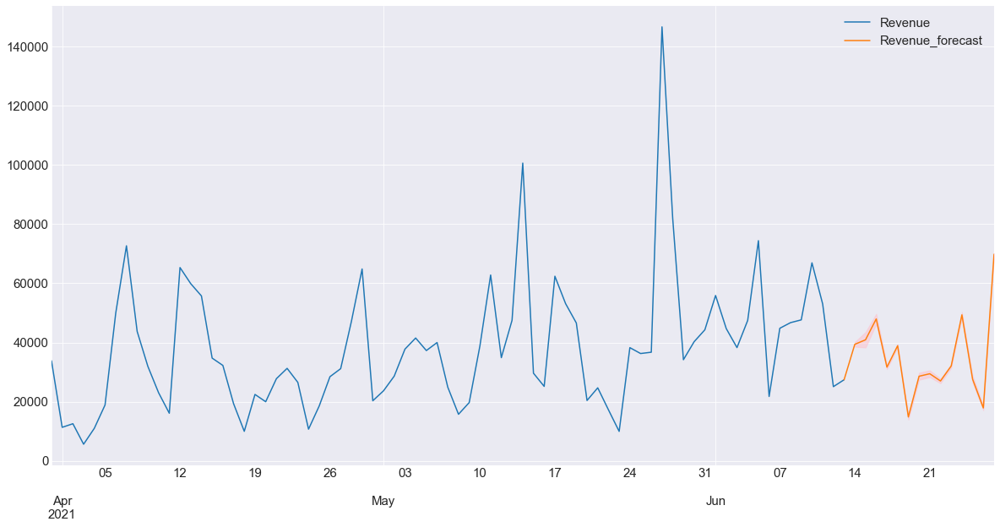

In [197]:
data_full_forecast_rnn.loc['2021-03-31':][['Revenue', 'Revenue_forecast']].plot()
plt.fill_between(data_full_forecast_rnn.index, data_full_forecast_rnn['Revenue_lower'],
                 data_full_forecast_rnn['Revenue_upper'], color='pink', alpha=0.5)

## Conclusion 

Metodos clásicos

    Naive 2, which is actually a random walk model adjusted for season.
    Simple Exponential Smoothing.
    Holt.
    Damped exponential smoothing.
    Average of SES, Holt, and Damped.
    Theta method.
    ARIMA, automatic.
    ETS, automatic.
Métodos Machine Learning

    Multi-Layer Perceptron (MLP)
    Bayesian Neural Network (BNN)
    Radial Basis Functions (RBF)
    Generalized Regression Neural Networks (GRNN), also called kernel regression
    K-Nearest Neighbor regression (KNN)
    CART regression trees (CART)
    Support Vector Regression (SVR)
    Gaussian Processes (GP)
Redes Neuronales

    Recurrent Neural Network (RNN)
    Long Short-Term Memory (LSTM)
